In [ ]:
%%capture
# Torch geometric
!pip install -q torch-scatter -f https://data.pyg.org/whl/torch-1.11.0+cu113.html
!pip install -q torch-sparse -f https://data.pyg.org/whl/torch-1.11.0+cu113.html
!pip install -q git+https://github.com/pyg-team/pytorch_geometric.git

In [ ]:
import numpy as np
# import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

import torch
# import pickle

# Get data
from torch_geometric.utils.convert import from_networkx
from torch_geometric.loader import DataLoader

# Set numpy seed
SEED = 12345
np.random.seed(SEED)

# ------------------------------------------------------------------------------
# Load the TensorBoard notebook extension
%load_ext tensorboard

# ------------------------------------------------------------------------------
# Check CUDA
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Get data




## Utils

In [ ]:
def add_random_edges_weight(graph, attr="weight", min=2, max=10):
    for source, target, attributes in graph.edges(data=True):
        value = np.random.choice(np.arange(min,max))

        attributes[attr] = value

In [ ]:
def preprocess_graphs(graphs):
    """Returns graphs preprocessed and the maximum eccentricity found"""
    # goals_nodes = np.random.choice(6, N_GRAPHS, replace=True)

    max = 0

    # Set distance (number of intermediate nodes) for each graph
    for g in graphs:
        add_random_edges_weight(g)

        # Select random goal node
        goal = np.random.choice(g.number_of_nodes(), replace=True)

        # Find shortest path
        paths = nx.shortest_path_length(g, source=None, target=goal,
                                        weight="weight",
                                        method='dijkstra')

        # Set that value to each node
        for k, v in paths.items():
            g.nodes(data=True)[k]['y'] = float(v) #+ 1 # +1 because goal is 1

        # --------------------------------------------------------------------------
        # Set value x to inf
        nx.set_node_attributes(g, 10000000000.0, 'x')

        # Except the goal, to 0
        g.nodes(data=True)[goal]['x'] = 0.0

        # Remove global attributes
        g.graph = {}

        # --------------------------------------------------------------------------

        # Add goal eccentricity as global attribute ()
        ecc = nx.eccentricity(g, v=goal)
        g.graph = {'eccentricity': ecc}

        # Update max eccentricity
        max = ecc if ecc > max else max

    return max

In [ ]:
# Only y because x is 0 (min) in all nodes except in goal where it is one (max)

def normalize_labels(data_list, max=None, norm="min-max"):
    # Join y
    y_list = []
    for data in data_list:
        # Min-max scaling, but we know min is 0
        if max is not None:
            y_list.append(data.y / max)
        else:
            y_list.append(data.y / data.eccentricity)

    return y_list

## Atlas

(All graphs up to 7 nodes)

In [ ]:
Atlas = nx.graph_atlas_g()[3:]  # Graphs with more than 3 nodes

# Get only fully connected
Atlas_fc = [a for a in Atlas if nx.number_connected_components(a) == 1]

print(len(Atlas_fc))

# ------------------------------------------------------------------------------

# Select number of graphs
N_GRAPHS = len(Atlas_fc) // 2

idx = np.random.choice(len(Atlas_fc), N_GRAPHS, replace=False)

graphs = [Atlas_fc[i] for i in idx]

995


## Random graphs

In [ ]:
# https://stackoverflow.com/questions/61958360/how-to-create-random-graph-where-each-node-has-at-least-1-edge-using-networkx

from itertools import combinations, groupby
import random

def gnp_random_connected_graph(n, p):
    """
    Generates a random undirected graph, similarly to an Erdős-Rényi 
    graph, but enforcing that the resulting graph is conneted
    """
    edges = combinations(range(n), 2)
    G = nx.Graph()
    G.add_nodes_from(range(n))
    if p <= 0:
        return G
    if p >= 1:
        return nx.complete_graph(n, create_using=G)
    for _, node_edges in groupby(edges, key=lambda x: x[0]):
        node_edges = list(node_edges)
        random_edge = random.choice(node_edges)
        G.add_edge(*random_edge)
        for e in node_edges:
            if random.random() < p:
                G.add_edge(*e)
    return G

In [ ]:
N_GRAPHS = 1000
MIN_NODES = 4
MAX_NODES = 30

# Get random graphs
graphs = []
for i in range(N_GRAPHS):
    # Generate fully connected random graph with and 0.0001 prob of an additional edge
    graphs.append(gnp_random_connected_graph(
        np.random.choice(np.arange(MIN_NODES, MAX_NODES)), 0.0001)
    ) #, 0.1))

## To dataloader

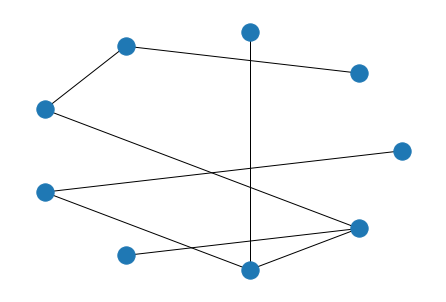

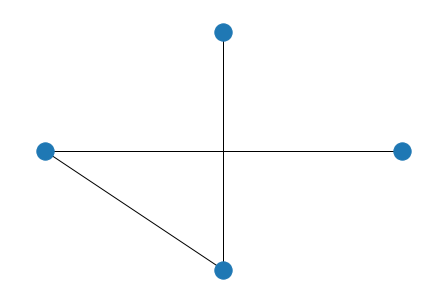

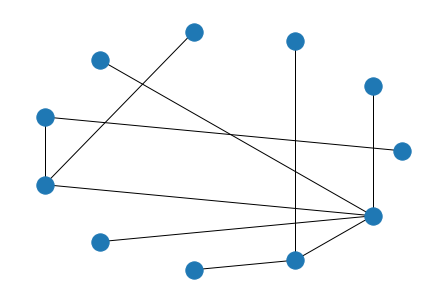

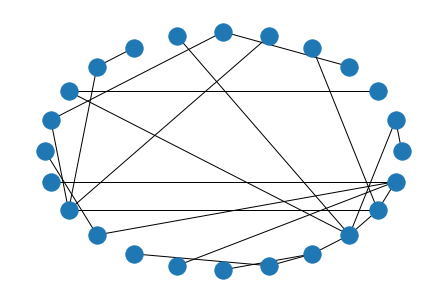

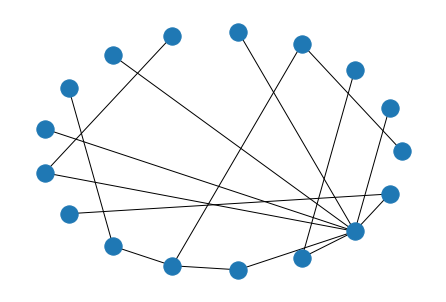

In [ ]:
# ------------------------------------------------------------------------------

max_ecc = preprocess_graphs(graphs) # in-place modification

# ------------------------------------------------------------------------------

# Draw graphs
for g in graphs[0:5]:
    plt.figure()
    nx.draw_circular(g)

# ------------------------------------------------------------------------------

# Transform each graph to Data tensors
data_list = [from_networkx(g, group_node_attrs='x') for g in graphs]

# ------------------------------------------------------------------------------

# # Normalize
# y_list = normalize_labels(data_list,
#                         #   max=None) # Normalize each graph independently
#                           max=max_ecc) #, norm="other")

# # Return the values to the data list
# for y, data in zip(y_list, data_list):
#     data["y"] = y

# ------------------------------------------------------------------------------

# Train-test split
TRAIN_TEST_SPLIT = 0.8 # 0.1
TRAIN_SIZE = int(TRAIN_TEST_SPLIT * len(data_list))
TEST_SIZE = len(data_list) - TRAIN_SIZE

train_dataset, test_dataset = torch.utils.data.random_split(data_list, [TRAIN_SIZE, TEST_SIZE])

# Define batch loaders
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Define model

In [ ]:
from typing import Optional, Tuple

import torch
from torch import Tensor
from torch.nn import Parameter
from torch_scatter import scatter_add
from torch_sparse import SparseTensor, fill_diag, matmul, mul
from torch_sparse import sum as sparsesum

from torch_geometric.nn.conv import MessagePassing
from torch_geometric.nn.dense.linear import Linear
from torch_geometric.nn.inits import zeros
from torch_geometric.typing import Adj, OptTensor, PairTensor
from torch_geometric.utils import add_remaining_self_loops
from torch_geometric.utils.num_nodes import maybe_num_nodes


def gcn_norm(edge_index, edge_weight=None, num_nodes=None, improved=False,
             add_self_loops=True, dtype=None):

    fill_value = 2. if improved else 1.

    if isinstance(edge_index, SparseTensor):
        adj_t = edge_index
        if not adj_t.has_value():
            adj_t = adj_t.fill_value(1., dtype=dtype)
        if add_self_loops:
            adj_t = fill_diag(adj_t, fill_value)
        deg = sparsesum(adj_t, dim=1)
        deg_inv_sqrt = deg.pow_(-0.5)
        deg_inv_sqrt.masked_fill_(deg_inv_sqrt == float('inf'), 0.)
        adj_t = mul(adj_t, deg_inv_sqrt.view(-1, 1))
        adj_t = mul(adj_t, deg_inv_sqrt.view(1, -1))
        return adj_t

    else:
        num_nodes = maybe_num_nodes(edge_index, num_nodes)

        if edge_weight is None:
            edge_weight = torch.ones((edge_index.size(1), ), dtype=dtype,
                                     device=edge_index.device)

        if add_self_loops:
            edge_index, tmp_edge_weight = add_remaining_self_loops(
                edge_index, edge_weight, fill_value, num_nodes)
            assert tmp_edge_weight is not None
            edge_weight = tmp_edge_weight

        row, col = edge_index[0], edge_index[1]
        deg = scatter_add(edge_weight, col, dim=0, dim_size=num_nodes)
        deg_inv_sqrt = deg.pow_(-0.5)
        deg_inv_sqrt.masked_fill_(deg_inv_sqrt == float('inf'), 0)
        return edge_index, deg_inv_sqrt[row] * edge_weight * deg_inv_sqrt[col]


class GCNConvNoNorm(MessagePassing):
    r"""The graph convolutional operator from the `"Semi-supervised
    Classification with Graph Convolutional Networks"
    <https://arxiv.org/abs/1609.02907>`_ paper

    .. math::
        \mathbf{X}^{\prime} = \mathbf{\hat{D}}^{-1/2} \mathbf{\hat{A}}
        \mathbf{\hat{D}}^{-1/2} \mathbf{X} \mathbf{\Theta},

    where :math:`\mathbf{\hat{A}} = \mathbf{A} + \mathbf{I}` denotes the
    adjacency matrix with inserted self-loops and
    :math:`\hat{D}_{ii} = \sum_{j=0} \hat{A}_{ij}` its diagonal degree matrix.
    The adjacency matrix can include other values than :obj:`1` representing
    edge weights via the optional :obj:`edge_weight` tensor.

    Its node-wise formulation is given by:

    .. math::
        \mathbf{x}^{\prime}_i = \mathbf{\Theta}^{\top} \sum_{j \in
        \mathcal{N}(v) \cup \{ i \}} \frac{e_{j,i}}{\sqrt{\hat{d}_j
        \hat{d}_i}} \mathbf{x}_j

    with :math:`\hat{d}_i = 1 + \sum_{j \in \mathcal{N}(i)} e_{j,i}`, where
    :math:`e_{j,i}` denotes the edge weight from source node :obj:`j` to target
    node :obj:`i` (default: :obj:`1.0`)

    Args:
        in_channels (int): Size of each input sample, or :obj:`-1` to derive
            the size from the first input(s) to the forward method.
        out_channels (int): Size of each output sample.
        improved (bool, optional): If set to :obj:`True`, the layer computes
            :math:`\mathbf{\hat{A}}` as :math:`\mathbf{A} + 2\mathbf{I}`.
            (default: :obj:`False`)
        cached (bool, optional): If set to :obj:`True`, the layer will cache
            the computation of :math:`\mathbf{\hat{D}}^{-1/2} \mathbf{\hat{A}}
            \mathbf{\hat{D}}^{-1/2}` on first execution, and will use the
            cached version for further executions.
            This parameter should only be set to :obj:`True` in transductive
            learning scenarios. (default: :obj:`False`)
        add_self_loops (bool, optional): If set to :obj:`False`, will not add
            self-loops to the input graph. (default: :obj:`True`)
        normalize (bool, optional): Whether to add self-loops and compute
            symmetric normalization coefficients on the fly.
            (default: :obj:`True`)
        bias (bool, optional): If set to :obj:`False`, the layer will not learn
            an additive bias. (default: :obj:`True`)
        **kwargs (optional): Additional arguments of
            :class:`torch_geometric.nn.conv.MessagePassing`.

    Shapes:
        - **input:**
          node features :math:`(|\mathcal{V}|, F_{in})`,
          edge indices :math:`(2, |\mathcal{E}|)`,
          edge weights :math:`(|\mathcal{E}|)` *(optional)*
        - **output:** node features :math:`(|\mathcal{V}|, F_{out})`
    """

    _cached_edge_index: Optional[Tuple[Tensor, Tensor]]
    _cached_adj_t: Optional[SparseTensor]

    def __init__(self, in_channels: int, out_channels: int,
                 improved: bool = False, cached: bool = False,
                 add_self_loops: bool = True, normalize: bool = True,
                 bias: bool = True, **kwargs):

        kwargs.setdefault('aggr', 'add')
        super().__init__(**kwargs)

        self.in_channels = in_channels
        self.out_channels = out_channels
        self.improved = improved
        self.cached = cached
        self.add_self_loops = add_self_loops
        self.normalize = normalize

        self._cached_edge_index = None
        self._cached_adj_t = None

        self.lin = Linear(in_channels, out_channels, bias=False,
                          weight_initializer='glorot')

        if bias:
            self.bias = Parameter(torch.Tensor(out_channels))
        else:
            self.register_parameter('bias', None)

        self.reset_parameters()

    def reset_parameters(self):
        self.lin.reset_parameters()
        zeros(self.bias)
        self._cached_edge_index = None
        self._cached_adj_t = None


    def forward(self, x: Tensor, edge_index: Adj,
                edge_weight: OptTensor = None) -> Tensor:
        """"""

        if self.normalize:
            if isinstance(edge_index, Tensor):
                cache = self._cached_edge_index
                if cache is None:
                    edge_index, edge_weight = gcn_norm(  # yapf: disable
                        edge_index, edge_weight, x.size(self.node_dim),
                        self.improved, self.add_self_loops)
                    if self.cached:
                        self._cached_edge_index = (edge_index, edge_weight)
                else:
                    edge_index, edge_weight = cache[0], cache[1]

            elif isinstance(edge_index, SparseTensor):
                cache = self._cached_adj_t
                if cache is None:
                    edge_index = gcn_norm(  # yapf: disable
                        edge_index, edge_weight, x.size(self.node_dim),
                        self.improved, self.add_self_loops)
                    if self.cached:
                        self._cached_adj_t = edge_index
                else:
                    edge_index = cache

        # MODIFICATION: Linear transform with x=1
        ones = torch.ones_like(x, device=x.device)
        w = self.lin(ones)

        # MODIFICATION: Including previous values of x in message operation
        # propagate_type: (x: Tensor, edge_weight: OptTensor)
        out = self.propagate(edge_index, x=w, edge_weight=edge_weight, x_prime=x,
                             size=None)

        if self.bias is not None:
            out += self.bias

        return out


    # MODIFICATION: After mult by edge_weight, add previous value of x_j
    def message(self, x_j: Tensor, edge_weight: OptTensor, x_prime_j: Tensor) -> Tensor:
        return x_j + x_prime_j if edge_weight is None else (edge_weight.view(-1, 1) * x_j) + x_prime_j

    # TODO: TRY TO USE THE MODIFICATION HERE
    # def message_and_aggregate(self, adj_t: SparseTensor, x: Tensor) -> Tensor:
    #     return matmul(adj_t, x, reduce=self.aggr)

In [ ]:
"""
Propagates values from some starting nodes to the rest of the graph. Technically
the same as an algorithm of propagation (set the value of a node based on the
neighbors), but with the "novelty" (I hope) that we can use a NN (GCN in this 
case) to propagate. Also, it can propagate simultaneously through all graph,
with multiple starting points (must pass the criteria).

Generalizes to unseen graphs of different structure and size.



TurnOff
- Layer to mask a vector, in this case, nodes according to a given criteria

GCNConv
- Normalization removed - Why? Because it reduces the value in the nodes that 
are propagating. Removing edges should not help because it will still be added 
a bias to the node.

FRGCN
- Uses a criteria to define with nodes are propagating its value in each 
iteration (> 0.1 in this case)
- It is called iteratively until all nodes have passed the criteria or for a 
number of passes "p"
- Those nodes are "turned-off" in the next iteration, i.e. its edges are removed
and are not futher updated (like dropout, but retaining their old value)
- Uses a criteria to aggregate values (max in this case)

- Not considered for now: But technically could accept batch-normalization,
non-linear activations and so on, but they might affect the evaluation of the 
criteria
"""

from torch import nn
import torch.nn.functional as F
from torch_geometric.nn import GCNConv

# ------------------------------------------------------------------------------

class TurnOff(nn.Module):
    def __init__(self):
        super(TurnOff, self).__init__()

    def forward(self, X, mask):
        """mask: boolean tensor of same dimension as X, indicating which
        values should be masked"""
        return X * mask

# ------------------------------------------------------------------------------

class FRGCN(nn.Module):
    """Recursive GCN, 1 layer"""

    def __init__(self, in_channels, out_channels, criteria=None, aggr="min"):
        super().__init__()
        
        self.gcn = GCNConvNoNorm(in_channels, out_channels, bias=True,
                           aggr=aggr,
                           normalize=False,
                           add_self_loops=False)
        
        
        self.turnOff = TurnOff()

        self.criteria = criteria if criteria is not None else lambda x: x < 1e4

    def forward(self, x, edge_index, edge_weight=None, passes=1):

        # Propagate values in minimum number of steps order
        for i in range(passes):            
            # ------------------------------------------------------------------
            # Nodes that won't change (new ones will still forward its value)
            nodes_to_remove = self.criteria(x)

            # start = time.time()
            masked_x = self.turnOff(x, nodes_to_remove)           # a
            # print(f"Masked_x: {time.time() - start}")

            # Convolve
            # start = time.time()
            prop = self.gcn(x, edge_index, edge_weight)        # c
            # print(f"GCN: {time.time() - start}")

            # Nodes that have changed
            masked_prop = self.turnOff(prop, ~nodes_to_remove)    # d

            # x is the combination of both masked values
            # start = time.time()
            x = masked_x + masked_prop
            # print(f"Sum: {time.time() - start}")

            # If all nodes/rows pass the criteria, stop looping
            # start = time.time()
            # if sum(nodes_to_remove) == x.size(0):
            #     break
            # print(f"Check: {time.time() - start}")


        # ----------------------------------------------------------------------
        # When there are edge weights, shortest path could not be the same as
        # the minimum number of steps

        # Until network converges (no changes) or passes
        sum = 0
        for i in range(passes//2):
            # Get min of local neighbors
            prop = self.gcn(x, edge_index, edge_weight)
            
            # Check if min than actual value
            new_x = torch.min(x, prop)

            # If no change in this iteration, break
            start = time.time()
            if torch.equal(x, new_x):
                break
            # print(f"Check: {time.time() - start}")
            sum += time.time() - start
            
            x = new_x

        print(f"Check total: {sum}")

        return x

# Train

## Utils

In [ ]:
def print_parameters(model):
    for name, param in model.named_parameters():
        print(name)
        print(param)
        print(param.shape)
        print("\n")

In [ ]:
from scipy.stats import rankdata

def graphs_similarity(true, pred, decimals=0):
    """Returns percentage of similarity and ranked pred tensor"""
    true = true.cpu().detach() if torch.cuda.is_available() else true.detach()
    pred = pred.cpu().detach() if torch.cuda.is_available() else pred.detach()

    # Round to 2 decimals
    true_rounded = torch.round(true, decimals=decimals)
    pred_rounded = torch.round(pred, decimals=decimals)

    # Rank before compare (same values get same rank, next is immediately after)
    true_ranked = rankdata(true_rounded, method='dense')
    pred_ranked = rankdata(pred_rounded, method='dense')

    # Return percentage of similiraty between two ranked vectors (and ranked pred)
    return np.mean(true_ranked == pred_ranked), pred_ranked

In [ ]:
class ShortestPathLoss(nn.Module):
    def __init__(self):
        """Compare the shortest path in two graphs"""
        super().__init__()
        
        self.__name__ = 'ShortestPathLoss'

    def forward(self, pred: torch.Tensor, true: torch.Tensor):
        """Returns percentage of similarity and ranked pred tensor
        It's the same as the MAE of min-max scaled output
        """

        # Scale
        true_norm = (true - true.min()) / (true.max() - true.min())
        pred_norm = (pred - pred.min()) / (pred.max() - pred.min())

        return torch.abs(true_norm - pred_norm).mean()

## Training loop

In [ ]:
# import datetime
from torch.utils.tensorboard import SummaryWriter

# ------------------------------------------------------------------------------
# Define GNN model
in_channels = 1
out_channels = 1
num_layers = 1
edge_dim = None
heads = 1

model = FRGCN(in_channels, out_channels).to(DEVICE)

# ------------------------------------------------------------------------------
# Initialize optimizer
LR = 0.01
DECAY = 0.00001

optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=DECAY)
# loss_fn = nn.SmoothL1Loss()
loss_fn = nn.L1Loss()
# loss_fn = ShortestPathLoss()
# loss_fn = nn.MSELoss()

# ------------------------------------------------------------------------------

ITERATIONS = 500
PATIENCE = 30

# ------------------------------------------------------------------------------
# Setup tensorborad

writer = SummaryWriter(f'runs/setting_up')

description = """
GAT with 1 layer, 2 heads, ATLAS with no normalization
"""

writer.add_text('summary', description)

In [ ]:
import copy

tag = "train"
model.train()

# To calculate metrics
losses = []
best_batch_loss = 10000
best_model = model

similarities = []
best_batch_similarity = 0

best_iter = 0

# ------------------------------------------------------------------------------
no_improvements = 0
iter = 0

# LOOP
# for iter in range(ITERATIONS):
while iter < ITERATIONS and no_improvements < PATIENCE:
    iter += 1

    for batch in train_loader:
        batch = batch.to(DEVICE)

        # Reset gradients
        optimizer.zero_grad()

        # Forward
        passes = batch['eccentricity'].item()
        # passes = 1 if passes == 0 else passes   # Can't be equal to zero
        # passes = np.random.choice(np.arange(1,10))

        # out = model(batch['x'], batch['edge_index'], passes=passes)
        out = model(batch['x'], batch['edge_index'], batch['weight'], passes=passes)

        out = out.T.squeeze()

        # Backpropagation
        loss = loss_fn(out, batch.y)
        loss.backward()

        optimizer.step()

        # print([x.grad for x in model.parameters()])

        # Save metrics
        losses.append(loss.item())

        sim, _ = graphs_similarity(batch.y, out, decimals=0)
        similarities.append(sim)

    # --------------------------------------------------------------------------
    # Keep best model
    batch_loss = np.mean(losses[-TRAIN_SIZE:-1])
    batch_similarity = np.mean(similarities[-TRAIN_SIZE:-1])

    if (best_batch_loss - batch_loss) > 0.005: # 0.001 for shortestPathLoss
        print(f"[Iter: {iter}] Saving best model - Loss: {batch_loss}\tAvg-similarity: {batch_similarity}")
        
        best_batch_loss = batch_loss
        best_model = copy.deepcopy(model)
        best_batch_similarity = batch_loss
        best_iter = iter

        no_improvements = 0
    else:
        no_improvements += 1

    # --------------------------------------------------------------------------
    # Write to Tensorboard
    writer.add_scalar(f'loss/{tag}', batch_loss, iter)
    writer.add_scalar(f'avg_similarity/{tag}', batch_similarity, iter)

    # --------------------------------------------------------------------------
    # Print
    if iter % 10 == 0:
        print(f"[Iter: {iter}] Batch-Loss: {batch_loss}\tAvg-similarity: {batch_similarity}")


# ------------------------------------------------------------------------------
writer.add_hparams({'lr': LR, 'decay': DECAY, 'iterations': best_iter},
                   {'loss': best_batch_loss, 'avg_similarity': best_batch_similarity})

[Iter: 1] Saving best model - Loss: 4.928693476696038	Avg-similarity: 0.15136072572977027
[Iter: 2] Saving best model - Loss: 2.897840534641089	Avg-similarity: 0.4634773755039947
[Iter: 3] Saving best model - Loss: 2.810621806617374	Avg-similarity: 0.5419974308053761
[Iter: 4] Saving best model - Loss: 2.6745487057670334	Avg-similarity: 0.5326191273997217
[Iter: 5] Saving best model - Loss: 2.4876776992976293	Avg-similarity: 0.5314099804870754
[Iter: 6] Saving best model - Loss: 2.290797267337615	Avg-similarity: 0.5285650371936863
[Iter: 7] Saving best model - Loss: 1.9516275557170673	Avg-similarity: 0.5573213069577645
[Iter: 8] Saving best model - Loss: 1.0270100006780054	Avg-similarity: 0.7421455009218146
[Iter: 9] Saving best model - Loss: 0.26675419450436444	Avg-similarity: 0.9292340223999802
[Iter: 10] Saving best model - Loss: 0.06372634916152813	Avg-similarity: 0.9963934680606382
[Iter: 10] Batch-Loss: 0.06372634916152813	Avg-similarity: 0.9963934680606382
[Iter: 11] Saving best

In [ ]:
%tensorboard --logdir=runs

# Test

## Test function

In [ ]:
from torch_geometric.utils.convert import to_networkx

def test(loader, model, decimals=0, plot=True):
    tag = "test"
    model.eval()

    # To calculate metrics
    losses = []
    similarities = []

    with torch.no_grad():
        for batch in loader:
            batch = batch.to(DEVICE)
            
            # Forward
            passes = batch['eccentricity'].item()

            out = batch['x']
            # out = model(out, batch['edge_index'], passes=passes)
            out = model(batch['x'], batch['edge_index'], batch['weight'], passes=passes)

            out = out.T.squeeze()

            # Loss
            loss = loss_fn(out.T.squeeze(), batch.y)

            # ------------------------------------------------------------------
            # Log and print
            losses.append(loss.item())

            sim, _ = graphs_similarity(batch.y, out, decimals)
            similarities.append(sim)

            # ------------------------------------------------------------------
            # Plot graphs (more blue = nearer to goal)
            if plot:
                # Print stats
                print(f"Passes: {passes}")
                print(out.T.squeeze())
                print(batch.y)
                print(f"Loss: {loss.item()}\tSimilarity: {sim}")


                # --------------------------------------------------------------
                # Get graph
                G_out = to_networkx(batch, node_attrs=['x', 'y'], edge_attrs=['weight'],
                                    to_undirected=True, remove_self_loops=True)    # NOTE: Careful with self loops

                fig, ax = plt.subplots(1,2, figsize=(17,7))

                # Get pos as a circular layout
                pos = nx.circular_layout(G_out)

                # Plot edge labels
                edge_labels = nx.get_edge_attributes(G_out,'weight')
                nx.draw_networkx_edge_labels(G_out, pos=pos, edge_labels=edge_labels)

                # Plots sorted, with lower value being blue
                # color_order = np.argsort(np.argsort(out.T.squeeze()))
                # color_order = out.T.squeeze()

                ax[0].set_title("Learnt")
                pred = out.cpu().detach() if torch.cuda.is_available() else out
                nx.draw(G_out, pos=pos, cmap=plt.get_cmap('coolwarm'), node_color=pred, 
                        ax=ax[0],
                        with_labels=True, font_color='black')

                ax[1].set_title("True")
                true = batch['y'].cpu().detach() if torch.cuda.is_available() else batch['y']
                nx.draw(G_out, pos=pos, cmap=plt.get_cmap('coolwarm'), node_color=true,
                        ax=ax[1],
                        with_labels=True, font_color='black')
                
                plt.show()


    print(f"Avg loss {np.mean(losses)}")
    print(f"Std loss {np.std(losses)}")
    print(f"Avg similarity {np.mean(similarities)}")
    print(f"Std similarity {np.std(similarities)}")

## Show best model state

In [ ]:
best_batch_loss

0.030304602359079735

In [ ]:
best_model.state_dict()

OrderedDict([('gcn.bias', tensor([9.0232])),
             ('gcn.lin.weight', tensor([[3.8157]])),
             ('gcn2.bias', tensor([0.0004])),
             ('gcn2.lin.weight', tensor([[0.9998]]))])

## Evaluating

In [ ]:
# TRAIN - weighted
test(train_loader, best_model, decimals=0, plot=False)

Avg loss 0.019090889973449522
Std loss 0.007880747177546173
Avg similarity 0.9995001469119116
Std similarity 0.004815200936479551


Passes: 2
tensor([2.0051, 2.0049, 1.0025, 1.0024, 1.0027, 0.0000], device='cuda:0')
tensor([2., 2., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.0029340784531086683	Similarity: 1.0


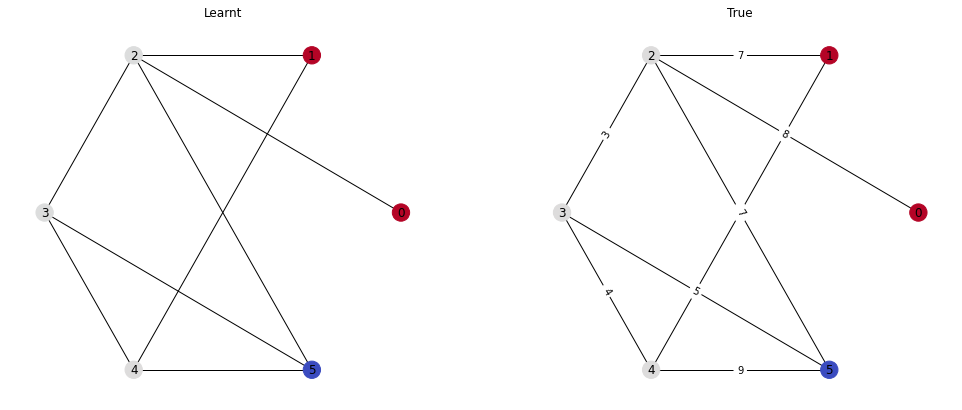

Passes: 2
tensor([1.0021, 0.0000, 1.0021, 2.0043, 2.0043, 1.0024], device='cuda:0')
tensor([1., 0., 1., 2., 2., 1.], device='cuda:0')
Loss: 0.002537667751312256	Similarity: 1.0


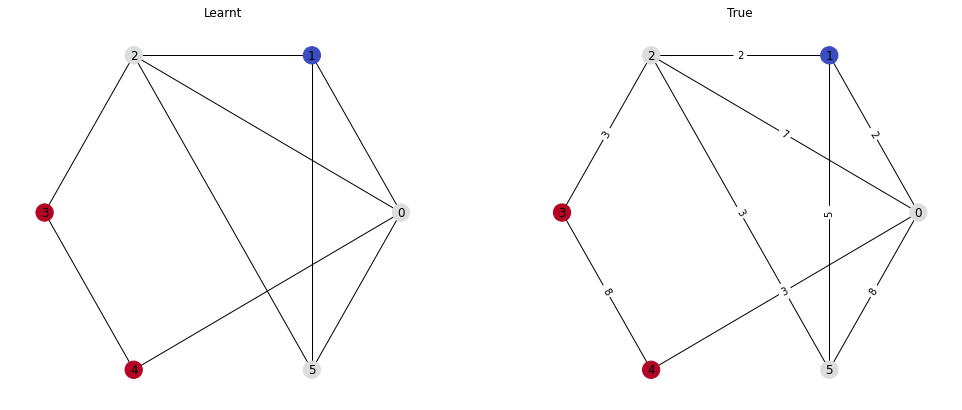

Passes: 2
tensor([2.0045, 1.0023, 0.0000, 1.0023, 2.0046, 1.0022, 2.0043],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.0028853246476501226	Similarity: 1.0


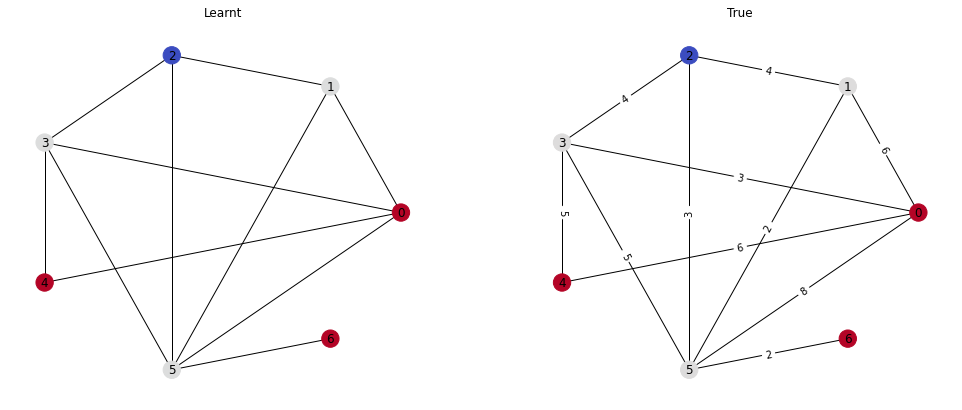

Passes: 2
tensor([1.0025, 1.0024, 1.0027, 1.0025, 0.0000, 2.0046, 2.0047],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 2., 2.], device='cuda:0')
Loss: 0.0027938571292907	Similarity: 1.0


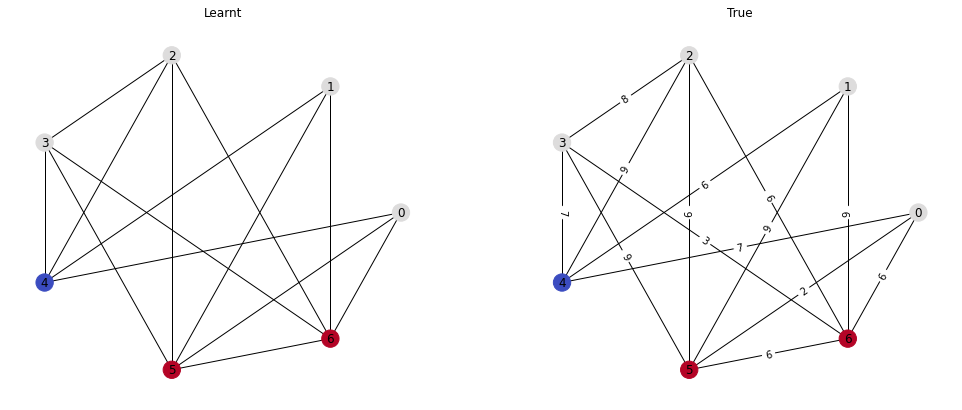

Passes: 2
tensor([2.0046, 1.0024, 1.0024, 0.0000, 1.0023, 2.0047, 2.0046],
       device='cuda:0')
tensor([2., 1., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.003002490382641554	Similarity: 1.0


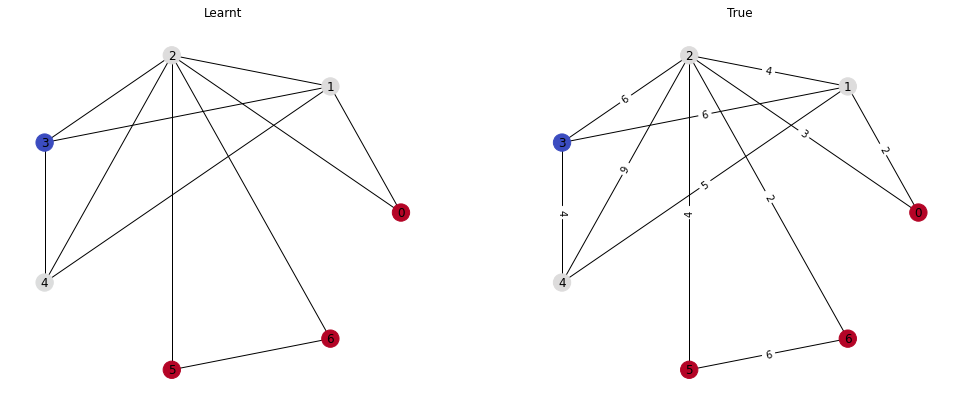

Passes: 2
tensor([0.0000, 1.0024, 2.0046, 2.0048, 2.0051, 1.0025, 1.0024],
       device='cuda:0')
tensor([0., 1., 2., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.003131372621282935	Similarity: 1.0


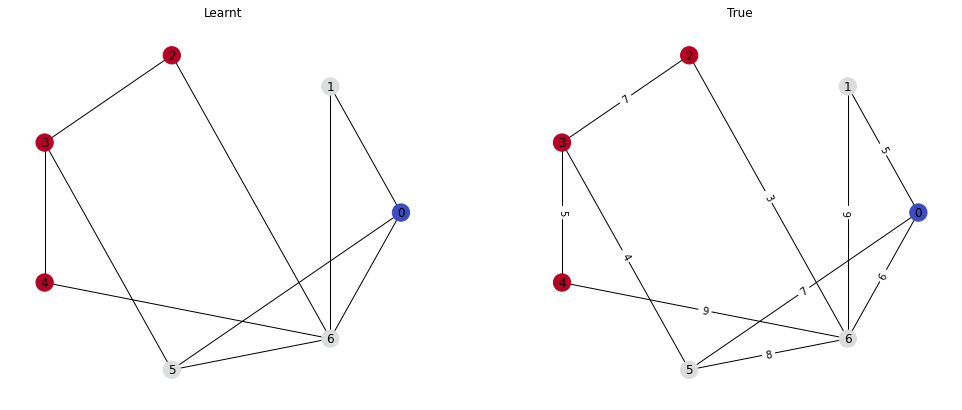

Passes: 2
tensor([2.0050, 0.0000, 2.0050, 2.0051, 2.0050, 1.0026], device='cuda:0')
tensor([2., 0., 2., 2., 2., 1.], device='cuda:0')
Loss: 0.003776292083784938	Similarity: 1.0


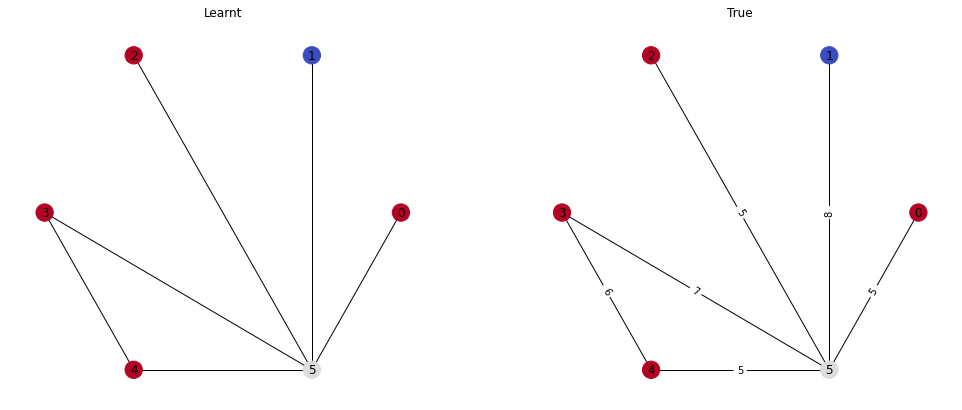

Passes: 3
tensor([0.0000, 1.0022, 3.0066, 2.0046, 2.0044], device='cuda:0')
tensor([0., 1., 3., 2., 2.], device='cuda:0')
Loss: 0.003550505731254816	Similarity: 1.0


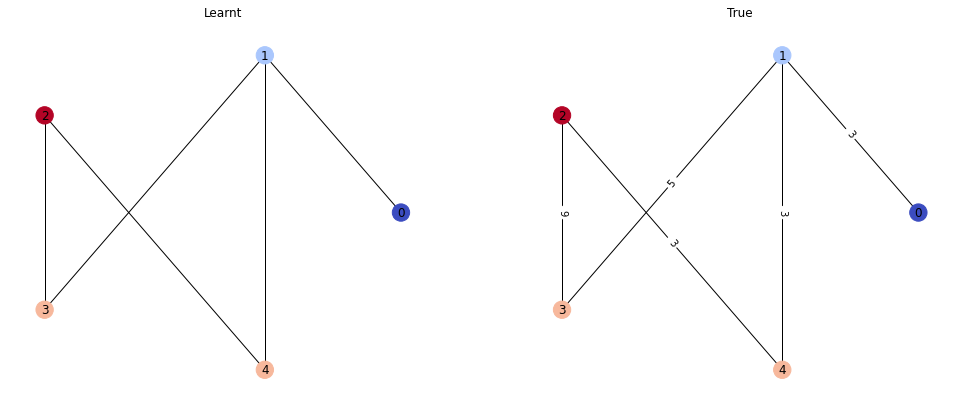

Passes: 2
tensor([1.0027, 1.0024, 2.0046, 2.0050, 1.0023, 1.0027, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 2., 1., 1., 0.], device='cuda:0')
Loss: 0.0027938571292907	Similarity: 1.0


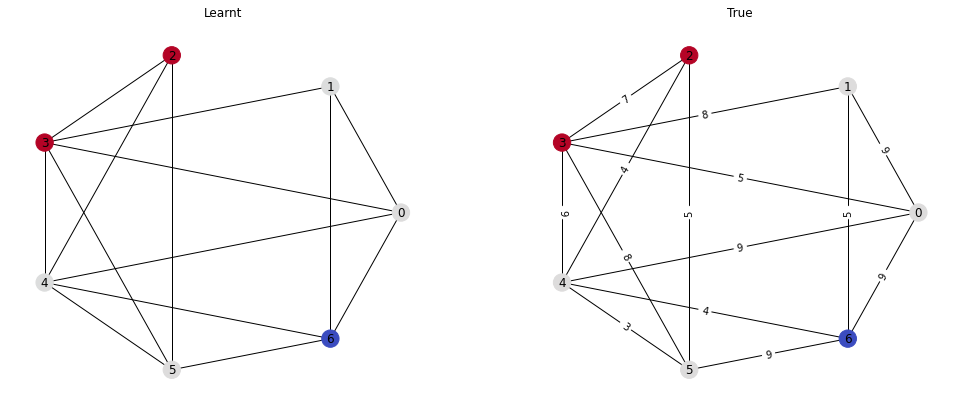

Passes: 2
tensor([2.0042, 2.0044, 0.0000, 1.0022, 1.0021, 2.0046, 1.0024],
       device='cuda:0')
tensor([2., 2., 0., 1., 1., 2., 1.], device='cuda:0')
Loss: 0.0028501751367002726	Similarity: 1.0


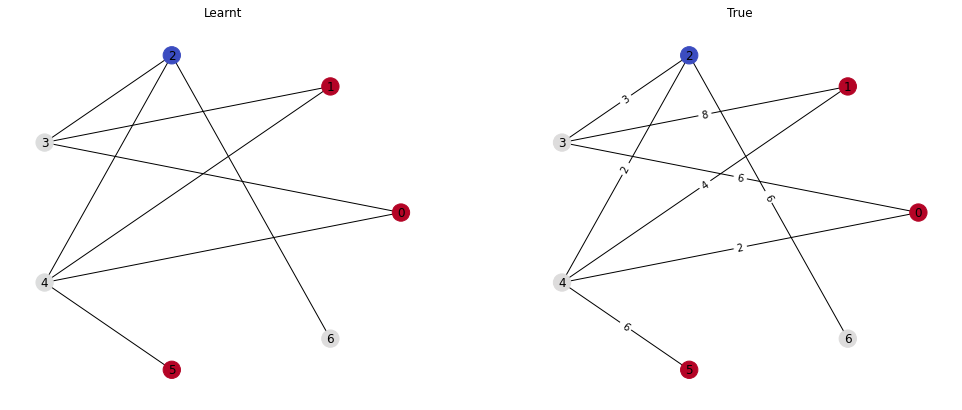

Passes: 3
tensor([2.0046, 2.0043, 2.0042, 0.0000, 1.0022, 1.0021, 3.0064],
       device='cuda:0')
tensor([2., 2., 2., 0., 1., 1., 3.], device='cuda:0')
Loss: 0.0034197401255369186	Similarity: 1.0


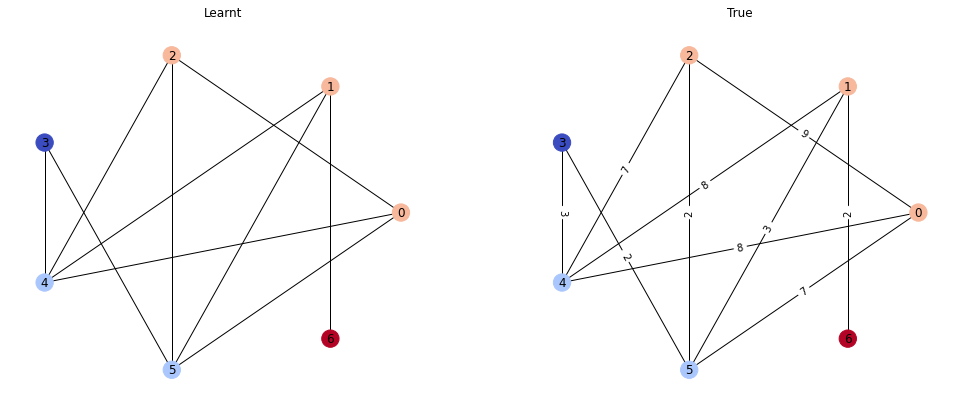

Passes: 2
tensor([1.0025, 1.0026, 2.0045, 1.0024, 1.0024, 1.0021, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.0023743256460875273	Similarity: 1.0


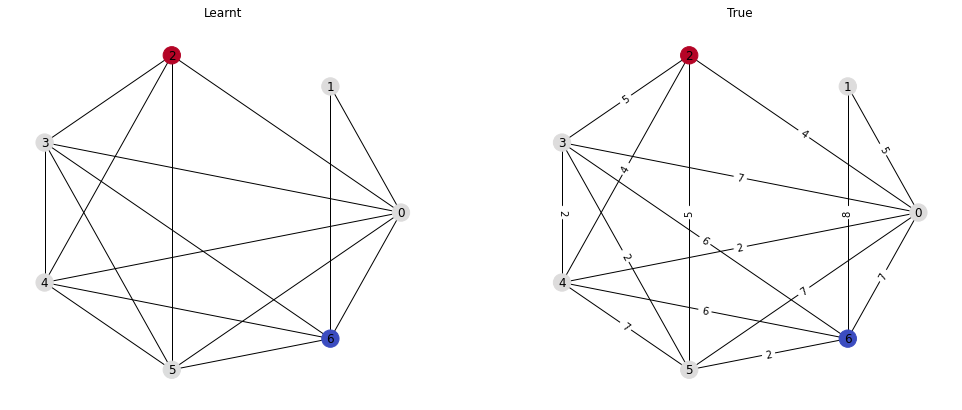

Passes: 2
tensor([1.0027, 1.0024, 1.0022, 1.0026, 0.0000, 2.0043, 1.0022],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.0023508924059569836	Similarity: 1.0


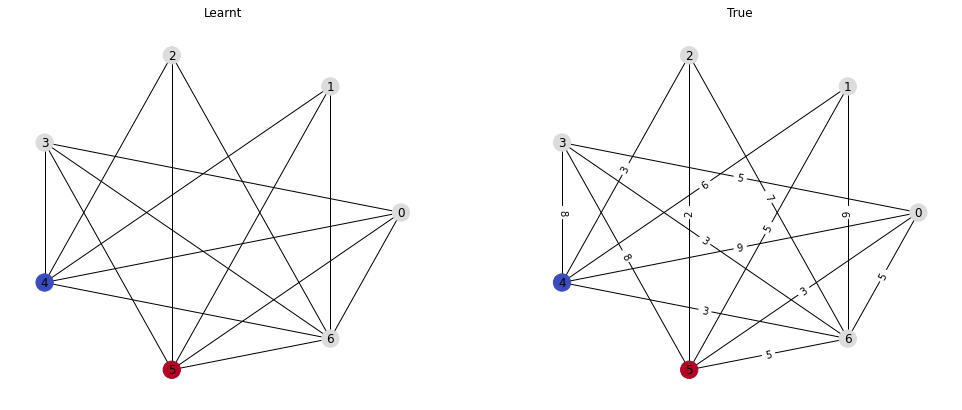

Passes: 2
tensor([1.0022, 1.0023, 1.0027, 2.0045, 1.0023, 0.0000, 1.0026],
       device='cuda:0')
tensor([1., 1., 1., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.0023626089096069336	Similarity: 1.0


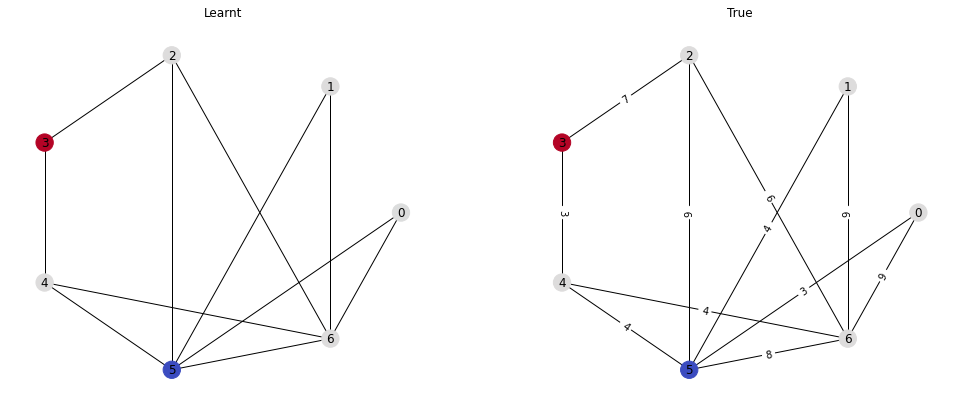

Passes: 2
tensor([1.0024, 0.0000, 1.0024, 2.0043, 1.0022, 1.0027, 2.0051],
       device='cuda:0')
tensor([1., 0., 1., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.002735274378210306	Similarity: 1.0


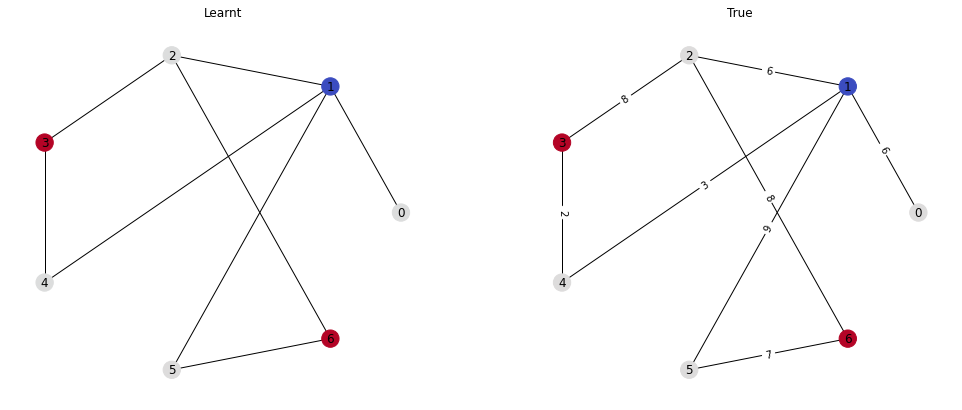

Passes: 2
tensor([2.0050, 2.0049, 2.0052, 1.0025, 1.0025, 0.0000, 1.0024],
       device='cuda:0')
tensor([2., 2., 2., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.0032133886124938726	Similarity: 1.0


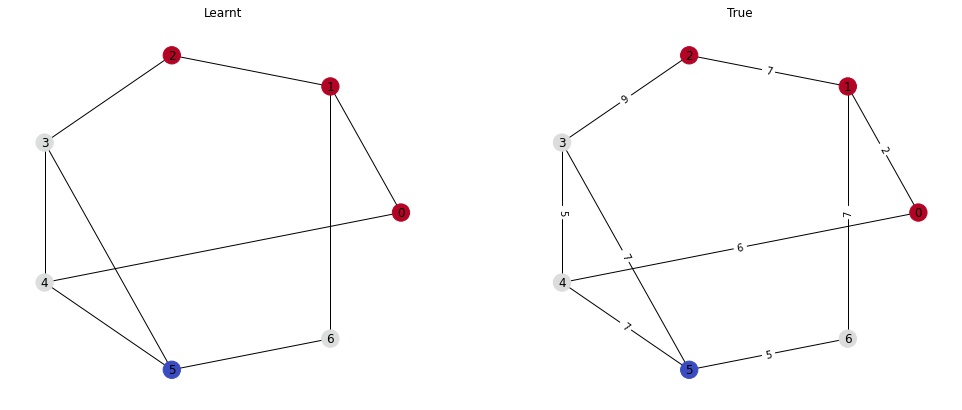

Passes: 1
tensor([1.0022, 1.0027, 1.0021, 1.0027, 0.0000, 1.0026], device='cuda:0')
tensor([1., 1., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.00205085682682693	Similarity: 1.0


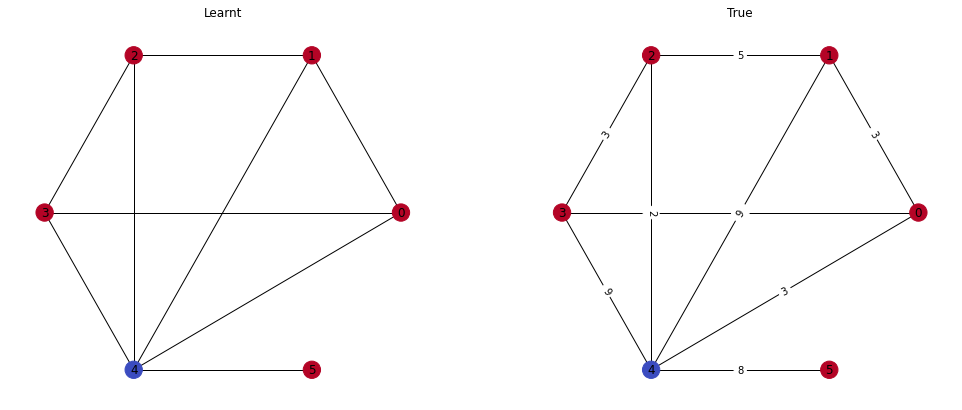

Passes: 2
tensor([0.0000, 1.0026, 2.0049, 2.0045, 1.0022], device='cuda:0')
tensor([0., 1., 2., 2., 1.], device='cuda:0')
Loss: 0.0028351307846605778	Similarity: 1.0


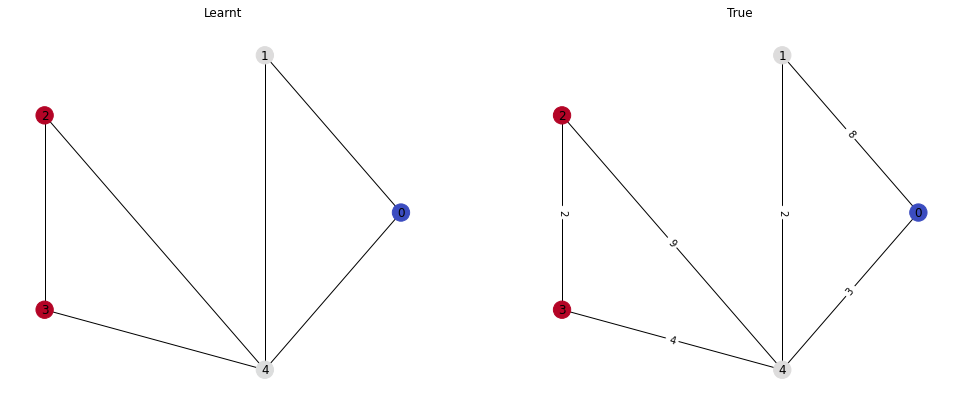

Passes: 2
tensor([1.0026, 1.0022, 1.0024, 1.0027, 0.0000, 2.0051, 1.0023],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.002479774644598365	Similarity: 1.0


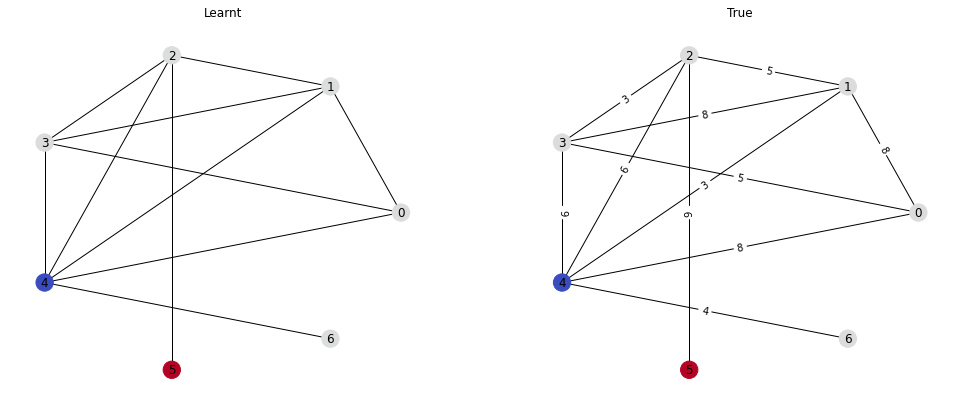

Passes: 2
tensor([1.0024, 1.0025, 0.0000, 1.0023, 2.0046, 1.0025], device='cuda:0')
tensor([1., 1., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.0023899476509541273	Similarity: 1.0


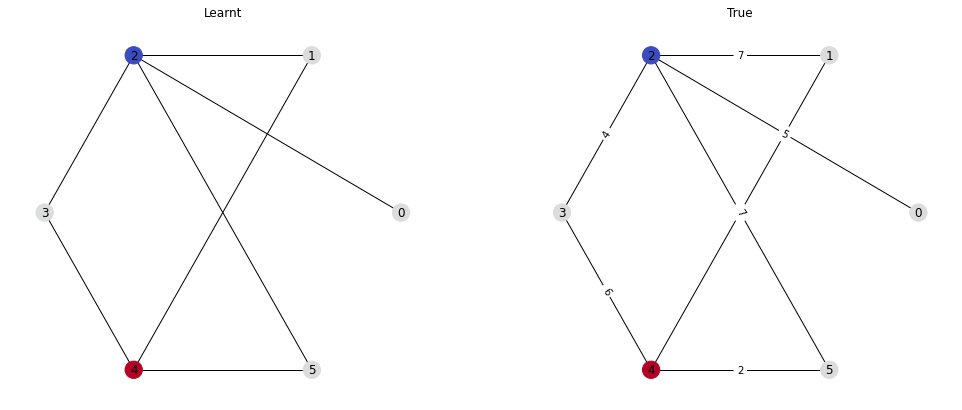

Passes: 3
tensor([1.0027, 1.0021, 2.0042, 3.0067, 0.0000, 1.0025, 2.0051],
       device='cuda:0')
tensor([1., 1., 2., 3., 0., 1., 2.], device='cuda:0')
Loss: 0.0033282723743468523	Similarity: 1.0


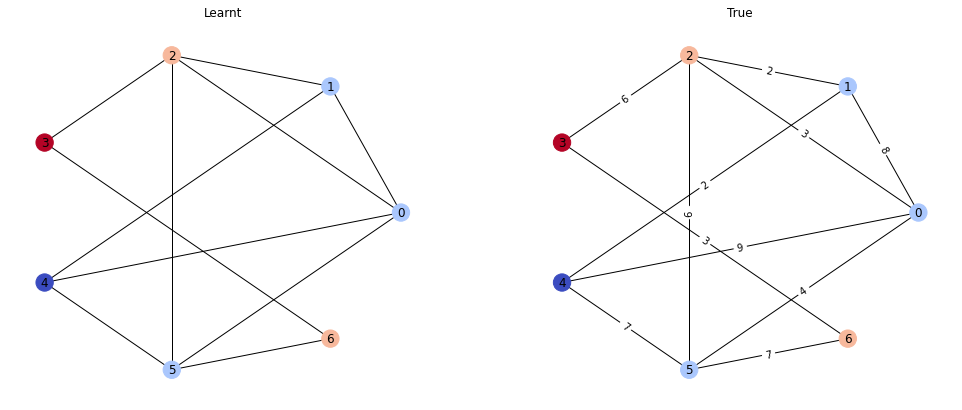

Passes: 2
tensor([1.0027, 2.0049, 2.0048, 2.0049, 2.0051, 2.0051, 0.0000],
       device='cuda:0')
tensor([1., 2., 2., 2., 2., 2., 0.], device='cuda:0')
Loss: 0.003923569805920124	Similarity: 1.0


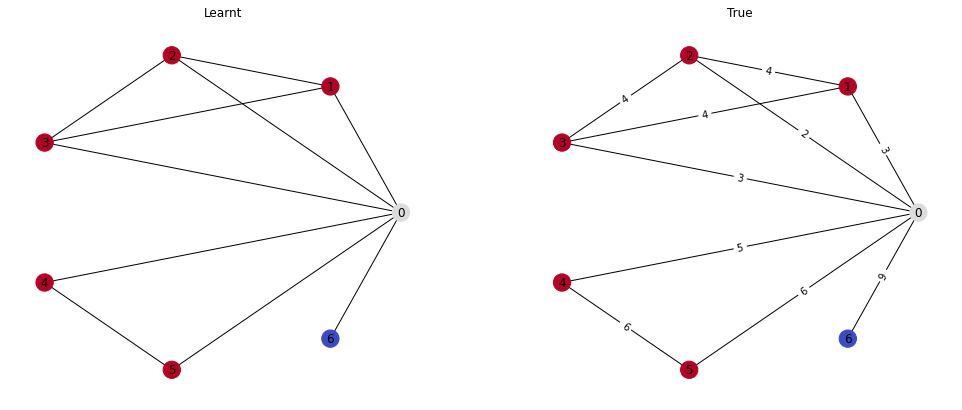

Passes: 3
tensor([1.0022, 2.0044, 1.0025, 2.0048, 3.0068, 2.0044, 0.0000],
       device='cuda:0')
tensor([1., 2., 1., 2., 3., 2., 0.], device='cuda:0')
Loss: 0.0035837721079587936	Similarity: 1.0


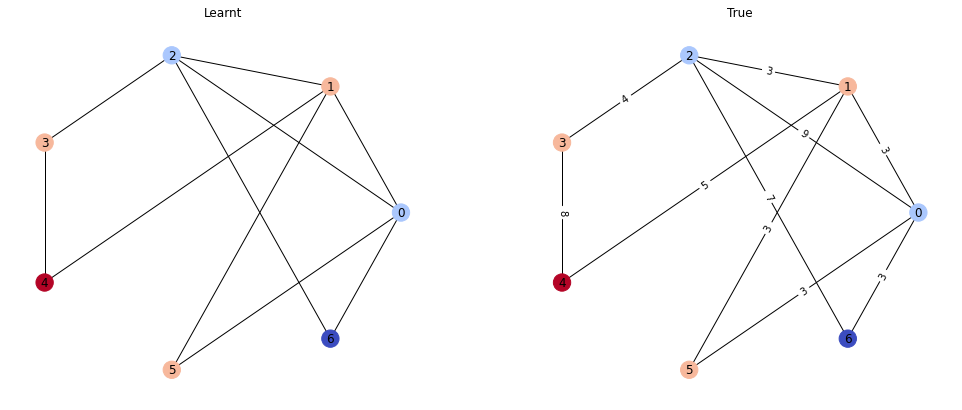

Passes: 1
tensor([1.0024, 1.0026, 1.0024, 1.0024, 0.0000, 1.0025, 1.0024],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.0021305426489561796	Similarity: 1.0


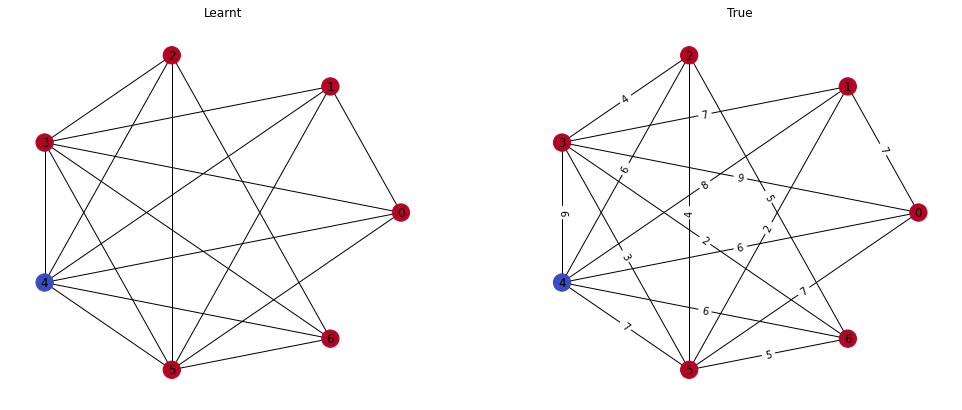

Passes: 4
tensor([2.0051, 2.0048, 4.0099, 3.0072, 1.0025, 0.0000, 3.0073],
       device='cuda:0')
tensor([2., 2., 4., 3., 1., 0., 3.], device='cuda:0')
Loss: 0.005250164773315191	Similarity: 1.0


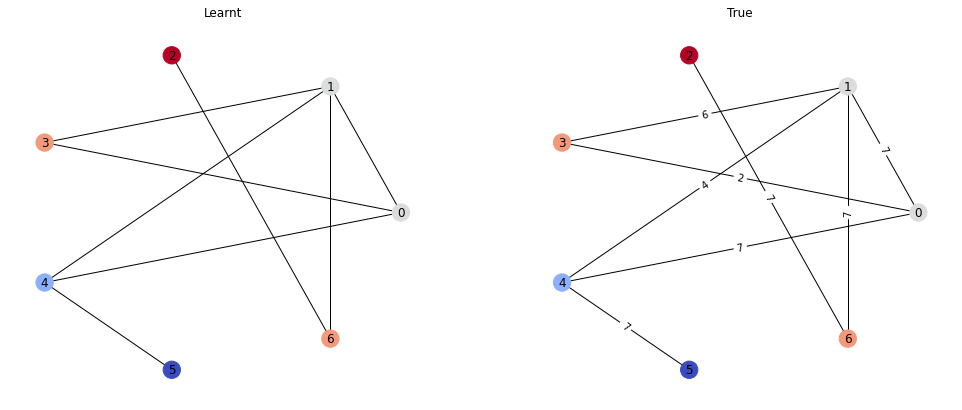

Passes: 2
tensor([1.0024, 1.0026, 1.0024, 0.0000, 2.0048, 1.0024, 2.0047],
       device='cuda:0')
tensor([1., 1., 1., 0., 2., 1., 2.], device='cuda:0')
Loss: 0.0027704241219908	Similarity: 1.0


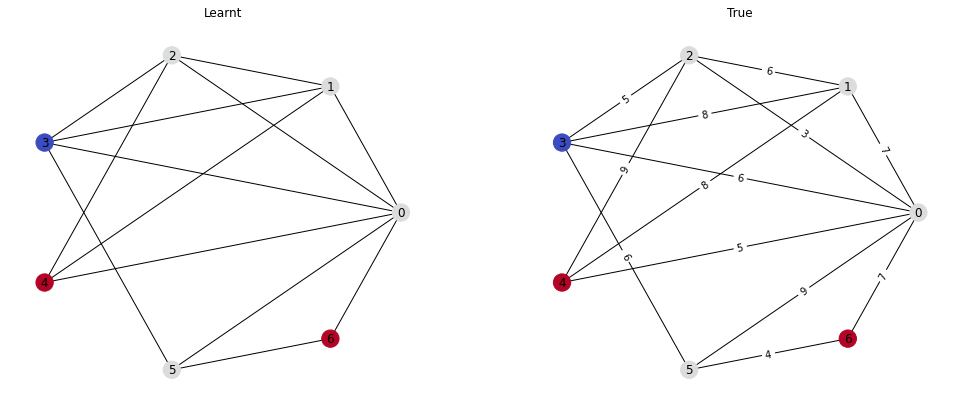

Passes: 3
tensor([0.0000, 1.0022, 2.0044, 3.0067, 2.0043, 1.0021, 1.0024],
       device='cuda:0')
tensor([0., 1., 2., 3., 2., 1., 1.], device='cuda:0')
Loss: 0.0031525238882750273	Similarity: 1.0


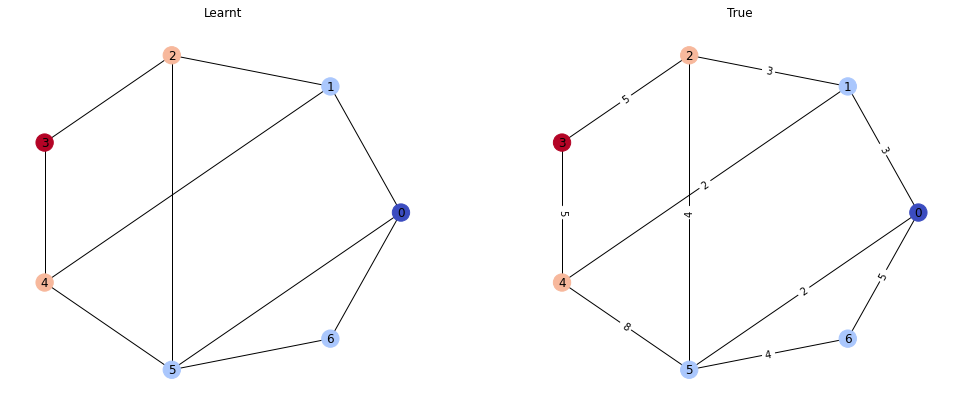

Passes: 2
tensor([0.0000, 1.0026, 2.0042, 1.0024, 1.0021, 1.0026, 2.0049],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


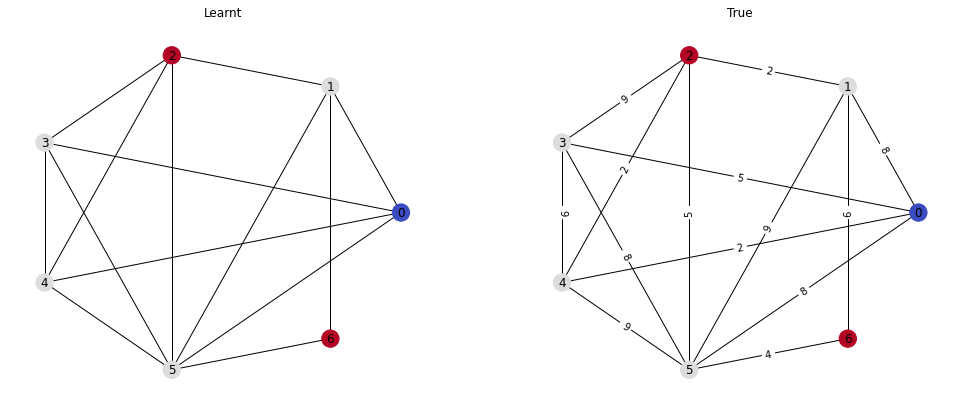

Passes: 3
tensor([1.0023, 1.0021, 2.0043, 3.0065, 2.0050, 2.0047, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 3., 2., 2., 0.], device='cuda:0')
Loss: 0.00356033886782825	Similarity: 1.0


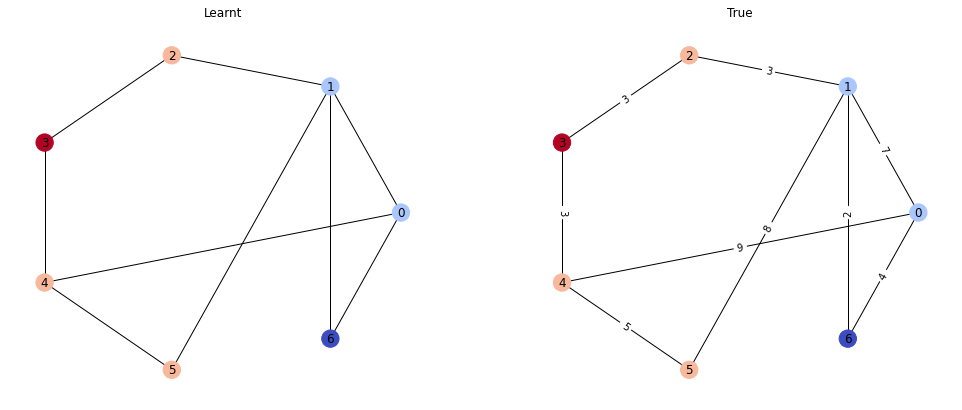

Passes: 2
tensor([1.0023, 2.0046, 2.0051, 1.0024, 0.0000], device='cuda:0')
tensor([1., 2., 2., 1., 0.], device='cuda:0')
Loss: 0.0028515339363366365	Similarity: 1.0


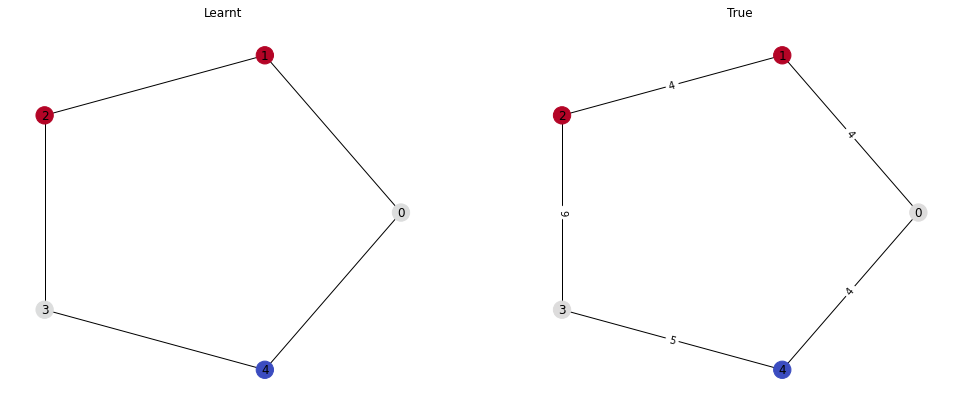

Passes: 2
tensor([0.0000, 1.0024, 1.0027, 2.0051, 2.0047, 1.0026, 2.0052],
       device='cuda:0')
tensor([0., 1., 1., 2., 2., 1., 2.], device='cuda:0')
Loss: 0.0032485383562743664	Similarity: 1.0


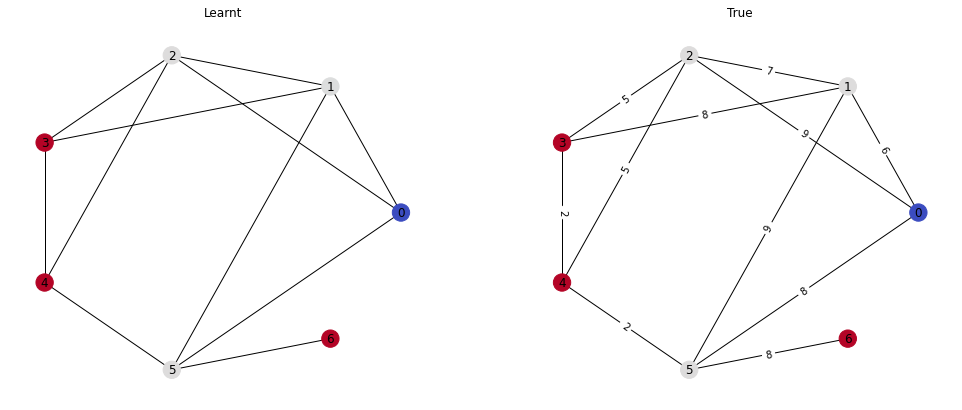

Passes: 2
tensor([1.0021, 1.0022, 1.0023, 0.0000, 1.0025, 2.0042], device='cuda:0')
tensor([1., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0022259156685322523	Similarity: 1.0


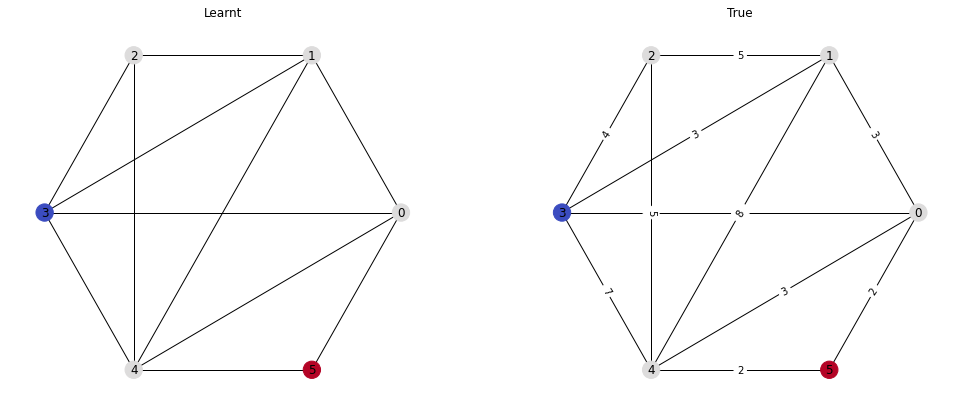

Passes: 2
tensor([0.0000, 1.0025, 2.0047, 1.0024, 1.0025, 2.0048, 1.0022],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 2., 1.], device='cuda:0')
Loss: 0.002746990881860256	Similarity: 1.0


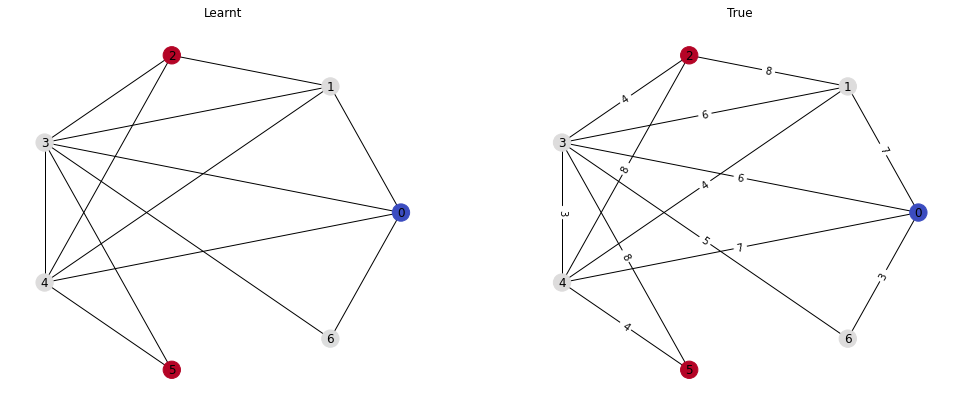

Passes: 4
tensor([0.0000, 2.0048, 3.0074, 1.0025, 1.0022, 4.0099, 4.0099],
       device='cuda:0')
tensor([0., 2., 3., 1., 1., 4., 4.], device='cuda:0')
Loss: 0.005261898506432772	Similarity: 1.0


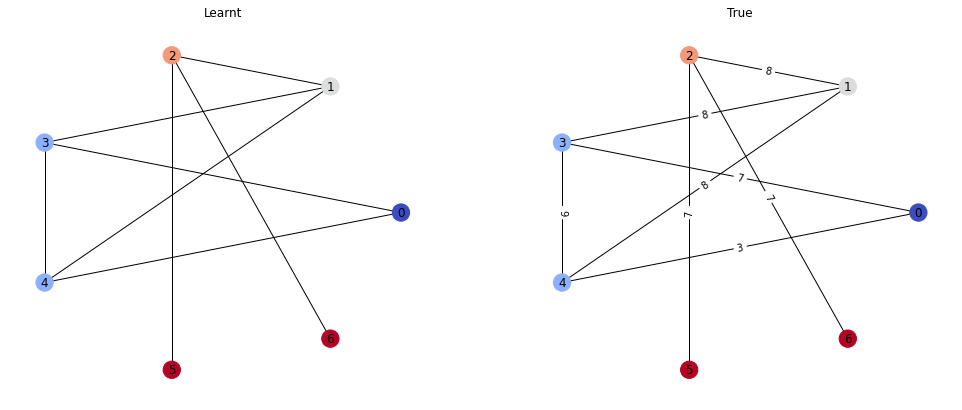

Passes: 2
tensor([2.0044, 0.0000, 2.0043, 2.0048, 2.0044, 2.0045, 1.0022],
       device='cuda:0')
tensor([2., 0., 2., 2., 2., 2., 1.], device='cuda:0')
Loss: 0.003513489617034793	Similarity: 1.0


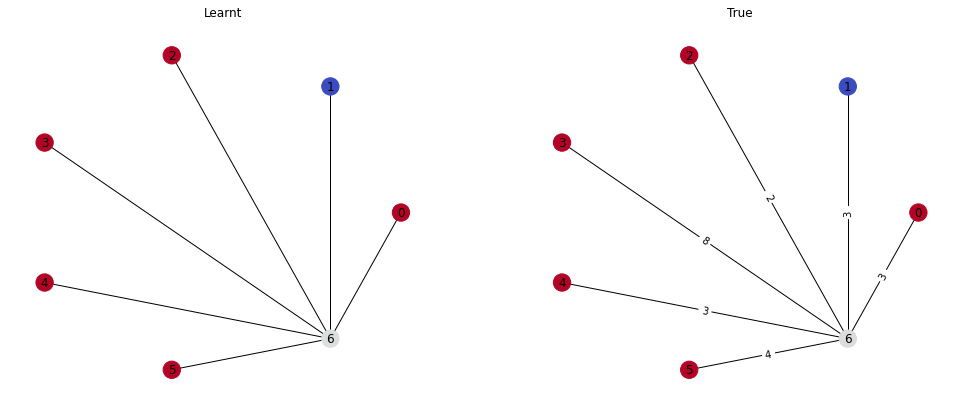

Passes: 3
tensor([3.0068, 2.0051, 2.0042, 1.0021, 2.0049, 1.0027, 0.0000],
       device='cuda:0')
tensor([3., 2., 2., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.0037009376101195812	Similarity: 1.0


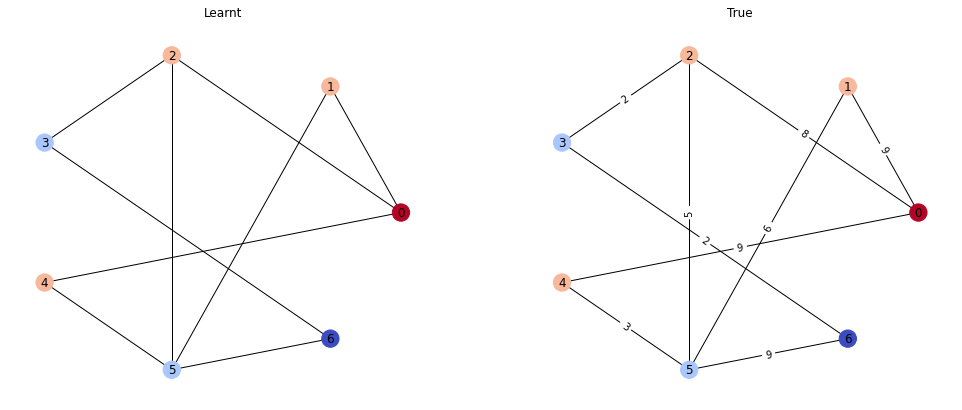

Passes: 2
tensor([0.0000, 2.0047, 2.0047, 2.0047, 1.0024], device='cuda:0')
tensor([0., 2., 2., 2., 1.], device='cuda:0')
Loss: 0.0033076524268835783	Similarity: 1.0


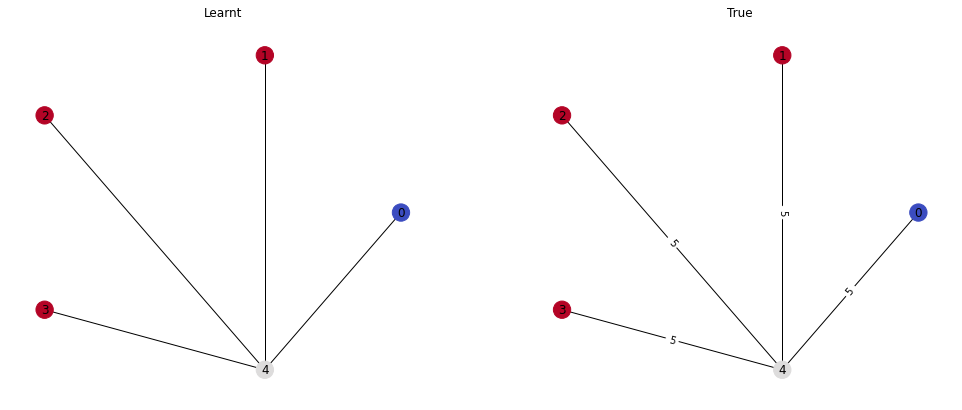

Passes: 2
tensor([0.0000, 1.0021, 2.0046, 2.0044, 1.0021, 1.0027, 2.0047],
       device='cuda:0')
tensor([0., 1., 2., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.00295562413521111	Similarity: 1.0


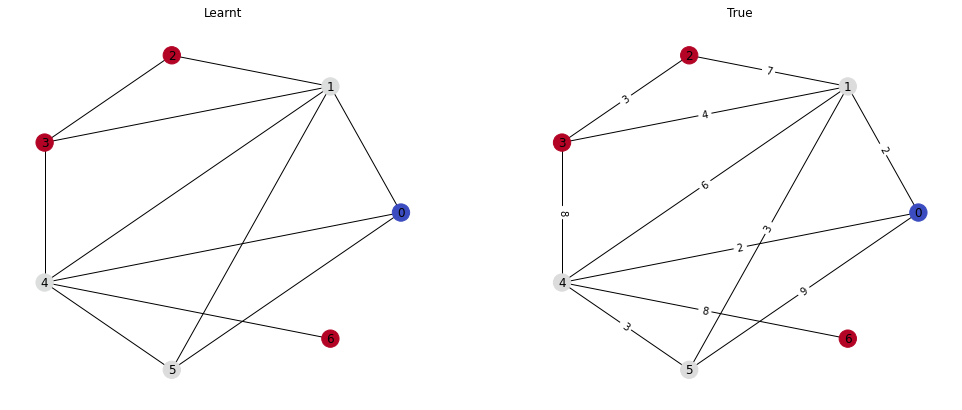

Passes: 2
tensor([1.0022, 0.0000, 1.0025, 2.0043, 2.0046, 2.0046, 2.0047],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 2., 2.], device='cuda:0')
Loss: 0.0032814231235533953	Similarity: 1.0


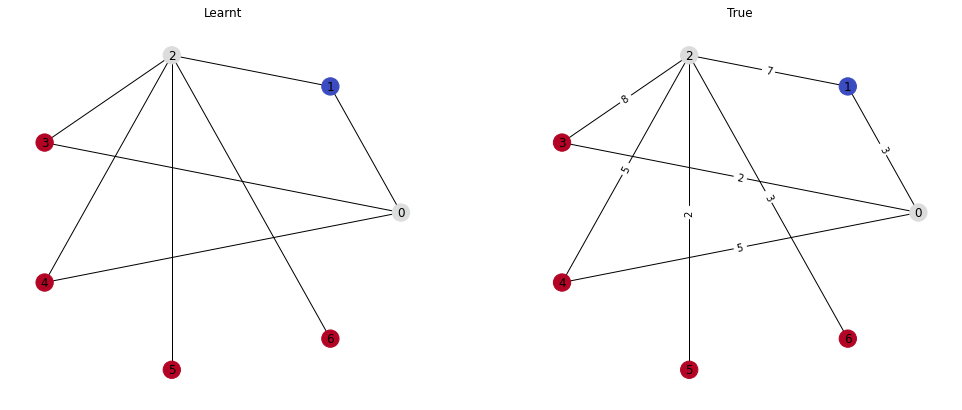

Passes: 2
tensor([2.0046, 1.0021, 2.0046, 1.0023, 0.0000, 1.0023, 2.0047],
       device='cuda:0')
tensor([2., 1., 2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.00294390763156116	Similarity: 1.0


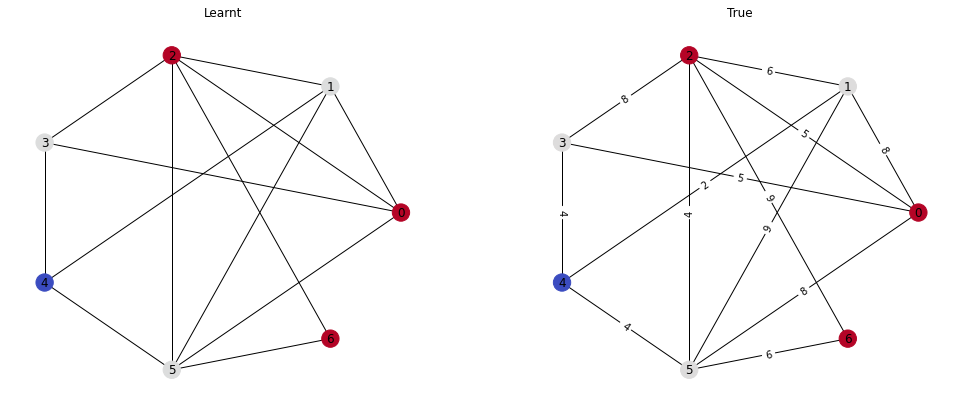

Passes: 2
tensor([1.0022, 1.0027, 1.0023, 1.0027, 2.0042, 1.0021, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.00231574266217649	Similarity: 1.0


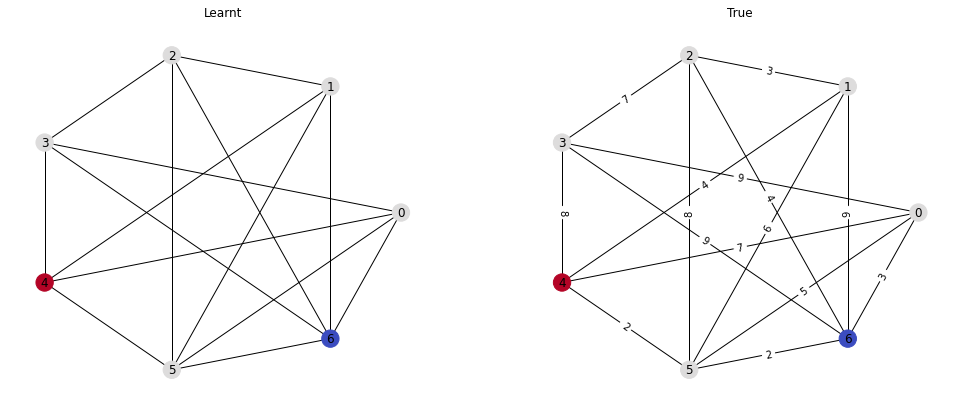

Passes: 1
tensor([1.0024, 1.0024, 1.0024, 1.0027, 1.0026, 1.0025, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.0021422591526061296	Similarity: 1.0


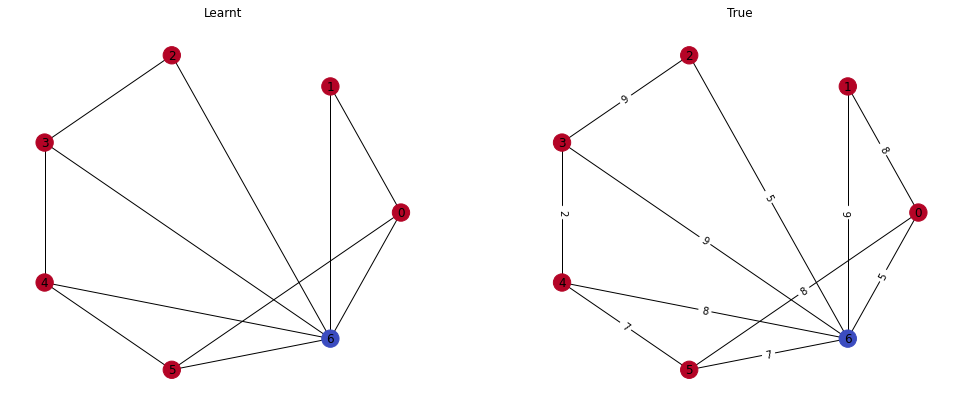

Passes: 2
tensor([0.0000, 1.0024, 1.0021, 2.0044, 1.0022, 1.0027, 2.0043],
       device='cuda:0')
tensor([0., 1., 1., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.002582958899438381	Similarity: 1.0


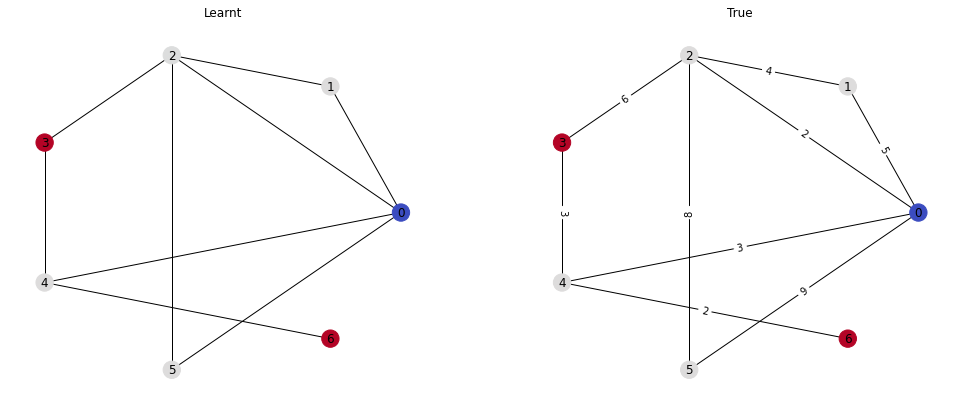

Passes: 2
tensor([0.0000, 1.0026, 2.0053, 2.0043, 2.0043, 1.0021, 1.0022],
       device='cuda:0')
tensor([0., 1., 2., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.002979057375341654	Similarity: 1.0


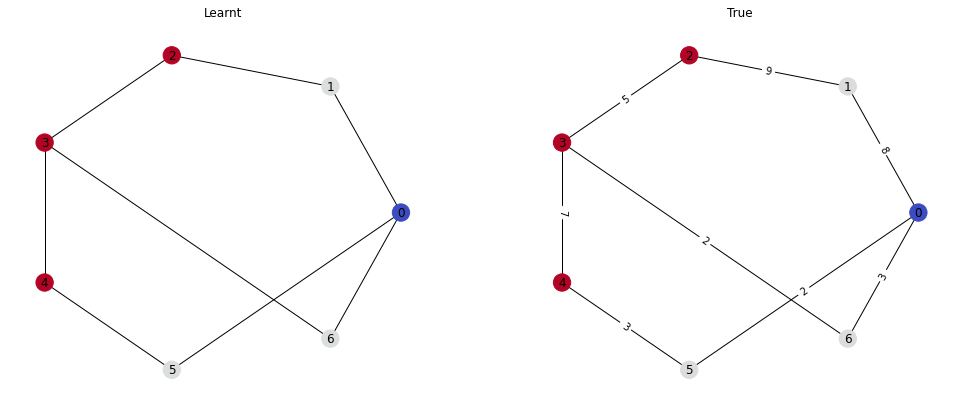

Passes: 2
tensor([0.0000, 2.0045, 2.0044, 2.0047, 1.0022, 1.0024, 1.0022],
       device='cuda:0')
tensor([0., 2., 2., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.0029204743914306164	Similarity: 1.0


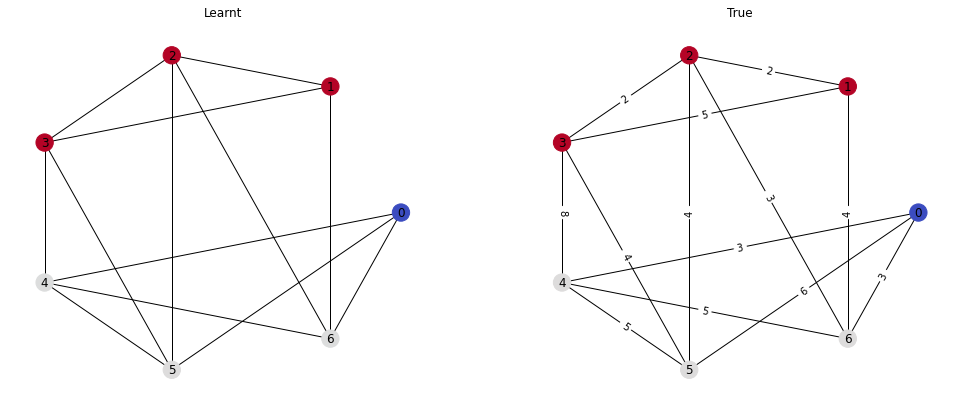

Passes: 2
tensor([2.0048, 1.0023, 0.0000, 1.0022, 2.0046, 2.0048], device='cuda:0')
tensor([2., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.0031091372948139906	Similarity: 1.0


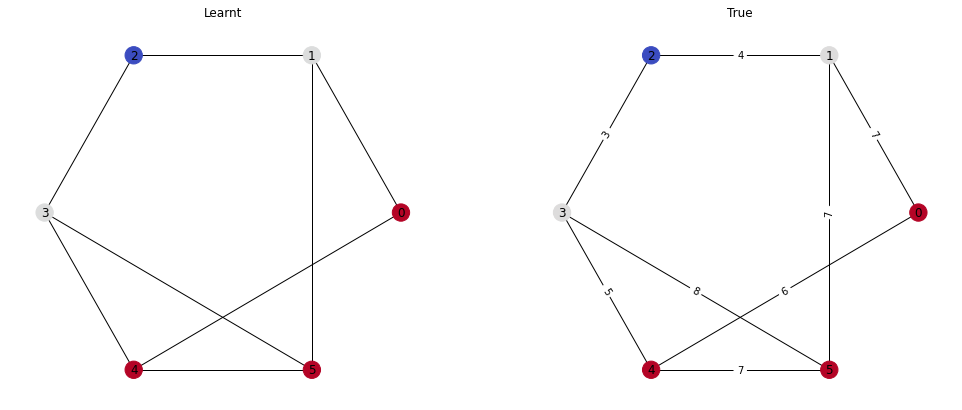

Passes: 2
tensor([1.0027, 1.0022, 1.0024, 1.0024, 0.0000, 2.0047, 1.0024],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.0023977586533874273	Similarity: 1.0


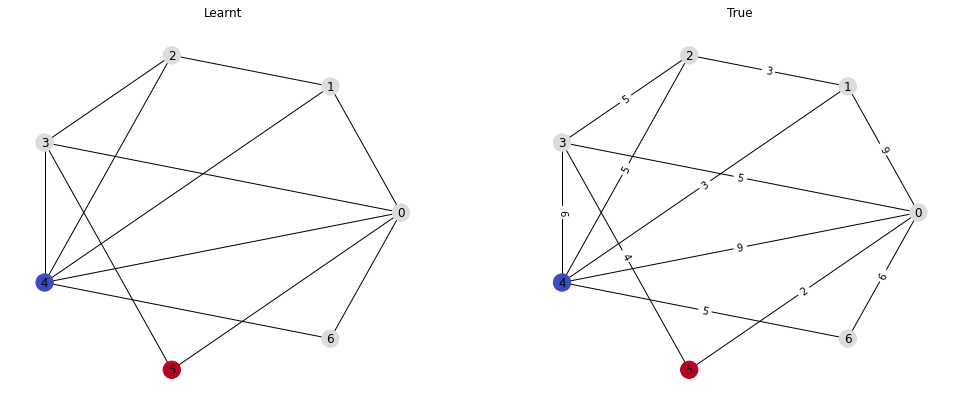

Passes: 2
tensor([1.0025, 1.0021, 2.0045, 0.0000, 1.0024, 2.0049, 1.0027],
       device='cuda:0')
tensor([1., 1., 2., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.0027235576417297125	Similarity: 1.0


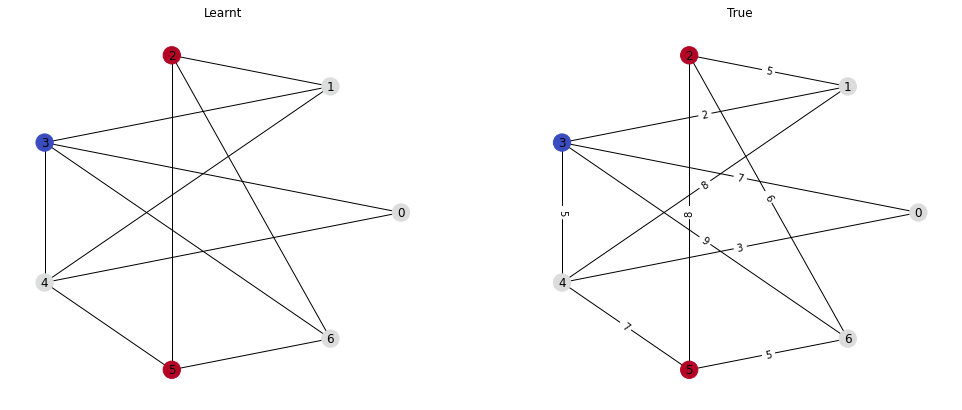

Passes: 3
tensor([3.0070, 2.0045, 3.0067, 1.0025, 1.0021, 2.0046, 0.0000],
       device='cuda:0')
tensor([3., 2., 3., 1., 1., 2., 0.], device='cuda:0')
Loss: 0.0039212703704833984	Similarity: 1.0


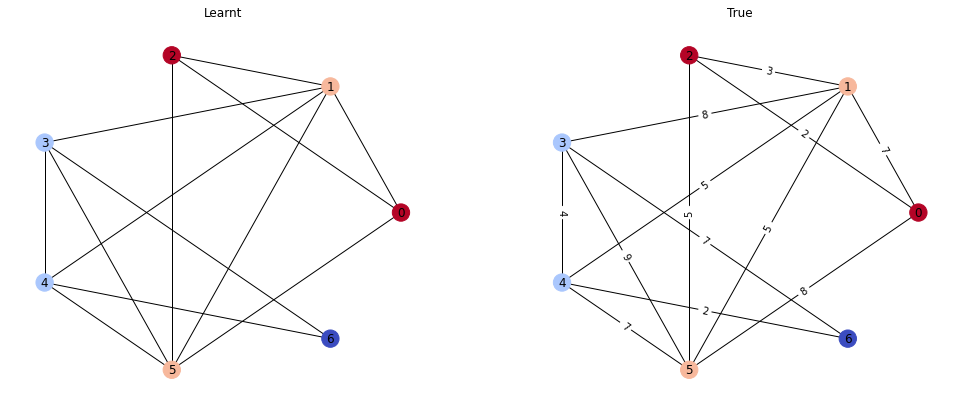

Passes: 3
tensor([1.0024, 2.0049, 2.0046, 1.0022, 0.0000, 3.0075], device='cuda:0')
tensor([1., 2., 2., 1., 0., 3.], device='cuda:0')
Loss: 0.0035985708236694336	Similarity: 1.0


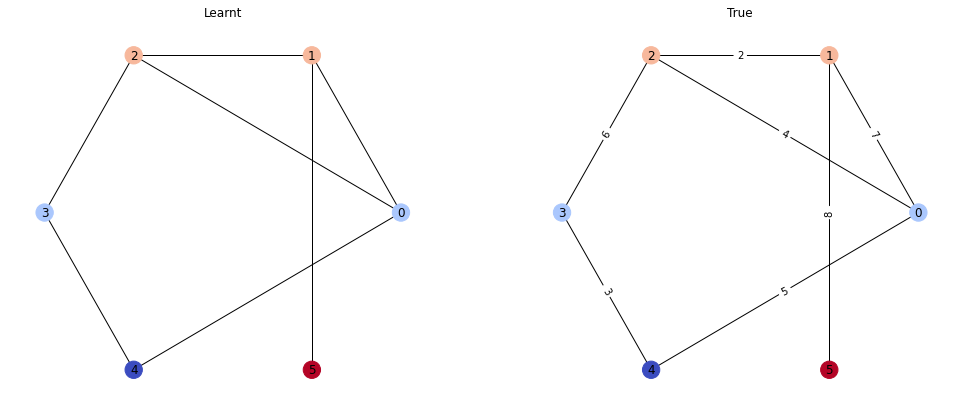

Passes: 2
tensor([1.0021, 1.0025, 1.0024, 1.0024, 0.0000, 2.0047, 1.0024],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.0023626089096069336	Similarity: 1.0


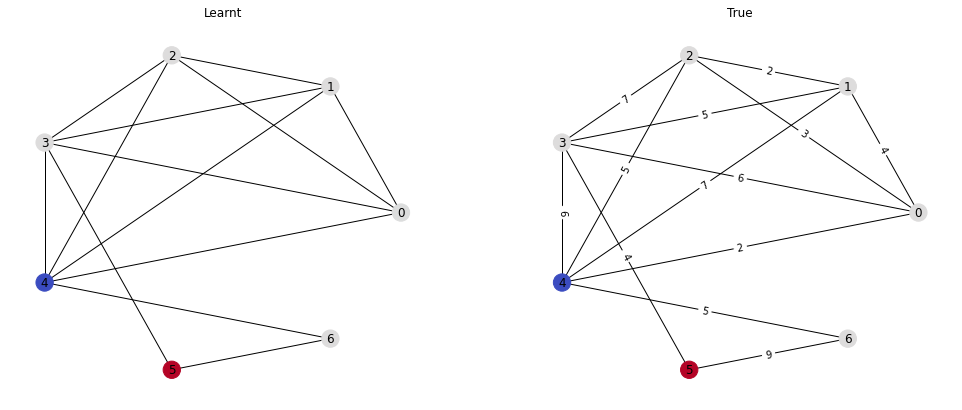

Passes: 2
tensor([1.0025, 2.0046, 1.0027, 2.0043, 1.0021, 0.0000, 1.0021],
       device='cuda:0')
tensor([1., 2., 1., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.002629825146868825	Similarity: 1.0


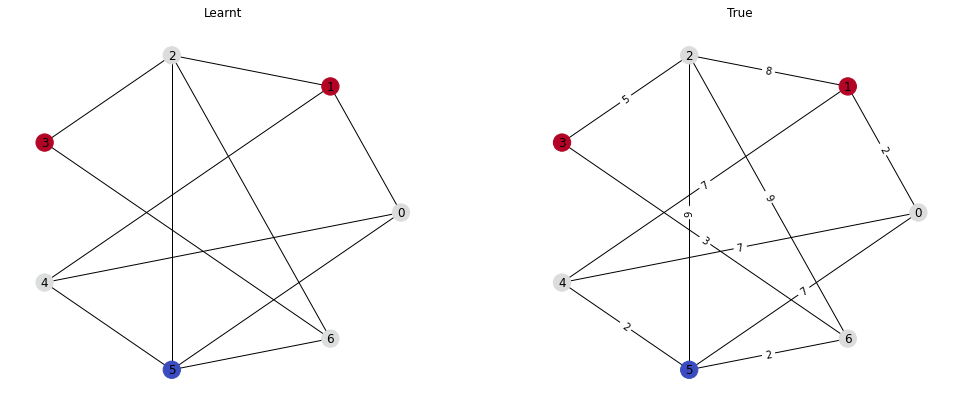

Passes: 3
tensor([3.0073, 1.0023, 1.0025, 1.0022, 0.0000, 2.0045, 2.0048],
       device='cuda:0')
tensor([3., 1., 1., 1., 0., 2., 2.], device='cuda:0')
Loss: 0.003363422118127346	Similarity: 1.0


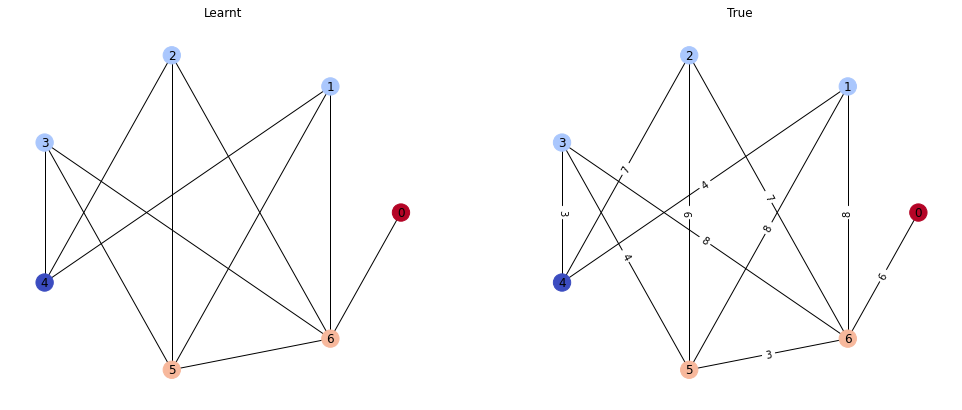

Passes: 3
tensor([1.0021, 1.0024, 0.0000, 2.0047, 2.0048, 2.0048, 3.0075],
       device='cuda:0')
tensor([1., 1., 0., 2., 2., 2., 3.], device='cuda:0')
Loss: 0.0037595205940306187	Similarity: 1.0


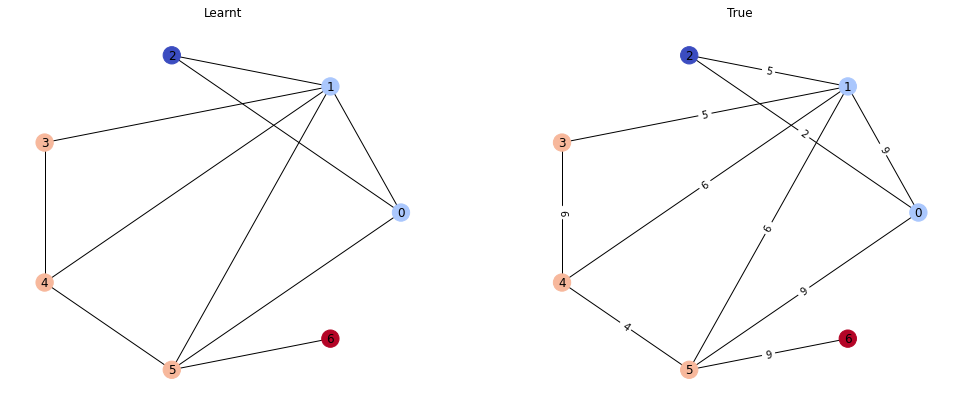

Passes: 2
tensor([0.0000, 1.0025, 2.0047, 1.0022, 2.0048, 1.0026], device='cuda:0')
tensor([0., 1., 2., 1., 2., 1.], device='cuda:0')
Loss: 0.002811054466292262	Similarity: 1.0


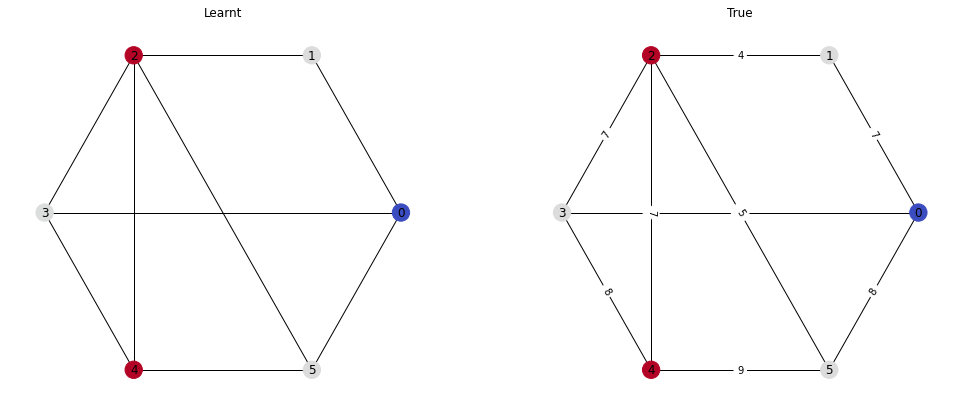

Passes: 2
tensor([1.0023, 1.0027, 1.0024, 1.0022, 2.0046, 0.0000], device='cuda:0')
tensor([1., 1., 1., 1., 2., 0.], device='cuda:0')
Loss: 0.0023489396553486586	Similarity: 1.0


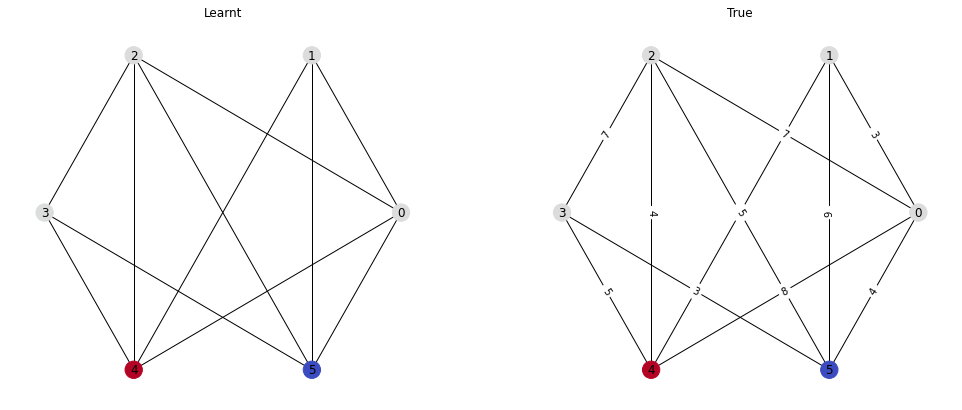

Passes: 3
tensor([3.0074, 3.0070, 3.0073, 2.0049, 2.0051, 1.0024, 0.0000],
       device='cuda:0')
tensor([3., 3., 3., 2., 2., 1., 0.], device='cuda:0')
Loss: 0.004854049067944288	Similarity: 1.0


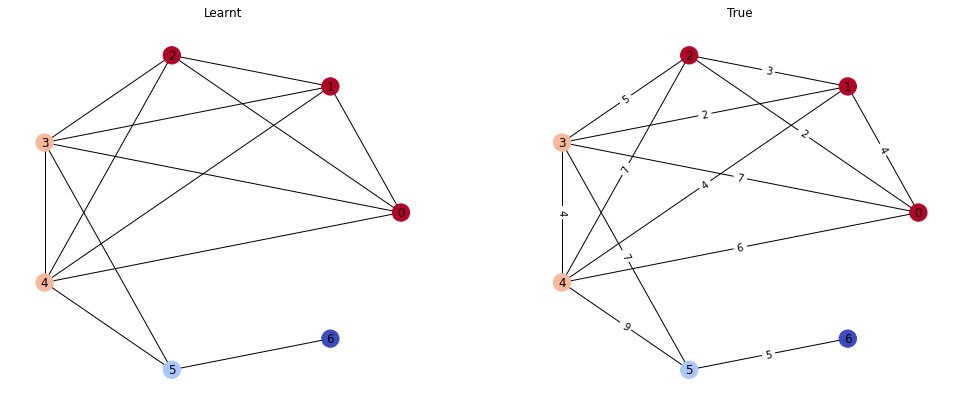

Passes: 2
tensor([1.0021, 1.0027, 2.0049, 1.0027, 1.0027, 0.0000, 2.0046],
       device='cuda:0')
tensor([1., 1., 2., 1., 1., 0., 2.], device='cuda:0')
Loss: 0.00280557363294065	Similarity: 1.0


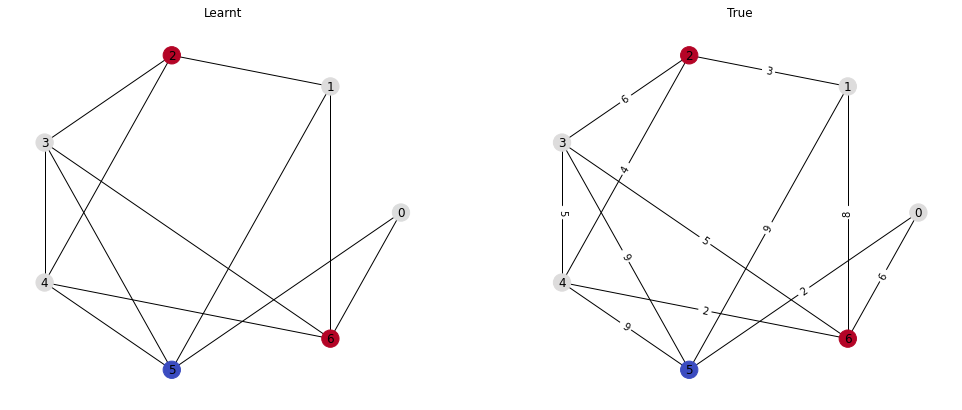

Passes: 3
tensor([3.0071, 0.0000, 1.0023, 2.0045, 1.0024, 2.0045, 2.0045],
       device='cuda:0')
tensor([3., 0., 1., 2., 1., 2., 2.], device='cuda:0')
Loss: 0.0035954886116087437	Similarity: 1.0


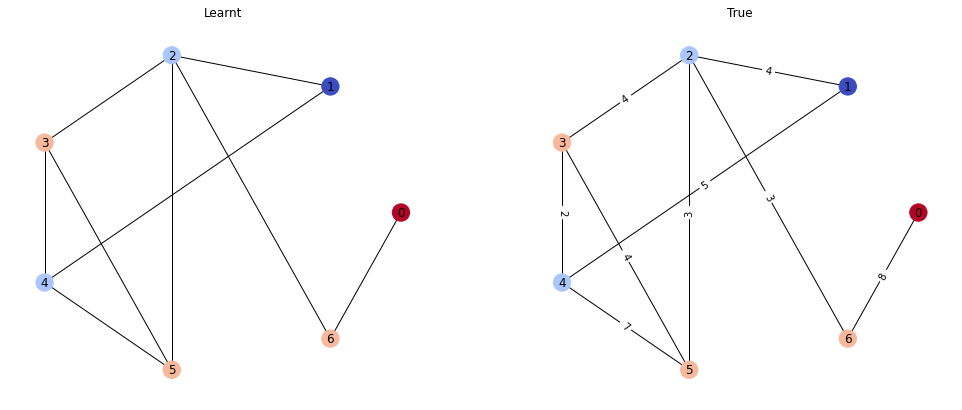

Passes: 2
tensor([2.0046, 1.0027, 1.0022, 1.0025, 1.0024, 0.0000, 1.0024],
       device='cuda:0')
tensor([2., 1., 1., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.002409475389868021	Similarity: 1.0


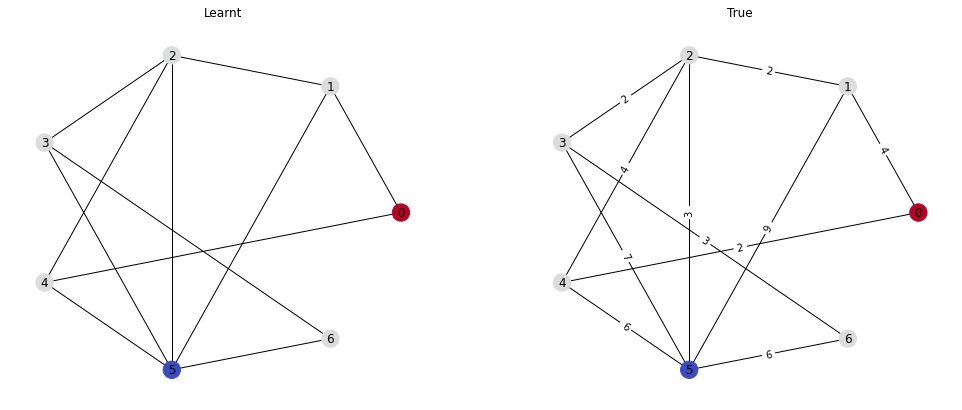

Passes: 2
tensor([1.0025, 1.0024, 1.0027, 2.0046, 0.0000, 1.0024, 1.0025],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.002444624900817871	Similarity: 1.0


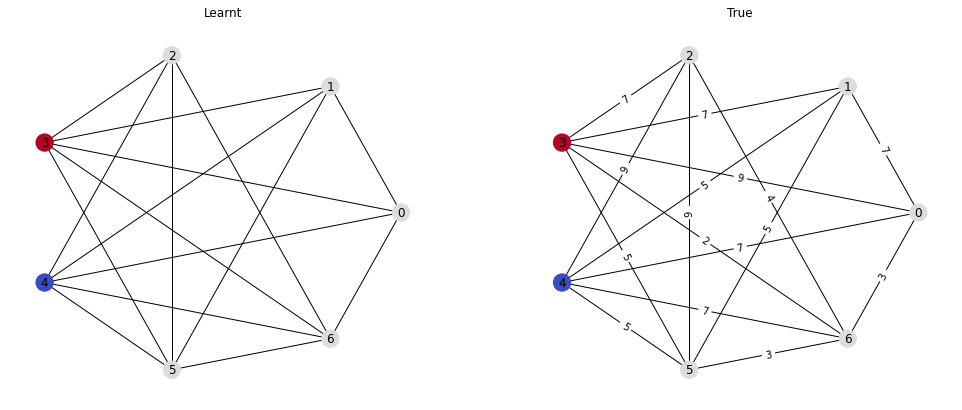

Passes: 2
tensor([0.0000, 1.0024, 2.0045, 1.0021, 2.0046, 1.0024, 1.0027],
       device='cuda:0')
tensor([0., 1., 2., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.0026649748906493187	Similarity: 1.0


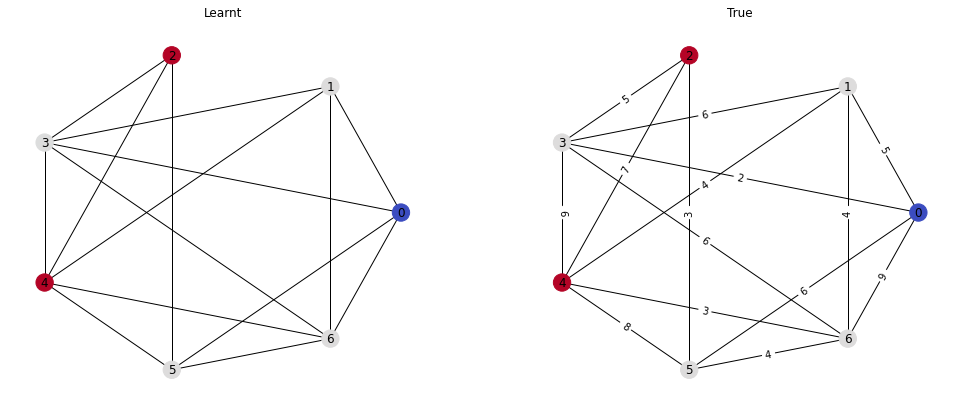

Passes: 2
tensor([2.0048, 2.0050, 0.0000, 1.0027, 1.0027, 1.0024, 1.0022],
       device='cuda:0')
tensor([2., 2., 0., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0028290068730711937	Similarity: 1.0


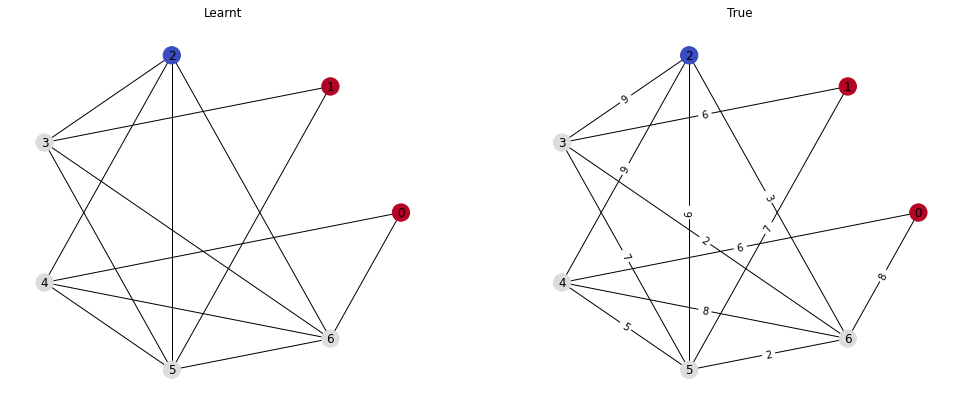

Passes: 3
tensor([3.0072, 1.0025, 0.0000, 2.0051, 2.0049, 2.0051, 2.0051],
       device='cuda:0')
tensor([3., 1., 0., 2., 2., 2., 2.], device='cuda:0')
Loss: 0.004249351564794779	Similarity: 1.0


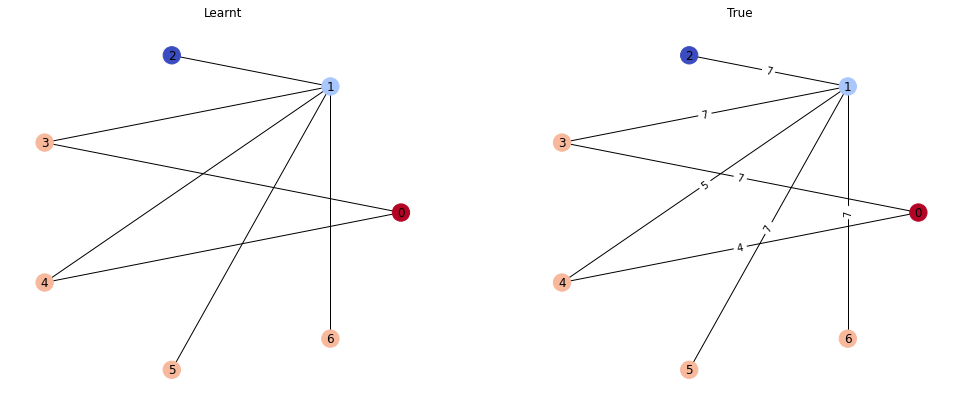

Passes: 2
tensor([2.0046, 0.0000, 1.0024, 1.0024, 1.0026, 1.0024, 1.0024],
       device='cuda:0')
tensor([2., 0., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0023977586533874273	Similarity: 1.0


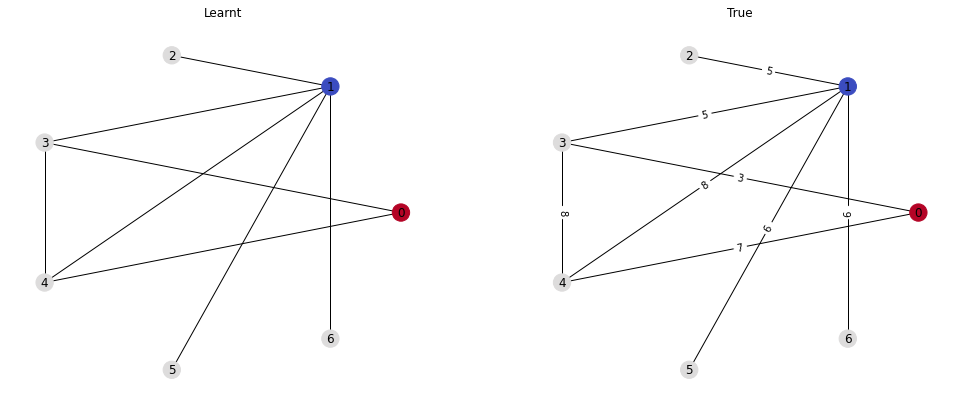

Passes: 2
tensor([2.0047, 1.0023, 1.0022, 1.0025, 1.0027, 0.0000, 1.0026],
       device='cuda:0')
tensor([2., 1., 1., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.002432908397167921	Similarity: 1.0


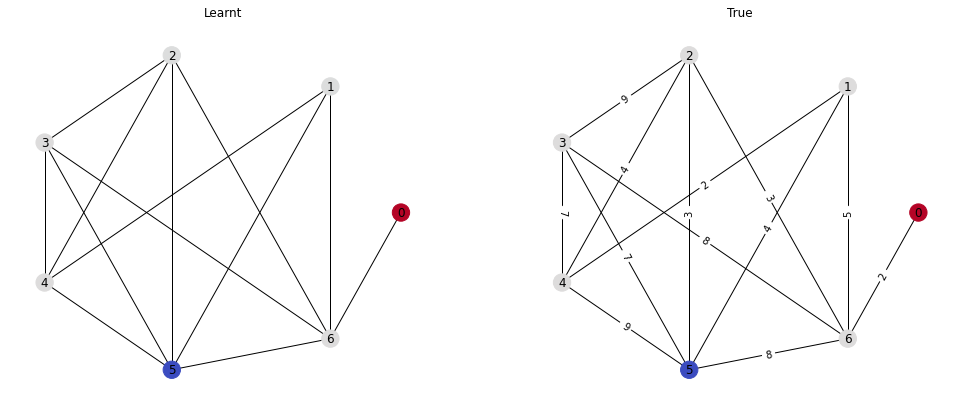

Passes: 2
tensor([0.0000, 2.0053, 2.0048, 1.0026, 1.0026, 2.0053, 2.0048],
       device='cuda:0')
tensor([0., 2., 2., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.003632920328527689	Similarity: 1.0


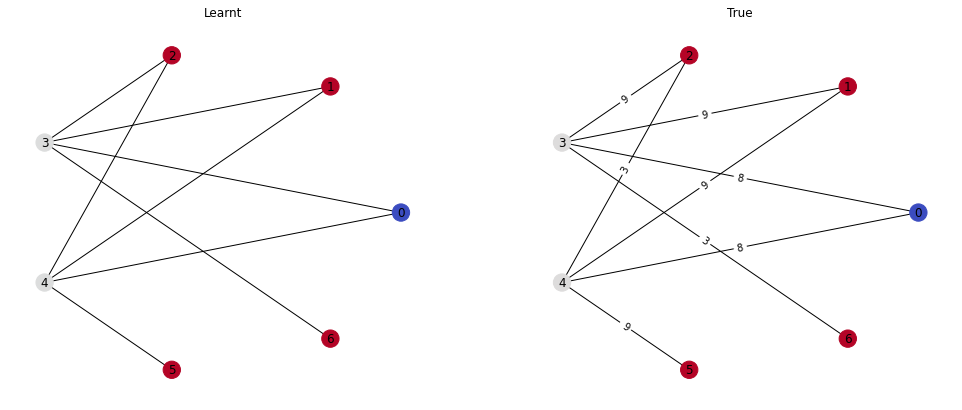

Passes: 3
tensor([3.0072, 2.0046, 3.0068, 2.0045, 1.0021, 0.0000, 1.0027],
       device='cuda:0')
tensor([3., 2., 3., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.003979853354394436	Similarity: 1.0


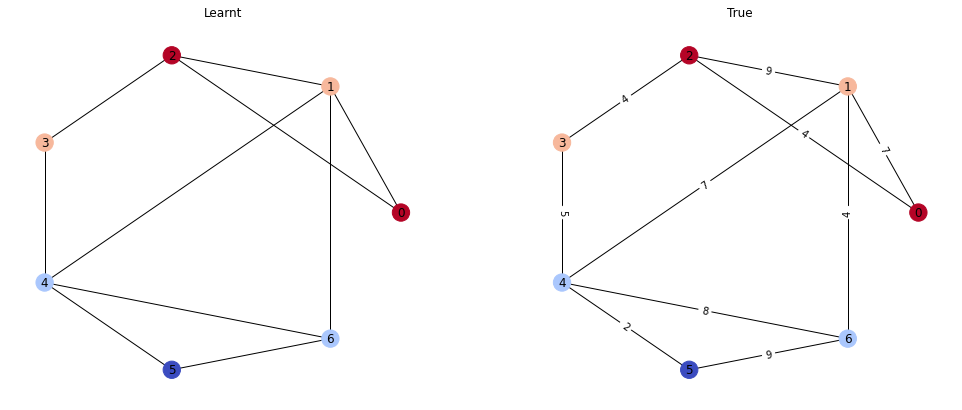

Passes: 3
tensor([3.0073, 2.0048, 1.0024, 0.0000, 1.0024, 2.0051, 2.0046],
       device='cuda:0')
tensor([3., 2., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.0038063868414610624	Similarity: 1.0


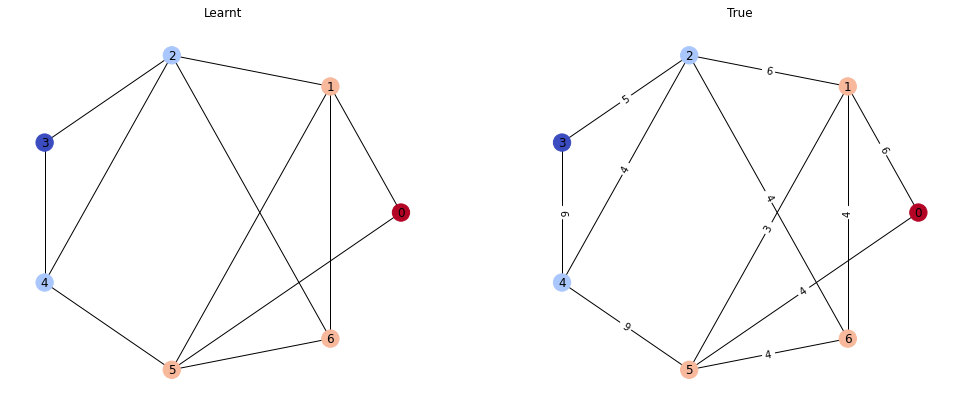

Passes: 2
tensor([2.0048, 1.0024, 1.0023, 1.0024, 0.0000, 1.0024, 2.0045],
       device='cuda:0')
tensor([2., 1., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


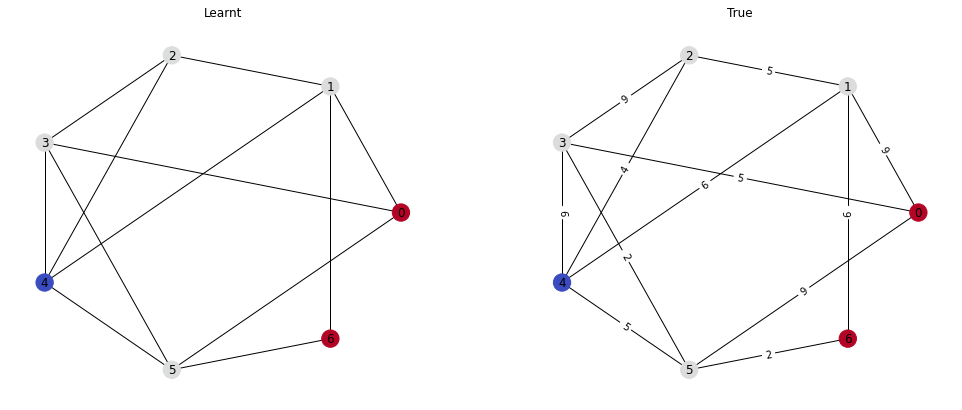

Passes: 2
tensor([2.0050, 2.0048, 1.0026, 1.0024, 1.0023, 0.0000, 1.0026],
       device='cuda:0')
tensor([2., 2., 1., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.0028172903694212437	Similarity: 1.0


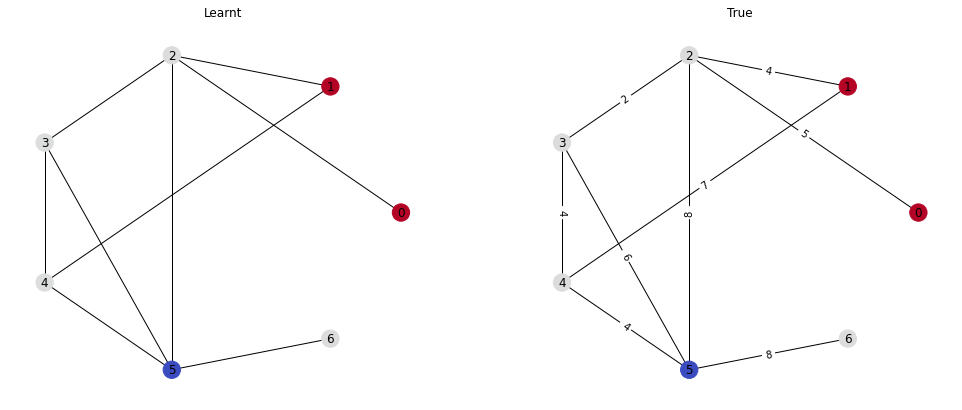

Passes: 3
tensor([3.0070, 2.0043, 1.0022, 0.0000, 1.0024, 2.0050, 3.0066],
       device='cuda:0')
tensor([3., 2., 1., 0., 1., 2., 3.], device='cuda:0')
Loss: 0.003932987339794636	Similarity: 1.0


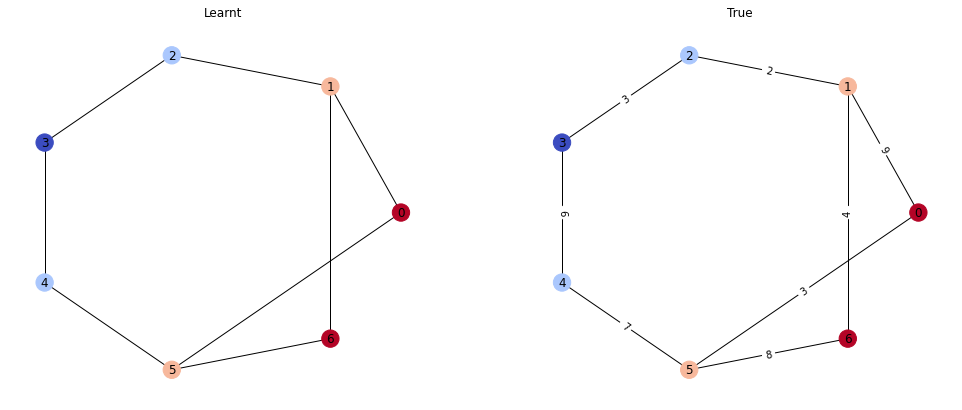

Passes: 2
tensor([2.0048, 1.0024, 1.0022, 2.0045, 1.0027, 0.0000, 2.0050],
       device='cuda:0')
tensor([2., 1., 1., 2., 1., 0., 2.], device='cuda:0')
Loss: 0.0030727898702025414	Similarity: 1.0


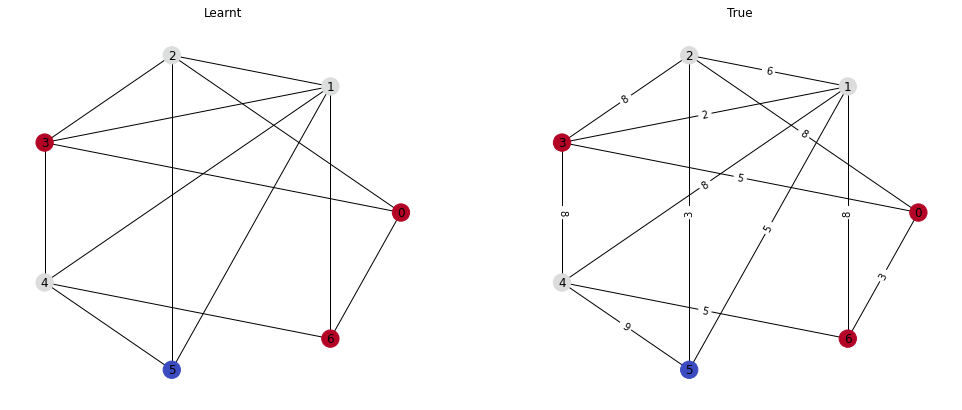

Passes: 2
tensor([1.0023, 2.0047, 1.0024, 0.0000, 1.0023, 2.0049], device='cuda:0')
tensor([1., 2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0027700464706867933	Similarity: 1.0


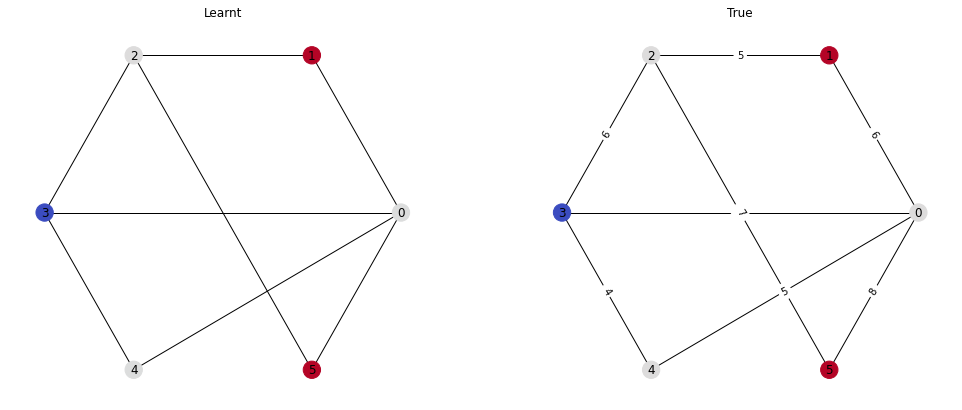

Passes: 2
tensor([0.0000, 1.0022, 2.0045, 2.0046, 1.0021, 2.0047, 2.0043],
       device='cuda:0')
tensor([0., 1., 2., 2., 1., 2., 2.], device='cuda:0')
Loss: 0.003211123635992408	Similarity: 1.0


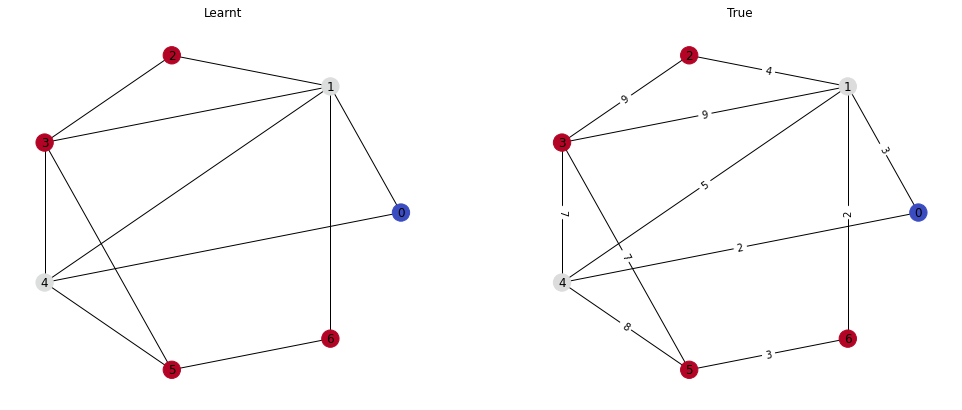

Passes: 1
tensor([0.0000, 1.0025, 1.0024, 1.0022, 1.0021, 1.0022, 1.0027],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0020250934176146984	Similarity: 1.0


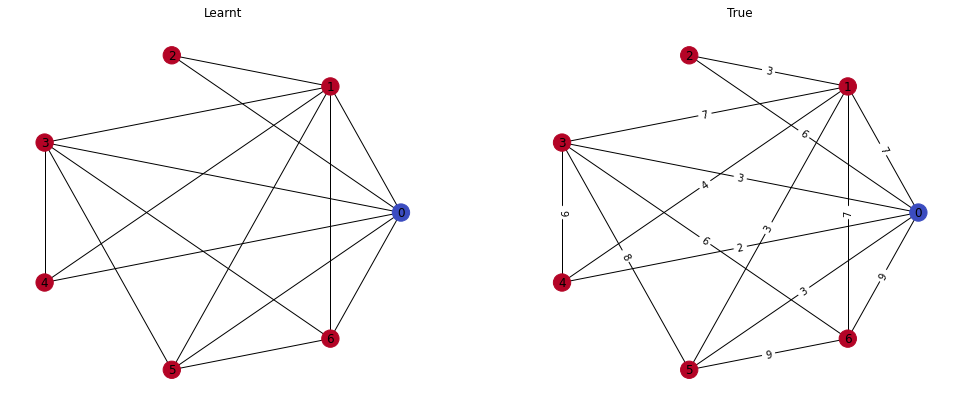

Passes: 2
tensor([2.0044, 1.0023, 1.0026, 2.0048, 1.0024, 0.0000], device='cuda:0')
tensor([2., 1., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.0027563772164285183	Similarity: 1.0


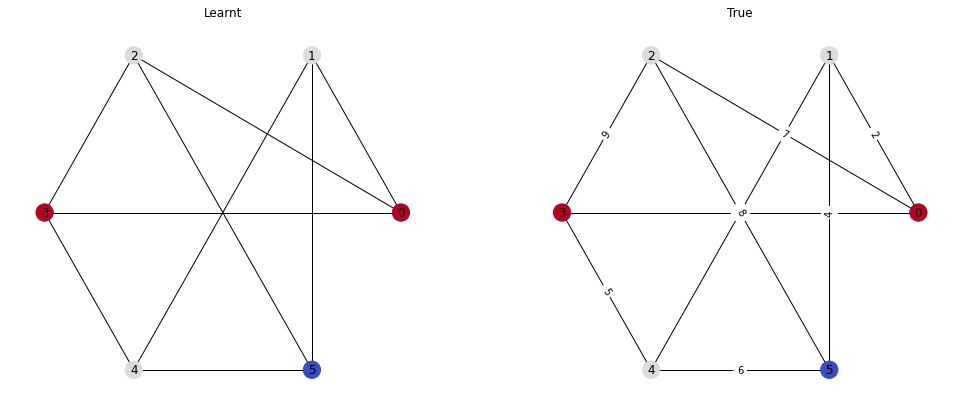

Passes: 2
tensor([1.0021, 1.0027, 1.0021, 0.0000, 1.0022, 2.0045, 2.0048],
       device='cuda:0')
tensor([1., 1., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.002629825146868825	Similarity: 1.0


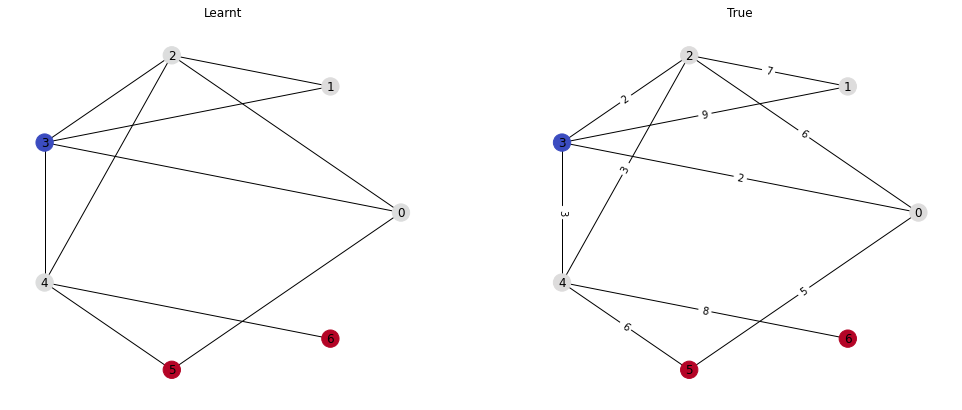

Passes: 2
tensor([1.0024, 0.0000, 1.0024, 1.0022, 1.0022, 2.0046, 2.0046],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.002618108643218875	Similarity: 1.0


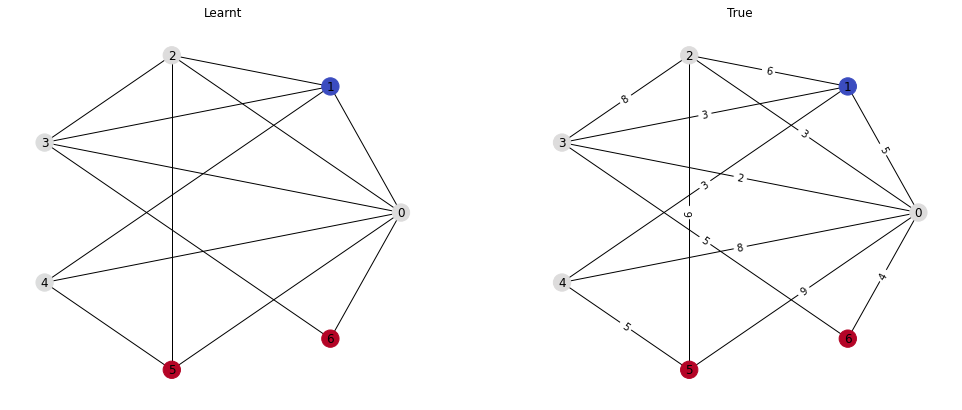

Passes: 3
tensor([0.0000, 1.0027, 1.0025, 1.0021, 2.0049, 2.0046, 3.0075],
       device='cuda:0')
tensor([0., 1., 1., 1., 2., 2., 3.], device='cuda:0')
Loss: 0.0034805878531187773	Similarity: 1.0


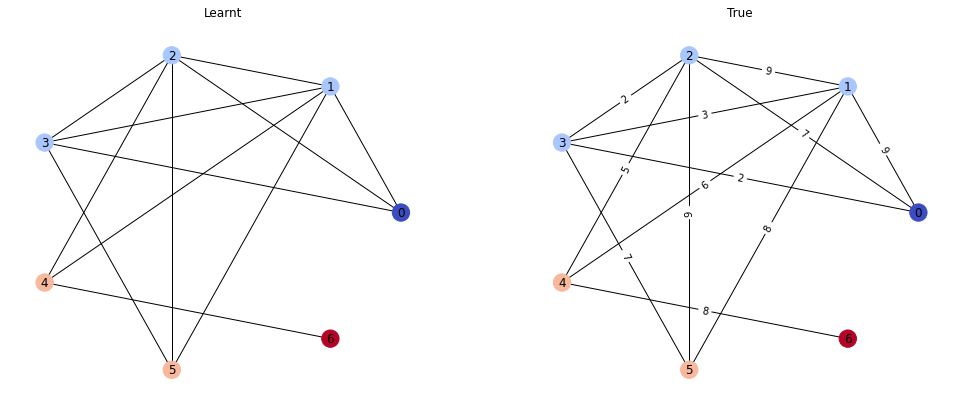

Passes: 2
tensor([0.0000, 1.0024, 2.0044, 2.0048, 1.0025, 1.0025, 1.0022],
       device='cuda:0')
tensor([0., 1., 2., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.0027001246344298124	Similarity: 1.0


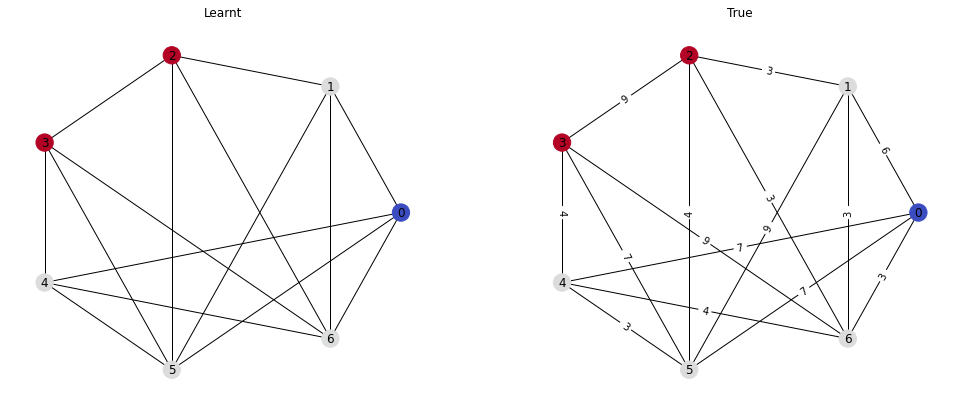

Passes: 2
tensor([2.0046, 0.0000, 2.0046, 1.0026, 1.0024, 1.0023, 1.0025],
       device='cuda:0')
tensor([2., 0., 2., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0027235576417297125	Similarity: 1.0


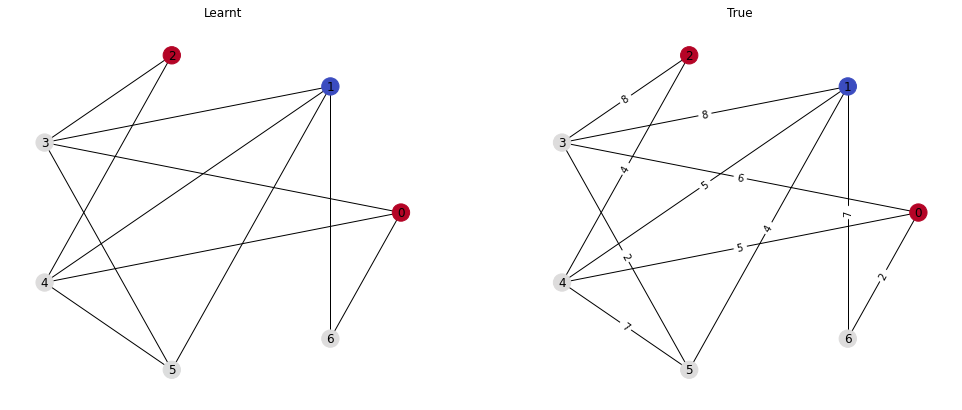

Passes: 2
tensor([1.0024, 1.0027, 1.0025, 2.0046, 0.0000, 1.0026, 1.0022],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.002432908397167921	Similarity: 1.0


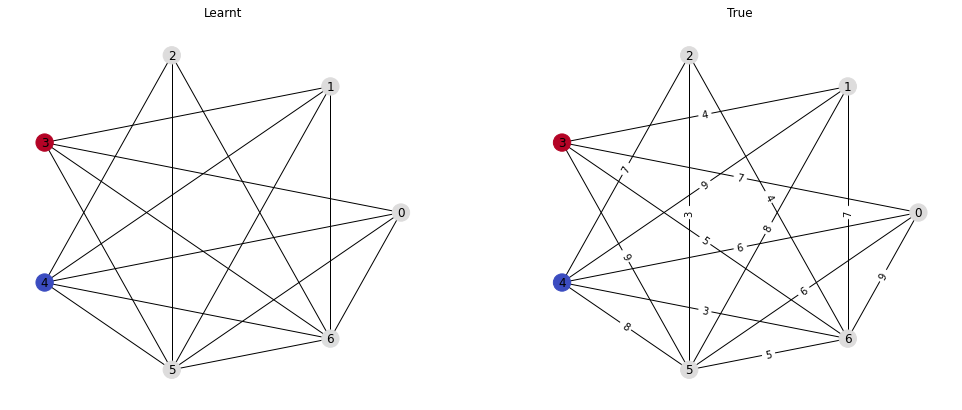

Passes: 2
tensor([0.0000, 2.0044, 2.0046, 1.0022, 1.0024, 1.0024, 1.0023],
       device='cuda:0')
tensor([0., 2., 2., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.002618108643218875	Similarity: 1.0


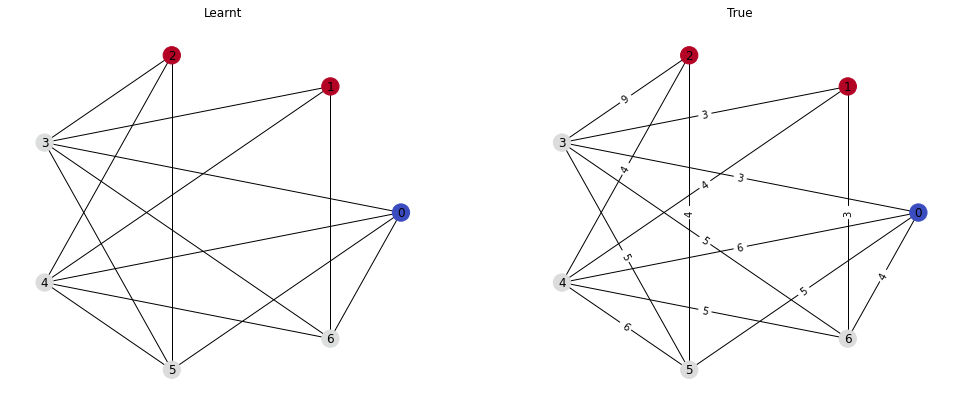

Passes: 3
tensor([1.0022, 1.0024, 2.0047, 3.0071, 2.0044, 1.0021, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 3., 2., 1., 0.], device='cuda:0')
Loss: 0.0032696896232664585	Similarity: 1.0


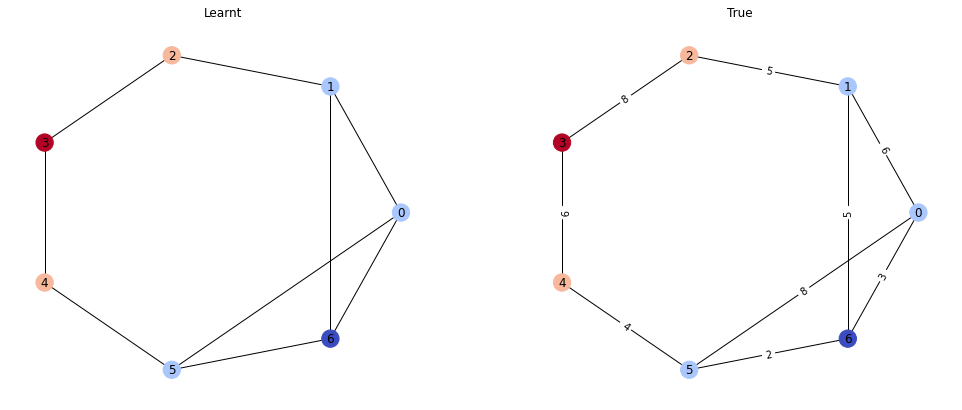

Passes: 2
tensor([0.0000, 1.0024, 2.0046, 1.0024, 1.0027, 2.0050], device='cuda:0')
tensor([0., 1., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.002838393207639456	Similarity: 1.0


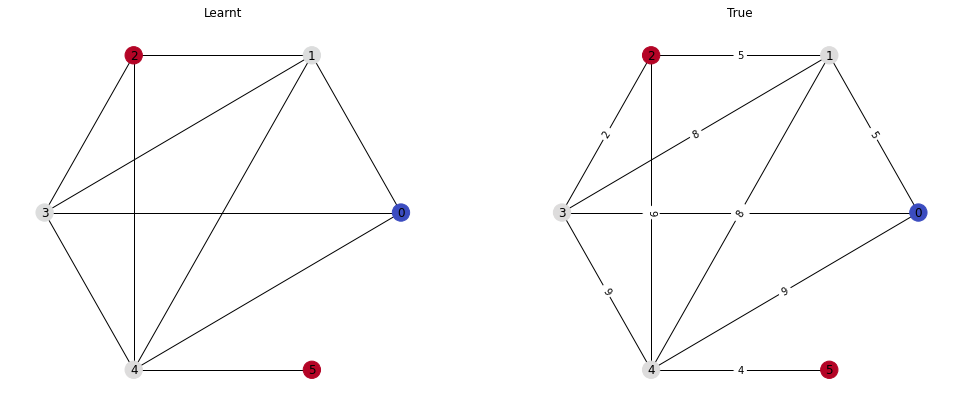

Passes: 2
tensor([2.0049, 0.0000, 1.0025, 1.0024, 2.0046, 2.0050, 2.0050],
       device='cuda:0')
tensor([2., 0., 1., 1., 2., 2., 2.], device='cuda:0')
Loss: 0.003480604849755764	Similarity: 1.0


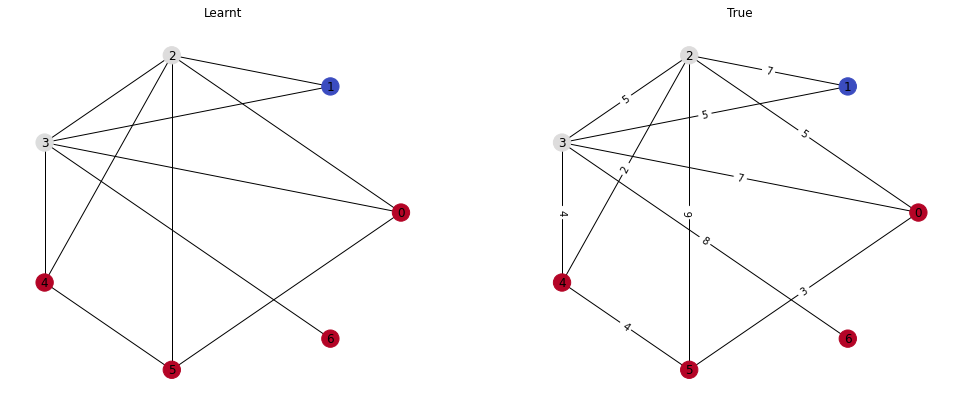

Passes: 2
tensor([1.0022, 1.0026, 1.0022, 0.0000, 1.0022, 2.0046, 2.0048],
       device='cuda:0')
tensor([1., 1., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.0026649748906493187	Similarity: 1.0


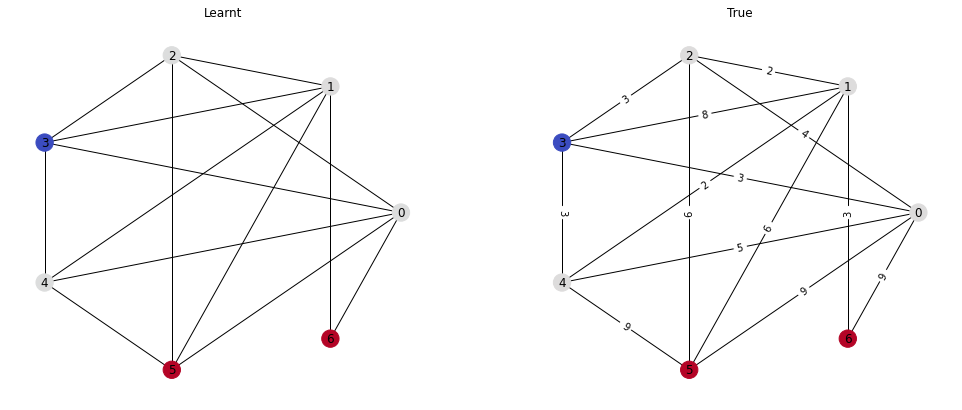

Passes: 2
tensor([2.0049, 2.0047, 1.0024, 0.0000, 2.0046, 2.0044, 1.0023],
       device='cuda:0')
tensor([2., 2., 1., 0., 2., 2., 1.], device='cuda:0')
Loss: 0.003328289370983839	Similarity: 1.0


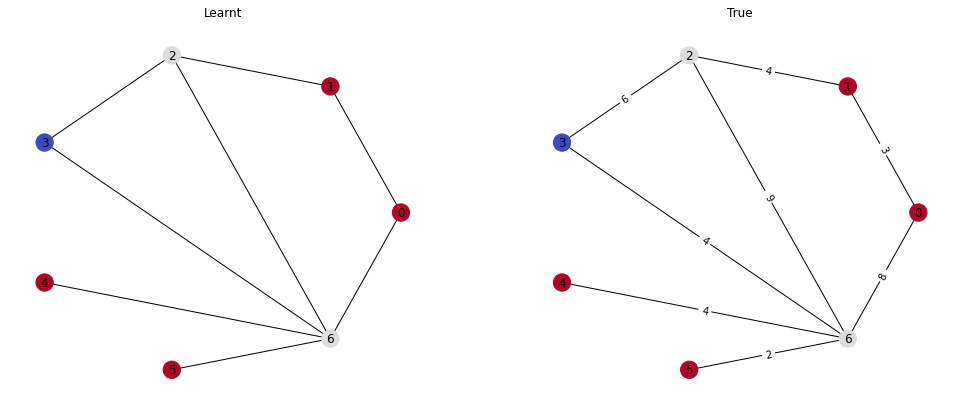

Passes: 2
tensor([1.0021, 2.0047, 1.0024, 2.0046, 2.0045, 0.0000], device='cuda:0')
tensor([1., 2., 1., 2., 2., 0.], device='cuda:0')
Loss: 0.003054460044950247	Similarity: 1.0


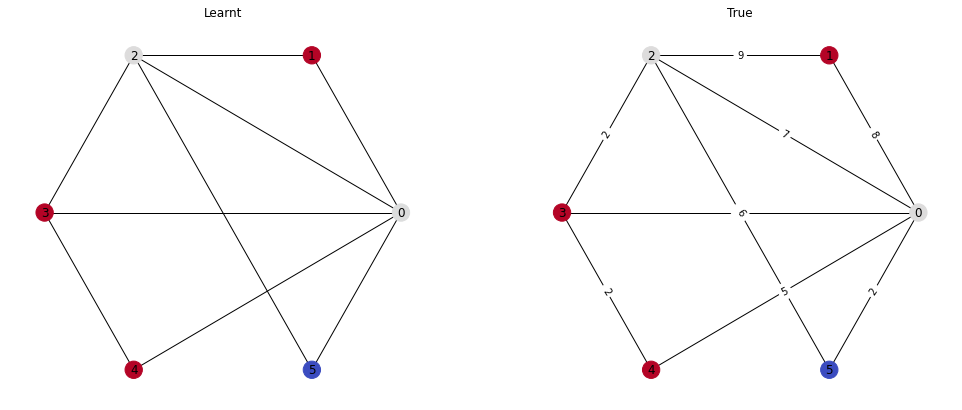

Passes: 3
tensor([2.0046, 2.0049, 1.0024, 0.0000, 3.0071, 2.0050, 1.0027],
       device='cuda:0')
tensor([2., 2., 1., 0., 3., 2., 1.], device='cuda:0')
Loss: 0.0038063868414610624	Similarity: 1.0


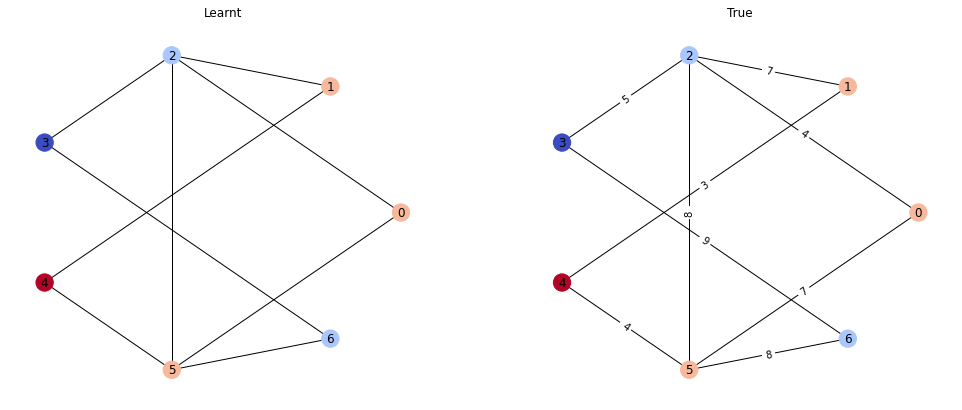

Passes: 2
tensor([1.0026, 1.0024, 2.0049, 2.0047, 2.0047, 0.0000, 2.0051],
       device='cuda:0')
tensor([1., 1., 2., 2., 2., 0., 2.], device='cuda:0')
Loss: 0.003492321353405714	Similarity: 1.0


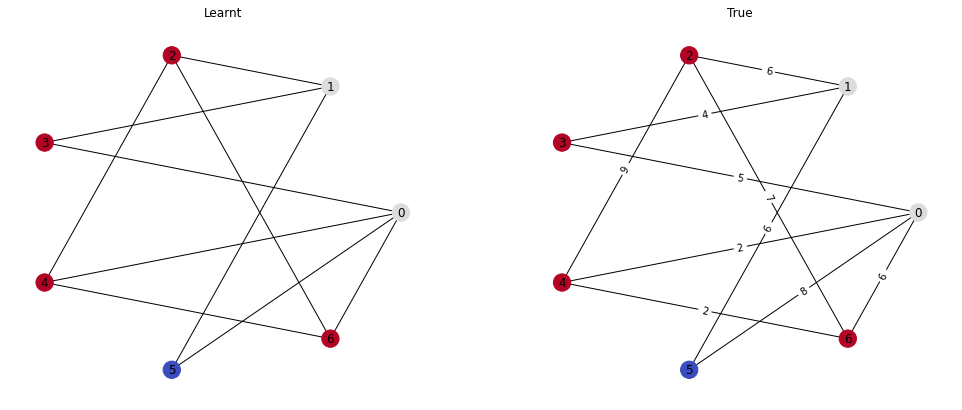

Passes: 2
tensor([2.0051, 2.0046, 1.0021, 1.0024, 2.0044, 1.0021, 0.0000],
       device='cuda:0')
tensor([2., 2., 1., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.00295562413521111	Similarity: 1.0


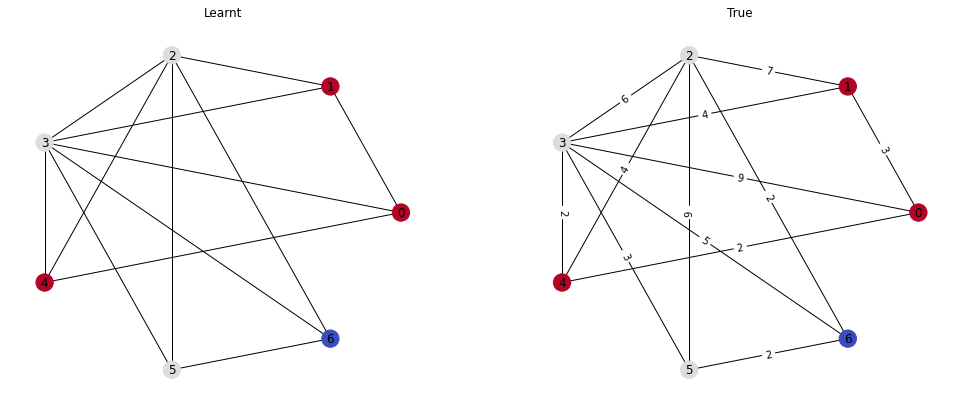

Passes: 2
tensor([1.0023, 1.0022, 0.0000, 1.0026, 1.0025, 2.0043, 2.0045],
       device='cuda:0')
tensor([1., 1., 0., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.002629825146868825	Similarity: 1.0


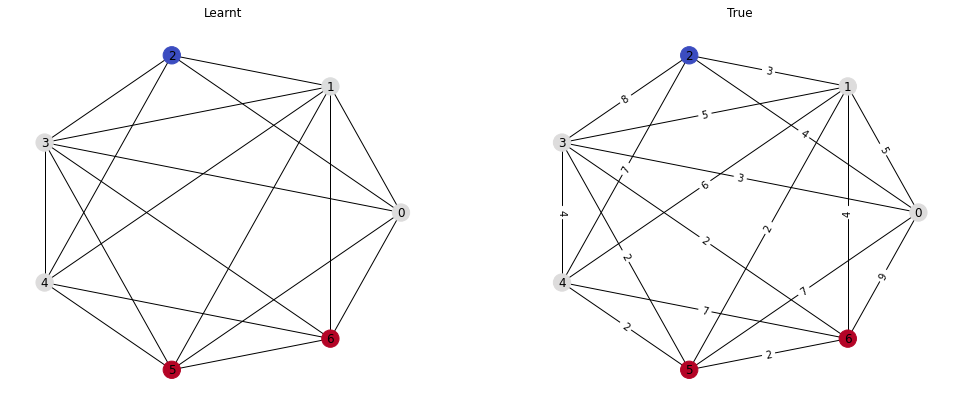

Passes: 3
tensor([3.0068, 1.0024, 1.0022, 2.0046, 2.0045, 1.0027, 0.0000],
       device='cuda:0')
tensor([3., 1., 1., 2., 2., 1., 0.], device='cuda:0')
Loss: 0.0033048393670469522	Similarity: 1.0


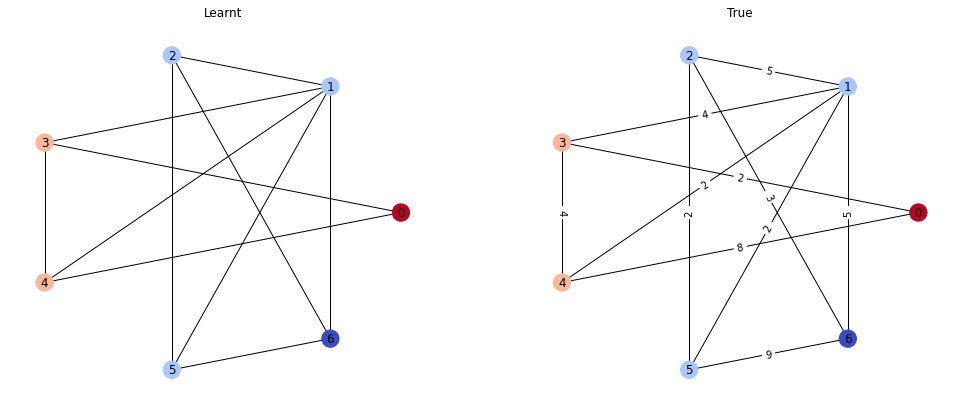

Passes: 2
tensor([1.0024, 1.0027, 1.0024, 0.0000, 2.0048, 2.0044, 1.0023],
       device='cuda:0')
tensor([1., 1., 1., 0., 2., 2., 1.], device='cuda:0')
Loss: 0.0027235576417297125	Similarity: 1.0


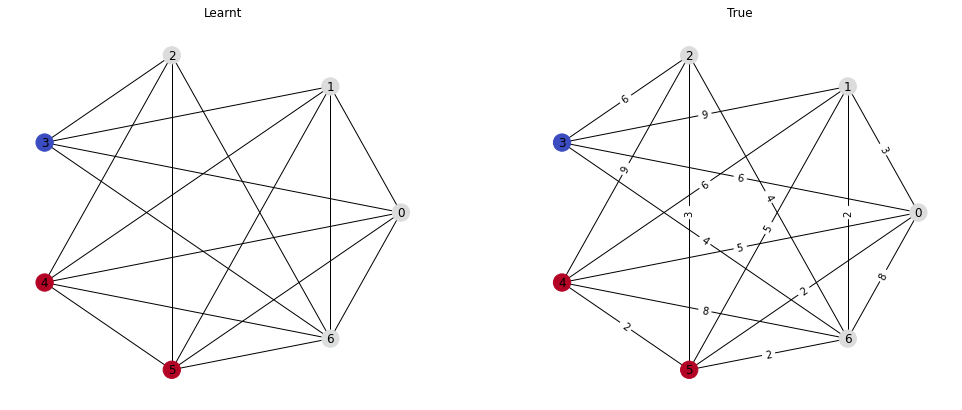

Passes: 2
tensor([0.0000, 1.0022, 1.0025, 1.0021, 1.0025, 2.0043], device='cuda:0')
tensor([0., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.002280592918395996	Similarity: 1.0


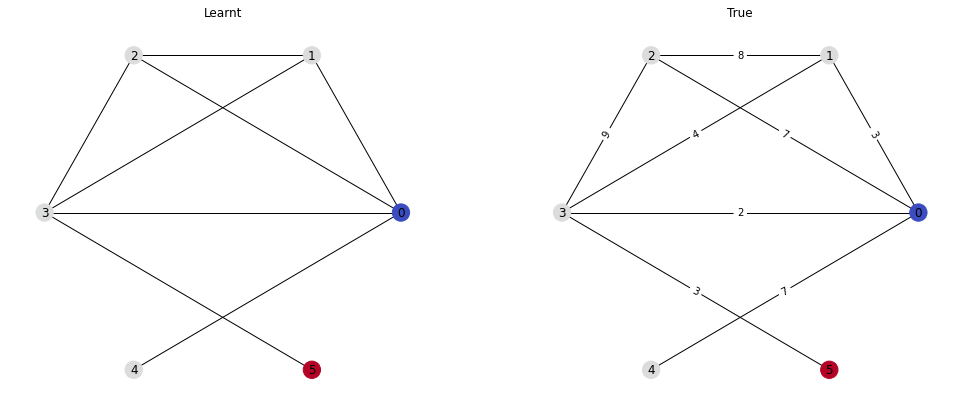

Passes: 2
tensor([1.0023, 1.0024, 1.0027, 1.0025, 0.0000, 1.0026, 2.0051],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0025266408920288086	Similarity: 1.0


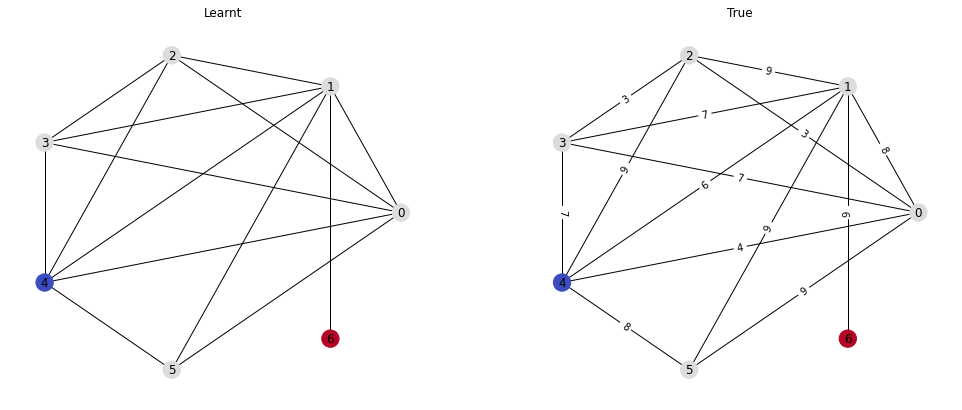

Passes: 3
tensor([1.0023, 2.0045, 1.0024, 2.0046, 1.0026, 0.0000, 3.0067],
       device='cuda:0')
tensor([1., 2., 1., 2., 1., 0., 3.], device='cuda:0')
Loss: 0.0032814061269164085	Similarity: 1.0


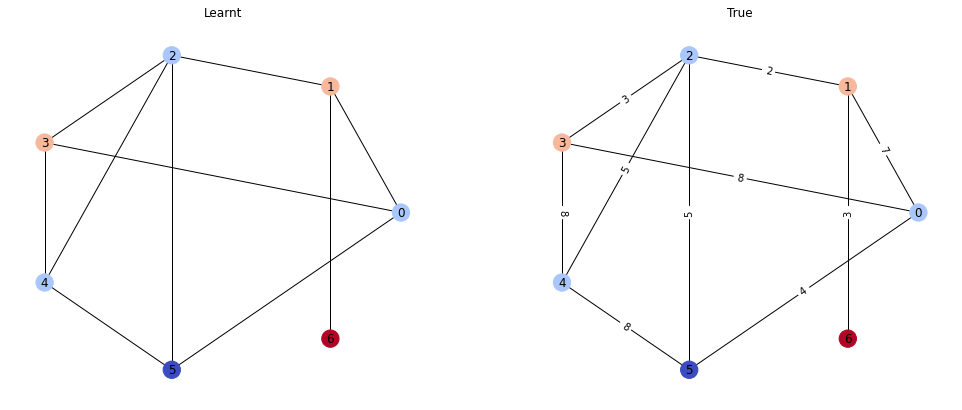

Passes: 2
tensor([2.0045, 2.0046, 0.0000, 1.0023, 1.0026, 1.0024, 2.0045],
       device='cuda:0')
tensor([2., 2., 0., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.00296734063886106	Similarity: 1.0


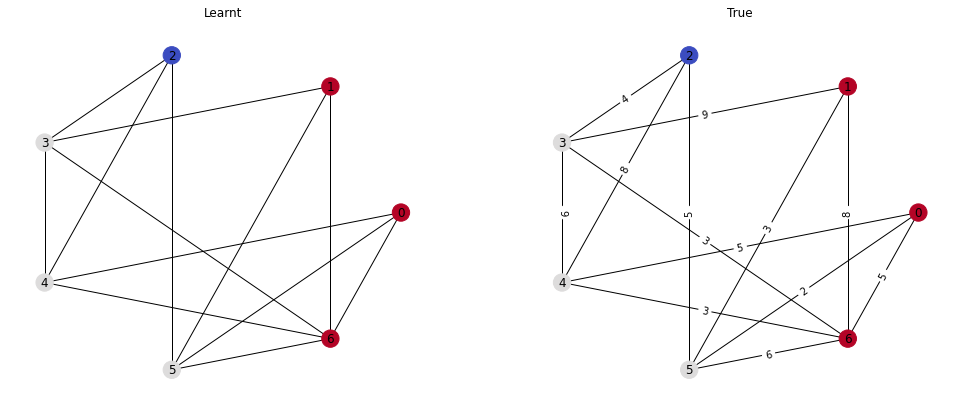

Passes: 2
tensor([0.0000, 2.0046, 2.0052, 2.0051, 1.0021, 1.0026, 1.0027],
       device='cuda:0')
tensor([0., 2., 2., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.0032016721088439226	Similarity: 1.0


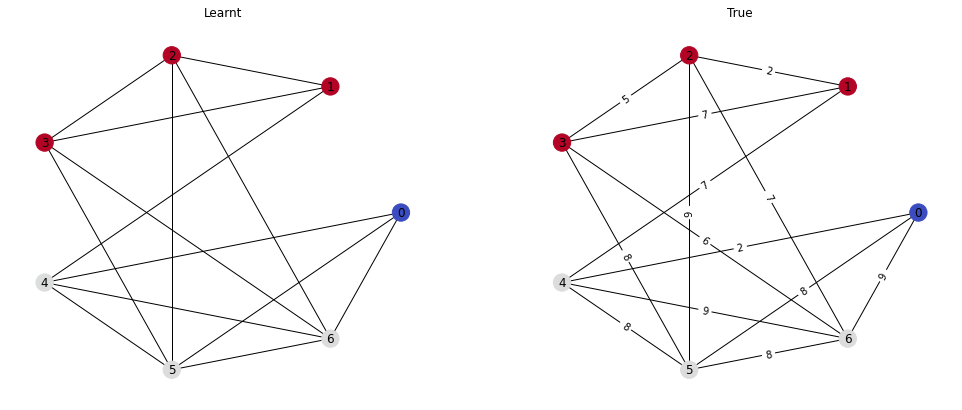

Passes: 2
tensor([2.0053, 1.0027, 2.0052, 2.0051, 0.0000, 1.0024, 1.0026],
       device='cuda:0')
tensor([2., 1., 2., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.003330554347485304	Similarity: 1.0


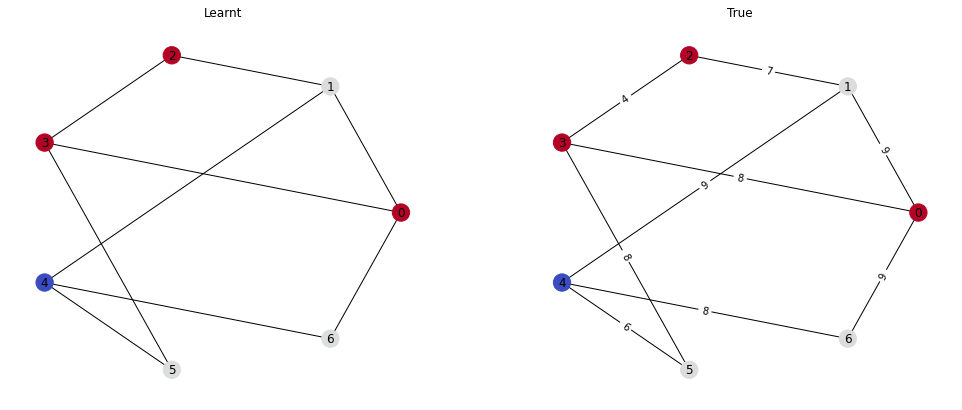

Passes: 2
tensor([1.0021, 2.0046, 1.0027, 1.0026, 2.0042, 1.0025, 0.0000],
       device='cuda:0')
tensor([1., 2., 1., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


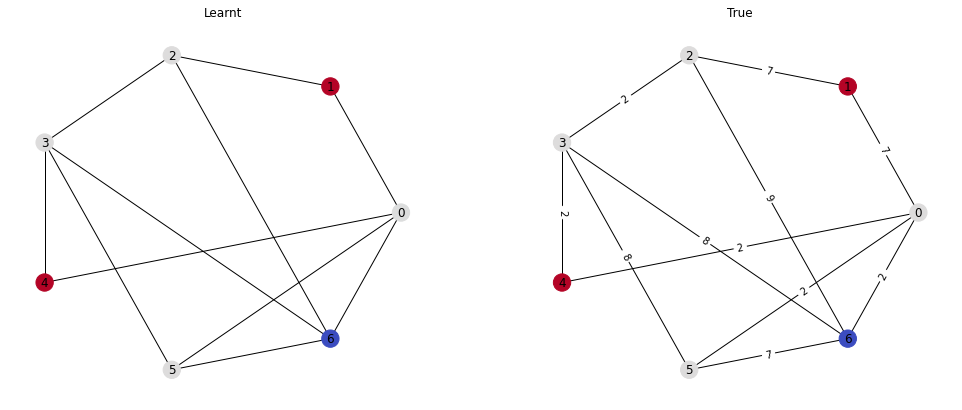

Passes: 3
tensor([3.0068, 3.0074, 2.0048, 1.0024, 2.0043, 1.0021, 0.0000],
       device='cuda:0')
tensor([3., 3., 2., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.003979853354394436	Similarity: 1.0


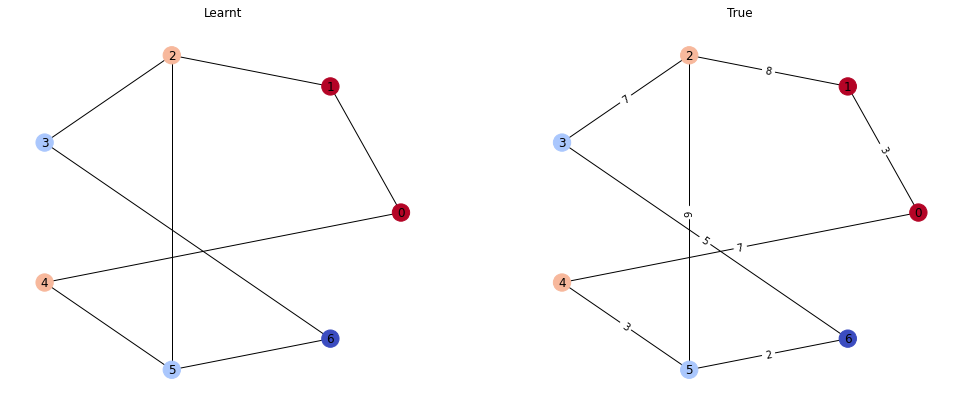

Passes: 3
tensor([3.0073, 0.0000, 1.0024, 1.0025, 1.0023, 2.0047, 2.0046],
       device='cuda:0')
tensor([3., 0., 1., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.00341028836555779	Similarity: 1.0


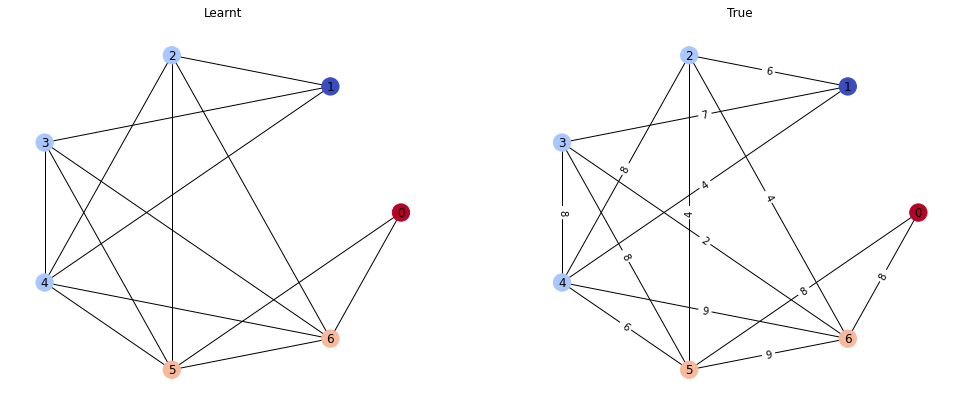

Passes: 2
tensor([2.0049, 0.0000, 2.0046, 1.0024, 1.0026, 1.0024, 1.0024],
       device='cuda:0')
tensor([2., 0., 2., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0027587073855102062	Similarity: 1.0


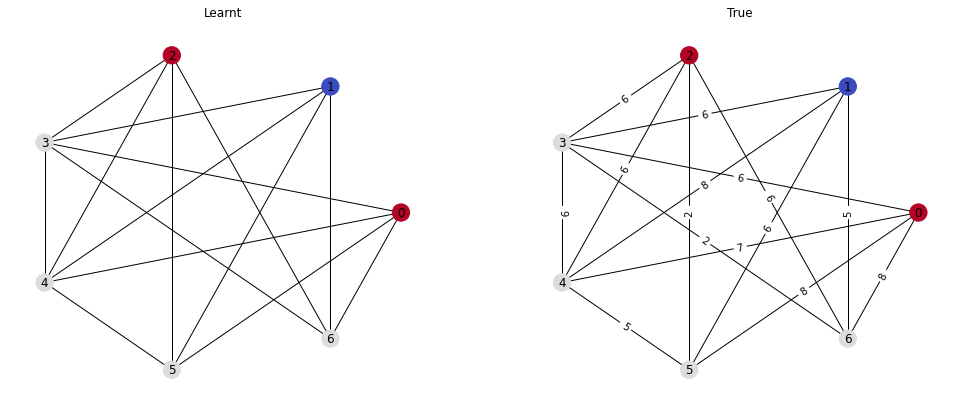

Passes: 2
tensor([0.0000, 1.0025, 2.0046, 1.0022, 2.0043, 1.0021, 1.0027],
       device='cuda:0')
tensor([0., 1., 2., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.002629825146868825	Similarity: 1.0


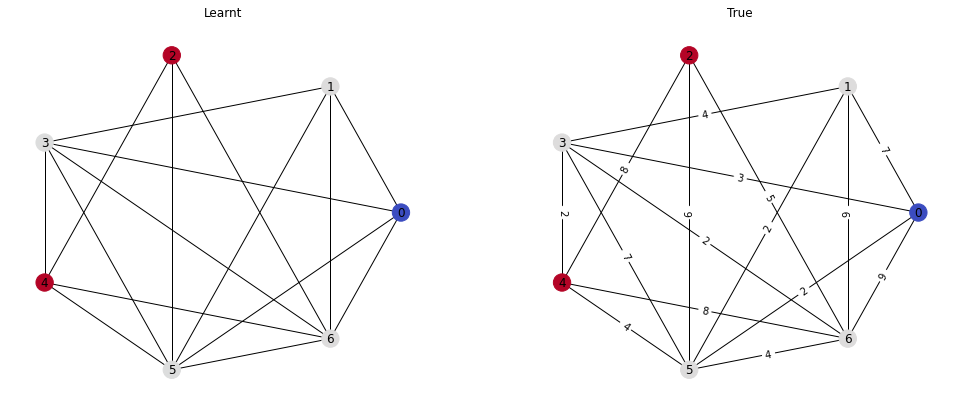

Passes: 2
tensor([1.0027, 2.0044, 1.0022, 0.0000, 1.0024, 2.0043, 2.0048],
       device='cuda:0')
tensor([1., 2., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.00296734063886106	Similarity: 1.0


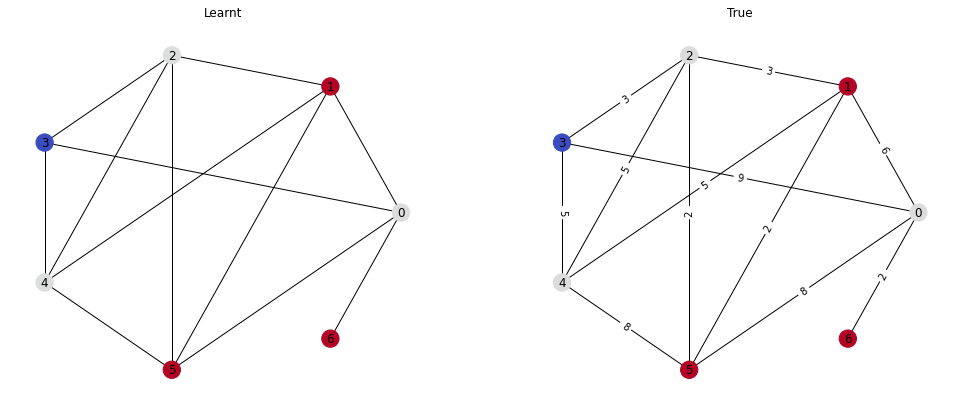

Passes: 2
tensor([1.0025, 0.0000, 1.0027, 2.0048, 1.0021, 2.0045, 1.0026],
       device='cuda:0')
tensor([1., 0., 1., 2., 1., 2., 1.], device='cuda:0')
Loss: 0.002746990881860256	Similarity: 1.0


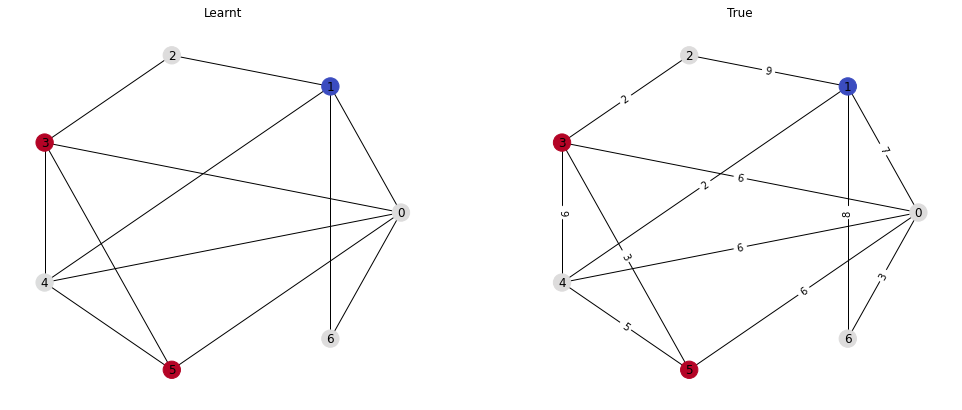

Passes: 2
tensor([2.0046, 2.0045, 2.0044, 0.0000, 1.0023, 1.0023, 2.0047],
       device='cuda:0')
tensor([2., 2., 2., 0., 1., 1., 2.], device='cuda:0')
Loss: 0.003257990116253495	Similarity: 1.0


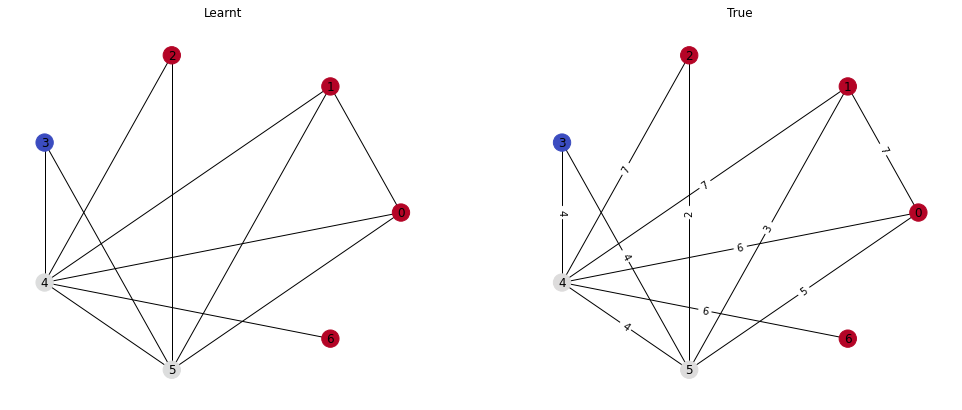

Passes: 2
tensor([2.0051, 1.0026, 0.0000, 1.0024, 2.0047, 1.0024, 2.0047],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.003154805861413479	Similarity: 1.0


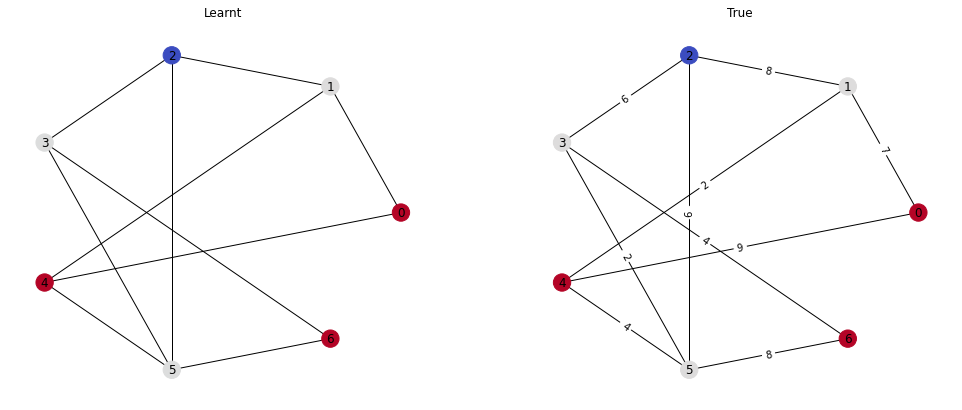

Passes: 2
tensor([1.0021, 2.0042, 2.0050, 1.0024, 0.0000, 1.0022, 2.0043],
       device='cuda:0')
tensor([1., 2., 2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0028970413841307163	Similarity: 1.0


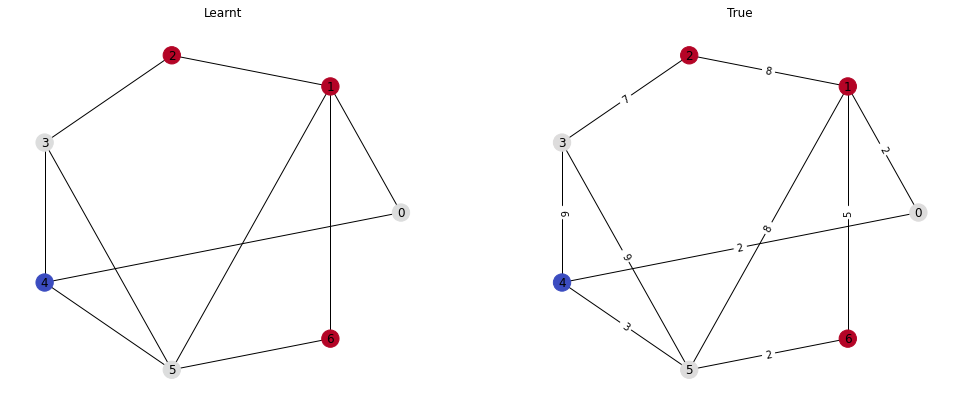

Passes: 2
tensor([1.0023, 2.0044, 2.0048, 1.0027, 0.0000, 1.0022, 1.0021],
       device='cuda:0')
tensor([1., 2., 2., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.002641541650518775	Similarity: 1.0


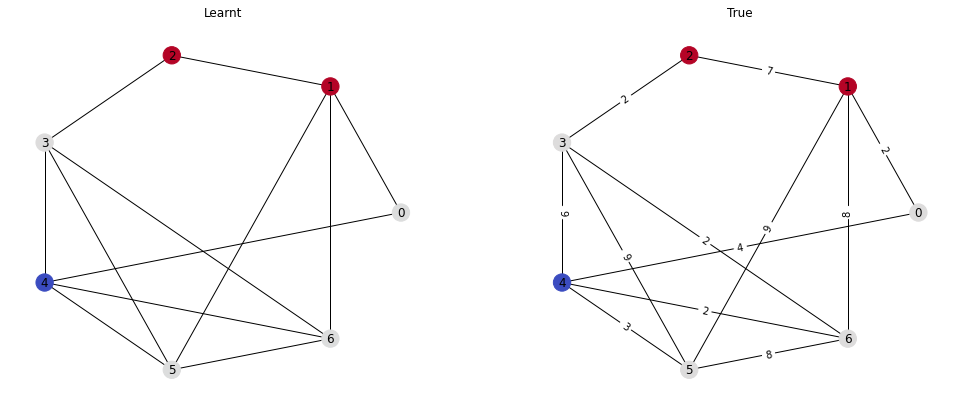

Passes: 2
tensor([2.0047, 2.0047, 1.0021, 1.0023, 0.0000, 2.0046, 1.0024],
       device='cuda:0')
tensor([2., 2., 1., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.002979057375341654	Similarity: 1.0


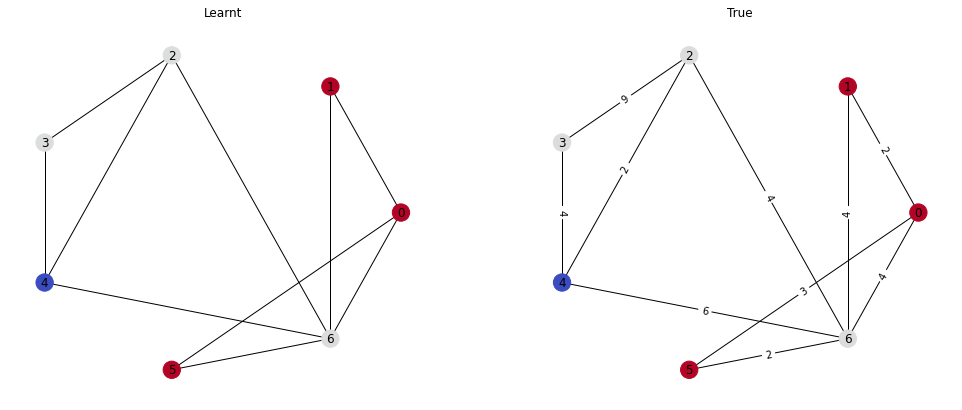

Passes: 1
tensor([0.0000, 1.0022], device='cuda:0')
tensor([0., 1.], device='cuda:0')
Loss: 0.0010992884635925293	Similarity: 1.0


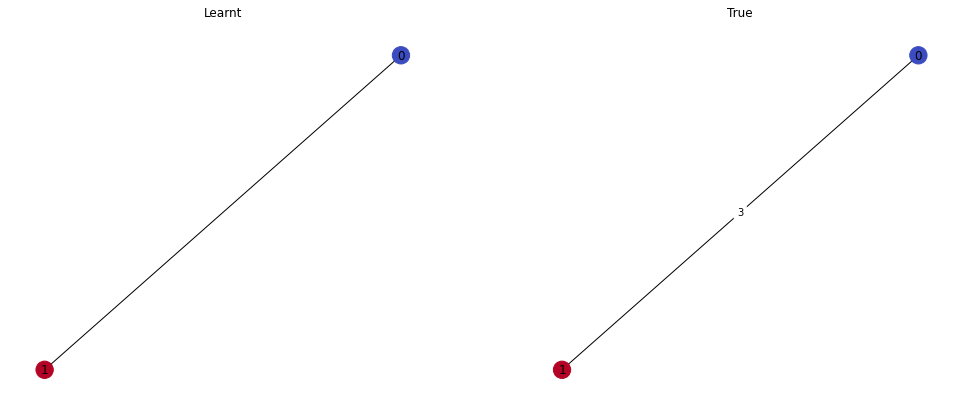

Passes: 2
tensor([1.0026, 1.0027, 1.0025, 2.0049, 0.0000, 1.0024, 1.0024],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.0025032078847289085	Similarity: 1.0


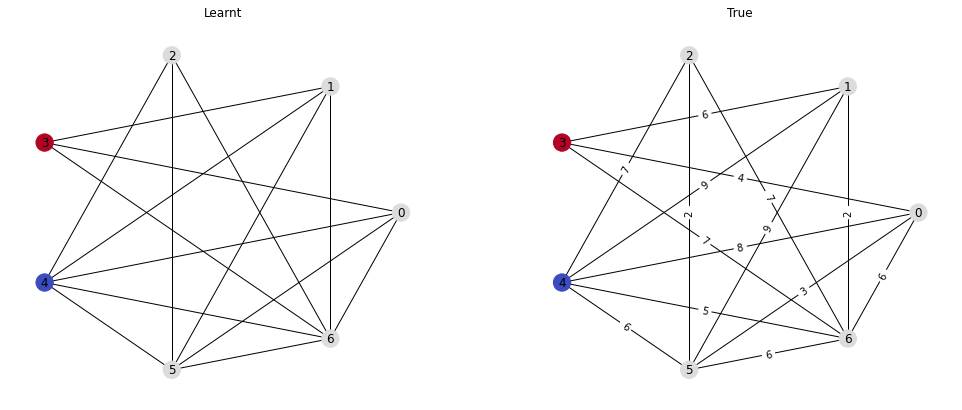

Passes: 3
tensor([3.0077, 1.0027, 1.0022, 2.0052, 0.0000, 2.0048, 2.0048],
       device='cuda:0')
tensor([3., 1., 1., 2., 0., 2., 2.], device='cuda:0')
Loss: 0.003911836072802544	Similarity: 1.0


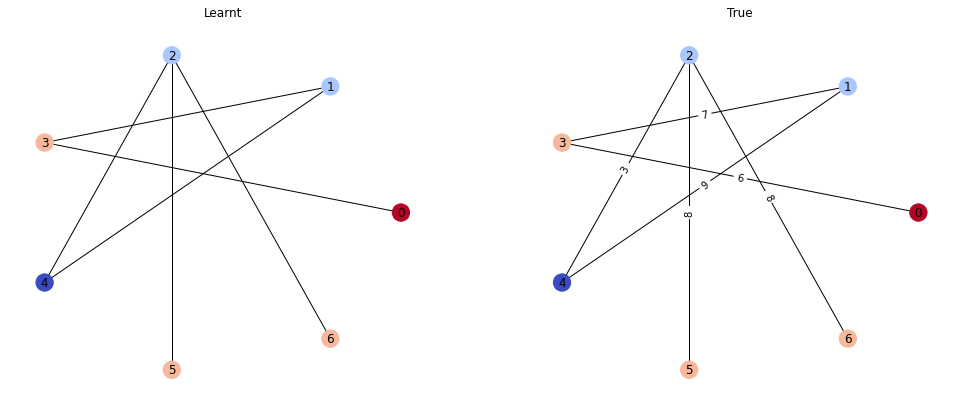

Passes: 2
tensor([2.0043, 2.0044, 1.0024, 1.0024, 0.0000, 1.0024, 1.0022],
       device='cuda:0')
tensor([2., 2., 1., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.002582958899438381	Similarity: 1.0


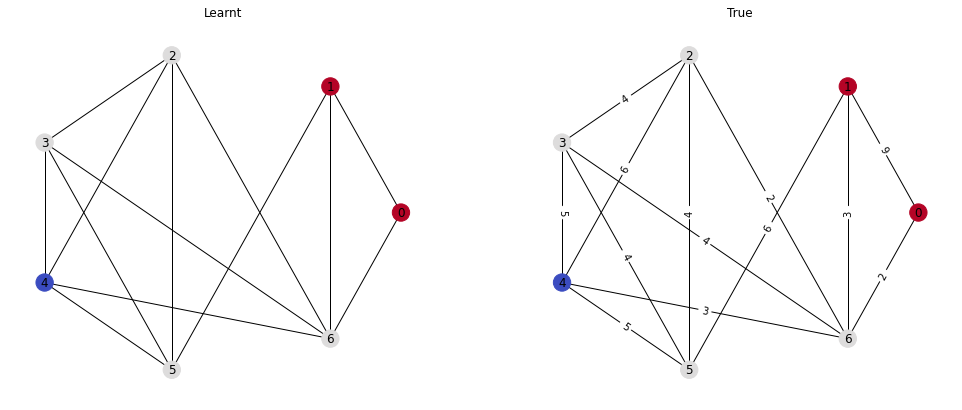

Passes: 2
tensor([0.0000, 1.0026, 1.0027, 2.0050, 2.0050, 1.0024, 2.0051],
       device='cuda:0')
tensor([0., 1., 1., 2., 2., 1., 2.], device='cuda:0')
Loss: 0.0032485383562743664	Similarity: 1.0


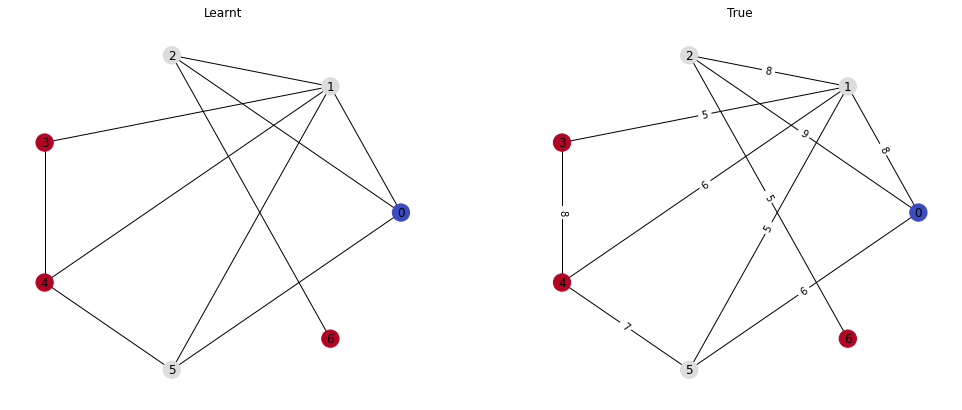

Passes: 1
tensor([1.0023, 0.0000, 1.0021, 1.0026, 1.0024, 1.0027, 1.0021],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0020368099212646484	Similarity: 1.0


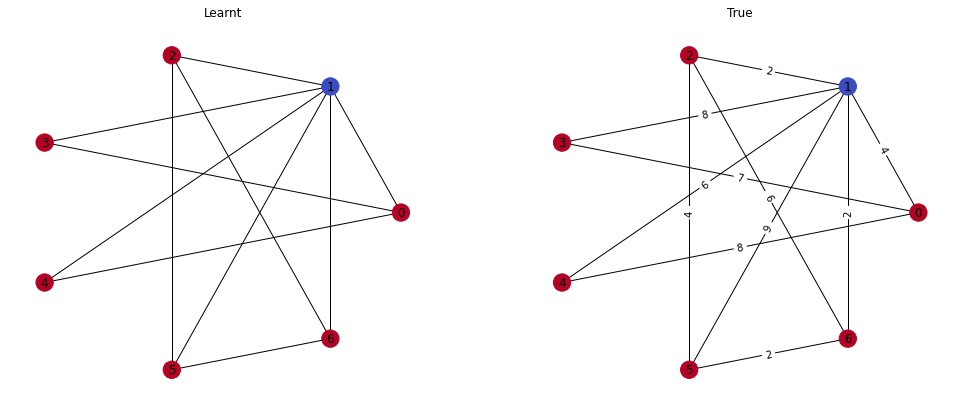

Passes: 2
tensor([1.0024, 1.0025, 1.0026, 0.0000, 2.0047, 2.0047, 1.0024],
       device='cuda:0')
tensor([1., 1., 1., 0., 2., 2., 1.], device='cuda:0')
Loss: 0.0027587073855102062	Similarity: 1.0


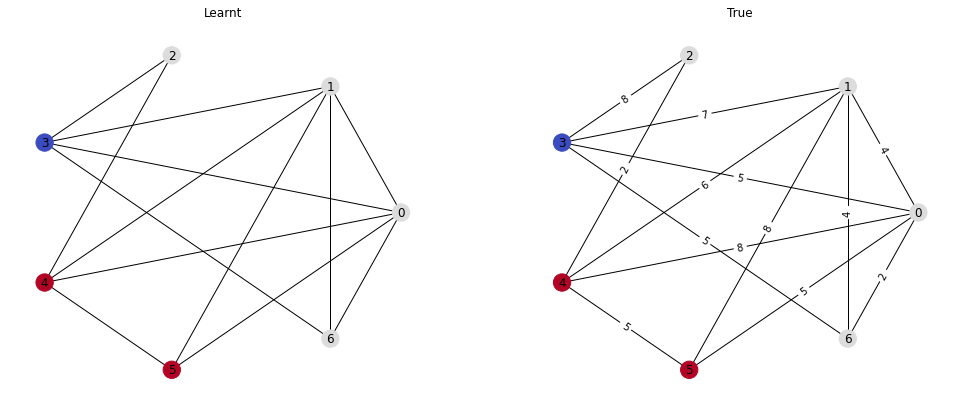

Passes: 2
tensor([2.0049, 0.0000, 1.0025, 2.0049, 1.0027, 2.0048, 1.0026],
       device='cuda:0')
tensor([2., 0., 1., 2., 1., 2., 1.], device='cuda:0')
Loss: 0.0032016721088439226	Similarity: 1.0


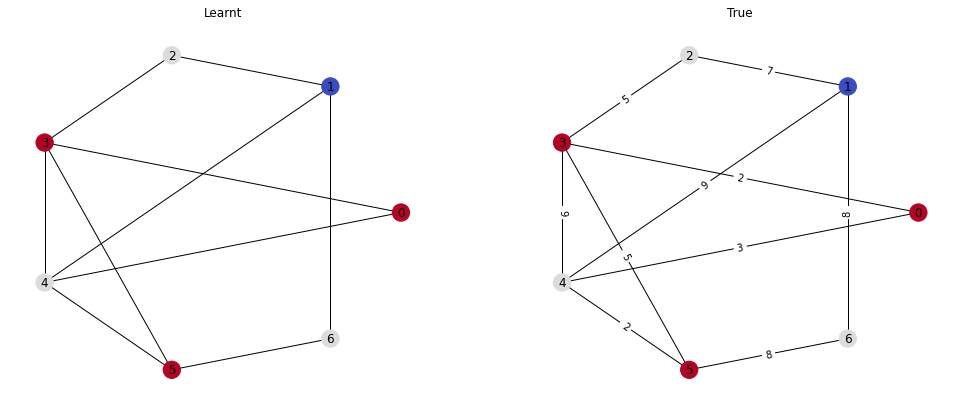

Passes: 2
tensor([1.0026, 1.0024, 1.0025, 0.0000, 2.0050, 2.0051, 2.0052],
       device='cuda:0')
tensor([1., 1., 1., 0., 2., 2., 2.], device='cuda:0')
Loss: 0.00326025509275496	Similarity: 1.0


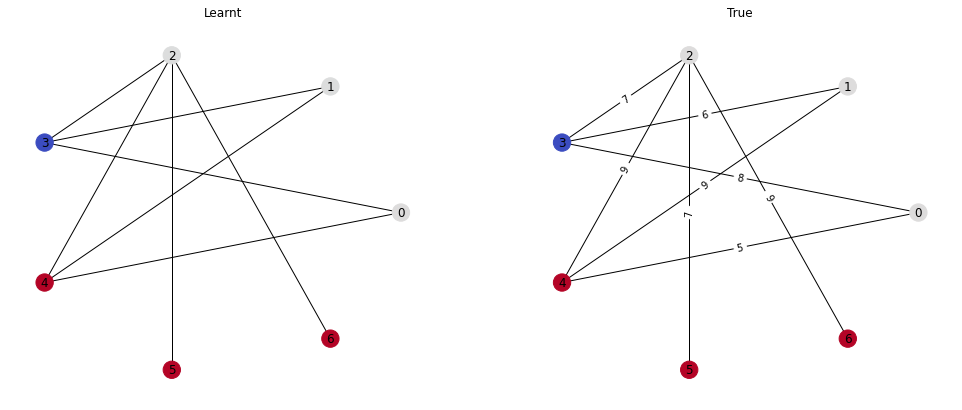

Passes: 2
tensor([0.0000, 1.0023, 1.0022, 2.0046, 2.0044, 1.0022, 2.0048],
       device='cuda:0')
tensor([0., 1., 1., 2., 2., 1., 2.], device='cuda:0')
Loss: 0.00293219112791121	Similarity: 1.0


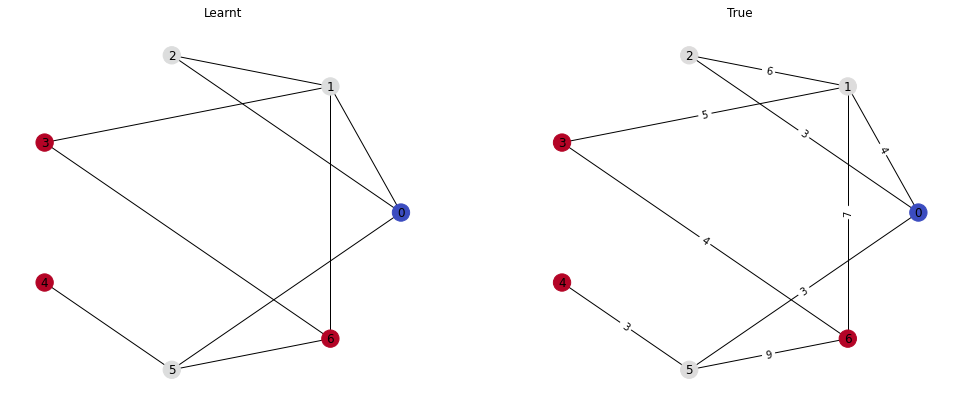

Passes: 3
tensor([3.0078, 3.0072, 2.0048, 3.0073, 2.0052, 1.0026, 0.0000],
       device='cuda:0')
tensor([3., 3., 2., 3., 2., 1., 0.], device='cuda:0')
Loss: 0.004982931539416313	Similarity: 1.0


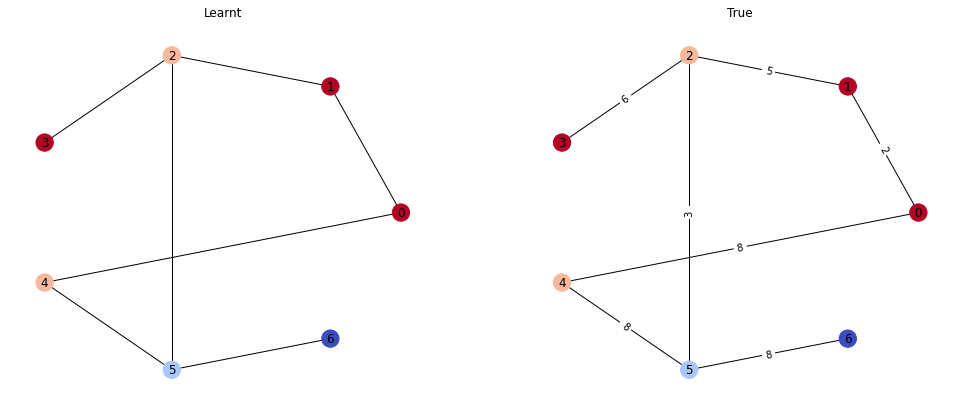

Passes: 3
tensor([3.0071, 2.0047, 1.0026, 1.0024, 2.0047, 2.0046, 0.0000],
       device='cuda:0')
tensor([3., 2., 1., 1., 2., 2., 0.], device='cuda:0')
Loss: 0.0037478040903806686	Similarity: 1.0


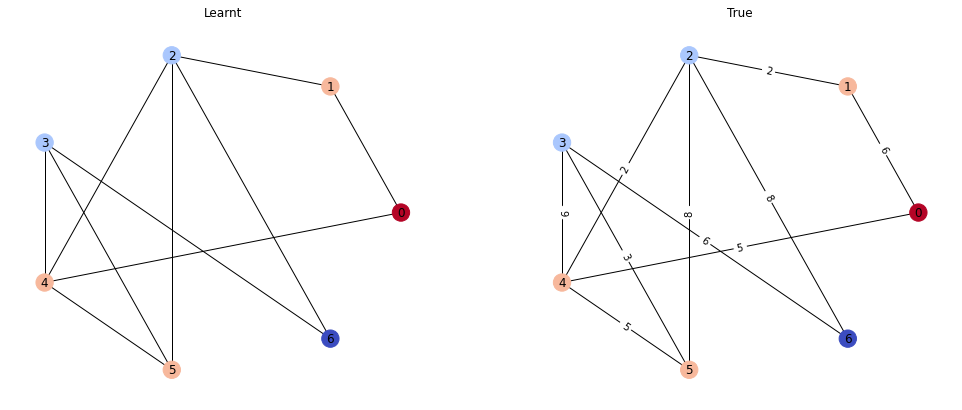

Passes: 2
tensor([2.0047, 1.0024, 1.0027, 1.0025, 0.0000, 1.0026, 1.0025],
       device='cuda:0')
tensor([2., 1., 1., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.0024914913810789585	Similarity: 1.0


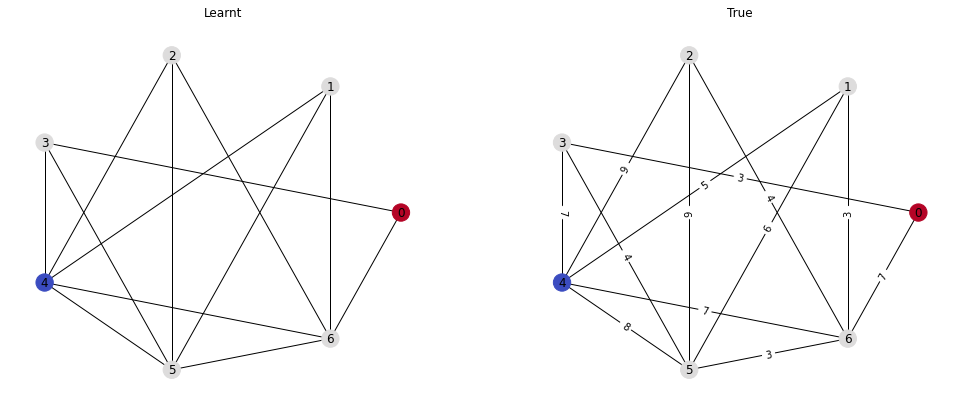

Passes: 2
tensor([2.0044, 1.0024, 0.0000, 1.0023, 1.0023, 2.0050, 2.0046],
       device='cuda:0')
tensor([2., 1., 0., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.002979057375341654	Similarity: 1.0


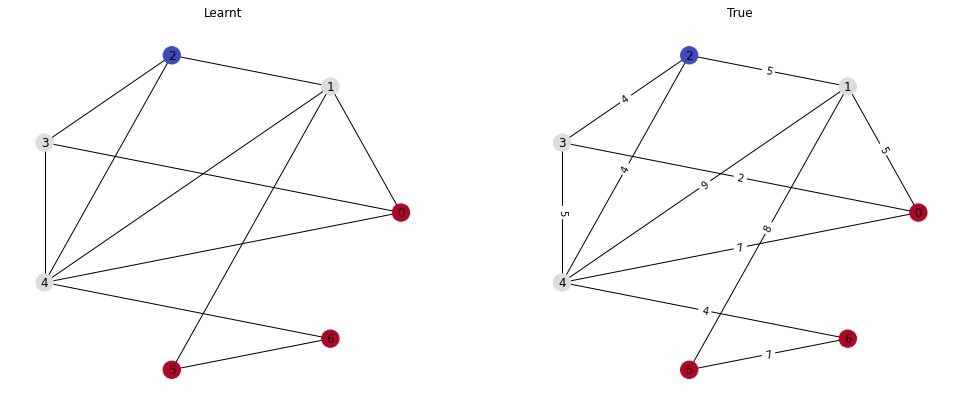

Passes: 2
tensor([2.0044, 2.0048, 1.0024, 0.0000, 1.0025, 2.0046, 1.0023],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.0030142071191221476	Similarity: 1.0


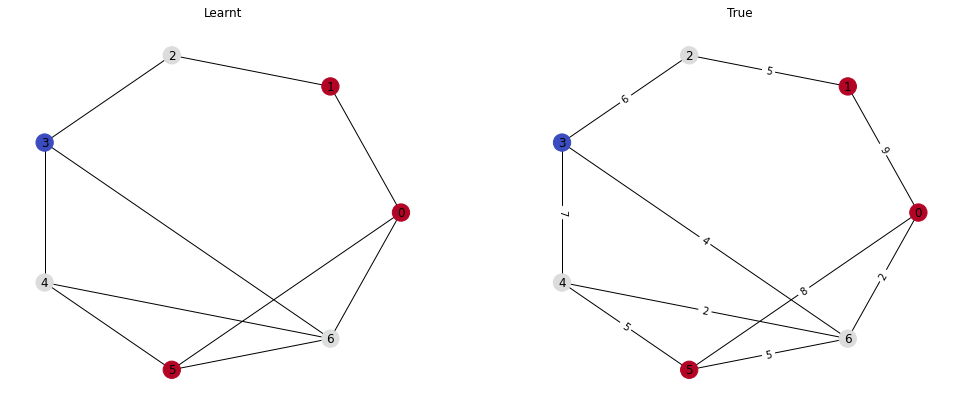

Passes: 2
tensor([0.0000, 1.0026, 2.0051, 2.0048, 1.0024, 2.0046, 2.0053],
       device='cuda:0')
tensor([0., 1., 2., 2., 1., 2., 2.], device='cuda:0')
Loss: 0.0035391878336668015	Similarity: 1.0


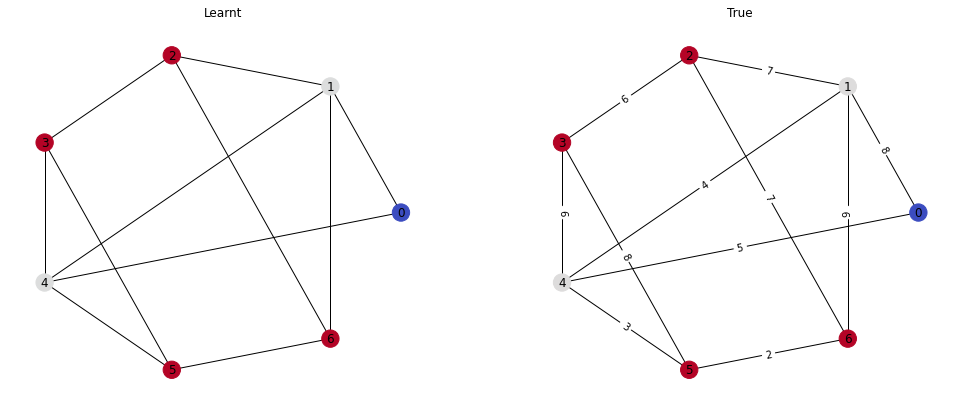

Passes: 4
tensor([1.0027, 3.0073, 2.0051, 2.0048, 1.0026, 0.0000, 4.0096],
       device='cuda:0')
tensor([1., 3., 2., 2., 1., 0., 4.], device='cuda:0')
Loss: 0.004586867056787014	Similarity: 1.0


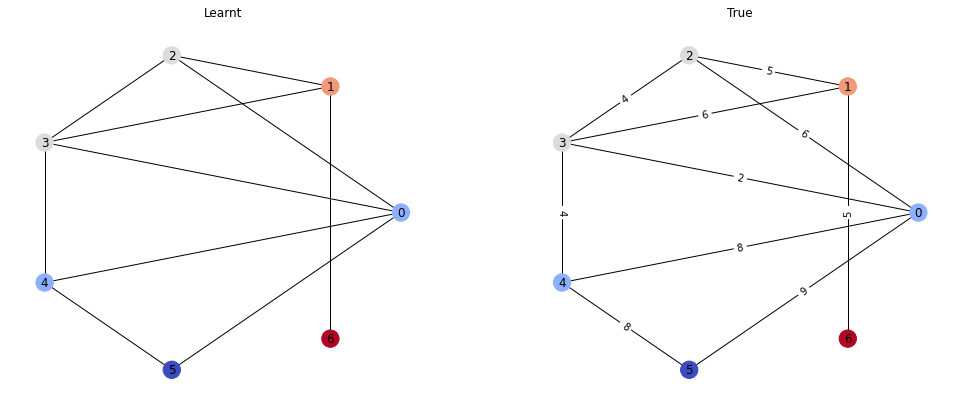

Passes: 2
tensor([1.0024, 1.0024, 1.0025, 1.0027, 1.0023, 2.0048, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 1., 2., 0.], device='cuda:0')
Loss: 0.002444624900817871	Similarity: 1.0


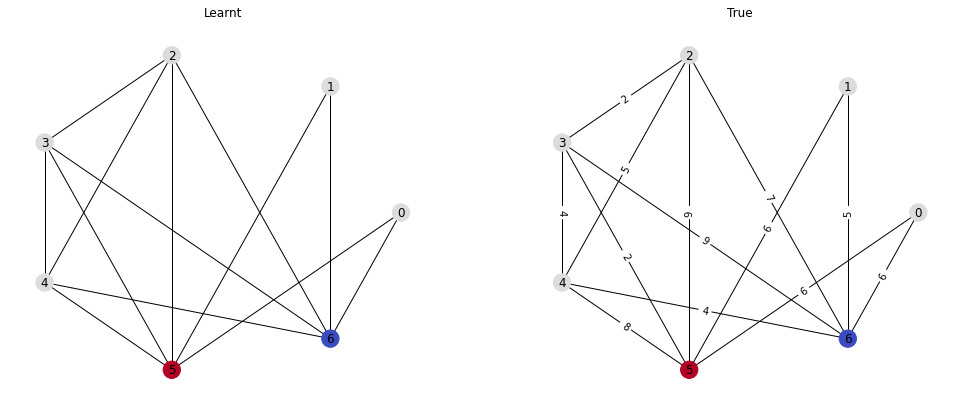

Passes: 2
tensor([1.0024, 1.0024, 2.0046, 1.0027, 1.0024, 1.0024, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.002409475389868021	Similarity: 1.0


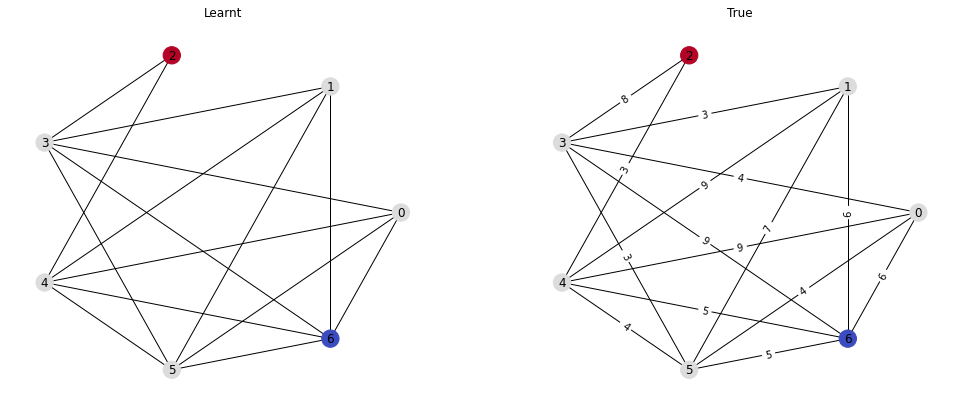

Passes: 2
tensor([1.0025, 1.0021, 1.0024, 0.0000, 1.0027, 2.0050], device='cuda:0')
tensor([1., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.002444624900817871	Similarity: 1.0


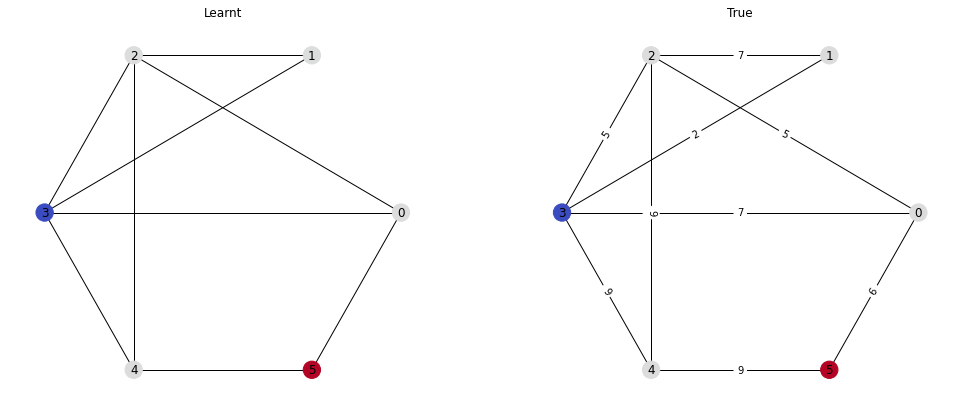

Passes: 2
tensor([2.0050, 1.0024, 0.0000, 2.0046, 1.0027, 2.0046, 1.0021],
       device='cuda:0')
tensor([2., 1., 0., 2., 1., 2., 1.], device='cuda:0')
Loss: 0.0030610733665525913	Similarity: 1.0


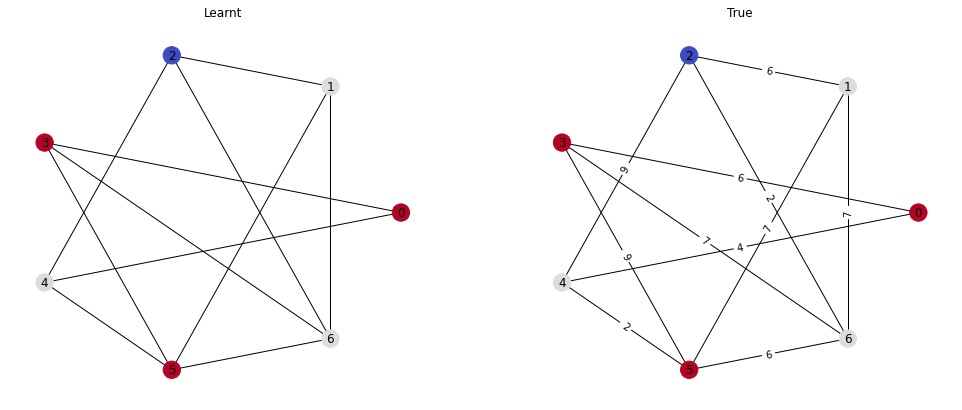

Passes: 2
tensor([2.0049, 1.0024, 0.0000, 1.0024, 2.0047, 1.0024, 2.0050],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.003119656117632985	Similarity: 1.0


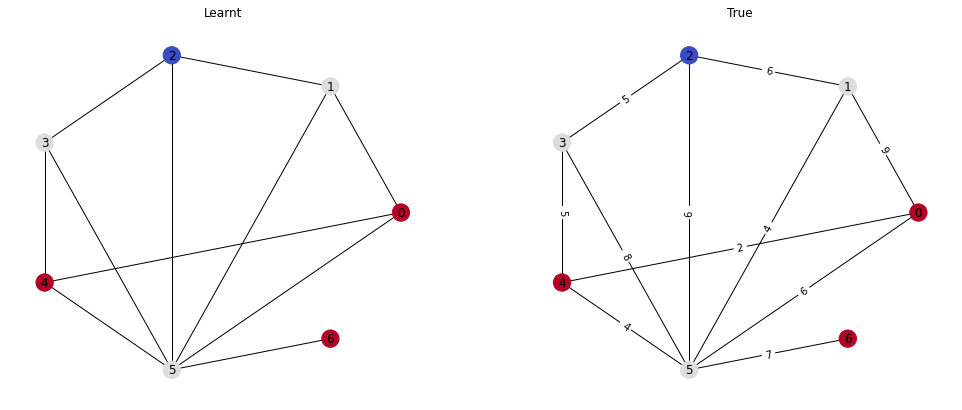

Passes: 3
tensor([2.0047, 1.0023, 2.0047, 1.0025, 0.0000, 3.0070, 2.0044],
       device='cuda:0')
tensor([2., 1., 2., 1., 0., 3., 2.], device='cuda:0')
Loss: 0.003665788099169731	Similarity: 1.0


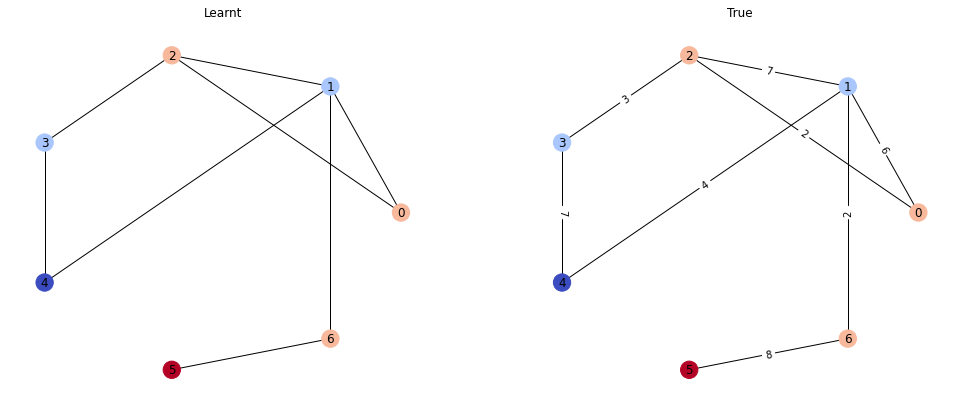

Passes: 2
tensor([1.0023, 1.0027, 0.0000, 1.0024, 2.0046, 1.0021, 2.0047],
       device='cuda:0')
tensor([1., 1., 0., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.0027001246344298124	Similarity: 1.0


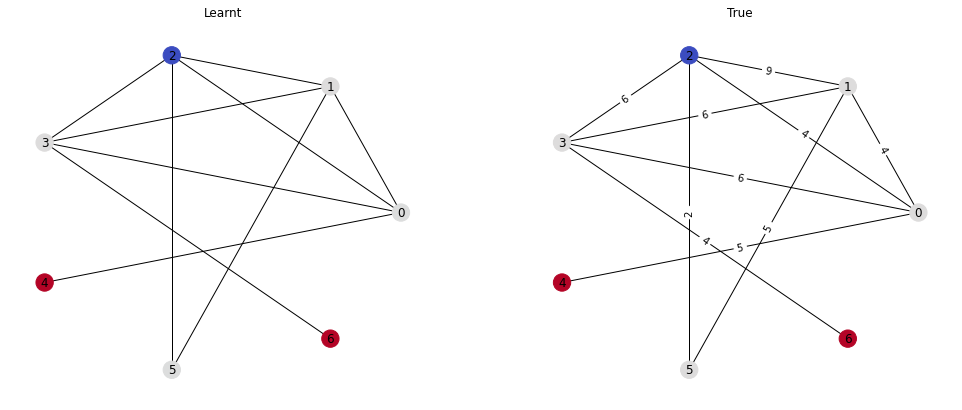

Passes: 2
tensor([2.0046, 2.0046, 0.0000, 2.0046, 2.0048, 1.0024, 1.0024],
       device='cuda:0')
tensor([2., 2., 0., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.003328289370983839	Similarity: 1.0


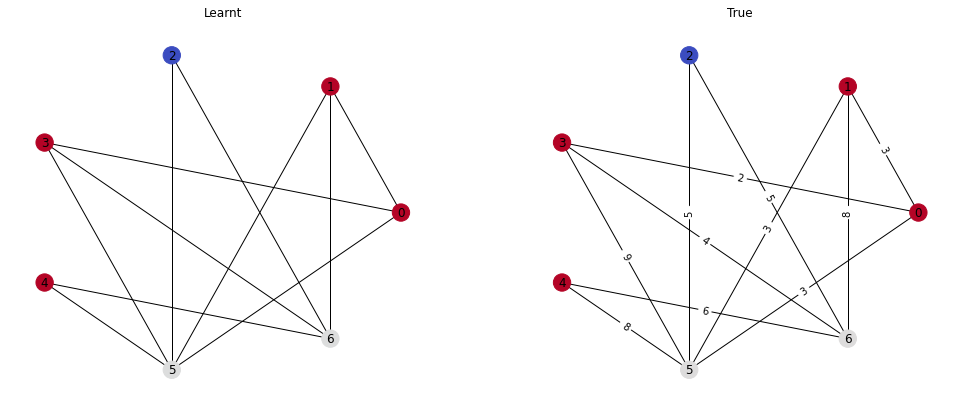

Passes: 2
tensor([1.0021, 1.0022, 0.0000, 1.0026, 2.0046, 1.0026, 2.0047],
       device='cuda:0')
tensor([1., 1., 0., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


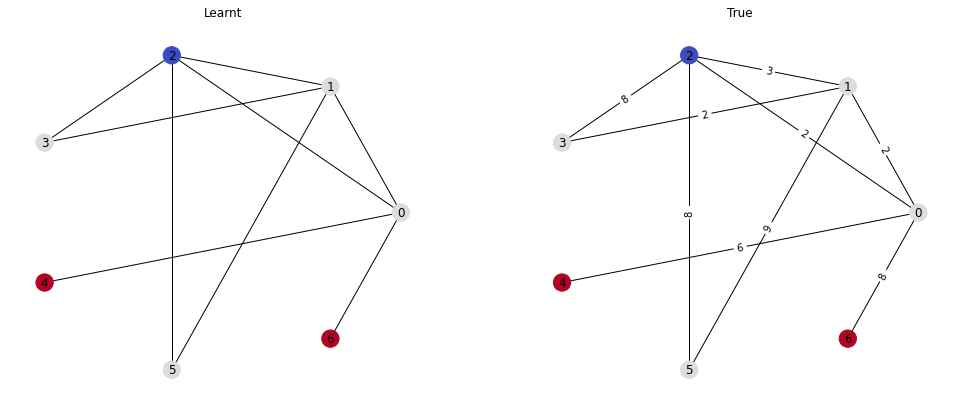

Passes: 2
tensor([1.0025, 0.0000, 2.0049, 1.0026, 1.0027, 2.0052, 2.0049],
       device='cuda:0')
tensor([1., 0., 2., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.00326025509275496	Similarity: 1.0


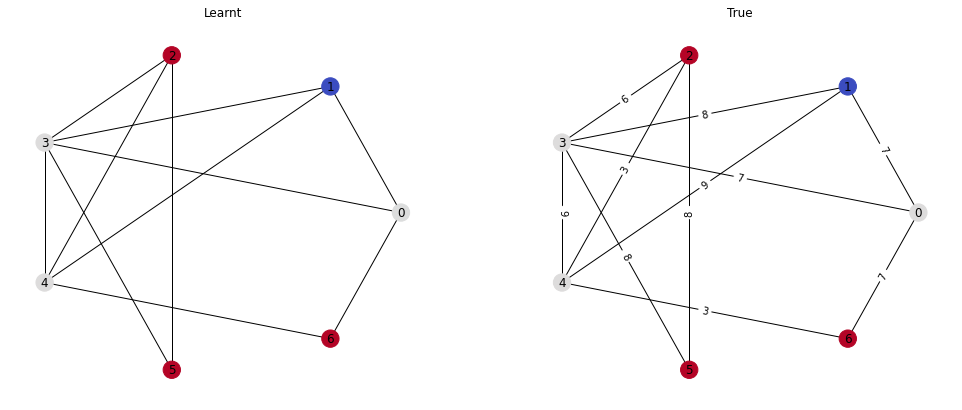

Passes: 2
tensor([2.0052, 1.0027, 2.0052, 2.0054, 2.0051, 2.0053, 0.0000],
       device='cuda:0')
tensor([2., 1., 2., 2., 2., 2., 0.], device='cuda:0')
Loss: 0.004134467802941799	Similarity: 1.0


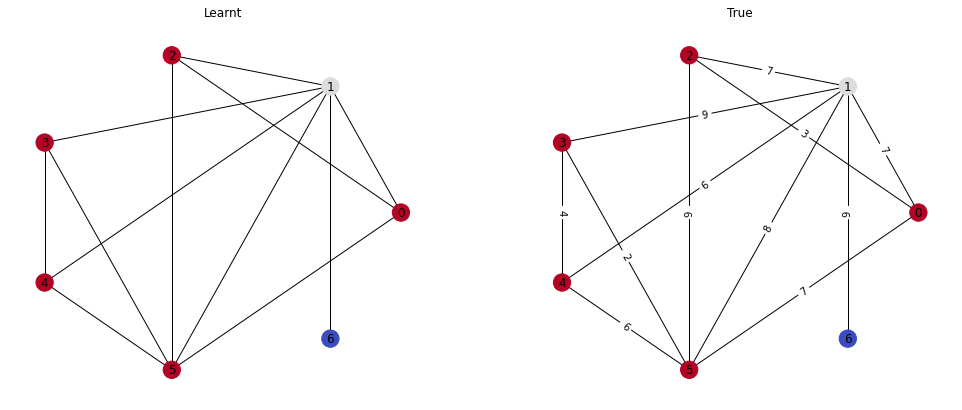

Passes: 2
tensor([1.0024, 1.0024, 1.0024, 2.0046, 2.0046, 0.0000, 2.0046],
       device='cuda:0')
tensor([1., 1., 1., 2., 2., 0., 2.], device='cuda:0')
Loss: 0.003002490382641554	Similarity: 1.0


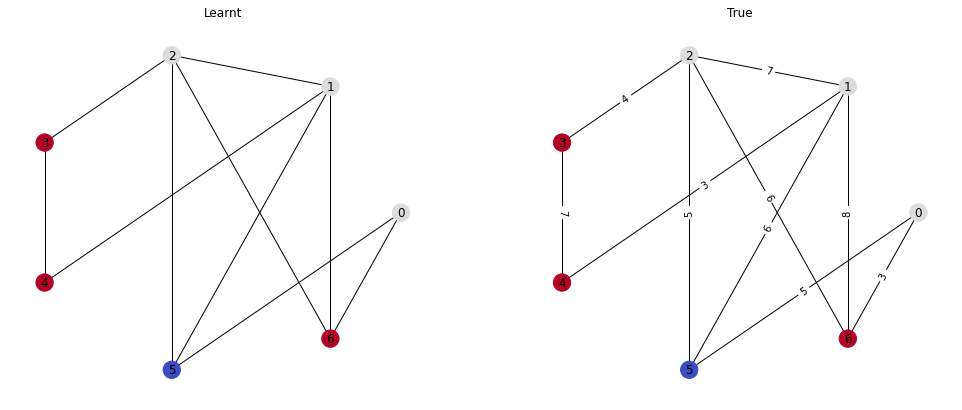

Passes: 3
tensor([3.0068, 1.0021, 2.0043, 2.0046, 1.0024, 2.0046, 0.0000],
       device='cuda:0')
tensor([3., 1., 2., 2., 1., 2., 0.], device='cuda:0')
Loss: 0.0035369056276977062	Similarity: 1.0


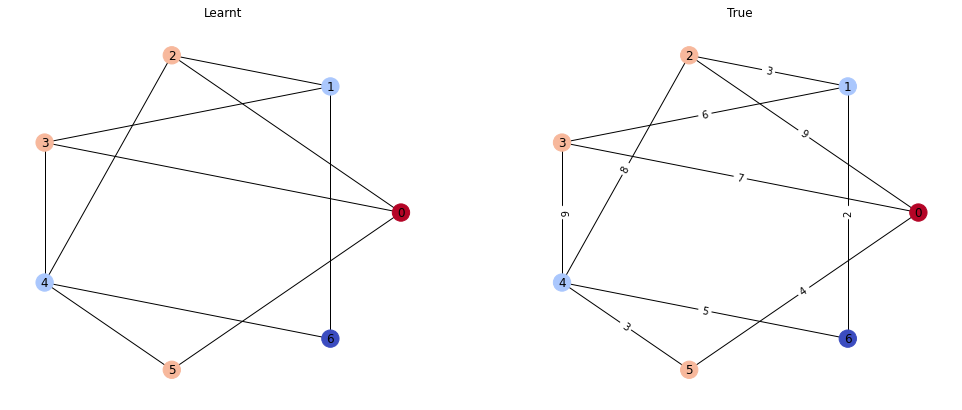

Passes: 4
tensor([0.0000, 2.0046, 4.0090, 3.0071, 3.0068, 1.0024, 1.0021],
       device='cuda:0')
tensor([0., 2., 4., 3., 3., 1., 1.], device='cuda:0')
Loss: 0.004561151843518019	Similarity: 1.0


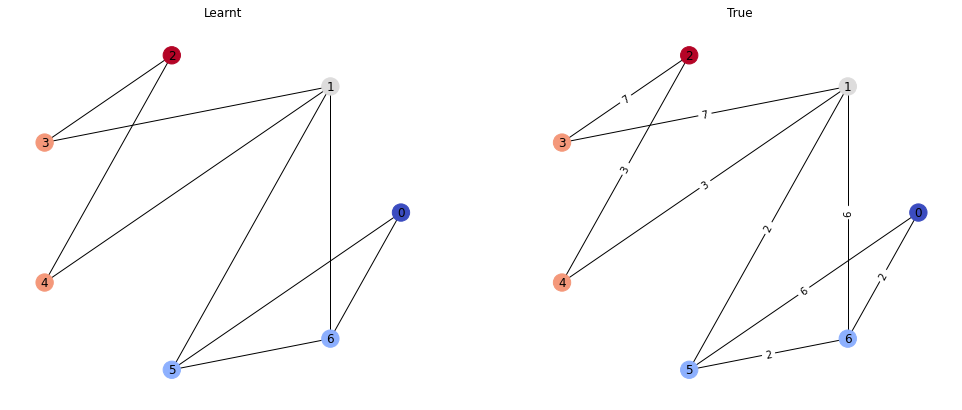

Passes: 3
tensor([2.0047, 1.0024, 0.0000, 3.0070, 2.0046, 3.0070, 3.0073],
       device='cuda:0')
tensor([2., 1., 0., 3., 2., 3., 3.], device='cuda:0')
Loss: 0.004713450558483601	Similarity: 1.0


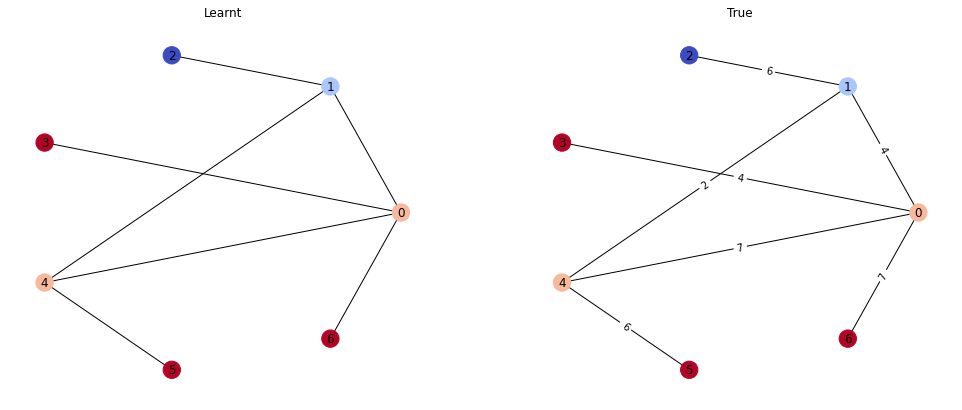

Passes: 2
tensor([0.0000, 2.0048, 2.0051, 1.0026, 1.0025, 1.0024, 2.0045],
       device='cuda:0')
tensor([0., 2., 2., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.003131372621282935	Similarity: 1.0


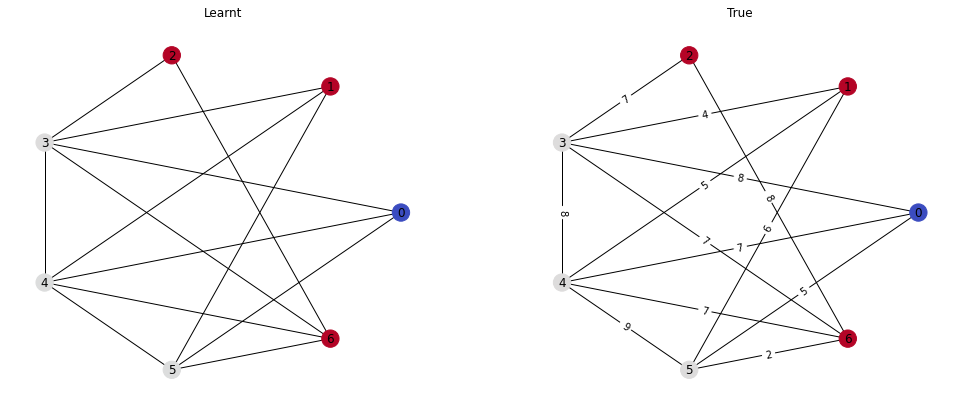

Passes: 2
tensor([0.0000, 1.0022, 2.0044, 2.0047, 1.0025, 2.0045, 2.0046],
       device='cuda:0')
tensor([0., 1., 2., 2., 1., 2., 2.], device='cuda:0')
Loss: 0.0032814231235533953	Similarity: 1.0


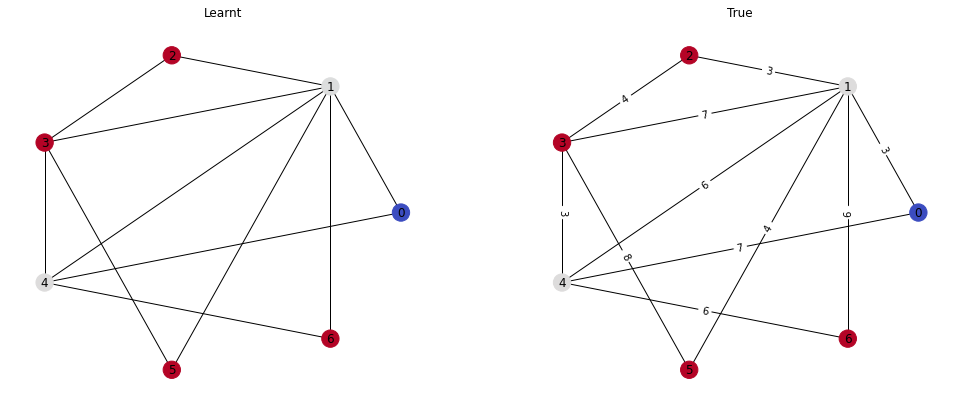

Passes: 2
tensor([1.0026, 1.0024, 0.0000, 2.0051, 1.0022, 1.0026, 2.0050],
       device='cuda:0')
tensor([1., 1., 0., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.0028407233767211437	Similarity: 1.0


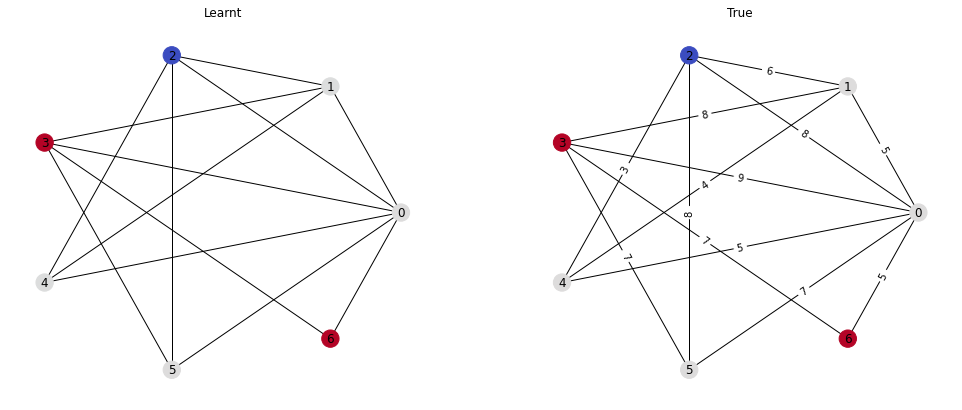

Passes: 2
tensor([0.0000, 1.0021, 1.0026, 1.0024, 1.0024, 2.0051], device='cuda:0')
tensor([0., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.002430955646559596	Similarity: 1.0


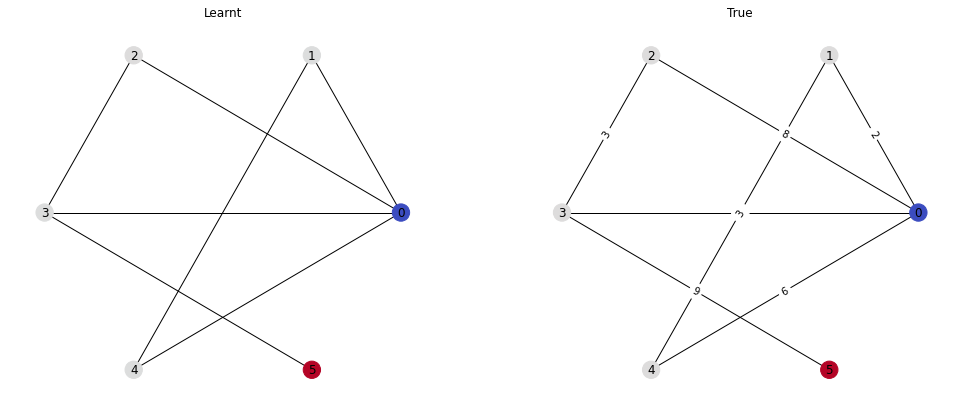

Passes: 2
tensor([1.0026, 2.0046, 1.0025, 2.0045, 1.0023, 2.0048, 0.0000],
       device='cuda:0')
tensor([1., 2., 1., 2., 1., 2., 0.], device='cuda:0')
Loss: 0.0030493566300719976	Similarity: 1.0


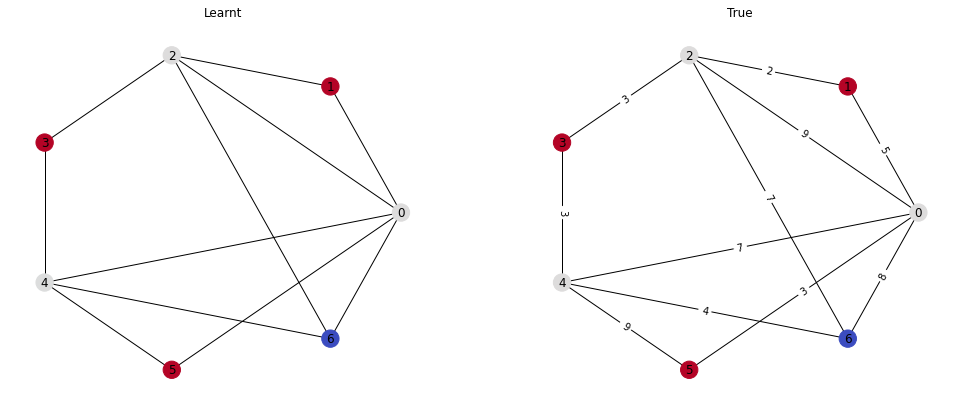

Passes: 3
tensor([1.0023, 2.0049, 2.0050, 3.0074, 0.0000, 1.0026, 2.0051],
       device='cuda:0')
tensor([1., 2., 2., 3., 0., 1., 2.], device='cuda:0')
Loss: 0.003888402832672	Similarity: 1.0


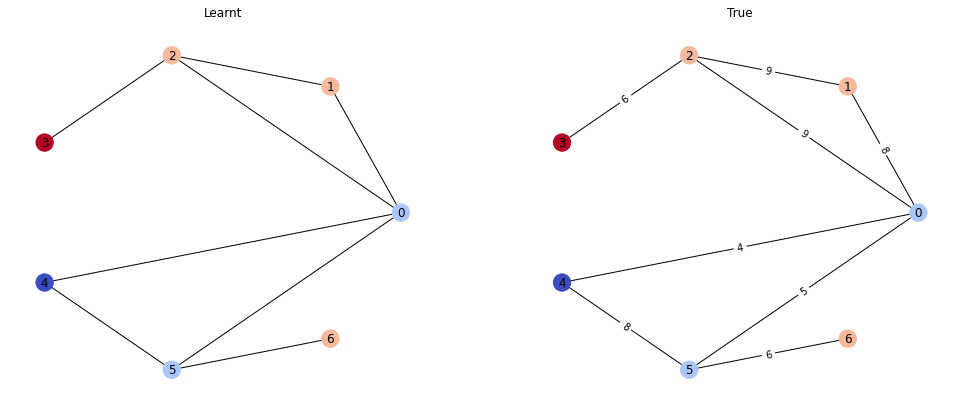

Passes: 3
tensor([0.0000, 1.0021, 2.0042, 3.0068, 2.0043, 1.0022, 2.0043],
       device='cuda:0')
tensor([0., 1., 2., 3., 2., 1., 2.], device='cuda:0')
Loss: 0.0034197401255369186	Similarity: 1.0


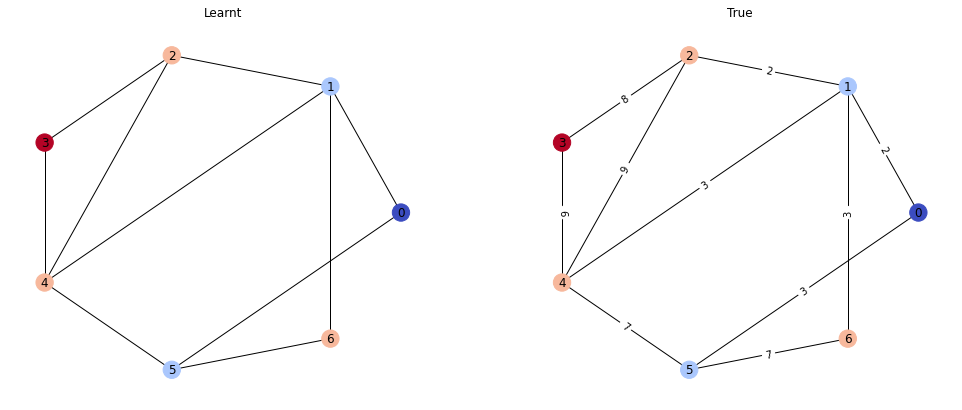

Passes: 3
tensor([0.0000, 1.0025, 3.0074, 1.0026, 1.0025, 2.0051, 2.0051],
       device='cuda:0')
tensor([0., 1., 3., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.0036094700917601585	Similarity: 1.0


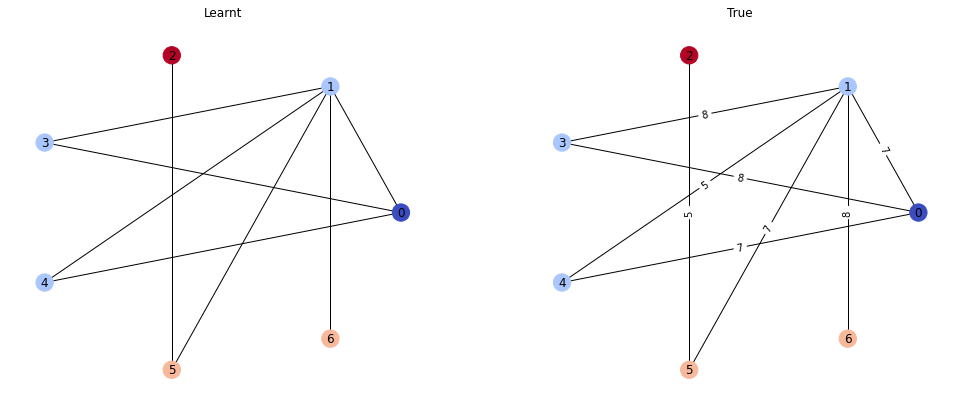

Passes: 2
tensor([1.0027, 2.0050, 2.0050, 2.0050, 1.0026, 0.0000, 1.0024],
       device='cuda:0')
tensor([1., 2., 2., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.0032368218526244164	Similarity: 1.0


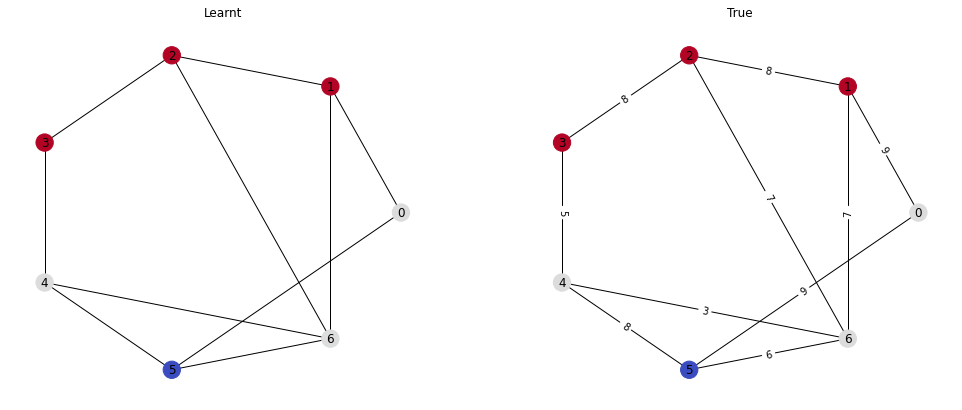

Passes: 3
tensor([2.0046, 1.0026, 0.0000, 1.0024, 2.0049, 1.0024, 3.0073],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 1., 3.], device='cuda:0')
Loss: 0.0034688713494688272	Similarity: 1.0


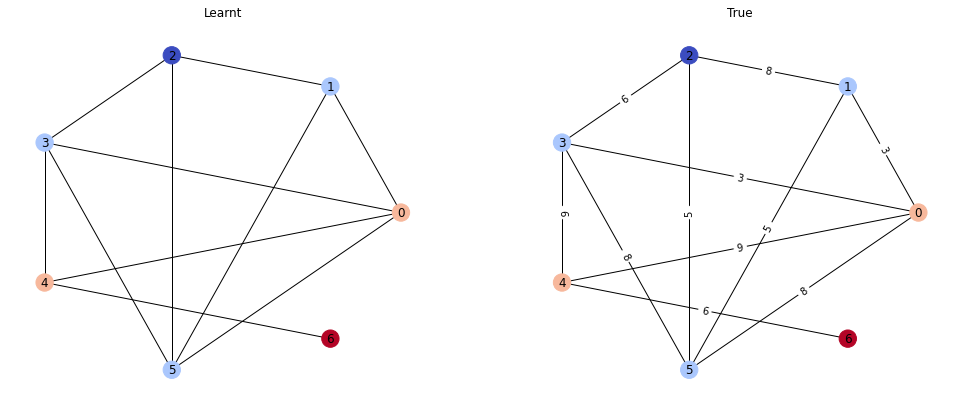

Passes: 3
tensor([3.0073, 2.0050, 1.0024, 0.0000, 1.0025, 2.0049, 2.0048],
       device='cuda:0')
tensor([3., 2., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.003853253088891506	Similarity: 1.0


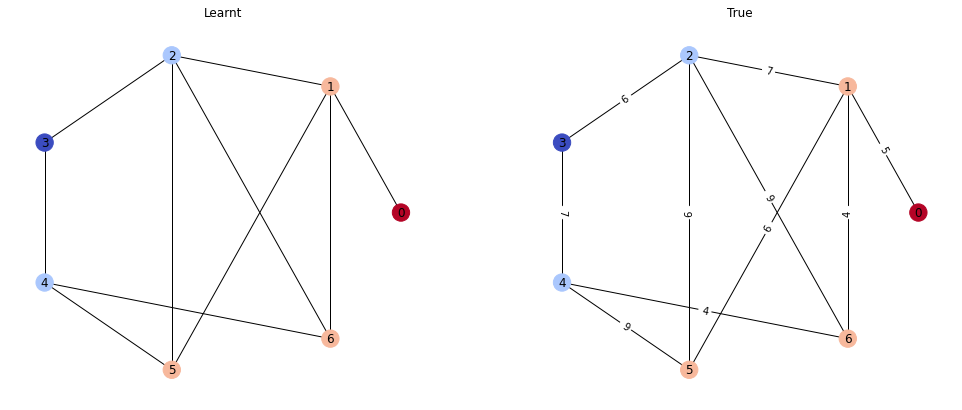

Passes: 3
tensor([2.0046, 1.0025, 2.0052, 0.0000, 1.0024, 2.0046, 3.0070],
       device='cuda:0')
tensor([2., 1., 2., 0., 1., 2., 3.], device='cuda:0')
Loss: 0.0037712370976805687	Similarity: 1.0


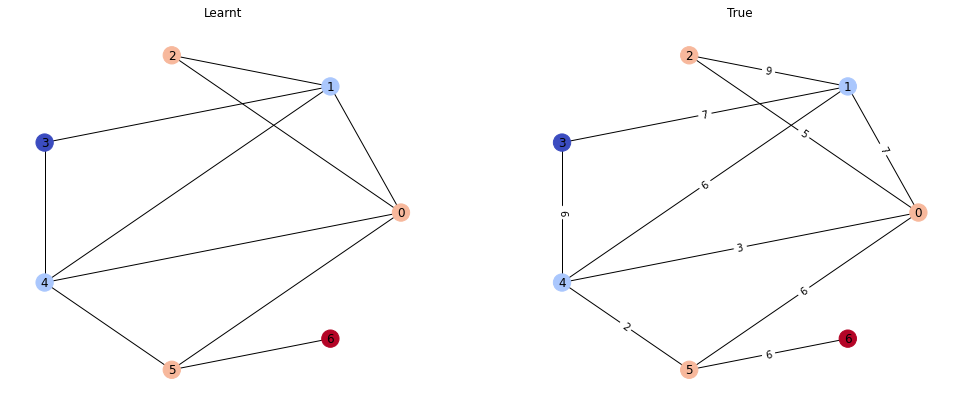

Passes: 2
tensor([2.0046, 2.0051, 1.0027, 0.0000, 1.0024, 2.0052, 2.0047],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.0035391878336668015	Similarity: 1.0


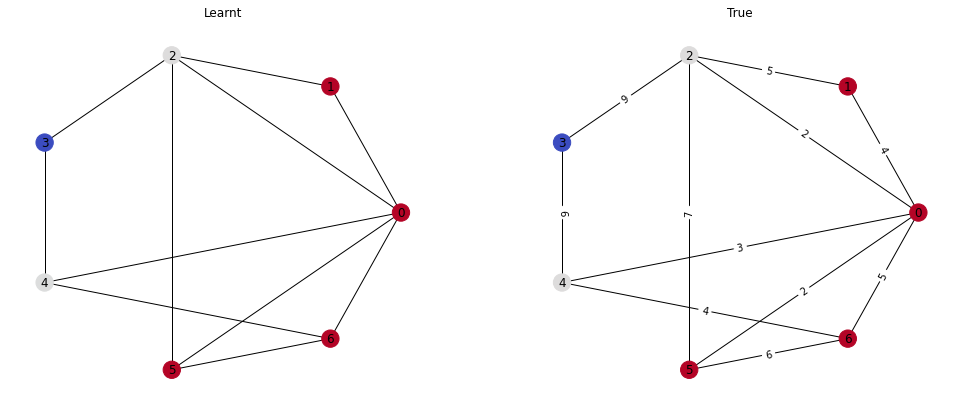

Passes: 2
tensor([2.0043, 1.0027, 2.0046, 0.0000, 1.0025, 1.0021, 2.0045],
       device='cuda:0')
tensor([2., 1., 2., 0., 1., 1., 2.], device='cuda:0')
Loss: 0.00295562413521111	Similarity: 1.0


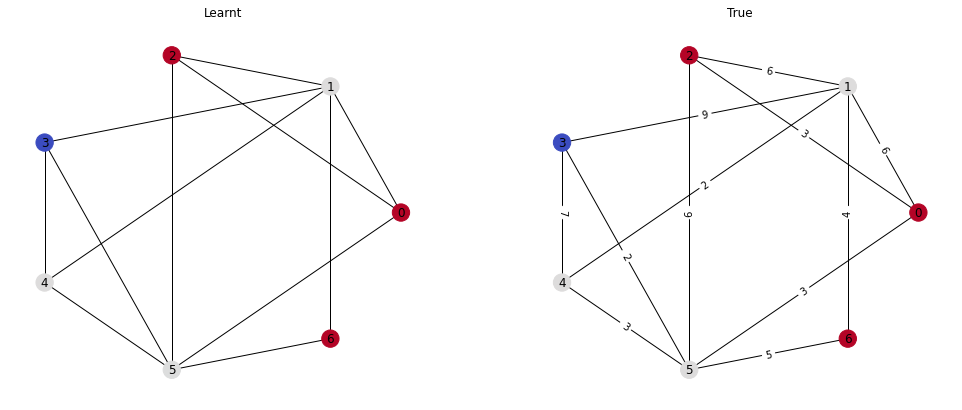

Passes: 3
tensor([2.0052, 3.0073, 2.0051, 2.0050, 3.0072, 1.0025, 0.0000],
       device='cuda:0')
tensor([2., 3., 2., 2., 3., 1., 0.], device='cuda:0')
Loss: 0.004621999803930521	Similarity: 1.0


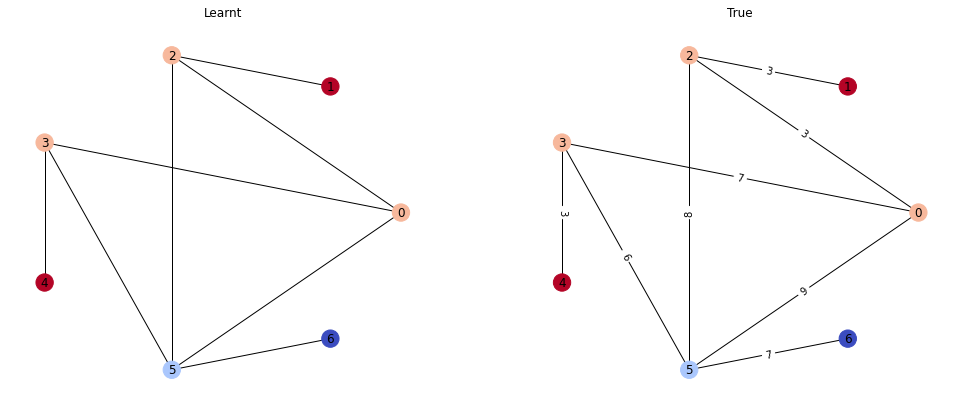

Passes: 2
tensor([1.0024, 1.0022, 1.0026, 1.0022, 2.0046, 0.0000, 2.0047],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 0., 2.], device='cuda:0')
Loss: 0.0026766913942992687	Similarity: 1.0


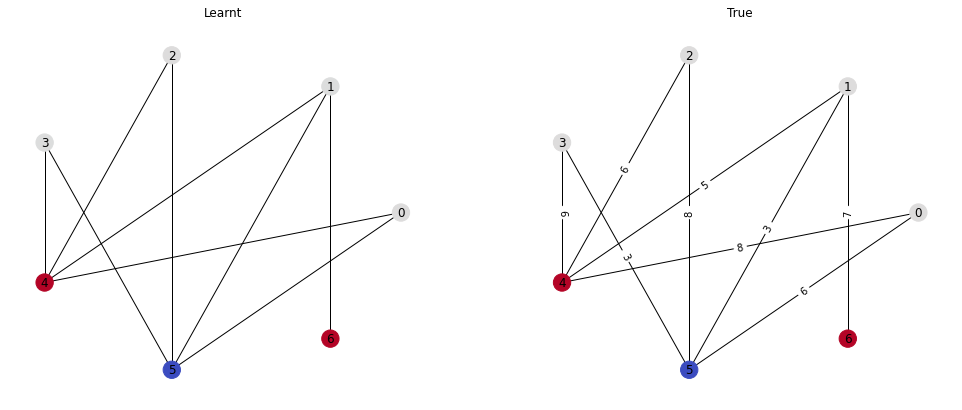

Passes: 2
tensor([2.0049, 2.0046, 1.0021, 1.0026, 0.0000, 1.0027, 2.0051],
       device='cuda:0')
tensor([2., 2., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.003143089357763529	Similarity: 1.0


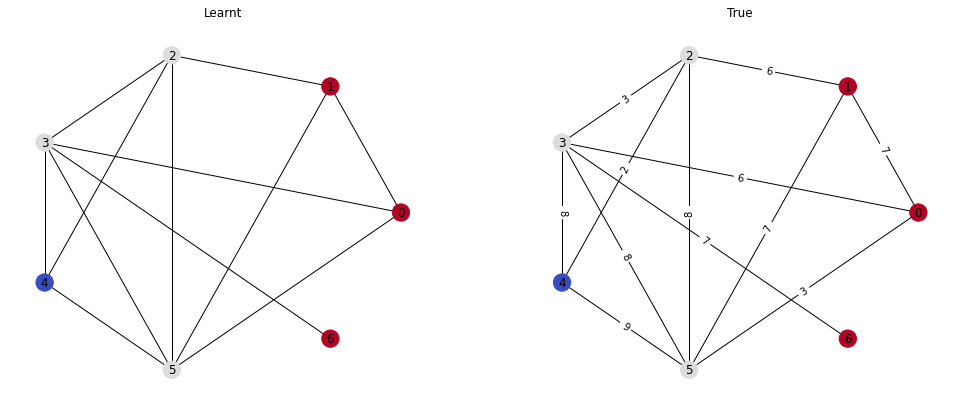

Passes: 3
tensor([2.0048, 0.0000, 1.0026, 1.0023, 2.0047, 2.0048, 3.0074],
       device='cuda:0')
tensor([2., 0., 1., 1., 2., 2., 3.], device='cuda:0')
Loss: 0.0038063868414610624	Similarity: 1.0


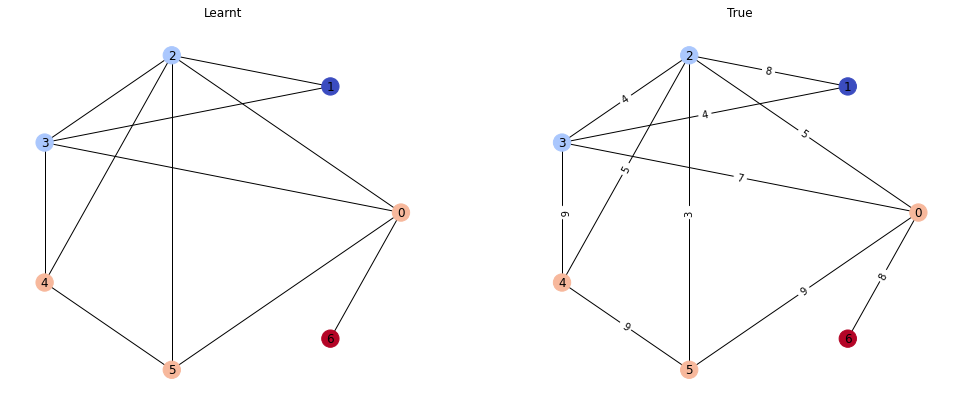

Passes: 2
tensor([1.0027, 1.0024, 0.0000, 1.0024, 1.0023, 2.0044], device='cuda:0')
tensor([1., 1., 0., 1., 1., 2.], device='cuda:0')
Loss: 0.0023626089096069336	Similarity: 1.0


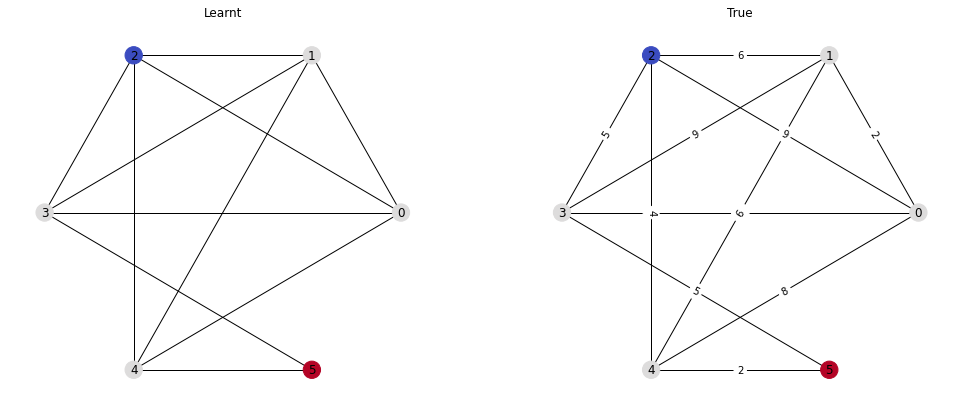

Passes: 2
tensor([0.0000, 2.0047, 2.0050, 1.0027, 2.0046, 1.0024, 1.0022],
       device='cuda:0')
tensor([0., 2., 2., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.0030727898702025414	Similarity: 1.0


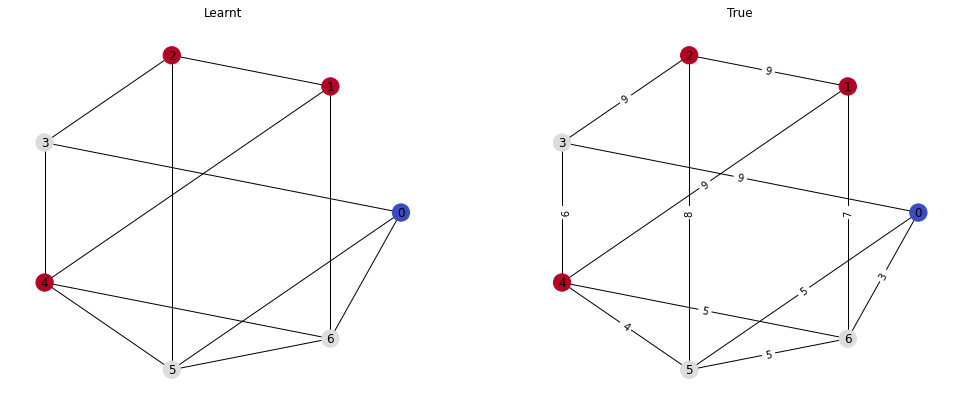

Passes: 4
tensor([1.0021, 0.0000, 4.0092, 2.0049, 1.0024, 3.0071, 3.0070],
       device='cuda:0')
tensor([1., 0., 4., 2., 1., 3., 3.], device='cuda:0')
Loss: 0.004666601307690144	Similarity: 1.0


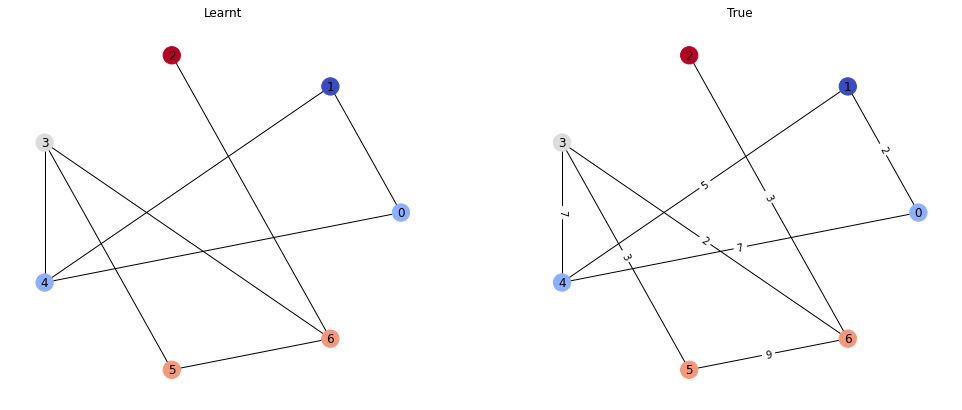

Passes: 3
tensor([3.0073, 1.0024, 2.0051, 2.0046, 2.0046, 3.0077, 0.0000],
       device='cuda:0')
tensor([3., 1., 2., 2., 2., 3., 0.], device='cuda:0')
Loss: 0.0045165508054196835	Similarity: 1.0


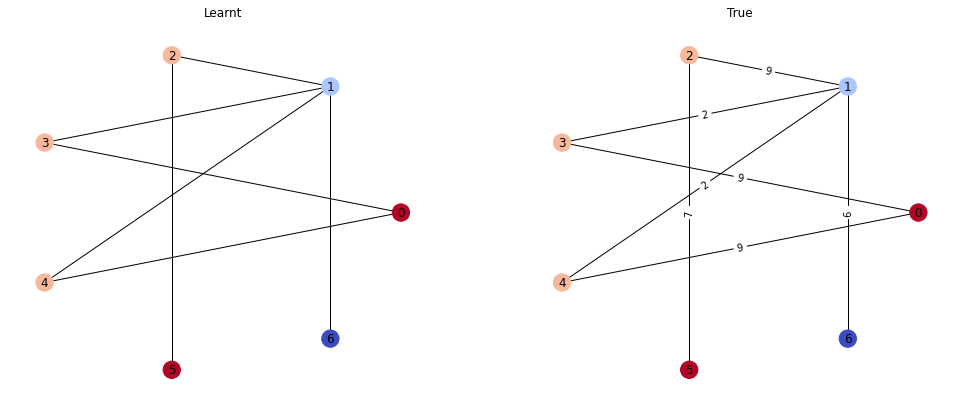

Passes: 1
tensor([0.0000, 1.0021, 1.0024, 1.0024, 1.0022, 1.0024, 1.0021],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0019665106665343046	Similarity: 1.0


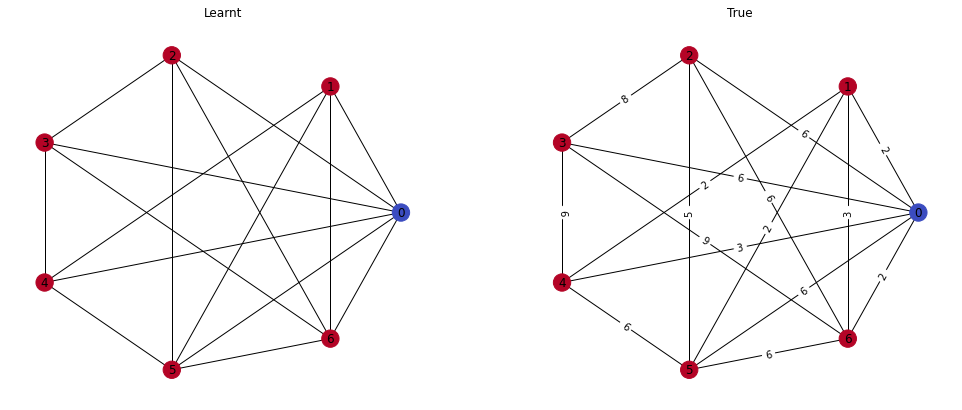

Passes: 2
tensor([2.0045, 1.0022, 0.0000, 1.0024, 1.0024, 2.0046, 2.0046],
       device='cuda:0')
tensor([2., 1., 0., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.00295562413521111	Similarity: 1.0


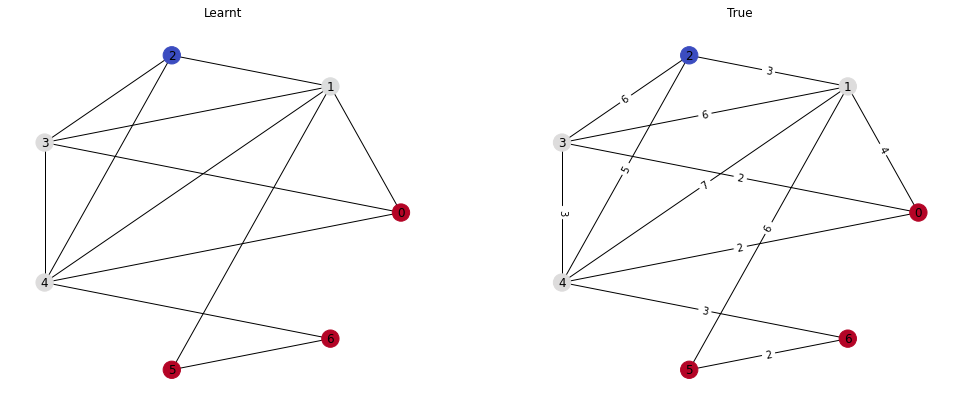

Passes: 2
tensor([1.0024, 0.0000, 1.0024, 1.0023, 1.0024, 2.0047, 2.0049],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.002735274378210306	Similarity: 1.0


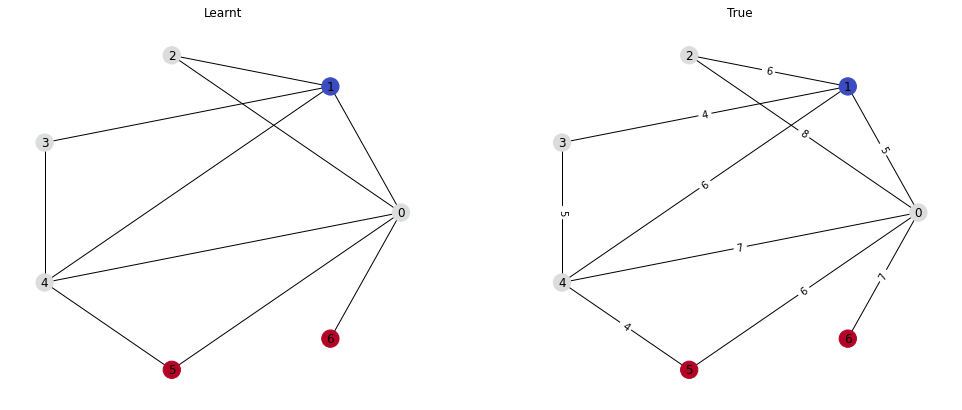

Passes: 2
tensor([0.0000, 1.0023, 1.0026, 1.0022, 2.0044, 1.0022, 2.0044],
       device='cuda:0')
tensor([0., 1., 1., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.002582958899438381	Similarity: 1.0


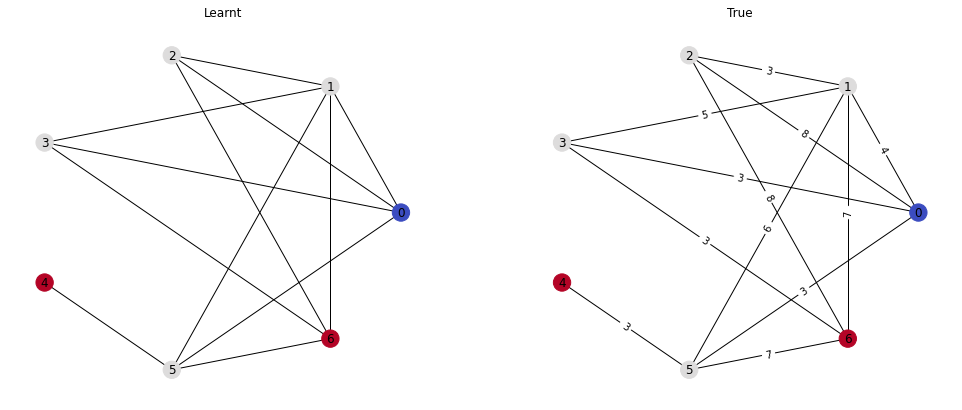

Passes: 2
tensor([2.0046, 2.0046, 0.0000, 1.0027, 1.0021, 1.0022, 2.0048],
       device='cuda:0')
tensor([2., 2., 0., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0030142071191221476	Similarity: 1.0


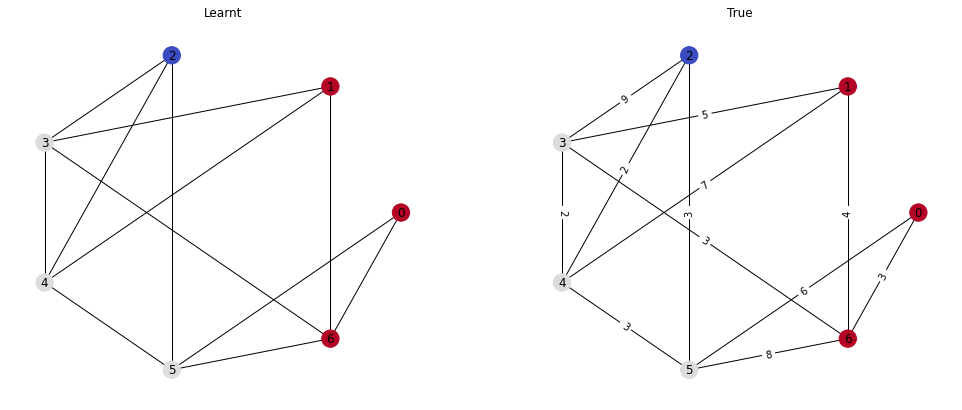

Passes: 3
tensor([0.0000, 1.0025, 2.0047, 3.0070, 2.0049, 1.0025], device='cuda:0')
tensor([0., 1., 2., 3., 2., 1.], device='cuda:0')
Loss: 0.0036122403107583523	Similarity: 1.0


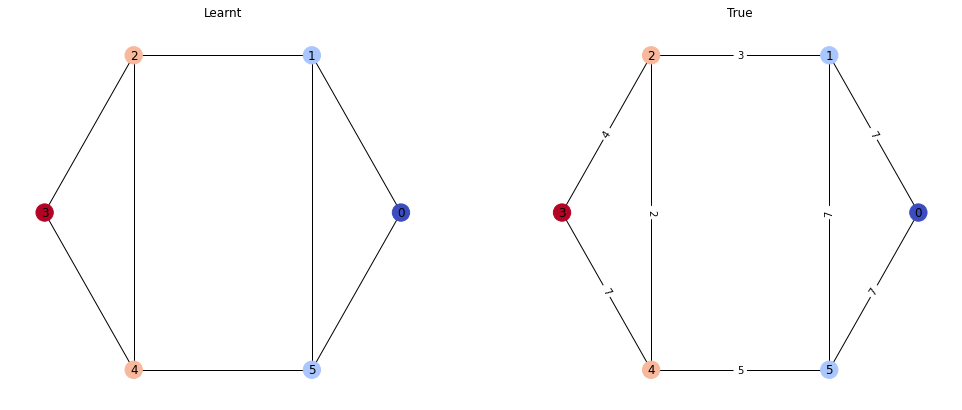

Passes: 2
tensor([1.0023, 0.0000, 1.0022, 2.0045, 1.0027, 2.0048, 2.0052],
       device='cuda:0')
tensor([1., 0., 1., 2., 1., 2., 2.], device='cuda:0')
Loss: 0.003096223110333085	Similarity: 1.0


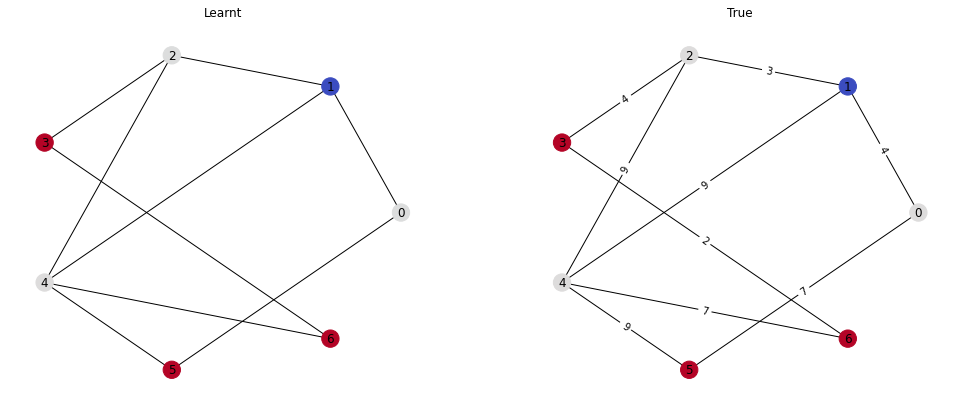

Passes: 2
tensor([1.0024, 1.0023, 0.0000, 1.0023, 2.0045, 1.0022, 2.0044],
       device='cuda:0')
tensor([1., 1., 0., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.002582958899438381	Similarity: 1.0


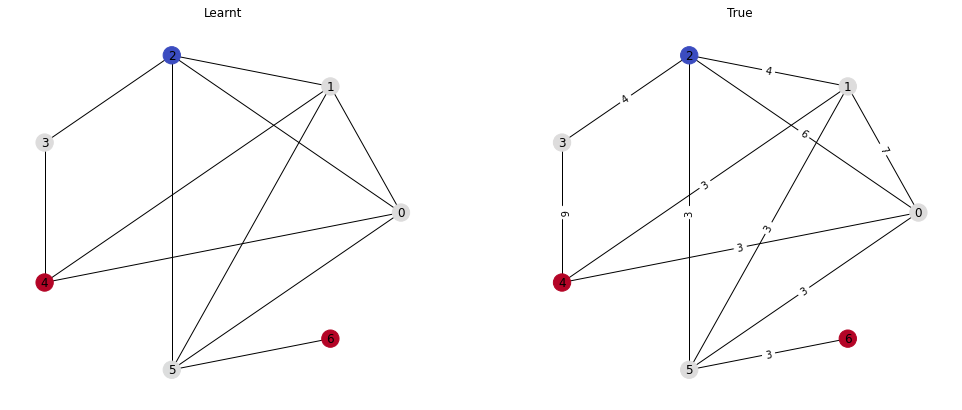

Passes: 2
tensor([2.0047, 1.0024, 0.0000, 1.0025], device='cuda:0')
tensor([2., 1., 0., 1.], device='cuda:0')
Loss: 0.0024036169052124023	Similarity: 1.0


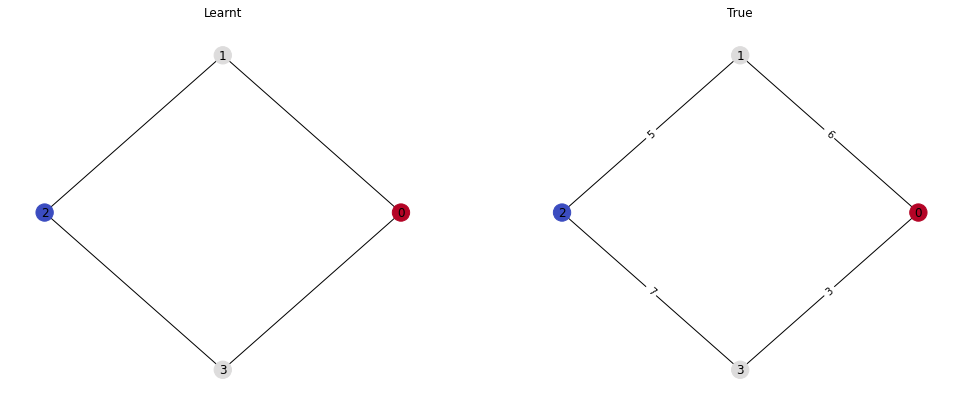

Passes: 2
tensor([1.0022, 0.0000, 1.0024, 2.0046, 2.0045, 1.0024, 1.0024],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.002629825146868825	Similarity: 1.0


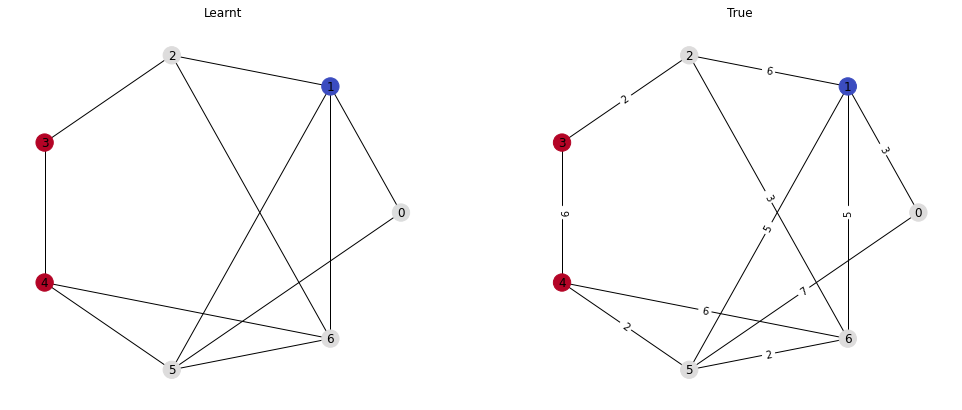

Passes: 2
tensor([1.0027, 1.0027, 2.0051, 2.0048, 1.0024, 1.0024, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 2., 1., 1., 0.], device='cuda:0')
Loss: 0.0028641566168516874	Similarity: 1.0


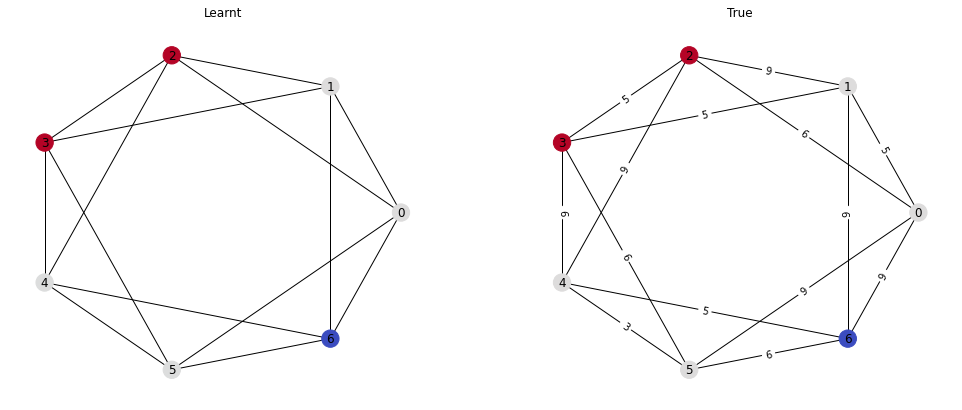

Passes: 3
tensor([2.0051, 2.0044, 1.0023, 0.0000, 1.0027, 1.0021, 3.0066],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 1., 3.], device='cuda:0')
Loss: 0.0033165558706969023	Similarity: 1.0


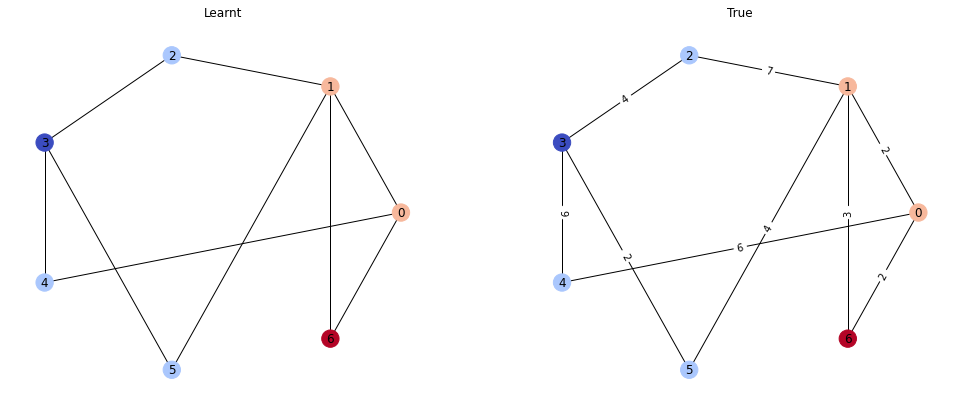

Passes: 3
tensor([0.0000, 1.0023, 1.0027, 1.0025, 1.0025, 2.0046, 3.0068],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 2., 3.], device='cuda:0')
Loss: 0.0030610563699156046	Similarity: 1.0


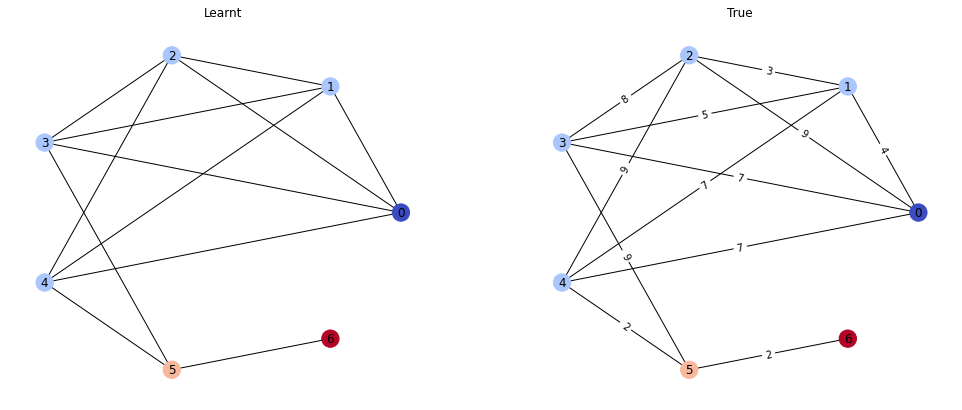

Passes: 2
tensor([0.0000, 1.0021, 1.0024, 1.0022, 1.0023, 2.0048, 2.0048],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.0026649748906493187	Similarity: 1.0


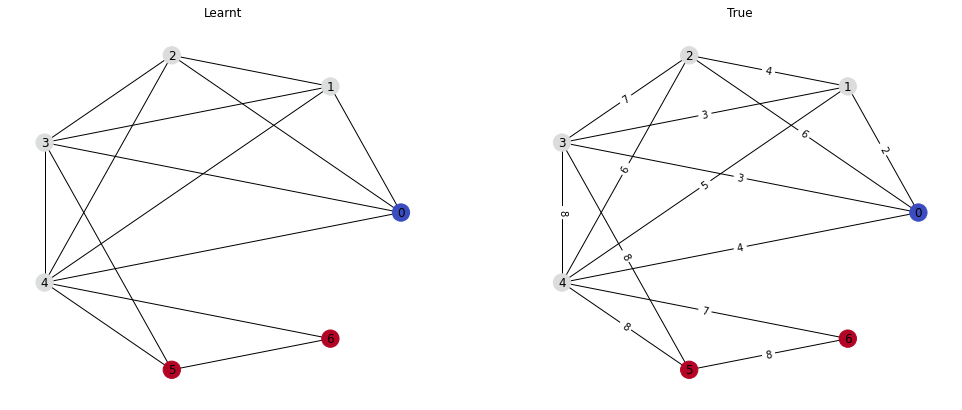

Passes: 2
tensor([1.0022, 0.0000, 1.0027, 2.0044, 1.0021, 1.0023, 1.0024],
       device='cuda:0')
tensor([1., 0., 1., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.00230402615852654	Similarity: 1.0


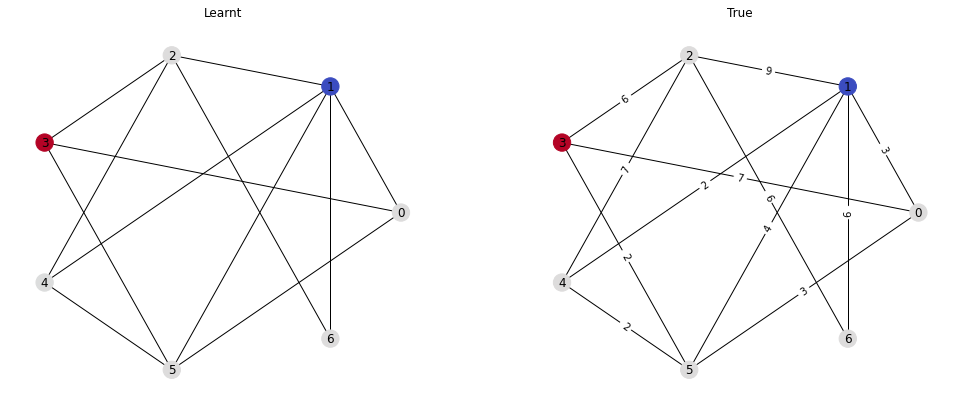

Passes: 2
tensor([2.0046, 2.0046, 1.0023, 0.0000, 1.0024, 2.0048, 1.0024],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.003002490382641554	Similarity: 1.0


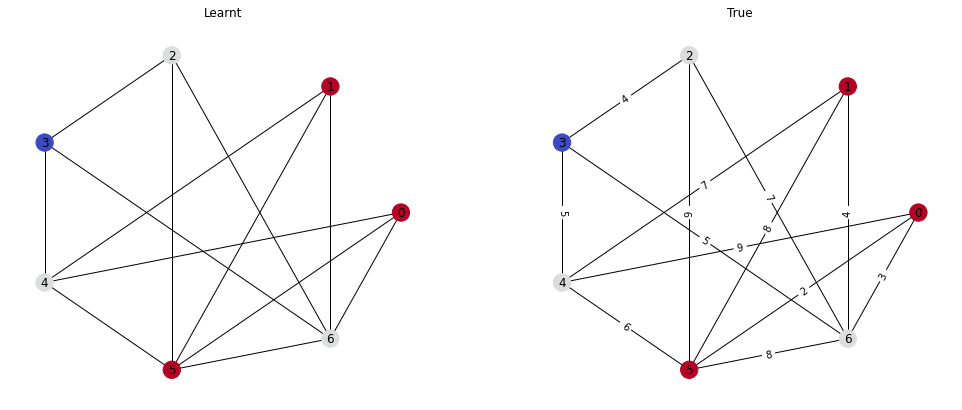

Passes: 2
tensor([1.0024, 0.0000, 1.0025, 2.0050, 2.0051, 1.0024, 1.0025],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.0028641566168516874	Similarity: 1.0


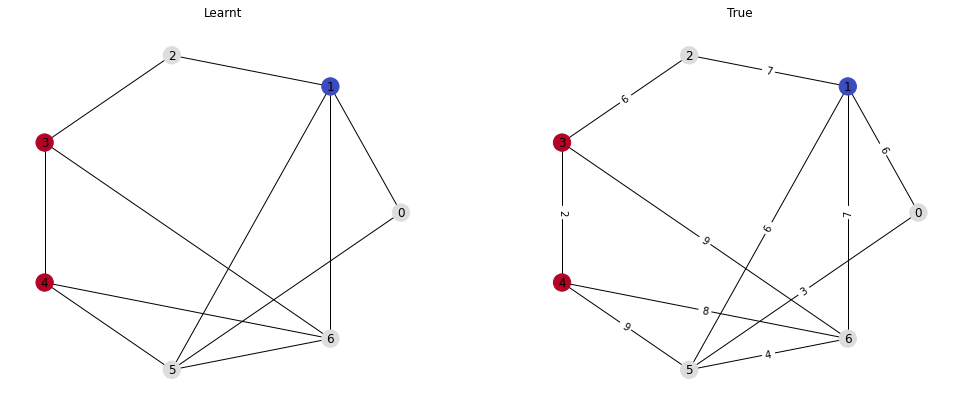

Passes: 2
tensor([1.0027, 0.0000, 1.0026, 1.0023, 1.0021, 1.0025, 2.0047],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.002421191893517971	Similarity: 1.0


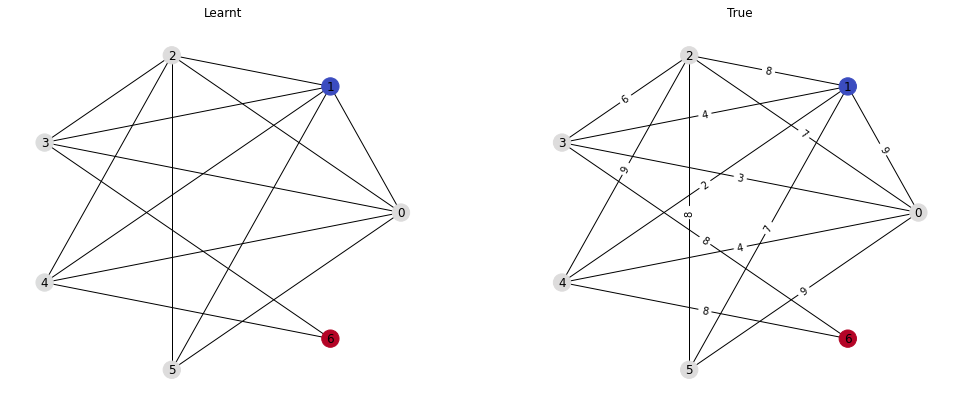

Passes: 2
tensor([2.0044, 1.0023, 2.0049, 1.0024, 0.0000, 2.0049, 2.0050],
       device='cuda:0')
tensor([2., 1., 2., 1., 0., 2., 2.], device='cuda:0')
Loss: 0.0034103053621947765	Similarity: 1.0


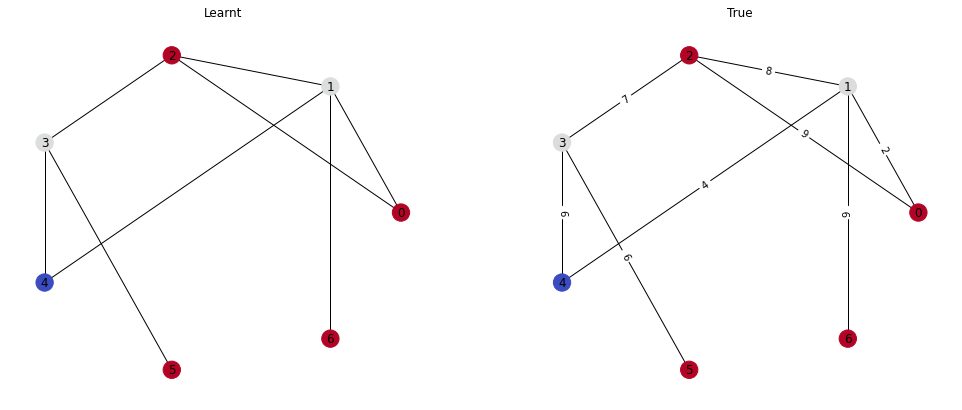

Passes: 2
tensor([1.0021, 0.0000, 1.0023, 1.0027, 1.0024, 1.0023, 2.0043],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0022923096548765898	Similarity: 1.0


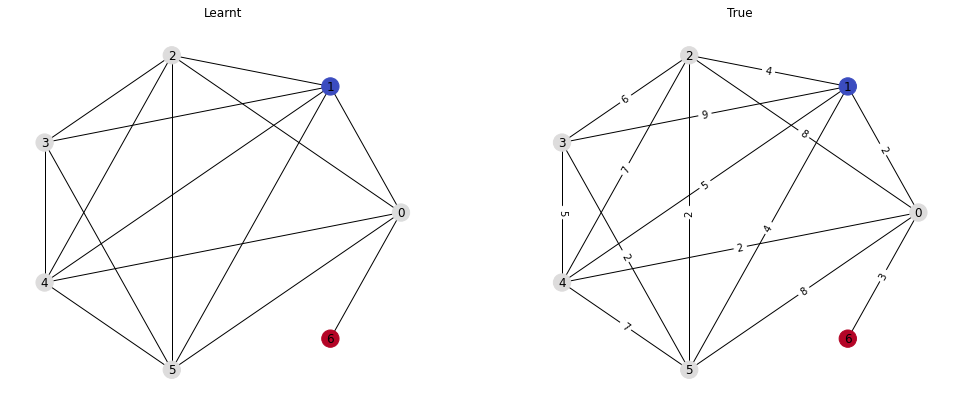

Passes: 3
tensor([1.0024, 1.0022, 0.0000, 1.0025, 3.0069, 2.0045], device='cuda:0')
tensor([1., 1., 0., 1., 3., 2.], device='cuda:0')
Loss: 0.0030817787628620863	Similarity: 1.0


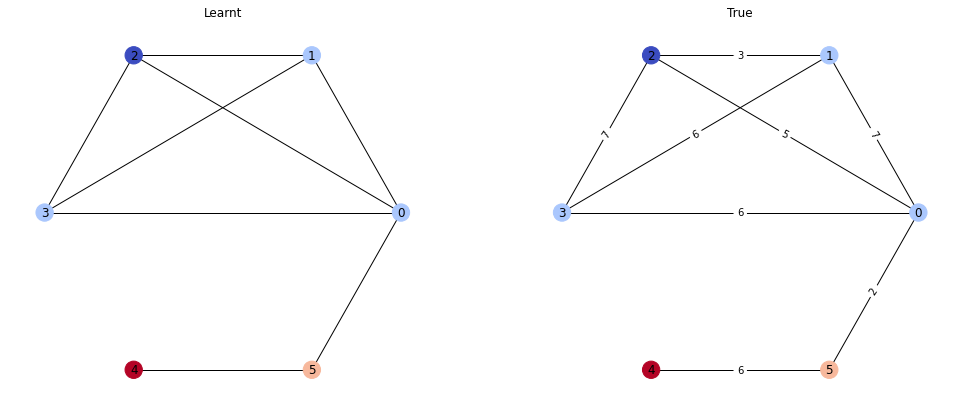

Passes: 2
tensor([2.0045, 1.0024, 2.0046, 1.0024, 0.0000, 1.0024, 2.0046],
       device='cuda:0')
tensor([2., 1., 2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.00295562413521111	Similarity: 1.0


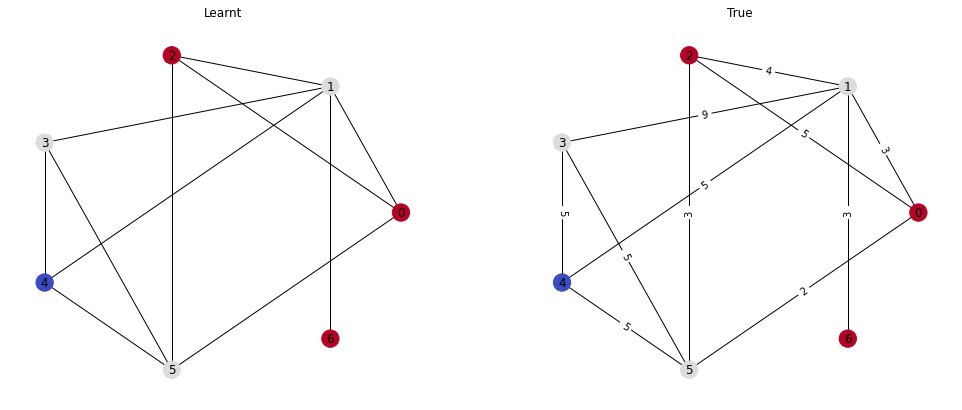

Passes: 2
tensor([1.0026, 1.0024, 0.0000, 1.0024, 1.0022, 2.0049, 2.0049],
       device='cuda:0')
tensor([1., 1., 0., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.00278214062564075	Similarity: 1.0


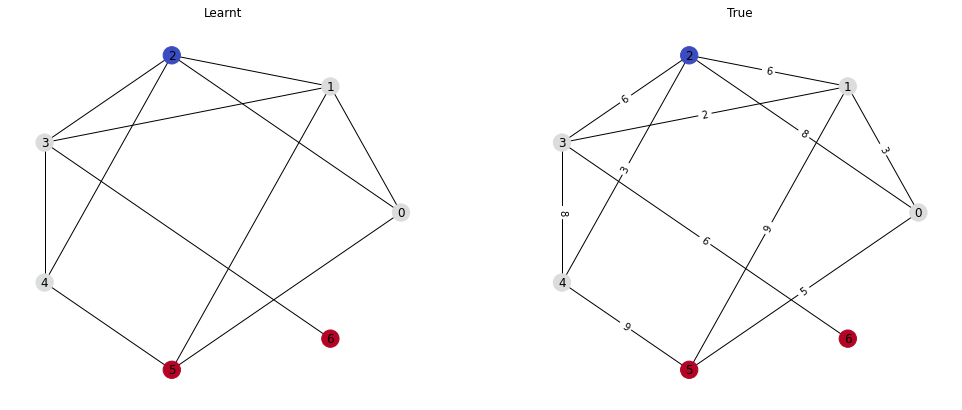

Passes: 2
tensor([2.0045, 2.0048, 1.0026, 1.0024, 0.0000, 1.0024, 2.0045],
       device='cuda:0')
tensor([2., 2., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0030142071191221476	Similarity: 1.0


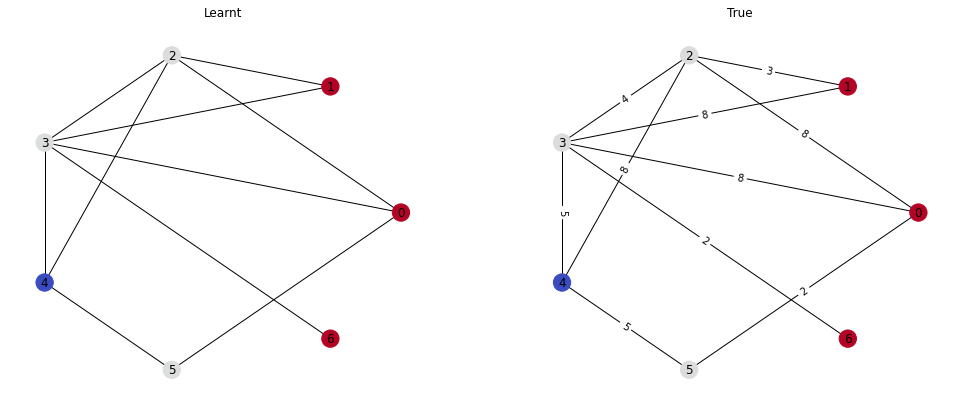

Passes: 2
tensor([0.0000, 1.0027, 1.0025, 2.0051, 2.0048, 2.0051, 2.0049],
       device='cuda:0')
tensor([0., 1., 1., 2., 2., 2., 2.], device='cuda:0')
Loss: 0.0035743373446166515	Similarity: 1.0


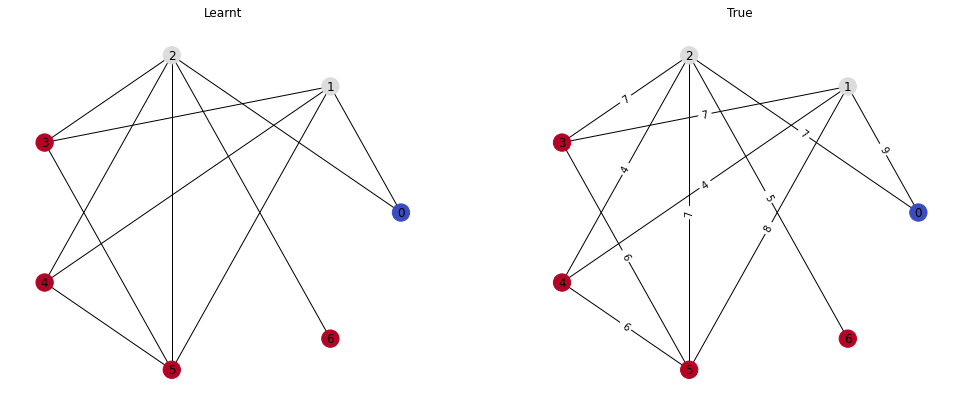

Passes: 2
tensor([1.0021, 1.0025, 1.0024, 1.0025, 0.0000, 2.0047, 2.0051],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 2., 2.], device='cuda:0')
Loss: 0.00278214062564075	Similarity: 1.0


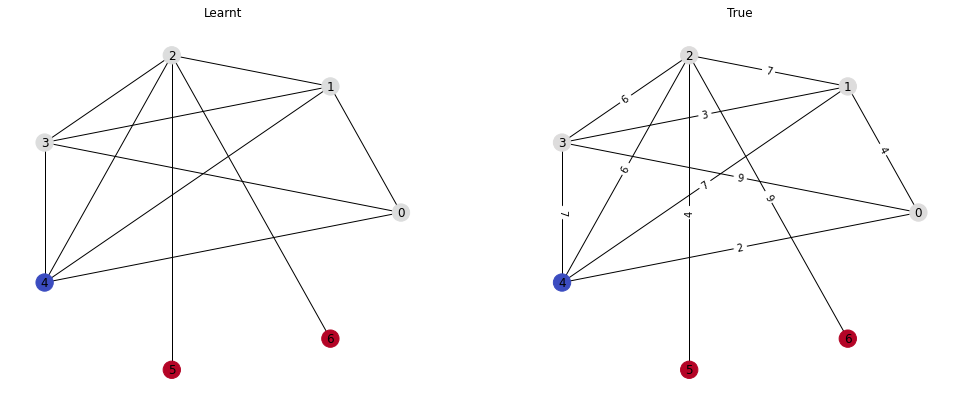

Passes: 2
tensor([0.0000, 1.0025, 1.0025, 1.0023, 1.0021, 2.0042, 2.0045],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.0025946754030883312	Similarity: 1.0


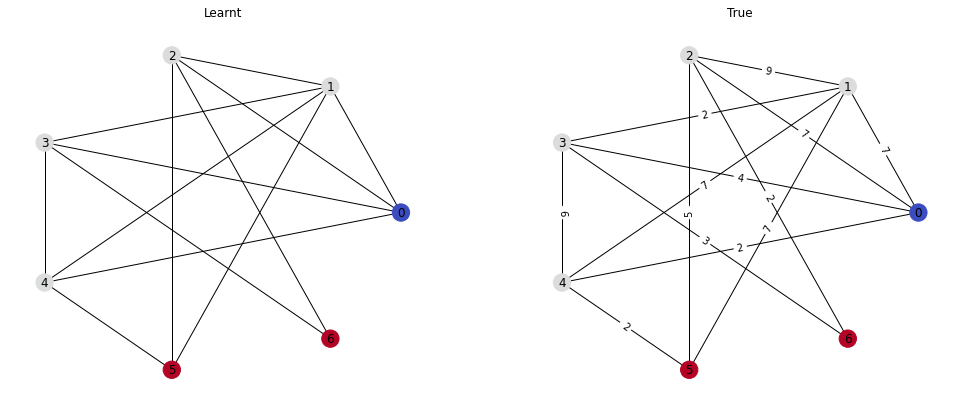

Passes: 3
tensor([2.0045, 1.0022, 2.0047, 2.0048, 0.0000, 3.0070, 3.0073],
       device='cuda:0')
tensor([2., 1., 2., 2., 0., 3., 3.], device='cuda:0')
Loss: 0.0043525188229978085	Similarity: 1.0


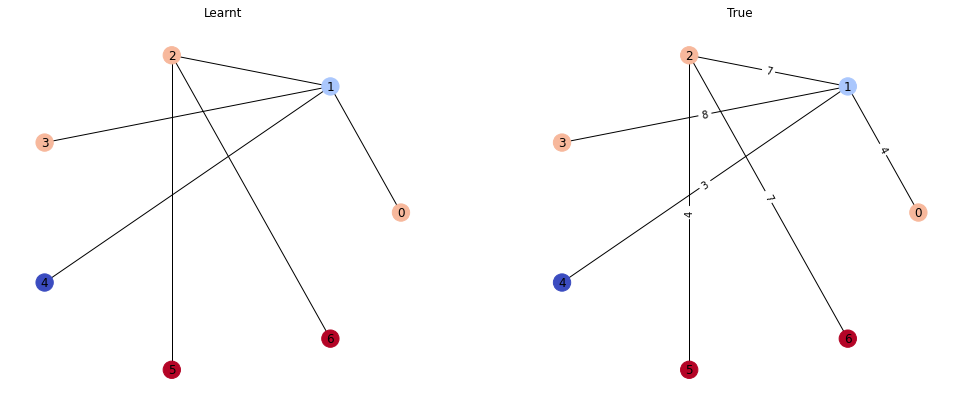

Passes: 2
tensor([2.0047, 1.0025, 1.0023, 1.0024, 1.0027, 0.0000, 1.0026],
       device='cuda:0')
tensor([2., 1., 1., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.002468058140948415	Similarity: 1.0


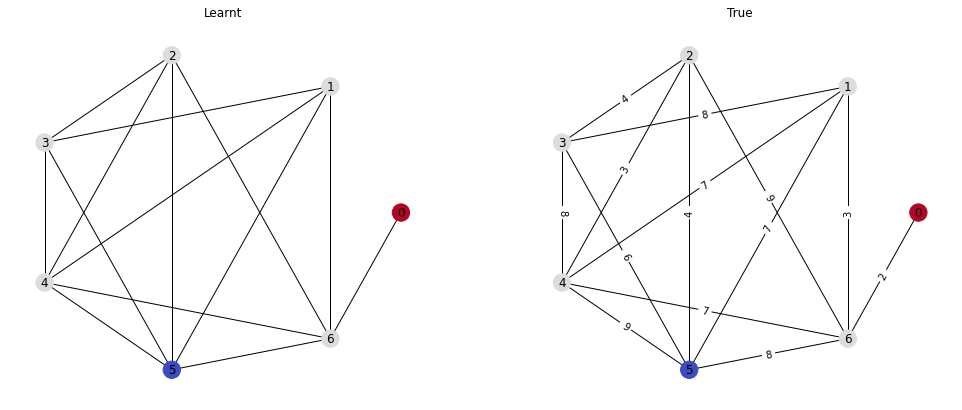

Passes: 2
tensor([0.0000, 1.0023, 1.0024, 1.0021, 1.0027, 1.0022, 2.0043],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0022923096548765898	Similarity: 1.0


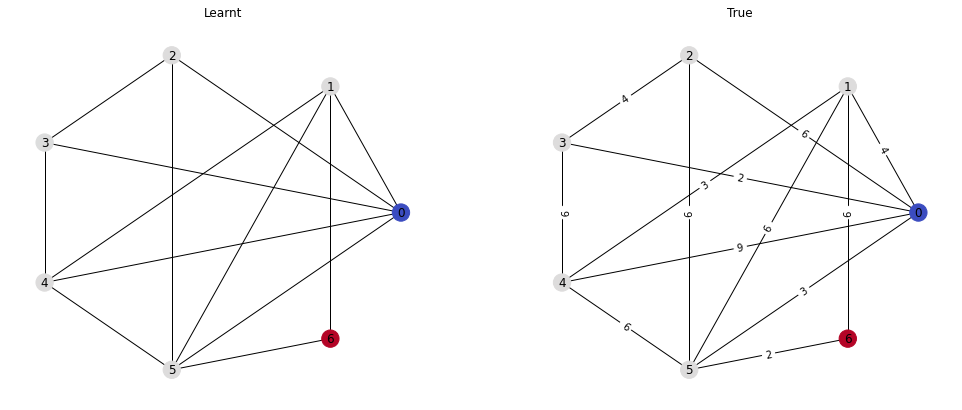

Passes: 2
tensor([1.0024, 0.0000, 1.0021, 2.0043, 2.0042, 2.0048, 2.0046],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 2., 2.], device='cuda:0')
Loss: 0.0032228403724730015	Similarity: 1.0


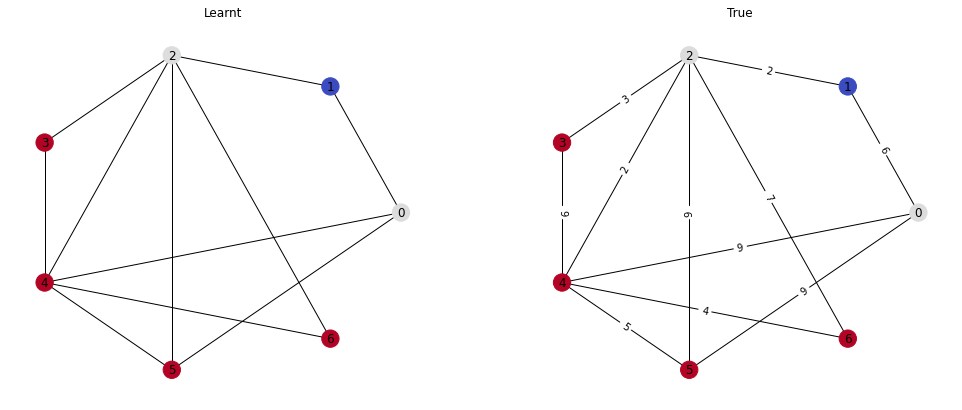

Passes: 3
tensor([0.0000, 1.0024, 1.0027, 2.0050, 2.0051, 3.0076, 2.0049],
       device='cuda:0')
tensor([0., 1., 1., 2., 2., 3., 2.], device='cuda:0')
Loss: 0.003946985583752394	Similarity: 1.0


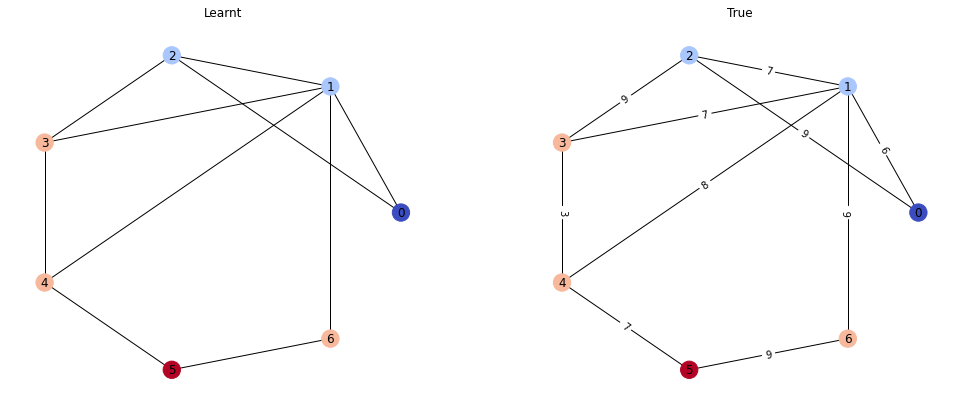

Passes: 3
tensor([2.0045, 2.0048, 0.0000, 2.0045, 1.0022, 3.0070], device='cuda:0')
tensor([2., 2., 0., 2., 1., 3.], device='cuda:0')
Loss: 0.0038283071480691433	Similarity: 1.0


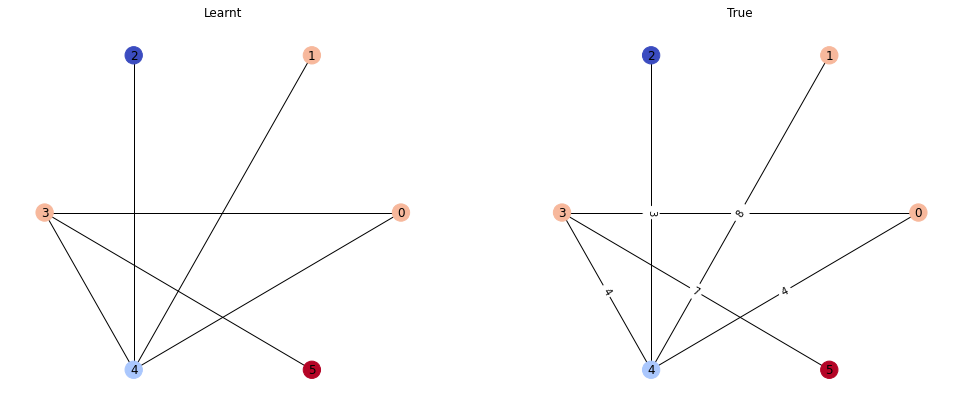

Passes: 2
tensor([1.0022, 1.0027, 1.0024, 1.0024, 2.0045, 0.0000, 1.0023],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 0., 1.], device='cuda:0')
Loss: 0.0023626089096069336	Similarity: 1.0


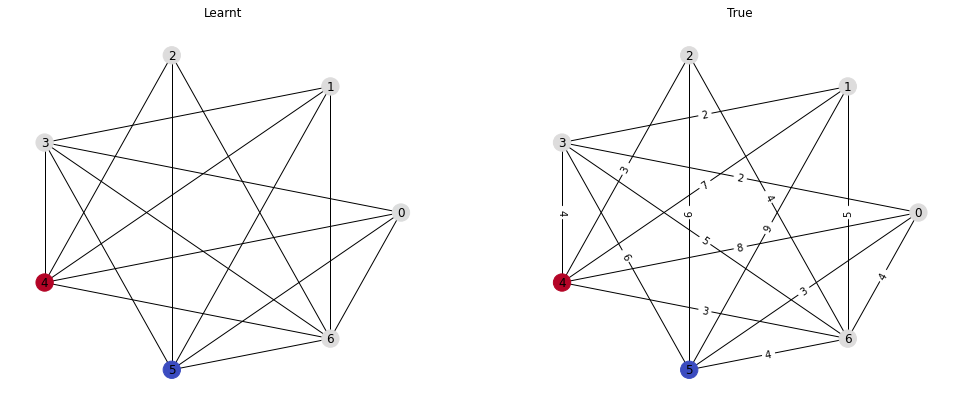

Passes: 3
tensor([0.0000, 1.0025, 2.0046, 3.0073, 2.0046, 2.0052], device='cuda:0')
tensor([0., 1., 2., 3., 2., 2.], device='cuda:0')
Loss: 0.004060685634613037	Similarity: 1.0


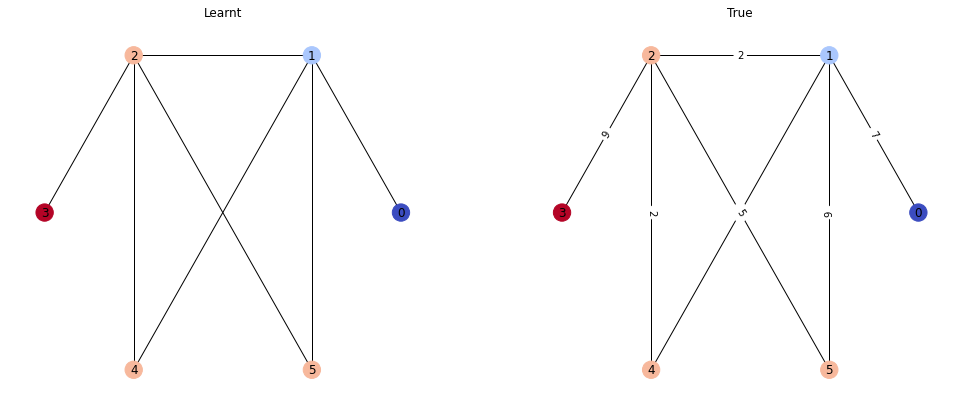

Passes: 2
tensor([1.0024, 1.0026, 1.0022, 1.0024, 2.0046, 0.0000, 1.0021],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 0., 1.], device='cuda:0')
Loss: 0.0023274593986570835	Similarity: 1.0


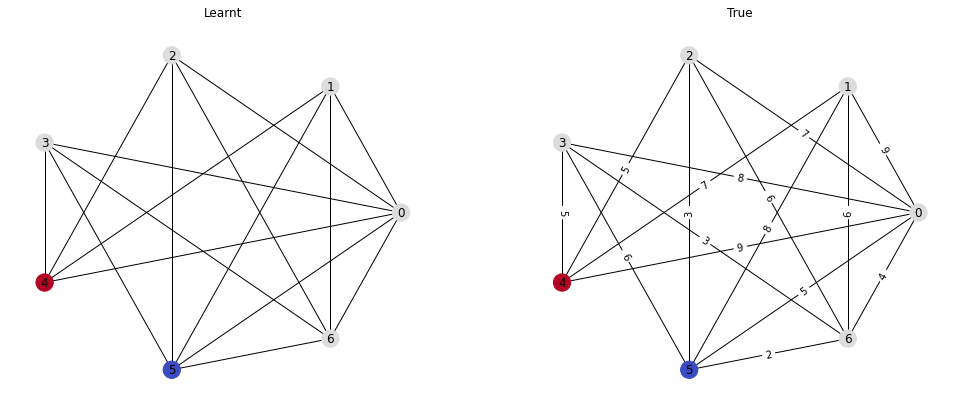

Passes: 2
tensor([2.0051, 0.0000, 2.0045, 1.0021, 1.0026, 1.0022, 1.0025],
       device='cuda:0')
tensor([2., 0., 2., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0027118411380797625	Similarity: 1.0


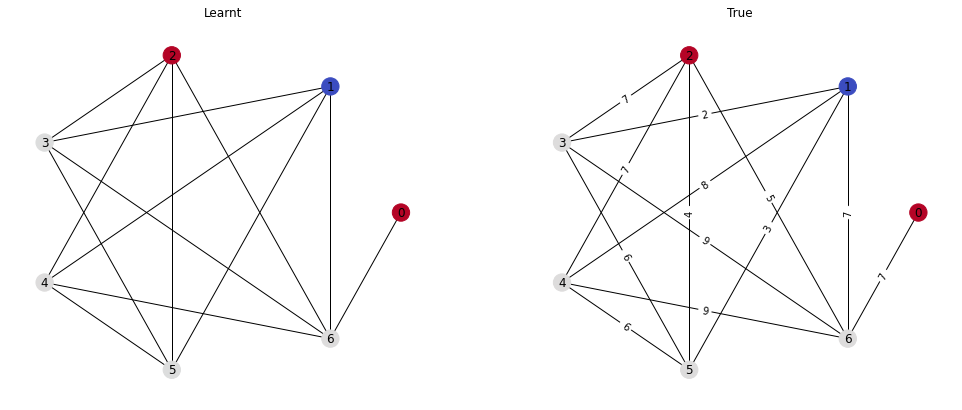

Passes: 2
tensor([1.0023, 0.0000, 1.0022, 2.0046, 2.0049, 1.0026, 1.0021],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.0026766913942992687	Similarity: 1.0


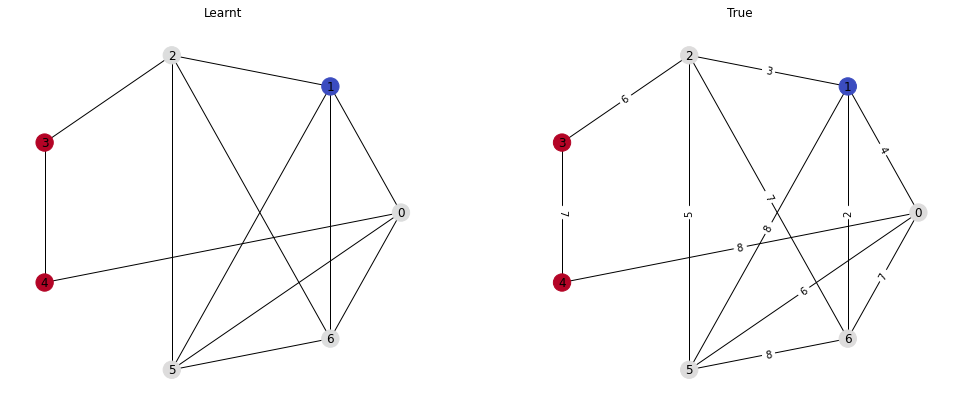

Passes: 1
tensor([1.0024, 1.0023, 1.0022, 0.0000, 1.0026, 1.0024, 1.0021],
       device='cuda:0')
tensor([1., 1., 1., 0., 1., 1., 1.], device='cuda:0')
Loss: 0.0019899436738342047	Similarity: 1.0


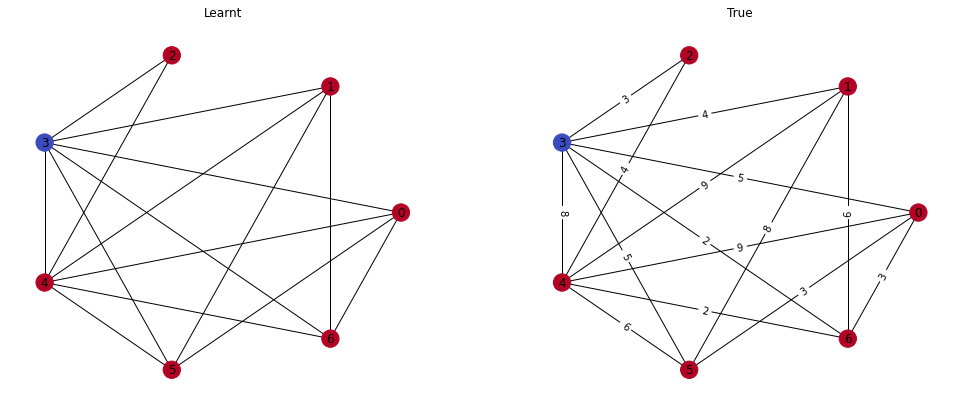

Passes: 2
tensor([1.0026, 2.0051, 1.0027, 2.0052, 2.0052, 0.0000, 1.0023],
       device='cuda:0')
tensor([1., 2., 1., 2., 2., 0., 1.], device='cuda:0')
Loss: 0.003307121340185404	Similarity: 1.0


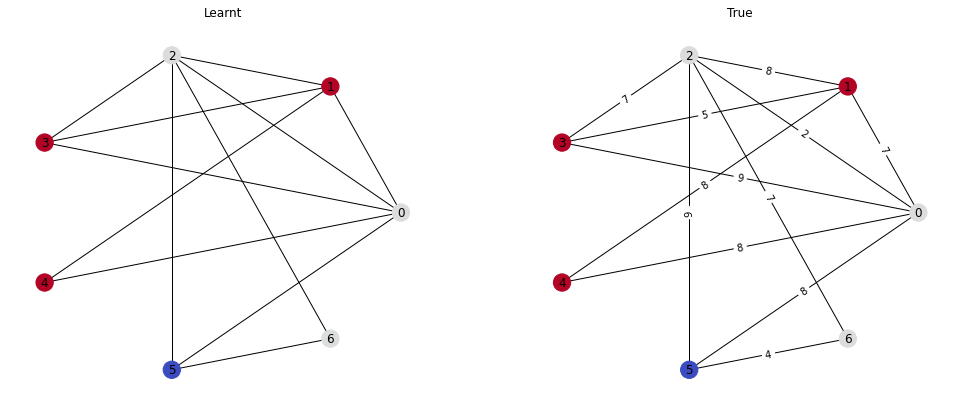

Passes: 2
tensor([1.0025, 1.0025, 1.0024, 1.0022, 2.0044, 2.0046, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 2., 0.], device='cuda:0')
Loss: 0.0026649748906493187	Similarity: 1.0


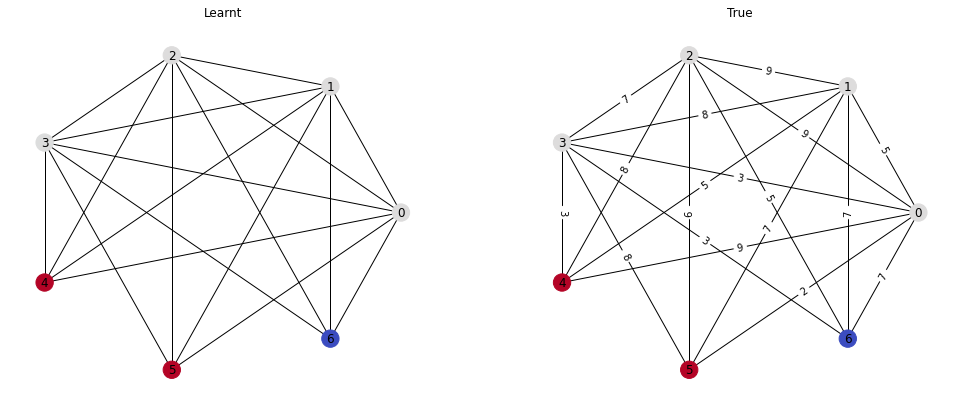

Passes: 2
tensor([1.0026, 2.0044, 0.0000, 2.0048, 1.0026, 1.0023, 2.0046],
       device='cuda:0')
tensor([1., 2., 0., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.0030376401264220476	Similarity: 1.0


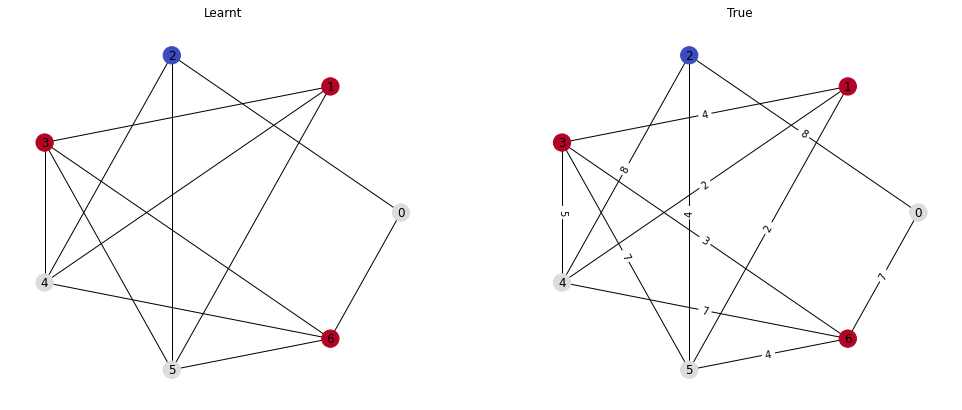

Passes: 2
tensor([2.0045, 1.0024, 0.0000, 1.0024, 2.0046, 2.0046, 2.0045],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 2., 2.], device='cuda:0')
Loss: 0.0032697066199034452	Similarity: 1.0


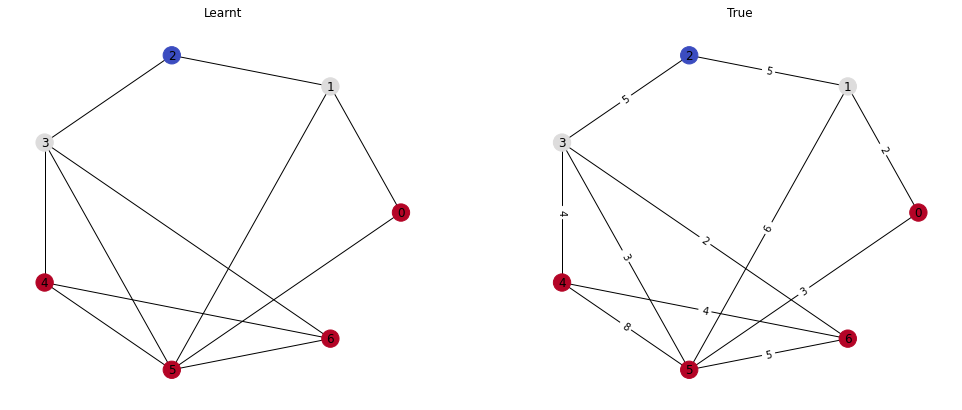

Passes: 2
tensor([1.0023, 0.0000, 1.0027, 1.0022, 1.0024, 1.0026, 2.0047],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.002409475389868021	Similarity: 1.0


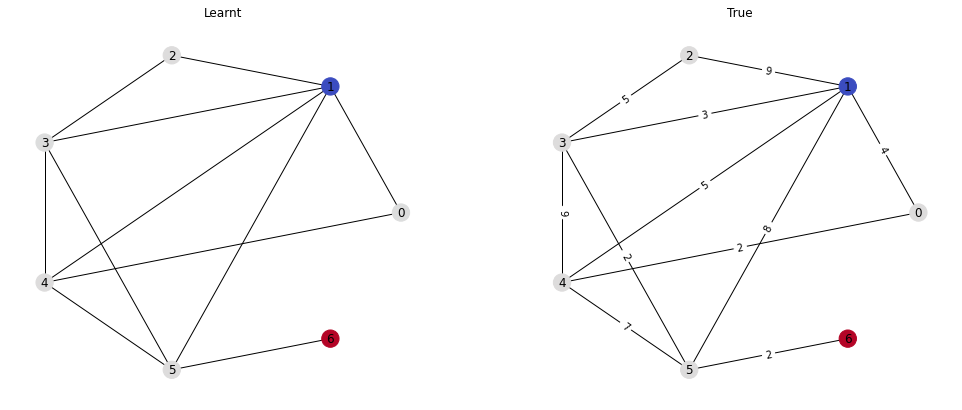

Passes: 2
tensor([1.0026, 2.0047, 2.0048, 2.0051, 1.0021, 0.0000, 1.0022],
       device='cuda:0')
tensor([1., 2., 2., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.0030845063738524914	Similarity: 1.0


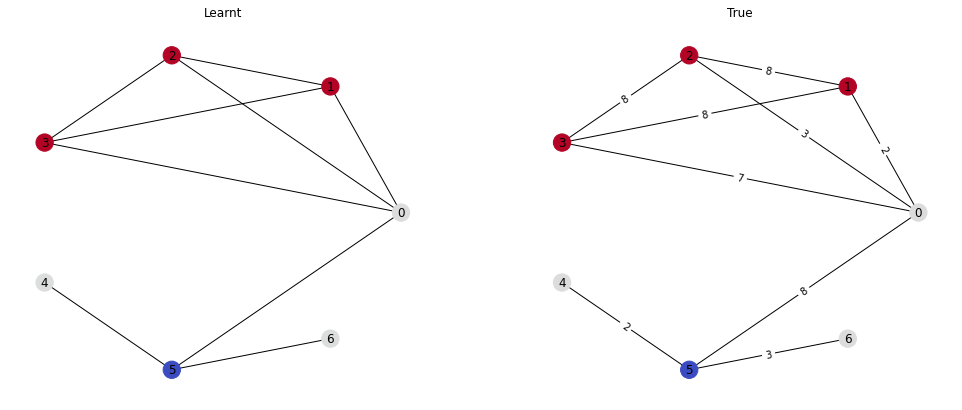

Passes: 2
tensor([2.0050, 1.0024, 1.0024, 0.0000, 2.0048, 2.0046, 2.0046],
       device='cuda:0')
tensor([2., 1., 1., 0., 2., 2., 2.], device='cuda:0')
Loss: 0.0033868723548948765	Similarity: 1.0


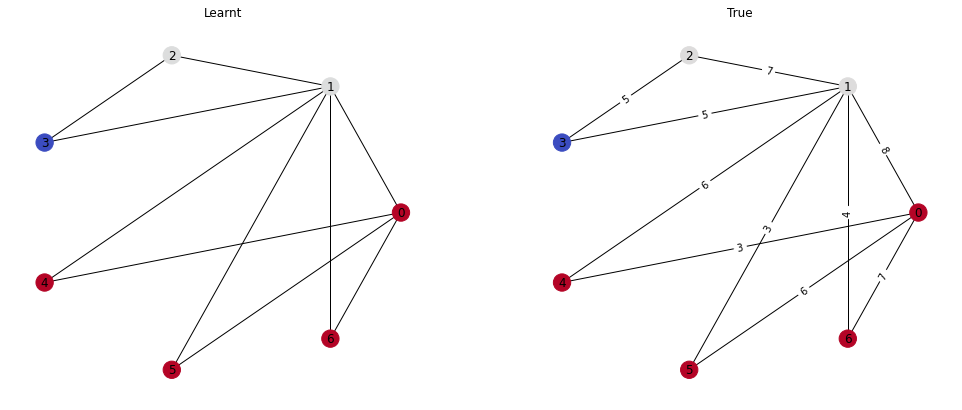

Passes: 2
tensor([1.0025, 1.0023, 1.0022, 2.0044, 0.0000, 2.0048, 2.0043],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 2., 2.], device='cuda:0')
Loss: 0.00293219112791121	Similarity: 1.0


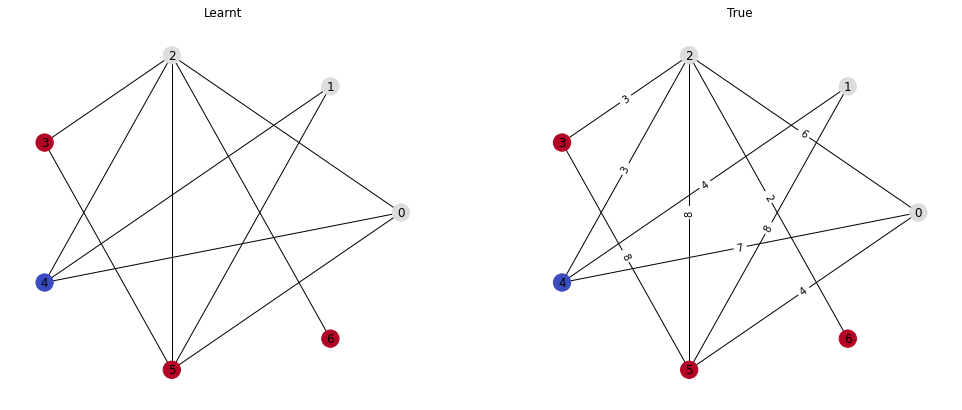

Passes: 1
tensor([1.0024, 1.0025, 0.0000, 1.0023, 1.0022, 1.0022, 1.0023],
       device='cuda:0')
tensor([1., 1., 0., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0019899436738342047	Similarity: 1.0


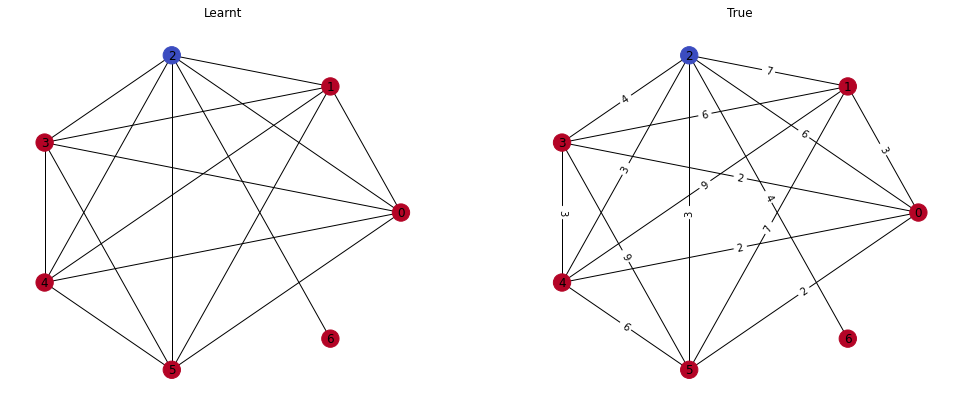

Passes: 3
tensor([0.0000, 1.0024, 1.0026, 2.0049, 2.0046, 2.0049, 3.0070],
       device='cuda:0')
tensor([0., 1., 1., 2., 2., 2., 3.], device='cuda:0')
Loss: 0.0037712370976805687	Similarity: 1.0


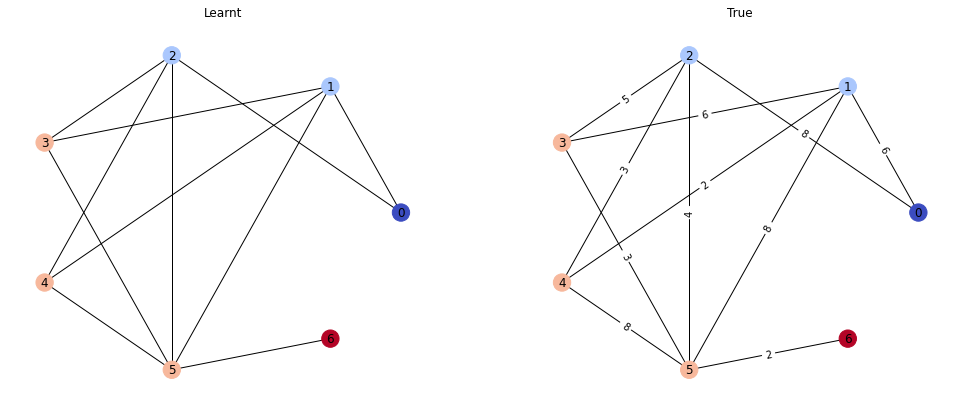

Passes: 3
tensor([0.0000, 3.0070, 2.0050, 2.0048, 2.0051, 2.0051, 1.0026],
       device='cuda:0')
tensor([0., 3., 2., 2., 2., 2., 1.], device='cuda:0')
Loss: 0.004225918557494879	Similarity: 1.0


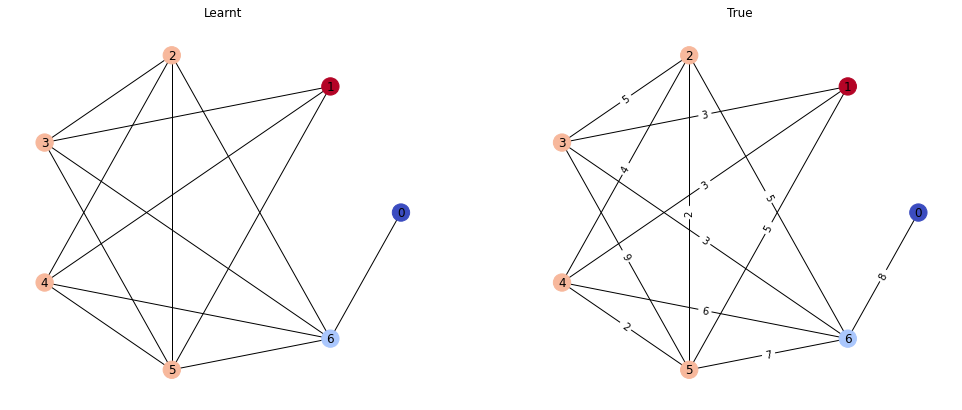

Passes: 3
tensor([1.0025, 2.0050, 2.0051, 1.0025, 0.0000, 3.0073], device='cuda:0')
tensor([1., 2., 2., 1., 0., 3.], device='cuda:0')
Loss: 0.0037352642975747585	Similarity: 1.0


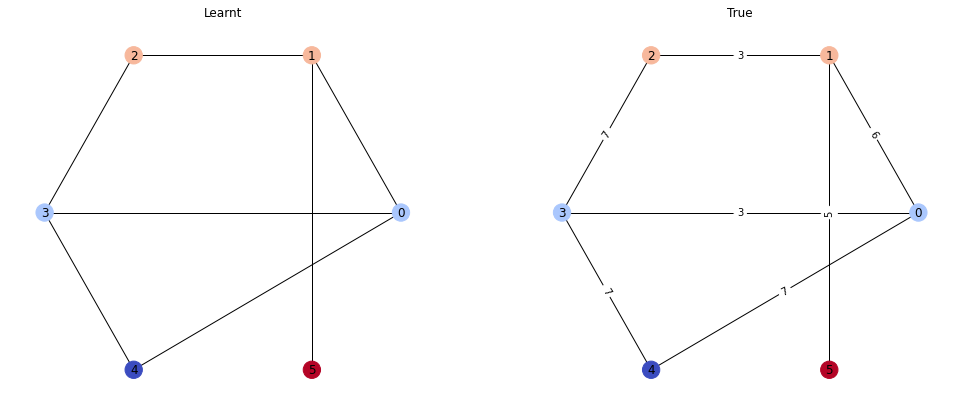

Passes: 2
tensor([0.0000, 1.0021, 2.0047, 1.0026, 1.0026, 1.0021, 2.0051],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0027587073855102062	Similarity: 1.0


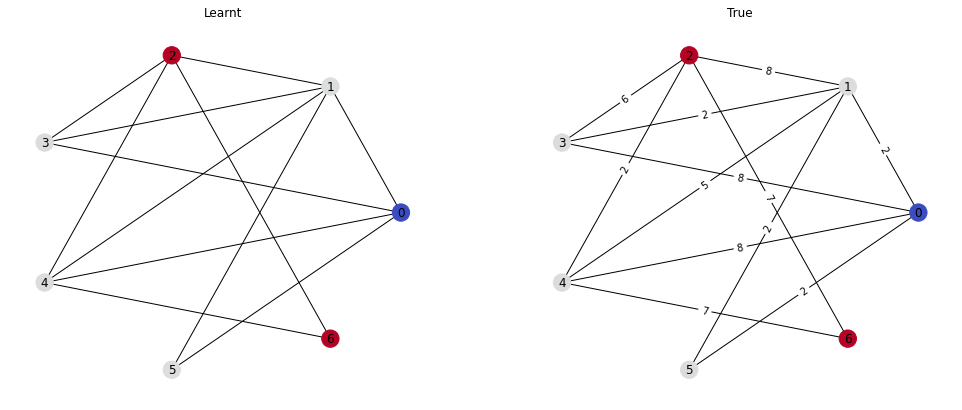

Passes: 3
tensor([1.0024, 1.0023, 2.0046, 2.0046, 1.0023, 0.0000, 3.0073],
       device='cuda:0')
tensor([1., 1., 2., 2., 1., 0., 3.], device='cuda:0')
Loss: 0.0033399888779968023	Similarity: 1.0


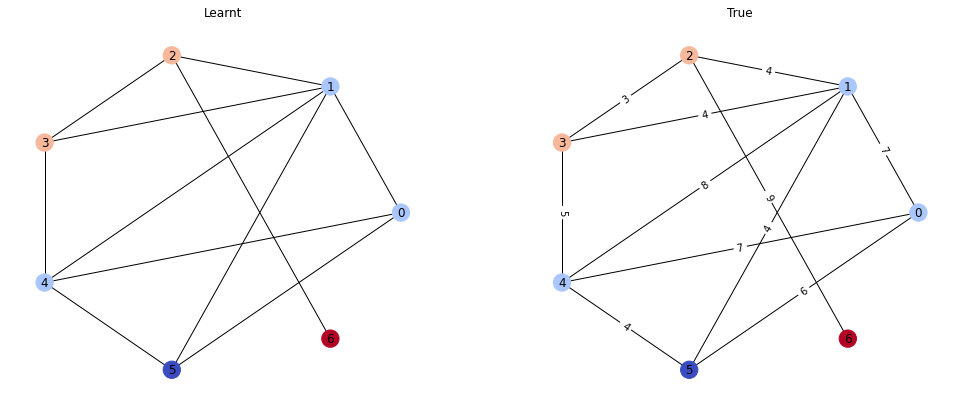

Passes: 2
tensor([1.0025, 0.0000, 1.0023, 2.0050, 2.0049, 2.0049, 2.0046],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 2., 2.], device='cuda:0')
Loss: 0.0034454551059752703	Similarity: 1.0


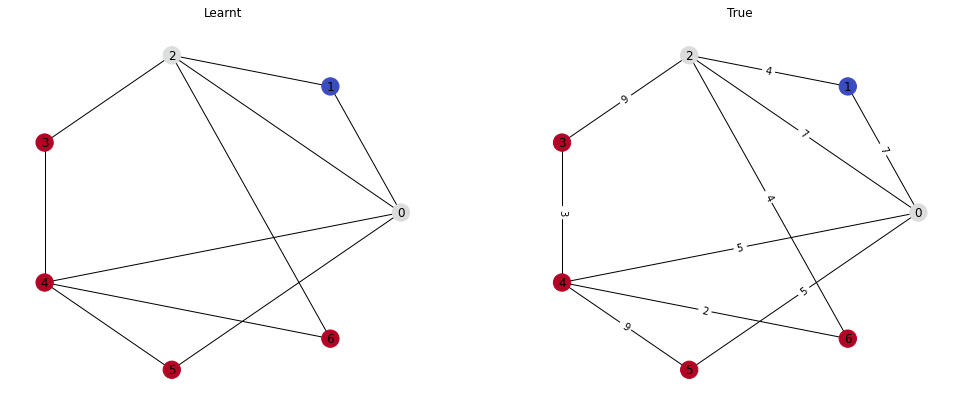

Passes: 2
tensor([2.0048, 2.0048, 1.0026, 0.0000, 1.0025, 1.0025], device='cuda:0')
tensor([2., 2., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.0028794012032449245	Similarity: 1.0


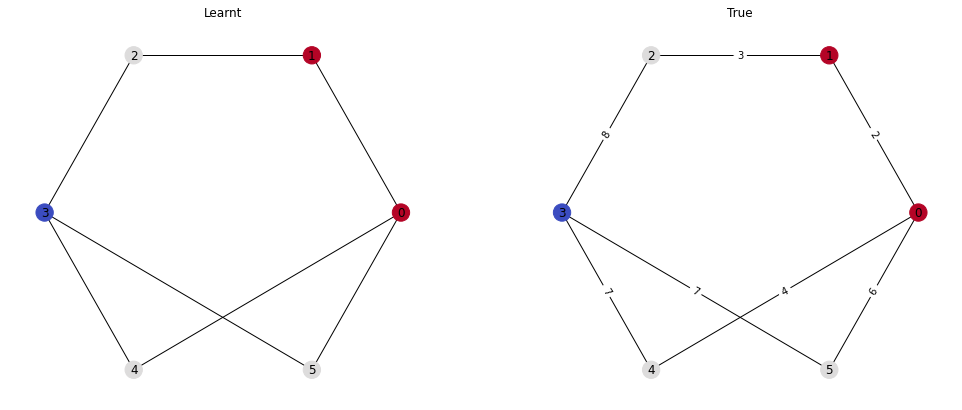

Passes: 2
tensor([1.0025, 2.0047, 0.0000, 2.0046, 1.0024, 1.0021, 1.0024],
       device='cuda:0')
tensor([1., 2., 0., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


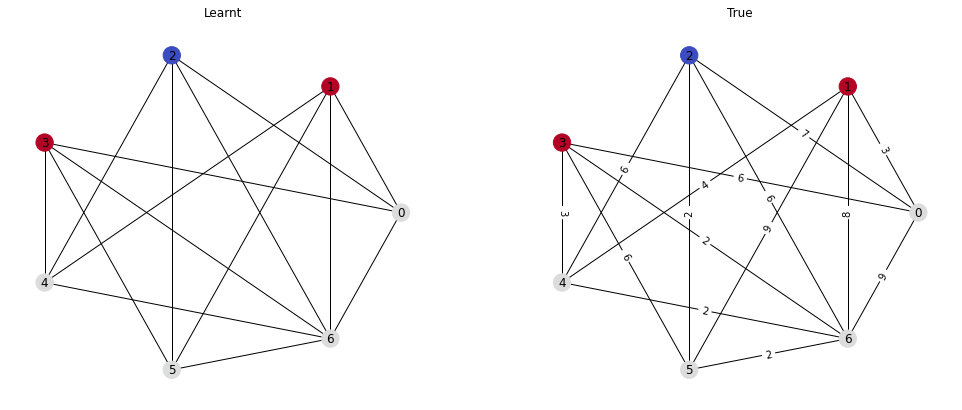

Passes: 2
tensor([1.0026, 1.0025, 2.0052, 2.0047, 2.0050, 2.0053, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 2., 2., 2., 0.], device='cuda:0')
Loss: 0.003621203824877739	Similarity: 1.0


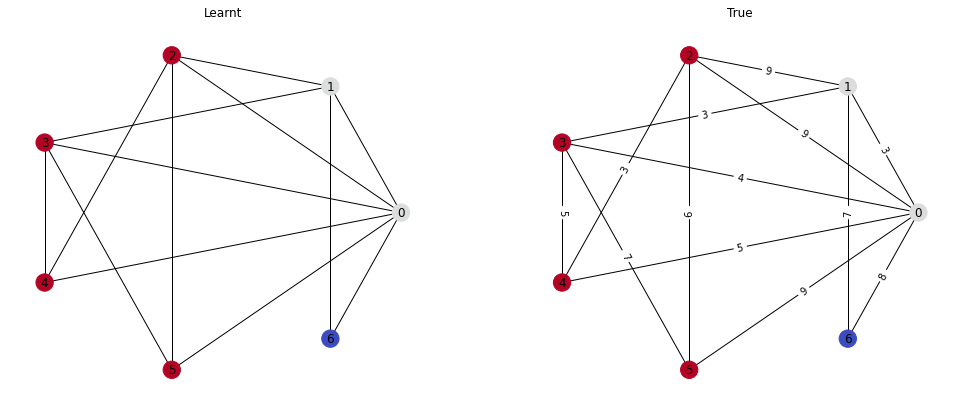

Passes: 2
tensor([1.0025, 2.0048, 1.0026, 1.0026, 1.0023, 1.0024, 0.0000],
       device='cuda:0')
tensor([1., 2., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.0024563416372984648	Similarity: 1.0


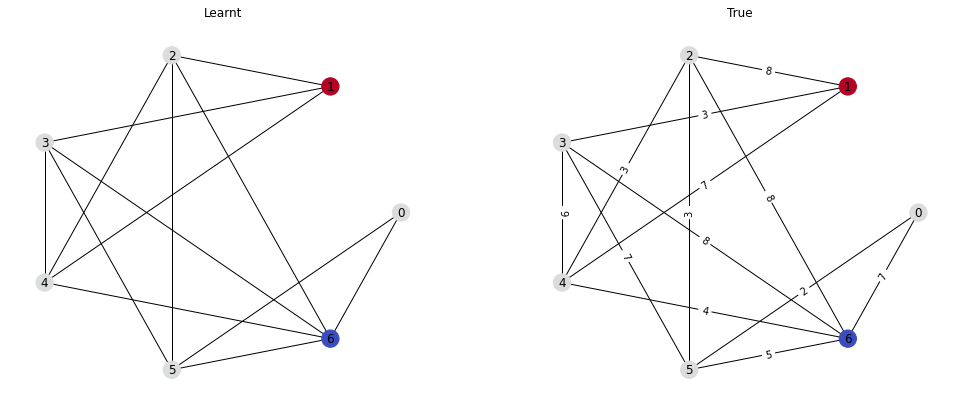

Passes: 2
tensor([2.0048, 1.0022, 0.0000, 1.0024, 2.0043], device='cuda:0')
tensor([2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0027531147934496403	Similarity: 1.0


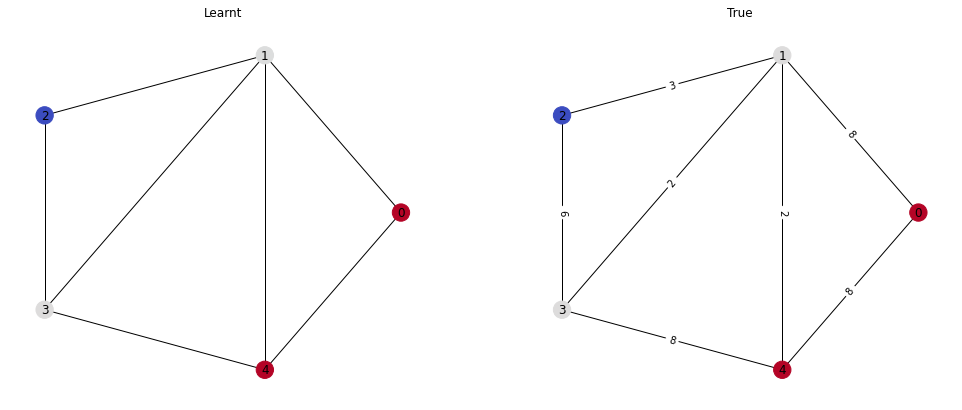

Passes: 2
tensor([2.0046, 2.0044, 2.0046, 2.0046, 0.0000, 1.0022, 1.0023],
       device='cuda:0')
tensor([2., 2., 2., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.003257990116253495	Similarity: 1.0


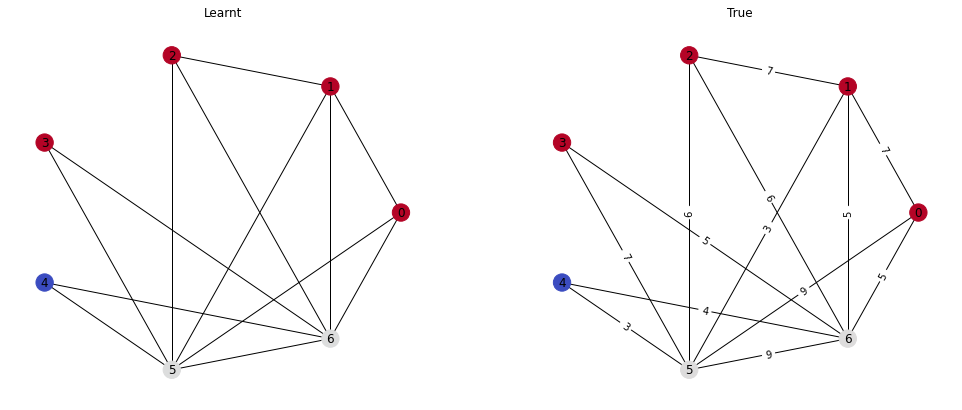

Passes: 4
tensor([4.0099, 2.0051, 1.0027, 3.0073, 3.0073, 0.0000, 1.0024],
       device='cuda:0')
tensor([4., 2., 1., 3., 3., 0., 1.], device='cuda:0')
Loss: 0.004959515295922756	Similarity: 1.0


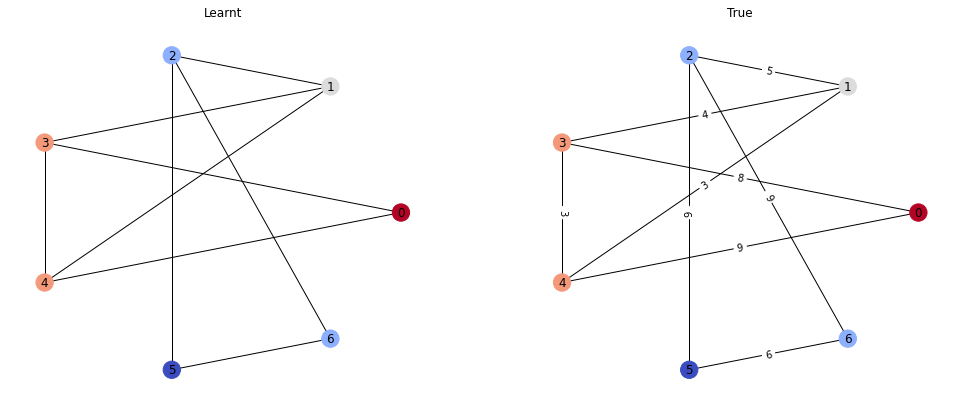

Passes: 3
tensor([1.0021, 2.0044, 1.0023, 1.0023, 0.0000, 1.0021, 3.0068],
       device='cuda:0')
tensor([1., 2., 1., 1., 0., 1., 3.], device='cuda:0')
Loss: 0.002861874643713236	Similarity: 1.0


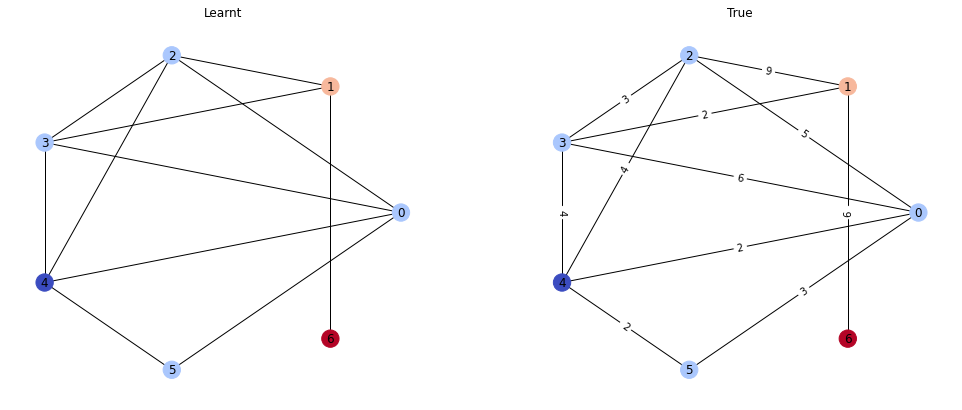

Passes: 2
tensor([1.0021, 2.0046, 1.0027, 1.0027, 1.0024, 1.0024, 0.0000],
       device='cuda:0')
tensor([1., 2., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.002421191893517971	Similarity: 1.0


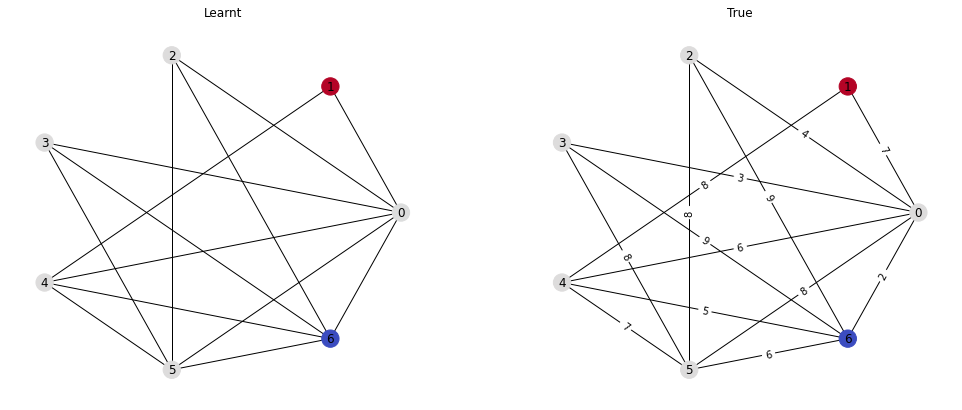

Passes: 3
tensor([1.0027, 0.0000, 1.0023, 3.0073, 2.0048, 2.0049, 2.0049],
       device='cuda:0')
tensor([1., 0., 1., 3., 2., 2., 2.], device='cuda:0')
Loss: 0.003841536585241556	Similarity: 1.0


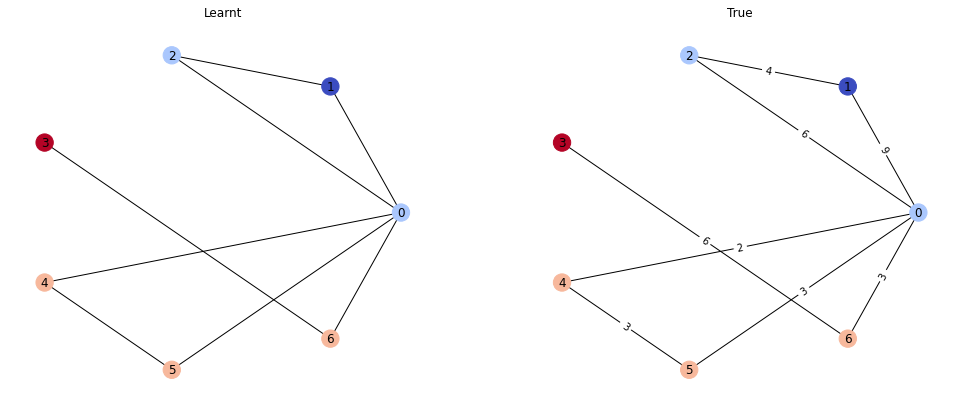

Passes: 2
tensor([1.0024, 0.0000, 1.0021, 1.0025, 1.0025, 2.0045], device='cuda:0')
tensor([1., 0., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0023352704010903835	Similarity: 1.0


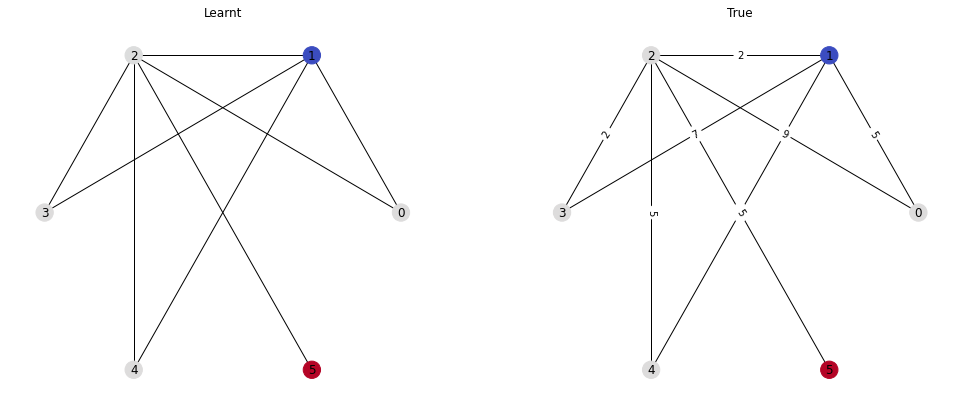

Passes: 2
tensor([2.0042, 1.0026, 1.0022, 0.0000, 2.0048, 1.0025, 1.0021],
       device='cuda:0')
tensor([2., 1., 1., 0., 2., 1., 1.], device='cuda:0')
Loss: 0.002641541650518775	Similarity: 1.0


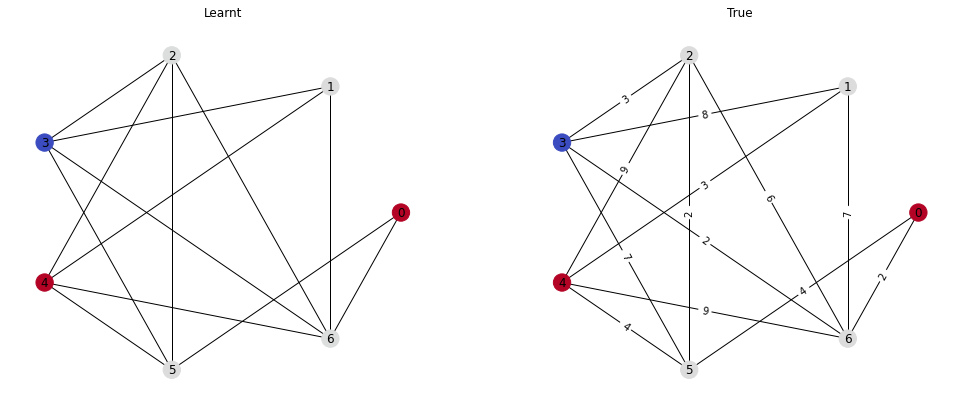

Passes: 3
tensor([2.0049, 2.0046, 1.0025, 0.0000, 1.0025, 1.0023, 3.0073],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 1., 3.], device='cuda:0')
Loss: 0.0034454381093382835	Similarity: 1.0


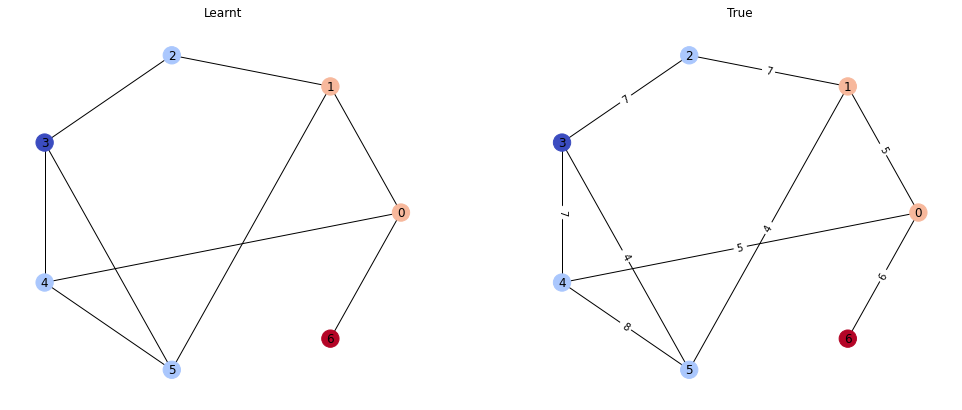

Passes: 2
tensor([0.0000, 2.0049, 2.0045, 2.0049, 2.0049, 1.0024, 1.0025],
       device='cuda:0')
tensor([0., 2., 2., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.0034337386023253202	Similarity: 1.0


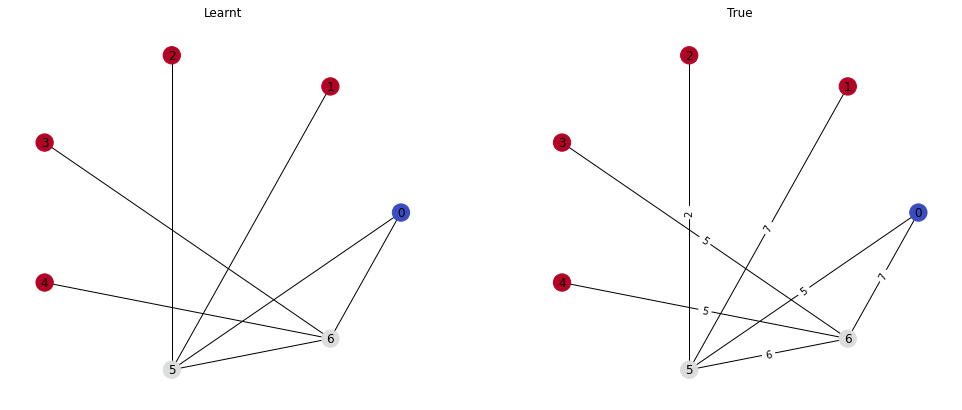

Passes: 2
tensor([1.0027, 2.0051, 2.0050, 1.0026, 0.0000, 2.0054, 1.0023],
       device='cuda:0')
tensor([1., 2., 2., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.00328368810005486	Similarity: 1.0


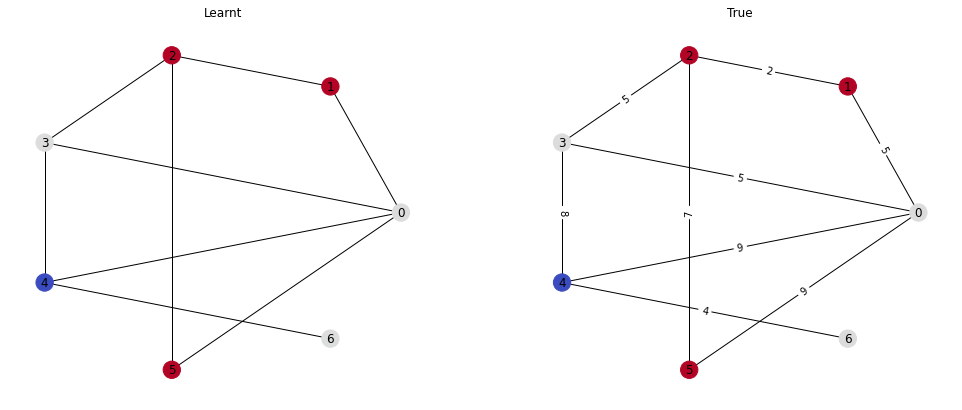

Passes: 2
tensor([1.0024, 2.0047, 2.0050, 2.0049, 1.0024, 0.0000], device='cuda:0')
tensor([1., 2., 2., 2., 1., 0.], device='cuda:0')
Loss: 0.003232161281630397	Similarity: 1.0


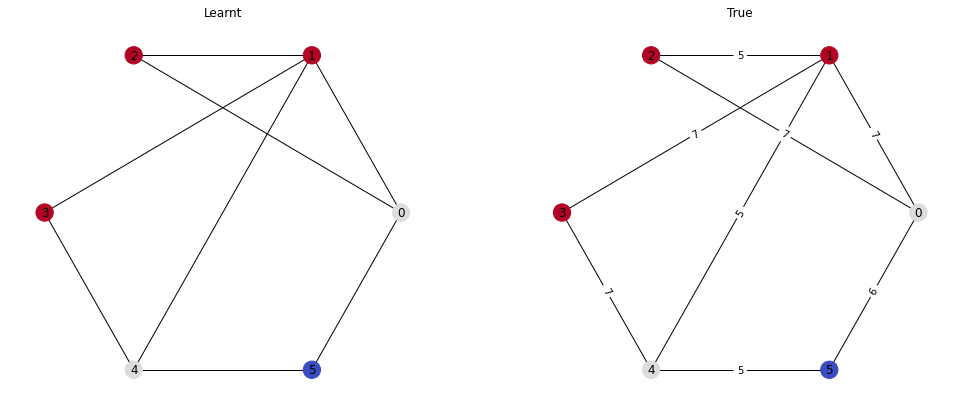

Passes: 2
tensor([1.0023, 2.0048, 1.0025, 1.0025, 1.0025, 0.0000, 2.0044],
       device='cuda:0')
tensor([1., 2., 1., 1., 1., 0., 2.], device='cuda:0')
Loss: 0.0027235576417297125	Similarity: 1.0


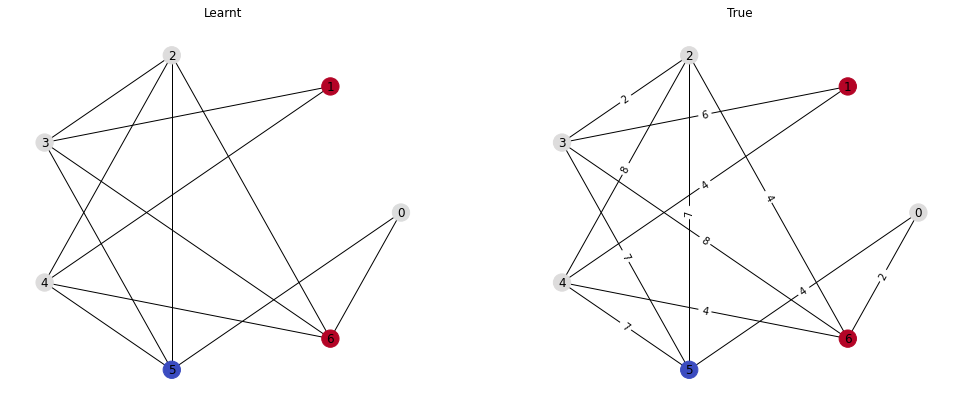

Passes: 3
tensor([2.0046, 1.0021, 1.0024, 2.0046, 3.0068, 2.0046, 0.0000],
       device='cuda:0')
tensor([2., 1., 1., 2., 3., 2., 0.], device='cuda:0')
Loss: 0.0035837721079587936	Similarity: 1.0


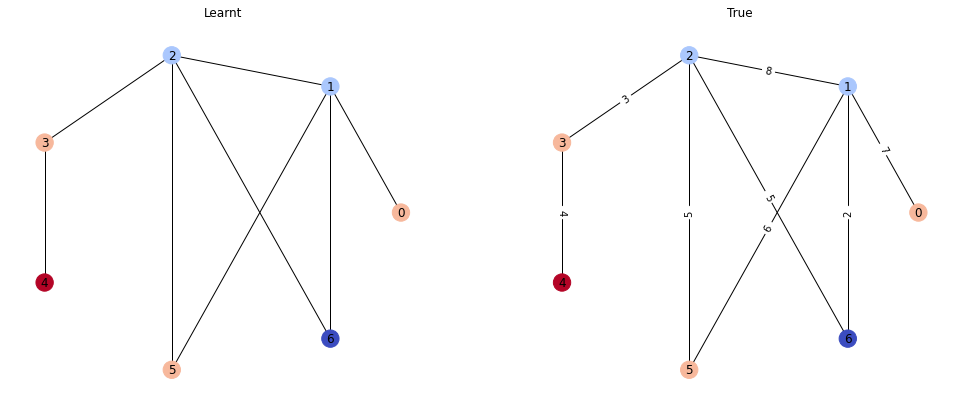

Passes: 2
tensor([2.0046, 2.0043, 0.0000, 1.0022, 1.0022, 2.0043, 2.0046],
       device='cuda:0')
tensor([2., 2., 0., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.0031876906286925077	Similarity: 1.0


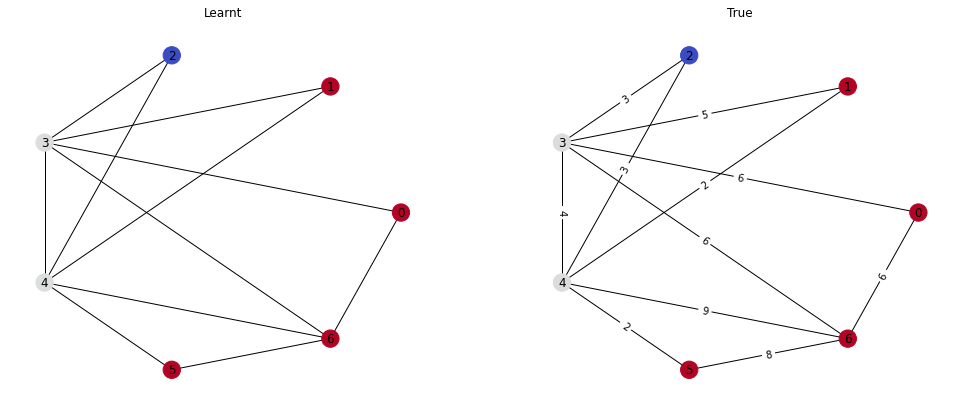

Passes: 3
tensor([1.0027, 2.0048, 2.0050, 2.0044, 3.0076, 0.0000, 1.0022],
       device='cuda:0')
tensor([1., 2., 2., 2., 3., 0., 1.], device='cuda:0')
Loss: 0.0038063868414610624	Similarity: 1.0


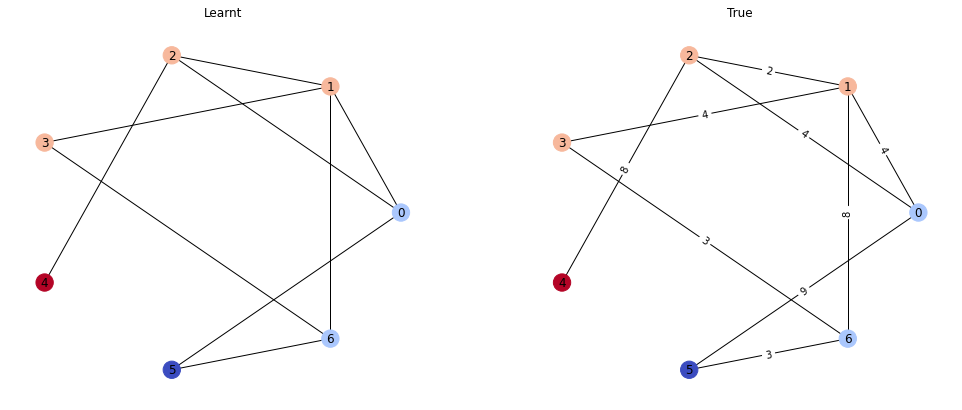

Passes: 1
tensor([0.0000, 1.0023, 1.0024, 1.0021, 1.0023, 1.0024, 1.0025],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0020016604103147984	Similarity: 1.0


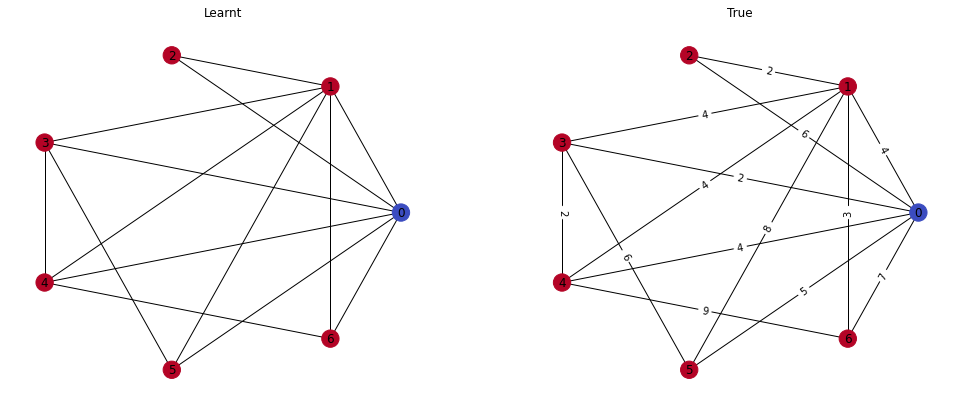

Passes: 2
tensor([2.0051, 0.0000, 1.0025, 1.0027, 1.0027, 2.0047], device='cuda:0')
tensor([2., 0., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0029477477073669434	Similarity: 1.0


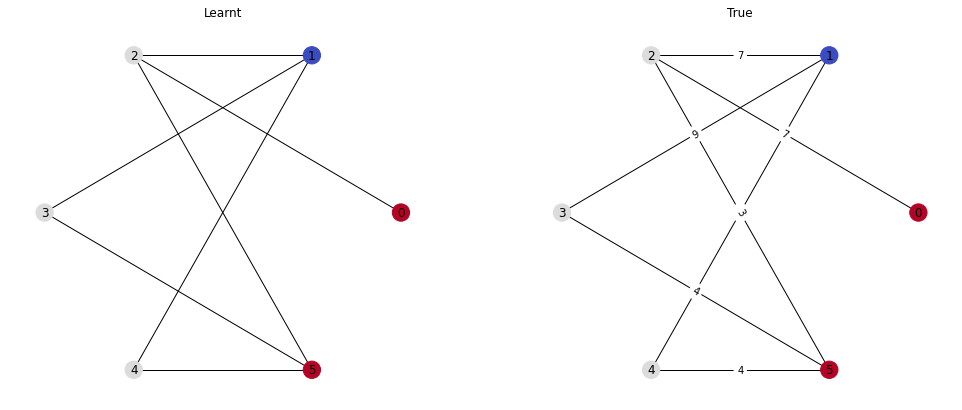

Passes: 2
tensor([2.0045, 0.0000, 2.0048, 1.0024, 1.0022, 1.0024, 1.0025],
       device='cuda:0')
tensor([2., 0., 2., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


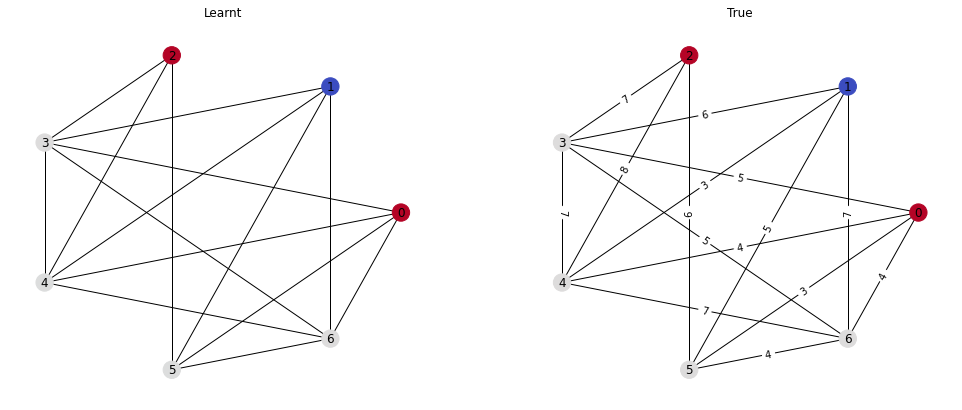

Passes: 2
tensor([2.0049, 2.0050, 1.0027, 0.0000, 1.0024, 2.0046, 1.0024],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.003143089357763529	Similarity: 1.0


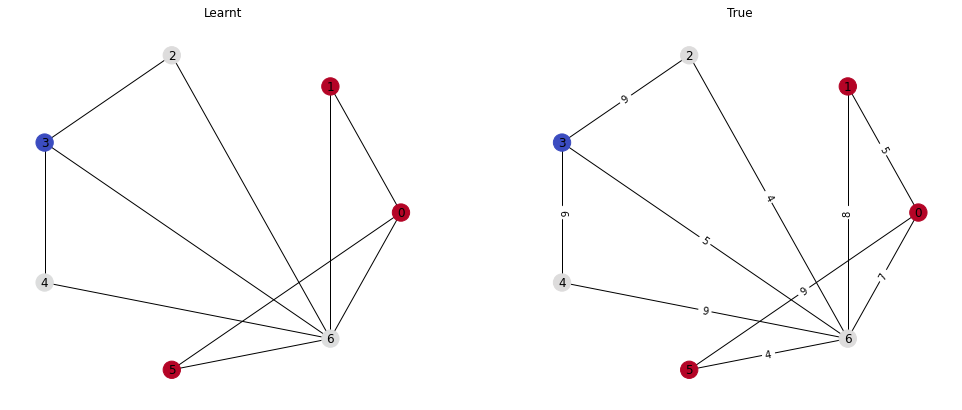

Passes: 2
tensor([1.0022, 1.0022, 1.0024, 0.0000, 1.0024, 2.0046, 1.0024],
       device='cuda:0')
tensor([1., 1., 1., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.0022923096548765898	Similarity: 1.0


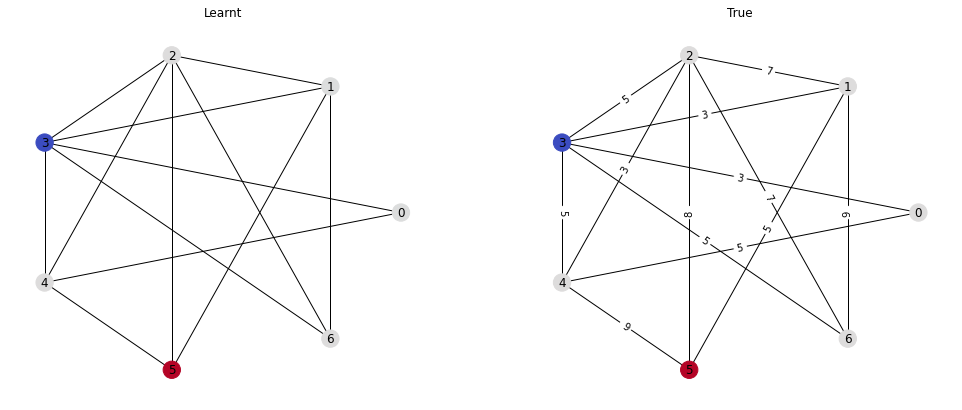

Passes: 2
tensor([1.0023, 1.0025, 1.0022, 0.0000, 1.0021, 2.0046], device='cuda:0')
tensor([1., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.002280592918395996	Similarity: 1.0


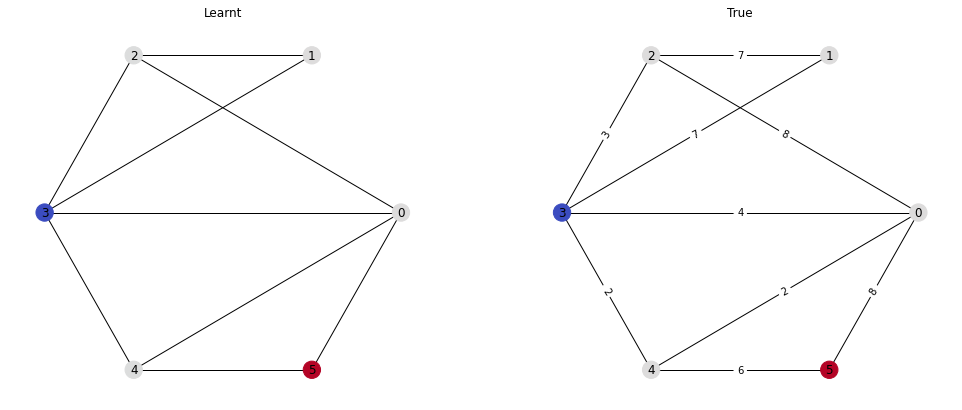

Passes: 2
tensor([1.0021, 1.0024, 0.0000, 2.0046, 2.0046, 1.0022, 1.0026],
       device='cuda:0')
tensor([1., 1., 0., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.0026532583869993687	Similarity: 1.0


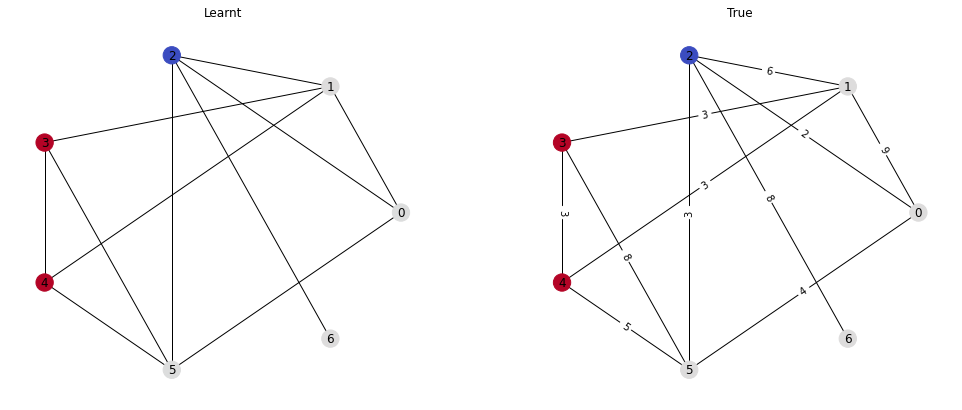

Passes: 2
tensor([2.0047, 2.0051, 1.0023, 0.0000, 1.0026, 2.0046, 2.0046],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.0034103053621947765	Similarity: 1.0


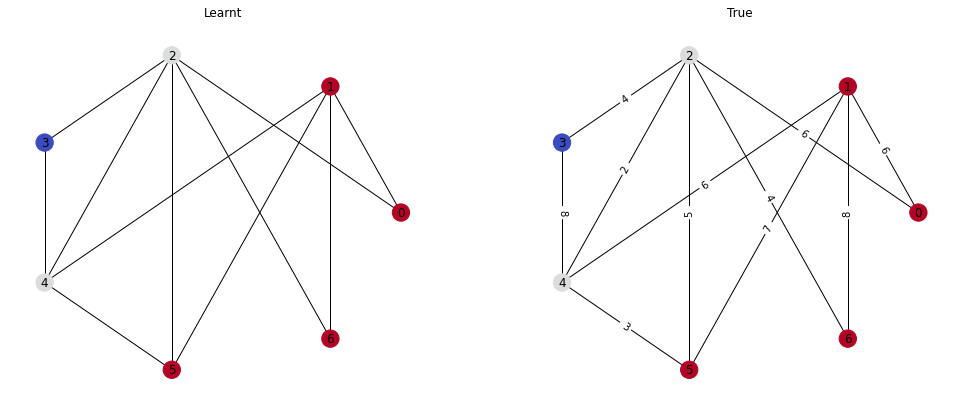

Passes: 2
tensor([0.0000, 1.0027, 2.0043, 2.0042, 1.0021, 1.0021, 2.0044],
       device='cuda:0')
tensor([0., 1., 2., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.002838458400219679	Similarity: 1.0


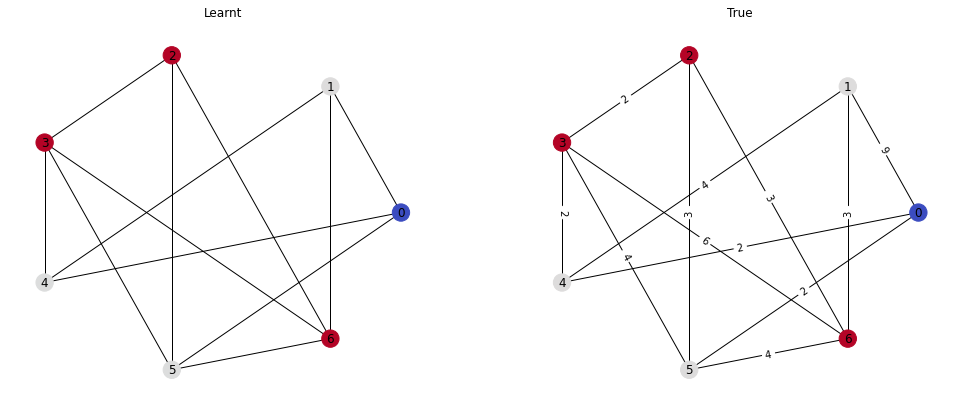

Passes: 2
tensor([2.0049, 1.0025, 1.0026, 1.0027, 0.0000, 1.0023, 1.0027],
       device='cuda:0')
tensor([2., 1., 1., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.0025266408920288086	Similarity: 1.0


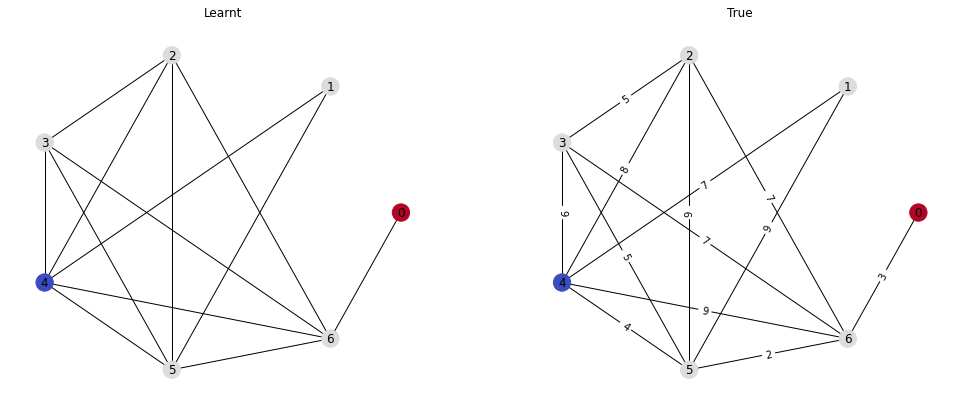

Passes: 2
tensor([1.0021, 1.0022, 1.0025, 1.0024, 1.0025, 2.0044, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 1., 2., 0.], device='cuda:0')
Loss: 0.00231574266217649	Similarity: 1.0


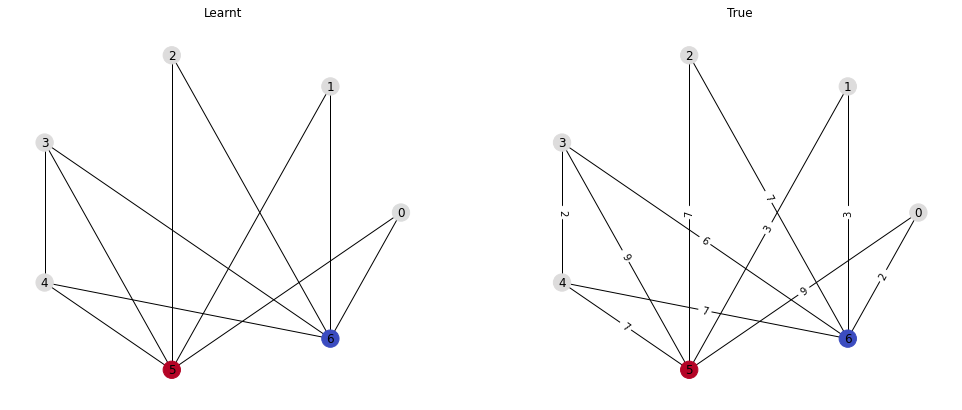

Passes: 1
tensor([0.0000, 1.0025, 1.0023, 1.0026, 1.0024, 1.0023, 1.0026],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.002095392905175686	Similarity: 1.0


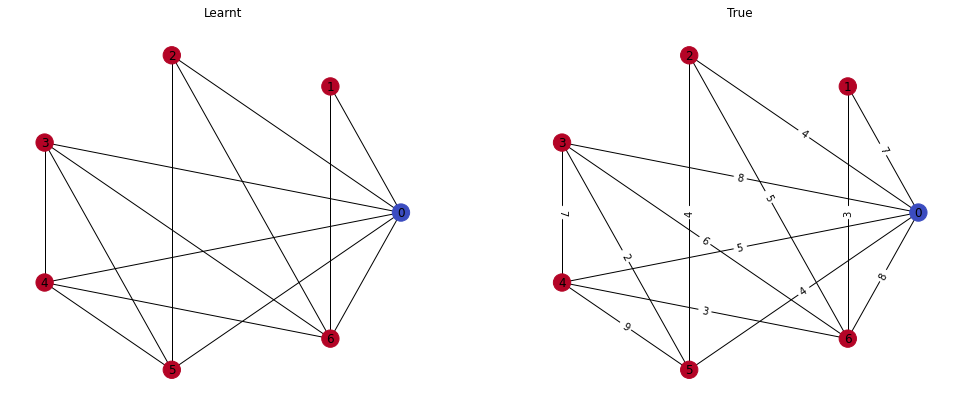

Passes: 2
tensor([1.0027, 2.0049, 1.0026, 1.0025, 1.0024, 1.0026, 0.0000],
       device='cuda:0')
tensor([1., 2., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.0025383576285094023	Similarity: 1.0


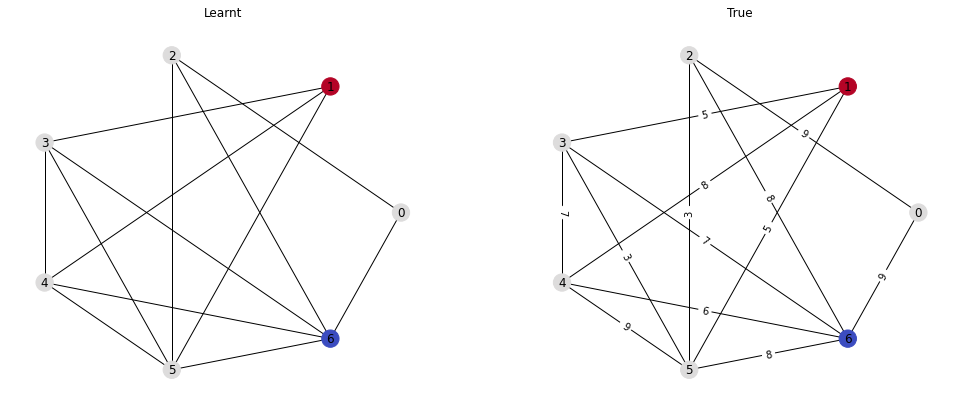

Passes: 3
tensor([2.0052, 3.0074, 1.0026, 0.0000, 3.0079, 2.0048, 1.0022],
       device='cuda:0')
tensor([2., 3., 1., 0., 3., 2., 1.], device='cuda:0')
Loss: 0.004307917319238186	Similarity: 1.0


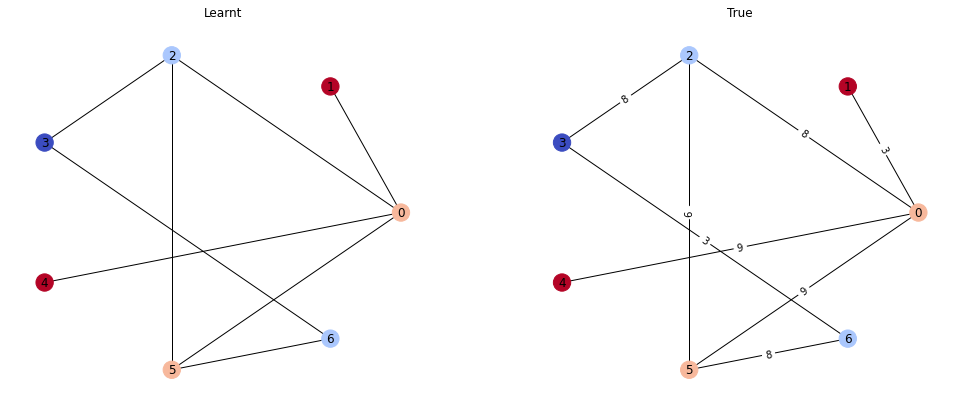

Passes: 2
tensor([1.0026, 2.0049, 2.0046, 2.0051, 1.0024, 0.0000, 2.0047],
       device='cuda:0')
tensor([1., 2., 2., 2., 1., 0., 2.], device='cuda:0')
Loss: 0.003457171842455864	Similarity: 1.0


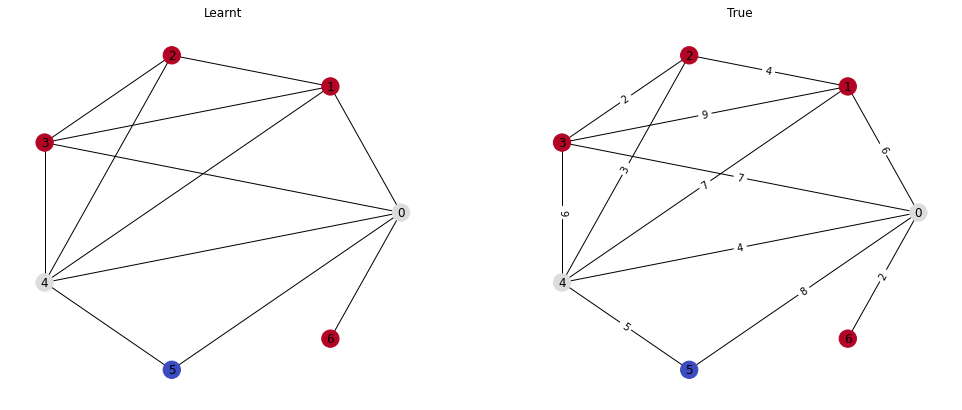

Passes: 2
tensor([2.0051, 1.0025, 1.0023, 2.0045, 2.0044, 0.0000, 2.0046],
       device='cuda:0')
tensor([2., 1., 1., 2., 2., 0., 2.], device='cuda:0')
Loss: 0.0033400061074644327	Similarity: 1.0


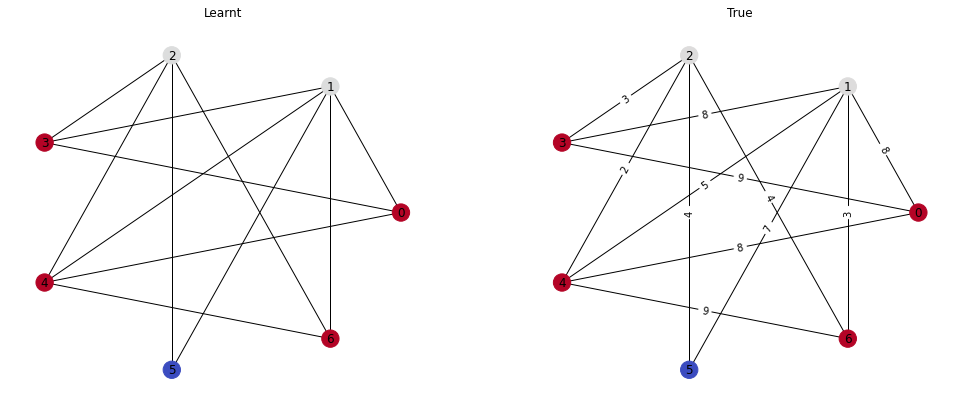

Passes: 3
tensor([3.0077, 3.0073, 3.0073, 1.0025, 2.0051, 0.0000, 1.0024],
       device='cuda:0')
tensor([3., 3., 3., 1., 2., 0., 1.], device='cuda:0')
Loss: 0.004610266070812941	Similarity: 1.0


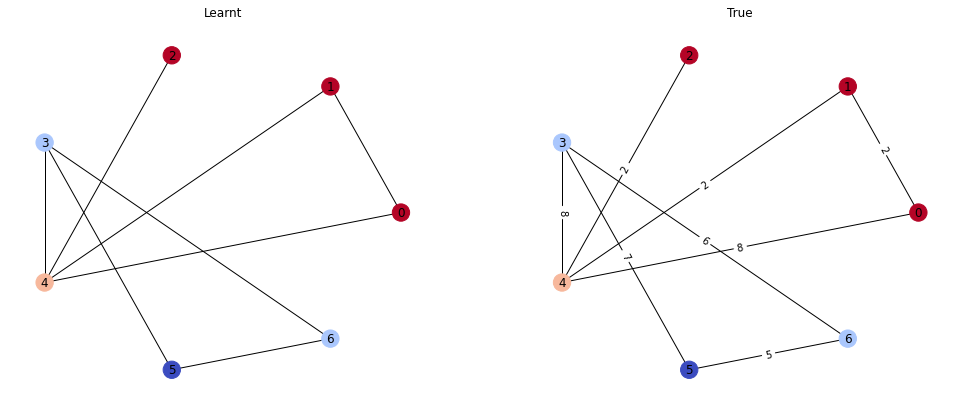

Passes: 3
tensor([1.0022, 2.0045, 3.0067, 3.0068, 2.0048, 0.0000, 2.0048],
       device='cuda:0')
tensor([1., 2., 3., 3., 2., 0., 2.], device='cuda:0')
Loss: 0.004258786328136921	Similarity: 1.0


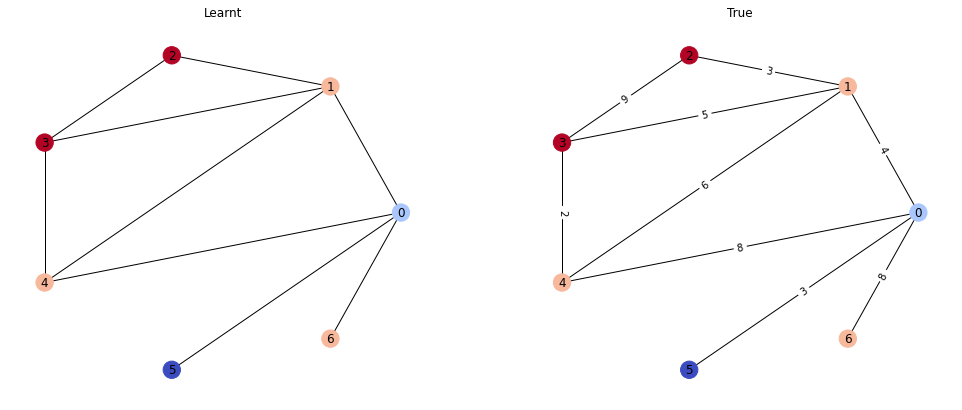

Passes: 2
tensor([1.0023, 2.0046, 1.0026, 2.0043, 0.0000, 1.0024, 1.0022],
       device='cuda:0')
tensor([1., 2., 1., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.002629825146868825	Similarity: 1.0


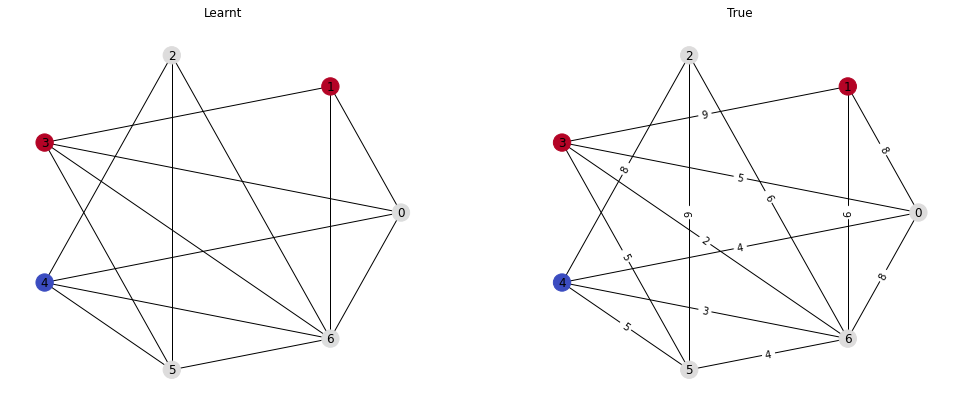

Passes: 4
tensor([4.0095, 3.0073, 1.0023, 2.0046, 2.0049, 0.0000, 2.0047],
       device='cuda:0')
tensor([4., 3., 1., 2., 2., 0., 2.], device='cuda:0')
Loss: 0.004748634062707424	Similarity: 1.0


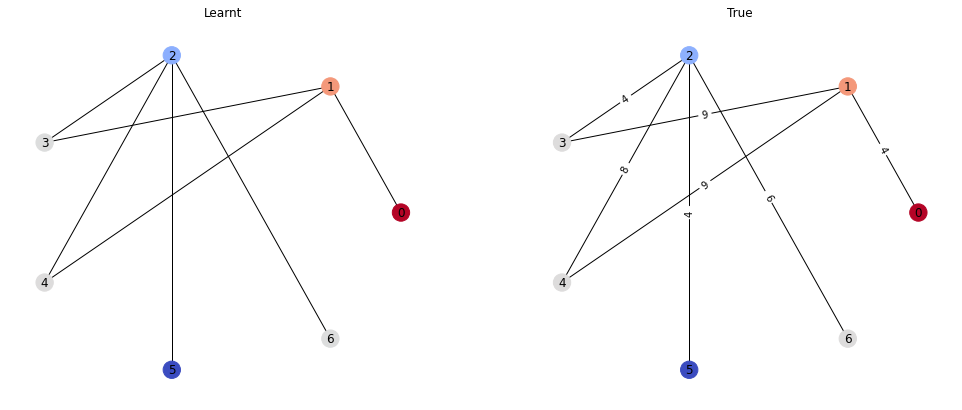

Passes: 2
tensor([2.0051, 2.0048, 1.0025, 0.0000, 1.0027, 2.0048, 1.0026],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.0032133886124938726	Similarity: 1.0


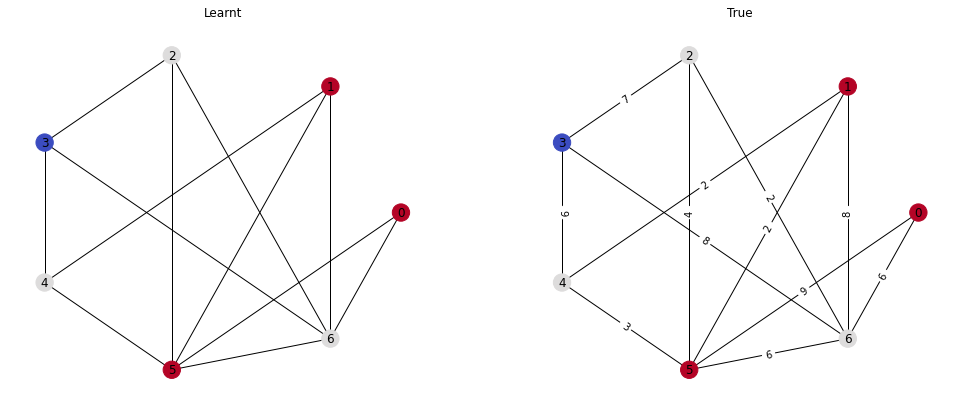

Passes: 2
tensor([2.0045, 2.0046, 1.0026, 0.0000, 1.0022, 1.0021, 1.0022],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 1., 1.], device='cuda:0')
Loss: 0.002606392139568925	Similarity: 1.0


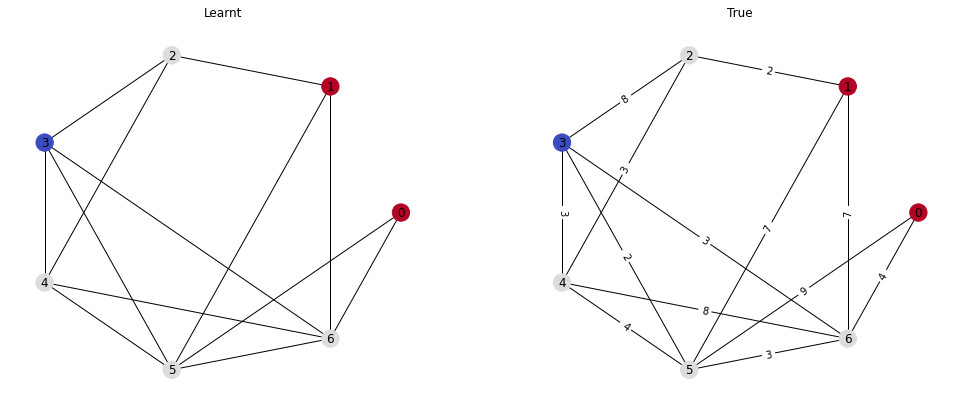

Passes: 2
tensor([1.0021, 2.0044, 2.0046, 1.0022, 2.0046, 0.0000, 1.0025],
       device='cuda:0')
tensor([1., 2., 2., 1., 2., 0., 1.], device='cuda:0')
Loss: 0.0029087578877806664	Similarity: 1.0


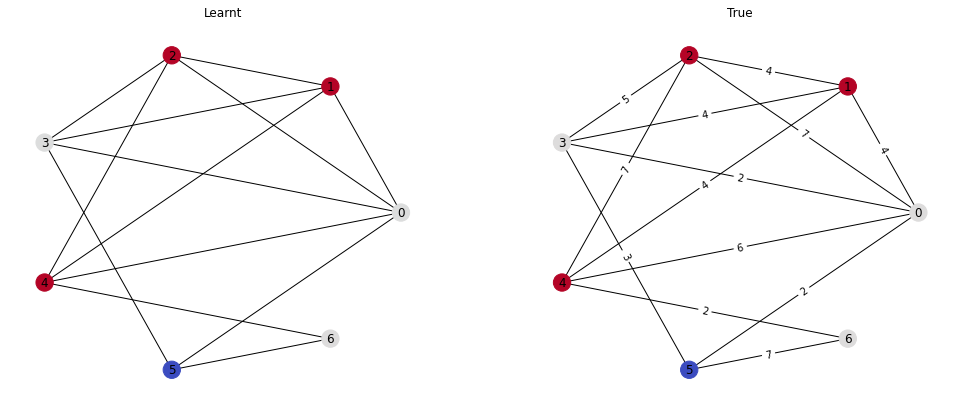

Passes: 4
tensor([4.0096, 3.0069, 2.0047, 2.0047, 1.0022, 0.0000, 2.0045],
       device='cuda:0')
tensor([4., 3., 2., 2., 1., 0., 2.], device='cuda:0')
Loss: 0.004666618071496487	Similarity: 1.0


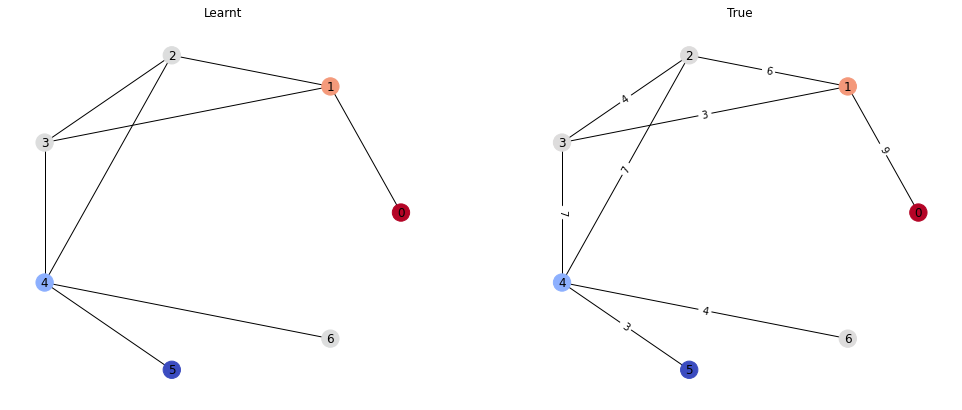

Passes: 2
tensor([1.0025, 2.0052, 2.0047, 1.0025, 2.0052, 1.0026, 0.0000],
       device='cuda:0')
tensor([1., 2., 2., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.00326025509275496	Similarity: 1.0


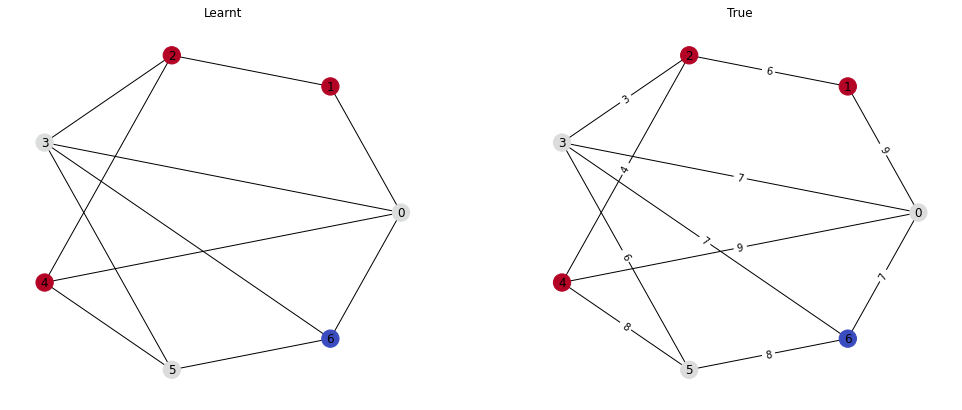

Passes: 4
tensor([3.0068, 2.0046, 1.0024, 4.0092, 4.0092, 0.0000, 2.0051],
       device='cuda:0')
tensor([3., 2., 1., 4., 4., 0., 2.], device='cuda:0')
Loss: 0.005341649521142244	Similarity: 1.0


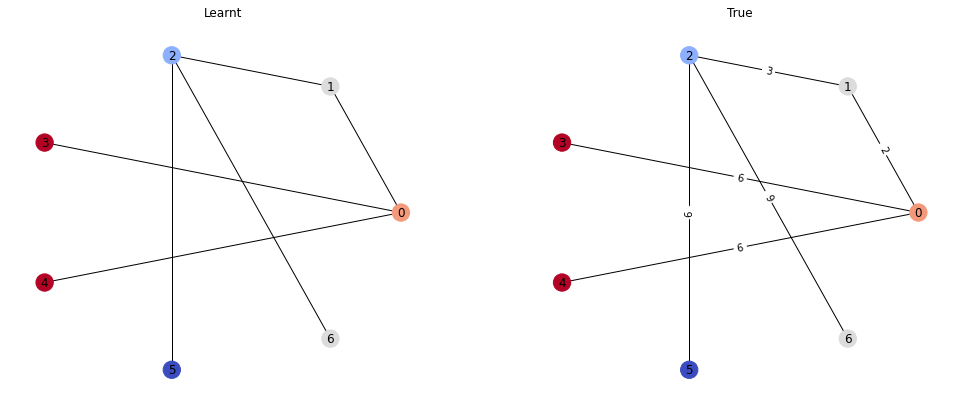

Passes: 2
tensor([2.0046, 1.0021, 0.0000, 1.0021, 2.0044, 2.0046, 2.0047],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 2., 2.], device='cuda:0')
Loss: 0.0032228403724730015	Similarity: 1.0


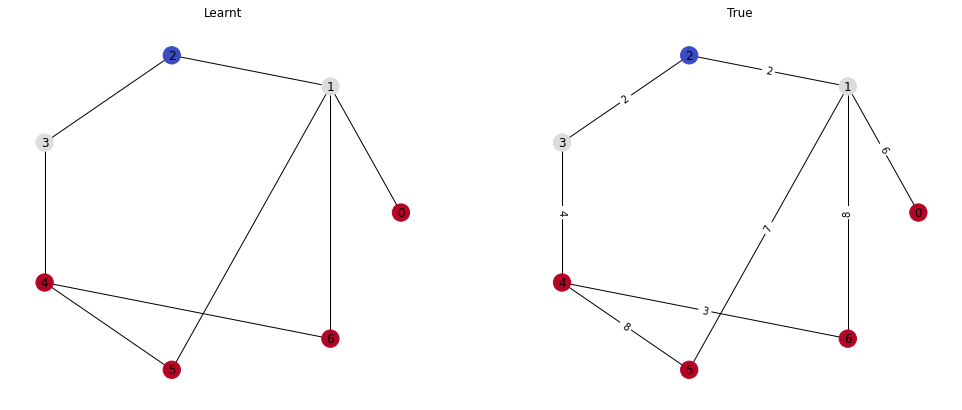

Passes: 1
tensor([1.0023, 1.0021, 1.0022, 1.0025, 1.0024, 0.0000], device='cuda:0')
tensor([1., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.0019278328400105238	Similarity: 1.0


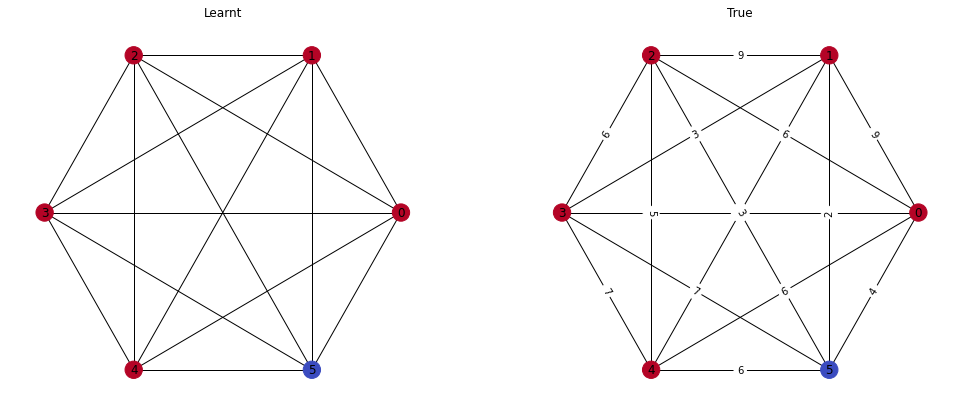

Passes: 2
tensor([2.0046, 0.0000, 1.0023, 1.0027, 1.0023, 1.0027, 1.0024],
       device='cuda:0')
tensor([2., 0., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.002409475389868021	Similarity: 1.0


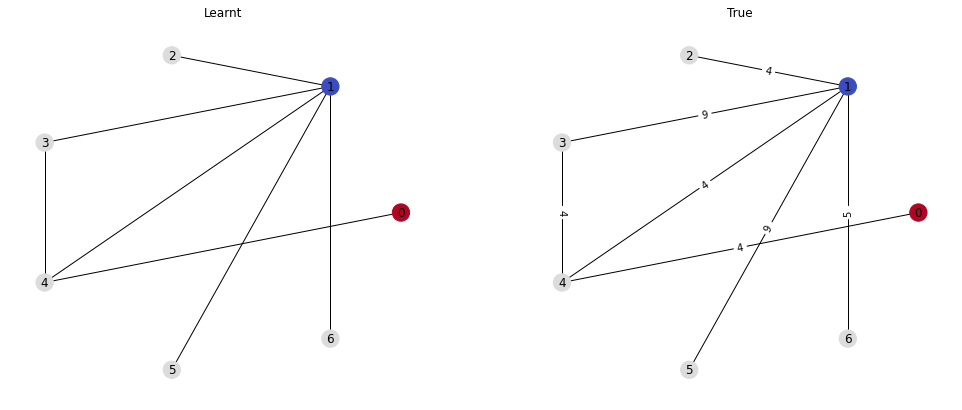

Passes: 3
tensor([1.0026, 0.0000, 3.0071, 2.0049, 2.0048, 1.0025, 1.0027],
       device='cuda:0')
tensor([1., 0., 3., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.003515737596899271	Similarity: 1.0


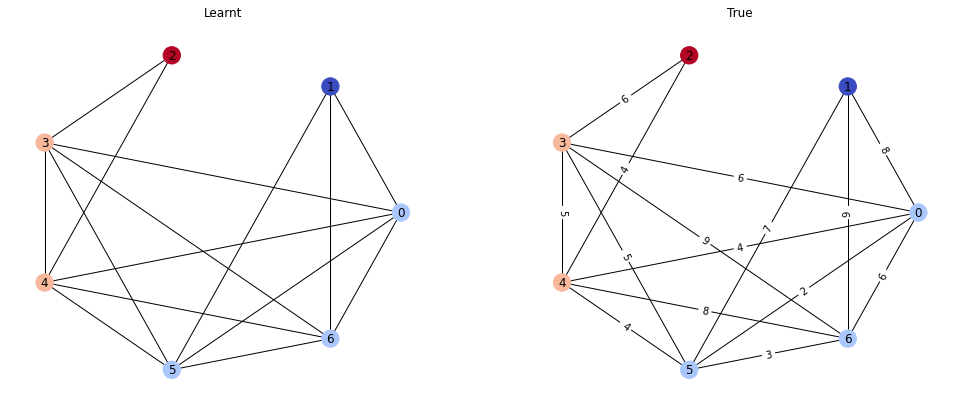

Passes: 2
tensor([2.0043, 1.0021, 1.0023, 1.0022, 0.0000, 2.0043, 1.0021],
       device='cuda:0')
tensor([2., 1., 1., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.0024775096680969	Similarity: 1.0


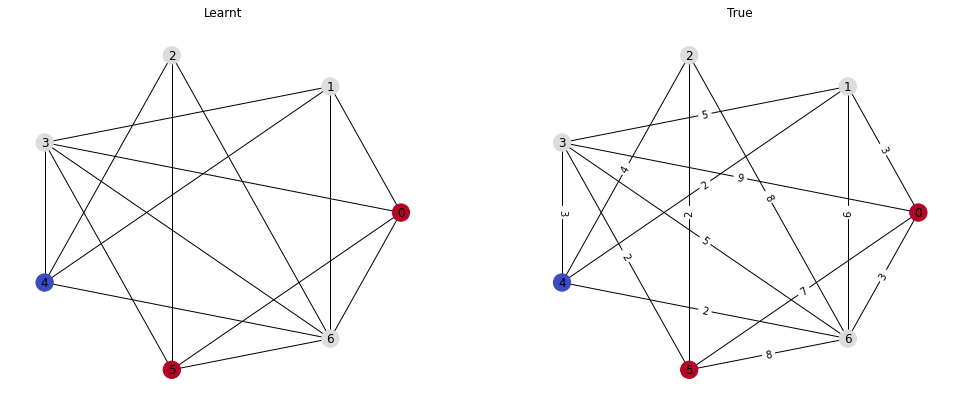

Passes: 2
tensor([1.0026, 1.0026, 0.0000, 1.0026, 2.0050, 2.0048], device='cuda:0')
tensor([1., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.0029340784531086683	Similarity: 1.0


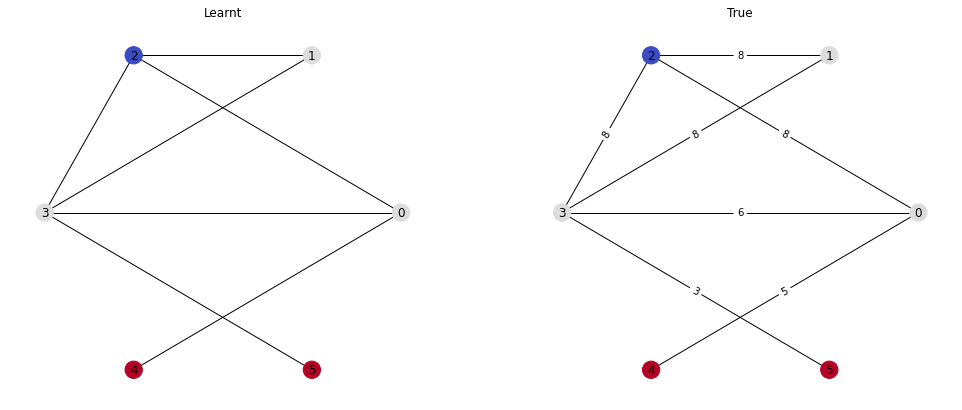

Passes: 1
tensor([1.0022, 1.0024, 1.0024, 0.0000], device='cuda:0')
tensor([1., 1., 1., 0.], device='cuda:0')
Loss: 0.0017514526844024658	Similarity: 1.0


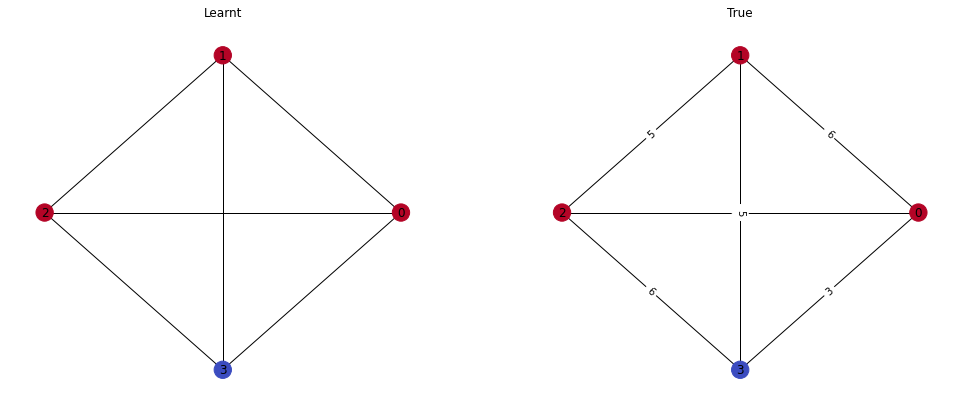

Passes: 2
tensor([1.0024, 2.0046, 0.0000, 1.0025, 1.0026, 2.0047, 1.0024],
       device='cuda:0')
tensor([1., 2., 0., 1., 1., 2., 1.], device='cuda:0')
Loss: 0.002746990881860256	Similarity: 1.0


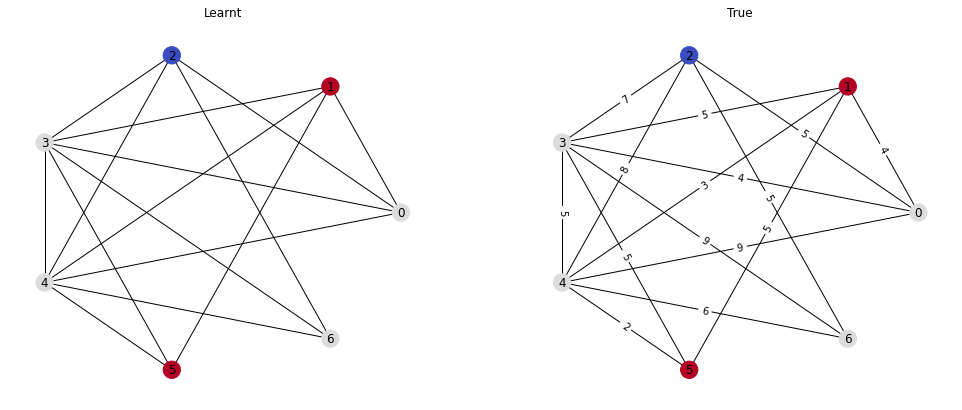

Passes: 3
tensor([2.0051, 1.0024, 0.0000, 1.0022, 2.0050, 3.0077, 3.0073],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 3., 3.], device='cuda:0')
Loss: 0.004237617831677198	Similarity: 1.0


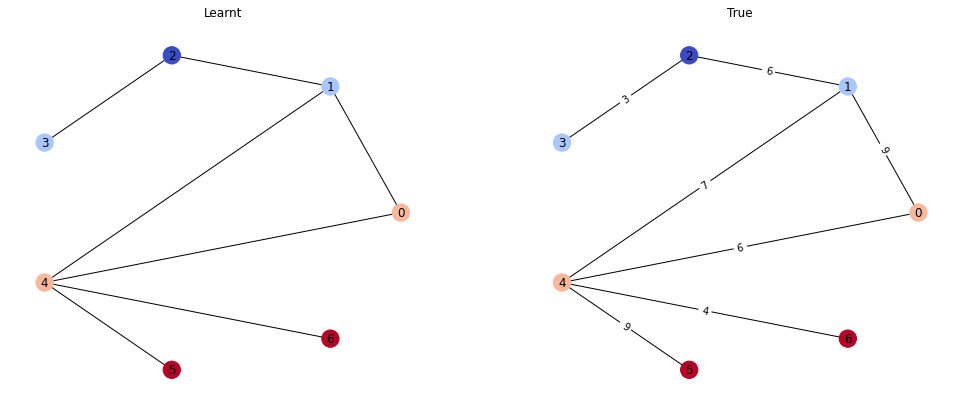

Passes: 2
tensor([1.0024, 2.0046, 1.0027, 2.0048, 1.0025, 0.0000, 2.0049],
       device='cuda:0')
tensor([1., 2., 1., 2., 1., 0., 2.], device='cuda:0')
Loss: 0.003143089357763529	Similarity: 1.0


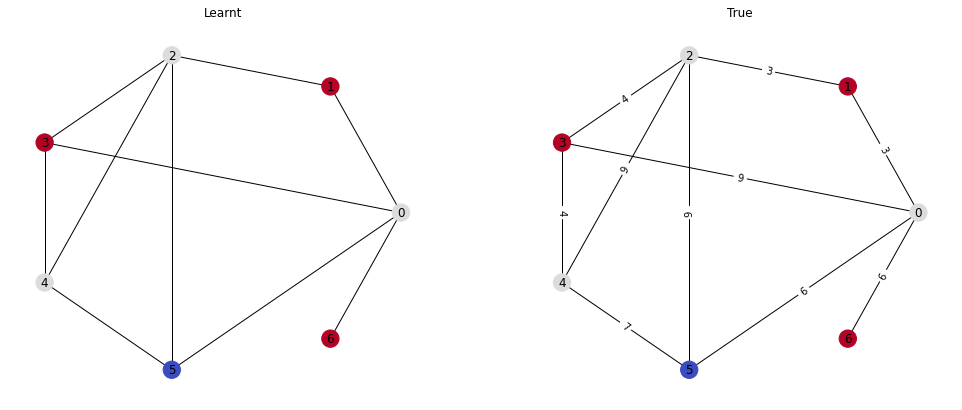

Passes: 3
tensor([2.0050, 2.0047, 2.0047, 3.0068, 1.0024, 0.0000], device='cuda:0')
tensor([2., 2., 2., 3., 1., 0.], device='cuda:0')
Loss: 0.0039513311348855495	Similarity: 1.0


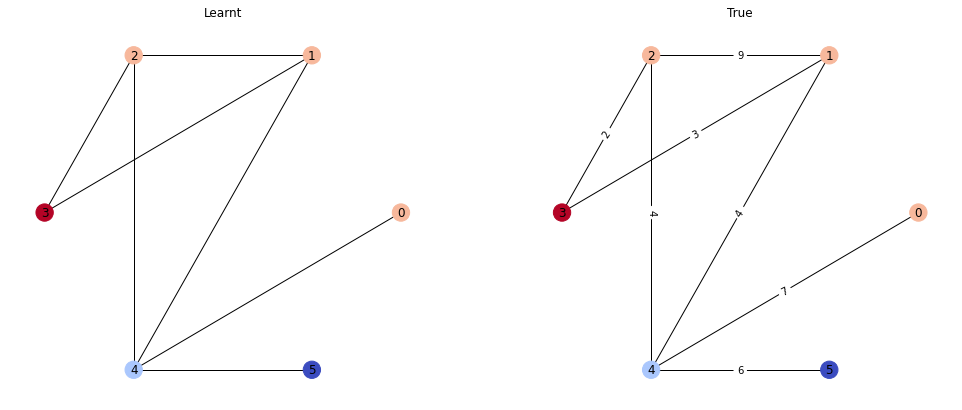

Passes: 2
tensor([1.0023, 1.0022, 2.0043, 1.0027, 0.0000, 1.0022, 1.0023],
       device='cuda:0')
tensor([1., 1., 2., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.002280592918395996	Similarity: 1.0


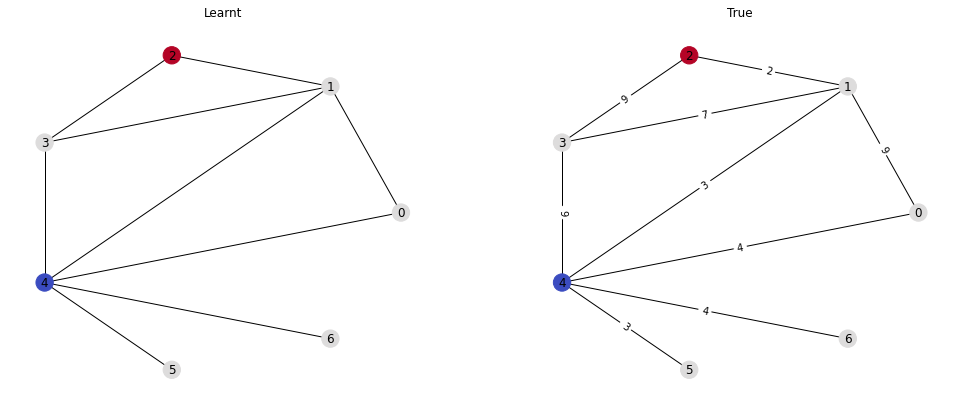

Passes: 3
tensor([1.0024, 2.0049, 2.0046, 3.0072, 0.0000, 2.0051, 3.0070],
       device='cuda:0')
tensor([1., 2., 2., 3., 0., 2., 3.], device='cuda:0')
Loss: 0.004457967821508646	Similarity: 1.0


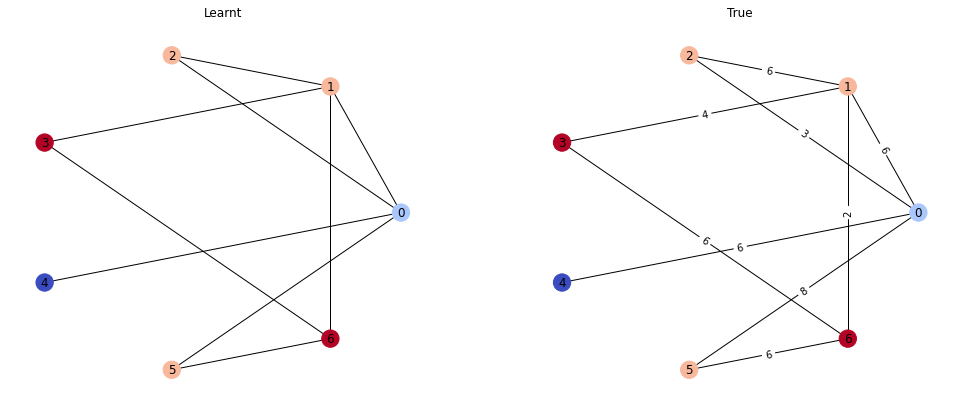

Passes: 4
tensor([4.0089, 2.0043, 1.0021, 3.0067, 3.0070, 0.0000, 2.0047],
       device='cuda:0')
tensor([4., 2., 1., 3., 3., 0., 2.], device='cuda:0')
Loss: 0.004816651344299316	Similarity: 1.0


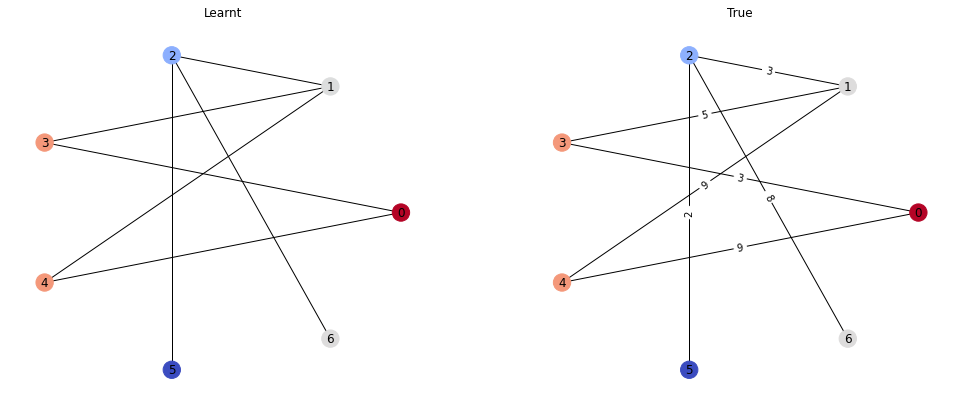

Passes: 2
tensor([2.0052, 2.0051, 1.0027, 0.0000, 2.0046, 1.0025, 2.0051],
       device='cuda:0')
tensor([2., 2., 1., 0., 2., 1., 2.], device='cuda:0')
Loss: 0.0035977705847471952	Similarity: 1.0


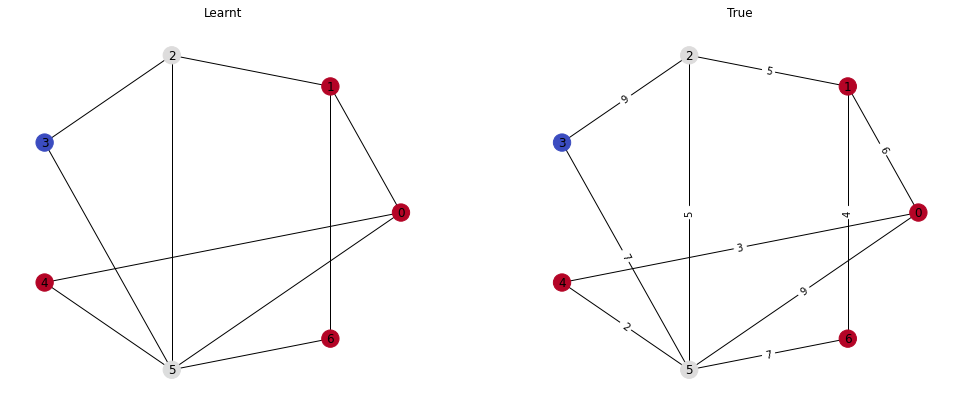

Passes: 3
tensor([0.0000, 2.0048, 2.0046, 3.0068, 1.0022, 1.0027, 2.0046],
       device='cuda:0')
tensor([0., 2., 2., 3., 1., 1., 2.], device='cuda:0')
Loss: 0.003665788099169731	Similarity: 1.0


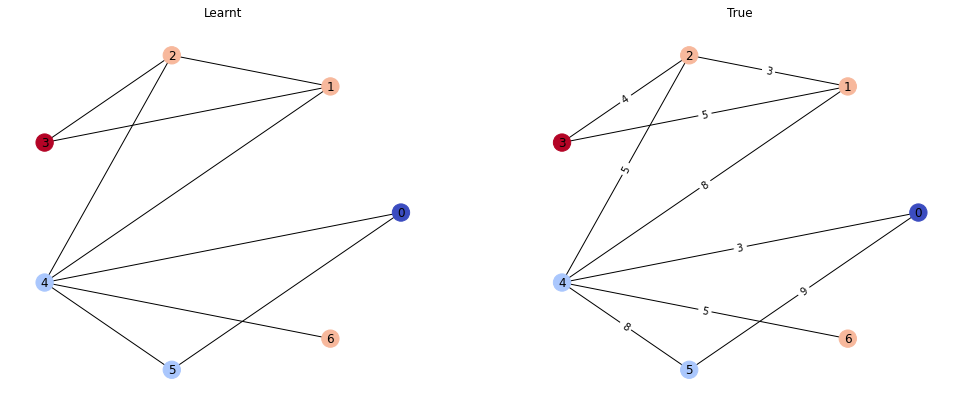

Passes: 2
tensor([1.0025, 1.0021, 0.0000, 1.0026, 1.0021, 2.0046, 2.0049],
       device='cuda:0')
tensor([1., 1., 0., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


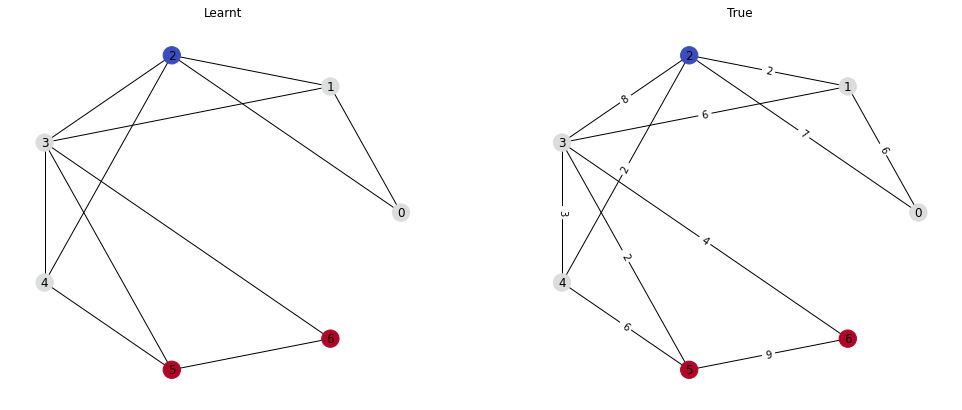

Passes: 2
tensor([1.0021, 1.0025, 1.0024, 1.0027, 2.0043, 0.0000, 1.0025],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 0., 1.], device='cuda:0')
Loss: 0.0023626089096069336	Similarity: 1.0


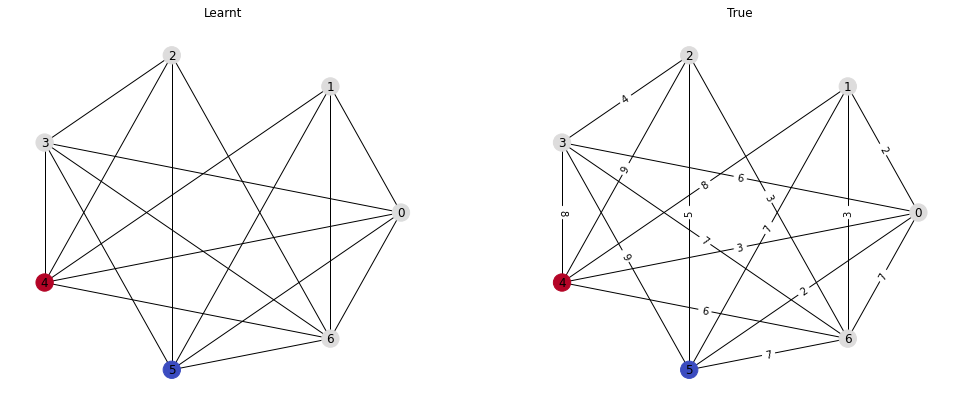

Passes: 3
tensor([2.0046, 2.0047, 3.0067, 1.0024, 1.0024, 0.0000, 2.0046],
       device='cuda:0')
tensor([2., 2., 3., 1., 1., 0., 2.], device='cuda:0')
Loss: 0.0036072051152586937	Similarity: 1.0


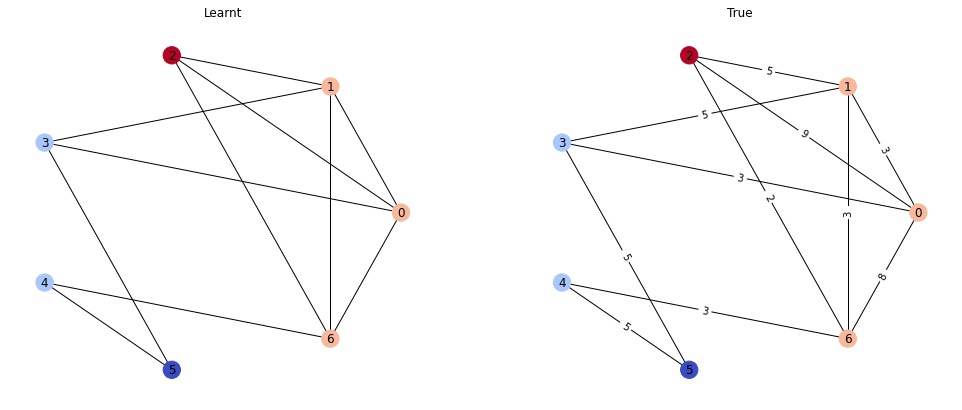

Passes: 2
tensor([2.0048, 2.0046, 1.0023, 0.0000, 1.0023, 1.0022, 1.0026],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 1., 1.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


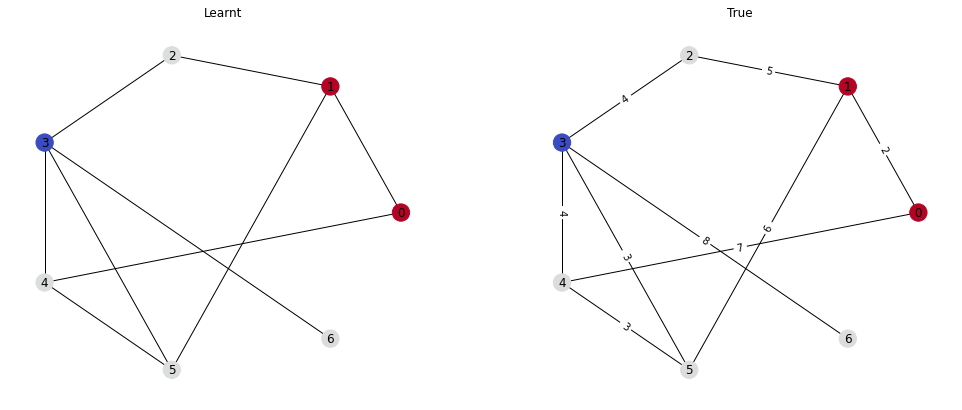

Passes: 3
tensor([1.0027, 0.0000, 1.0024, 2.0046, 2.0053, 2.0046, 3.0077],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 2., 3.], device='cuda:0')
Loss: 0.00390011933632195	Similarity: 1.0


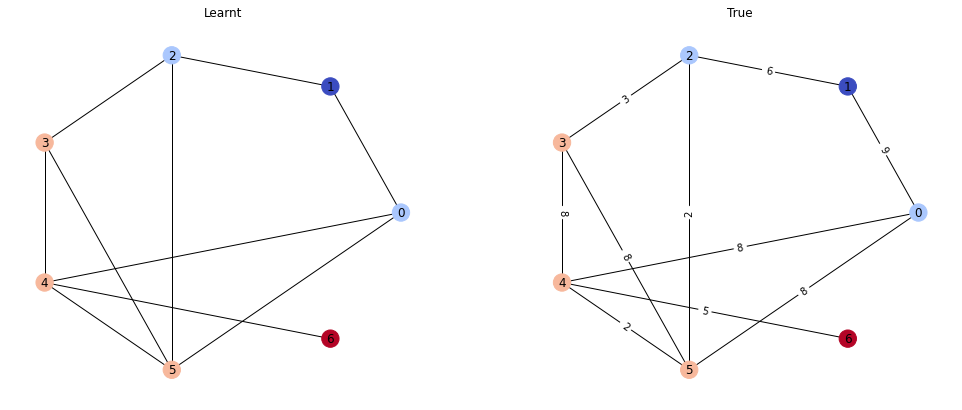

Passes: 2
tensor([1.0024, 0.0000, 2.0047, 1.0026, 2.0048, 1.0024, 1.0024],
       device='cuda:0')
tensor([1., 0., 2., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.0027704241219908	Similarity: 1.0


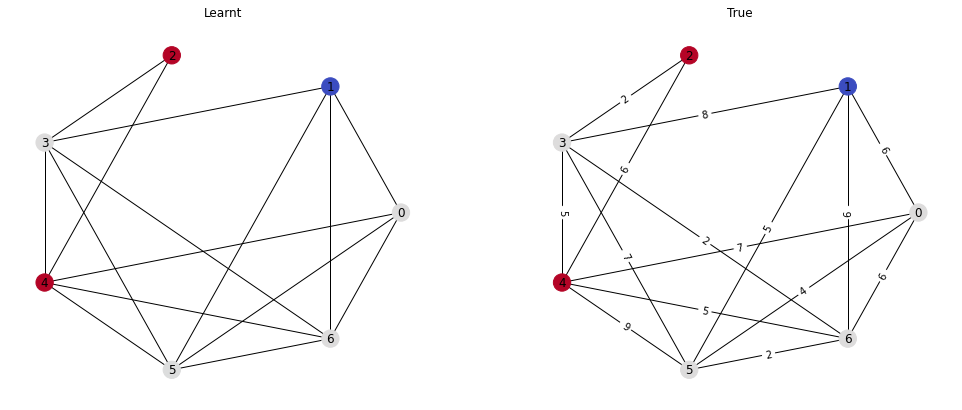

Passes: 3
tensor([2.0049, 3.0076, 2.0049, 1.0026, 3.0075, 1.0026, 0.0000],
       device='cuda:0')
tensor([2., 3., 2., 1., 3., 1., 0.], device='cuda:0')
Loss: 0.004296200815588236	Similarity: 1.0


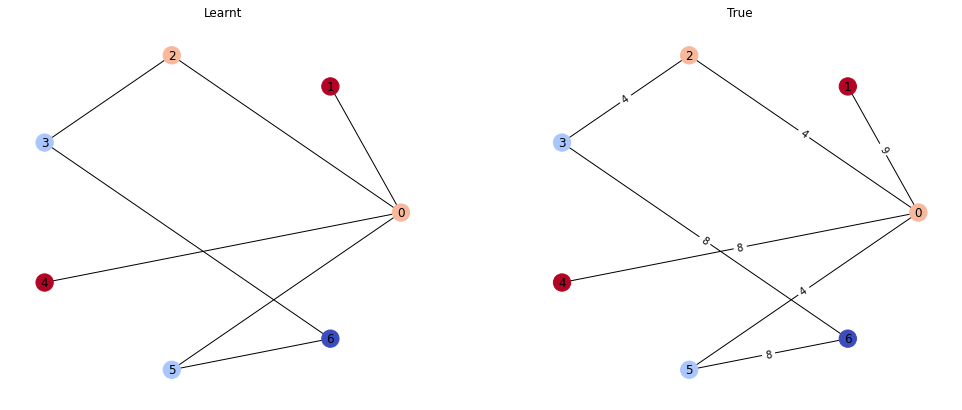

Passes: 2
tensor([2.0048, 2.0050, 0.0000, 1.0023], device='cuda:0')
tensor([2., 2., 0., 1.], device='cuda:0')
Loss: 0.00301477313041687	Similarity: 1.0


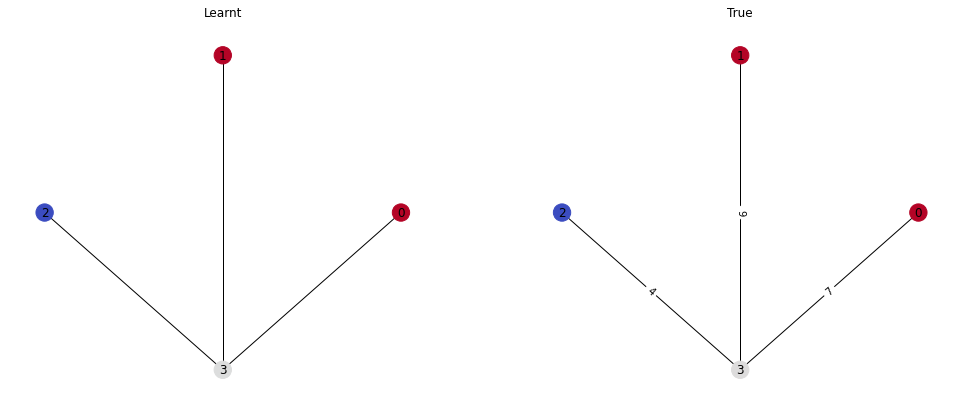

Passes: 2
tensor([2.0043, 1.0021, 1.0023, 1.0024, 0.0000, 2.0043, 1.0025],
       device='cuda:0')
tensor([2., 1., 1., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.002571242395788431	Similarity: 1.0


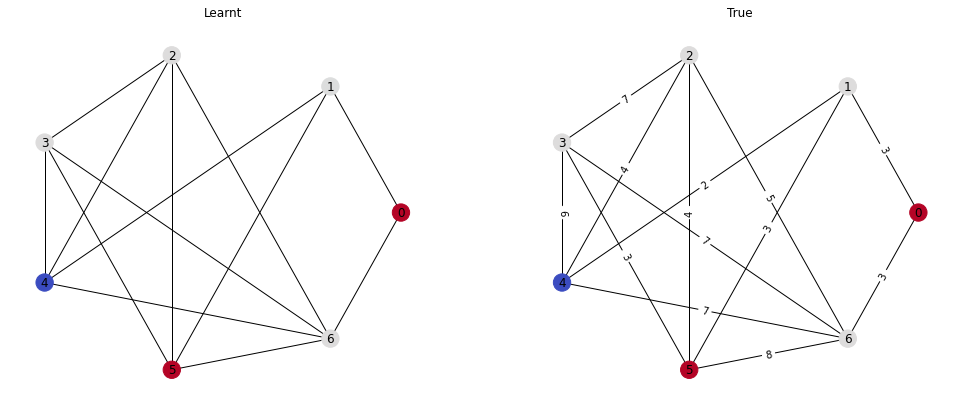

Passes: 4
tensor([3.0069, 0.0000, 2.0048, 1.0025, 2.0046, 4.0093], device='cuda:0')
tensor([3., 0., 2., 1., 2., 4.], device='cuda:0')
Loss: 0.004697859287261963	Similarity: 1.0


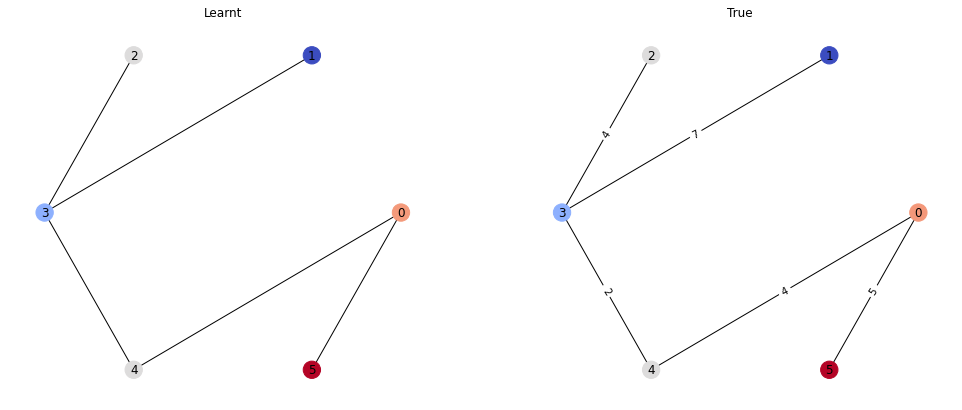

Passes: 1
tensor([1.0024, 1.0023, 1.0024, 1.0023, 1.0024, 1.0026, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.002071959665045142	Similarity: 1.0


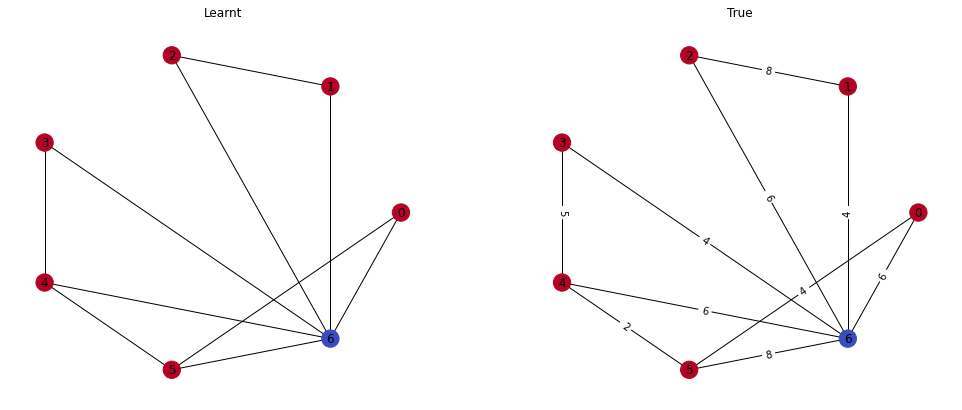

Passes: 3
tensor([2.0046, 0.0000, 2.0046, 1.0024, 1.0024, 2.0048, 3.0072],
       device='cuda:0')
tensor([2., 0., 2., 1., 1., 2., 3.], device='cuda:0')
Loss: 0.003689221106469631	Similarity: 1.0


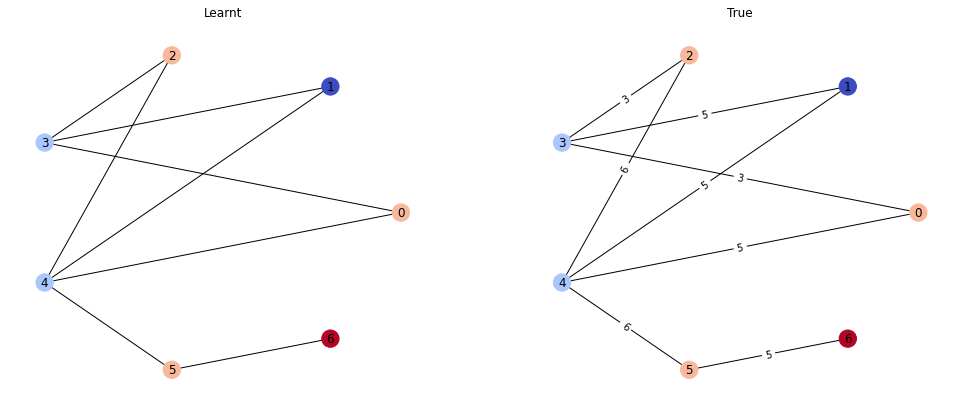

Passes: 3
tensor([0.0000, 1.0024, 2.0049, 3.0070, 2.0051, 1.0025, 3.0078],
       device='cuda:0')
tensor([0., 1., 2., 3., 2., 1., 3.], device='cuda:0')
Loss: 0.004261051304638386	Similarity: 1.0


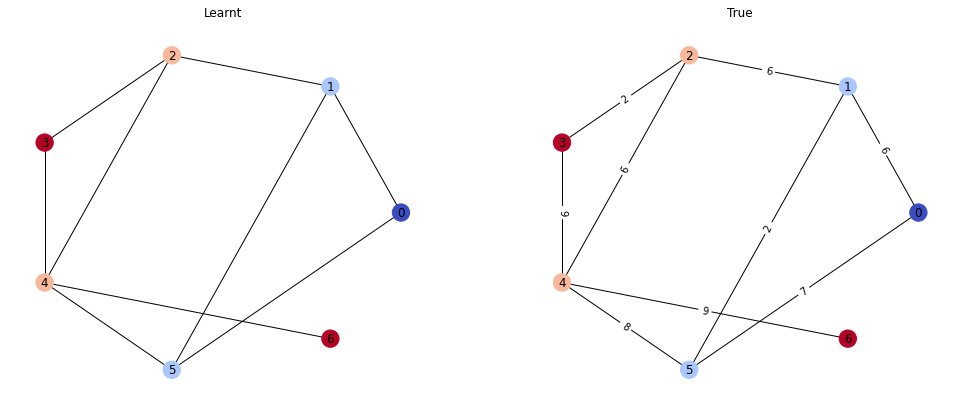

Passes: 3
tensor([1.0025, 1.0021, 0.0000, 1.0021, 1.0023, 3.0070, 2.0043],
       device='cuda:0')
tensor([1., 1., 0., 1., 1., 3., 2.], device='cuda:0')
Loss: 0.0029087408911436796	Similarity: 1.0


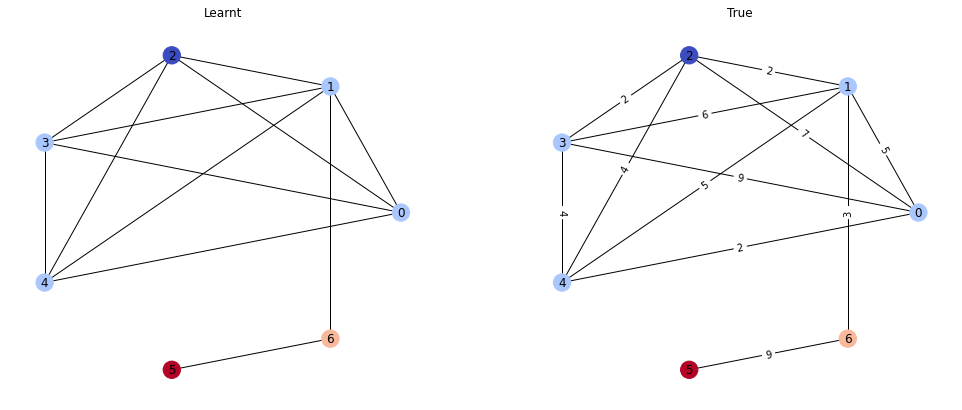

Passes: 2
tensor([1.0024, 1.0023, 1.0026, 2.0046, 0.0000, 1.0027, 1.0023],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.0023977586533874273	Similarity: 1.0


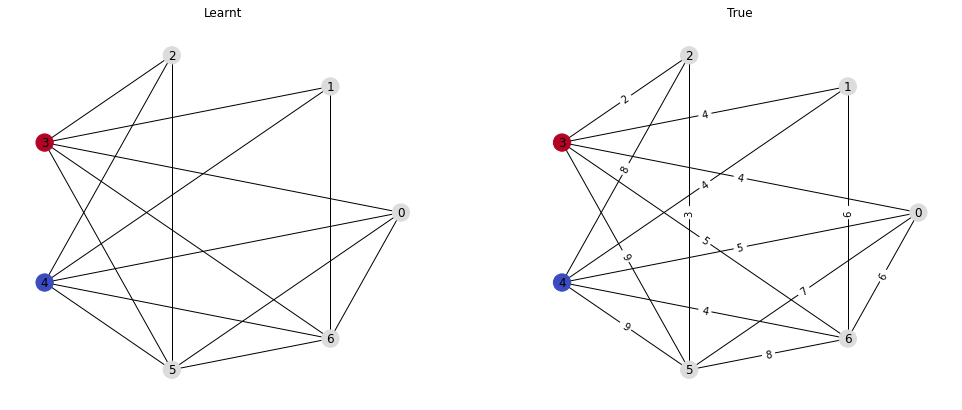

Passes: 2
tensor([0.0000, 1.0027, 2.0048, 2.0048, 2.0045, 2.0047, 1.0021],
       device='cuda:0')
tensor([0., 1., 2., 2., 2., 2., 1.], device='cuda:0')
Loss: 0.0033751558512449265	Similarity: 1.0


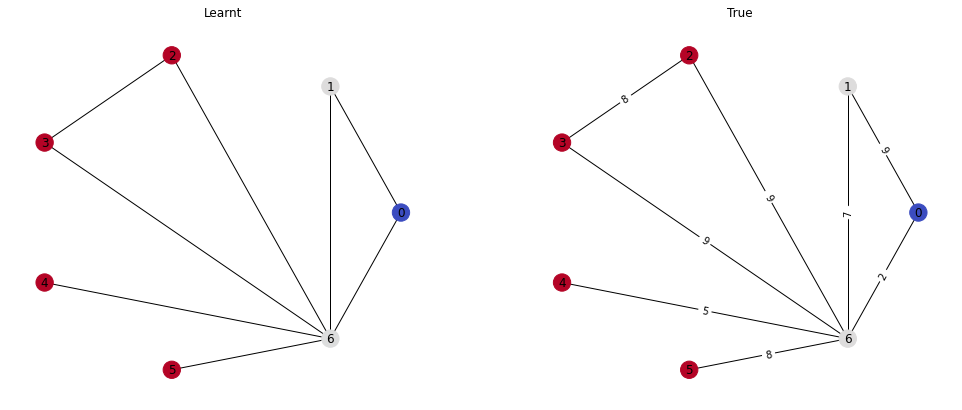

Passes: 3
tensor([0.0000, 1.0024, 2.0050, 3.0074, 3.0076, 2.0051, 1.0026],
       device='cuda:0')
tensor([0., 1., 2., 3., 3., 2., 1.], device='cuda:0')
Loss: 0.004307917319238186	Similarity: 1.0


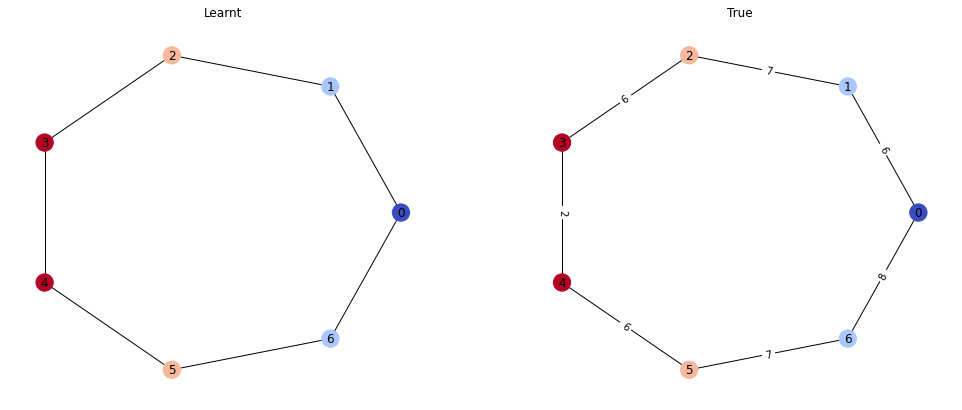

Passes: 3
tensor([0.0000, 1.0027, 2.0051, 3.0068, 2.0042, 1.0021, 1.0024],
       device='cuda:0')
tensor([0., 1., 2., 3., 2., 1., 1.], device='cuda:0')
Loss: 0.0033282723743468523	Similarity: 1.0


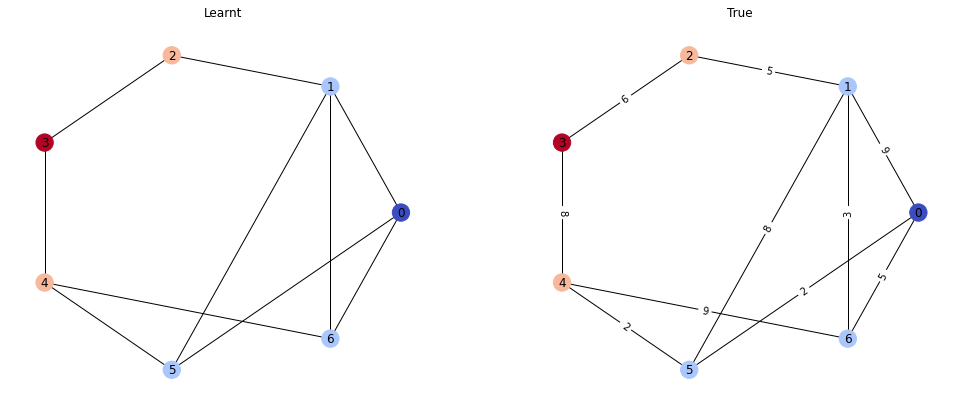

Passes: 2
tensor([1.0025, 0.0000, 1.0023, 2.0047, 2.0046, 1.0021, 2.0051],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 1., 2.], device='cuda:0')
Loss: 0.0030493566300719976	Similarity: 1.0


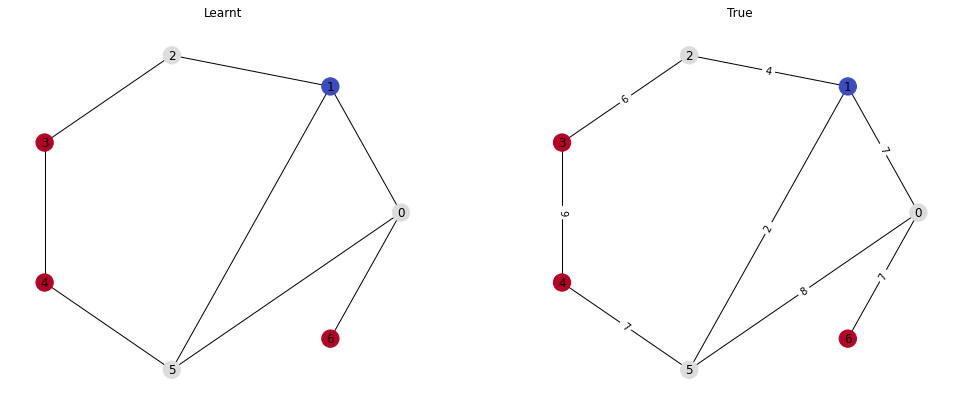

Passes: 2
tensor([1.0027, 2.0053, 2.0051, 2.0051, 2.0048, 2.0051, 0.0000],
       device='cuda:0')
tensor([1., 2., 2., 2., 2., 2., 0.], device='cuda:0')
Loss: 0.004029018804430962	Similarity: 1.0


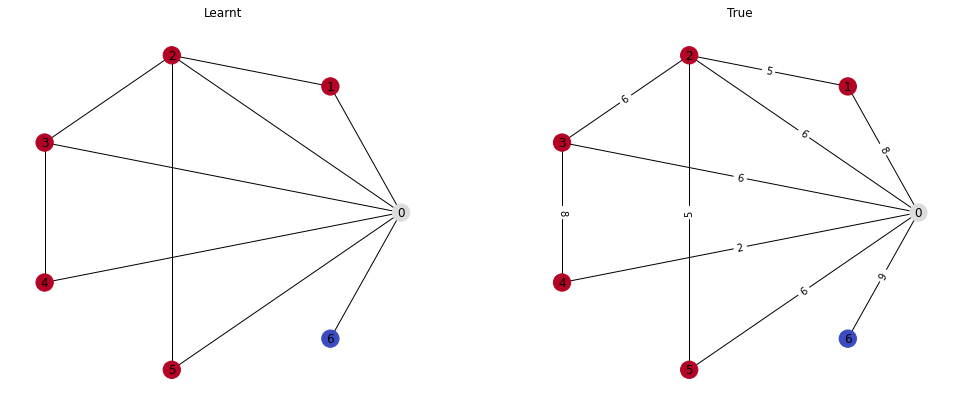

Passes: 2
tensor([2.0051, 2.0050, 2.0050, 2.0050, 1.0027, 0.0000, 1.0025],
       device='cuda:0')
tensor([2., 2., 2., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.0036094870883971453	Similarity: 1.0


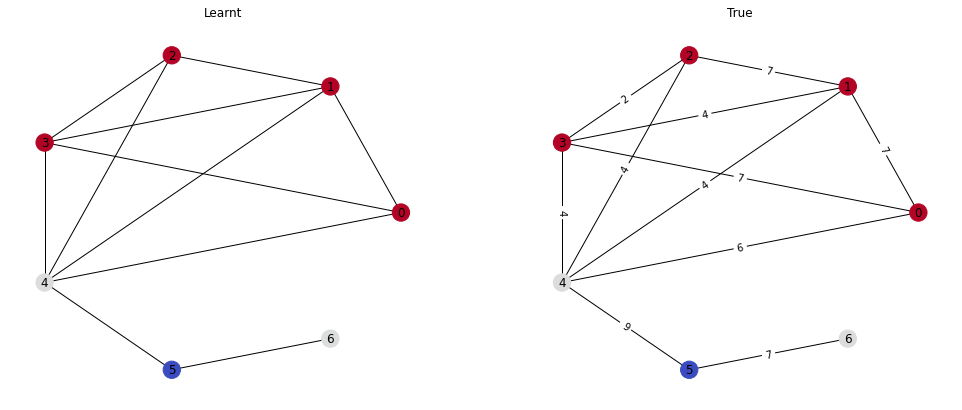

Passes: 2
tensor([1.0023, 2.0045, 1.0024, 2.0051, 2.0049, 0.0000, 2.0046],
       device='cuda:0')
tensor([1., 2., 1., 2., 2., 0., 2.], device='cuda:0')
Loss: 0.0033751558512449265	Similarity: 1.0


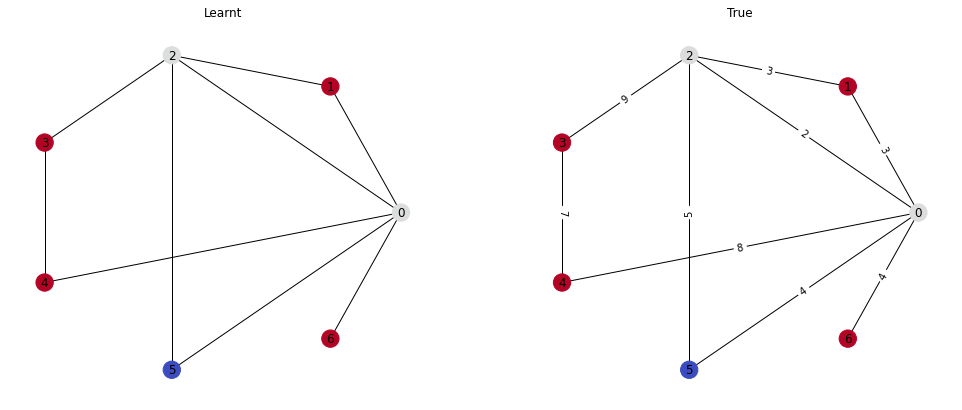

Passes: 4
tensor([2.0044, 1.0021, 2.0045, 2.0046, 0.0000, 3.0070, 3.1614],
       device='cuda:0')
tensor([2., 1., 2., 2., 0., 3., 4.], device='cuda:0')
Loss: 0.12302268296480179	Similarity: 0.8571428571428571


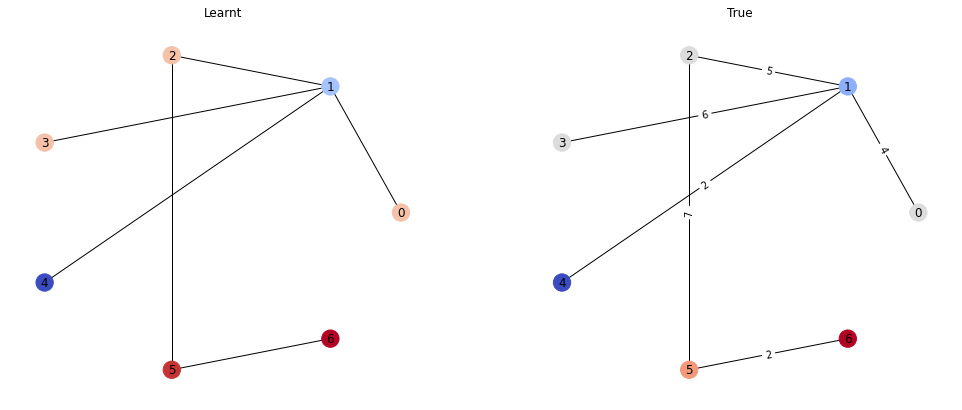

Passes: 3
tensor([0.0000, 1.0026, 2.0048, 3.0073, 2.0049, 1.0027, 2.0053],
       device='cuda:0')
tensor([0., 1., 2., 3., 2., 1., 2.], device='cuda:0')
Loss: 0.003935269080102444	Similarity: 1.0


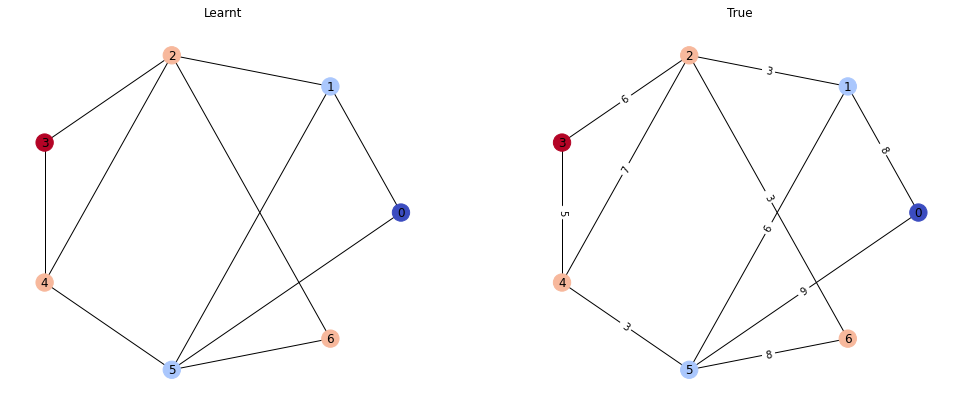

Passes: 2
tensor([0.0000, 2.0045, 2.0042, 1.0021], device='cuda:0')
tensor([0., 2., 2., 1.], device='cuda:0')
Loss: 0.0027072131633758545	Similarity: 1.0


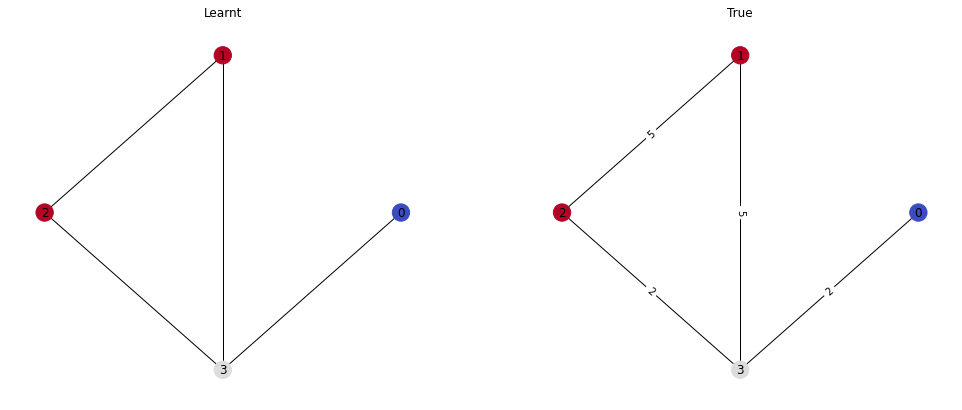

Passes: 1
tensor([1.0025, 1.0027, 0.0000, 1.0024, 1.0025, 1.0025], device='cuda:0')
tensor([1., 1., 0., 1., 1., 1.], device='cuda:0')
Loss: 0.002105534076690674	Similarity: 1.0


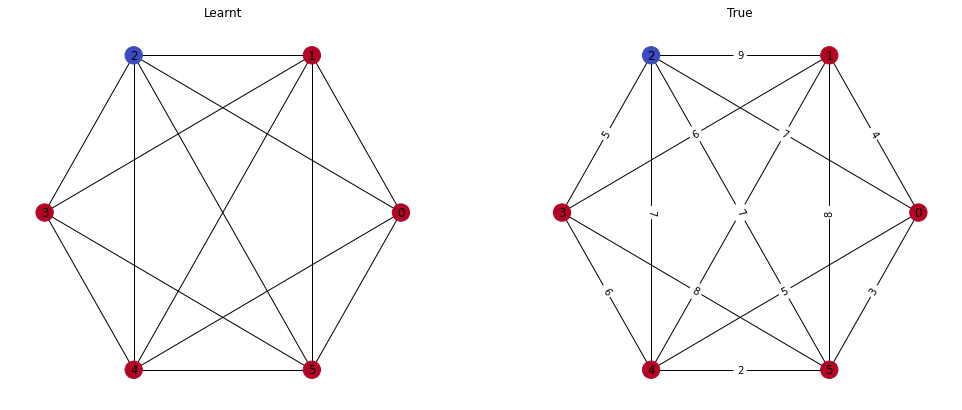

Passes: 2
tensor([1.0024, 1.0024, 1.0026, 2.0046, 0.0000, 1.0021, 2.0048],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 1., 2.], device='cuda:0')
Loss: 0.0027001246344298124	Similarity: 1.0


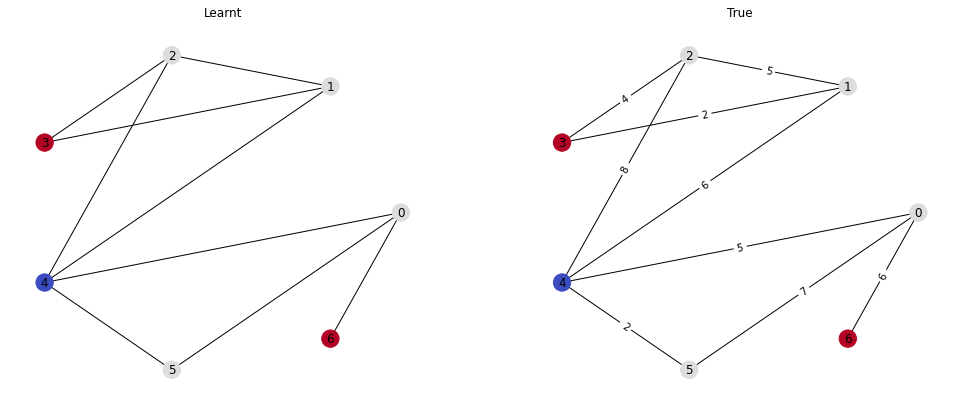

Passes: 2
tensor([2.0047, 2.0048, 0.0000, 2.0046, 1.0025, 1.0025, 1.0026],
       device='cuda:0')
tensor([2., 2., 0., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.003119656117632985	Similarity: 1.0


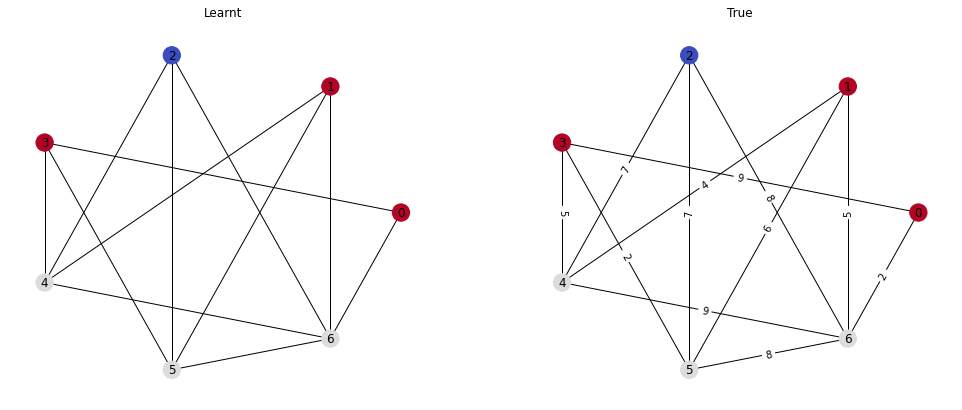

Passes: 2
tensor([2.0047, 2.0046, 1.0024, 0.0000, 1.0026, 1.0024, 2.0053],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 1., 2.], device='cuda:0')
Loss: 0.003154805861413479	Similarity: 1.0


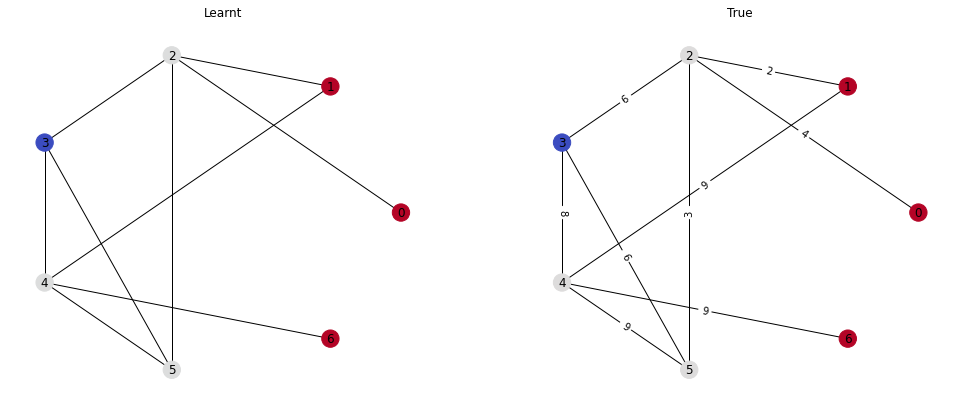

Passes: 4
tensor([4.0095, 2.0048, 3.0070, 1.0026, 3.0073, 0.0000], device='cuda:0')
tensor([4., 2., 3., 1., 3., 0.], device='cuda:0')
Loss: 0.0052146315574646	Similarity: 1.0


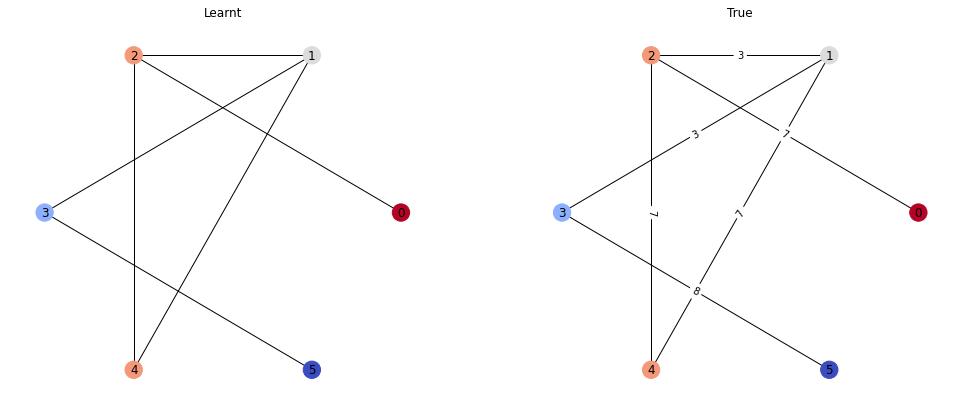

Passes: 3
tensor([2.0046, 1.0022, 2.0047, 1.0022, 0.0000, 3.0073, 3.0070],
       device='cuda:0')
tensor([2., 1., 2., 1., 0., 3., 3.], device='cuda:0')
Loss: 0.004015003331005573	Similarity: 1.0


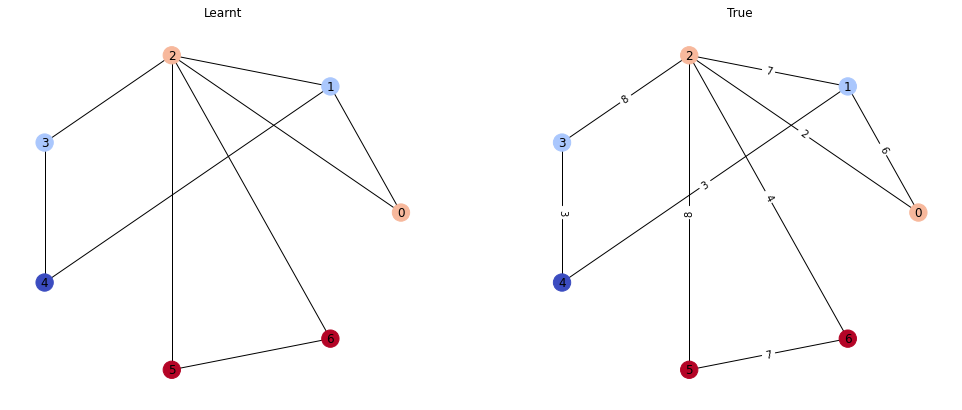

Passes: 3
tensor([3.0066, 2.0044, 1.0021, 0.0000, 2.0048, 2.0046, 2.0042],
       device='cuda:0')
tensor([3., 2., 1., 0., 2., 2., 2.], device='cuda:0')
Loss: 0.0038275551050901413	Similarity: 1.0


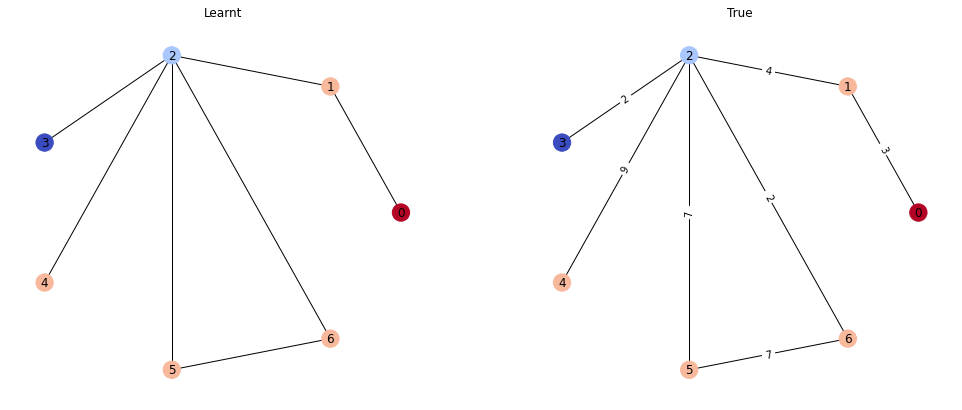

Passes: 2
tensor([1.0022, 2.0045, 1.0022, 1.0022, 1.0022, 0.0000, 2.0044],
       device='cuda:0')
tensor([1., 2., 1., 1., 1., 0., 2.], device='cuda:0')
Loss: 0.0025243759155273438	Similarity: 1.0


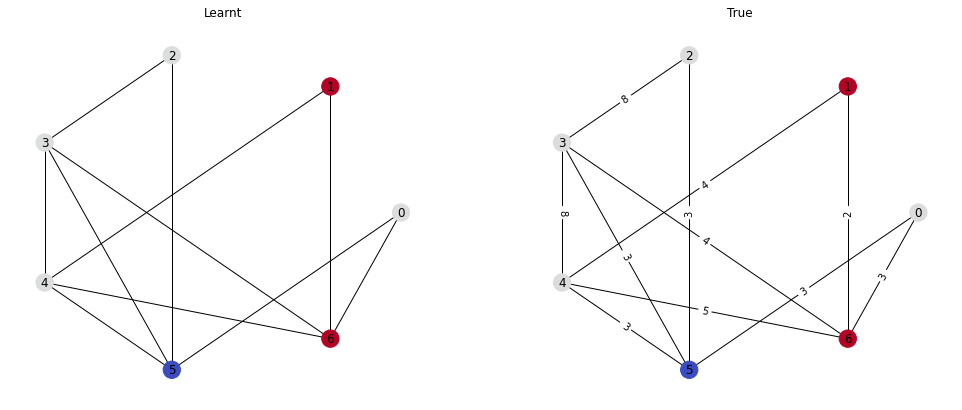

Passes: 3
tensor([3.0073, 0.0000, 1.0027, 2.0054, 2.0049, 2.0050, 1.0027],
       device='cuda:0')
tensor([3., 0., 1., 2., 2., 2., 1.], device='cuda:0')
Loss: 0.003993852064013481	Similarity: 1.0


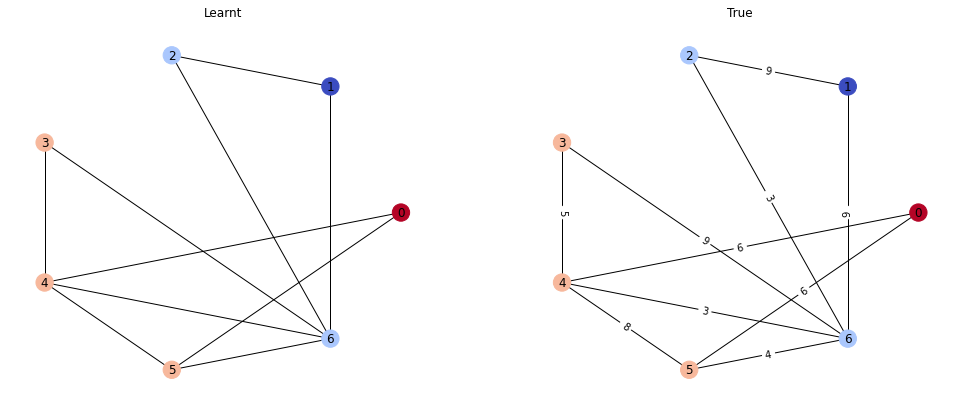

Passes: 2
tensor([1.0027, 0.0000, 1.0025, 1.0025, 1.0027, 2.0049, 1.0021],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 2., 1.], device='cuda:0')
Loss: 0.0024914913810789585	Similarity: 1.0


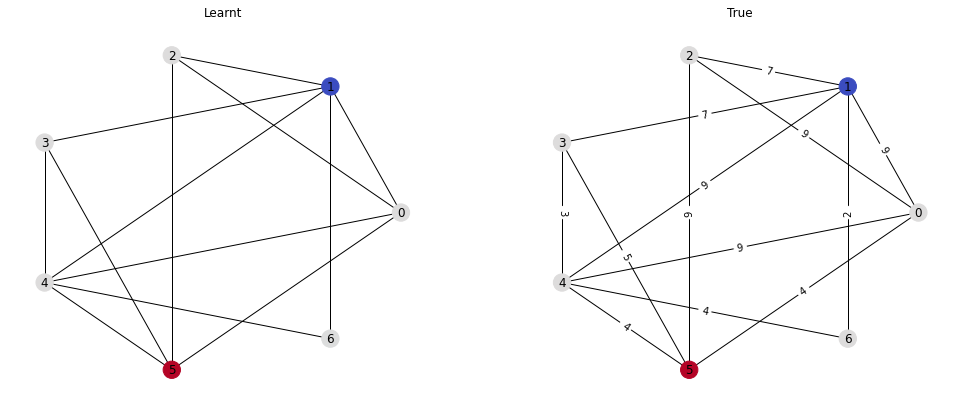

Passes: 2
tensor([1.0024, 0.0000, 1.0024, 2.0046, 1.0022, 1.0024, 1.0025],
       device='cuda:0')
tensor([1., 0., 1., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.0023743256460875273	Similarity: 1.0


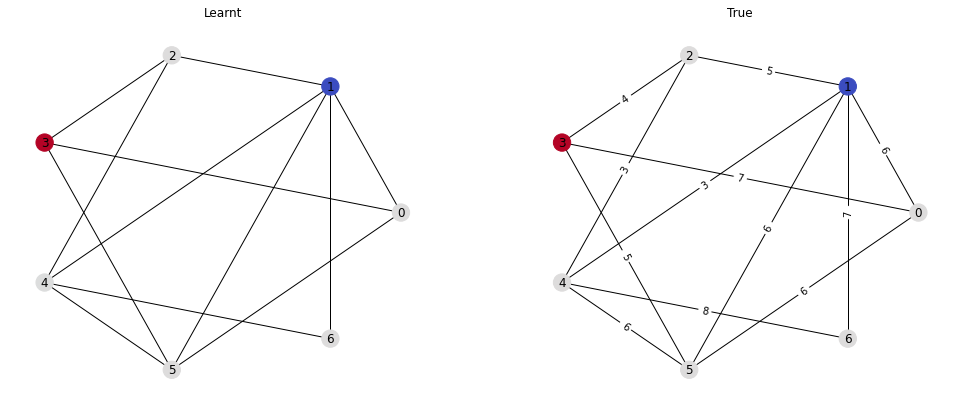

Passes: 2
tensor([2.0043, 1.0024, 1.0022, 2.0046, 2.0046, 2.0043, 0.0000],
       device='cuda:0')
tensor([2., 1., 1., 2., 2., 2., 0.], device='cuda:0')
Loss: 0.0031994071323424578	Similarity: 1.0


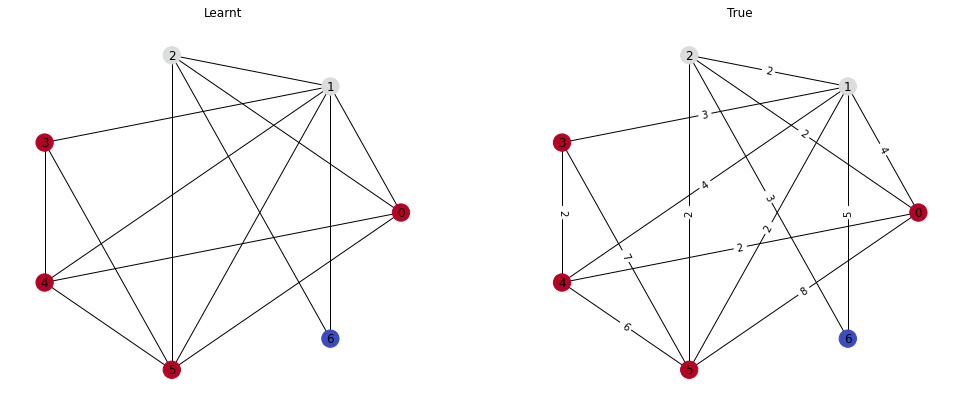

Passes: 2
tensor([1.0023, 2.0047, 1.0023, 0.0000, 2.0048, 2.0045, 2.0050],
       device='cuda:0')
tensor([1., 2., 1., 0., 2., 2., 2.], device='cuda:0')
Loss: 0.0033634391147643328	Similarity: 1.0


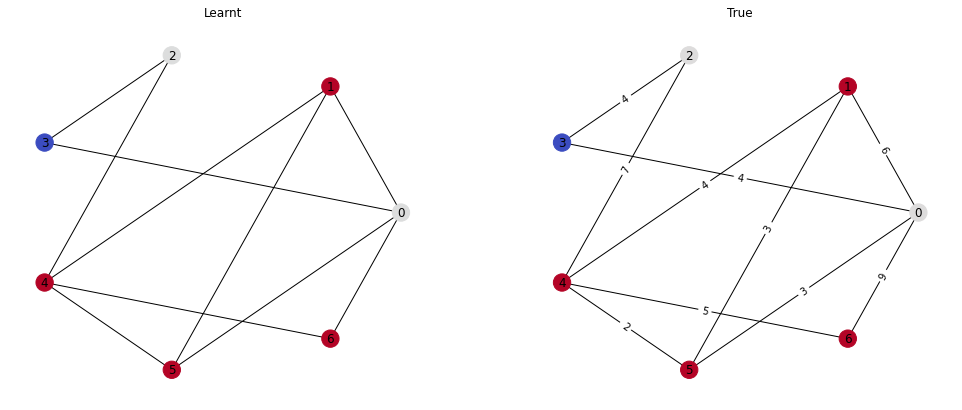

Passes: 1
tensor([1.0021, 1.0027, 0.0000, 1.0023, 1.0022, 1.0027, 1.0021],
       device='cuda:0')
tensor([1., 1., 0., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0020133769139647484	Similarity: 1.0


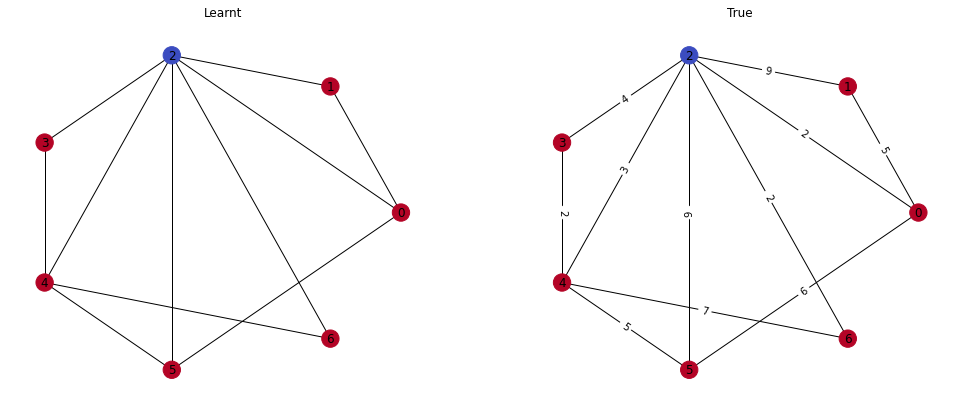

Passes: 2
tensor([1.0022, 0.0000, 1.0027, 2.0046, 1.0022, 2.0044, 1.0024],
       device='cuda:0')
tensor([1., 0., 1., 2., 1., 2., 1.], device='cuda:0')
Loss: 0.002641541650518775	Similarity: 1.0


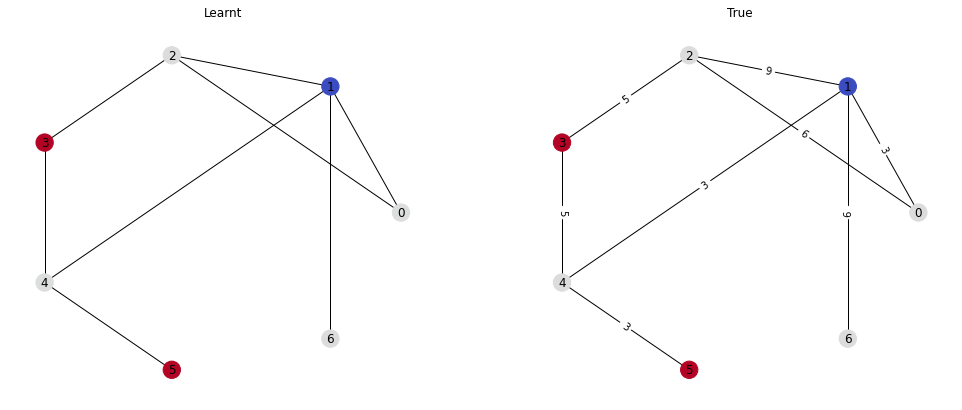

Passes: 1
tensor([1.0024, 1.0021, 1.0021, 1.0024, 0.0000, 1.0024, 1.0023],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.001954793930053711	Similarity: 1.0


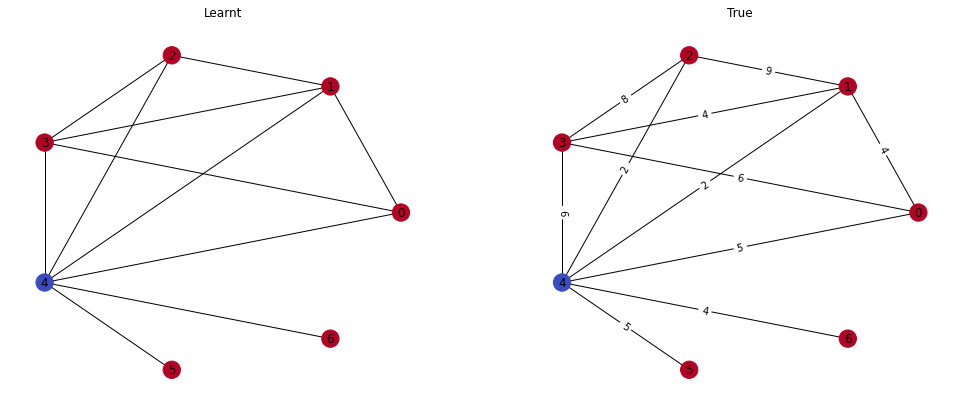

Passes: 2
tensor([2.0046, 1.0025, 1.0023, 1.0026, 1.0025, 0.0000, 1.0024],
       device='cuda:0')
tensor([2., 1., 1., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.002421191893517971	Similarity: 1.0


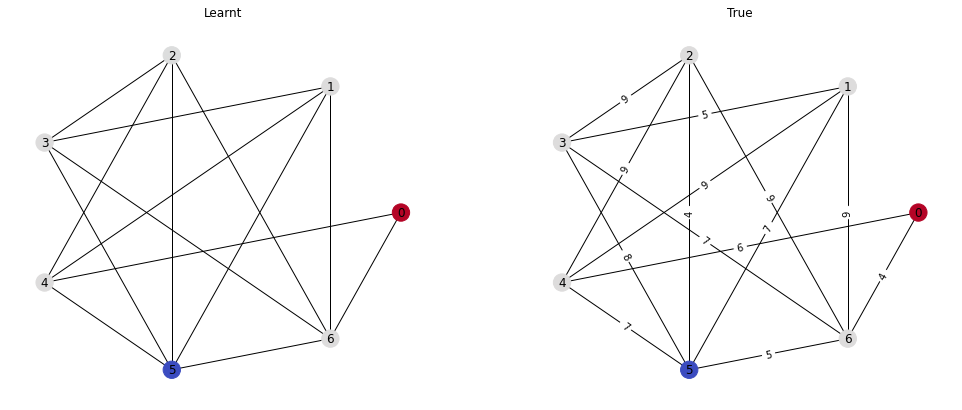

Passes: 2
tensor([2.0044, 0.0000, 1.0024, 2.0046, 2.0048, 1.0022, 2.0044],
       device='cuda:0')
tensor([2., 0., 1., 2., 2., 1., 2.], device='cuda:0')
Loss: 0.003257990116253495	Similarity: 1.0


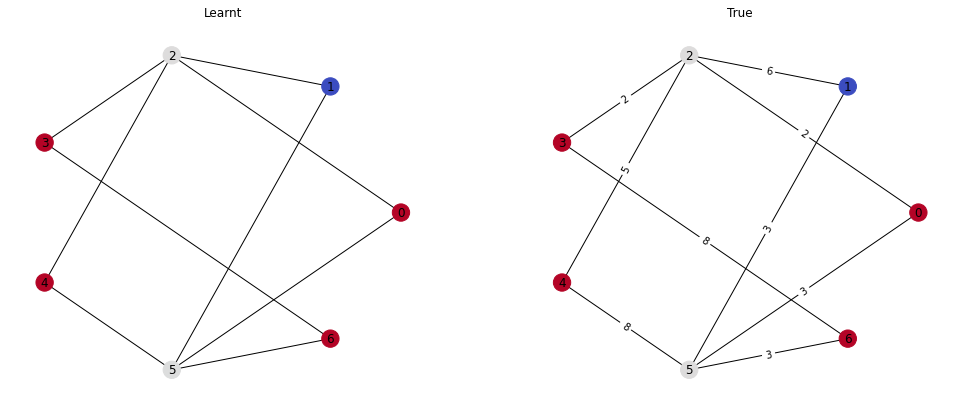

Passes: 3
tensor([3.0071, 0.0000, 2.0048, 1.0023, 1.0026, 2.0050, 2.0044],
       device='cuda:0')
tensor([3., 0., 2., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.003736087353900075	Similarity: 1.0


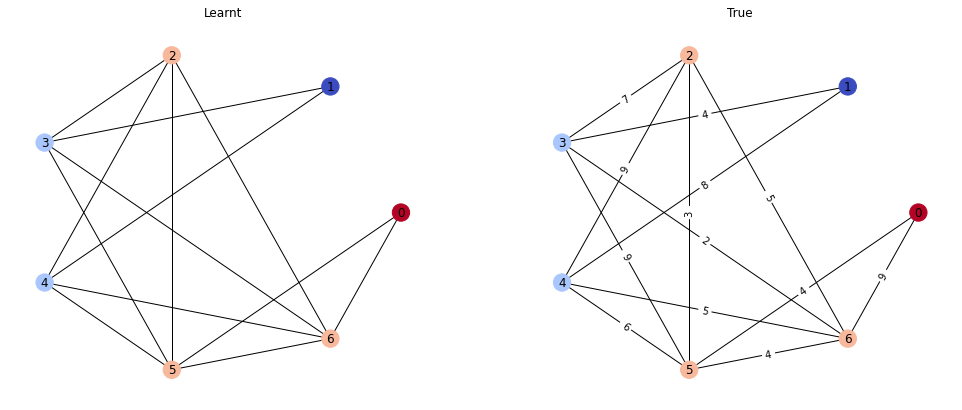

Passes: 2
tensor([2.0043, 2.0045, 1.0026, 1.0027, 1.0021, 0.0000, 1.0022],
       device='cuda:0')
tensor([2., 2., 1., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.002629825146868825	Similarity: 1.0


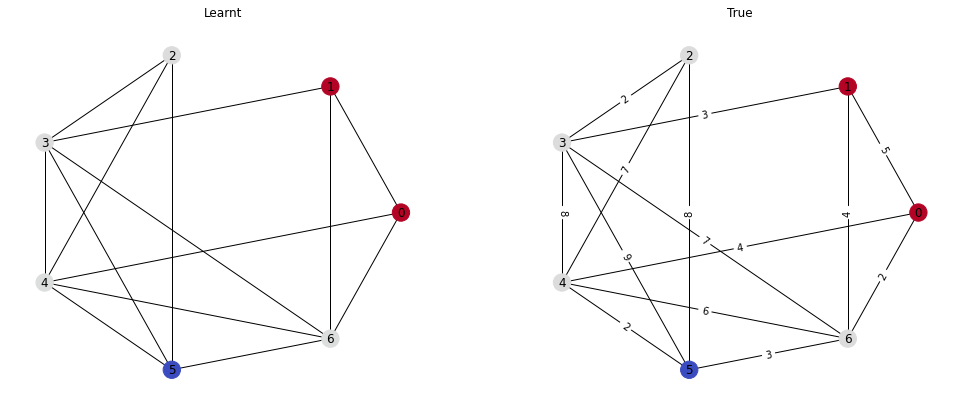

Passes: 2
tensor([1.0025, 1.0024, 1.0024, 1.0025, 2.0049, 2.0048, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 2., 0.], device='cuda:0')
Loss: 0.0027938571292907	Similarity: 1.0


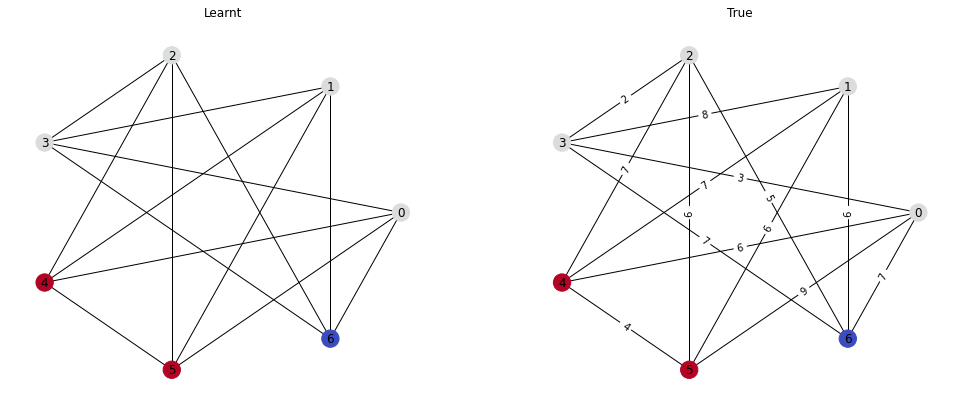

Passes: 2
tensor([1.0024, 0.0000, 1.0023, 1.0025, 2.0047, 1.0021], device='cuda:0')
tensor([1., 0., 1., 1., 2., 1.], device='cuda:0')
Loss: 0.0023489396553486586	Similarity: 1.0


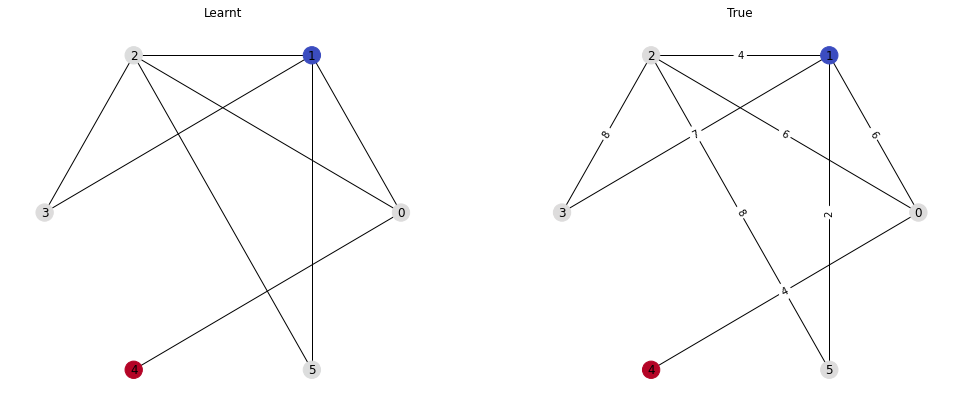

Passes: 3
tensor([3.0070, 2.0047, 1.0024, 0.0000, 3.0070, 3.0072], device='cuda:0')
tensor([3., 2., 1., 0., 3., 3.], device='cuda:0')
Loss: 0.00471148919314146	Similarity: 1.0


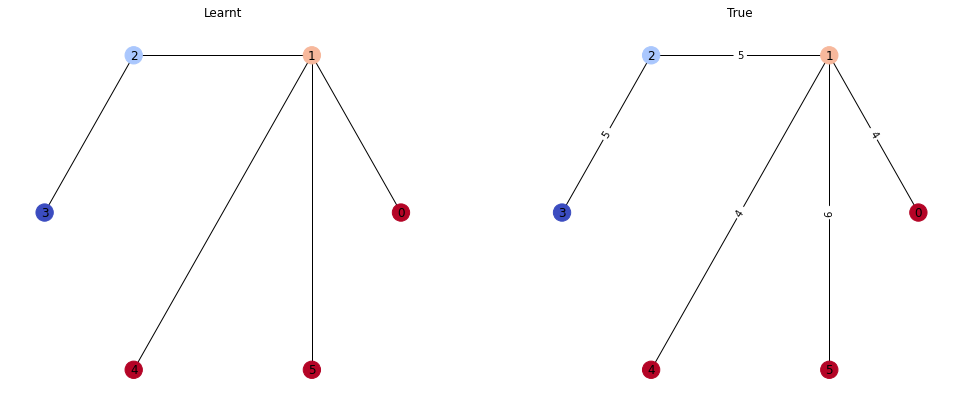

Passes: 2
tensor([2.0051, 2.0053, 2.0049, 0.0000, 1.0025, 2.0051, 1.0027],
       device='cuda:0')
tensor([2., 2., 2., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.0036680700723081827	Similarity: 1.0


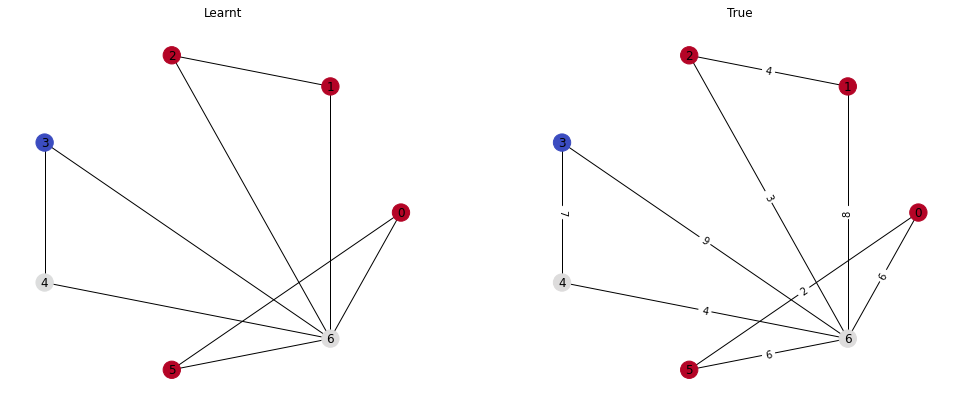

Passes: 2
tensor([0.0000, 2.0048, 2.0048, 2.0045, 1.0023, 1.0024, 1.0021],
       device='cuda:0')
tensor([0., 2., 2., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.002979057375341654	Similarity: 1.0


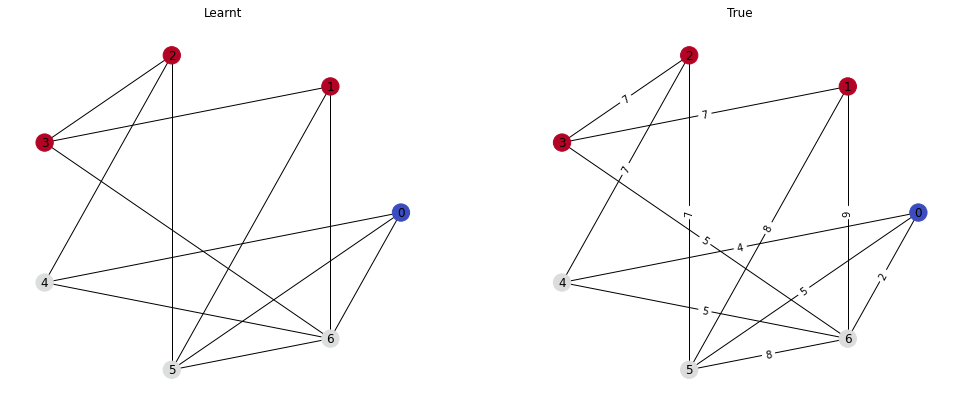

Passes: 2
tensor([1.0023, 2.0046, 2.0046, 2.0046, 0.0000, 1.0023], device='cuda:0')
tensor([1., 2., 2., 2., 0., 1.], device='cuda:0')
Loss: 0.003081798553466797	Similarity: 1.0


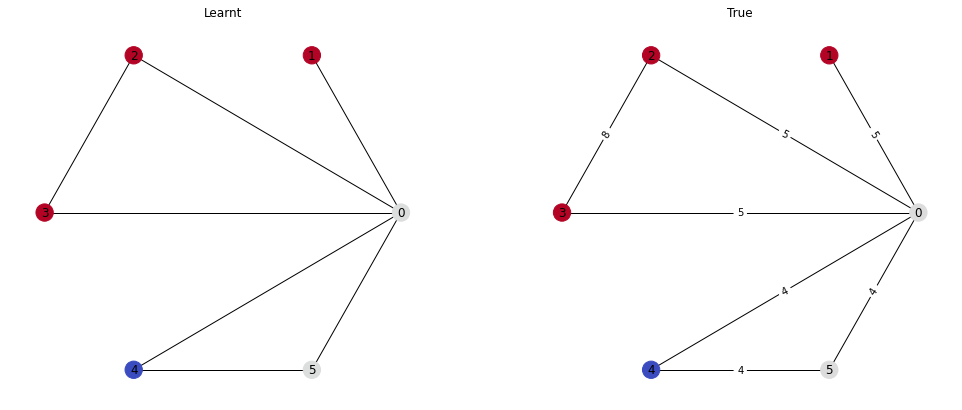

Passes: 3
tensor([3.0073, 2.0051, 1.0025, 0.0000, 3.0076, 3.0077, 2.0051],
       device='cuda:0')
tensor([3., 2., 1., 0., 3., 3., 2.], device='cuda:0')
Loss: 0.005053231026977301	Similarity: 1.0


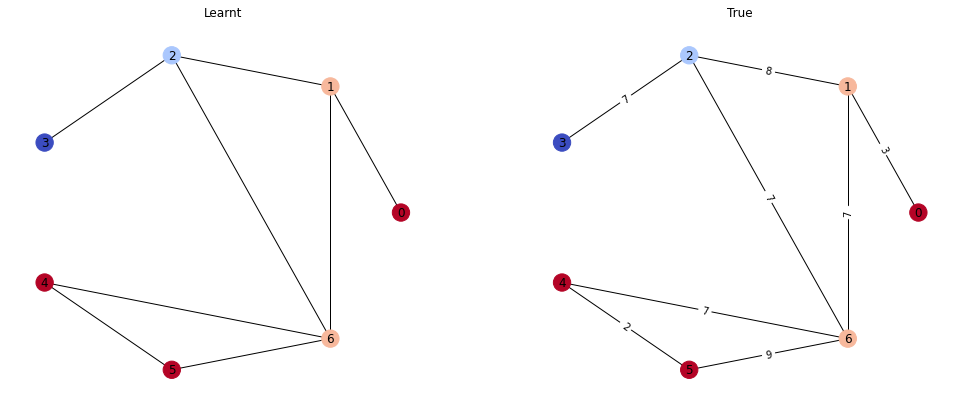

Passes: 3
tensor([0.0000, 1.0027, 2.0048, 3.0071, 2.0053, 1.0027, 2.0048],
       device='cuda:0')
tensor([0., 1., 2., 3., 2., 1., 2.], device='cuda:0')
Loss: 0.003911836072802544	Similarity: 1.0


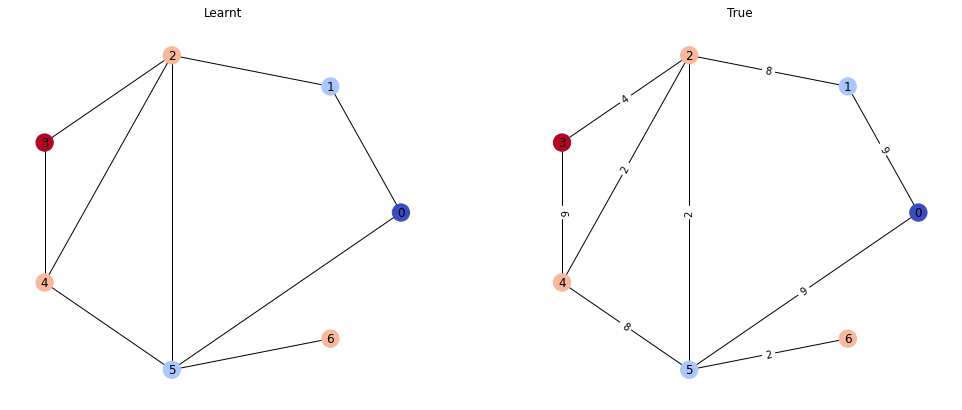

Passes: 2
tensor([0.0000, 1.0026, 1.0024, 2.0048, 2.0046, 2.0050, 2.0046],
       device='cuda:0')
tensor([0., 1., 1., 2., 2., 2., 2.], device='cuda:0')
Loss: 0.0034103053621947765	Similarity: 1.0


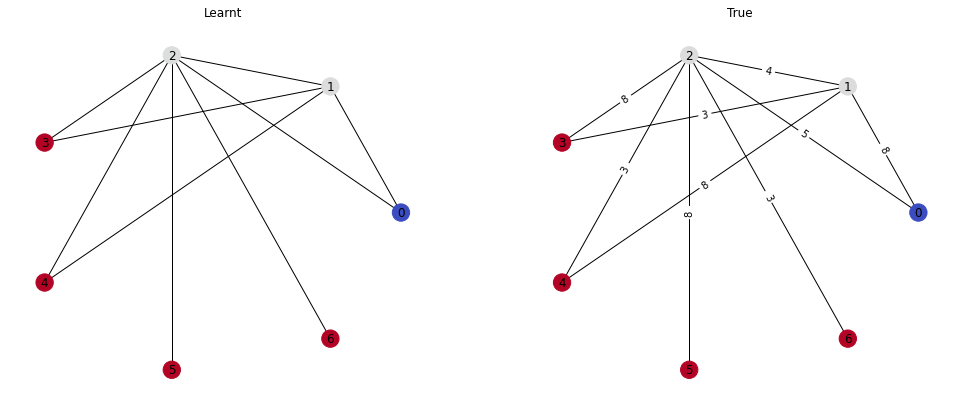

Passes: 2
tensor([2.0042, 2.0043, 1.0021, 1.0023, 2.0045, 1.0027, 0.0000],
       device='cuda:0')
tensor([2., 2., 1., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.0028736081440001726	Similarity: 1.0


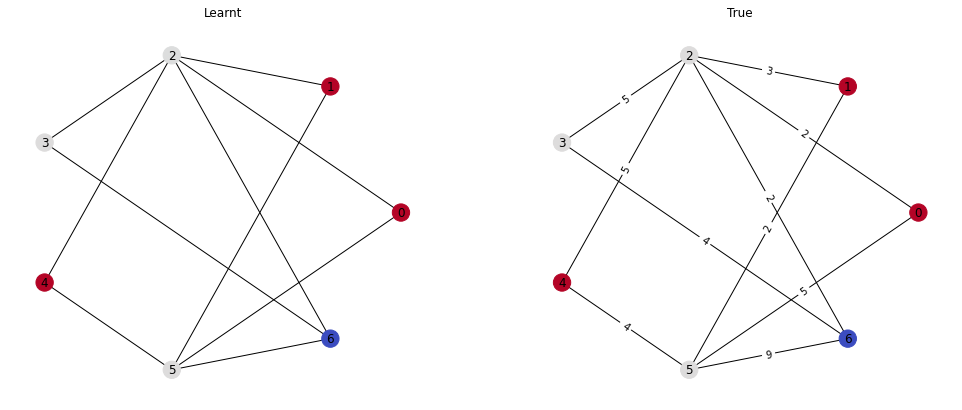

Passes: 2
tensor([2.0044, 2.0046, 0.0000, 2.0049, 1.0027, 1.0022, 1.0024],
       device='cuda:0')
tensor([2., 2., 0., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.0030376401264220476	Similarity: 1.0


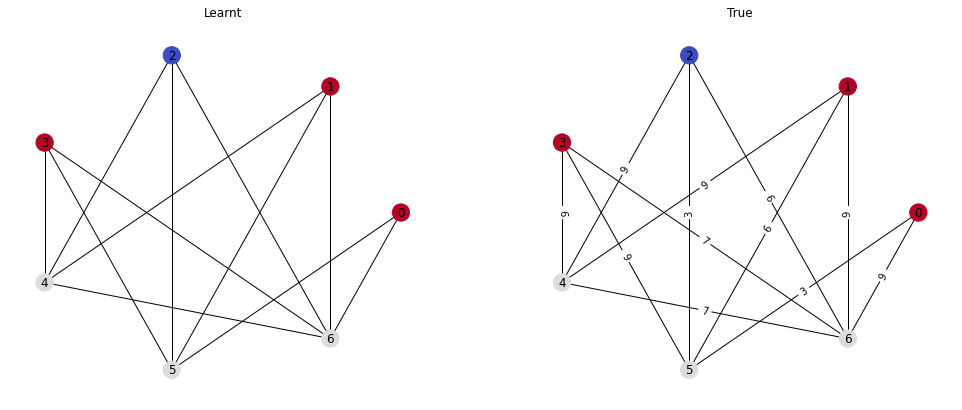

Passes: 2
tensor([1.0027, 2.0045, 0.0000, 2.0047, 1.0025, 1.0021, 2.0053],
       device='cuda:0')
tensor([1., 2., 0., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.003119656117632985	Similarity: 1.0


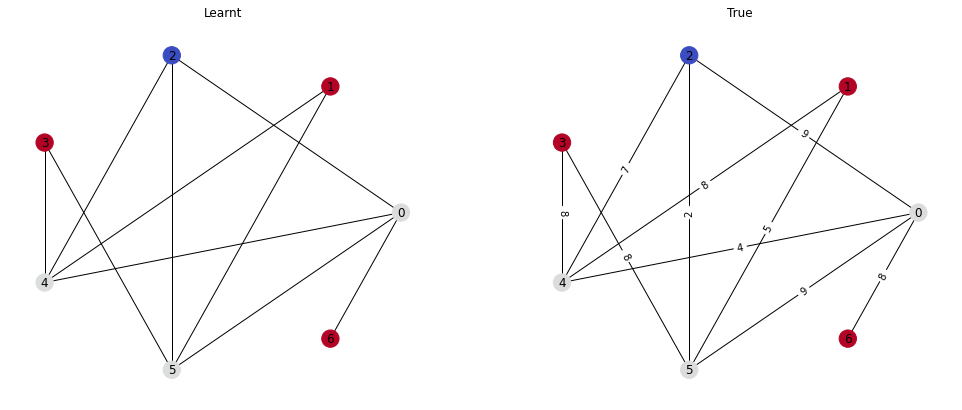

Passes: 2
tensor([1.0023, 1.0026, 1.0026, 1.0025, 0.0000, 2.0047], device='cuda:0')
tensor([1., 1., 1., 1., 0., 2.], device='cuda:0')
Loss: 0.0024582943879067898	Similarity: 1.0


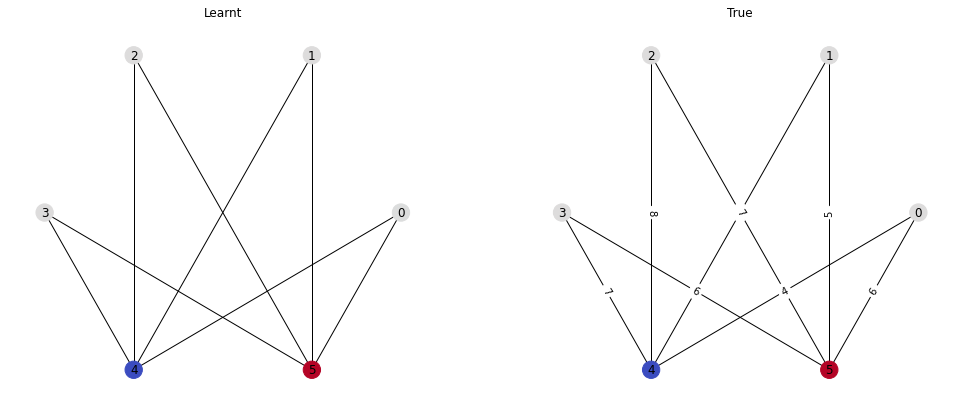

Passes: 3
tensor([1.0026, 3.0075, 2.0053, 2.0052, 1.0026, 0.0000], device='cuda:0')
tensor([1., 3., 2., 2., 1., 0.], device='cuda:0')
Loss: 0.00387195753864944	Similarity: 1.0


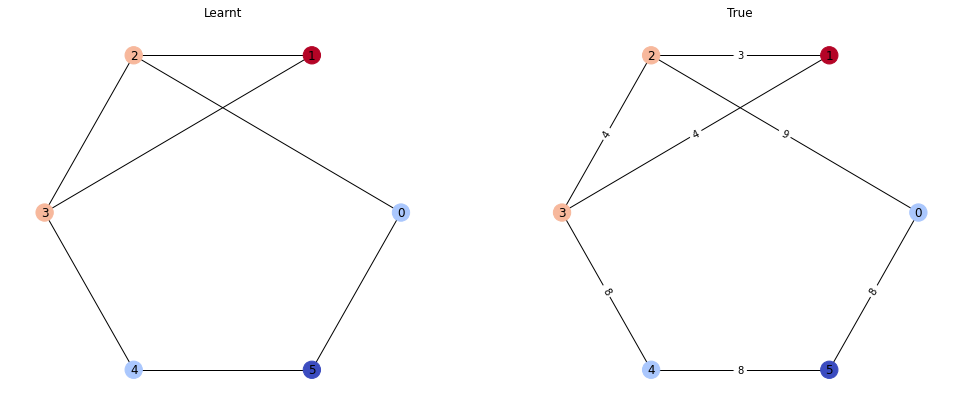

Passes: 2
tensor([1.0021, 1.0022, 1.0021, 0.0000, 1.0027, 2.0045, 2.0043],
       device='cuda:0')
tensor([1., 1., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.0025595256593078375	Similarity: 1.0


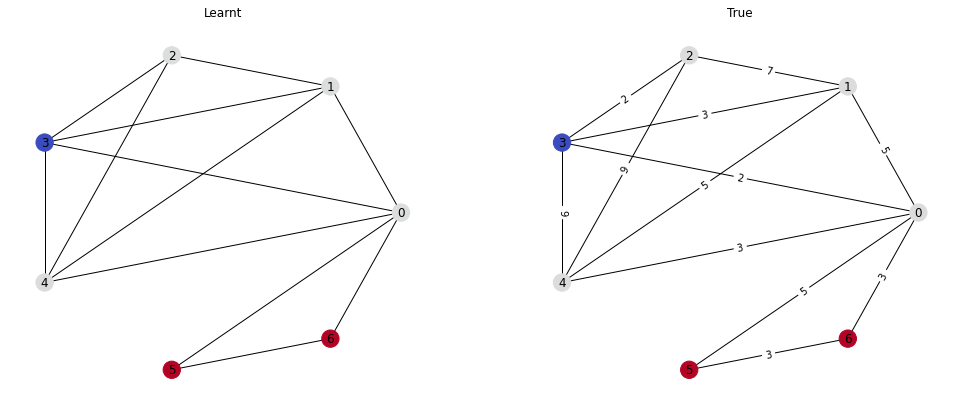

Passes: 2
tensor([1.0025, 2.0051, 2.0046, 1.0026, 1.0027, 0.0000, 1.0024],
       device='cuda:0')
tensor([1., 2., 2., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.0028290068730711937	Similarity: 1.0


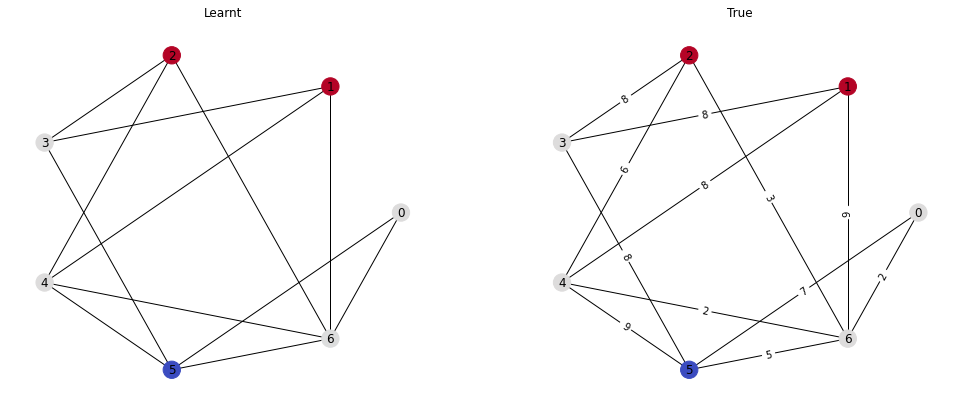

Passes: 3
tensor([0.0000, 3.0069, 3.0068, 3.0067, 1.0022, 2.0046, 2.0043],
       device='cuda:0')
tensor([0., 3., 3., 3., 1., 2., 2.], device='cuda:0')
Loss: 0.004490835592150688	Similarity: 1.0


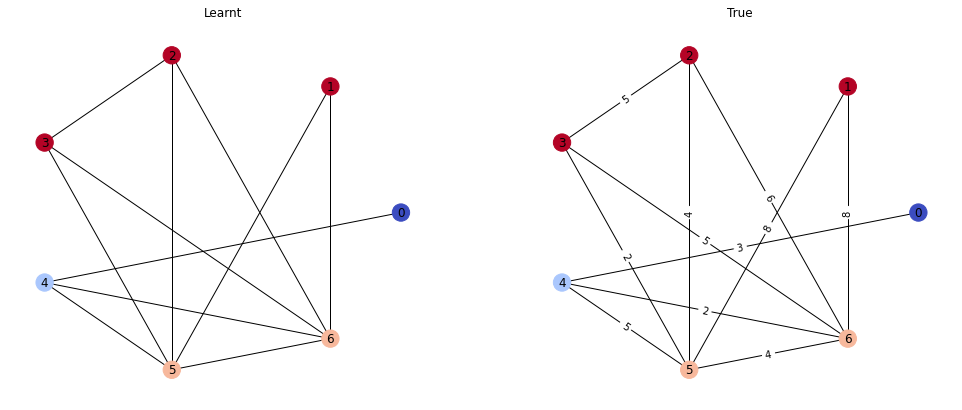

Passes: 2
tensor([1.0022, 0.0000, 1.0026, 2.0048, 2.0045], device='cuda:0')
tensor([1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.002818727632984519	Similarity: 1.0


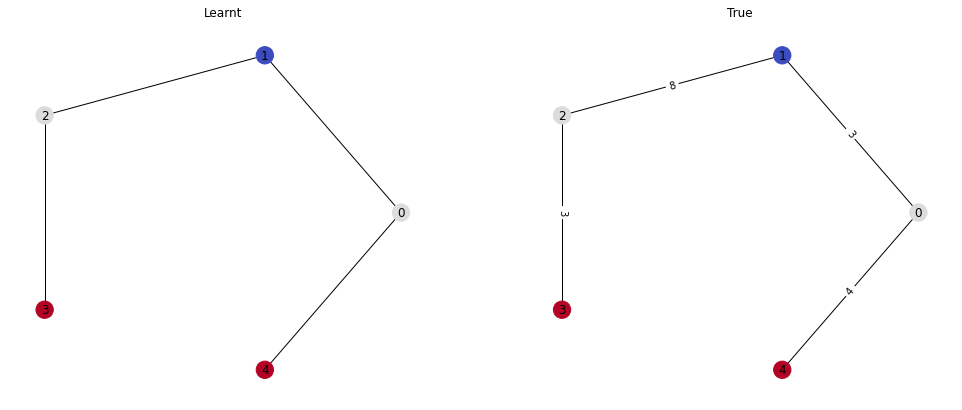

Passes: 2
tensor([1.0027, 2.0048, 2.0048, 2.0048, 1.0021, 0.0000, 1.0023],
       device='cuda:0')
tensor([1., 2., 2., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.0030727898702025414	Similarity: 1.0


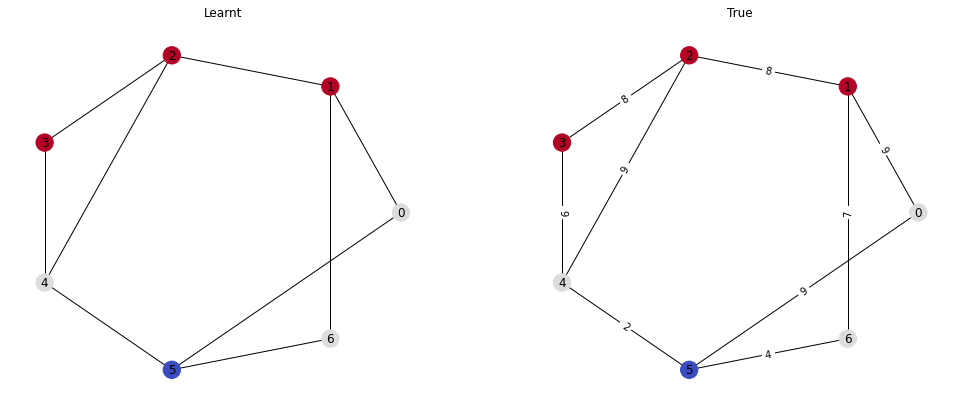

Passes: 2
tensor([1.0024, 1.0027, 1.0026, 2.0049, 0.0000, 1.0027, 2.0046],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 1., 2.], device='cuda:0')
Loss: 0.0028407233767211437	Similarity: 1.0


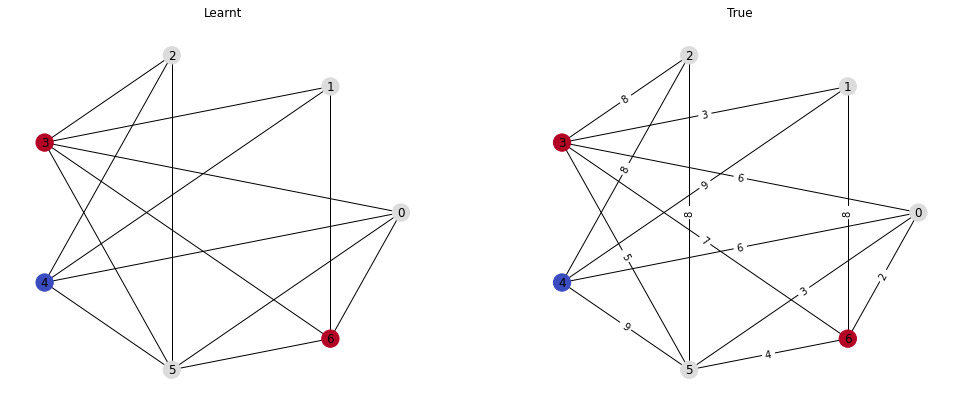

Passes: 2
tensor([0.0000, 1.0022, 2.0046, 1.0024, 1.0022, 1.0027, 2.0045],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.002641541650518775	Similarity: 1.0


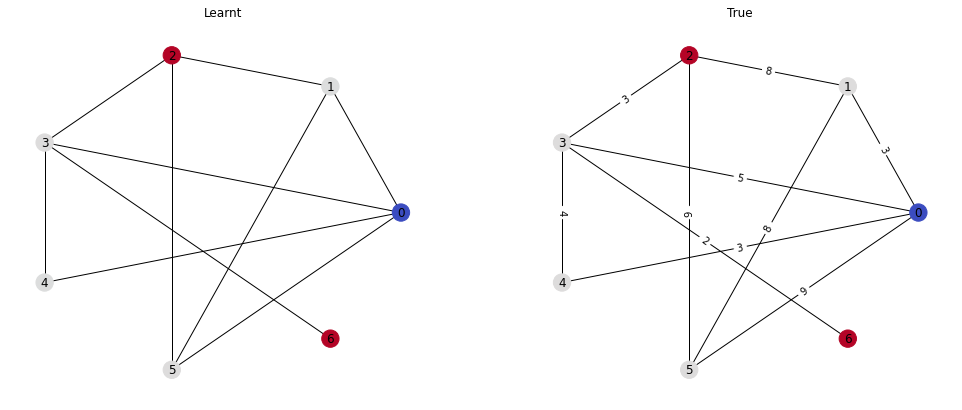

Passes: 2
tensor([1.0026, 1.0025, 1.0025, 1.0026, 2.0048, 1.0024, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.0025032078847289085	Similarity: 1.0


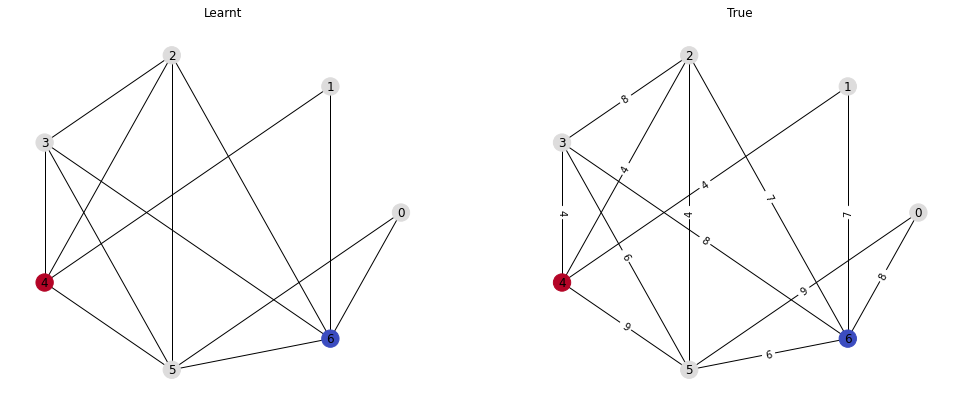

Passes: 2
tensor([1.0022, 0.0000, 2.0045, 1.0022, 1.0026, 2.0046, 2.0045],
       device='cuda:0')
tensor([1., 0., 2., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.00293219112791121	Similarity: 1.0


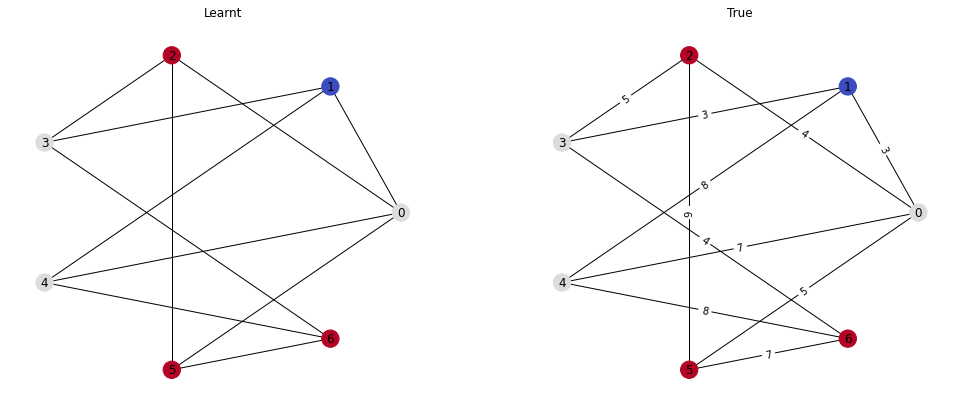

Passes: 2
tensor([2.0049, 0.0000, 1.0027, 2.0045, 2.0050, 2.0046, 1.0024],
       device='cuda:0')
tensor([2., 0., 1., 2., 2., 2., 1.], device='cuda:0')
Loss: 0.00342202209867537	Similarity: 1.0


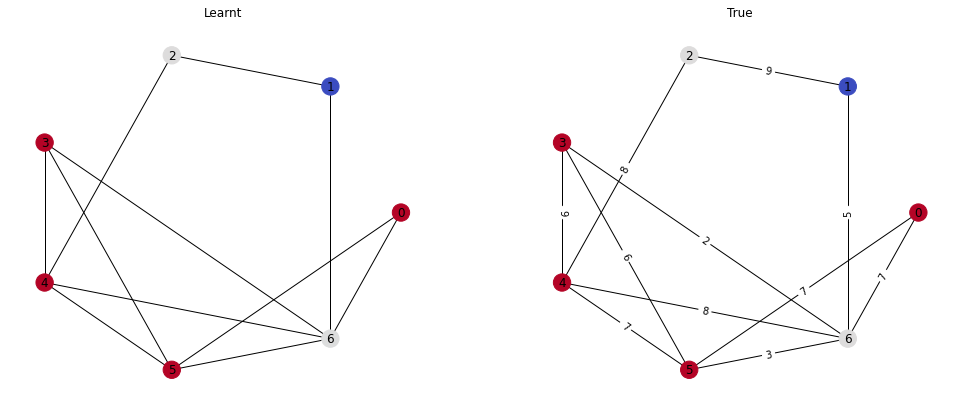

Passes: 2
tensor([1.0026, 2.0049, 1.0024, 1.0026, 0.0000, 1.0023, 1.0026],
       device='cuda:0')
tensor([1., 2., 1., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.002479774644598365	Similarity: 1.0


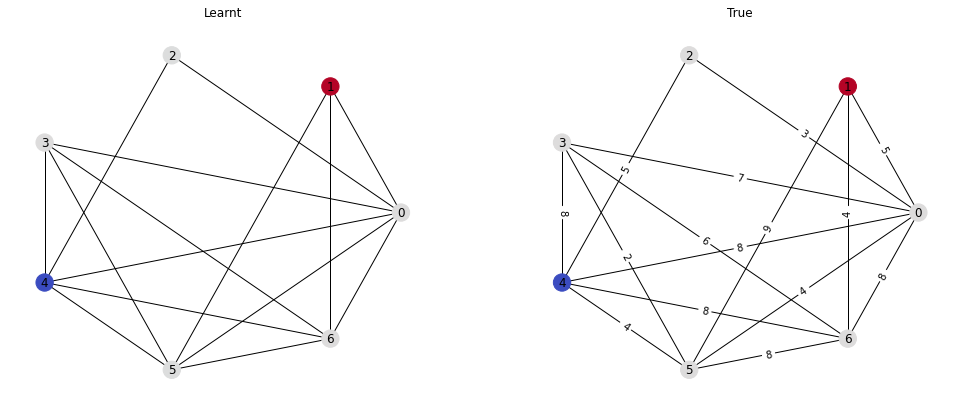

Passes: 2
tensor([2.0050, 1.0025, 1.0026, 2.0052, 2.0050, 1.0025, 0.0000],
       device='cuda:0')
tensor([2., 1., 1., 2., 2., 1., 0.], device='cuda:0')
Loss: 0.00326025509275496	Similarity: 1.0


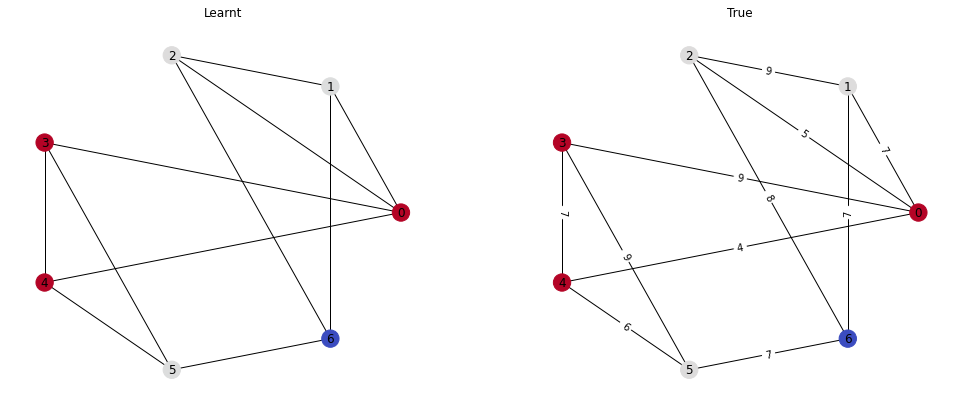

Passes: 2
tensor([2.0044, 2.0047, 1.0025, 1.0027, 0.0000, 1.0027, 1.0022],
       device='cuda:0')
tensor([2., 2., 1., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.002746990881860256	Similarity: 1.0


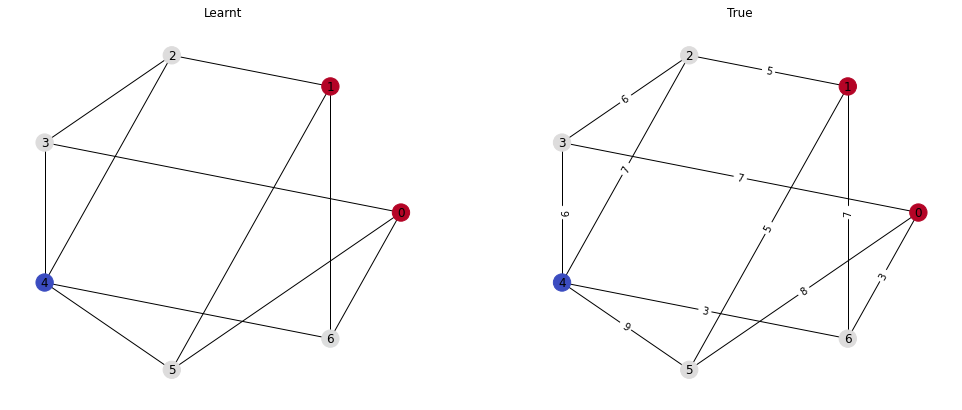

Passes: 2
tensor([1.0023, 1.0026, 1.0023, 1.0023, 2.0046, 2.0046, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 2., 0.], device='cuda:0')
Loss: 0.0026649748906493187	Similarity: 1.0


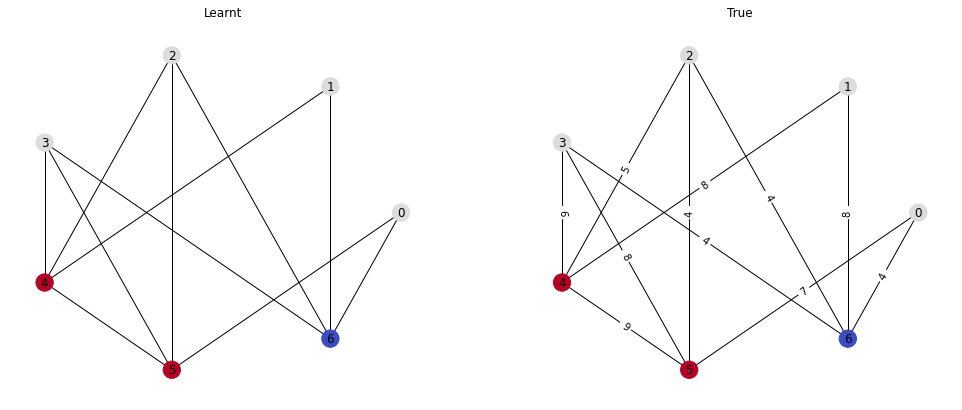

Passes: 2
tensor([2.0046, 2.0048, 2.0046, 1.0022, 2.0045, 1.0022, 0.0000],
       device='cuda:0')
tensor([2., 2., 2., 1., 2., 1., 0.], device='cuda:0')
Loss: 0.0032697066199034452	Similarity: 1.0


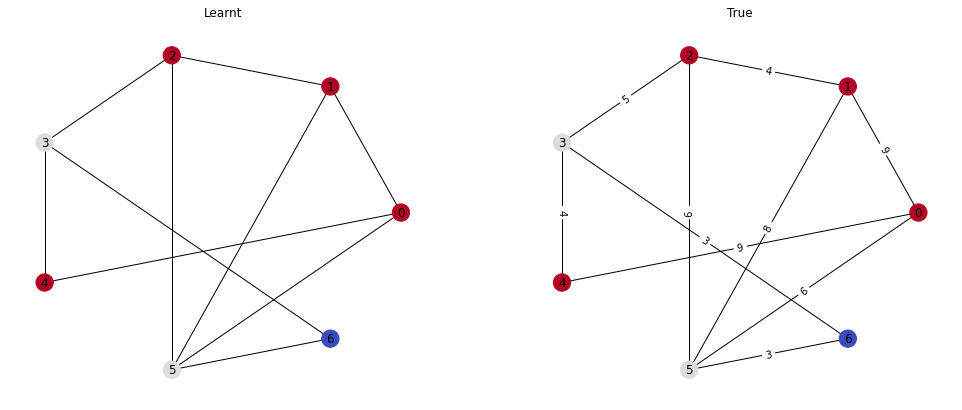

Passes: 2
tensor([2.0047, 2.0046, 1.0024, 2.0046, 1.0024, 0.0000, 1.0021],
       device='cuda:0')
tensor([2., 2., 1., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.003002490382641554	Similarity: 1.0


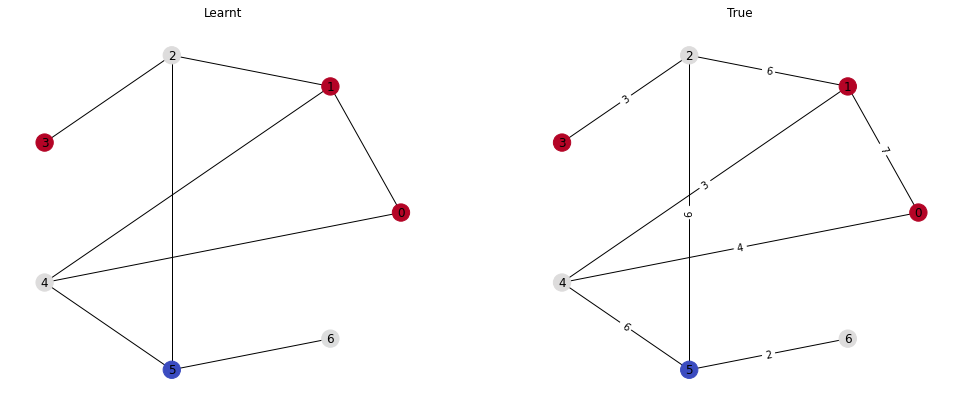

Passes: 3
tensor([1.0024, 2.0050, 3.0071, 2.0048, 1.0024, 0.0000, 3.0076],
       device='cuda:0')
tensor([1., 2., 3., 2., 1., 0., 3.], device='cuda:0')
Loss: 0.004179035313427448	Similarity: 1.0


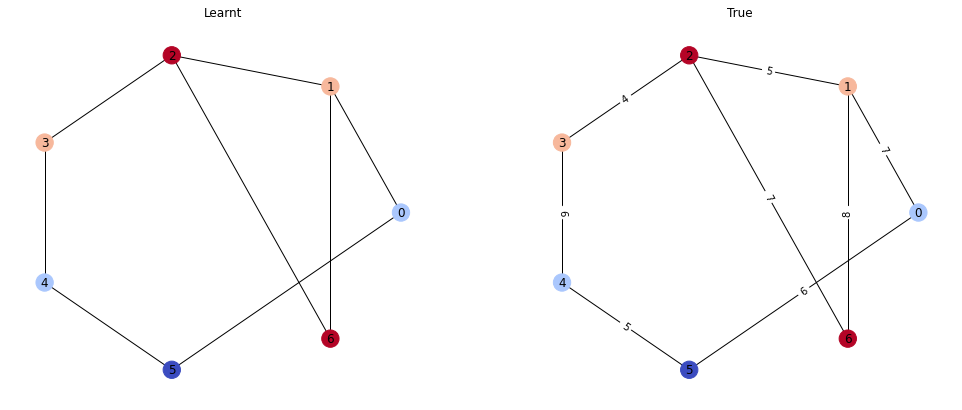

Passes: 1
tensor([1.0025, 0.0000, 1.0023], device='cuda:0')
tensor([1., 0., 1.], device='cuda:0')
Loss: 0.0016024112701416016	Similarity: 1.0


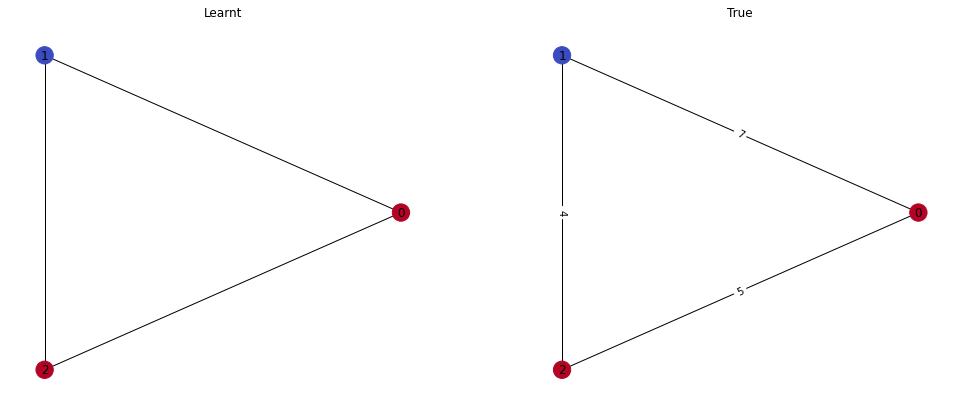

Passes: 2
tensor([2.0051, 1.0027, 2.0051, 1.0025, 0.0000, 1.0024, 2.0051],
       device='cuda:0')
tensor([2., 1., 2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.00326025509275496	Similarity: 1.0


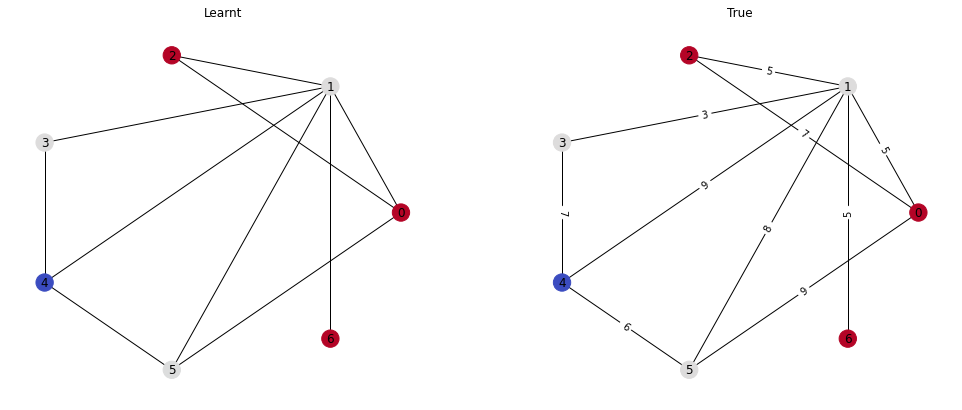

Passes: 2
tensor([0.0000, 2.0043, 2.0043, 1.0024, 1.0022, 2.0043, 1.0022],
       device='cuda:0')
tensor([0., 2., 2., 1., 1., 2., 1.], device='cuda:0')
Loss: 0.002826741896569729	Similarity: 1.0


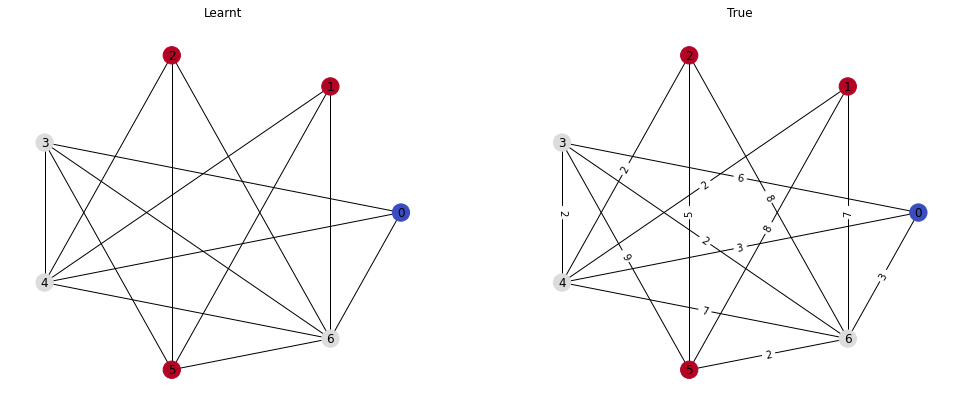

Passes: 2
tensor([1.0024, 1.0021, 1.0022, 1.0021, 0.0000, 2.0042, 1.0026],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 2., 1.], device='cuda:0')
Loss: 0.002245443407446146	Similarity: 1.0


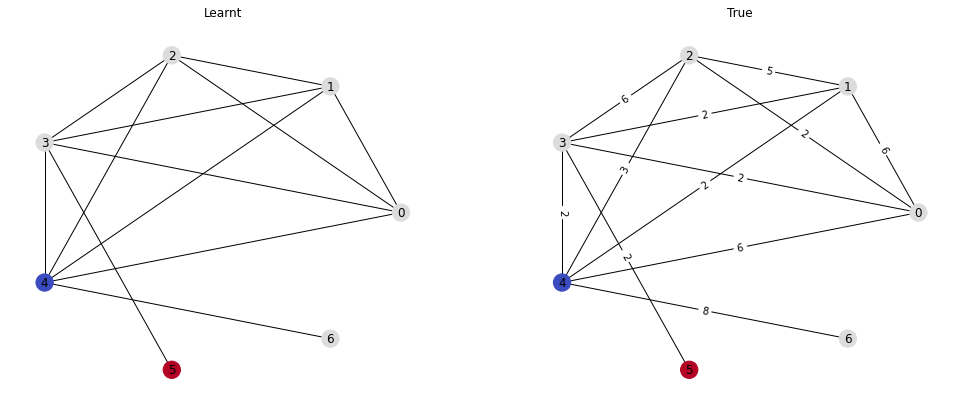

Passes: 4
tensor([4.0102, 3.0076, 2.0053, 0.0000, 3.0069, 2.0048, 1.0026],
       device='cuda:0')
tensor([4., 3., 2., 0., 3., 2., 1.], device='cuda:0')
Loss: 0.005343897268176079	Similarity: 1.0


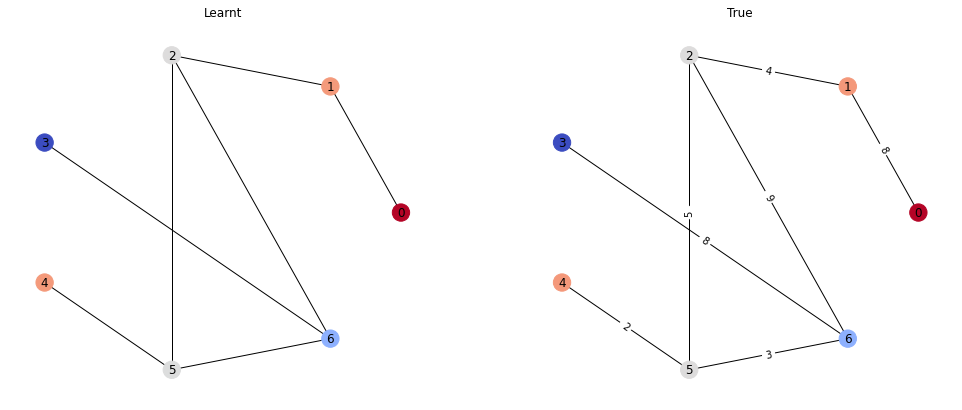

Passes: 5
tensor([4.0096, 3.0073, 2.0050, 1.0023, 4.0097, 5.0121, 0.0000],
       device='cuda:0')
tensor([4., 3., 2., 1., 4., 5., 0.], device='cuda:0')
Loss: 0.006553394719958305	Similarity: 1.0


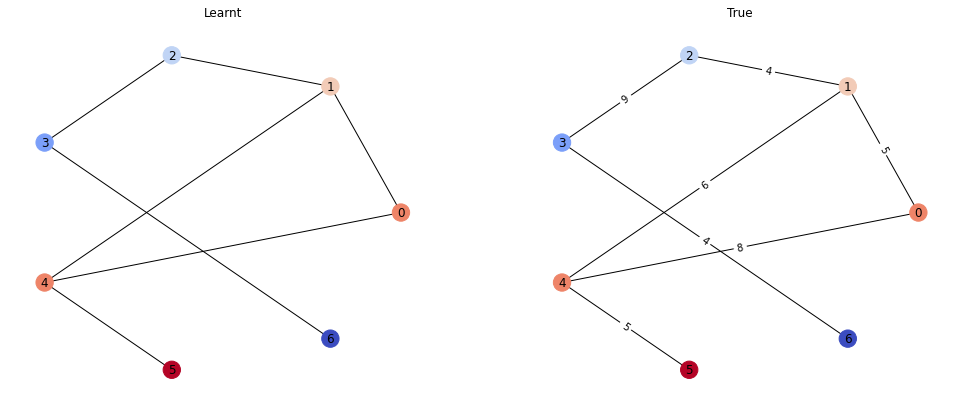

Passes: 2
tensor([2.0046, 1.0025, 0.0000, 1.0024, 2.0046, 1.0023, 1.0024],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.0027001246344298124	Similarity: 1.0


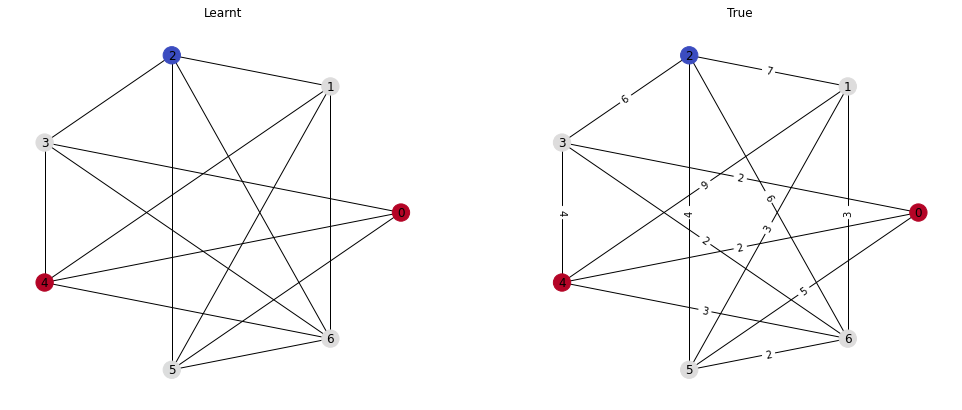

Passes: 2
tensor([1.0021, 0.0000, 2.0045, 1.0025, 1.0022, 1.0023, 2.0046],
       device='cuda:0')
tensor([1., 0., 2., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.002606392139568925	Similarity: 1.0


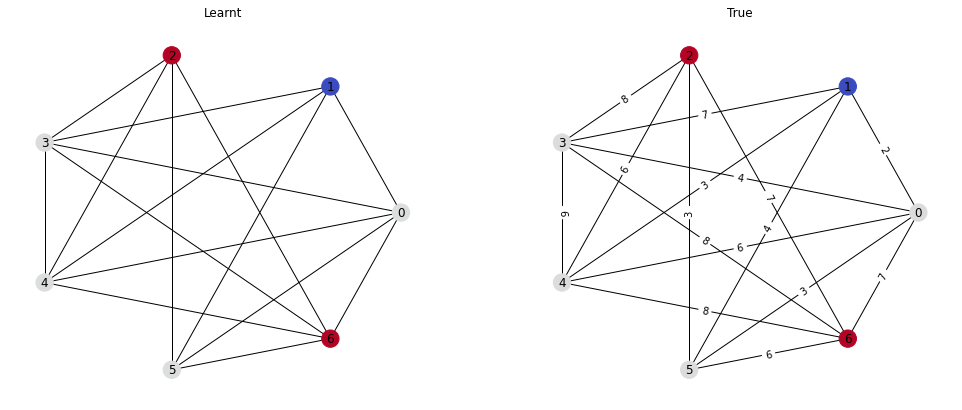

Passes: 3
tensor([1.0024, 2.0048, 2.0048, 2.0048, 1.0026, 0.0000, 3.0070],
       device='cuda:0')
tensor([1., 2., 2., 2., 1., 0., 3.], device='cuda:0')
Loss: 0.0037829536013305187	Similarity: 1.0


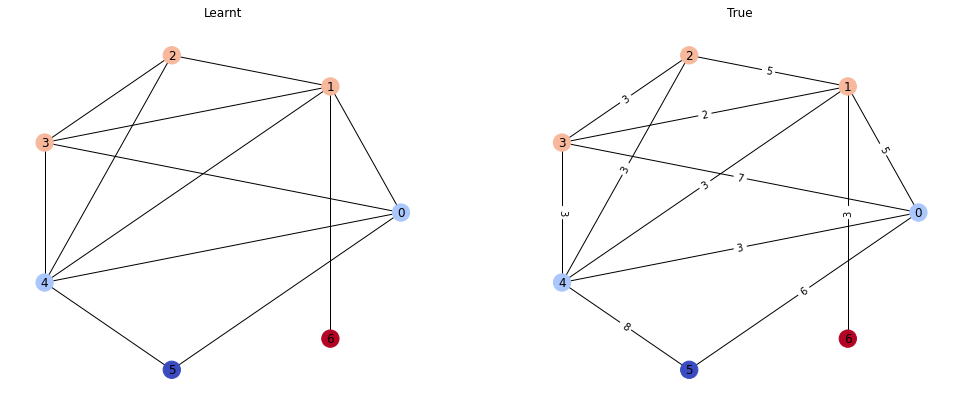

Passes: 3
tensor([1.0027, 0.0000, 2.0046, 1.0023, 2.0051, 1.0024, 3.0070],
       device='cuda:0')
tensor([1., 0., 2., 1., 2., 1., 3.], device='cuda:0')
Loss: 0.0034337216056883335	Similarity: 1.0


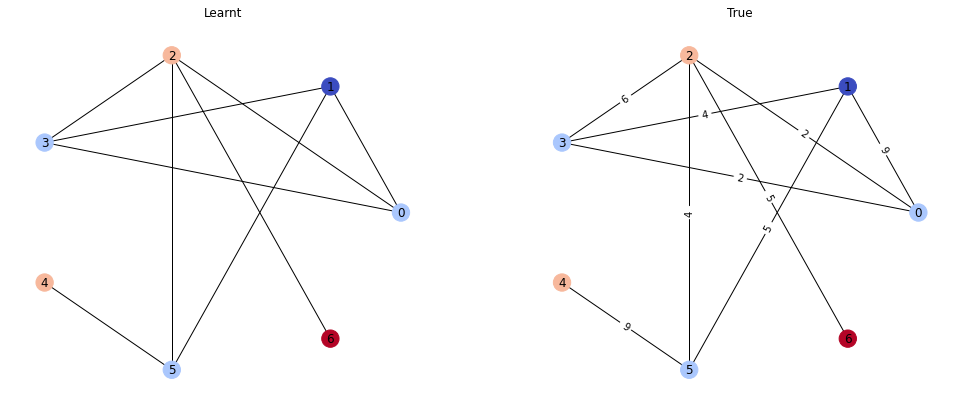

Passes: 2
tensor([1.0025, 1.0026, 2.0050, 2.0048, 1.0027, 0.0000], device='cuda:0')
tensor([1., 1., 2., 2., 1., 0.], device='cuda:0')
Loss: 0.0029340784531086683	Similarity: 1.0


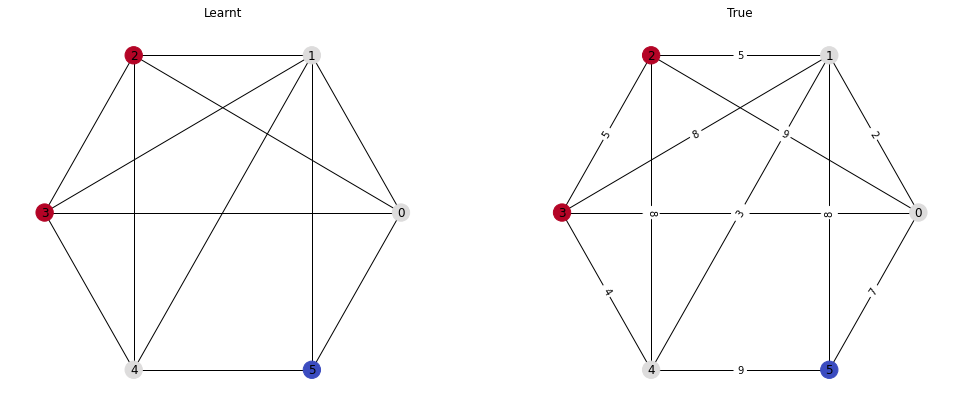

Passes: 4
tensor([3.0073, 2.0051, 3.0073, 3.0075, 1.0025, 0.0000, 4.0098],
       device='cuda:0')
tensor([3., 2., 3., 3., 1., 0., 4.], device='cuda:0')
Loss: 0.0056579625234007835	Similarity: 1.0


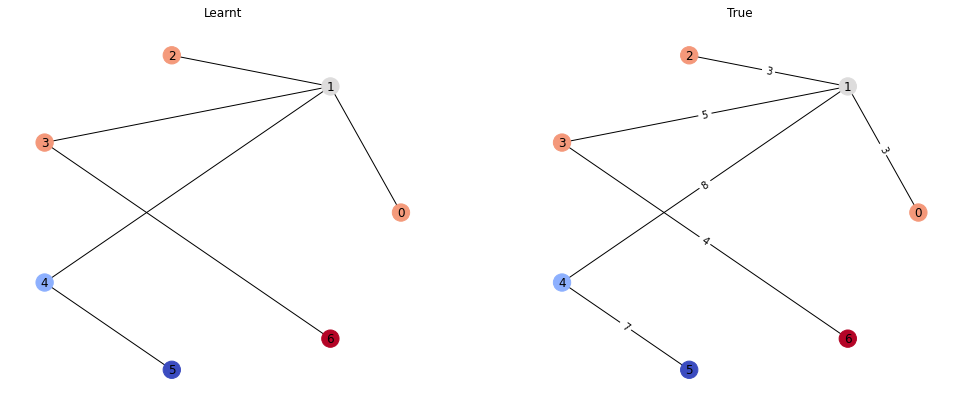

Passes: 2
tensor([0.0000, 2.0049, 2.0046, 1.0022, 2.0045, 1.0024, 2.0048],
       device='cuda:0')
tensor([0., 2., 2., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.0033400061074644327	Similarity: 1.0


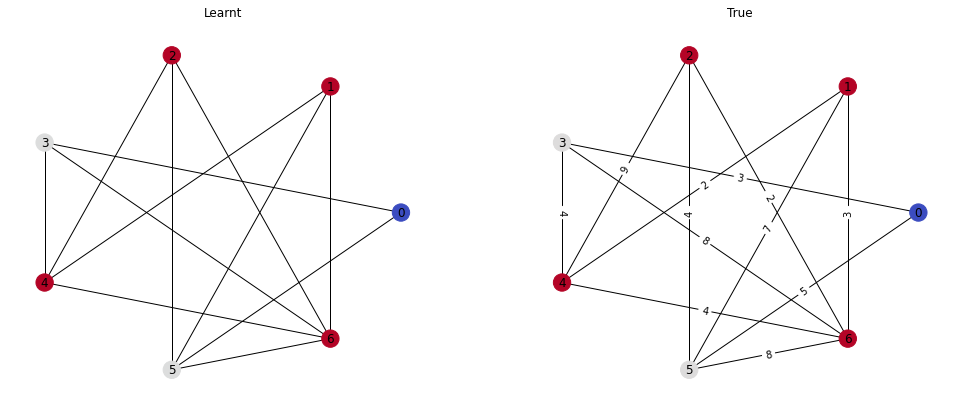

Passes: 2
tensor([0.0000, 2.0050, 2.0045, 2.0049, 1.0024, 1.0025, 1.0025],
       device='cuda:0')
tensor([0., 2., 2., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.003107939613983035	Similarity: 1.0


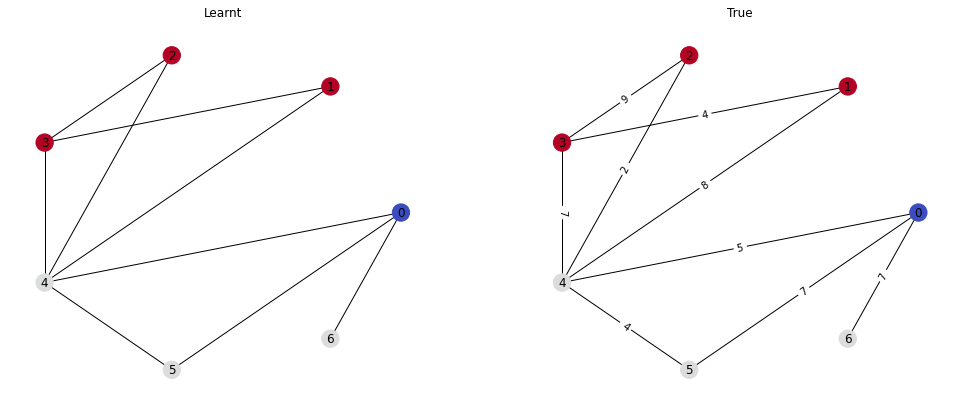

Passes: 2
tensor([0.0000, 1.0026, 2.0051, 2.0046, 1.0024, 1.0025, 1.0024],
       device='cuda:0')
tensor([0., 1., 2., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.0028172903694212437	Similarity: 1.0


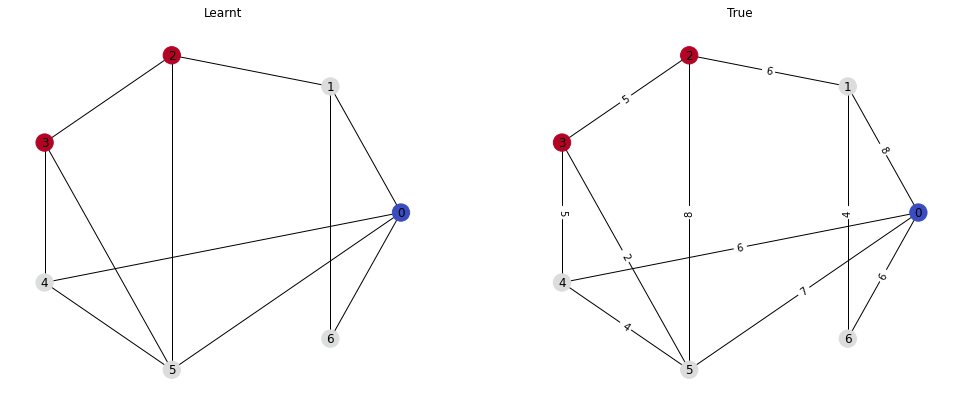

Passes: 3
tensor([3.0067, 1.0022, 1.0024, 1.0026, 1.0022, 0.0000, 2.0046],
       device='cuda:0')
tensor([3., 1., 1., 1., 1., 0., 2.], device='cuda:0')
Loss: 0.0029438906349241734	Similarity: 1.0


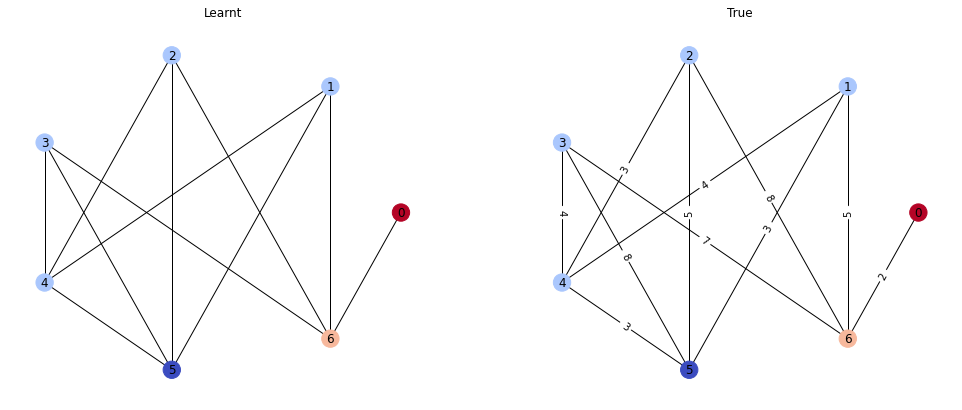

Passes: 2
tensor([1.0027, 1.0024, 1.0022, 2.0044, 0.0000, 1.0022, 2.0044],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 1., 2.], device='cuda:0')
Loss: 0.002618108643218875	Similarity: 1.0


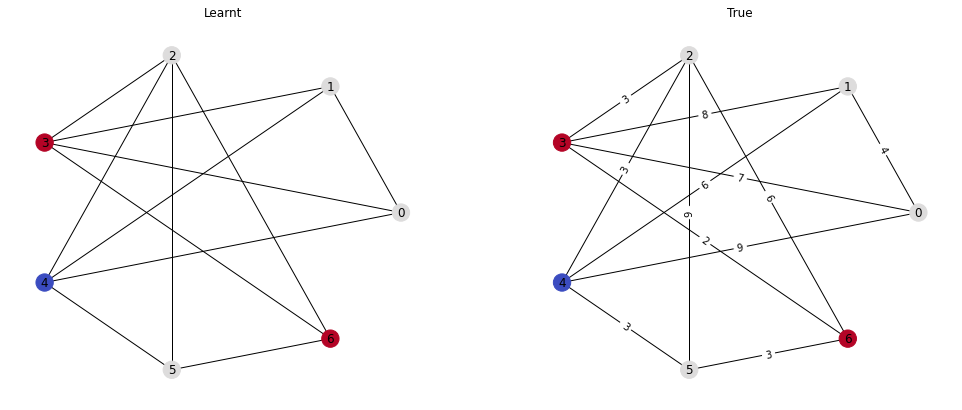

Passes: 3
tensor([2.0045, 2.0045, 0.0000, 1.0025, 1.0022, 3.0067], device='cuda:0')
tensor([2., 2., 0., 1., 1., 3.], device='cuda:0')
Loss: 0.00339353084564209	Similarity: 1.0


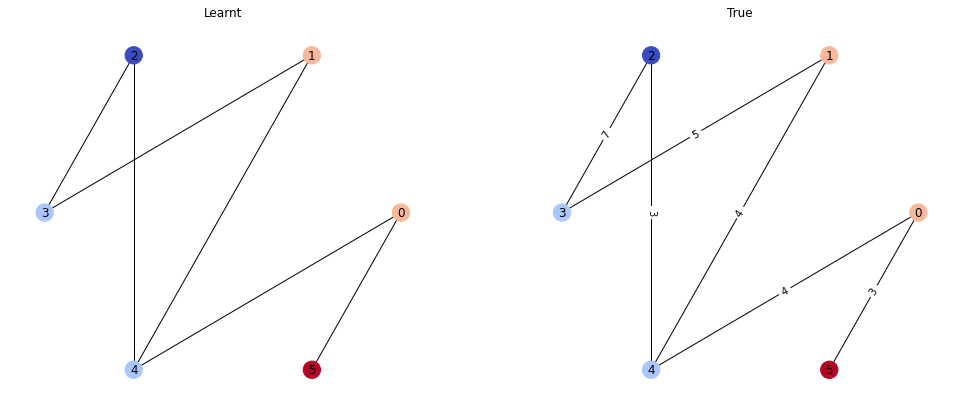

Passes: 2
tensor([0.0000, 2.0043, 1.0023, 2.0044, 1.0026, 1.0021], device='cuda:0')
tensor([0., 2., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.0026196837425231934	Similarity: 1.0


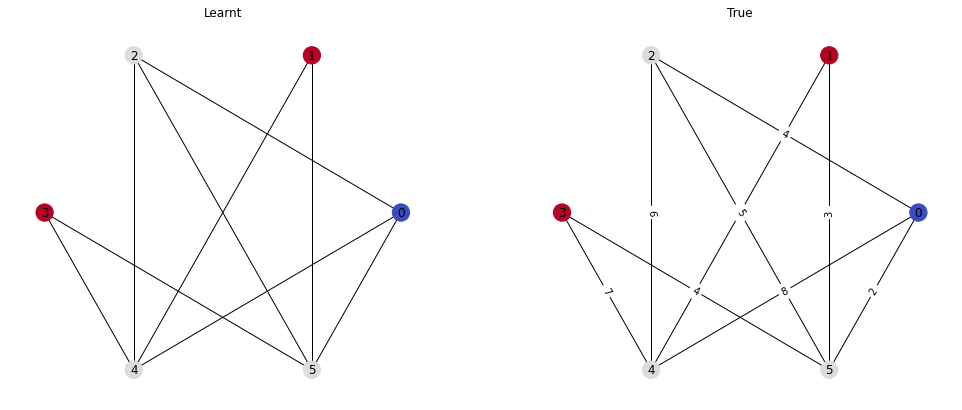

Passes: 3
tensor([1.0026, 1.0021, 2.0043, 3.0070, 2.0048, 1.0022, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 3., 2., 1., 0.], device='cuda:0')
Loss: 0.0032931226305663586	Similarity: 1.0


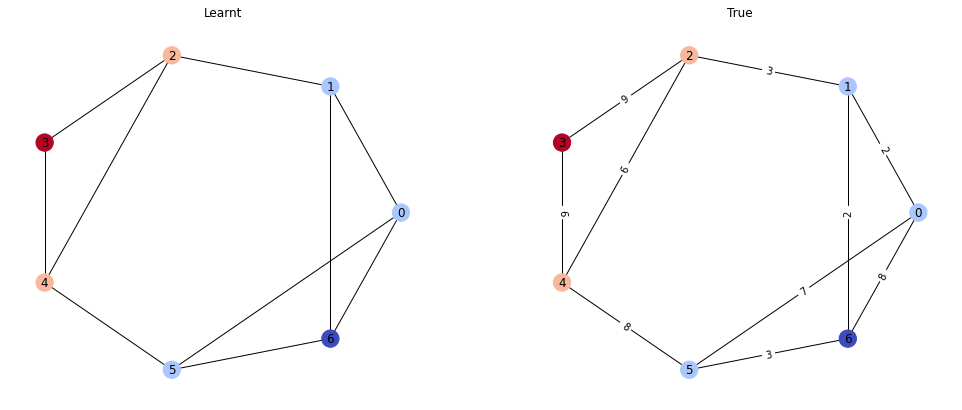

Passes: 2
tensor([0.0000, 1.0021, 1.0021, 1.0026, 1.0024, 1.0024, 2.0046],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0023274593986570835	Similarity: 1.0


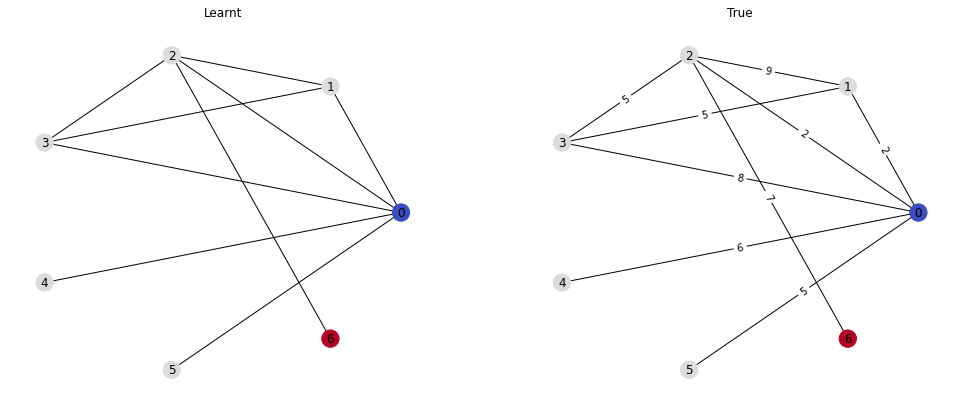

Passes: 2
tensor([1.0024, 2.0045, 1.0023, 0.0000, 1.0022, 1.0026, 2.0050],
       device='cuda:0')
tensor([1., 2., 1., 0., 1., 1., 2.], device='cuda:0')
Loss: 0.0027001246344298124	Similarity: 1.0


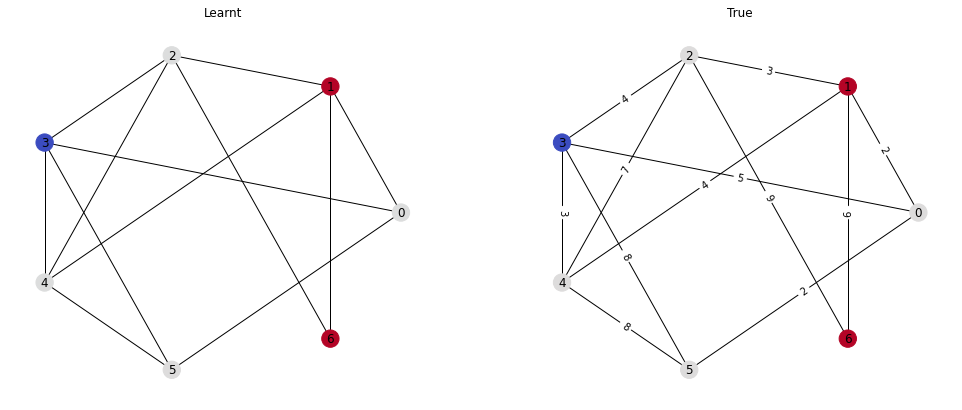

Passes: 2
tensor([1.0023, 1.0025, 1.0025, 0.0000, 2.0044, 1.0025, 1.0023],
       device='cuda:0')
tensor([1., 1., 1., 0., 2., 1., 1.], device='cuda:0')
Loss: 0.0023626089096069336	Similarity: 1.0


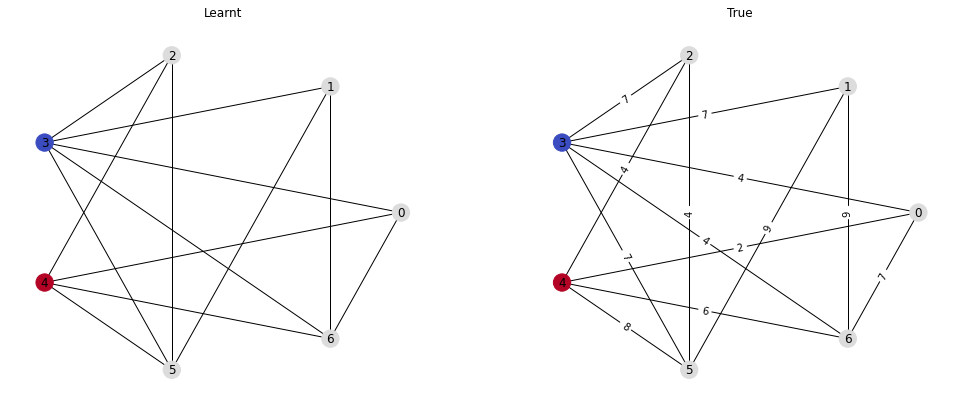

Passes: 3
tensor([2.0047, 3.0078, 2.0052, 3.0073, 0.0000, 1.0026, 2.0050],
       device='cuda:0')
tensor([2., 3., 2., 3., 0., 1., 2.], device='cuda:0')
Loss: 0.004668866284191608	Similarity: 1.0


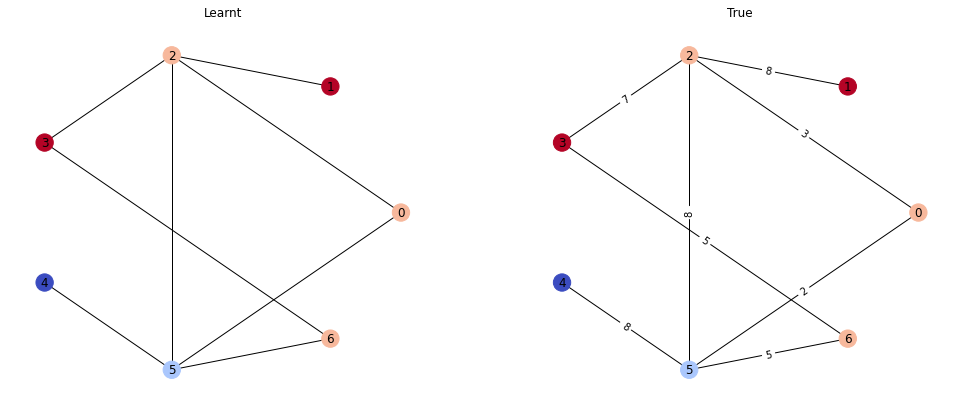

Passes: 1
tensor([0.0000, 1.0023, 1.0025, 1.0025, 1.0023, 1.0022, 1.0026],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.002060243161395192	Similarity: 1.0


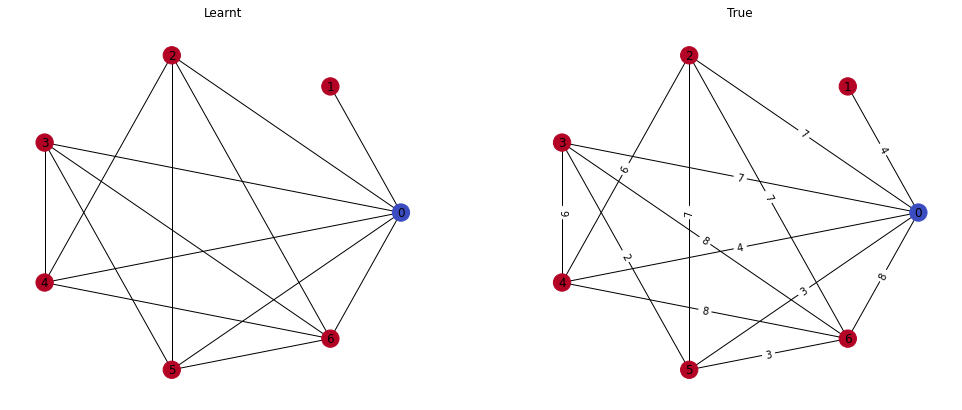

Passes: 2
tensor([1.0022, 1.0025, 1.0024, 0.0000, 2.0046, 2.0046, 2.0050],
       device='cuda:0')
tensor([1., 1., 1., 0., 2., 2., 2.], device='cuda:0')
Loss: 0.0030376401264220476	Similarity: 1.0


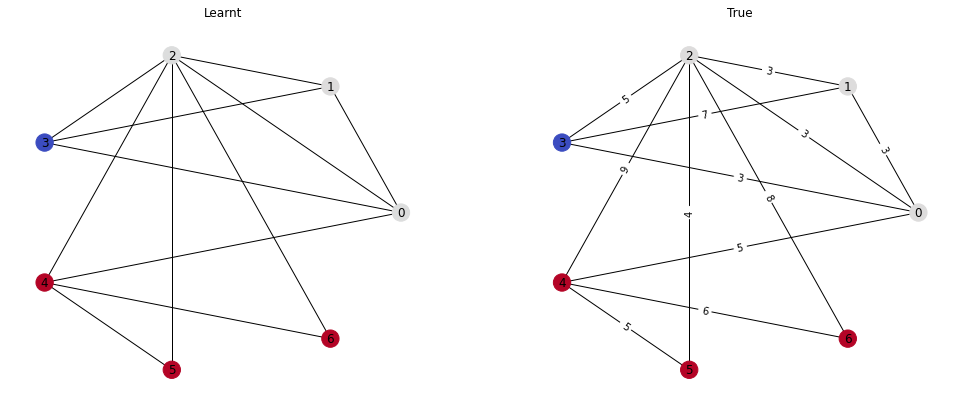

Passes: 2
tensor([0.0000, 1.0022, 2.0047, 1.0023, 1.0021, 2.0042, 1.0024],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 2., 1.], device='cuda:0')
Loss: 0.0025595256593078375	Similarity: 1.0


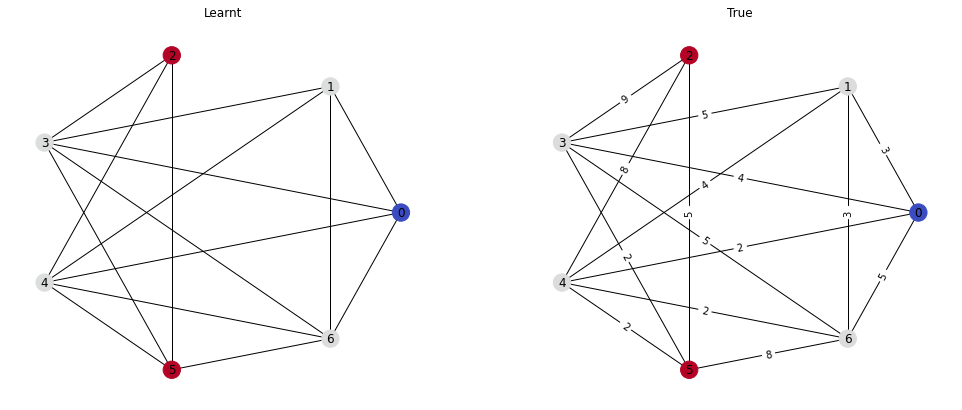

Passes: 2
tensor([2.0045, 1.0026, 0.0000, 2.0050, 1.0023, 1.0027, 2.0047],
       device='cuda:0')
tensor([2., 1., 0., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.003107939613983035	Similarity: 1.0


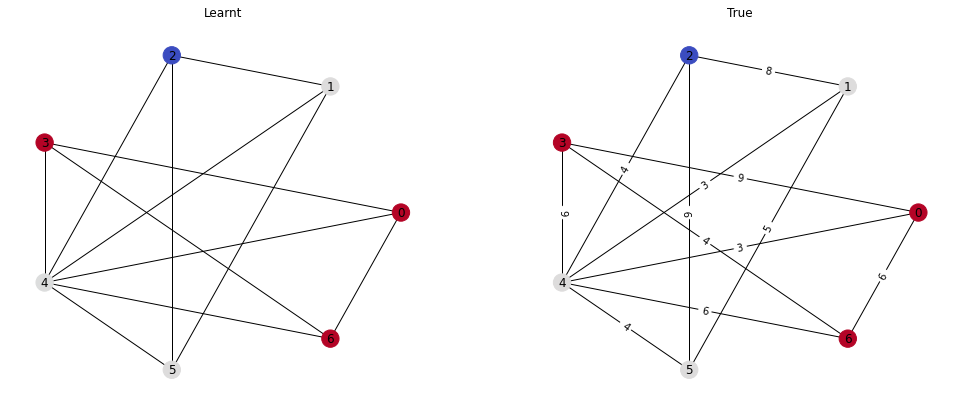

Passes: 2
tensor([2.0046, 1.0022, 2.0045, 2.0043, 2.0046, 2.0049, 0.0000],
       device='cuda:0')
tensor([2., 1., 2., 2., 2., 2., 0.], device='cuda:0')
Loss: 0.0035720723681151867	Similarity: 1.0


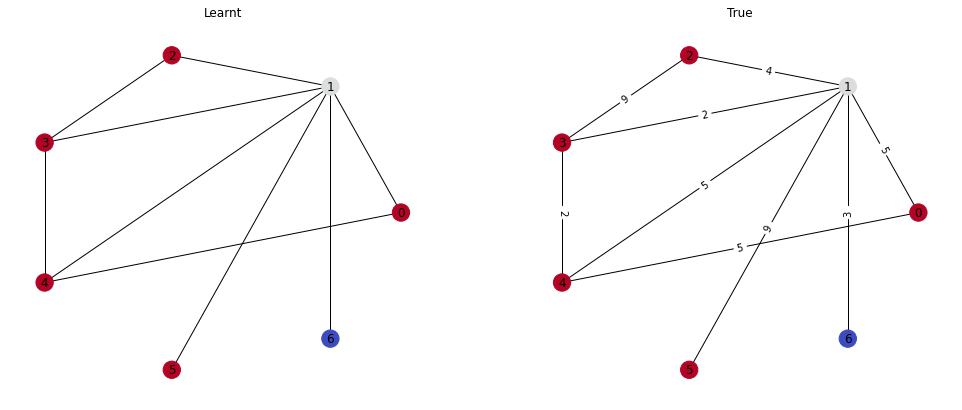

Passes: 3
tensor([3.0067, 2.0050, 2.0045, 3.0069, 2.0046, 1.0023, 0.0000],
       device='cuda:0')
tensor([3., 2., 2., 3., 2., 1., 0.], device='cuda:0')
Loss: 0.004282219335436821	Similarity: 1.0


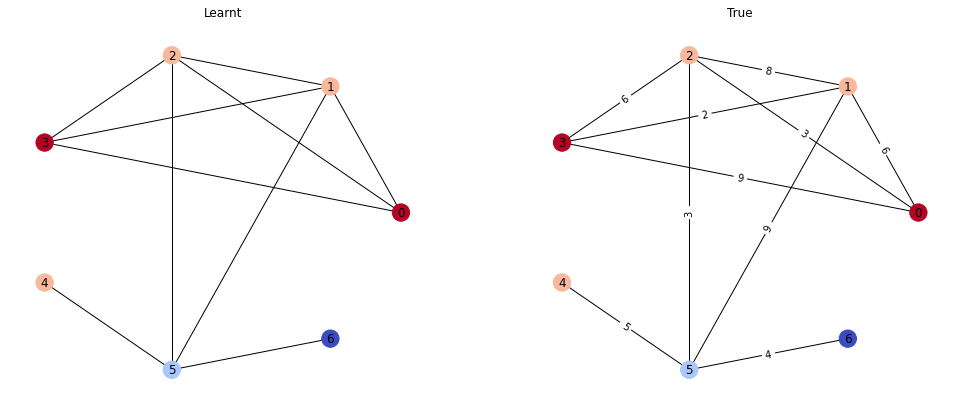

Passes: 3
tensor([1.0022, 0.0000, 1.0022, 1.0025, 3.0071, 1.0024, 2.0048],
       device='cuda:0')
tensor([1., 0., 1., 1., 3., 1., 2.], device='cuda:0')
Loss: 0.003037623129785061	Similarity: 1.0


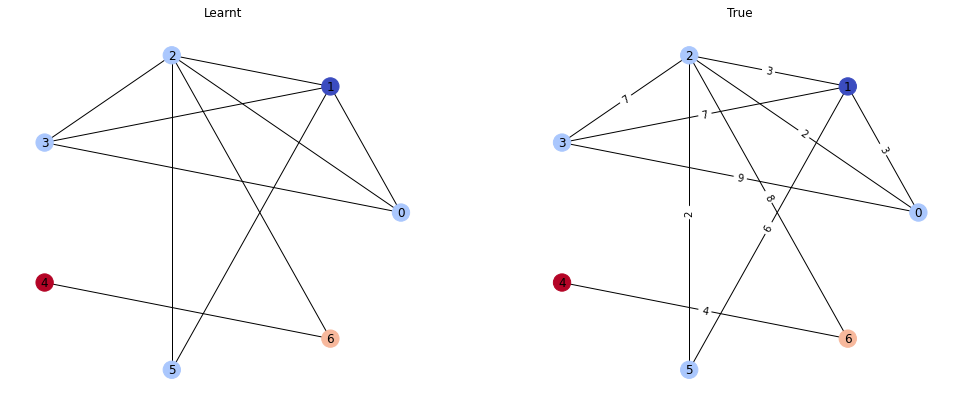

Passes: 3
tensor([1.0027, 2.0051, 0.0000, 1.0024, 2.0054, 2.0054, 3.0077],
       device='cuda:0')
tensor([1., 2., 0., 1., 2., 2., 3.], device='cuda:0')
Loss: 0.004099301062524319	Similarity: 1.0


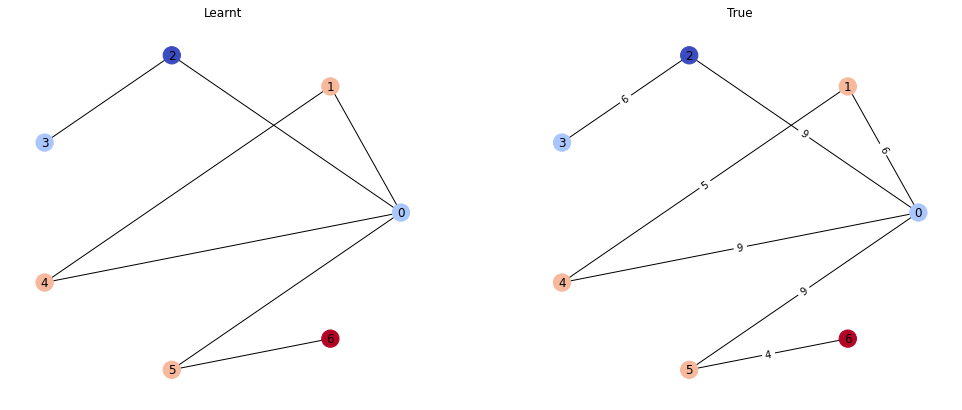

Passes: 2
tensor([2.0046, 1.0025, 1.0021, 0.0000, 1.0023, 2.0046, 2.0044],
       device='cuda:0')
tensor([2., 1., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.00294390763156116	Similarity: 1.0


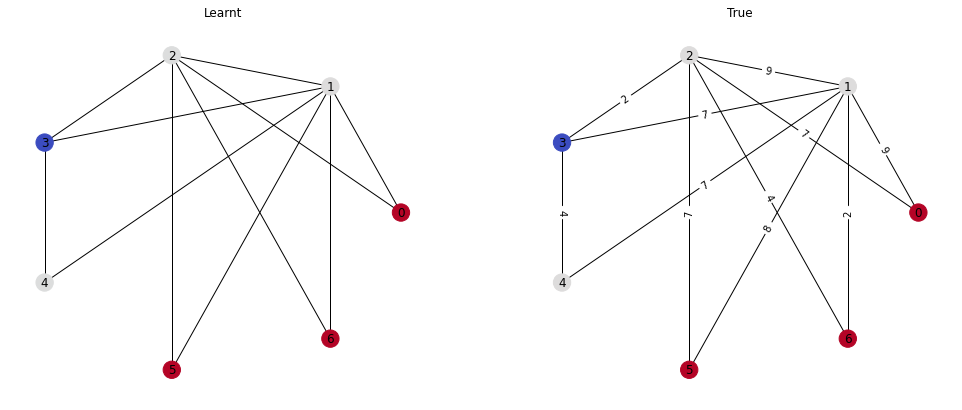

Passes: 3
tensor([1.0024, 0.0000, 1.0024, 2.0049, 2.0050, 2.0047, 3.0076],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 2., 3.], device='cuda:0')
Loss: 0.003853253088891506	Similarity: 1.0


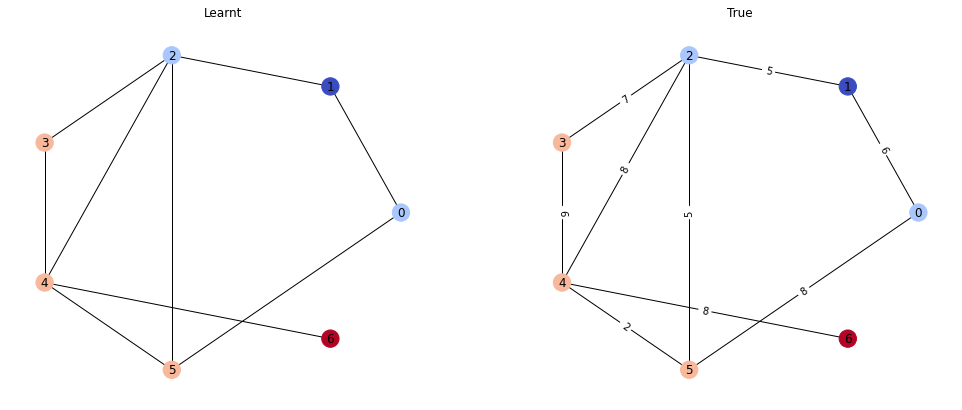

Passes: 3
tensor([3.0068, 0.0000, 1.0024, 1.0022, 2.0045, 2.0049, 2.0046],
       device='cuda:0')
tensor([3., 0., 1., 1., 2., 2., 2.], device='cuda:0')
Loss: 0.0036189216189086437	Similarity: 1.0


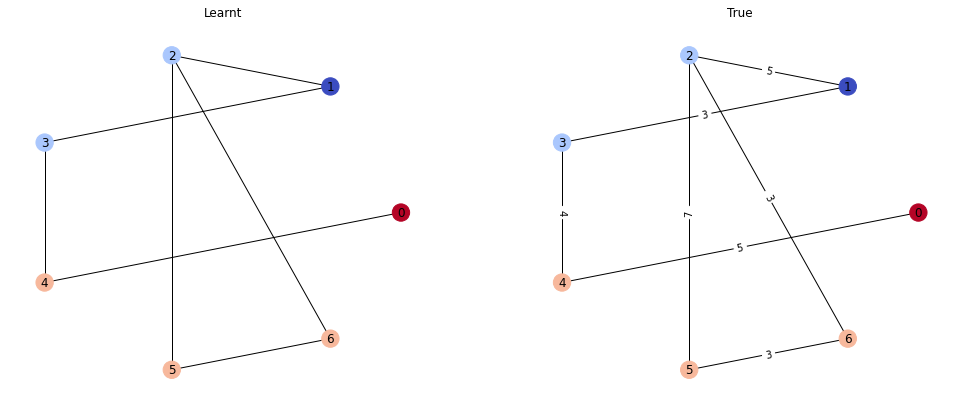

Passes: 3
tensor([0.0000, 1.0023, 2.0049, 3.0071, 2.0049, 1.0027, 3.0074],
       device='cuda:0')
tensor([0., 1., 2., 3., 2., 1., 3.], device='cuda:0')
Loss: 0.004179035313427448	Similarity: 1.0


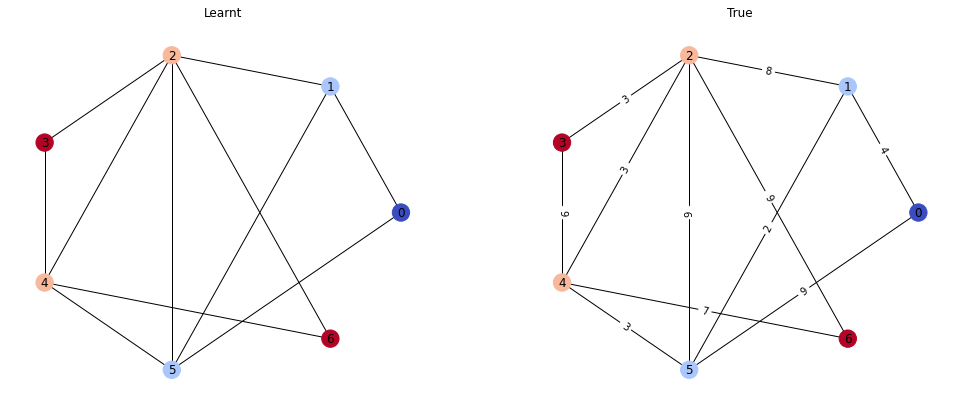

Passes: 2
tensor([1.0021, 0.0000, 1.0024, 2.0049, 1.0027, 2.0045], device='cuda:0')
tensor([1., 0., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.0027700464706867933	Similarity: 1.0


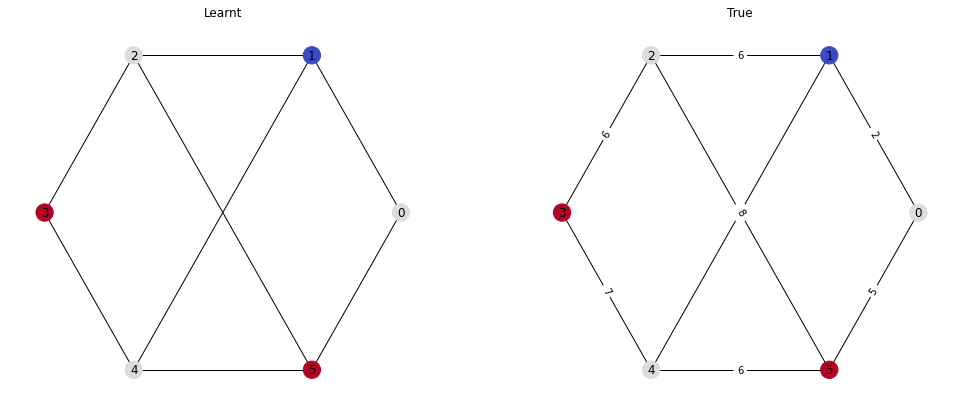

Avg loss 0.0034369676009111424
Std loss 0.006053326384126494
Avg similarity 0.9996401583303347
Std similarity 0.007160758813289817


In [ ]:
# TRAIN - weighted
test(train_loader, best_model, decimals=0, plot=True)

In [ ]:
# TEST
test(test_loader, best_model, decimals=0, plot=False)

Avg loss 0.00671290619764477
Std loss 0.021017379228457343
Avg similarity 0.9957142857142859
Std similarity 0.02436960301318855


Passes: 2
tensor([1.0024, 0.0000, 1.0023, 2.0046, 1.0023, 2.0045, 2.0047],
       device='cuda:0')
tensor([1., 0., 1., 2., 1., 2., 2.], device='cuda:0')
Loss: 0.00295562413521111	Similarity: 1.0


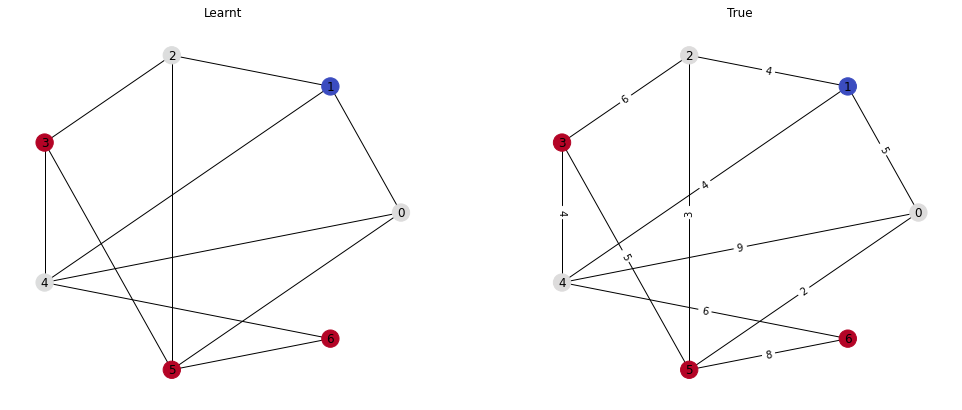

Passes: 2
tensor([2.0051, 2.0050, 1.0026, 0.0000, 1.0021, 2.0046, 1.0027],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.003143089357763529	Similarity: 1.0


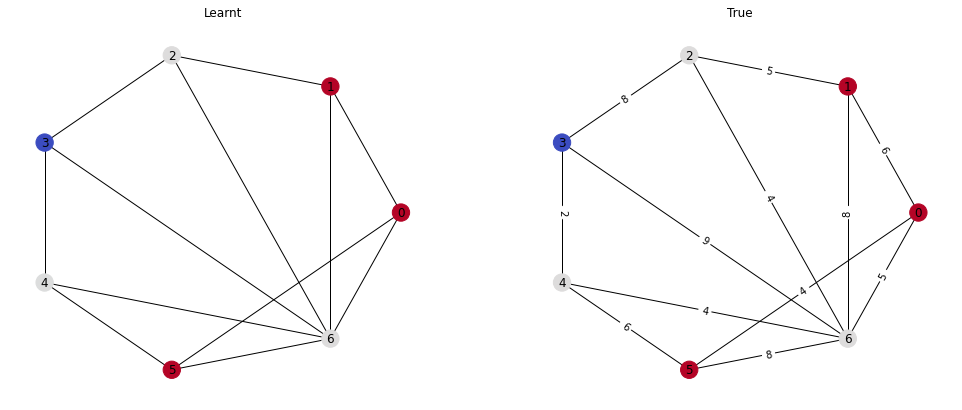

Passes: 1
tensor([1.0024, 1.0026, 0.0000, 1.0022, 1.0026, 1.0022, 1.0024],
       device='cuda:0')
tensor([1., 1., 0., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.002060243161395192	Similarity: 1.0


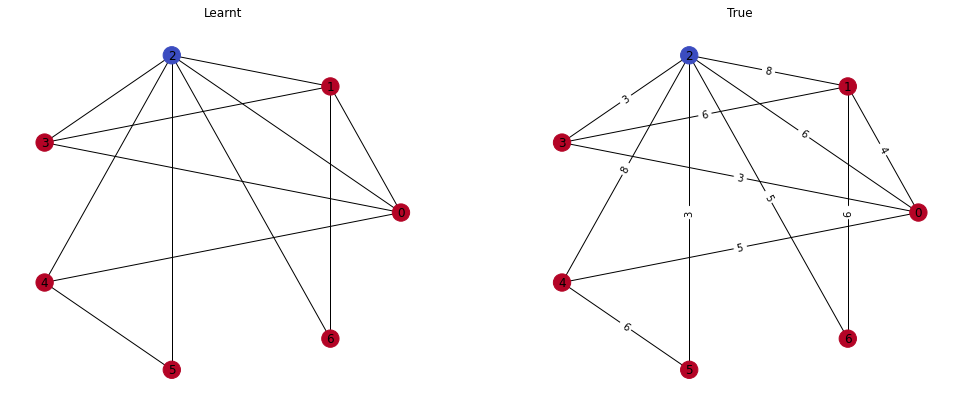

Passes: 2
tensor([0.0000, 1.0027, 2.0047, 1.0023, 1.0024, 1.0024, 1.0026],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.002444624900817871	Similarity: 1.0


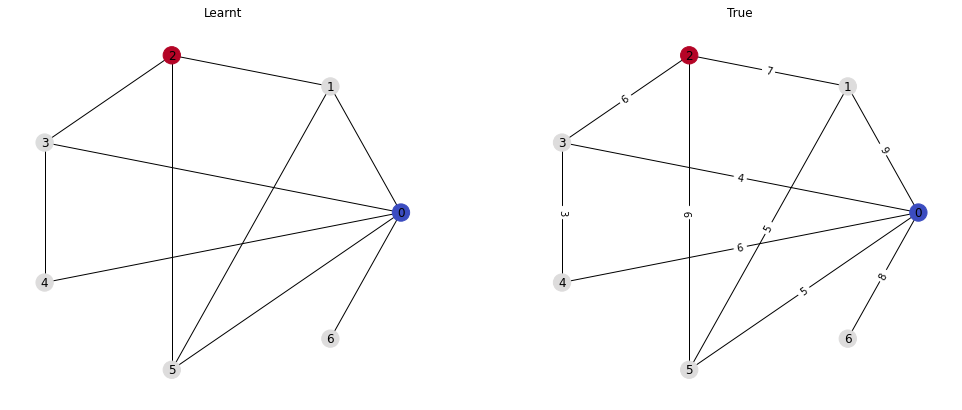

Passes: 2
tensor([2.0043, 2.0045, 0.0000, 1.0022, 2.0044, 1.0023, 1.0021],
       device='cuda:0')
tensor([2., 2., 0., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.002826741896569729	Similarity: 1.0


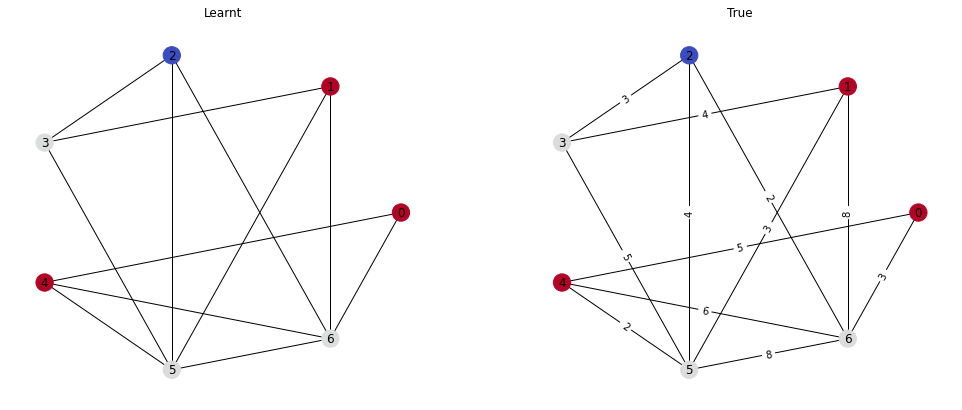

Passes: 3
tensor([3.0073, 2.0047, 2.0049, 1.0024, 0.0000, 1.0024, 2.0051],
       device='cuda:0')
tensor([3., 2., 2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0038181033451110125	Similarity: 1.0


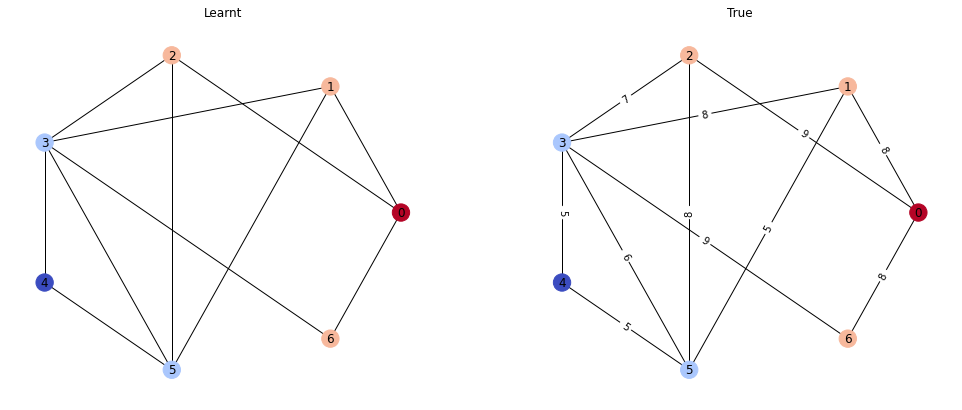

Passes: 3
tensor([2.0046, 0.0000, 1.0027, 1.0021, 2.0042, 3.0067, 2.0049],
       device='cuda:0')
tensor([2., 0., 1., 1., 2., 3., 2.], device='cuda:0')
Loss: 0.0036072051152586937	Similarity: 1.0


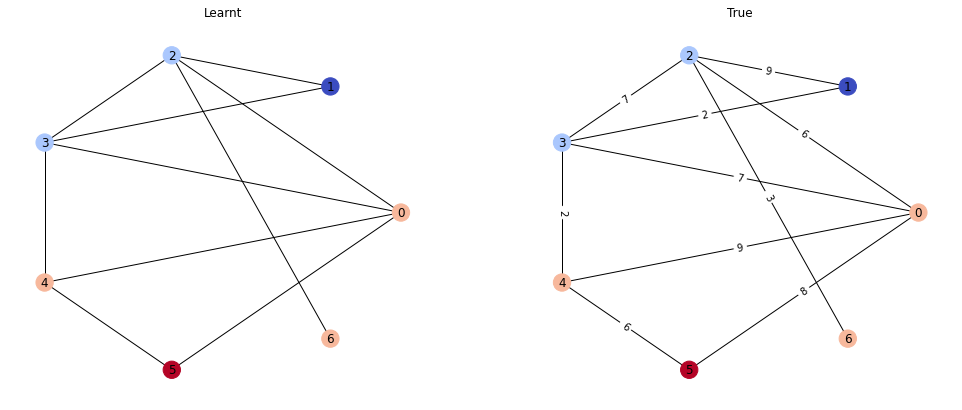

Passes: 4
tensor([1.0021, 3.0067, 2.0045, 2.0047, 1.0024, 0.0000, 4.0091],
       device='cuda:0')
tensor([1., 3., 2., 2., 1., 0., 4.], device='cuda:0')
Loss: 0.004211937077343464	Similarity: 1.0


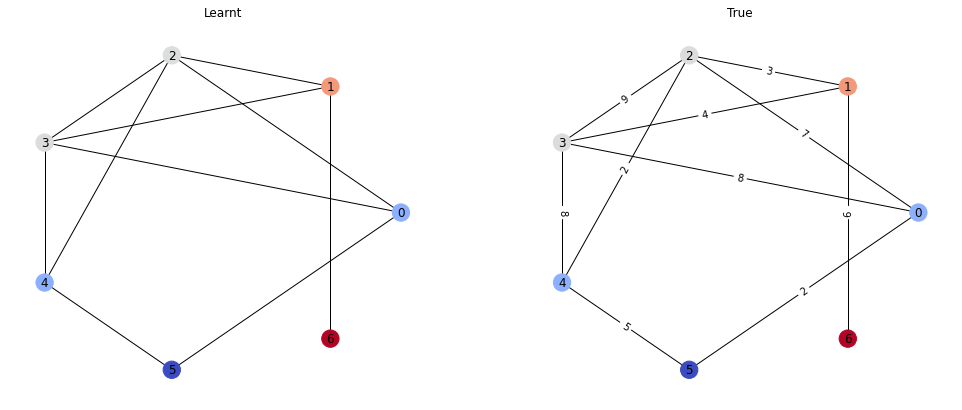

Passes: 2
tensor([1.0022, 2.0045, 2.0049, 2.0048, 0.0000, 2.0048], device='cuda:0')
tensor([1., 2., 2., 2., 0., 2.], device='cuda:0')
Loss: 0.0035302441101521254	Similarity: 1.0


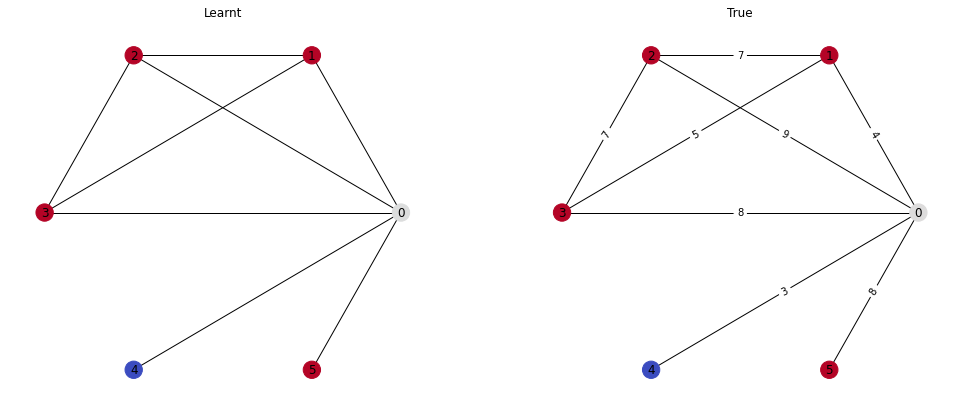

Passes: 2
tensor([1.0024, 1.0022, 1.0024, 1.0021, 0.0000, 1.0023, 2.0047],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0022923096548765898	Similarity: 1.0


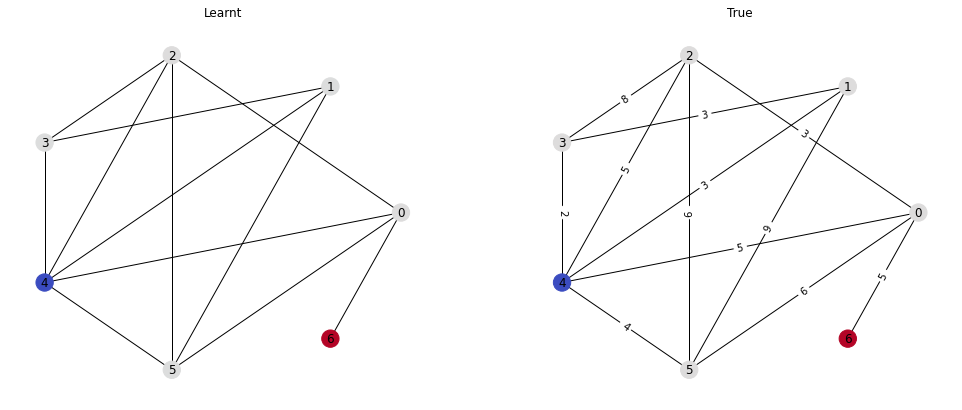

Passes: 3
tensor([0.0000, 1.0025, 2.0051, 1.0021, 1.0025, 3.0076, 3.0073],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 3., 3.], device='cuda:0')
Loss: 0.003888385836035013	Similarity: 1.0


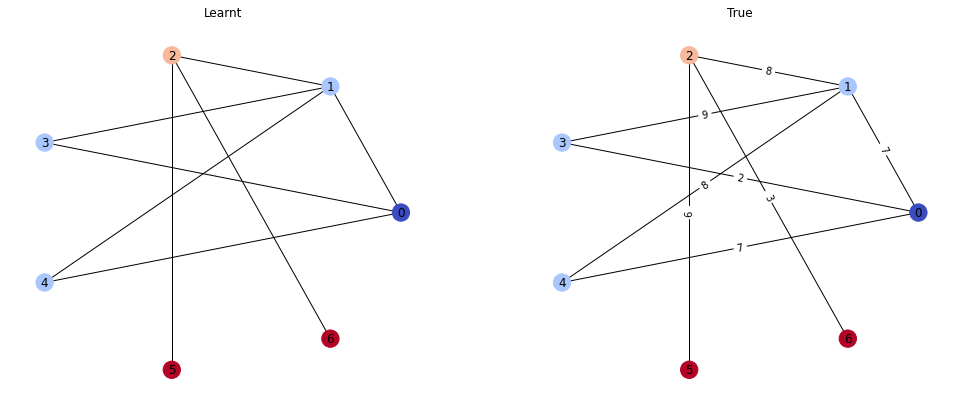

Passes: 2
tensor([1.0027, 1.0023, 1.0027, 1.0021, 2.0044, 0.0000, 2.0046],
       device='cuda:0')
tensor([1., 1., 1., 1., 2., 0., 2.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


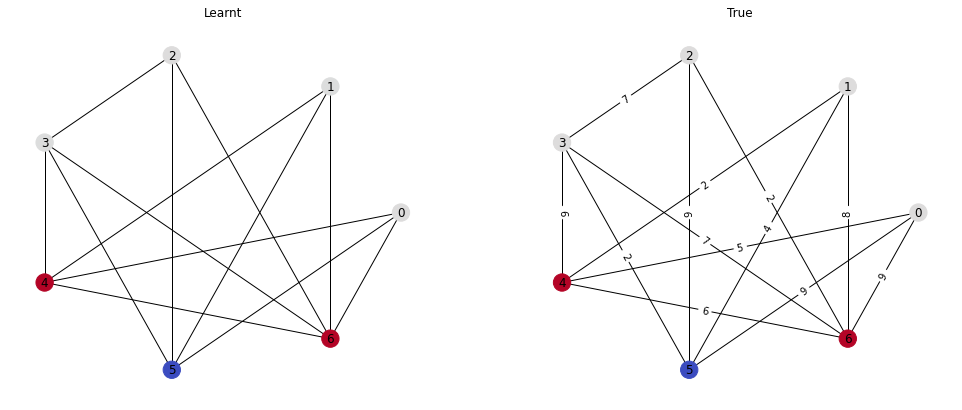

Passes: 2
tensor([1.0027, 1.0026, 2.0049, 2.0048, 2.0051, 2.0052, 0.0000],
       device='cuda:0')
tensor([1., 1., 2., 2., 2., 2., 0.], device='cuda:0')
Loss: 0.0036094870883971453	Similarity: 1.0


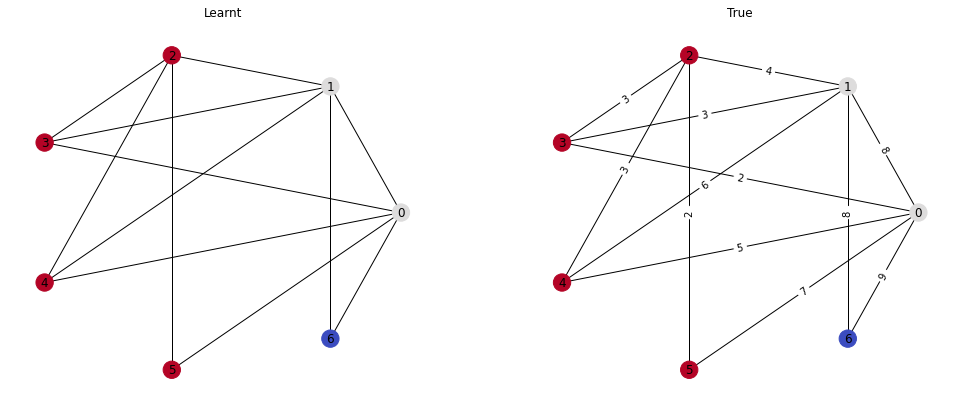

Passes: 2
tensor([1.0026, 1.0021, 1.0024, 2.0042, 1.0021, 2.0042, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 2., 1., 2., 0.], device='cuda:0')
Loss: 0.0025360926520079374	Similarity: 1.0


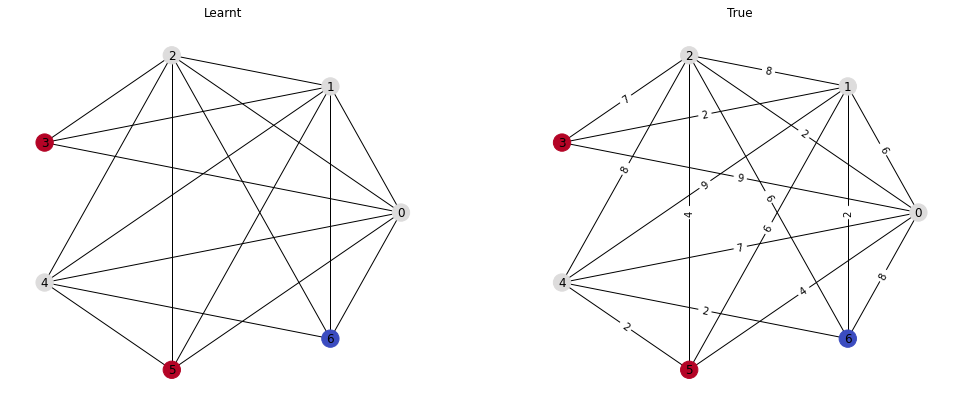

Passes: 2
tensor([1.0021, 1.0024, 0.0000, 1.0024, 2.0046, 1.0025, 2.0048],
       device='cuda:0')
tensor([1., 1., 0., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.0026884081307798624	Similarity: 1.0


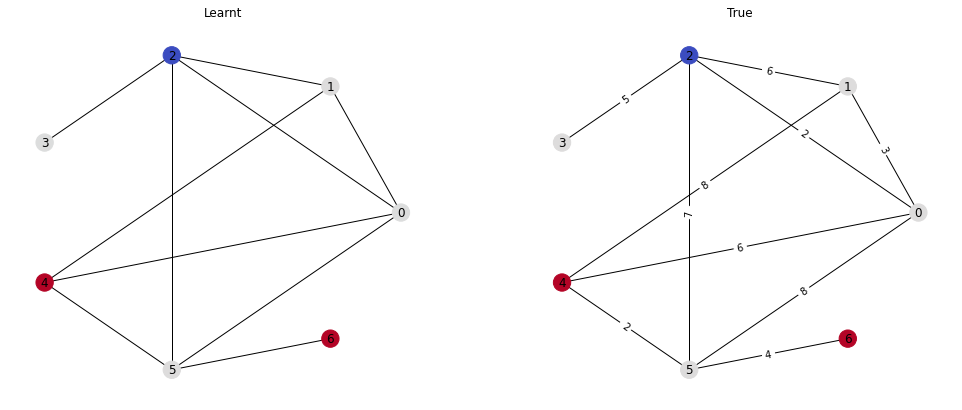

Passes: 2
tensor([2.0049, 1.0027, 2.0049, 1.0021, 0.0000, 1.0024, 2.0053],
       device='cuda:0')
tensor([2., 1., 2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0031782391015440226	Similarity: 1.0


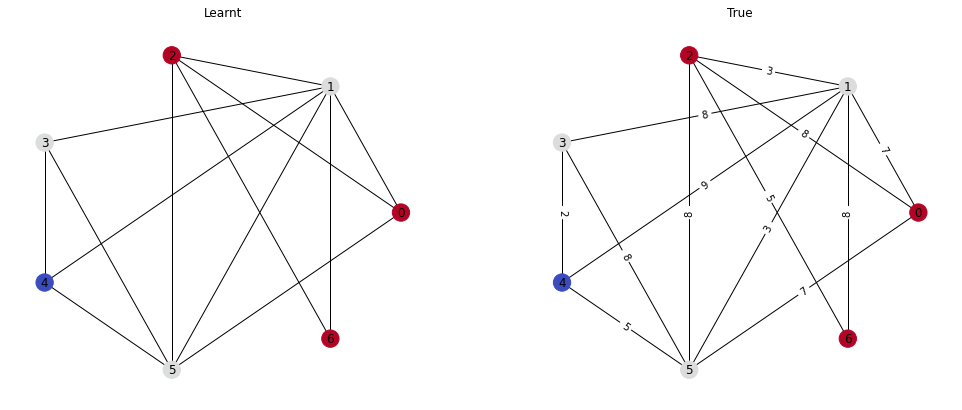

Passes: 2
tensor([2.0048, 2.0048, 1.0024, 0.0000, 1.0027, 1.0024, 1.0025],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 1., 1.], device='cuda:0')
Loss: 0.00280557363294065	Similarity: 1.0


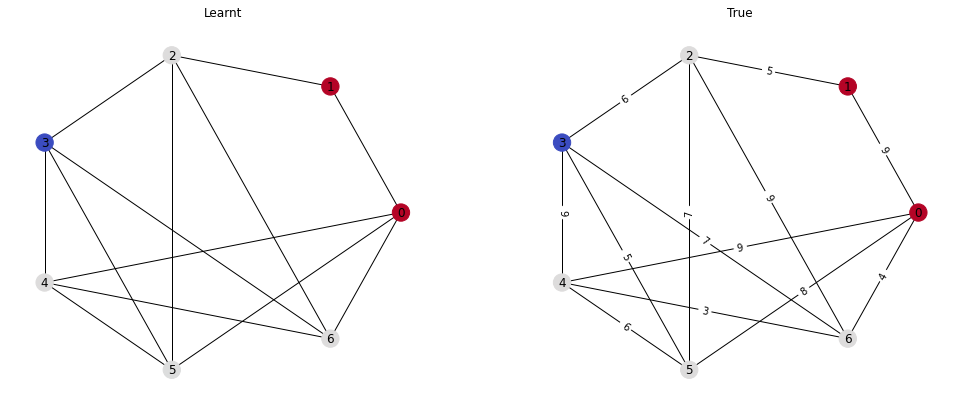

Passes: 2
tensor([0.0000, 1.0021, 1.0027, 1.0021, 1.0024, 1.0023, 2.0052],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.002409475389868021	Similarity: 1.0


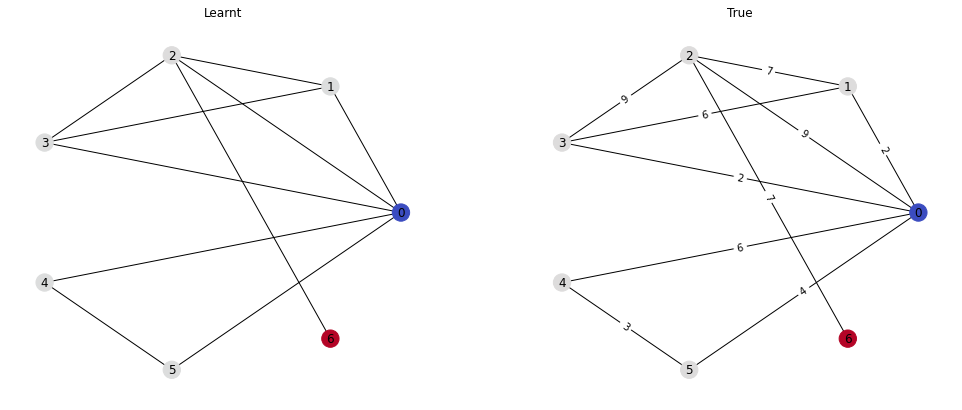

Passes: 2
tensor([0.0000, 2.0046, 2.0045, 2.0048, 1.0022, 1.0025], device='cuda:0')
tensor([0., 2., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.0030954680405557156	Similarity: 1.0


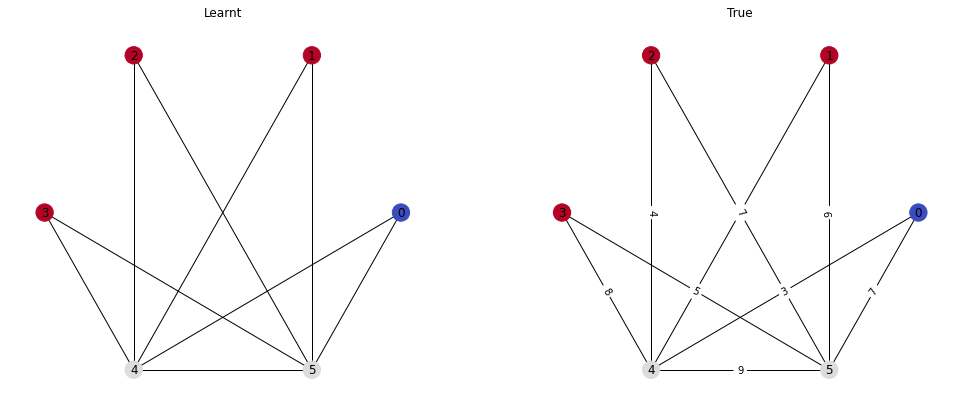

Passes: 2
tensor([1.0025, 1.0024, 2.0047, 2.0047, 0.0000, 1.0024, 1.0021],
       device='cuda:0')
tensor([1., 1., 2., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.0027001246344298124	Similarity: 1.0


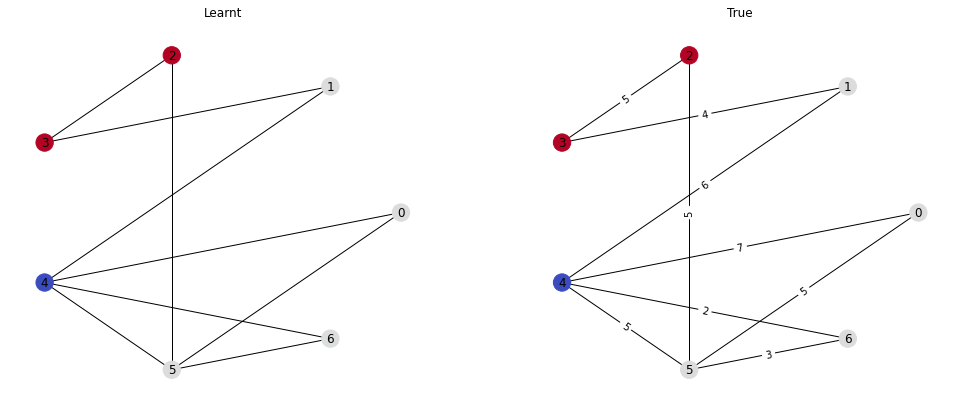

Passes: 5
tensor([0.0000, 2.0044, 3.0067, 4.0093, 4.1073, 1.0021, 1.0024],
       device='cuda:0')
tensor([0., 2., 3., 4., 5., 1., 1.], device='cuda:0')
Loss: 0.13108491897583008	Similarity: 0.8571428571428571


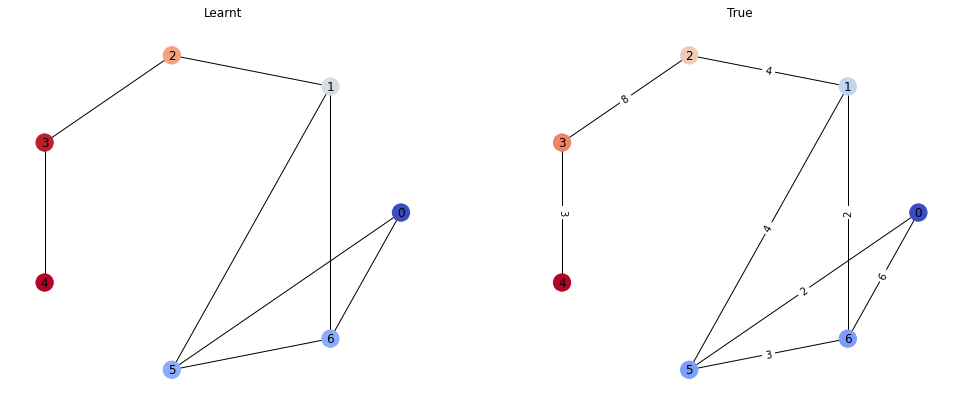

Passes: 2
tensor([1.0024, 2.0046, 0.0000, 1.0023, 2.0045, 1.0024], device='cuda:0')
tensor([1., 2., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.002674361225217581	Similarity: 1.0


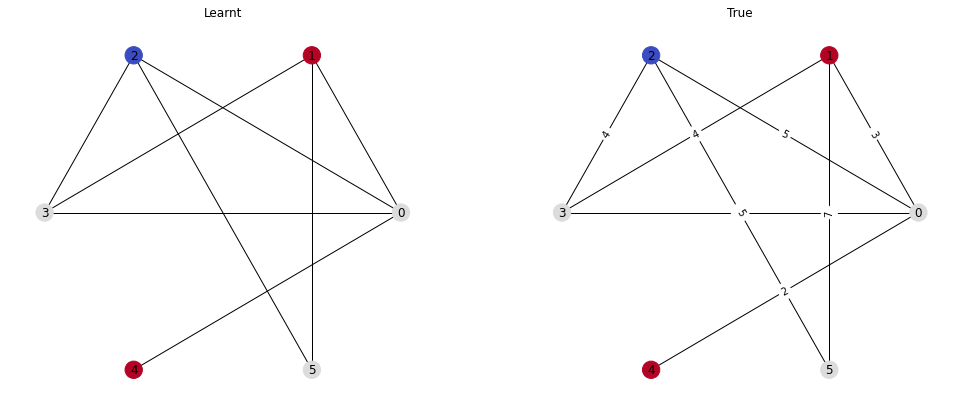

Passes: 2
tensor([0.0000, 2.0050, 2.0045, 2.0044, 1.0021, 1.0027, 1.0023],
       device='cuda:0')
tensor([0., 2., 2., 2., 1., 1., 1.], device='cuda:0')
Loss: 0.002990773878991604	Similarity: 1.0


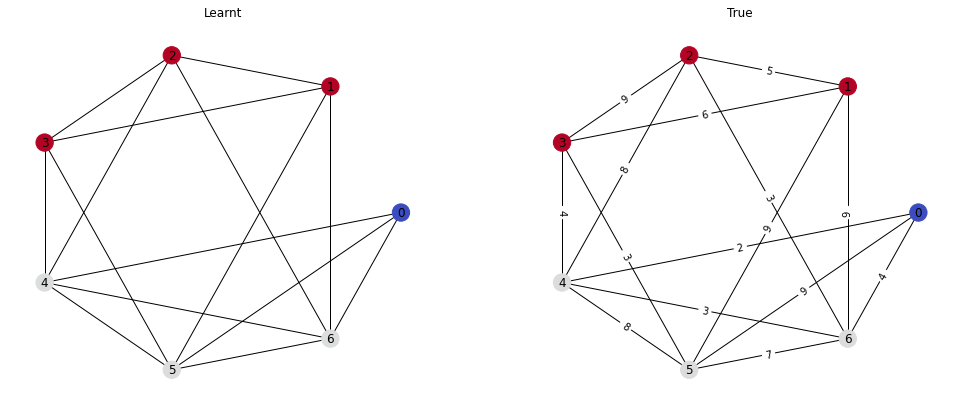

Passes: 3
tensor([1.0024, 0.0000, 1.0027, 3.0072, 1.0022, 2.0046, 2.0050],
       device='cuda:0')
tensor([1., 0., 1., 3., 1., 2., 2.], device='cuda:0')
Loss: 0.0034220051020383835	Similarity: 1.0


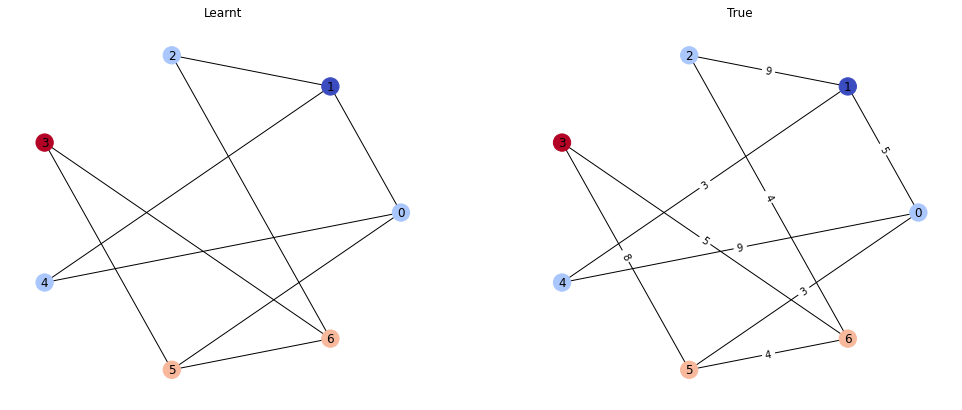

Passes: 4
tensor([1.0025, 2.0051, 3.0073, 0.0000, 2.0049, 4.0095, 4.0097],
       device='cuda:0')
tensor([1., 2., 3., 0., 2., 4., 4.], device='cuda:0')
Loss: 0.0055525475181639194	Similarity: 1.0


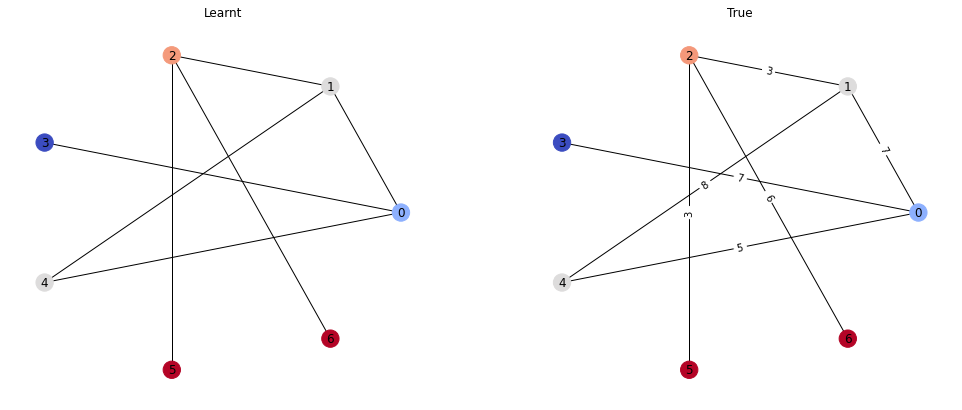

Passes: 2
tensor([0.0000, 1.0022, 2.0046, 1.0021, 1.0023, 1.0027, 2.0048],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0026766913942992687	Similarity: 1.0


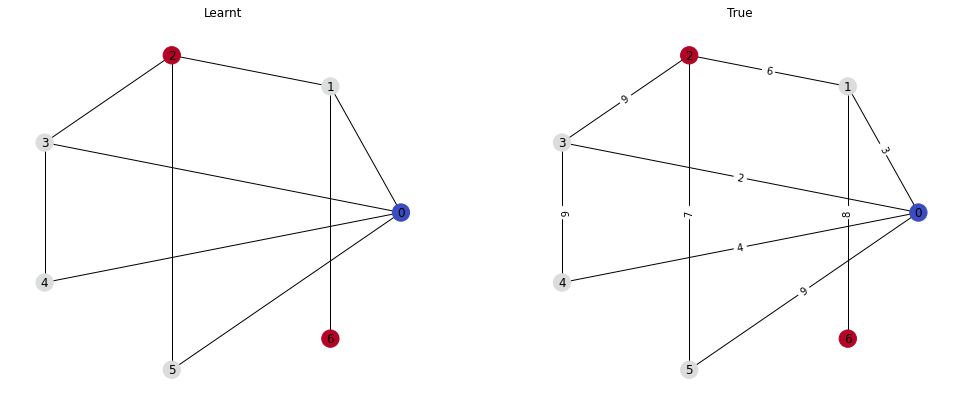

Passes: 2
tensor([0.0000, 2.0045, 1.0023, 1.0023, 2.0045, 1.0024, 2.0051],
       device='cuda:0')
tensor([0., 2., 1., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.0030142071191221476	Similarity: 1.0


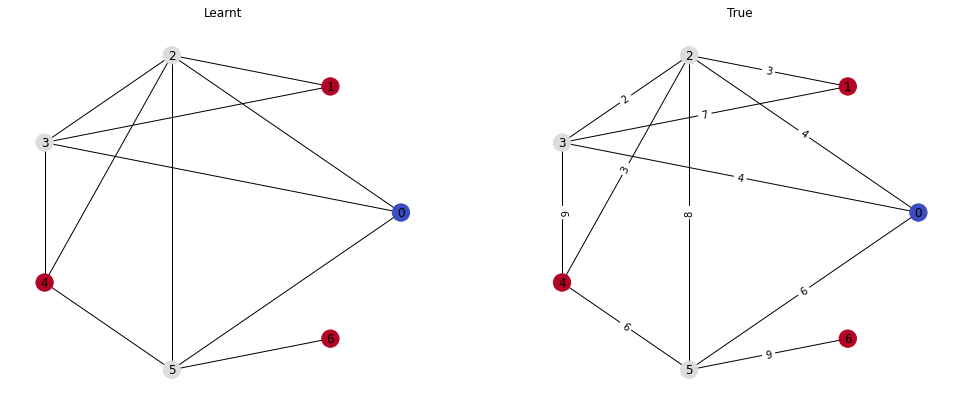

Passes: 4
tensor([0.0000, 1.0026, 2.0052, 3.0075, 4.0097, 2.0051, 3.0074],
       device='cuda:0')
tensor([0., 1., 2., 3., 4., 2., 3.], device='cuda:0')
Loss: 0.005355613771826029	Similarity: 1.0


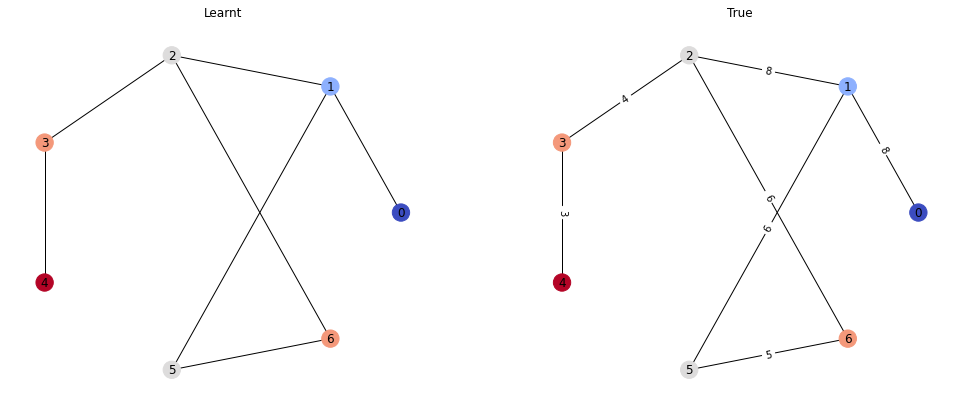

Passes: 2
tensor([1.0021, 0.0000, 1.0022, 1.0022, 1.0022, 2.0048], device='cuda:0')
tensor([1., 0., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.002253254409879446	Similarity: 1.0


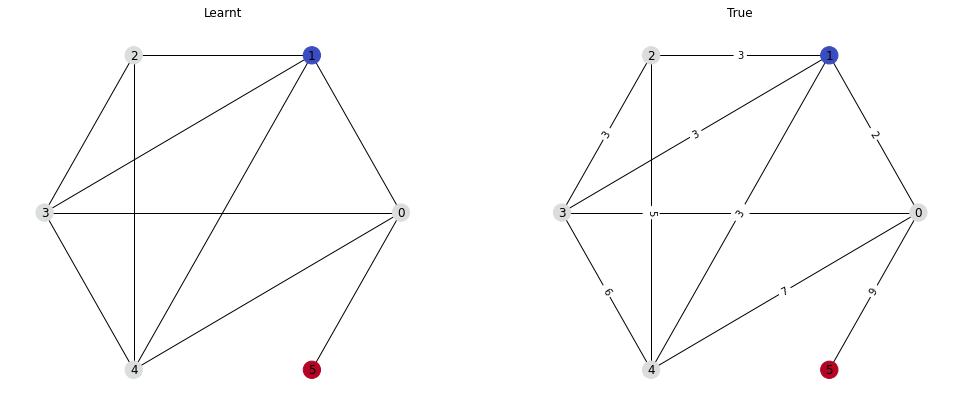

Passes: 2
tensor([2.0046, 1.0025, 0.0000, 1.0022, 2.0047], device='cuda:0')
tensor([2., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.002818727632984519	Similarity: 1.0


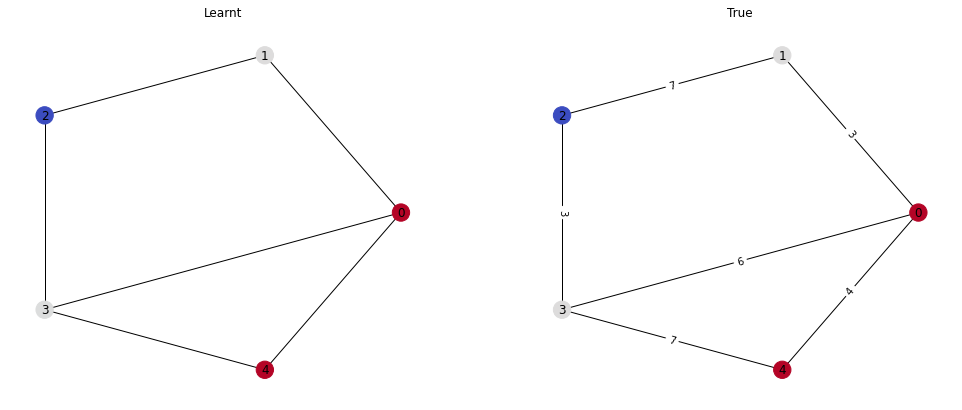

Passes: 2
tensor([1.0024, 2.0047, 1.0027, 2.0052, 2.0048, 0.0000, 1.0026],
       device='cuda:0')
tensor([1., 2., 1., 2., 2., 0., 1.], device='cuda:0')
Loss: 0.0032016721088439226	Similarity: 1.0


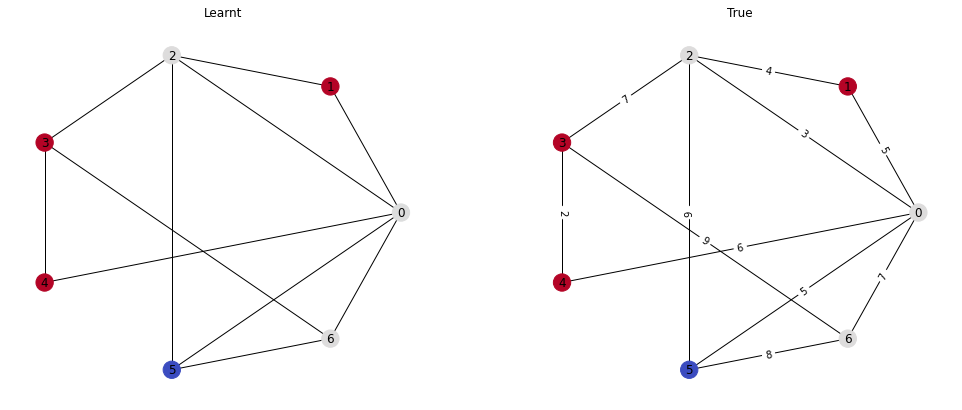

Passes: 2
tensor([2.0051, 2.0051, 1.0024, 2.0046, 2.0051, 2.0050, 0.0000],
       device='cuda:0')
tensor([2., 2., 1., 2., 2., 2., 0.], device='cuda:0')
Loss: 0.0039001363329589367	Similarity: 1.0


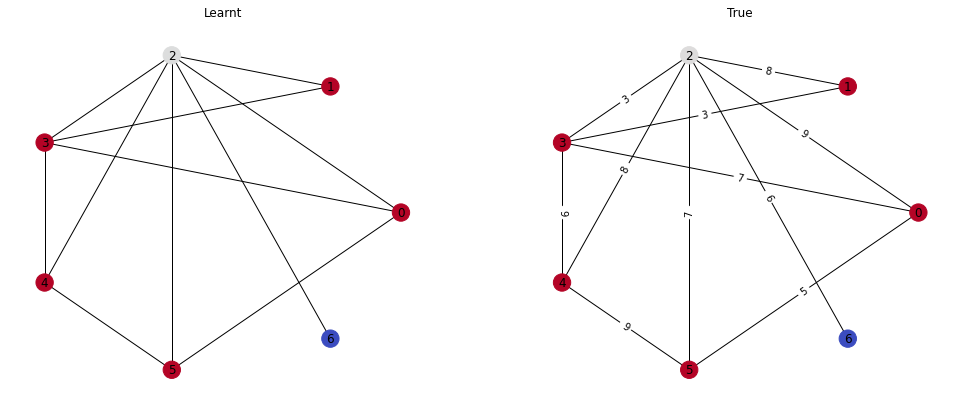

Passes: 2
tensor([0.0000, 2.0048, 2.0050, 2.0053, 2.0053, 1.0026, 1.0027],
       device='cuda:0')
tensor([0., 2., 2., 2., 2., 1., 1.], device='cuda:0')
Loss: 0.0036680700723081827	Similarity: 1.0


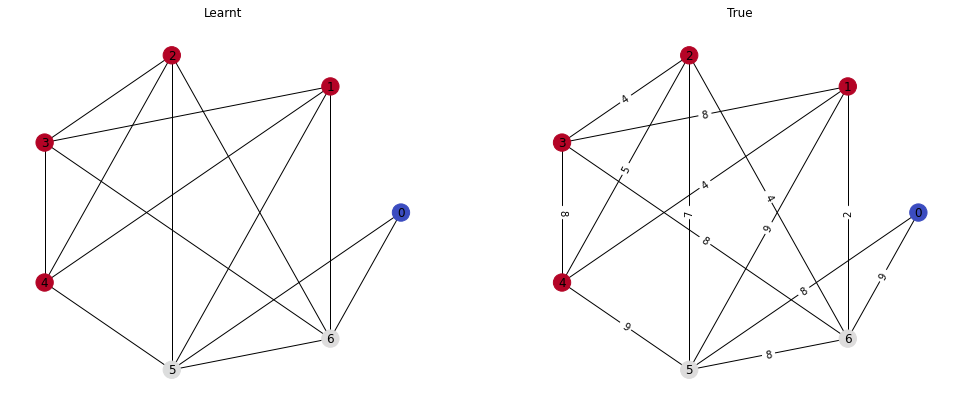

Passes: 3
tensor([3.0068, 1.0024, 2.0048, 2.0046, 3.0068, 2.0047, 0.0000],
       device='cuda:0')
tensor([3., 1., 2., 2., 3., 2., 0.], device='cuda:0')
Loss: 0.004293935839086771	Similarity: 1.0


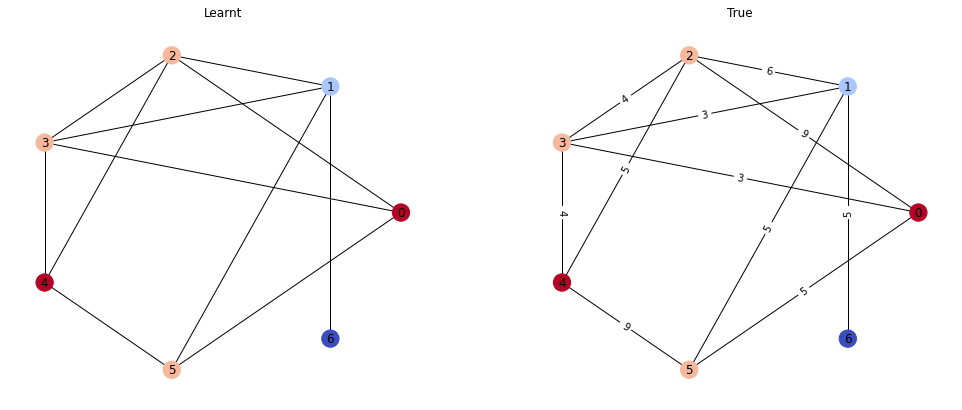

Passes: 3
tensor([0.0000, 3.0065, 1.0024, 1.0025, 2.0043, 1.0021, 1.0027],
       device='cuda:0')
tensor([0., 3., 1., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.0029438906349241734	Similarity: 1.0


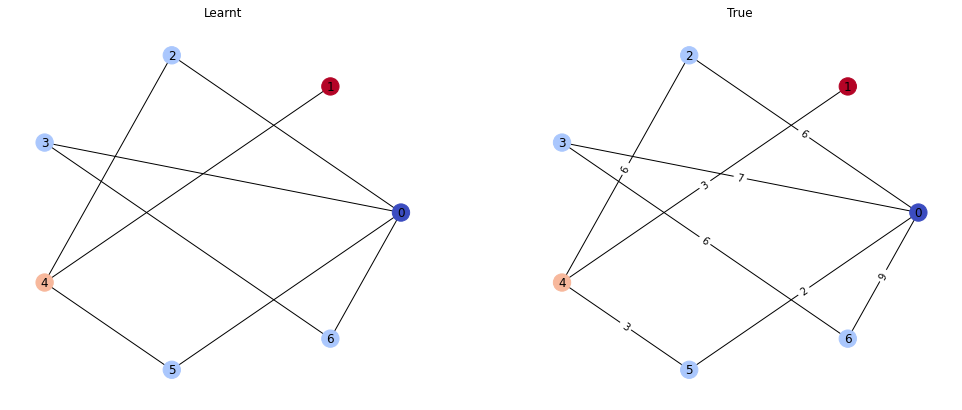

Passes: 2
tensor([0.0000, 1.0027, 2.0050, 1.0024, 1.0022, 1.0026, 2.0049],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0028172903694212437	Similarity: 1.0


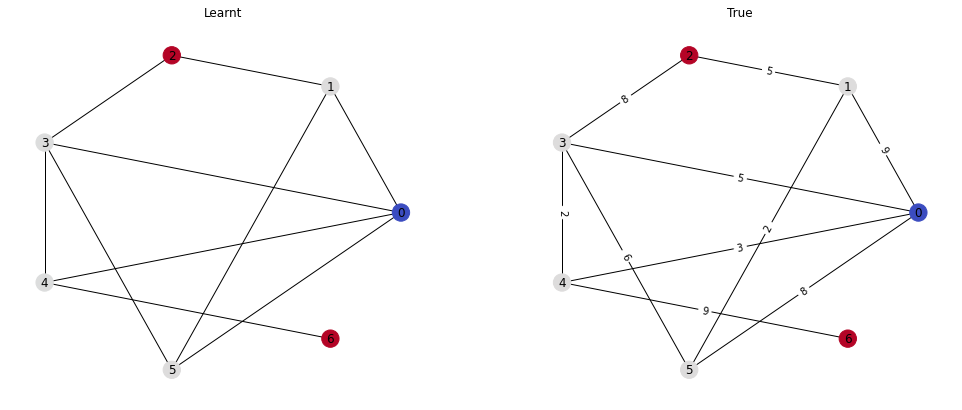

Passes: 2
tensor([1.0026, 2.0046, 2.0044, 1.0022, 1.0023, 0.0000, 1.0023],
       device='cuda:0')
tensor([1., 2., 2., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.002618108643218875	Similarity: 1.0


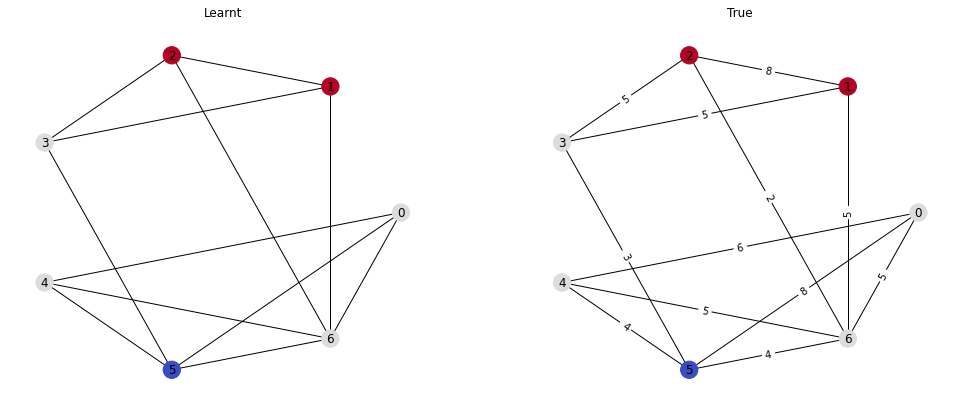

Passes: 4
tensor([1.0027, 2.0052, 2.0054, 3.0078, 2.0049, 0.0000, 3.1614],
       device='cuda:0')
tensor([1., 2., 2., 3., 2., 0., 4.], device='cuda:0')
Loss: 0.12351477891206741	Similarity: 0.8571428571428571


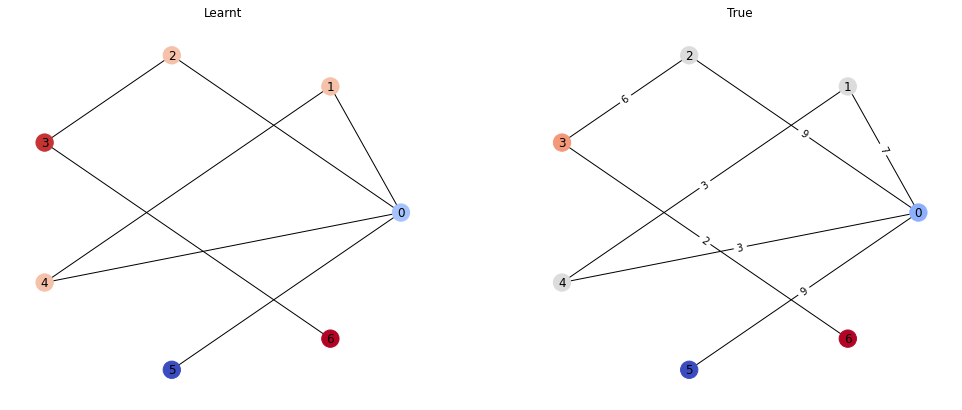

Passes: 3
tensor([2.0049, 1.0026, 0.0000, 1.0025, 2.0049, 3.0072, 3.0075],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 3., 3.], device='cuda:0')
Loss: 0.004225901328027248	Similarity: 1.0


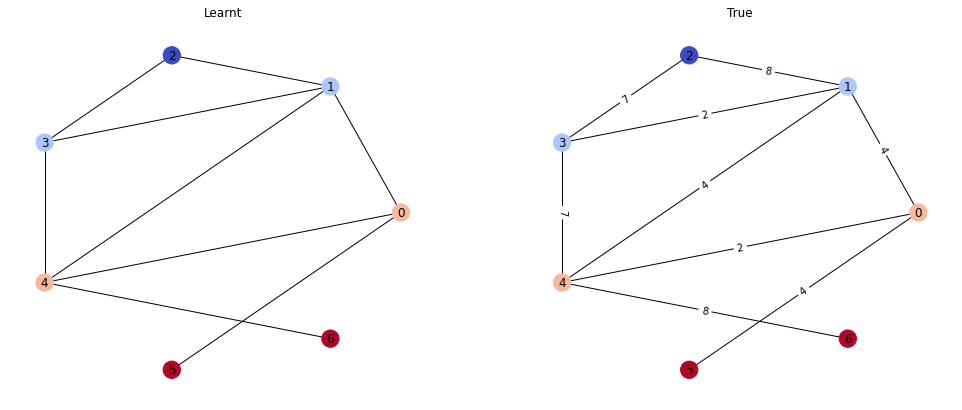

Passes: 1
tensor([0.0000, 1.0025, 1.0021, 1.0027, 1.0027, 1.0024, 1.0024],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.002118825912475586	Similarity: 1.0


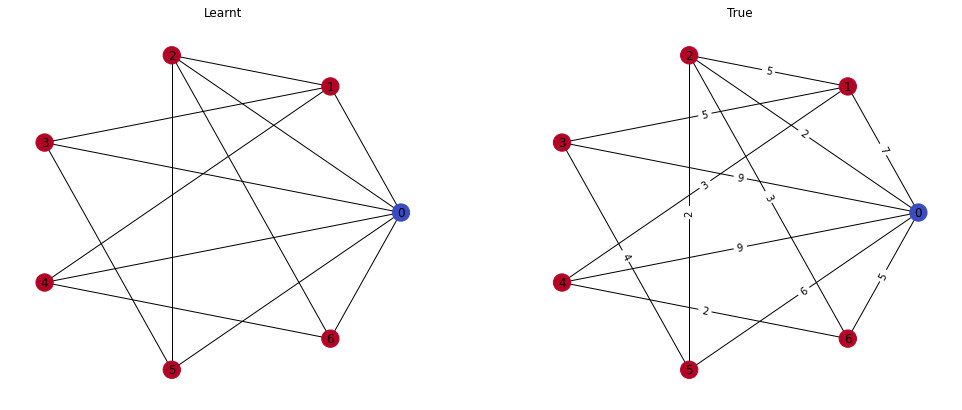

Passes: 2
tensor([2.0046, 0.0000, 1.0026, 1.0022, 1.0026], device='cuda:0')
tensor([2., 0., 1., 1., 1.], device='cuda:0')
Loss: 0.002395415445789695	Similarity: 1.0


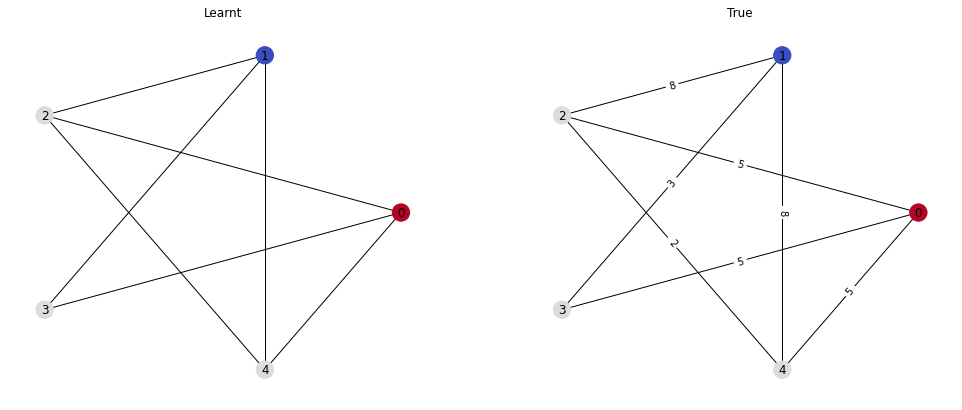

Passes: 3
tensor([2.0048, 3.0069, 1.0023, 1.0026, 3.0071, 1.0025, 0.0000],
       device='cuda:0')
tensor([2., 3., 1., 1., 3., 1., 0.], device='cuda:0')
Loss: 0.0037477868609130383	Similarity: 1.0


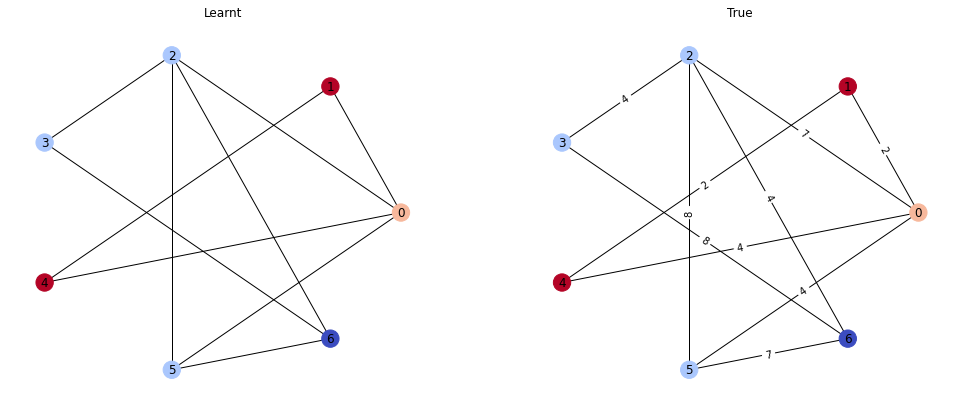

Passes: 2
tensor([1.0022, 1.0021, 1.0025, 2.0044, 1.0023, 0.0000, 2.0044],
       device='cuda:0')
tensor([1., 1., 1., 2., 1., 0., 2.], device='cuda:0')
Loss: 0.0025595256593078375	Similarity: 1.0


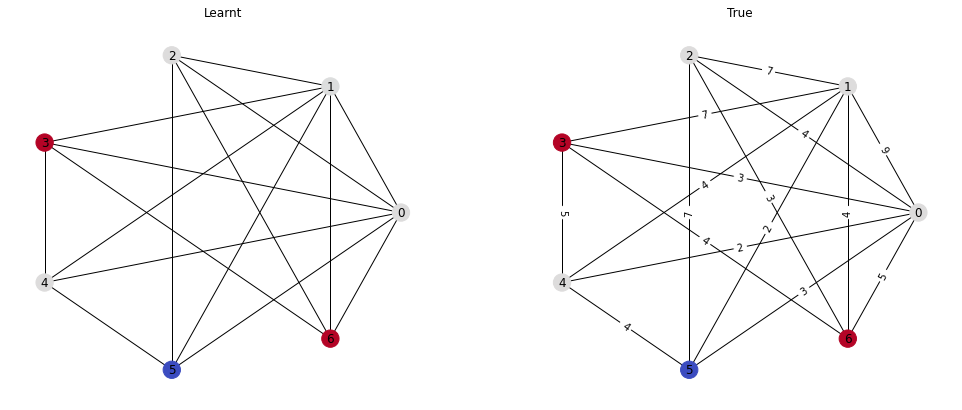

Passes: 3
tensor([2.0051, 2.0050, 2.0047, 0.0000, 1.0024, 1.0024, 3.0071],
       device='cuda:0')
tensor([2., 2., 2., 0., 1., 1., 3.], device='cuda:0')
Loss: 0.0038063868414610624	Similarity: 1.0


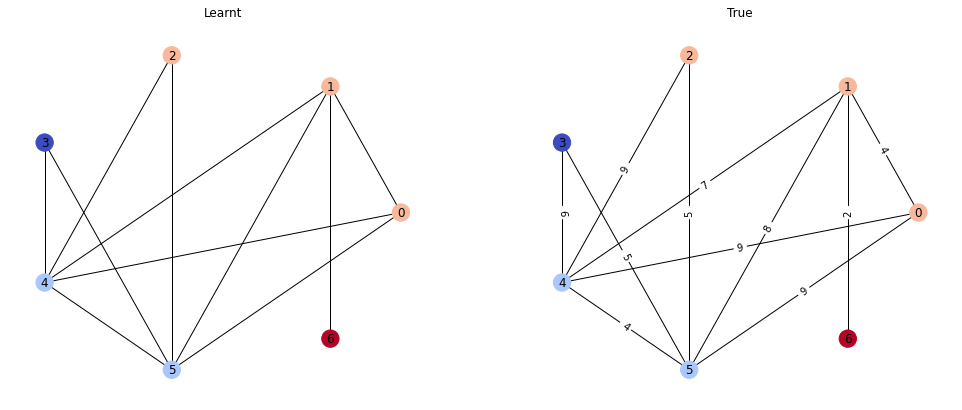

Passes: 2
tensor([2.0044, 1.0021, 1.0021, 1.0025, 1.0024, 1.0023, 0.0000],
       device='cuda:0')
tensor([2., 1., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.002268876414746046	Similarity: 1.0


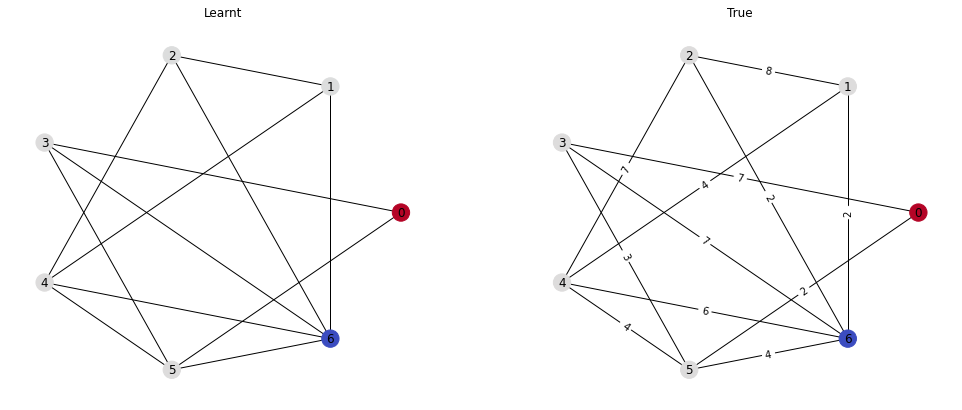

Passes: 2
tensor([1.0022, 1.0021, 0.0000, 1.0021, 2.0043, 2.0043, 2.0043],
       device='cuda:0')
tensor([1., 1., 0., 1., 2., 2., 2.], device='cuda:0')
Loss: 0.002768159145489335	Similarity: 1.0


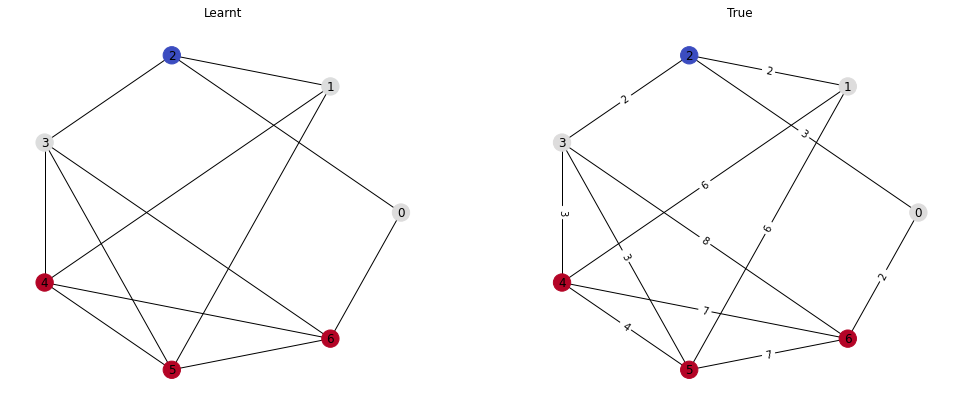

Passes: 3
tensor([3.0066, 2.0043, 1.0022, 0.0000, 3.0068, 2.0045, 1.0023],
       device='cuda:0')
tensor([3., 2., 1., 0., 3., 2., 1.], device='cuda:0')
Loss: 0.003804104868322611	Similarity: 1.0


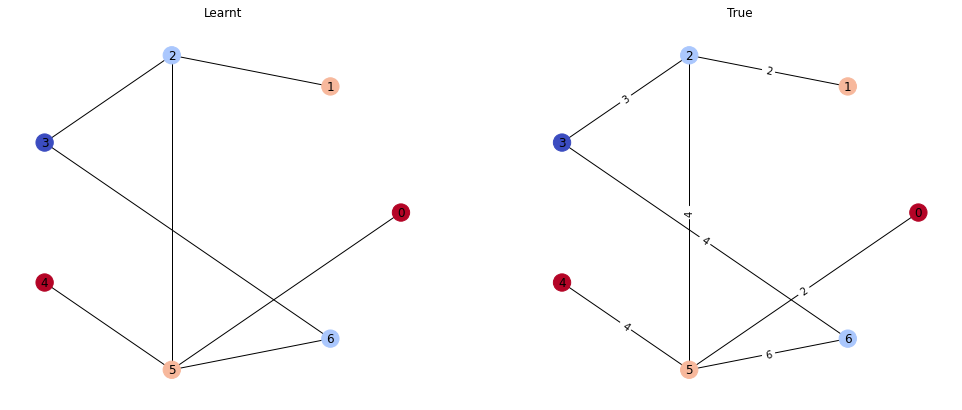

Passes: 2
tensor([2.0048, 1.0024, 1.0023, 1.0026, 1.0022, 1.0027, 0.0000],
       device='cuda:0')
tensor([2., 1., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.002432908397167921	Similarity: 1.0


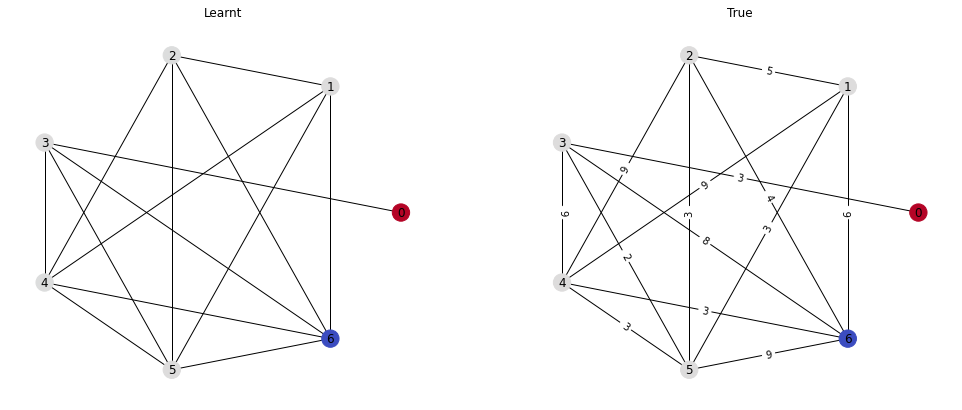

Passes: 2
tensor([2.0049, 1.0023, 2.0047, 0.0000, 2.0047, 2.0049, 1.0023],
       device='cuda:0')
tensor([2., 1., 2., 0., 2., 2., 1.], device='cuda:0')
Loss: 0.0033985888585448265	Similarity: 1.0


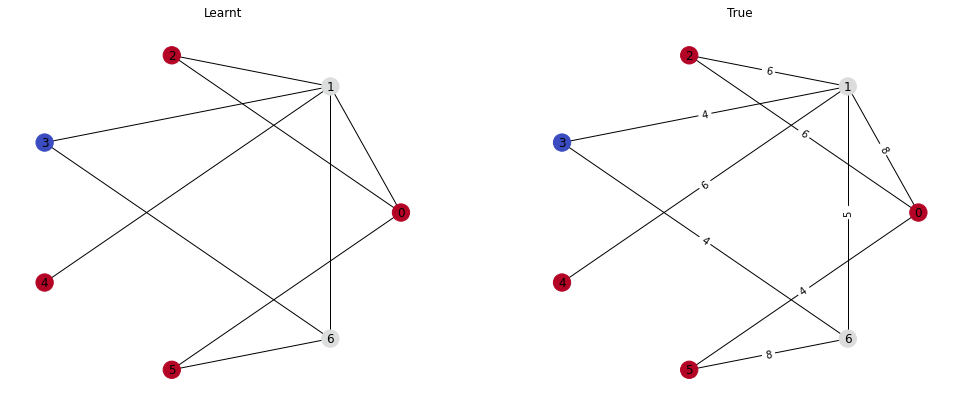

Passes: 2
tensor([1.0021, 2.0046, 1.0026, 1.0024, 0.0000, 1.0027, 1.0022],
       device='cuda:0')
tensor([1., 2., 1., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.0023743256460875273	Similarity: 1.0


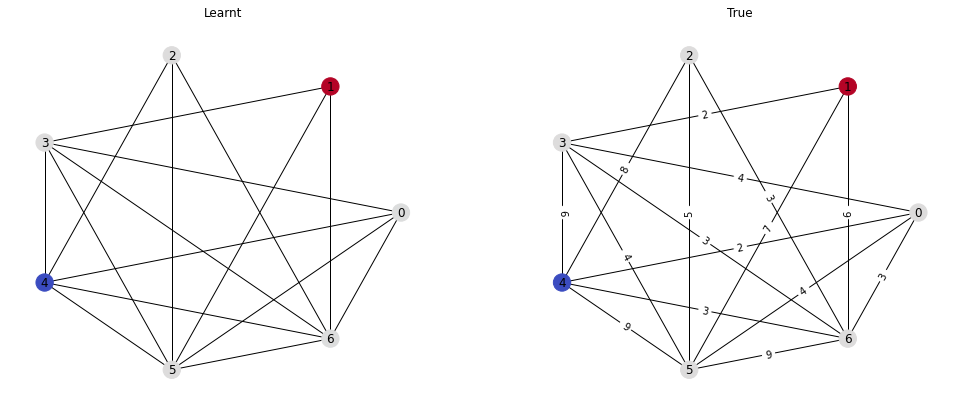

Passes: 2
tensor([2.0043, 1.0024, 0.0000, 1.0024, 1.0021, 1.0026, 1.0024],
       device='cuda:0')
tensor([2., 1., 0., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0023274593986570835	Similarity: 1.0


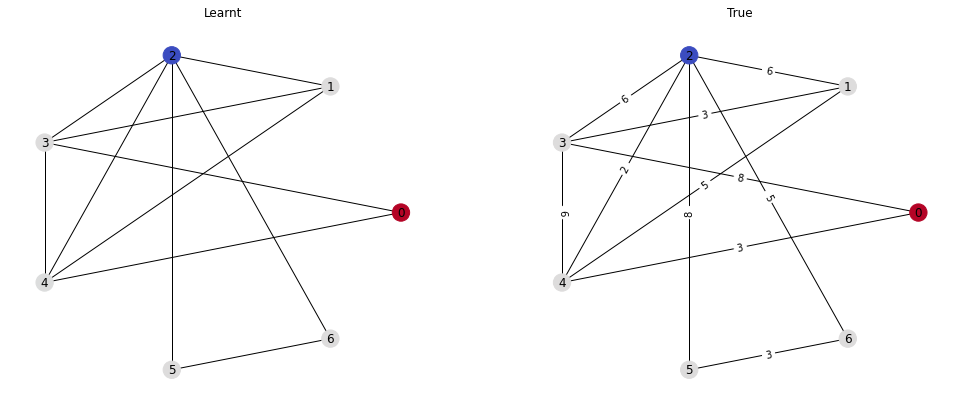

Passes: 2
tensor([2.0050, 2.0048, 1.0025, 2.0051, 1.0023, 2.0051, 0.0000],
       device='cuda:0')
tensor([2., 2., 1., 2., 1., 2., 0.], device='cuda:0')
Loss: 0.0035274710971862078	Similarity: 1.0


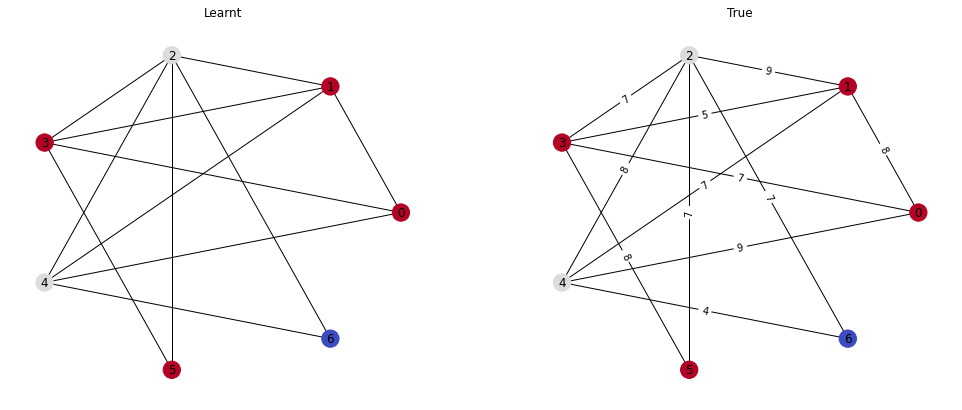

Passes: 2
tensor([1.0025, 0.0000, 1.0024, 1.0024, 2.0051, 1.0021, 1.0025],
       device='cuda:0')
tensor([1., 0., 1., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.002432908397167921	Similarity: 1.0


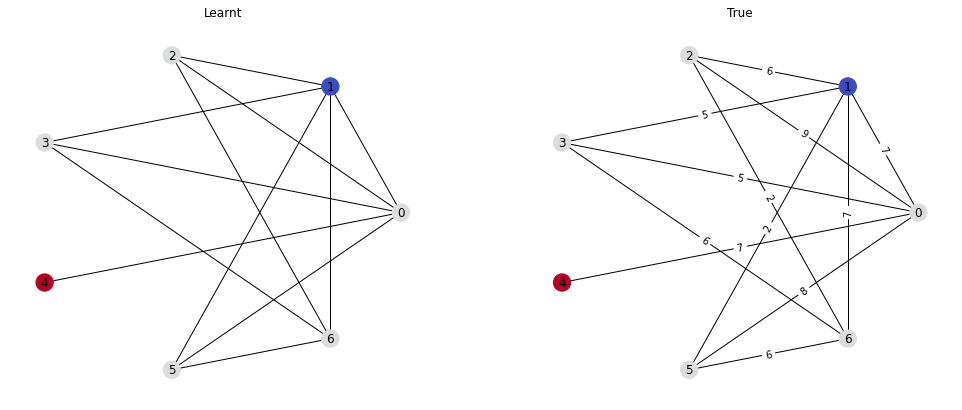

Passes: 2
tensor([1.0022, 1.0025, 2.0048, 2.0047, 2.0046, 0.0000, 2.0048],
       device='cuda:0')
tensor([1., 1., 2., 2., 2., 0., 2.], device='cuda:0')
Loss: 0.0033868723548948765	Similarity: 1.0


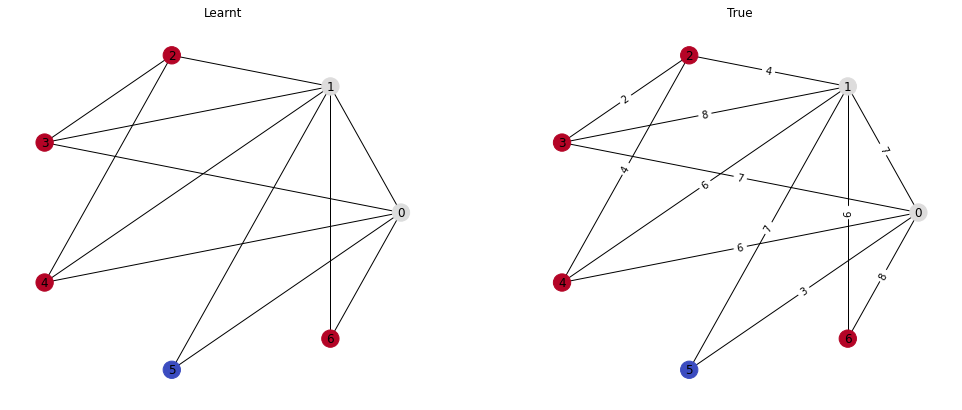

Passes: 2
tensor([1.0027, 2.0046, 1.0027, 1.0023, 1.0023, 0.0000, 1.0027],
       device='cuda:0')
tensor([1., 2., 1., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.0024563416372984648	Similarity: 1.0


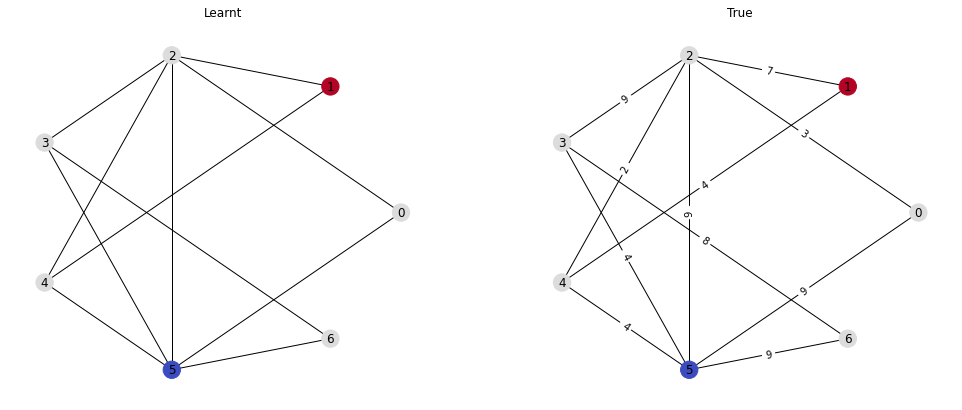

Passes: 2
tensor([1.0021, 2.0042, 1.0024, 2.0042, 1.0027, 0.0000, 1.0023],
       device='cuda:0')
tensor([1., 2., 1., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.002571242395788431	Similarity: 1.0


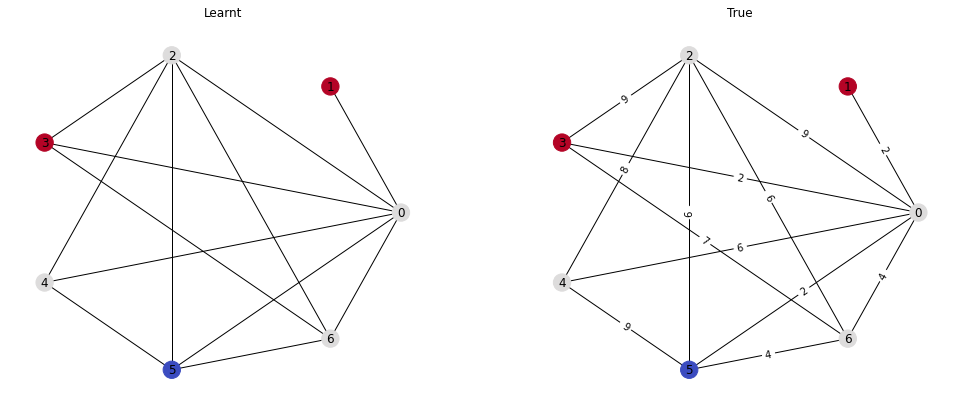

Passes: 2
tensor([1.0022, 0.0000, 1.0027, 1.0022, 1.0024, 2.0046, 2.0043],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.002618108643218875	Similarity: 1.0


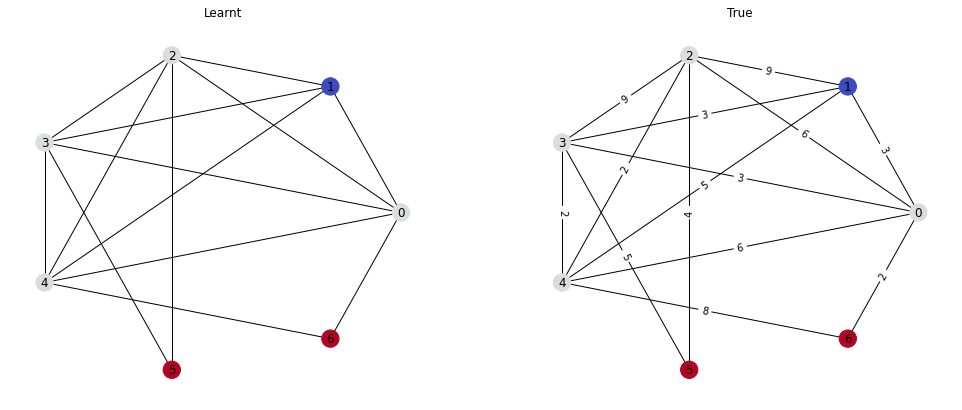

Passes: 3
tensor([2.0046, 1.0023, 0.0000, 1.0024, 2.0046, 2.0046, 3.0070],
       device='cuda:0')
tensor([2., 1., 0., 1., 2., 2., 3.], device='cuda:0')
Loss: 0.0036423548590391874	Similarity: 1.0


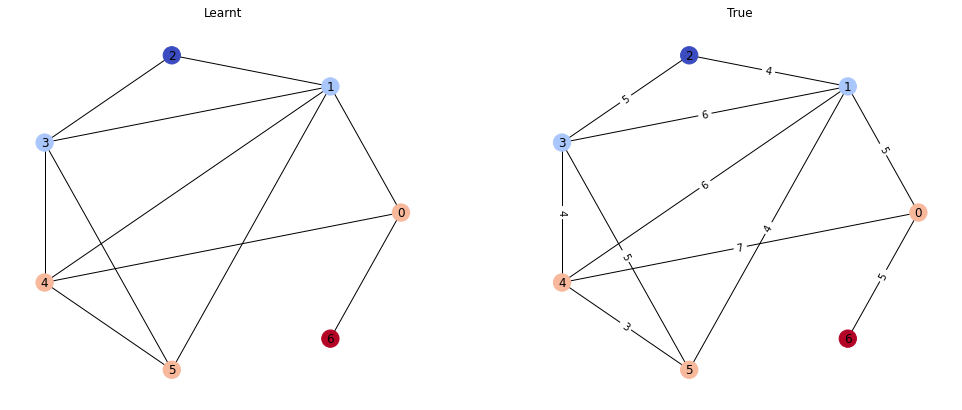

Passes: 2
tensor([2.0044, 1.0024, 1.0023, 0.0000, 1.0022, 2.0046], device='cuda:0')
tensor([2., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.002633353229612112	Similarity: 1.0


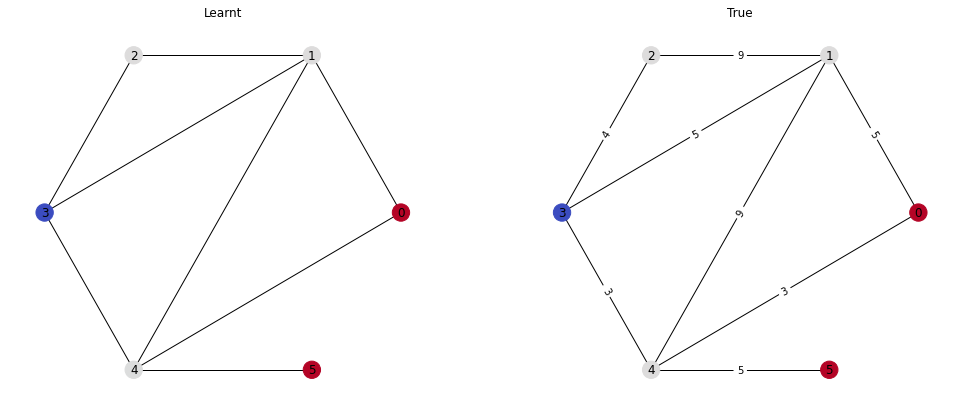

Passes: 3
tensor([0.0000, 1.0024, 1.0025, 2.0046, 2.0046, 2.0048, 3.0073],
       device='cuda:0')
tensor([0., 1., 1., 2., 2., 2., 3.], device='cuda:0')
Loss: 0.0037478040903806686	Similarity: 1.0


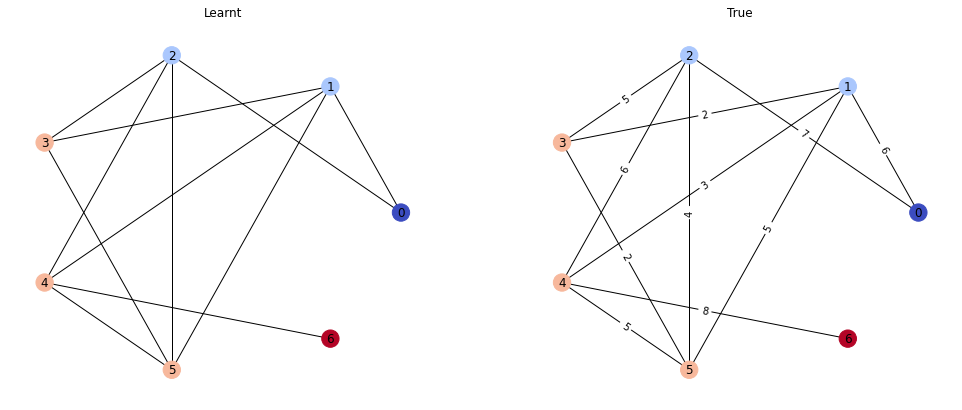

Passes: 2
tensor([2.0044, 0.0000, 2.0046, 1.0024, 1.0024, 1.0023, 1.0025],
       device='cuda:0')
tensor([2., 0., 2., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0026532583869993687	Similarity: 1.0


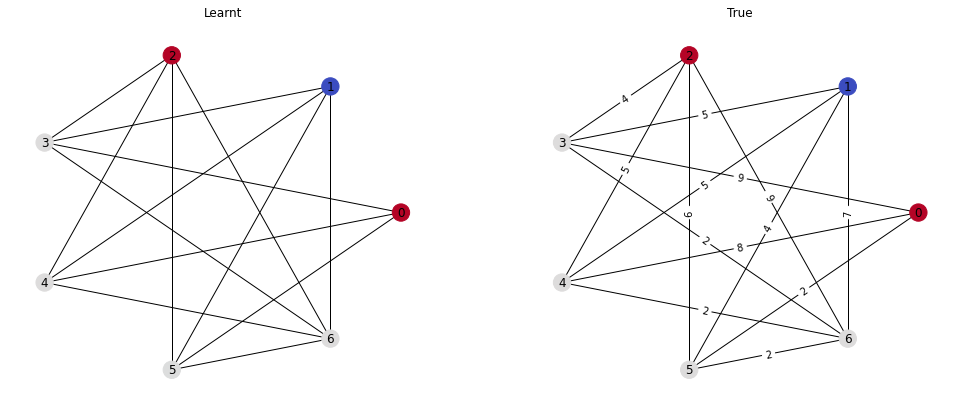

Passes: 1
tensor([0.0000, 1.0025, 1.0022, 1.0026, 1.0021, 1.0026, 1.0021],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 1.], device='cuda:0')
Loss: 0.0020250934176146984	Similarity: 1.0


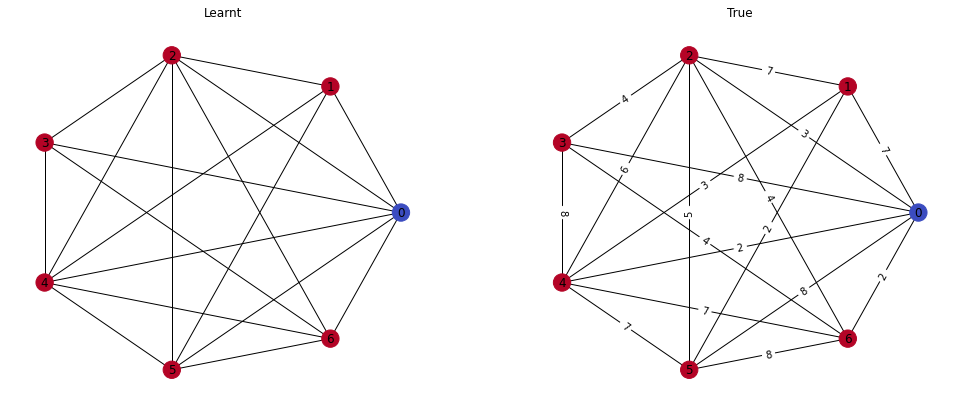

Passes: 2
tensor([2.0045, 1.0025, 0.0000, 1.0023, 1.0021, 2.0046, 2.0047],
       device='cuda:0')
tensor([2., 1., 0., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.00296734063886106	Similarity: 1.0


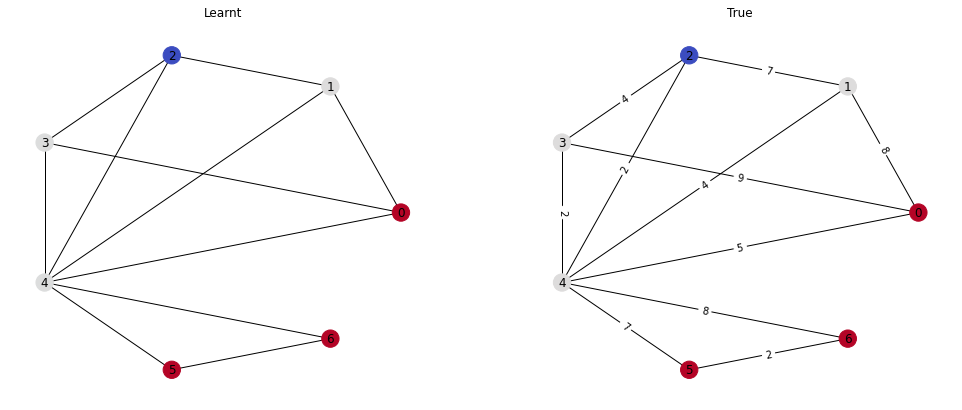

Passes: 2
tensor([2.0043, 1.0026, 1.0023, 0.0000, 1.0021, 2.0045, 2.0047],
       device='cuda:0')
tensor([2., 1., 1., 0., 1., 2., 2.], device='cuda:0')
Loss: 0.00293219112791121	Similarity: 1.0


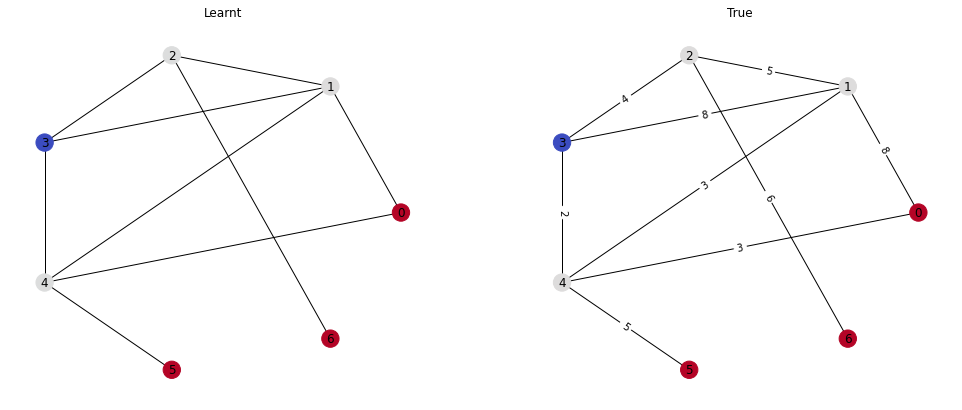

Passes: 2
tensor([1.0024, 1.0022, 1.0024, 0.0000, 2.0046, 2.0047, 2.0044],
       device='cuda:0')
tensor([1., 1., 1., 0., 2., 2., 2.], device='cuda:0')
Loss: 0.00296734063886106	Similarity: 1.0


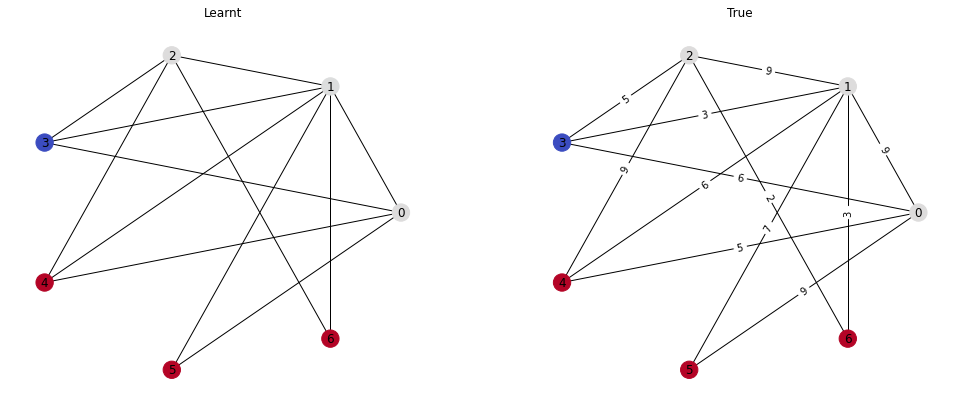

Passes: 2
tensor([2.0047, 0.0000, 1.0021, 2.0047, 1.0025, 2.0046, 1.0024],
       device='cuda:0')
tensor([2., 0., 1., 2., 1., 2., 1.], device='cuda:0')
Loss: 0.0030142071191221476	Similarity: 1.0


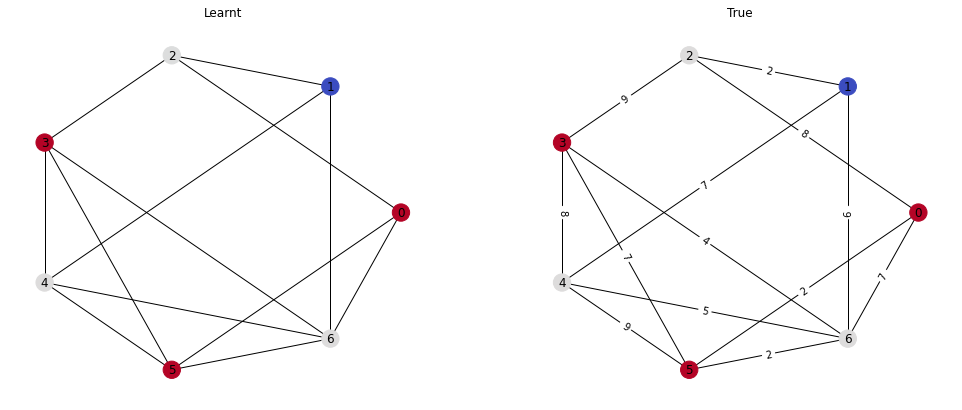

Passes: 2
tensor([1.0025, 1.0025, 1.0026, 1.0026, 0.0000, 1.0021, 2.0042],
       device='cuda:0')
tensor([1., 1., 1., 1., 0., 1., 2.], device='cuda:0')
Loss: 0.0023743256460875273	Similarity: 1.0


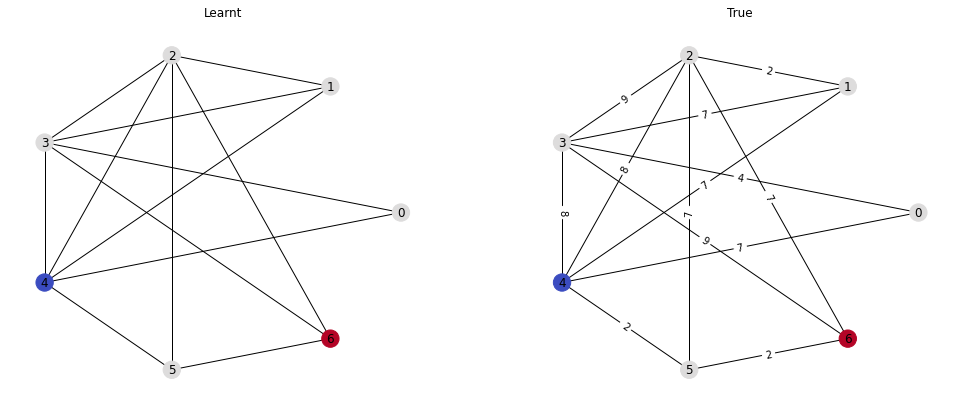

Passes: 2
tensor([2.0045, 2.0047, 1.0022, 1.0022, 2.0047, 2.0048, 0.0000],
       device='cuda:0')
tensor([2., 2., 1., 1., 2., 2., 0.], device='cuda:0')
Loss: 0.003304856363683939	Similarity: 1.0


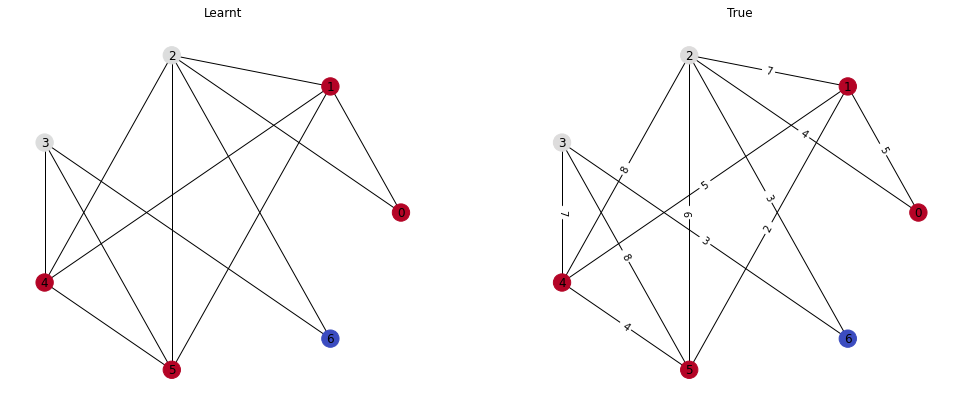

Passes: 2
tensor([1.0021, 1.0024, 1.0021, 2.0046, 0.0000, 1.0021, 2.0043],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 1., 2.], device='cuda:0')
Loss: 0.0025243759155273438	Similarity: 1.0


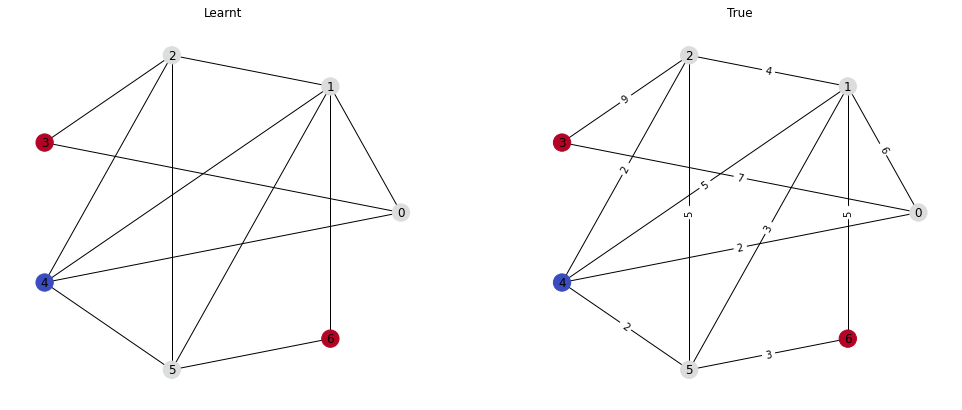

Passes: 2
tensor([1.0024, 2.0047, 1.0024, 1.0027, 1.0024, 1.0024, 0.0000],
       device='cuda:0')
tensor([1., 2., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.002409475389868021	Similarity: 1.0


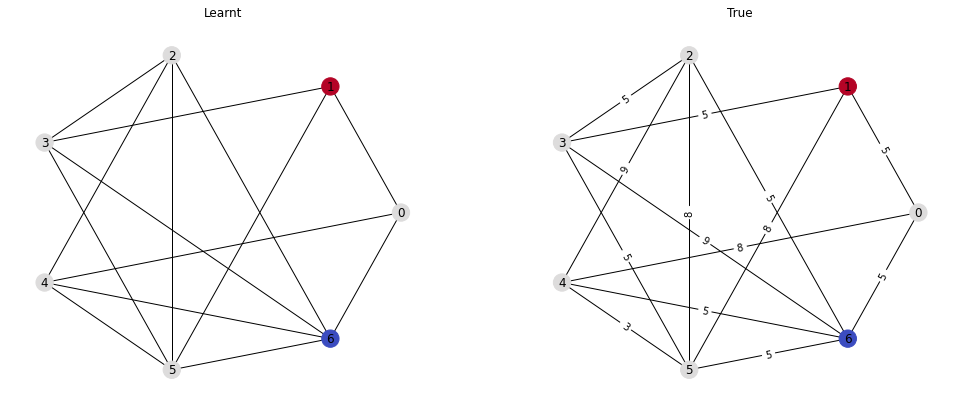

Passes: 2
tensor([1.0027, 1.0024, 1.0025, 2.0046, 1.0022, 2.0047, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 2., 1., 2., 0.], device='cuda:0')
Loss: 0.002746990881860256	Similarity: 1.0


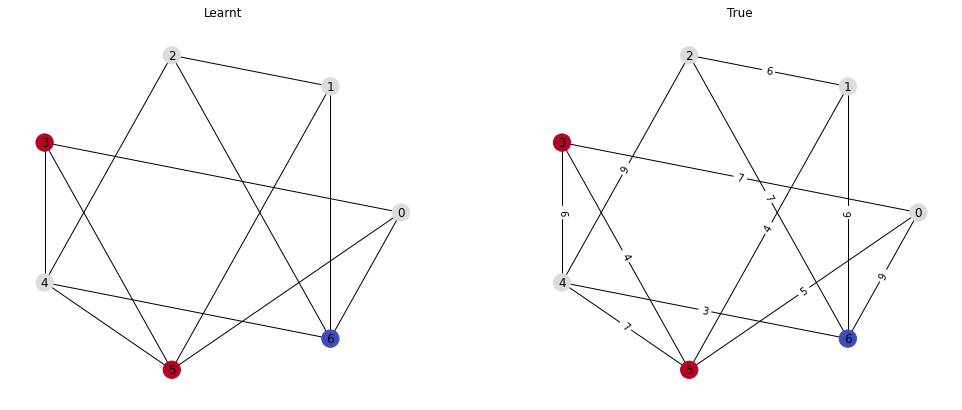

Passes: 2
tensor([1.0021, 1.0021, 1.0025, 2.0044, 0.0000, 2.0050, 2.0051],
       device='cuda:0')
tensor([1., 1., 1., 2., 0., 2., 2.], device='cuda:0')
Loss: 0.0030259236227720976	Similarity: 1.0


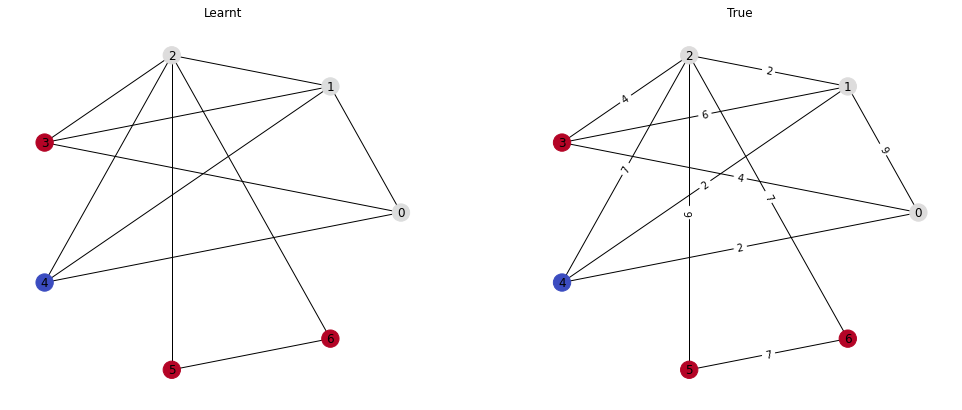

Passes: 2
tensor([2.0045, 2.0048, 1.0022, 1.0023, 1.0027, 0.0000, 2.0045],
       device='cuda:0')
tensor([2., 2., 1., 1., 1., 0., 2.], device='cuda:0')
Loss: 0.002990773878991604	Similarity: 1.0


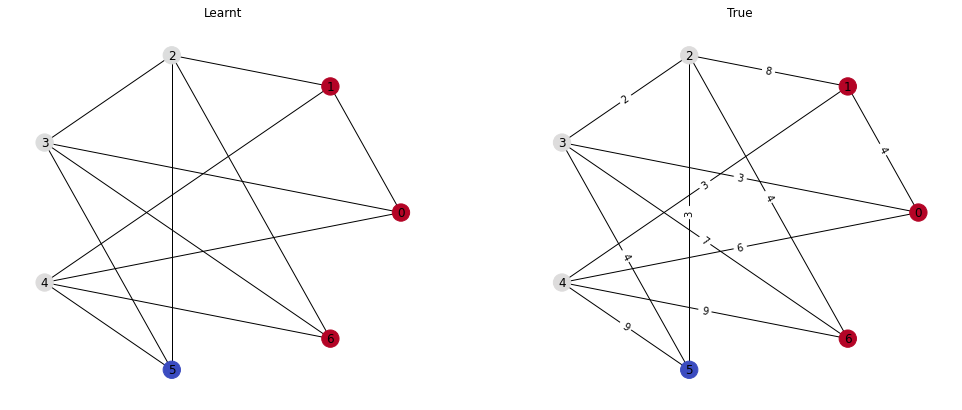

Passes: 2
tensor([1.0022, 0.0000, 2.0048, 1.0023, 1.0024, 2.0046, 2.0045],
       device='cuda:0')
tensor([1., 0., 2., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.00296734063886106	Similarity: 1.0


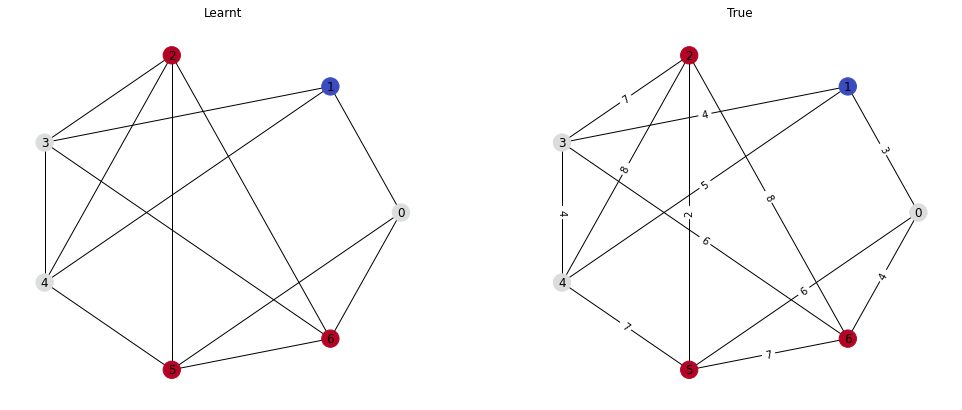

Passes: 2
tensor([0.0000, 2.0045, 1.0022, 2.0046, 1.0023, 1.0021], device='cuda:0')
tensor([0., 2., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.0026060144882649183	Similarity: 1.0


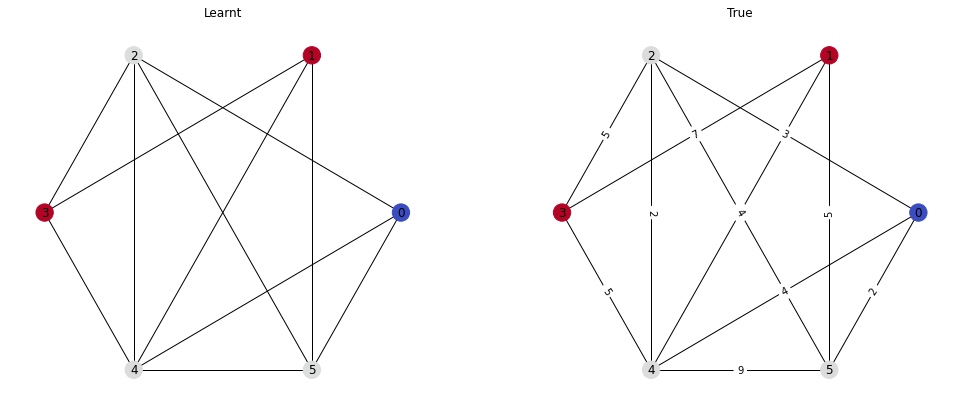

Passes: 2
tensor([1.0026, 0.0000, 1.0022, 1.0022, 1.0026, 2.0048, 2.0046],
       device='cuda:0')
tensor([1., 0., 1., 1., 1., 2., 2.], device='cuda:0')
Loss: 0.0027118411380797625	Similarity: 1.0


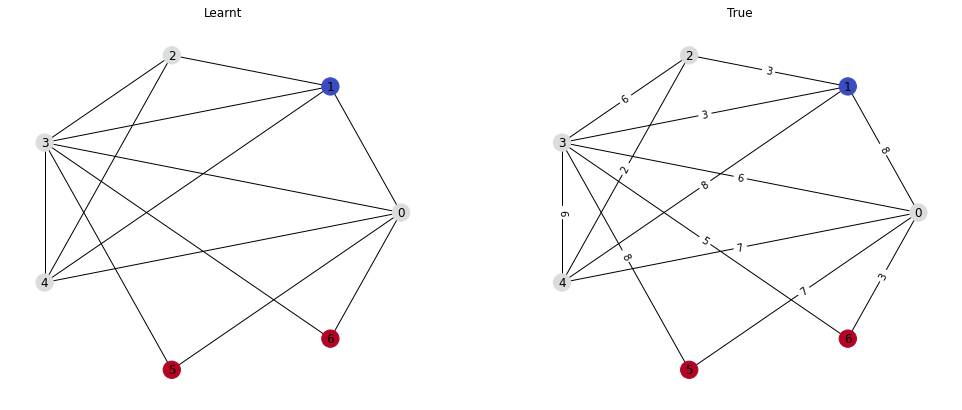

Passes: 2
tensor([0.0000, 1.0021, 2.0043, 1.0027, 1.0022, 1.0022, 2.0054],
       device='cuda:0')
tensor([0., 1., 2., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0027001246344298124	Similarity: 1.0


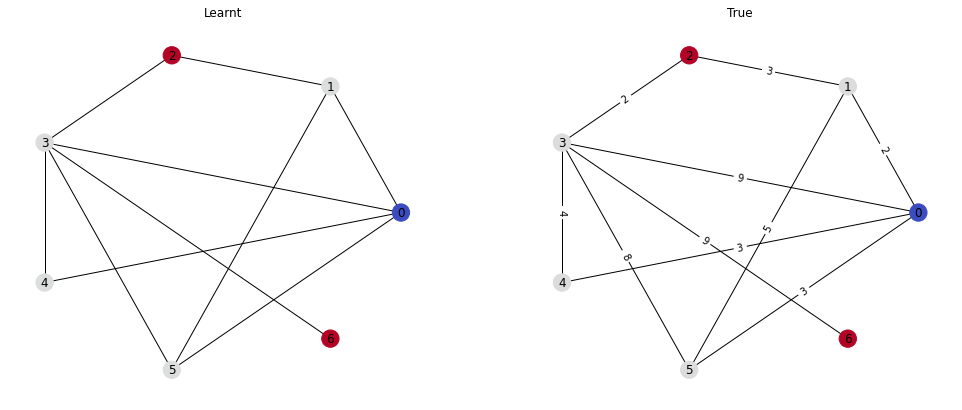

Passes: 2
tensor([2.0045, 2.0046, 1.0025, 1.0025, 0.0000, 1.0024], device='cuda:0')
tensor([2., 2., 1., 1., 0., 1.], device='cuda:0')
Loss: 0.0027563772164285183	Similarity: 1.0


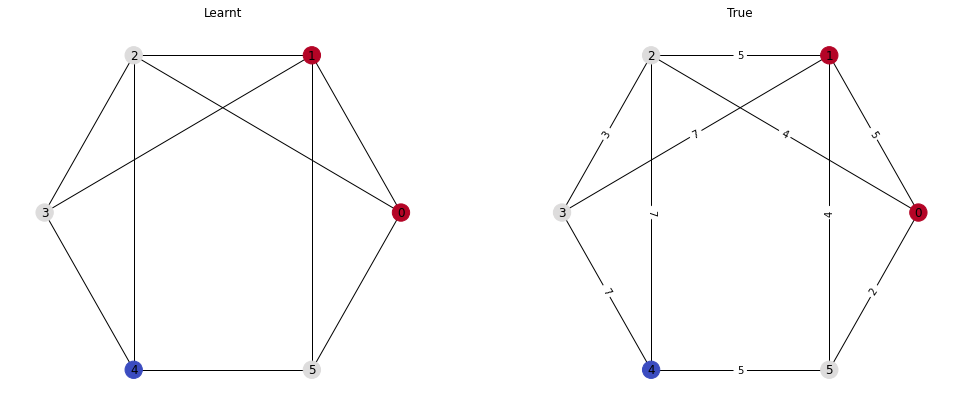

Passes: 2
tensor([1.0027, 0.0000, 1.0024, 1.0023, 2.0054, 1.0022, 2.0044],
       device='cuda:0')
tensor([1., 0., 1., 1., 2., 1., 2.], device='cuda:0')
Loss: 0.0027704241219908	Similarity: 1.0


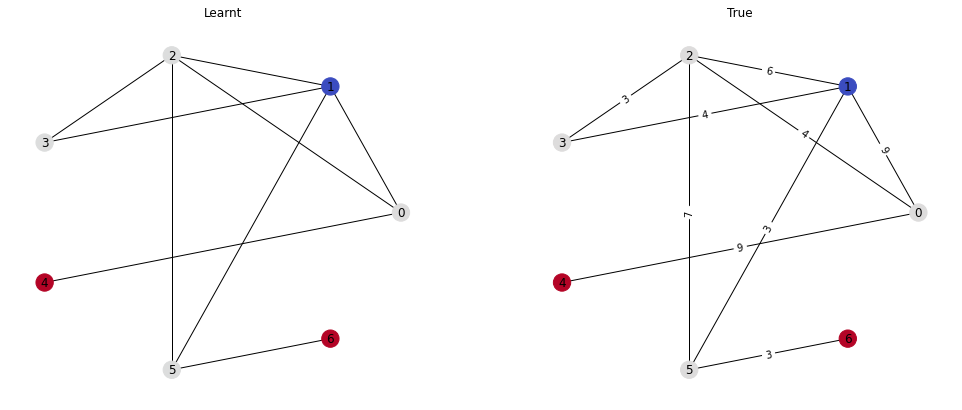

Passes: 3
tensor([1.0024, 1.0027, 3.0067, 2.0045, 0.0000, 3.0068, 1.0021],
       device='cuda:0')
tensor([1., 1., 3., 2., 0., 3., 1.], device='cuda:0')
Loss: 0.003595471614971757	Similarity: 1.0


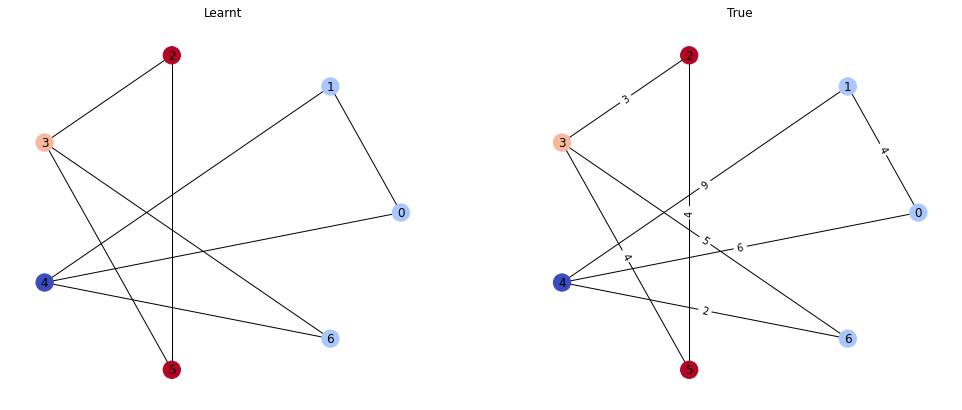

Passes: 2
tensor([1.0024, 2.0044, 1.0024, 2.0046, 0.0000, 1.0024, 1.0023],
       device='cuda:0')
tensor([1., 2., 1., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.0026649748906493187	Similarity: 1.0


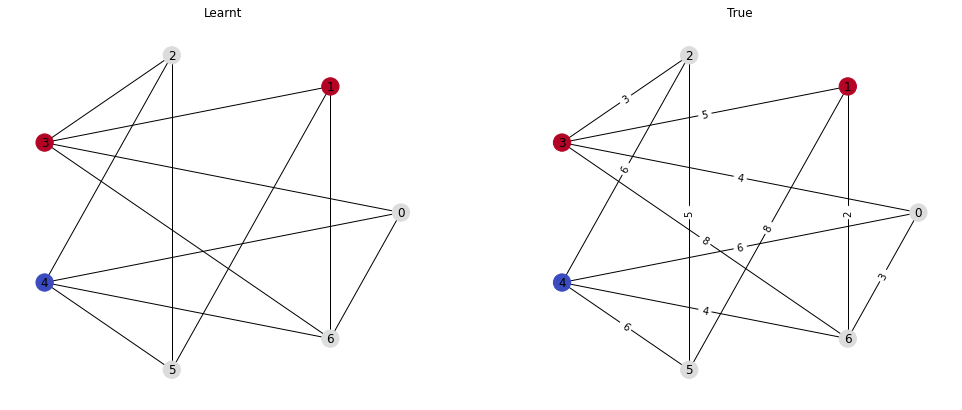

Passes: 2
tensor([1.0024, 1.0022, 2.0043, 2.0045, 1.0022, 0.0000, 1.0027],
       device='cuda:0')
tensor([1., 1., 2., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.002606392139568925	Similarity: 1.0


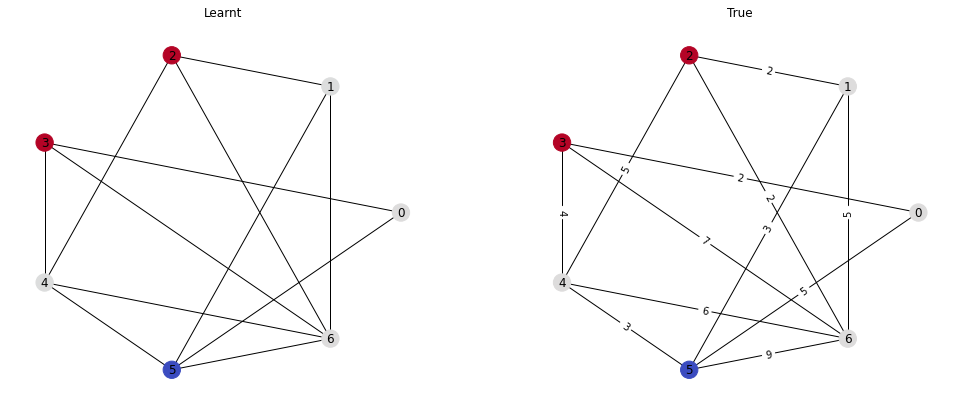

Passes: 2
tensor([2.0051, 1.0024, 2.0046, 2.0050, 0.0000, 1.0024, 1.0024],
       device='cuda:0')
tensor([2., 1., 2., 2., 0., 1., 1.], device='cuda:0')
Loss: 0.003131372621282935	Similarity: 1.0


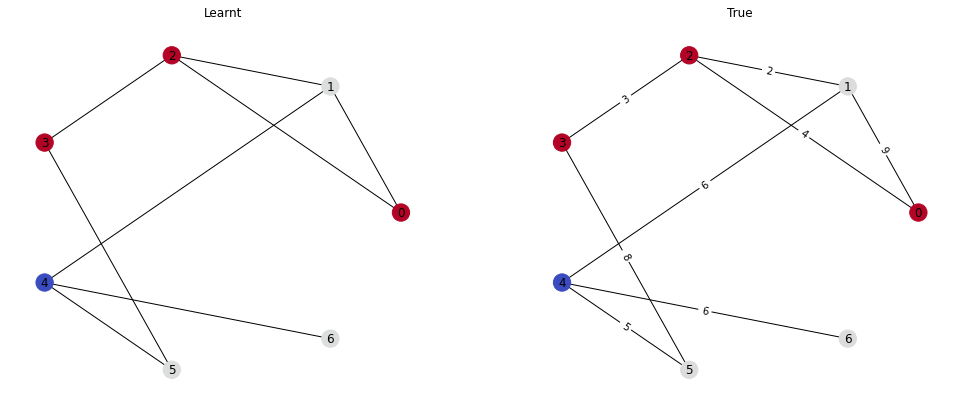

Passes: 2
tensor([1.0022, 0.0000, 1.0024, 1.0022, 2.0045, 2.0046, 1.0024],
       device='cuda:0')
tensor([1., 0., 1., 1., 2., 2., 1.], device='cuda:0')
Loss: 0.0025946754030883312	Similarity: 1.0


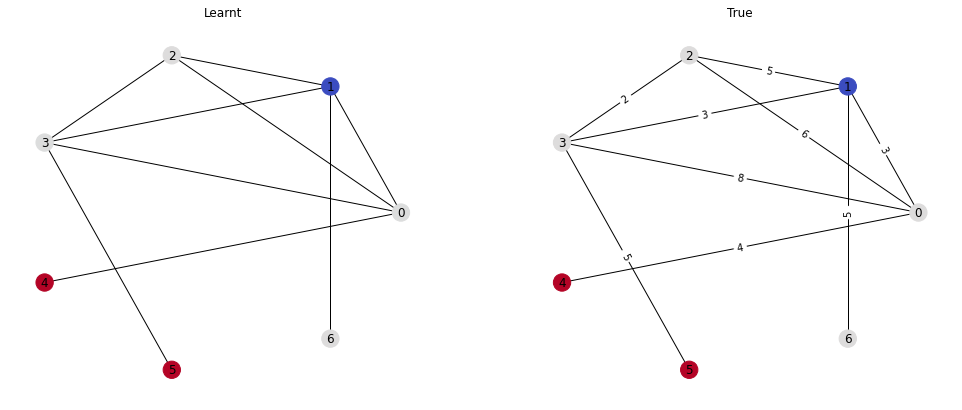

Passes: 2
tensor([1.0026, 0.0000, 1.0021, 2.0044, 1.0027, 1.0024, 2.0049],
       device='cuda:0')
tensor([1., 0., 1., 2., 1., 1., 2.], device='cuda:0')
Loss: 0.002735274378210306	Similarity: 1.0


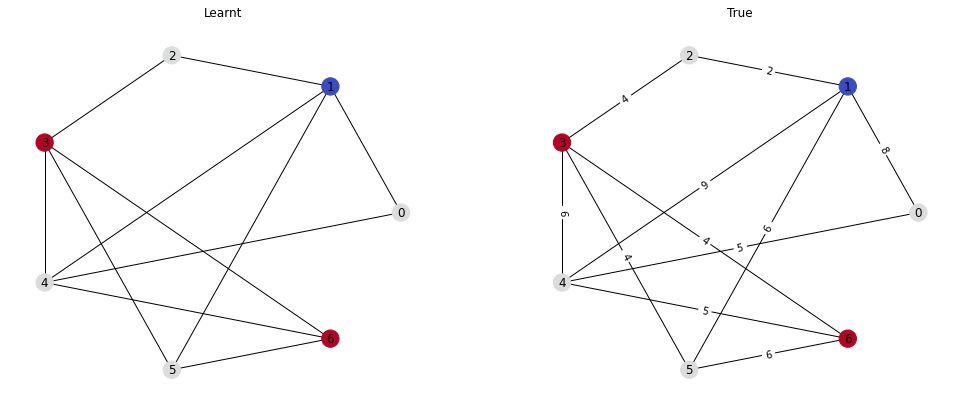

Passes: 2
tensor([1.0025, 2.0051, 2.0052, 0.0000, 2.0047, 2.0047, 1.0022],
       device='cuda:0')
tensor([1., 2., 2., 0., 2., 2., 1.], device='cuda:0')
Loss: 0.0035040380898863077	Similarity: 1.0


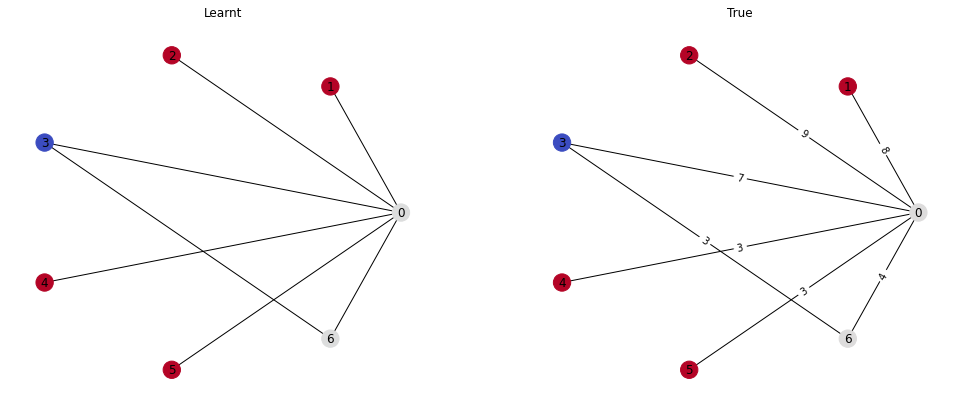

Passes: 2
tensor([2.0048, 2.0044, 1.0023, 0.0000, 1.0021, 2.0042, 1.0021],
       device='cuda:0')
tensor([2., 2., 1., 0., 1., 2., 1.], device='cuda:0')
Loss: 0.0028501751367002726	Similarity: 1.0


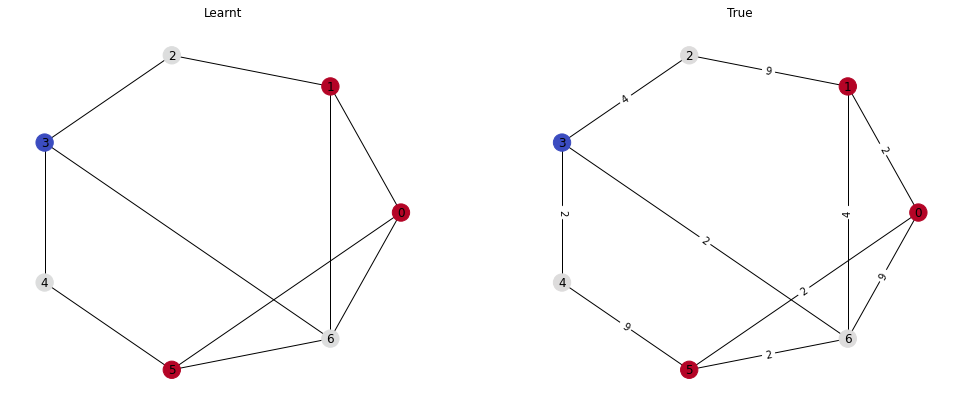

Passes: 2
tensor([1.0024, 2.0050, 2.0050, 2.0051, 1.0026, 0.0000, 2.0049],
       device='cuda:0')
tensor([1., 2., 2., 2., 1., 0., 2.], device='cuda:0')
Loss: 0.0035626208409667015	Similarity: 1.0


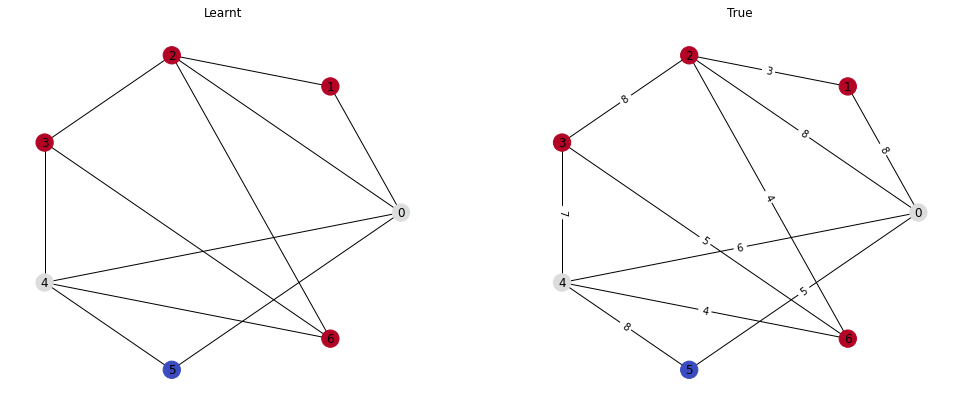

Passes: 3
tensor([1.0023, 0.0000, 1.0022, 2.0043, 2.0045, 2.0045, 3.0068],
       device='cuda:0')
tensor([1., 0., 1., 2., 2., 2., 3.], device='cuda:0')
Loss: 0.003501756116747856	Similarity: 1.0


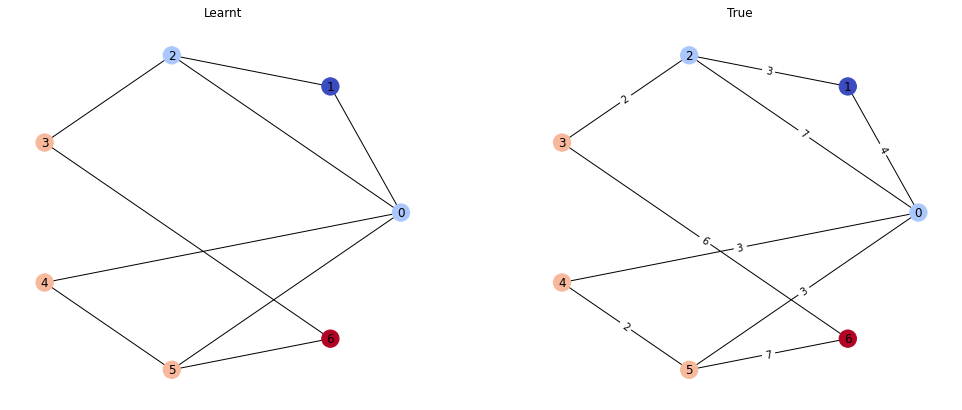

Passes: 2
tensor([2.0051, 1.0024, 2.0046, 1.0023, 0.0000, 1.0022, 1.0024],
       device='cuda:0')
tensor([2., 1., 2., 1., 0., 1., 1.], device='cuda:0')
Loss: 0.0027001246344298124	Similarity: 1.0


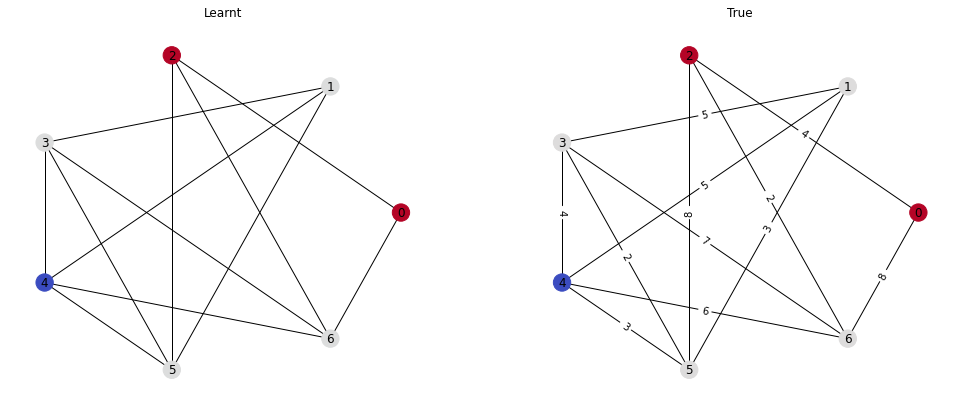

Passes: 4
tensor([1.0021, 0.0000, 1.0021, 2.0043, 3.0067, 4.0089, 2.0043],
       device='cuda:0')
tensor([1., 0., 1., 2., 3., 4., 2.], device='cuda:0')
Loss: 0.004059621598571539	Similarity: 1.0


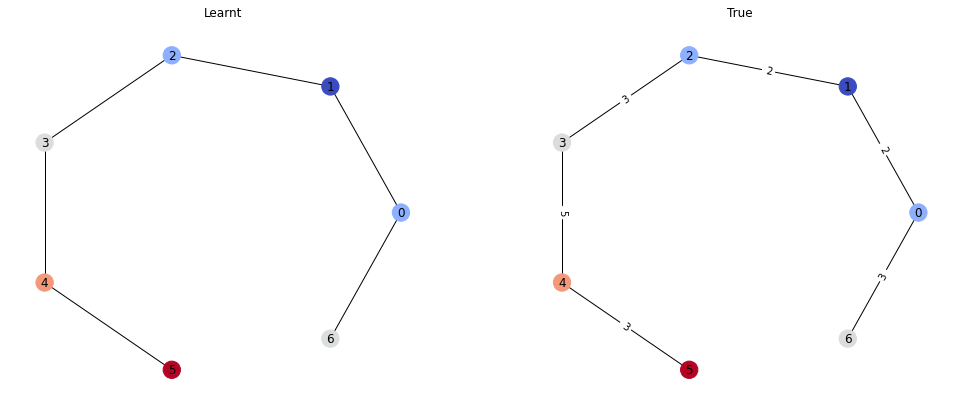

Passes: 1
tensor([0.0000, 1.0023, 1.0025, 1.0024], device='cuda:0')
tensor([0., 1., 1., 1.], device='cuda:0')
Loss: 0.0017924606800079346	Similarity: 1.0


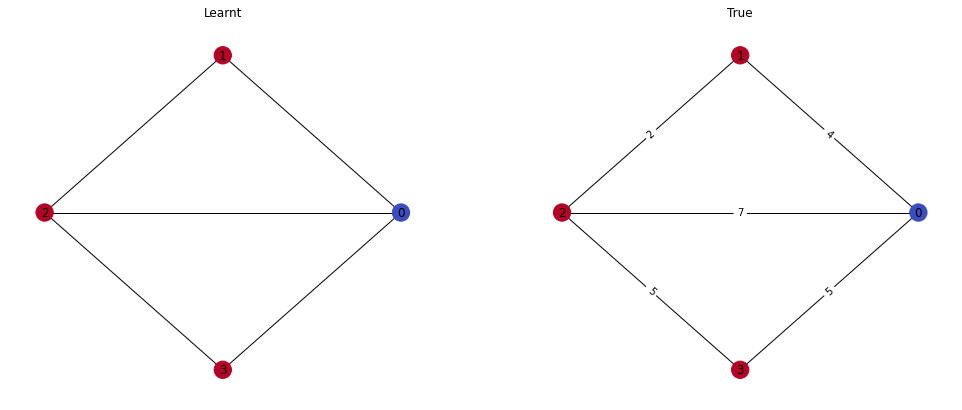

Passes: 2
tensor([1.0024, 1.0023, 2.0045, 2.0046, 1.0025, 0.0000, 2.0044],
       device='cuda:0')
tensor([1., 1., 2., 2., 1., 0., 2.], device='cuda:0')
Loss: 0.00295562413521111	Similarity: 1.0


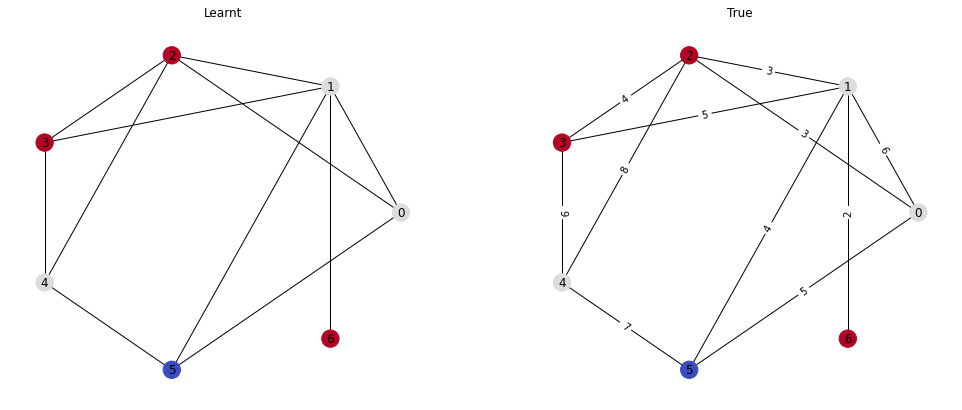

Passes: 2
tensor([1.0025, 2.0048, 2.0043, 1.0021, 0.0000, 2.0046], device='cuda:0')
tensor([1., 2., 2., 1., 0., 2.], device='cuda:0')
Loss: 0.003068129299208522	Similarity: 1.0


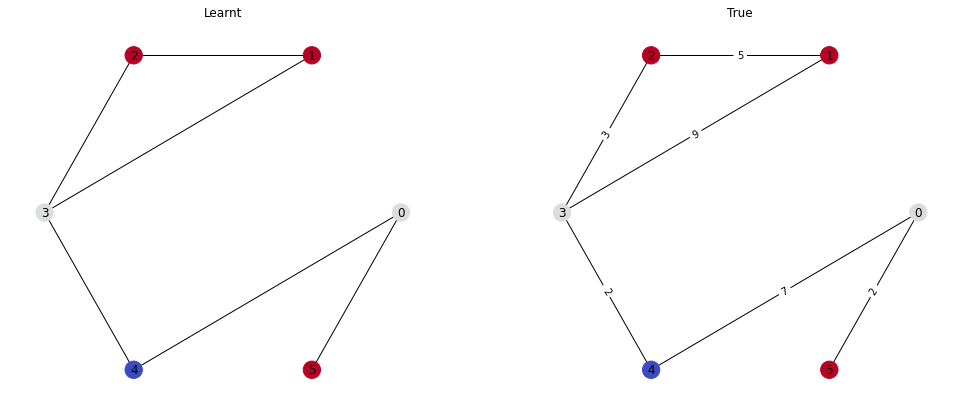

Passes: 2
tensor([2.0046, 2.0043, 0.0000, 1.0024, 2.0046, 1.0021, 1.0025],
       device='cuda:0')
tensor([2., 2., 0., 1., 2., 1., 1.], device='cuda:0')
Loss: 0.00294390763156116	Similarity: 1.0


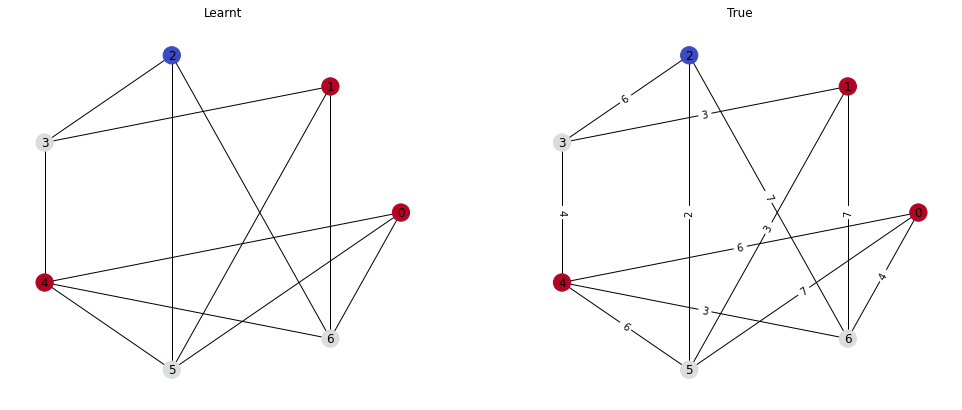

Passes: 2
tensor([2.0047, 1.0026, 0.0000, 2.0051, 2.0051, 2.0049, 2.0050],
       device='cuda:0')
tensor([2., 1., 0., 2., 2., 2., 2.], device='cuda:0')
Loss: 0.003911852836608887	Similarity: 1.0


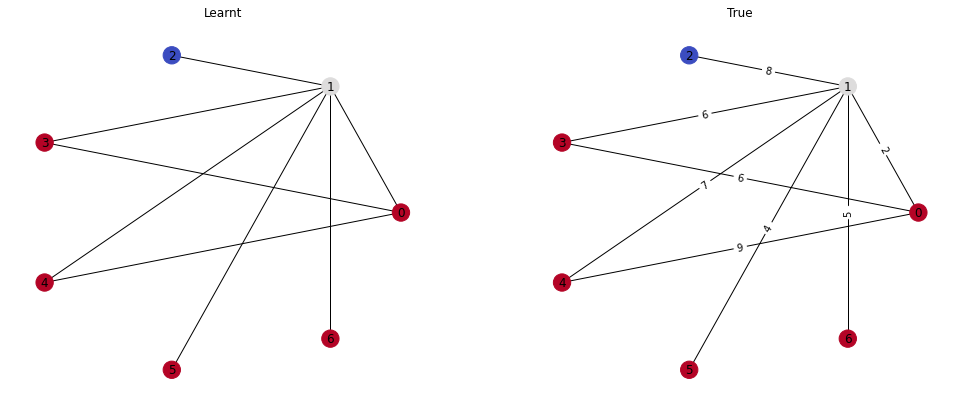

Passes: 1
tensor([1.0023, 1.0021, 1.0023, 1.0027, 1.0023, 1.0022, 0.0000],
       device='cuda:0')
tensor([1., 1., 1., 1., 1., 1., 0.], device='cuda:0')
Loss: 0.0019782271701842546	Similarity: 1.0


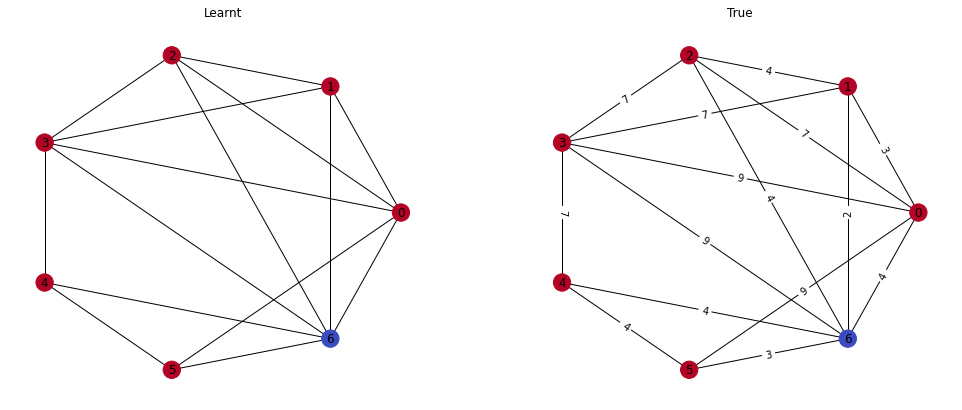

Passes: 4
tensor([1.0026, 2.0052, 3.0079, 3.1614, 3.0071, 2.0048, 0.0000],
       device='cuda:0')
tensor([1., 2., 3., 4., 3., 2., 0.], device='cuda:0')
Loss: 0.1237468272447586	Similarity: 0.8571428571428571


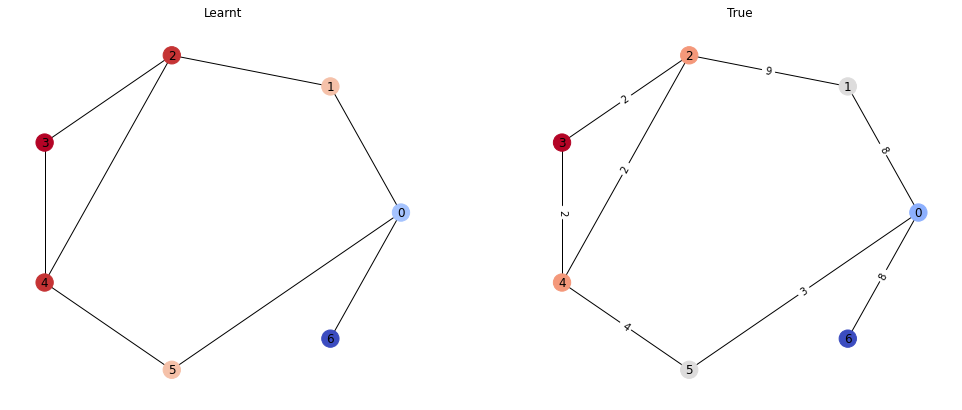

Passes: 3
tensor([2.0050, 3.0073, 2.0052, 2.0054, 1.0026, 0.0000, 1.0027],
       device='cuda:0')
tensor([2., 3., 2., 2., 1., 0., 1.], device='cuda:0')
Loss: 0.004017285071313381	Similarity: 1.0


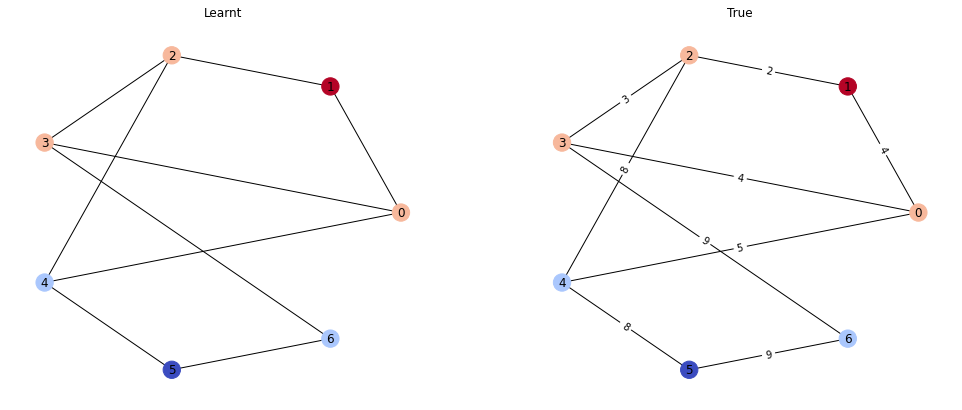

Passes: 2
tensor([0.0000, 1.0021, 1.0026, 1.0026, 1.0023, 1.0024, 2.0047],
       device='cuda:0')
tensor([0., 1., 1., 1., 1., 1., 2.], device='cuda:0')
Loss: 0.0023860421497374773	Similarity: 1.0


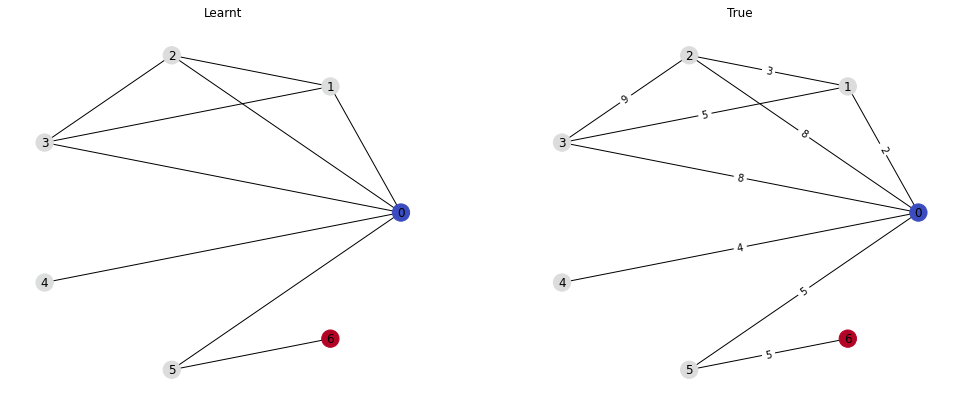

Avg loss 0.00671290619764477
Std loss 0.021017379228457343
Avg similarity 0.9957142857142859
Std similarity 0.02436960301318855


In [ ]:
# TEST
test(test_loader, best_model, decimals=0, plot=True)

---

In [ ]:
# TEST - Random graphs
test(test_loader, best_model, decimals=0, plot=False)

Avg loss 0.0014395717970910483
Std loss 0.0006615711204954114
Avg similarity 1.0
Std similarity 0.0


Passes: 5
tensor([33.9967, 34.9965, 35.9964, 12.9988, 19.9985, 30.9972, 24.9977, 26.9974,
        24.9977, 26.9974, 29.9969, 17.9984, 16.9981,  0.0000, 31.9970, 15.9987,
        28.9971, 20.9979,  8.9990, 20.9979, 11.9989])
tensor([34., 35., 36., 13., 20., 31., 25., 27., 25., 27., 30., 18., 17.,  0.,
        32., 16., 29., 21.,  9., 21., 12.])
Loss: 0.002182460855692625	Similarity: 1.0


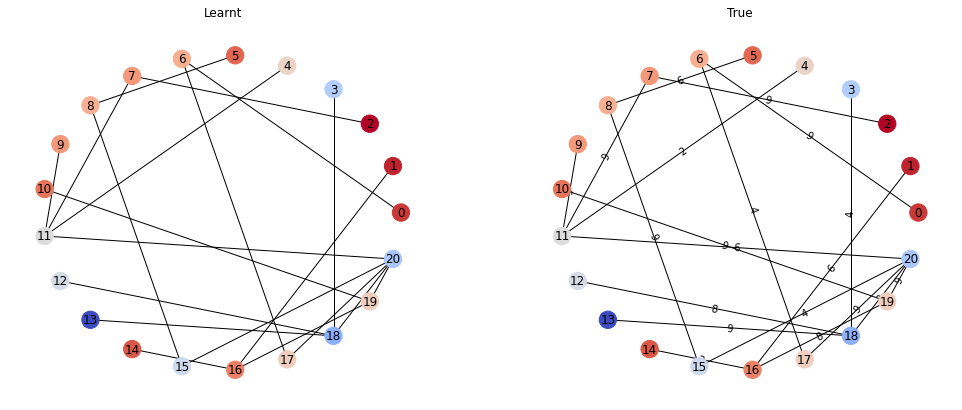

Passes: 12
tensor([56.9959,  9.9992, 48.9959, 48.9967, 12.9992, 21.9986,  0.0000,  8.9994,
         8.9994, 52.9965, 38.9967,  4.9996, 49.9966, 35.9968, 49.9966, 46.9966,
         6.9997, 16.9989, 16.9989, 47.9965, 38.9971, 43.9967, 41.9970, 14.9989,
        39.9969, 21.9982, 34.9973, 32.9972, 26.9978])
tensor([57., 10., 49., 49., 13., 22.,  0.,  9.,  9., 53., 39.,  5., 50., 36.,
        50., 47.,  7., 17., 17., 48., 39., 44., 42., 15., 40., 22., 35., 33.,
        27.])
Loss: 0.0022447684314101934	Similarity: 1.0


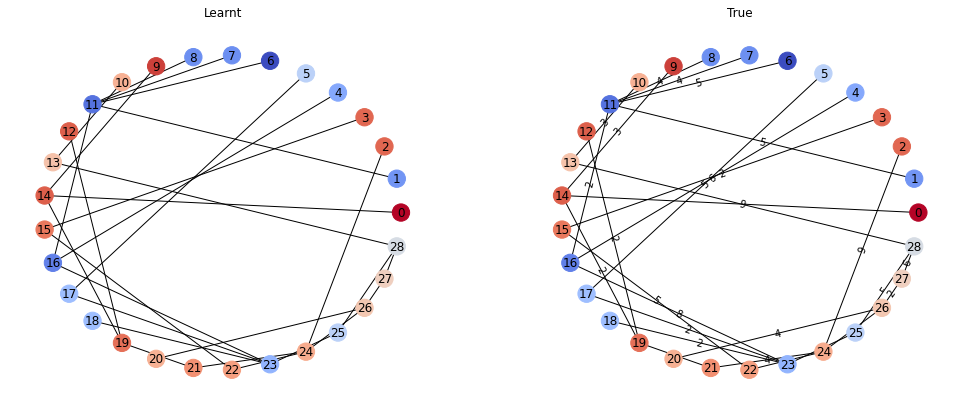

Passes: 6
tensor([ 5.9995, 11.9989, 10.9991, 29.9973,  7.9995, 19.9989, 13.9994, 22.9980,
        25.9983, 15.9983, 14.9985, 22.9984, 13.9994,  5.9995, 20.9983, 13.9990,
        18.9986,  8.9998,  6.9997,  2.0001,  8.9990, 11.9993,  5.9999,  0.0000,
         2.0001,  9.9992])
tensor([ 6., 12., 11., 30.,  8., 20., 14., 23., 26., 16., 15., 23., 14.,  6.,
        21., 14., 19.,  9.,  7.,  2.,  9., 12.,  6.,  0.,  2., 10.])
Loss: 0.000939314195420593	Similarity: 1.0


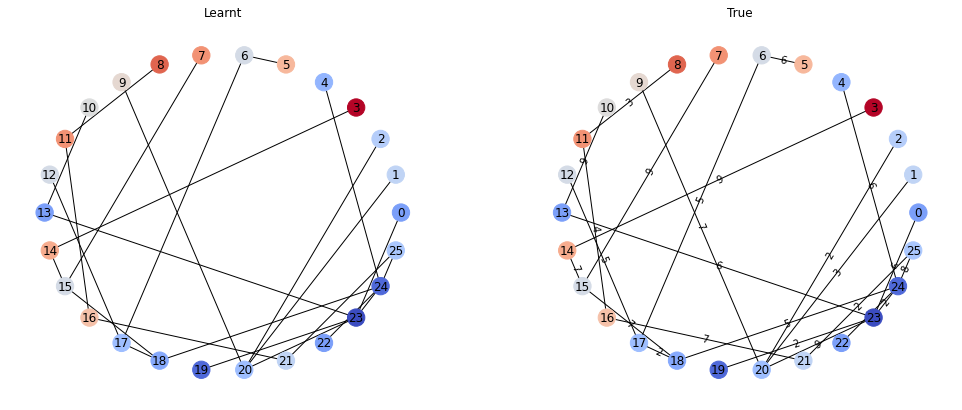

Passes: 5
tensor([35.9964, 17.9980, 32.9965, 26.9970, 17.9980, 15.9983,  0.0000,  8.9990])
tensor([36., 18., 33., 27., 18., 16.,  0.,  9.])
Loss: 0.0021092891693115234	Similarity: 1.0


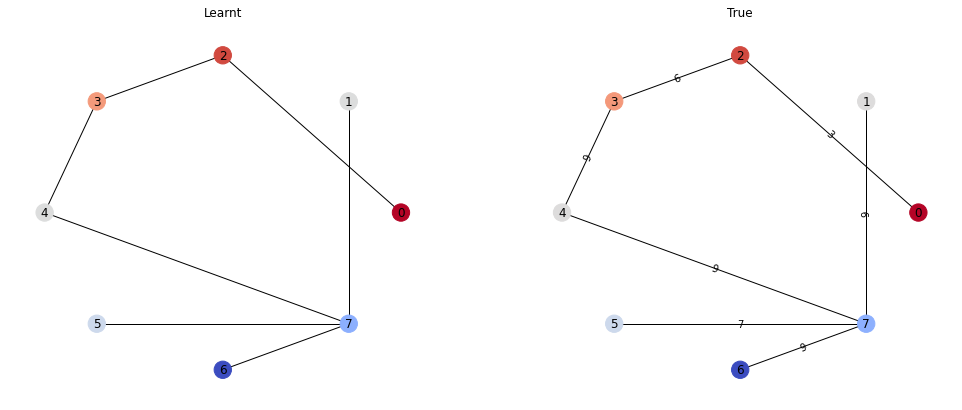

Passes: 6
tensor([17.9984, 28.9975, 26.9974, 36.9966,  2.0001, 18.9982, 33.9967,  7.9995,
        31.9970, 10.9991, 11.9989, 25.9975,  0.0000,  5.9995, 21.9978, 13.9986])
tensor([18., 29., 27., 37.,  2., 19., 34.,  8., 32., 11., 12., 26.,  0.,  6.,
        22., 14.])
Loss: 0.0017104148864746094	Similarity: 1.0


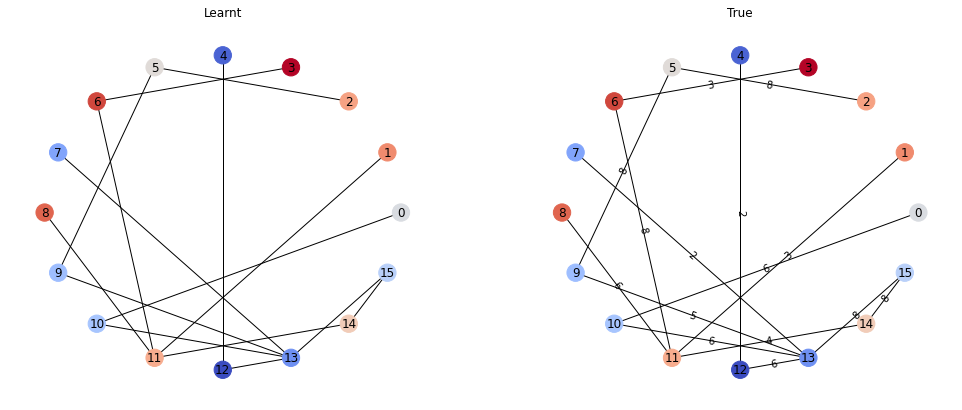

Passes: 3
tensor([ 4.9996, 12.9988,  2.0001, 18.9982,  9.9992,  0.0000,  3.9998])
tensor([ 5., 13.,  2., 19., 10.,  0.,  4.])
Loss: 0.0006366457091644406	Similarity: 1.0


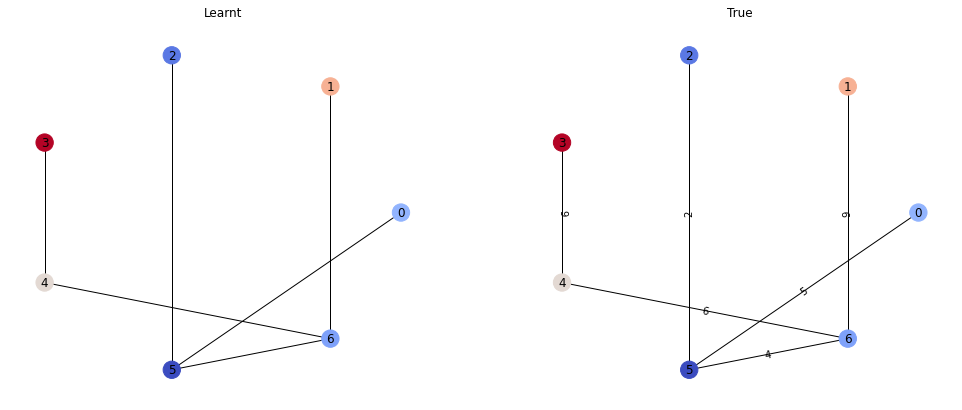

Passes: 4
tensor([22.9980, 18.9986, 20.9983, 16.9985, 10.9991, 15.9987,  8.9994, 23.9975,
        15.9983, 12.9988,  4.9996,  2.9999,  0.0000, 20.9979,  6.9993, 14.9985])
tensor([23., 19., 21., 17., 11., 16.,  9., 24., 16., 13.,  5.,  3.,  0., 21.,
         7., 15.])
Loss: 0.001224234700202942	Similarity: 1.0


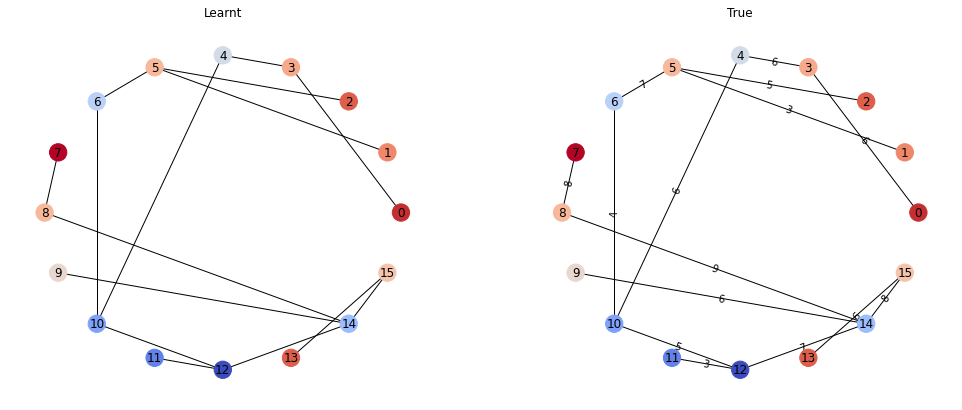

Passes: 7
tensor([38.9963, 32.9972, 36.9966, 25.9979,  0.0000,  8.9990, 26.9978, 21.9982,
        43.9959, 12.9988, 22.9980, 24.9981, 37.9965, 18.9986, 29.9973, 14.9989,
        20.9983])
tensor([39., 33., 37., 26.,  0.,  9., 27., 22., 44., 13., 23., 25., 38., 19.,
        30., 15., 21.])
Loss: 0.002154743066057563	Similarity: 1.0


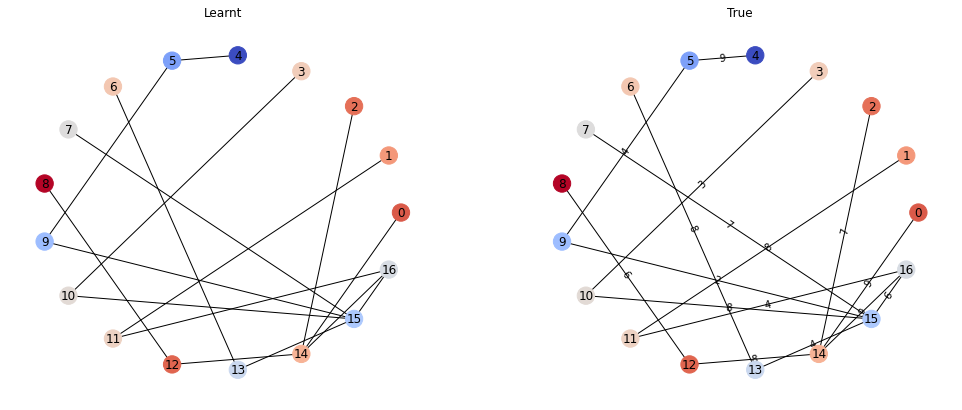

Passes: 4
tensor([24.9977, 27.9972, 14.9989,  0.0000, 24.9977, 20.9979, 12.9988,  4.9996])
tensor([25., 28., 15.,  0., 25., 21., 13.,  5.])
Loss: 0.0015276074409484863	Similarity: 1.0


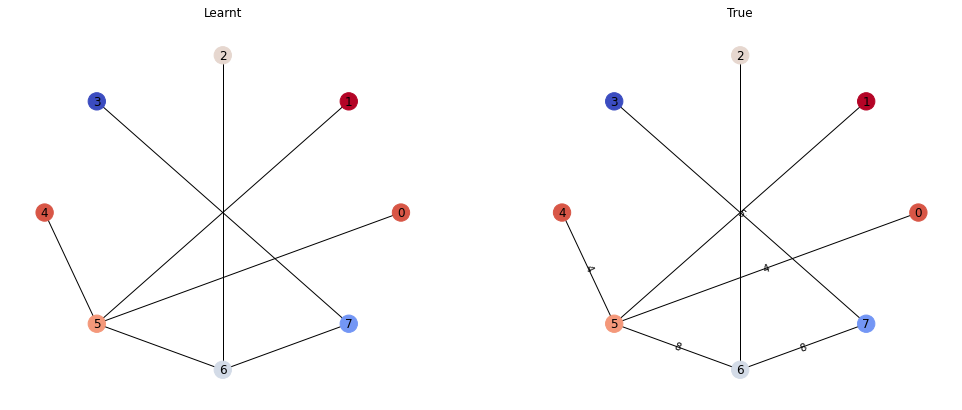

Passes: 3
tensor([ 5.9995, 17.9980,  9.9992, 13.9990,  7.9992, 17.9980,  2.9999,  0.0000,
        10.9991,  8.9990])
tensor([ 6., 18., 10., 14.,  8., 18.,  3.,  0., 11.,  9.])
Loss: 0.0009151697158813477	Similarity: 1.0


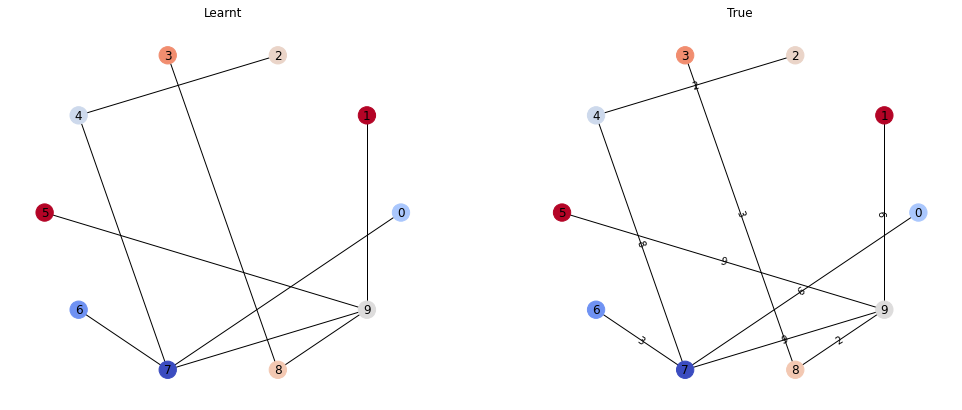

Passes: 4
tensor([16.9989, 19.9985, 13.9990,  7.9995,  6.9997,  8.9990,  0.0000,  3.9998,
        10.9991, 13.9990])
tensor([17., 20., 14.,  8.,  7.,  9.,  0.,  4., 11., 14.])
Loss: 0.0007493019220419228	Similarity: 1.0


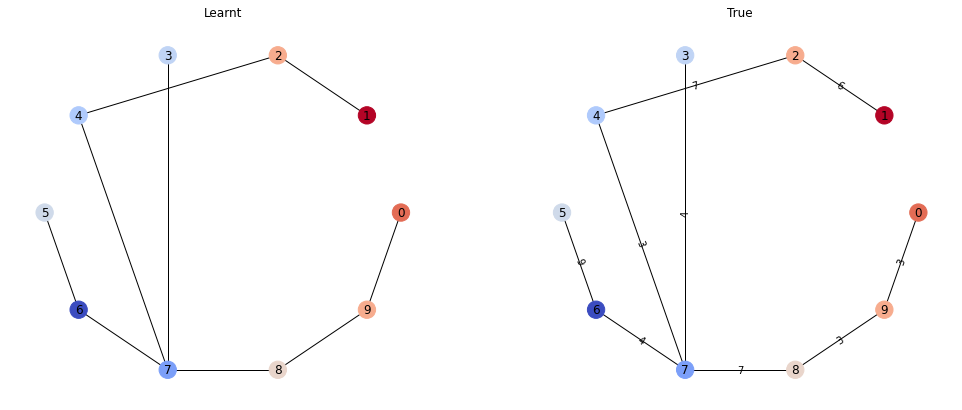

Passes: 4
tensor([13.9990, 17.9984, 16.9985, 10.9991, 29.9969,  2.9999, 20.9979, 12.9988,
         5.9995,  0.0000])
tensor([14., 18., 17., 11., 30.,  3., 21., 13.,  6.,  0.])
Loss: 0.0011987447505816817	Similarity: 1.0


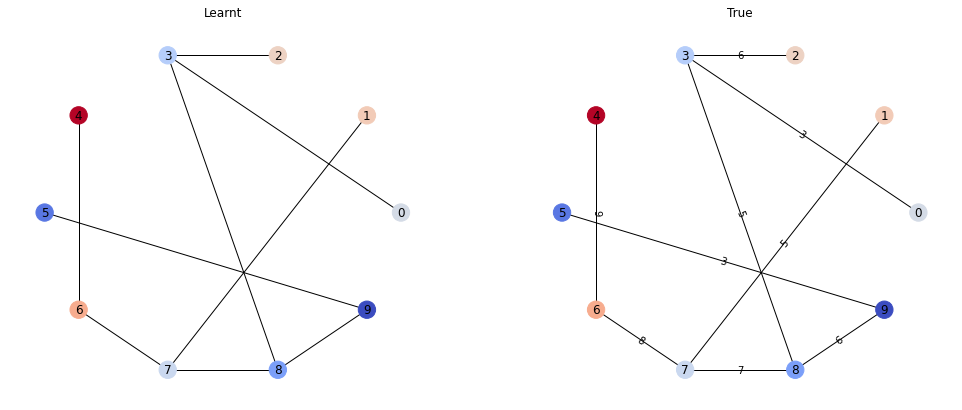

Passes: 4
tensor([14.9992,  0.0000, 12.9992,  5.9999,  8.9998,  5.0000,  2.0001])
tensor([15.,  0., 13.,  6.,  9.,  5.,  2.])
Loss: 0.00029345921939238906	Similarity: 1.0


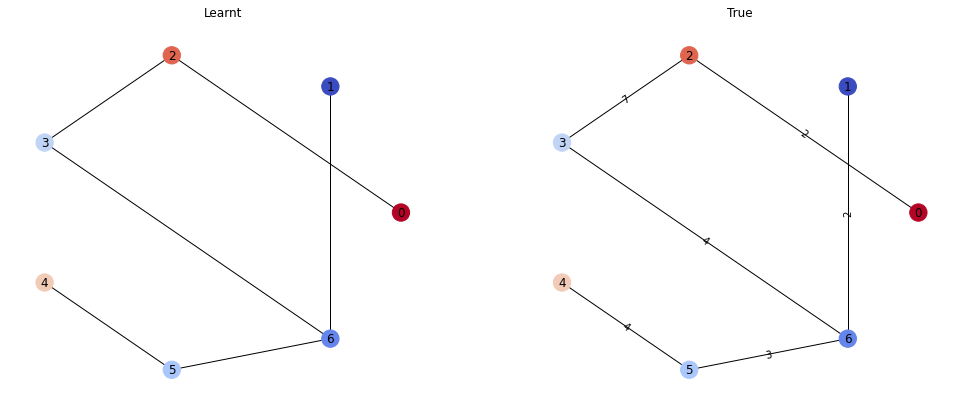

Passes: 3
tensor([ 7.9999,  9.9996,  5.0000, 10.9991, 10.9995,  7.9992,  0.0000,  2.9999,
         7.9999,  5.0000])
tensor([ 8., 10.,  5., 11., 11.,  8.,  0.,  3.,  8.,  5.])
Loss: 0.0002893686178140342	Similarity: 1.0


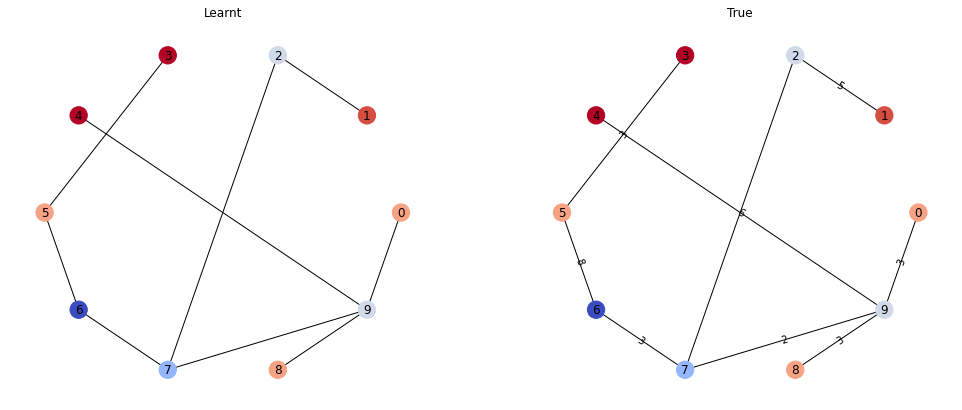

Passes: 4
tensor([12.9992, 19.9981, 17.9984, 19.9985,  8.9994, 14.9989,  9.9992, 18.9982,
        12.9988,  5.9995,  0.0000, 15.9987,  5.9999, 11.9989,  5.9999,  2.9999])
tensor([13., 20., 18., 20.,  9., 15., 10., 19., 13.,  6.,  0., 16.,  6., 12.,
         6.,  3.])
Loss: 0.0009197443723678589	Similarity: 1.0


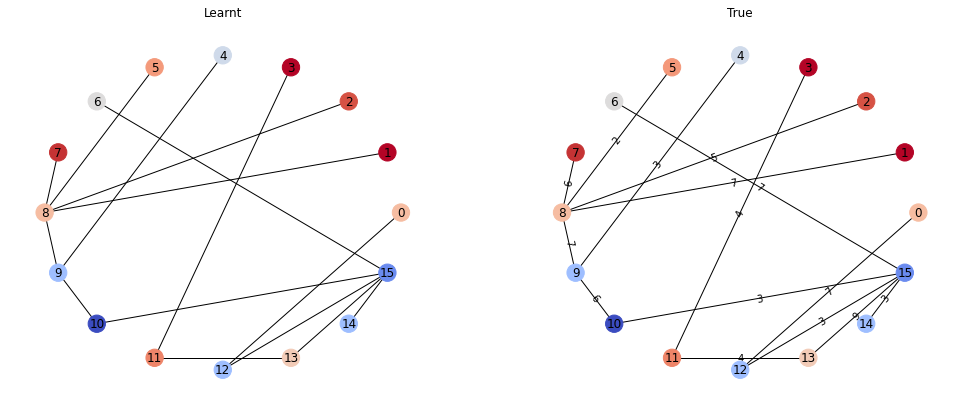

Passes: 6
tensor([24.9977, 22.9980, 29.9973,  6.9993, 32.9972, 20.9979, 14.9985, 27.9976,
         0.0000, 23.9978, 17.9984, 19.9981, 15.9983,  8.9990, 12.9988])
tensor([25., 23., 30.,  7., 33., 21., 15., 28.,  0., 24., 18., 20., 16.,  9.,
        13.])
Loss: 0.0017371495487168431	Similarity: 1.0


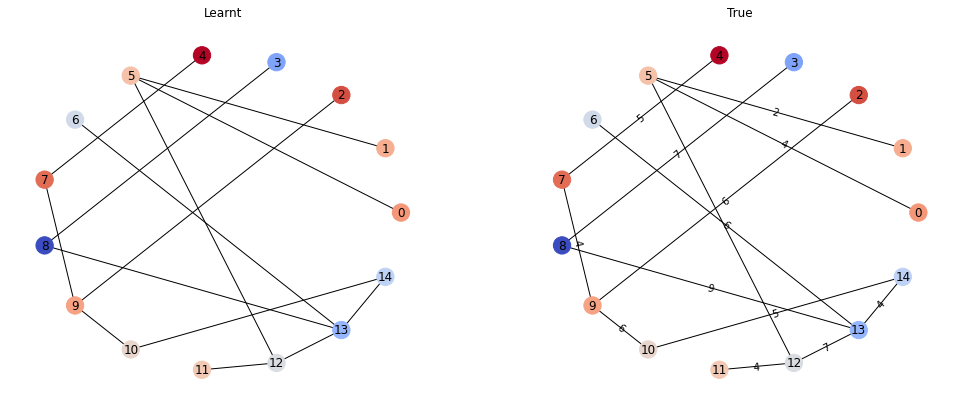

Passes: 5
tensor([ 5.9995, 32.9968, 19.9981, 25.9975, 15.9987,  8.9990, 21.9982, 12.9988,
         0.0000, 16.9985, 12.9988,  9.9992, 14.9985,  7.9992])
tensor([ 6., 33., 20., 26., 16.,  9., 22., 13.,  0., 17., 13., 10., 15.,  8.])
Loss: 0.0013784340117126703	Similarity: 1.0


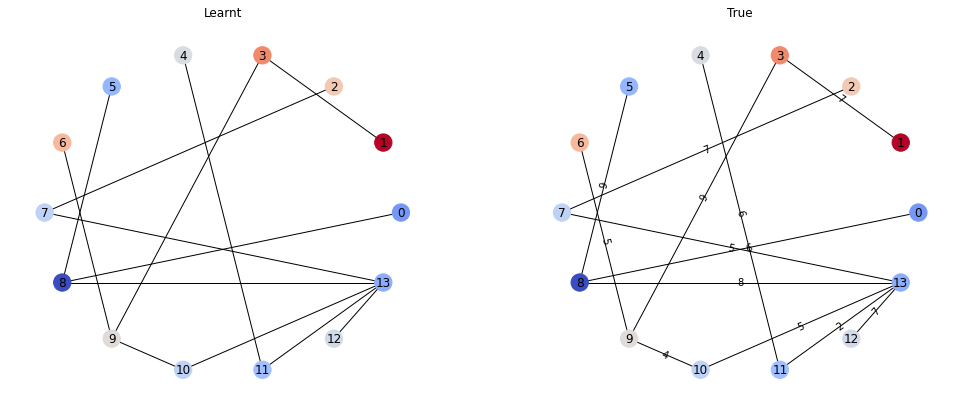

Passes: 4
tensor([10.9995,  4.9996, 17.9988, 20.9983, 13.9990, 11.9989, 17.9984,  5.9995,
         0.0000, 13.9986, 15.9987, 19.9985,  8.9994, 15.9987,  8.9994,  6.9993])
tensor([11.,  5., 18., 21., 14., 12., 18.,  6.,  0., 14., 16., 20.,  9., 16.,
         9.,  7.])
Loss: 0.0009675920009613037	Similarity: 1.0


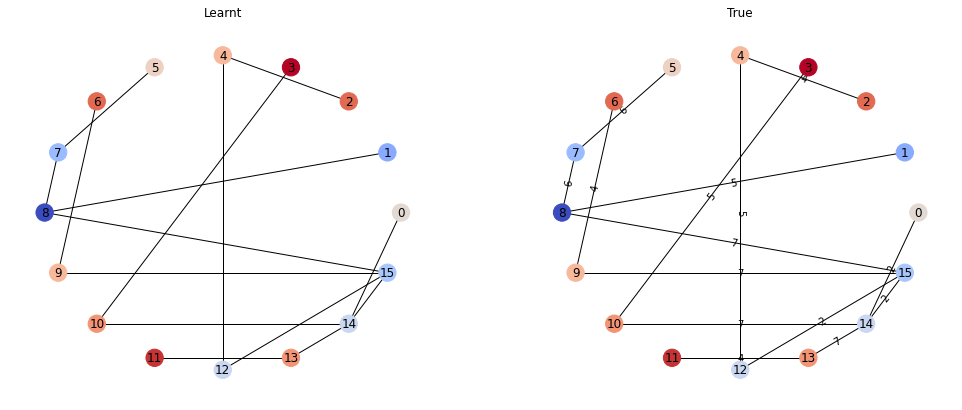

Passes: 6
tensor([13.9994, 23.9982, 29.9977, 28.9979, 14.9992,  0.0000, 20.9983,  2.0001,
        15.9991, 12.9992, 25.9979, 23.9986,  8.9998, 20.9987, 18.9986, 17.9988,
         9.9996,  5.9999])
tensor([14., 24., 30., 29., 15.,  0., 21.,  2., 16., 13., 26., 24.,  9., 21.,
        19., 18., 10.,  6.])
Loss: 0.0010641150875017047	Similarity: 1.0


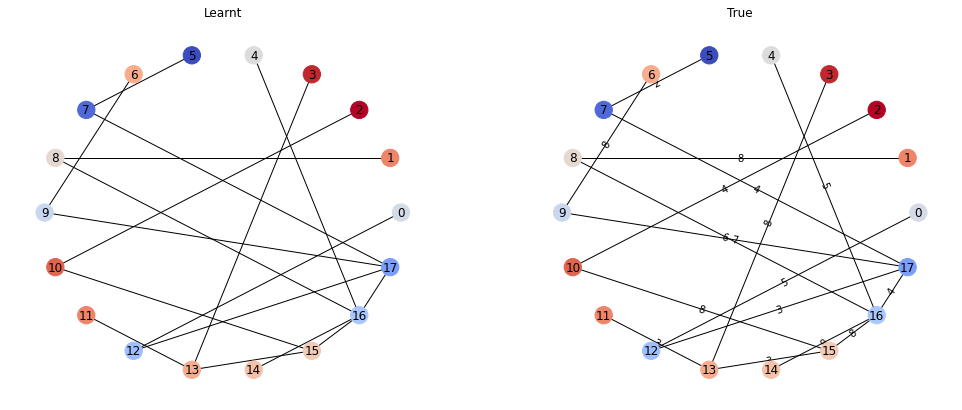

Passes: 5
tensor([28.9975, 13.9990,  8.9994, 10.9991, 19.9985,  3.9998, 13.9990, 11.9993,
         6.9997,  2.0001,  0.0000])
tensor([29., 14.,  9., 11., 20.,  4., 14., 12.,  7.,  2.,  0.])
Loss: 0.0008072853088378906	Similarity: 1.0


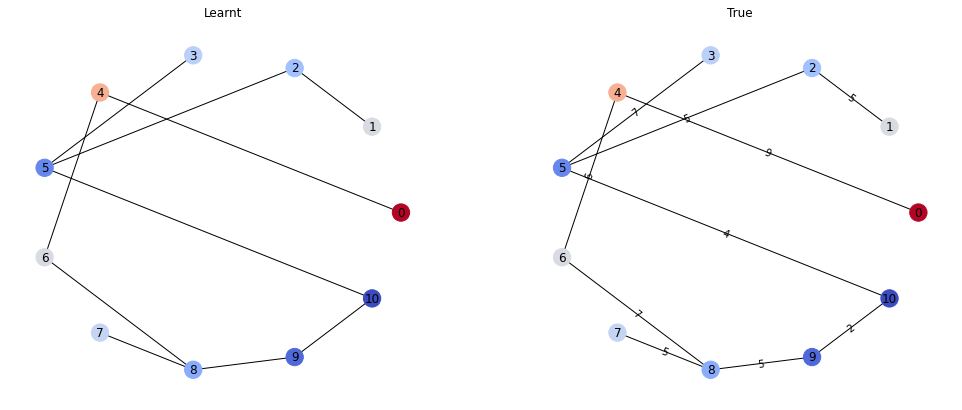

Passes: 5
tensor([22.9980, 31.9970, 19.9985, 29.9973, 22.9980,  0.0000, 11.9989, 16.9985,
        13.9986, 17.9980, 23.9978, 23.9978, 19.9981, 11.9989, 14.9989, 12.9988,
        13.9986,  8.9990])
tensor([23., 32., 20., 30., 23.,  0., 12., 17., 14., 18., 24., 24., 20., 12.,
        15., 13., 14.,  9.])
Loss: 0.0016226238803938031	Similarity: 1.0


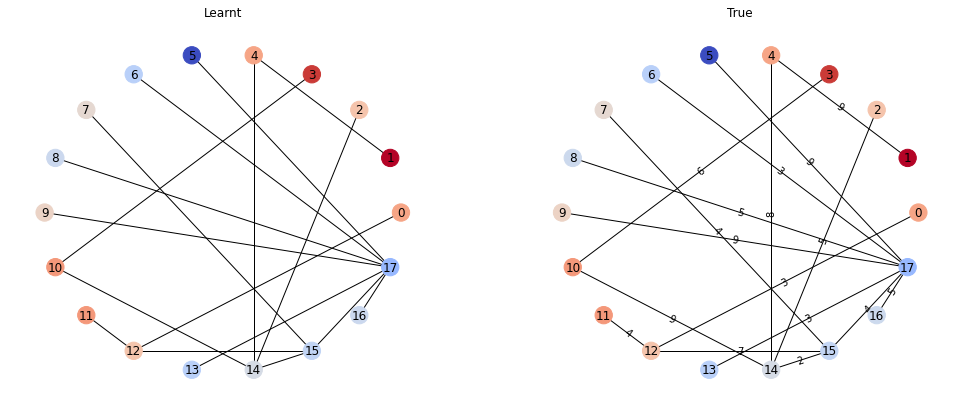

Passes: 9
tensor([38.9963,  0.0000, 44.9962, 39.9965, 21.9978, 42.9965, 24.9981,  8.9990,
        49.9954, 49.9958, 47.9957, 37.9972, 50.9956, 33.9975, 45.9960, 38.9967,
        13.9986, 29.9973, 22.9980, 20.9979, 34.9969, 33.9971, 40.9964, 31.9974,
        29.9973, 22.9980, 31.9974, 26.9978])
tensor([39.,  0., 45., 40., 22., 43., 25.,  9., 50., 50., 48., 38., 51., 34.,
        46., 39., 14., 30., 23., 21., 35., 34., 41., 32., 30., 23., 32., 27.])
Loss: 0.002841370413079858	Similarity: 1.0


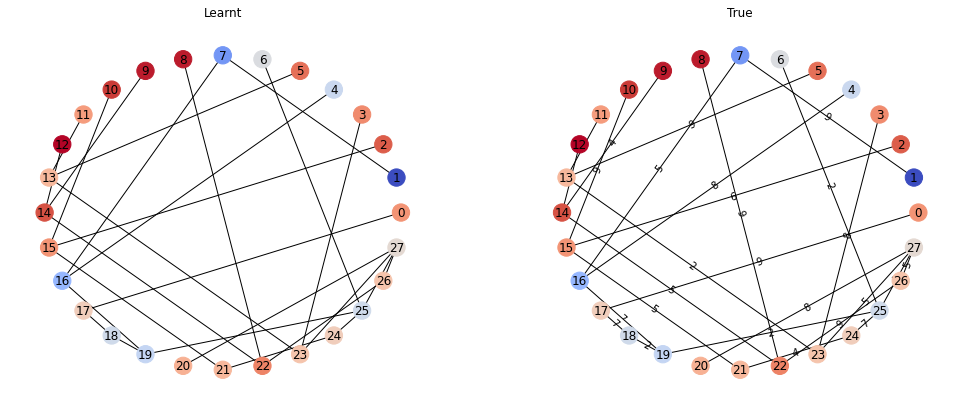

Passes: 4
tensor([19.9985, 17.9984, 10.9991,  9.9992, 22.9980, 21.9982, 14.9992, 15.9987,
        12.9992, 22.9980, 16.9985, 13.9990,  5.9999, 13.9986,  2.0001,  3.9998,
         0.0000,  4.9996,  9.9992, 15.9987])
tensor([20., 18., 11., 10., 23., 22., 15., 16., 13., 23., 17., 14.,  6., 14.,
         2.,  4.,  0.,  5., 10., 16.])
Loss: 0.00101556780282408	Similarity: 1.0


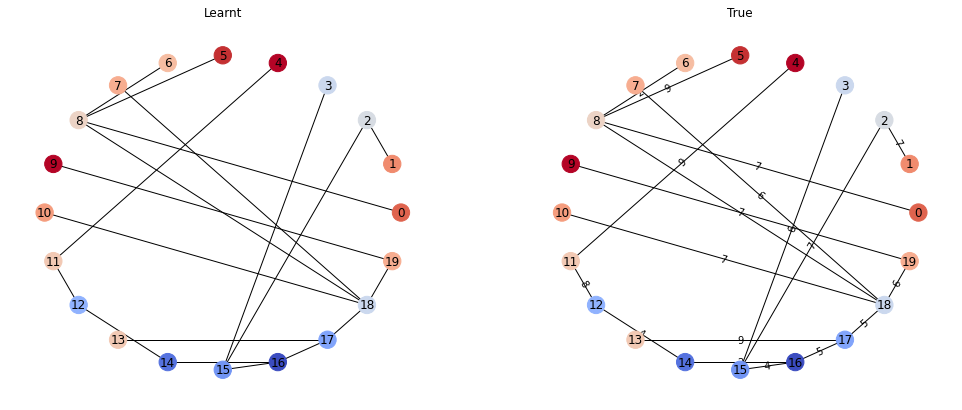

Passes: 8
tensor([ 0.0000, 22.9984, 16.9989, 34.9977, 32.9976, 29.9977, 36.9970, 18.9986,
        30.9975, 26.9978, 32.9976,  3.9998, 23.9982, 23.9982, 25.9983, 30.9975,
        17.9988, 15.9987, 10.9991, 25.9979, 31.9974, 28.9979, 23.9982, 20.9983,
        14.9989])
tensor([ 0., 23., 17., 35., 33., 30., 37., 19., 31., 27., 33.,  4., 24., 24.,
        26., 31., 18., 16., 11., 26., 32., 29., 24., 21., 15.])
Loss: 0.0017511749174445868	Similarity: 1.0


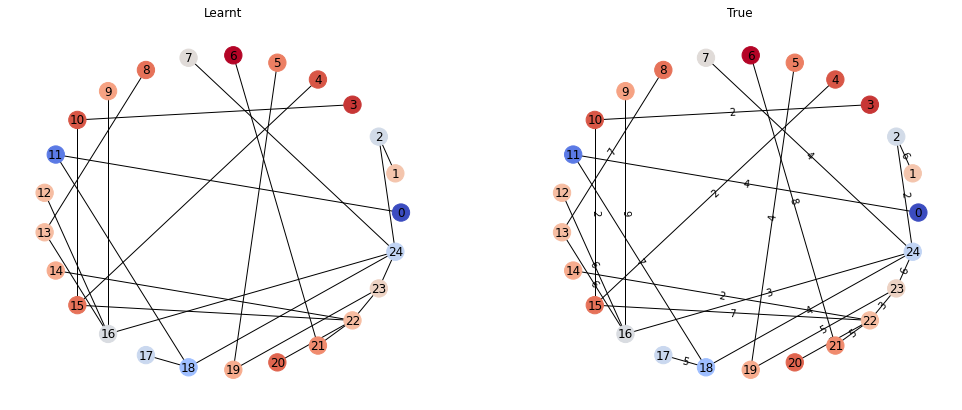

Passes: 6
tensor([28.9979,  8.9994, 30.9975, 33.9971,  5.0000, 23.9978, 25.9979,  0.0000,
        24.9981,  2.0001, 18.9982, 29.9973, 18.9986, 25.9979, 24.9981, 24.9981,
        22.9980, 21.9982, 24.9981, 19.9985, 13.9990, 18.9986, 15.9987, 10.9991])
tensor([29.,  9., 31., 34.,  5., 24., 26.,  0., 25.,  2., 19., 30., 19., 26.,
        25., 25., 23., 22., 25., 20., 14., 19., 16., 11.])
Loss: 0.001582503318786621	Similarity: 1.0


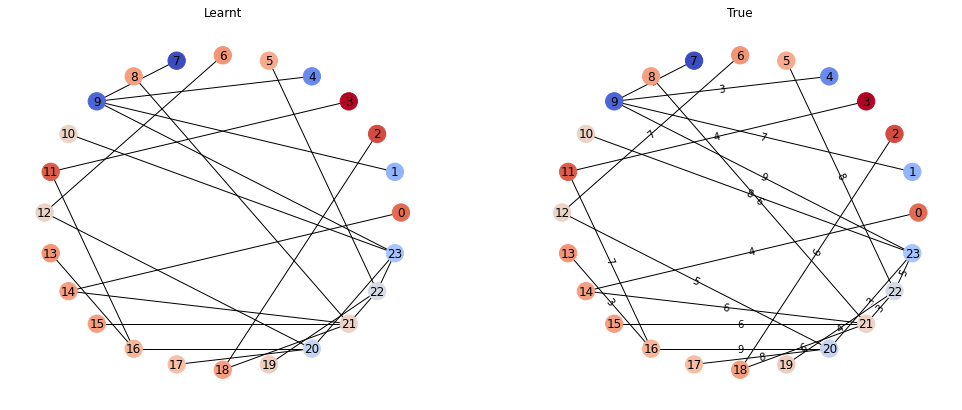

Passes: 4
tensor([11.9989, 25.9975,  6.9993,  8.9994,  0.0000, 19.9981,  4.9996, 11.9989])
tensor([12., 26.,  7.,  9.,  0., 20.,  5., 12.])
Loss: 0.0010276436805725098	Similarity: 1.0


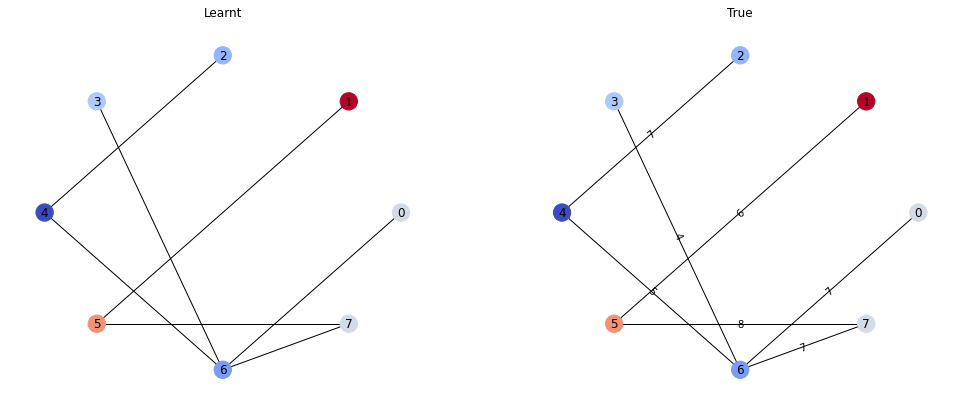

Passes: 6
tensor([12.9992,  5.9999,  8.9994, 20.9983, 36.9966, 10.9995, 11.9993, 15.9987,
        31.9974, 28.9975, 36.9962, 10.9991, 27.9972, 20.9983, 16.9985, 24.9977,
         7.9995, 18.9982,  9.9992,  5.9999,  4.0002,  6.9997, 16.9985,  8.9994,
         2.9999,  2.0001,  0.0000])
tensor([13.,  6.,  9., 21., 37., 11., 12., 16., 32., 29., 37., 11., 28., 21.,
        17., 25.,  8., 19., 10.,  6.,  4.,  7., 17.,  9.,  3.,  2.,  0.])
Loss: 0.0012244030367583036	Similarity: 1.0


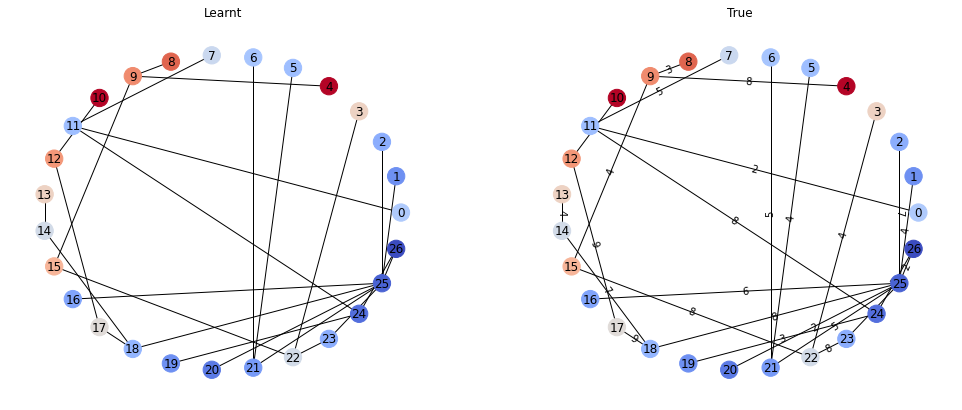

Passes: 6
tensor([40.9960, 29.9969, 37.9961, 36.9966, 33.9967, 28.9971,  2.9999, 30.9968,
         0.0000, 29.9973, 25.9975,  8.9990, 21.9978, 21.9978, 20.9979, 17.9980])
tensor([41., 30., 38., 37., 34., 29.,  3., 31.,  0., 30., 26.,  9., 22., 22.,
        21., 18.])
Loss: 0.0024145692586898804	Similarity: 1.0


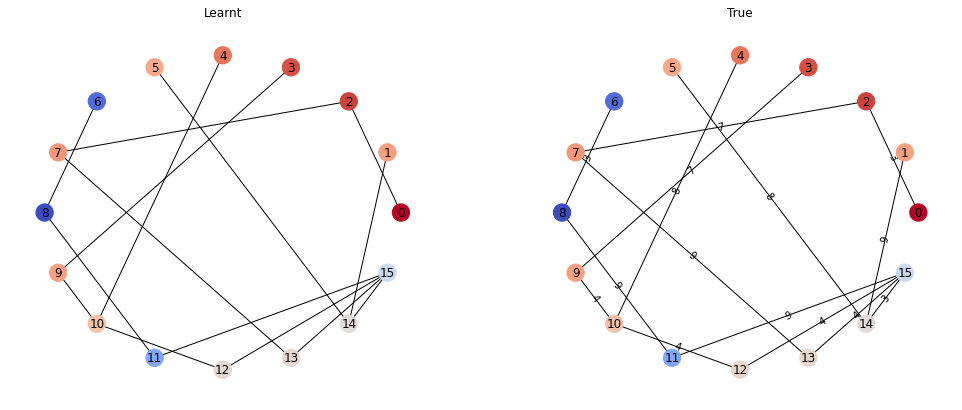

Passes: 5
tensor([23.9982, 14.9992, 12.9996, 27.9976, 11.9993, 15.9991, 13.9990,  0.0000,
        22.9984, 19.9981, 13.9990, 28.9975, 19.9985,  6.9997, 18.9986, 15.9987,
        10.9991,  4.9996,  8.9998, 12.9992,  6.9997])
tensor([24., 15., 13., 28., 12., 16., 14.,  0., 23., 20., 14., 29., 20.,  7.,
        19., 16., 11.,  5.,  9., 13.,  7.])
Loss: 0.0010563305113464594	Similarity: 1.0


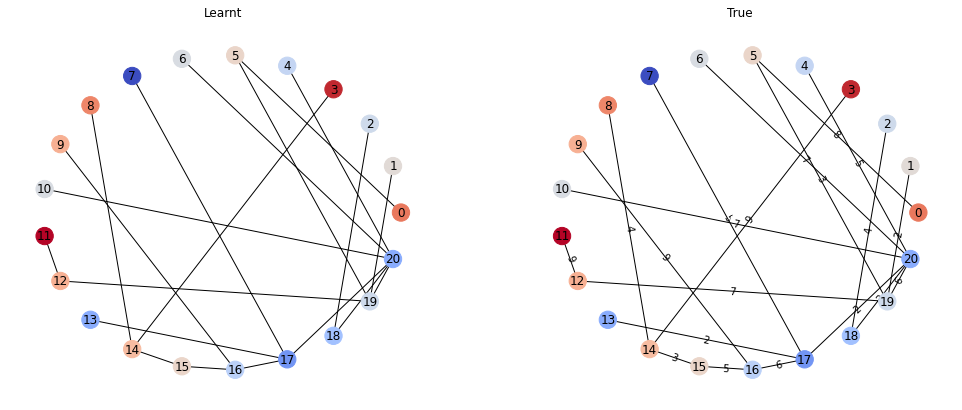

Passes: 8
tensor([40.9968, 25.9975, 28.9975,  0.0000, 25.9979, 31.9978, 27.9980, 26.9982,
        34.9965, 22.9980, 18.9982, 30.9972, 38.9967, 34.9973, 24.9981,  4.9996,
        26.9982, 21.9982, 28.9971, 19.9981, 25.9983, 13.9986, 15.9987, 30.9975,
        23.9982, 24.9981, 18.9986])
tensor([41., 26., 29.,  0., 26., 32., 28., 27., 35., 23., 19., 31., 39., 35.,
        25.,  5., 27., 22., 29., 20., 26., 14., 16., 31., 24., 25., 19.])
Loss: 0.0020389026030898094	Similarity: 1.0


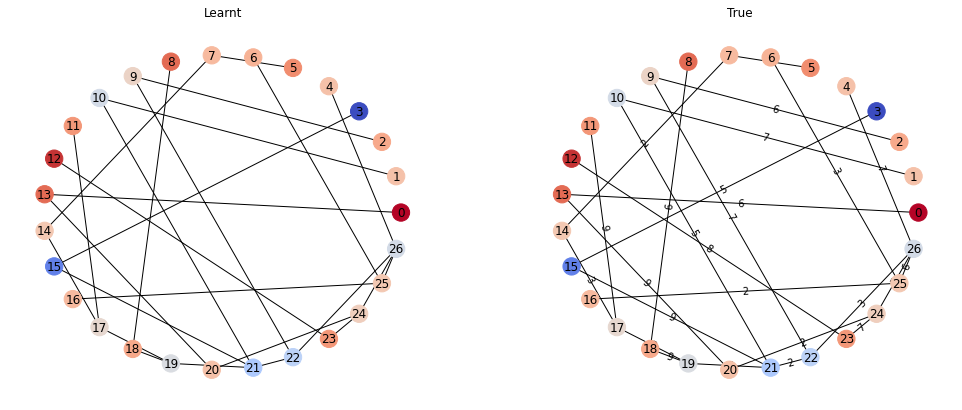

Passes: 3
tensor([ 0.0000, 17.9984, 16.9985,  6.9997,  9.9992, 11.9989,  3.9998])
tensor([ 0., 18., 17.,  7., 10., 12.,  4.])
Loss: 0.0007776533020660281	Similarity: 1.0


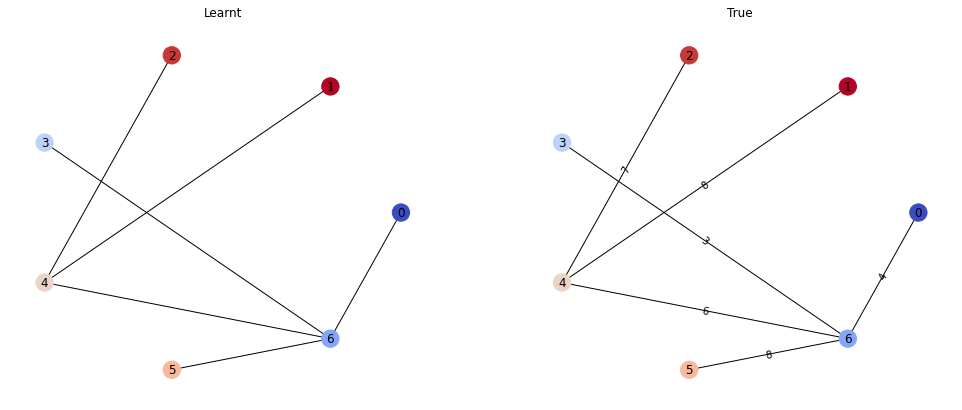

Passes: 8
tensor([27.9976, 20.9983, 26.9982, 10.9991, 36.9974, 32.9976, 26.9982,  0.0000,
        33.9975, 25.9975, 19.9981, 33.9975, 11.9993, 17.9984, 16.9985, 29.9977,
        13.9986, 22.9984, 31.9974,  4.9996, 22.9984,  9.9992, 18.9986, 22.9984,
        24.9981, 13.9990, 19.9985])
tensor([28., 21., 27., 11., 37., 33., 27.,  0., 34., 26., 20., 34., 12., 18.,
        17., 30., 14., 23., 32.,  5., 23., 10., 19., 23., 25., 14., 20.])
Loss: 0.001662024762481451	Similarity: 1.0


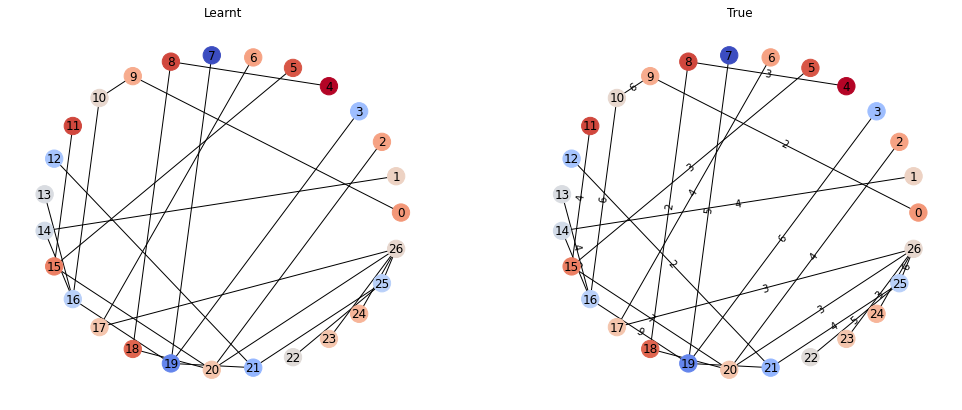

Passes: 4
tensor([ 4.9996, 16.9989, 14.9989,  7.9995,  0.0000,  6.9997,  3.9998])
tensor([ 5., 17., 15.,  8.,  0.,  7.,  4.])
Loss: 0.0005117825348861516	Similarity: 1.0


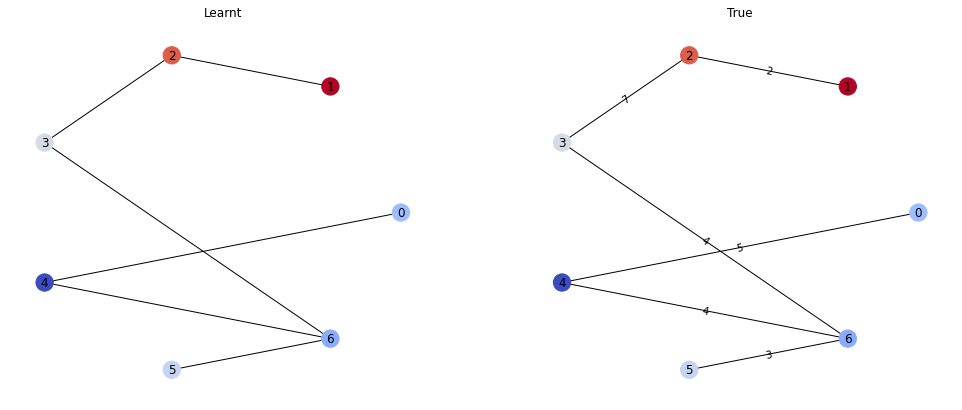

Passes: 5
tensor([34.9965,  7.9992, 25.9975, 19.9981, 13.9986, 16.9989, 13.9986, 11.9993,
         0.0000, 10.9995,  4.9996,  8.9994])
tensor([35.,  8., 26., 20., 14., 17., 14., 12.,  0., 11.,  5.,  9.])
Loss: 0.0012280941009521484	Similarity: 1.0


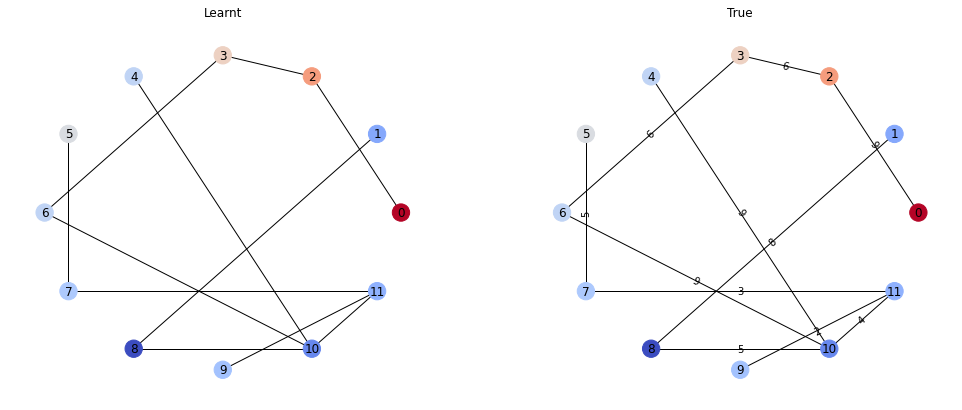

Passes: 7
tensor([36.9962, 21.9978, 46.9955, 26.9978, 24.9977, 14.9989, 23.9975, 16.9985,
        27.9972, 39.9962, 43.9955, 29.9973, 23.9978, 36.9962, 30.9972, 14.9989,
        32.9968,  0.0000, 14.9985,  8.9990, 27.9972, 22.9980, 28.9971, 20.9979,
        11.9989])
tensor([37., 22., 47., 27., 25., 15., 24., 17., 28., 40., 44., 30., 24., 37.,
        31., 15., 33.,  0., 15.,  9., 28., 23., 29., 21., 12.])
Loss: 0.0024168395902961493	Similarity: 1.0


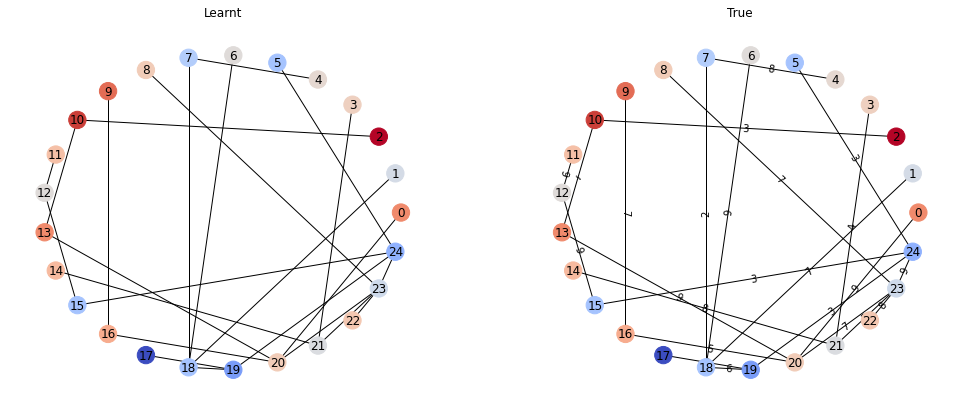

Passes: 3
tensor([ 0.0000,  8.9990, 21.9978, 14.9985])
tensor([ 0.,  9., 22., 15.])
Loss: 0.001194000244140625	Similarity: 1.0


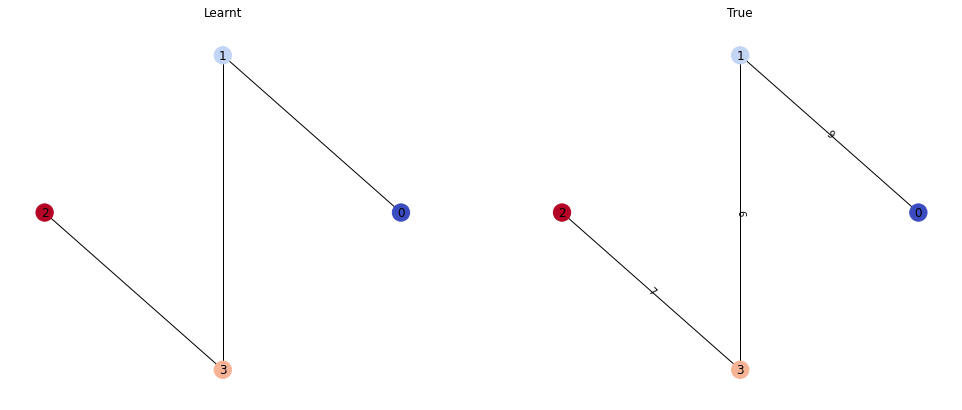

Passes: 4
tensor([14.9989, 17.9988,  0.0000, 14.9992, 11.9993,  3.9998, 11.9993,  5.9999])
tensor([15., 18.,  0., 15., 12.,  4., 12.,  6.])
Loss: 0.0006090998649597168	Similarity: 1.0


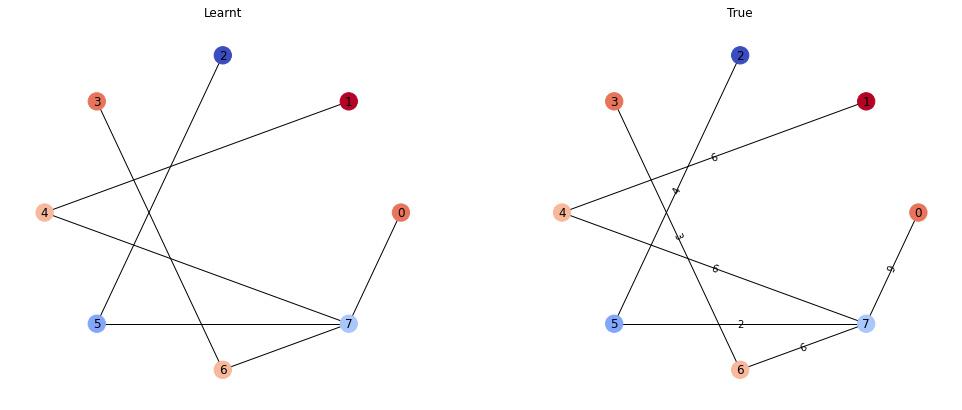

Passes: 5
tensor([ 2.9999, 28.9975, 18.9982,  6.9993, 16.9985, 20.9983,  9.9992,  2.9999,
        15.9987,  8.9994, 18.9982, 10.9991, 10.9991,  0.0000,  2.0001])
tensor([ 3., 29., 19.,  7., 17., 21., 10.,  3., 16.,  9., 19., 11., 11.,  0.,
         2.])
Loss: 0.0009774526115506887	Similarity: 1.0


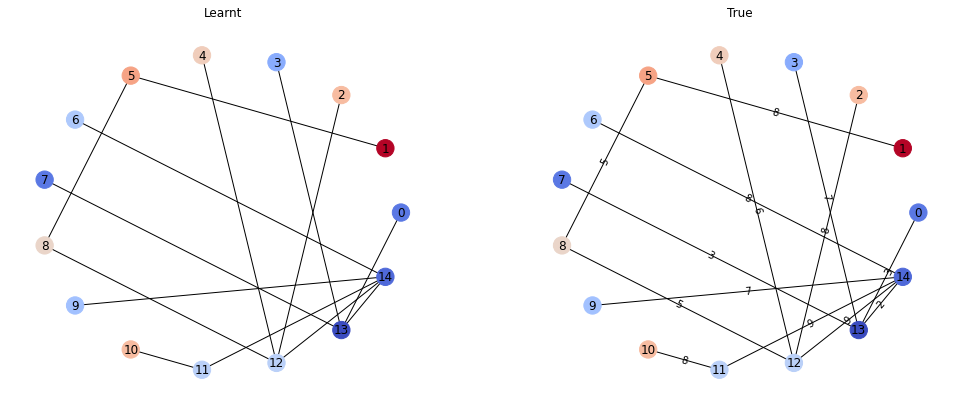

Passes: 4
tensor([17.9984,  8.9994, 18.9986,  5.9995, 14.9985, 17.9984, 14.9992, 16.9985,
        12.9988,  9.9996, 25.9975, 13.9986, 13.9990,  7.9992,  0.0000, 20.9979,
        16.9985, 11.9989,  5.9999, 16.9989,  3.9998, 12.9992,  5.9999])
tensor([18.,  9., 19.,  6., 15., 18., 15., 17., 13., 10., 26., 14., 14.,  8.,
         0., 21., 17., 12.,  6., 17.,  4., 13.,  6.])
Loss: 0.0010365403722971678	Similarity: 1.0


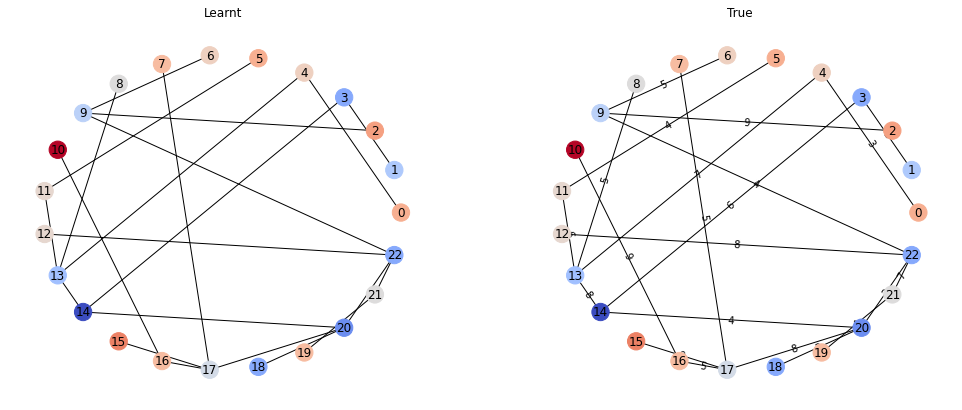

Passes: 5
tensor([18.9986, 28.9971, 21.9978, 13.9986, 27.9976, 14.9989, 20.9979, 33.9967,
        19.9981, 11.9989, 33.9967, 16.9981, 24.9977, 11.9989,  8.9990, 21.9978,
        16.9985,  0.0000,  8.9990, 12.9988])
tensor([19., 29., 22., 14., 28., 15., 21., 34., 20., 12., 34., 17., 25., 12.,
         9., 22., 17.,  0.,  9., 13.])
Loss: 0.001764917396940291	Similarity: 1.0


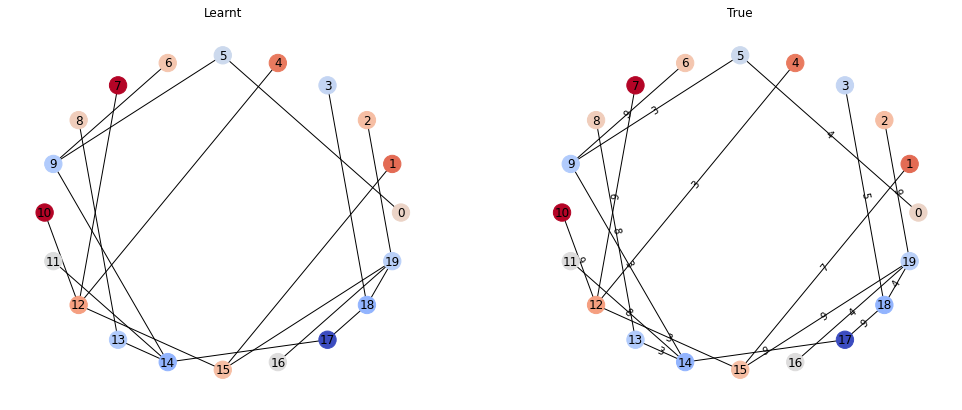

Passes: 7
tensor([17.9988, 24.9981, 20.9983,  0.0000,  7.9995, 19.9985, 41.9962, 16.9985,
        33.9971, 19.9989, 15.9991, 17.9984, 37.9965, 24.9981, 31.9974, 28.9975,
         4.9996, 15.9991, 14.9989, 22.9984, 20.9983, 13.9990, 23.9982, 20.9983,
        11.9993,  8.9994, 15.9987])
tensor([18., 25., 21.,  0.,  8., 20., 42., 17., 34., 20., 16., 18., 38., 25.,
        32., 29.,  5., 16., 15., 23., 21., 14., 24., 21., 12.,  9., 16.])
Loss: 0.0015552309341728687	Similarity: 1.0


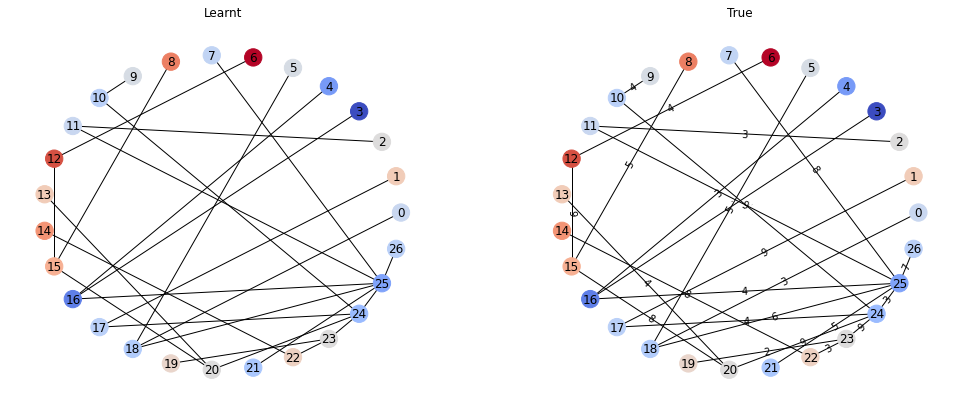

Passes: 4
tensor([28.9971, 23.9978, 31.9966, 13.9990, 17.9984, 24.9973,  0.0000, 22.9976,
        11.9989, 22.9976, 24.9973, 16.9981, 12.9988,  8.9990, 15.9983, 18.9982])
tensor([29., 24., 32., 14., 18., 25.,  0., 23., 12., 23., 25., 17., 13.,  9.,
        16., 19.])
Loss: 0.0018665194511413574	Similarity: 1.0


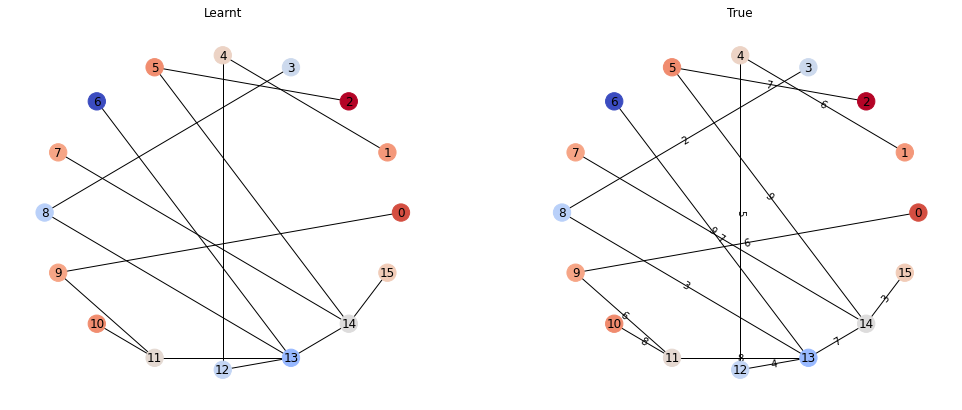

Passes: 7
tensor([29.9981, 40.9964, 28.9983, 27.9984, 36.9966, 25.9979, 27.9980, 11.9989,
        27.9980, 25.9983,  0.0000, 20.9987, 23.9982, 23.9982, 12.9992, 23.9982,
        27.9976, 18.9986, 13.9994, 11.9993,  7.9995,  2.9999, 10.9991])
tensor([30., 41., 29., 28., 37., 26., 28., 12., 28., 26.,  0., 21., 24., 24.,
        13., 24., 28., 19., 14., 12.,  8.,  3., 11.])
Loss: 0.0015186123782768846	Similarity: 1.0


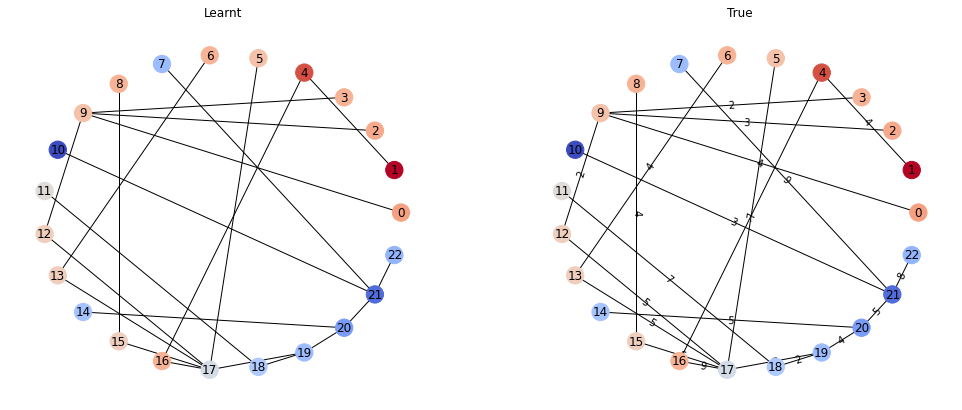

Passes: 9
tensor([15.9983, 59.9942, 55.9945, 53.9948, 17.9984, 36.9966, 31.9970, 43.9959,
        41.9958,  0.0000, 41.9958, 44.9954, 37.9961, 15.9983,  8.9990, 49.9950,
        39.9962, 38.9963, 43.9955, 36.9962, 32.9968, 14.9985, 30.9968, 28.9971,
        21.9978])
tensor([16., 60., 56., 54., 18., 37., 32., 44., 42.,  0., 42., 45., 38., 16.,
         9., 50., 40., 39., 44., 37., 33., 15., 31., 29., 22.])
Loss: 0.003347549354657531	Similarity: 1.0


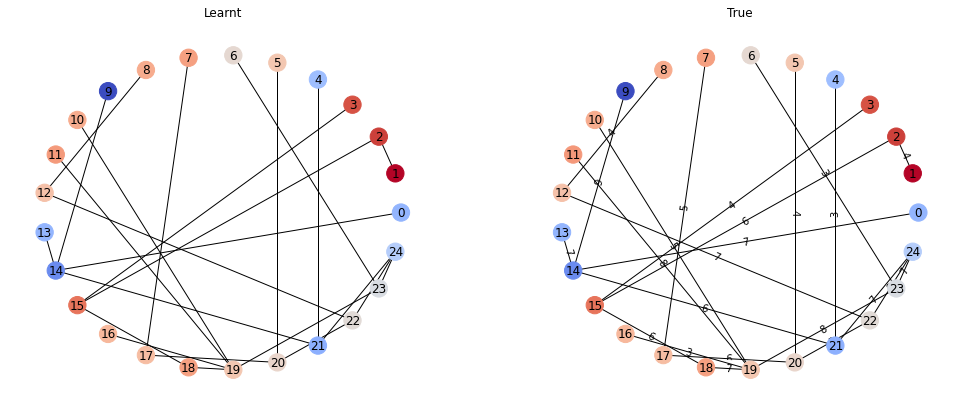

Passes: 2
tensor([ 9.9992,  8.9994, 10.9991,  3.9998,  5.9995,  0.0000, 12.9988,  9.9992,
         5.9995])
tensor([10.,  9., 11.,  4.,  6.,  0., 13., 10.,  6.])
Loss: 0.000621795654296875	Similarity: 1.0


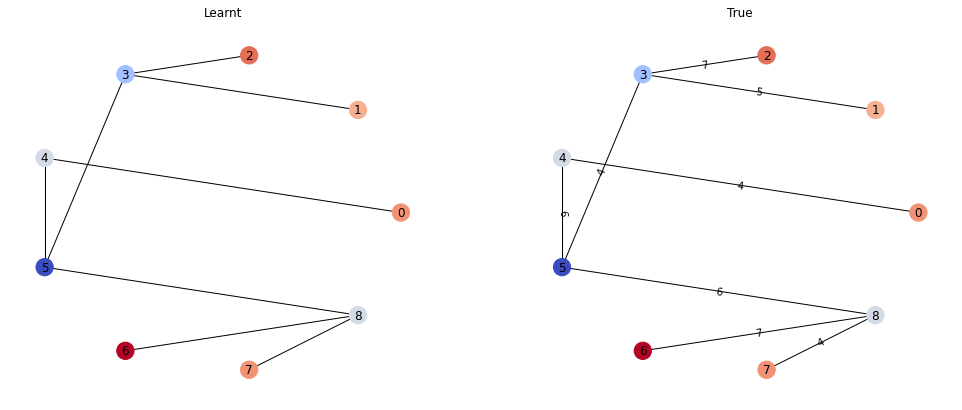

Passes: 5
tensor([18.9982,  5.9995,  4.9996, 25.9975, 33.9967, 10.9991, 23.9978, 16.9985,
        24.9977,  0.0000,  4.9996, 17.9984, 14.9989,  9.9992])
tensor([19.,  6.,  5., 26., 34., 11., 24., 17., 25.,  0.,  5., 18., 15., 10.])
Loss: 0.0013717924011871219	Similarity: 1.0


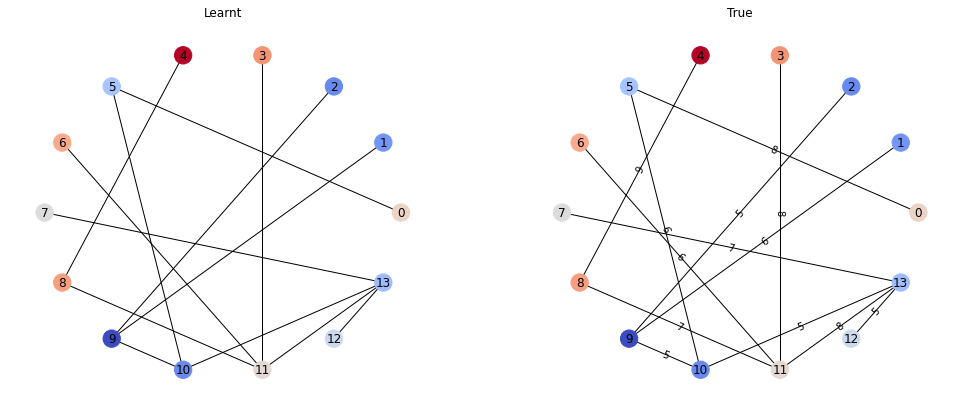

Passes: 5
tensor([ 0.0000, 31.9970,  6.9993,  9.9992, 17.9984, 22.9980, 31.9970])
tensor([ 0., 32.,  7., 10., 18., 23., 32.])
Loss: 0.0015813282225281	Similarity: 1.0


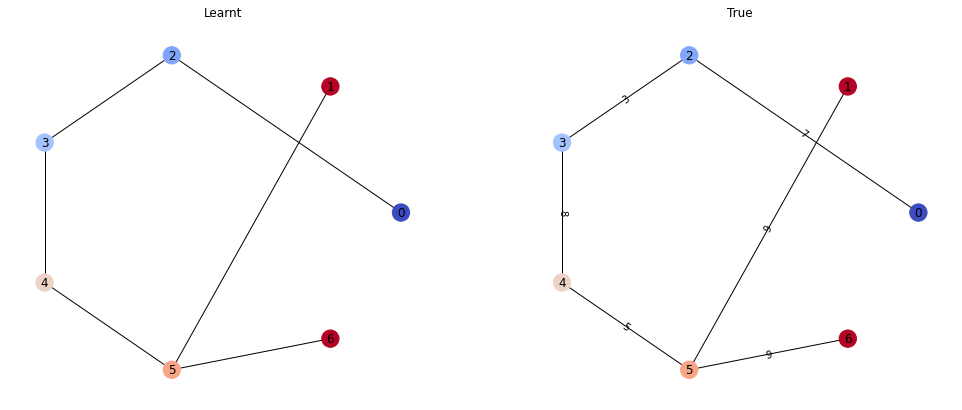

Passes: 6
tensor([20.9983, 18.9982, 24.9977, 17.9988, 22.9980, 19.9981, 18.9982, 30.9975,
        22.9984, 17.9984, 14.9989, 19.9981,  0.0000, 18.9982, 10.9991, 18.9986,
        16.9985,  3.9998, 15.9987, 12.9988])
tensor([21., 19., 25., 18., 23., 20., 19., 31., 23., 18., 15., 20.,  0., 19.,
        11., 19., 17.,  4., 16., 13.])
Loss: 0.0014850615989416838	Similarity: 1.0


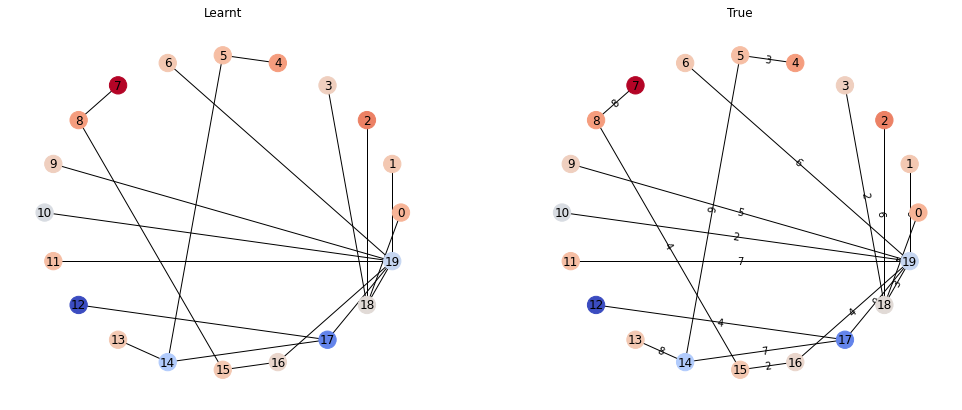

Passes: 5
tensor([15.9987, 11.9989, 11.9993, 21.9986, 14.9992, 16.9989, 22.9984, 16.9989,
        12.9992, 18.9986, 12.9992,  6.9997, 15.9987,  0.0000, 12.9992,  3.9998,
         8.9994])
tensor([16., 12., 12., 22., 15., 17., 23., 17., 13., 19., 13.,  7., 16.,  0.,
        13.,  4.,  9.])
Loss: 0.0009025685722008348	Similarity: 1.0


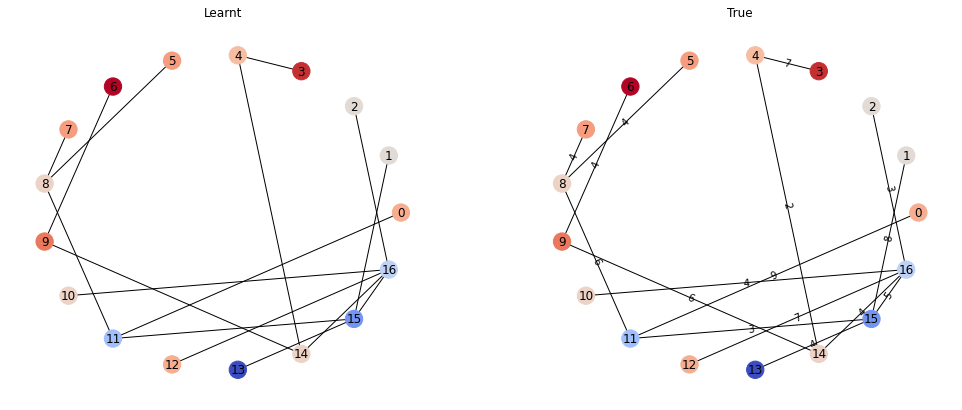

Passes: 6
tensor([31.9974, 17.9984, 28.9975, 29.9973,  0.0000, 35.9968, 25.9979, 28.9975,
        15.9987, 15.9987, 23.9978, 25.9975, 16.9985, 28.9975,  8.9994, 29.9973,
        26.9978, 20.9979, 14.9985, 23.9978, 30.9972, 26.9974,  6.9993, 23.9978,
        12.9988, 17.9984])
tensor([32., 18., 29., 30.,  0., 36., 26., 29., 16., 16., 24., 26., 17., 29.,
         9., 30., 27., 21., 15., 24., 31., 27.,  7., 24., 13., 18.])
Loss: 0.0019589571747928858	Similarity: 1.0


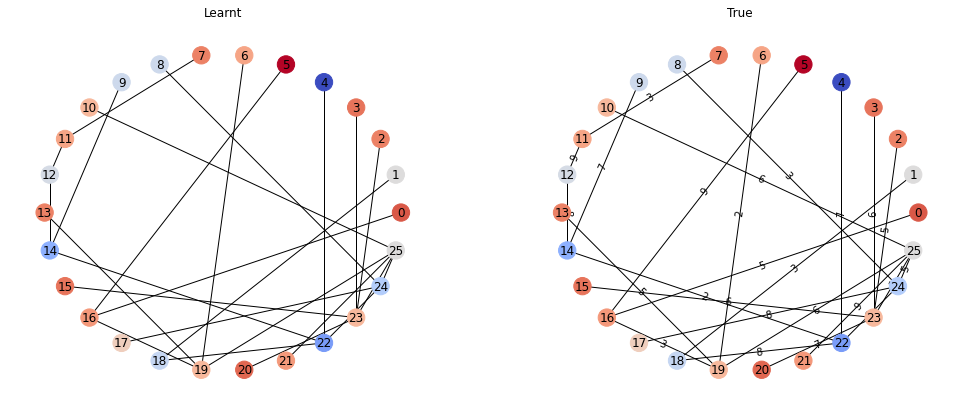

Passes: 9
tensor([55.9949,  3.9998, 46.9959,  0.0000, 41.9962, 30.9975, 10.9995, 31.9974,
        39.9966, 42.9961, 35.9968, 28.9975,  3.9998, 24.9977,  8.9994, 17.9984])
tensor([56.,  4., 47.,  0., 42., 31., 11., 32., 40., 43., 36., 29.,  4., 25.,
         9., 18.])
Loss: 0.002295196056365967	Similarity: 1.0


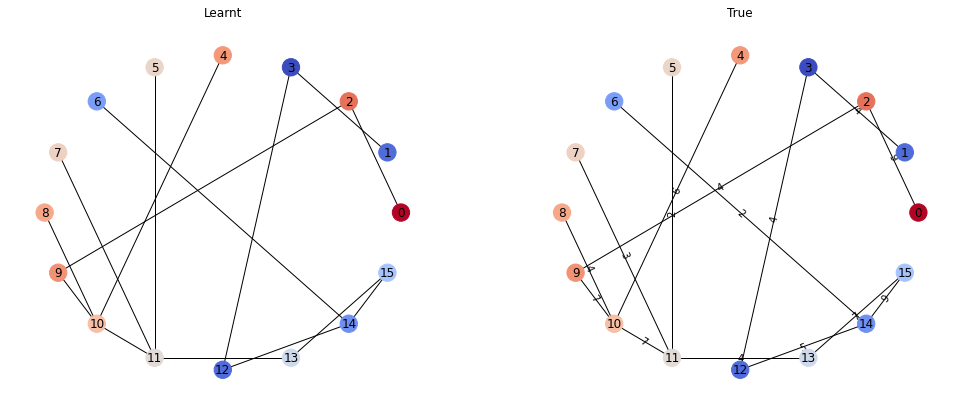

Passes: 5
tensor([16.9985,  9.9992, 24.9977, 28.9975, 20.9983, 15.9987,  2.0001,  3.9998,
        16.9985,  6.9993, 13.9986, 12.9988,  8.9994,  6.9993,  0.0000])
tensor([17., 10., 25., 29., 21., 16.,  2.,  4., 17.,  7., 14., 13.,  9.,  7.,
         0.])
Loss: 0.00109580357093364	Similarity: 1.0


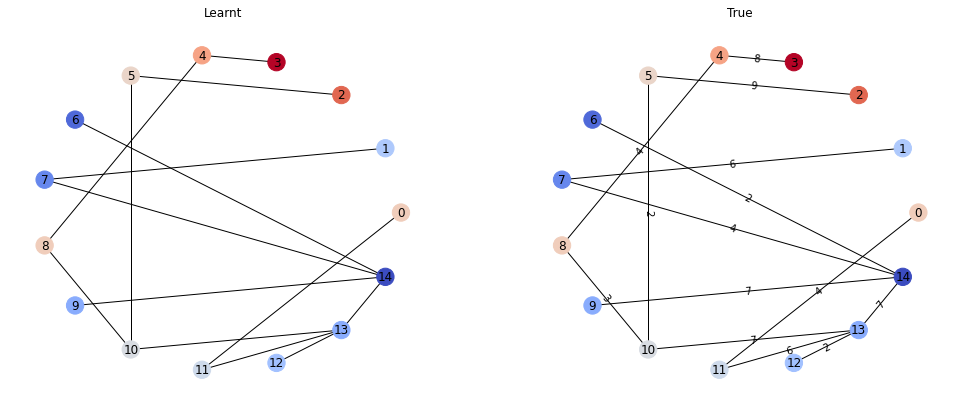

Passes: 4
tensor([24.9977, 20.9983, 18.9986,  9.9992, 21.9978, 15.9987, 15.9983, 15.9983,
        12.9988, 13.9986,  0.0000,  6.9993])
tensor([25., 21., 19., 10., 22., 16., 16., 16., 13., 14.,  0.,  7.])
Loss: 0.0013640722027048469	Similarity: 1.0


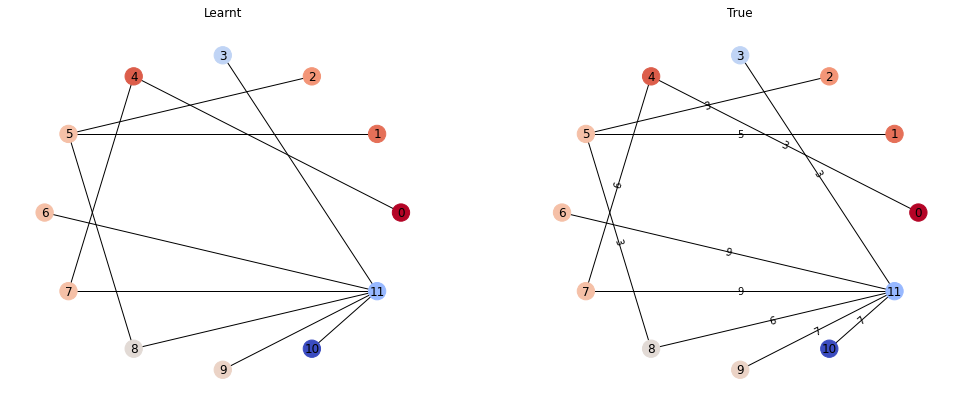

Passes: 8
tensor([25.9979, 37.9973, 35.9972,  0.0000, 30.9975,  4.9996, 39.9969, 12.9988,
        19.9985, 15.9987, 35.9972, 19.9985, 34.9973, 28.9979, 30.9975, 21.9986])
tensor([26., 38., 36.,  0., 31.,  5., 40., 13., 20., 16., 36., 20., 35., 29.,
        31., 22.])
Loss: 0.0019182264804840088	Similarity: 1.0


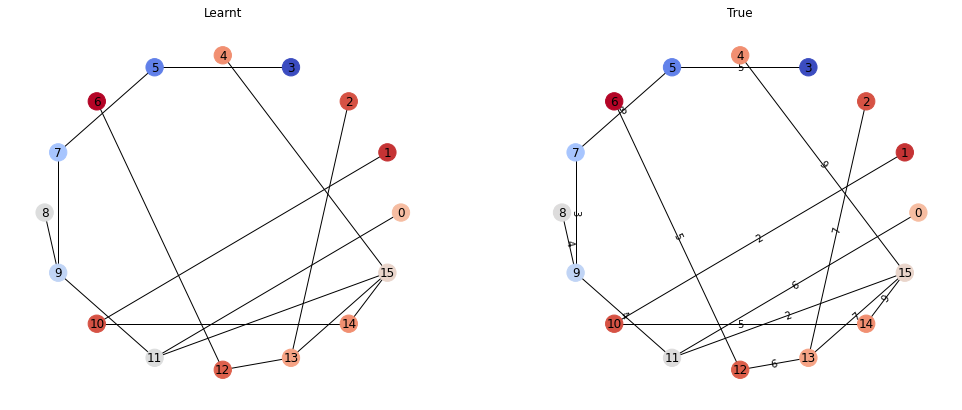

Passes: 6
tensor([ 0.0000, 15.9987, 36.9966, 17.9980, 39.9962, 34.9965, 25.9975,  8.9990,
        13.9986, 28.9975, 19.9981, 29.9973, 26.9974])
tensor([ 0., 16., 37., 18., 40., 35., 26.,  9., 14., 29., 20., 30., 27.])
Loss: 0.0021993196569383144	Similarity: 1.0


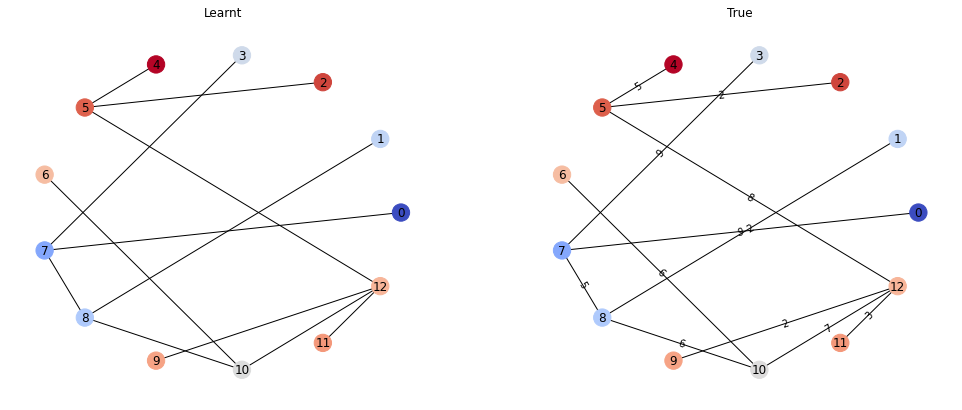

Passes: 5
tensor([17.9988, 24.9981, 26.9978, 17.9988, 23.9982, 25.9979,  7.9992, 18.9990,
         0.0000,  7.9992, 23.9982, 11.9989, 20.9983, 16.9989, 14.9989, 17.9988])
tensor([18., 25., 27., 18., 24., 26.,  8., 19.,  0.,  8., 24., 12., 21., 17.,
        15., 18.])
Loss: 0.0013163089752197266	Similarity: 1.0


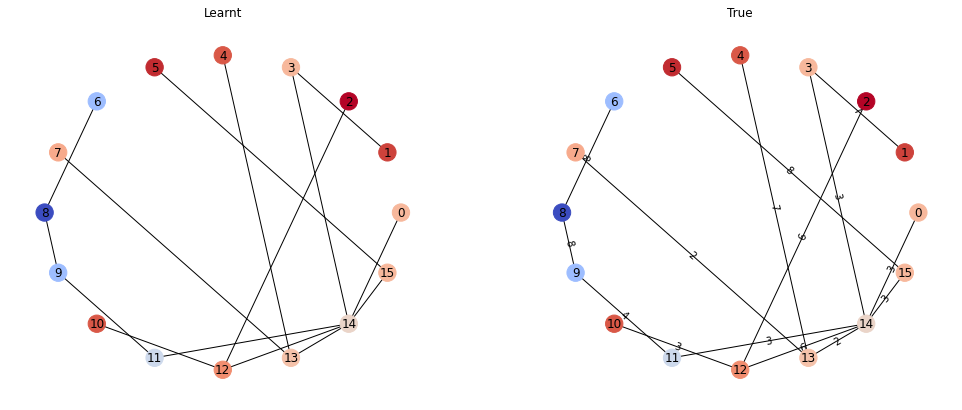

Passes: 8
tensor([ 0.0000, 32.9968, 27.9976,  9.9992, 39.9969, 30.9972,  4.9996, 25.9975,
        25.9975, 27.9976,  9.9992, 35.9972, 16.9985, 22.9980, 33.9971, 29.9973])
tensor([ 0., 33., 28., 10., 40., 31.,  5., 26., 26., 28., 10., 36., 17., 23.,
        34., 30.])
Loss: 0.0020340383052825928	Similarity: 1.0


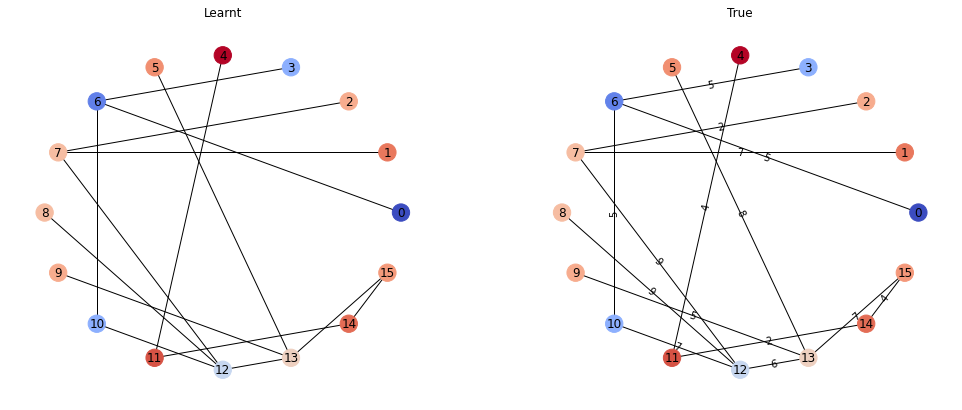

Passes: 7
tensor([32.9976, 20.9983, 16.9989, 29.9977, 12.9992,  5.9999, 16.9989, 19.9985,
        22.9984, 13.9990, 31.9974, 35.9968,  5.0000,  0.0000, 17.9988, 14.9989,
        26.9978, 17.9988, 18.9986,  8.9998, 13.9990, 20.9983, 11.9993,  5.9999,
         2.0001])
tensor([33., 21., 17., 30., 13.,  6., 17., 20., 23., 14., 32., 36.,  5.,  0.,
        18., 15., 27., 18., 19.,  9., 14., 21., 12.,  6.,  2.])
Loss: 0.0012185669038444757	Similarity: 1.0


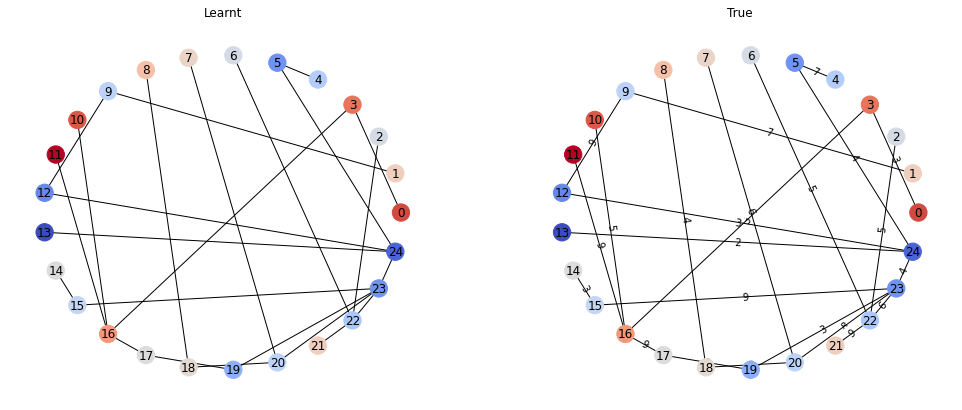

Passes: 8
tensor([40.9964, 31.9978, 29.9977, 33.9975, 34.9969, 18.9982, 34.9973, 29.9977,
        20.9987, 38.9971, 23.9982,  0.0000,  2.0001, 36.9970, 24.9985, 31.9974,
        27.9980, 32.9972, 20.9987, 32.9972,  9.9992, 31.9974, 14.9992, 25.9979,
        25.9979, 23.9982, 11.9993, 16.9989])
tensor([41., 32., 30., 34., 35., 19., 35., 30., 21., 39., 24.,  0.,  2., 37.,
        25., 32., 28., 33., 21., 33., 10., 32., 15., 26., 26., 24., 12., 17.])
Loss: 0.0019362823804840446	Similarity: 1.0


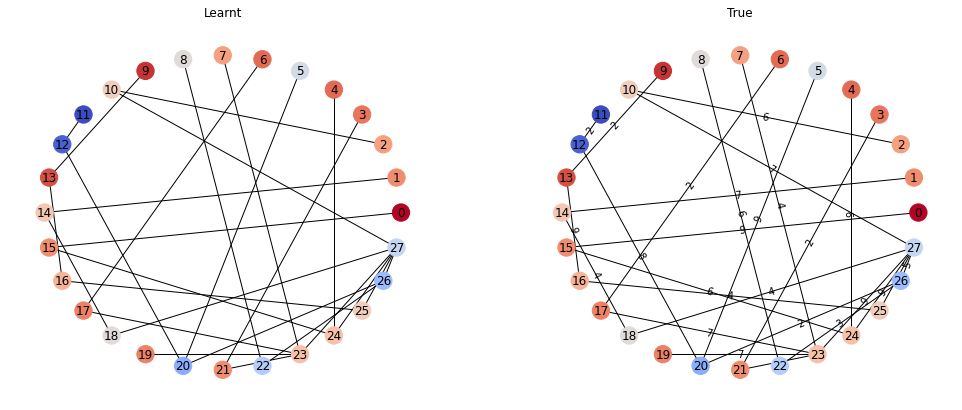

Passes: 6
tensor([30.9968,  7.9992,  6.9993, 37.9965, 37.9965, 41.9958,  0.0000, 32.9968,
        40.9960, 31.9974, 28.9975,  7.9992, 38.9963, 31.9970, 39.9962, 28.9975,
        32.9968, 25.9975, 14.9985, 28.9971, 24.9977, 21.9978])
tensor([31.,  8.,  7., 38., 38., 42.,  0., 33., 41., 32., 29.,  8., 39., 32.,
        40., 29., 33., 26., 15., 29., 25., 22.])
Loss: 0.002582159824669361	Similarity: 1.0


KeyboardInterrupt: ignored

In [ ]:
# TEST - Random graphs
test(test_loader, best_model, decimals=0, plot=True)

tensor([[100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100.,   1., 100., 100., 100.,   1., 100., 100., 100.,
         100., 100., 100., 100.]], device='cuda:0')
tensor([6., 7., 3., 6., 5., 4., 7., 5., 7., 2., 6., 6., 5., 4., 5., 6., 1., 5.,
        5., 5., 5., 5., 2., 5., 4., 4., 3., 4.], device='cuda:0')



Out: tensor([[5.9461, 2.9780, 2.9872, 1.9924, 4.9628, 3.9750, 4.9491, 2.9895, 4.9468,
         1.9901, 1.9832, 3.9612, 4.9514, 3.9658, 4.9582, 5.9415, 1.0000, 2.9734,
         4.9605, 4.9674, 1.0000, 4.9628, 1.9855, 4.9582, 1.9924, 3.9773, 2.9826,
         3.9658]], device='cuda:0', grad_fn=<PermuteBackward0>)
Rounded: [6 3 3 2 5 4 5 3 5 2 2 4 5 4 5 6 1 3 5 5 1 5 2 5 2 4 3 4]
Similarity: 0.6428571428571429


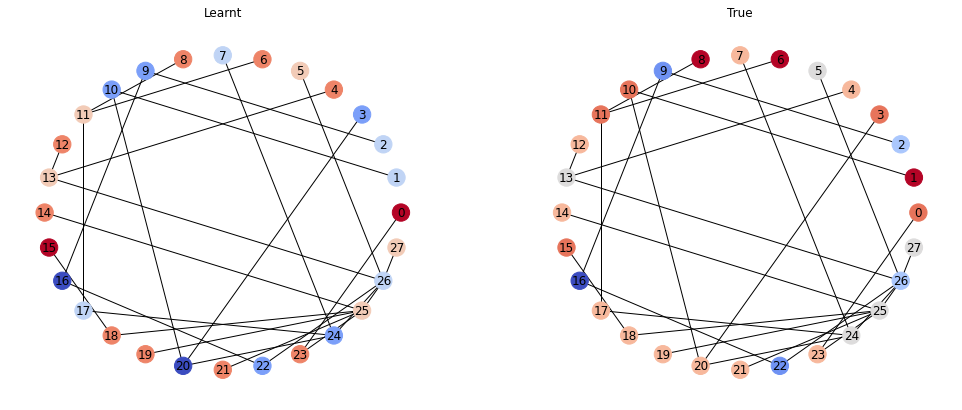

In [ ]:
# Test with various goals

batch = data_list[0].to(DEVICE)

x = batch['x'].clone()

# Add one goal
x[20] = 1.0

print(x.T)
print(batch.y)
print("\n\n")

out = best_model(x, batch['edge_index'], batch['weight'], passes=10)
print(f"Out: {out.T}")


sim, pred = graphs_similarity(batch.y, out, decimals=0)
print(f"Rounded: {pred}")
print(f"Similarity: {sim}")

# ------------------------------------------------------------------
# Plot graphs (more blue = nearer to goal)

# Get graph
G_out = to_networkx(batch, node_attrs=['x', 'y'],
                    to_undirected=True, remove_self_loops=True)    # NOTE: Careful with self loops

fig, ax = plt.subplots(1,2, figsize=(17,7))

# Plots sorted, with lower value being blue
# color_order = np.argsort(np.argsort(out.T.squeeze()))
# color_order = out.T.squeeze()

ax[0].set_title("Learnt")
# pred = out.cpu().detach() if torch.cuda.is_available() else out
nx.draw_circular(G_out, cmap=plt.get_cmap('coolwarm'), node_color=pred, 
                ax=ax[0],
                with_labels=True, font_color='black')

ax[1].set_title("True")
true = batch['y'].cpu().detach() if torch.cuda.is_available() else batch['y']
nx.draw_circular(G_out, cmap=plt.get_cmap('coolwarm'), node_color=true,
                ax=ax[1],
                with_labels=True, font_color='black')

plt.show()

tensor([[  1., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,   1.,
         100., 100., 100., 100., 100., 100., 100., 100., 100., 100.]],
       device='cuda:0')
tensor([6., 3., 8., 6., 7., 8., 6., 5., 6., 8., 5., 1., 7., 2., 6., 5., 4., 6.,
        5., 4., 3., 4.], device='cuda:0')



Out: tensor([[1.0000, 2.9757, 7.9195, 2.9688, 6.9408, 7.9057, 5.9438, 1.9855, 5.9599,
         7.9057, 4.9491, 1.0000, 6.9225, 1.9855, 5.9599, 4.9628, 3.9681, 5.9369,
         4.9537, 3.9681, 2.9757, 2.9803]], device='cuda:0',
       grad_fn=<PermuteBackward0>)
Rounded: [1 3 8 3 7 8 6 2 6 8 5 1 7 2 6 5 4 6 5 4 3 3]
Similarity: 0.8181818181818182


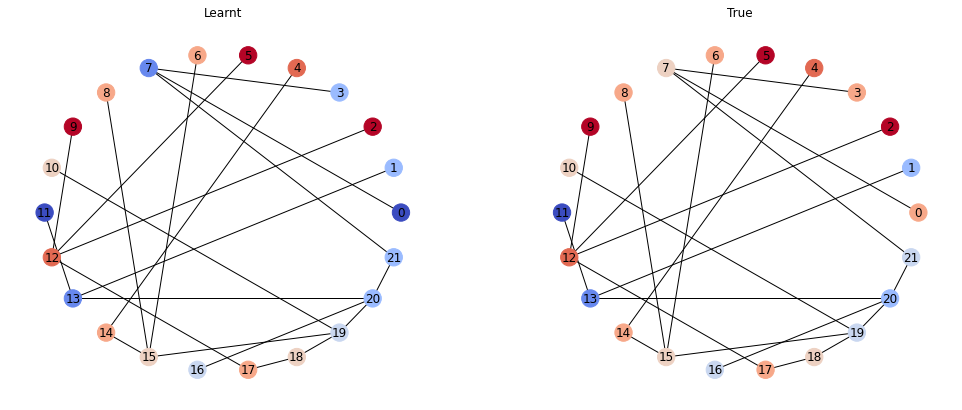

In [ ]:
# Test with various goals

batch = data_list[100].to(DEVICE)

x = batch['x'].clone()

# Add one goal
x[0] = 1.0

print(x.T)
print(batch.y)
print("\n\n")

out = best_model(x, batch['edge_index'], batch['weight'], passes=10)
print(f"Out: {out.T}")


sim, pred = graphs_similarity(batch.y, out, decimals=0)
print(f"Rounded: {pred}")
print(f"Similarity: {sim}")

# ------------------------------------------------------------------
# Plot graphs (more blue = nearer to goal)

# Get graph
G_out = to_networkx(batch, node_attrs=['x', 'y'],
                    to_undirected=True, remove_self_loops=True)    # NOTE: Careful with self loops

fig, ax = plt.subplots(1,2, figsize=(17,7))

# Plots sorted, with lower value being blue
# color_order = np.argsort(np.argsort(out.T.squeeze()))
# color_order = out.T.squeeze()

ax[0].set_title("Learnt")
# pred = out.cpu().detach() if torch.cuda.is_available() else out
nx.draw_circular(G_out, cmap=plt.get_cmap('coolwarm'), node_color=pred, 
                ax=ax[0],
                with_labels=True, font_color='black')

ax[1].set_title("True")
true = batch['y'].cpu().detach() if torch.cuda.is_available() else batch['y']
nx.draw_circular(G_out, cmap=plt.get_cmap('coolwarm'), node_color=true,
                ax=ax[1],
                with_labels=True, font_color='black')

plt.show()

# Save model

In [ ]:
# https://stackoverflow.com/questions/42703500/best-way-to-save-a-trained-model-in-pytorch
torch.save(best_model.state_dict(), "frgcn-with-edge-weights.model")

In [ ]:
torch.save(train_dataset, "train_all.dataset")
torch.save(test_dataset, "test_all.dataset")
torch.save(train_loader, "train_all.dataloader")
torch.save(test_loader, "test_all.dataloader")

# Road maps

In [ ]:
%%capture

# OSMnx (OpenStreetMap Python API)
!pip install osmnx

!pip install -U matplotlib

In [ ]:
import osmnx as ox
import matplotlib.pyplot as plt
import geopandas
import pandas as pd

# import pickle

from torch_geometric.utils import to_networkx

import time

## Utils

In [ ]:
def remove_attributes(G):
    # DON'T EXECUTE WHILE TESTING, ONLY TO GET FINAL GRAPH

    # Edge attributes to remove
    att_list = [
        "maxspeed",
        'from',
        'to',
        'osmid',
        'ref',

        'width',
        "junction",
        "access",
        "tunnel",
        "lanes",
        "geometry",
        "bridge",
        "highway",
        "name",
        "oneway",
        "service"
    ]

    for _, _, d in G.edges(data=True):
        for att in att_list:
            d.pop(att, None)

    # Node attributes to remove
    att_list = [
        "ref",

        "highway",
        "street_count",
        # "x",  # Don't remove in RL
        # "y"   # Don't remove in RL
    ]

    for _, d in G.nodes(data=True):
        for att in att_list:
            d.pop(att, None)

    return G

def preprocess_graph(G):
    G_nx = nx.relabel.convert_node_labels_to_integers(G)
    # nodes, edges = ox.graph_to_gdfs(G_nx, nodes=True, edges=True)

    G_nx = remove_attributes(G_nx)

    # Set node attributes (type and time windows)
    # G_nx = set_node_attributes(G_nx)

    # Remove nodes with no output road
    # G_nx = remove_deadends(G_nx)

    # Add speed to edges
    # G_nx = set_graph_speed(G_nx)

    return G_nx

# ------------------------------------------------------------------------------

def remove_deadends(G):
    # Iterate until empty
    no_out = list(node for node, out_degree in G.out_degree() if out_degree == 0)
    while no_out:
      G.remove_nodes_from(no_out)
      G = nx.relabel.convert_node_labels_to_integers(G, first_label=0, ordering='default')

      no_out = list(node for node, out_degree in G.out_degree() if out_degree == 0)

    return G

In [ ]:
def plot_map(G, plot_node_types=False):
    if plot_node_types:
        gdf_nodes, _ = ox.graph_to_gdfs(G, nodes=True)

        # color_map = {0: 'k', 1: 'c', 2: 'y', 3: 'g'}
        color_map = {0: 'w', 1: 'c', 2: 'y', 3: 'g'}

        colors = gdf_nodes['type']
        colors = colors.replace(color_map)
    else:
        colors='w'

    fig, ax = ox.plot_graph(G,
                            figsize=(20,17),
                            node_color=colors,
                            # bgcolor='white',
                            show=False, close=False)
    
    return fig, ax

# ------------------------------------------------------------------------------

def plot_path(G, source, target, paths, rc=['r'], base_map_ax=None):
    # Plot
    if len(paths) == 1:
        fig, ax = ox.plot_graph_route(G, paths[0],
                                    route_color=rc[0],
                                    figsize=(20,17),
                                    ax=base_map_ax,   # Plot on existing graph
                                    show=False, close=False) # OSMnx closes and
                                                            # shows by default
    else:
        fig, ax = ox.plot_graph_routes(G, paths,
                                    route_colors=rc,
                                    figsize=(20,17),
                                    ax=base_map_ax,   # Plot on existing graph
                                    show=False, close=False) # OSMnx closes and
                                                            # shows by default

    gdf_nodes, _ = ox.graph_to_gdfs(G, nodes=True)

    # Plot start, current and target node
    gdf_nodes.iloc[
            [source]
        ].plot(ax=ax, color='hotpink', markersize=200, marker="v")

    # gdf_nodes.iloc[
    #     [self.current_node]
    # ].plot(ax=ax, color='hotpink', markersize=200, marker="P")

    gdf_nodes.iloc[
        [target]
    ].plot(ax=ax, color='hotpink', markersize=300, marker="*")


    return fig

# ------------------------------------------------------------------------------

# Plot heatmmap
def plot_heatmap(G_out, G_original, attr="y"):
    # get node colors by linearly mapping an attribute's values to a colormap
    nc = ox.plot.get_node_colors_by_attr(G_out, attr=attr, cmap='plasma', num_bins=10)
    fig, ax = ox.plot_graph(G_original,
                            node_color=nc,
                            node_size=150,
                            figsize=(20,17))
                            # show=False, close=False) # OSMnx closes and
                                                    # shows by default

    return fig




# fig, ax = ox.plot_graph(G, figsize=(70,57), show=False, close=False)
# for id, node in ox.graph_to_gdfs(G, edges=False).iterrows():
#     if (id % 3) == 0:
#         text = id
#         c = node["geometry"].centroid
#         ax.annotate(text, (c.x, c.y), c="y")
# plt.show()

In [ ]:
def test_graph(model, G):
    G = preprocess_graph(G)

    # To undirected
    G = G.to_undirected()

    # Copy for plotting
    G_original = G.copy()

    number_of_nodes = G.number_of_nodes()

    # --------------------------------------------------------------------------
    # Get base map plot
    # _, base_map_ax = plot_map(G)

    # pickle.dump(base_map_ax, open('base_map.pkl', 'wb'))

    # --------------------------------------------------------------------------
    _ = ox.plot_graph(G_original,figsize=(20,17))

    # --------------------------------------------------------------------------
    # Select random target node
    # target = np.random.randint(0, number_of_nodes)
    target = 0

    # Find shortest path length based on 'length' for each node
    start = time.time()
    paths = nx.shortest_path_length(G, source=None, target=target,
                                    weight='length', method='dijkstra')
    true_time = (time.time() - start)

    # Set node attribute 'y' to that value for each node
        # set_graph_label(G, paths)
    for k, v in paths.items():
        G.nodes(data=True)[k]['y'] = v +1


    # Set passes as the eccentricity of the graph
    passes = nx.eccentricity(G, v=target)

    # --------------------------------------------------------------------------
    # Set node attribute 'x' to inf
    nx.set_node_attributes(G, 2e7, 'x') # Must be bigger than data.y.max()

    # Set initial value of target as 0
    G.nodes(data=True)[target]['x'] = 1

    # --------------------------------------------------------------------------
    # Get graph as tensor
    G.graph = {} # from_networkx can't receive non-string global arguments

    data = from_networkx(G, group_node_attrs=['x']).to(DEVICE)

    # --------------------------------------------------------------------------
    # Forward pass
    with torch.no_grad():
        start = time.time()
        # out = model(data['x'].float(), data['edge_index'], passes=passes)
        out = model(data['x'].float(), data['edge_index'], data['length'].float(), passes=passes)
        pred_time = (time.time() - start)

    out = out.T.squeeze()

    # Loss
    loss_fn = nn.L1Loss()
    loss = loss_fn(out.T.squeeze(), data['y'])
    print(f"Loss: {loss}")

    print(f"True time: {true_time}")
    print(f"Pred time: {pred_time}")
    print(f"Diff time: {(true_time - pred_time) * 100}")

    # --------------------------------------------------------------------------
    # Plot histogram of output
    pred = out.cpu().numpy() if torch.cuda.is_available() else out.numpy()
    true = data.y.cpu().numpy() if torch.cuda.is_available() else data.y.numpy()

    plt.hist(pred, color="b", alpha=0.5, label="out")
    plt.hist(true, color="g", alpha=0.5, label="y")

    plt.legend(loc='upper right')

    # ----------------------------------------------------------------------
    # Transform output to graph
    data['out'] = out

    data['diff'] = torch.abs(data.y - out)

    G_out = to_networkx(data, node_attrs=['out', 'y', 'diff'],
                    to_undirected=True, remove_self_loops=True)    # NOTE: Careful with self loops


    # --------------------------------------------------------------------------
    print("Learnt graph")
    _ = plot_heatmap(G_out, G_original, "out")

    # --------------------------------------------------------------------------
    print("True graph")
    _ = plot_heatmap(G_out, G_original, "y")

    # --------------------------------------------------------------------------
    print("Differences")
    _ = plot_heatmap(G_out, G_original, "diff")

## Test

In [ ]:
# Load model
# model = best_model
model = FRGCN(1, 1).to(DEVICE)

model.gcn.bias = torch.nn.Parameter(torch.tensor([1.0]).to(DEVICE))
model.gcn.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]).to(DEVICE))

model.gcn2.bias = torch.nn.Parameter(torch.tensor([0.0]).to(DEVICE))
model.gcn2.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]).to(DEVICE))

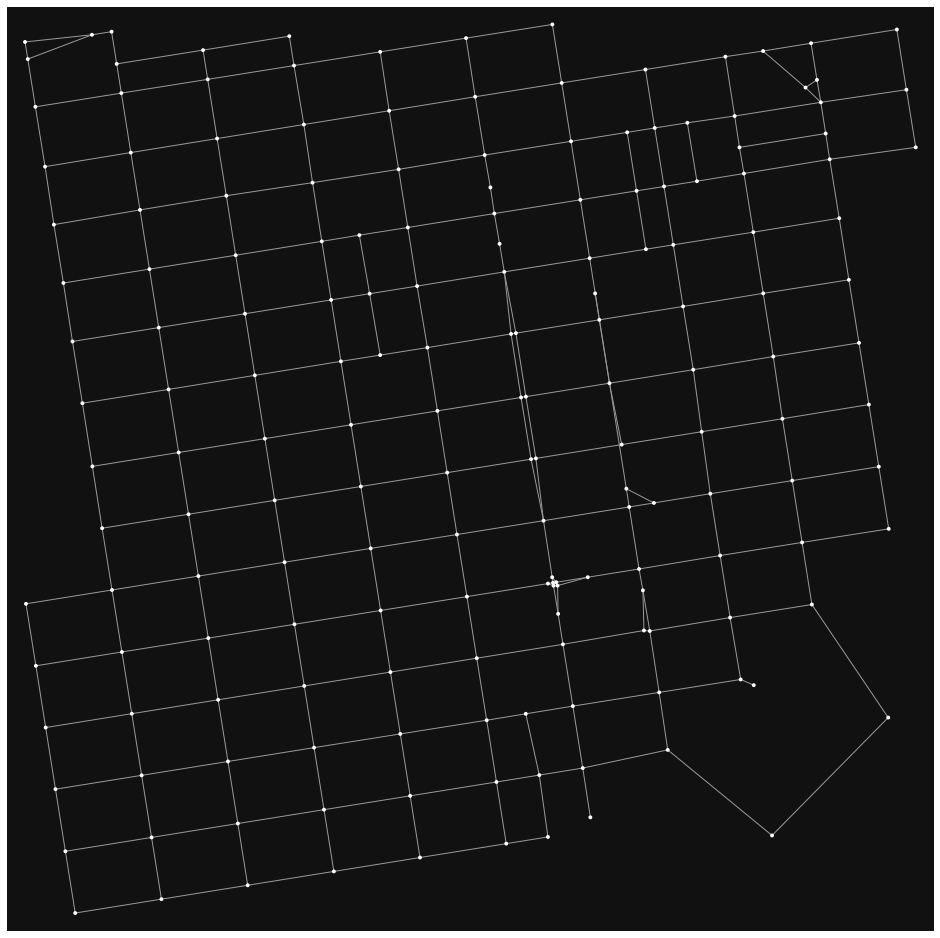

Loss: 5.805159162264317e-05
True time: 0.0015282630920410156
Pred time: 0.013406515121459961
Diff time: -1.1878252029418945
Learnt graph


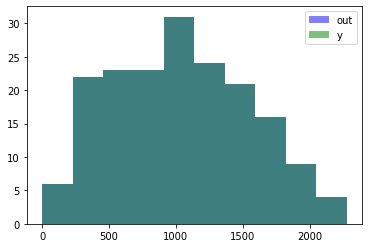

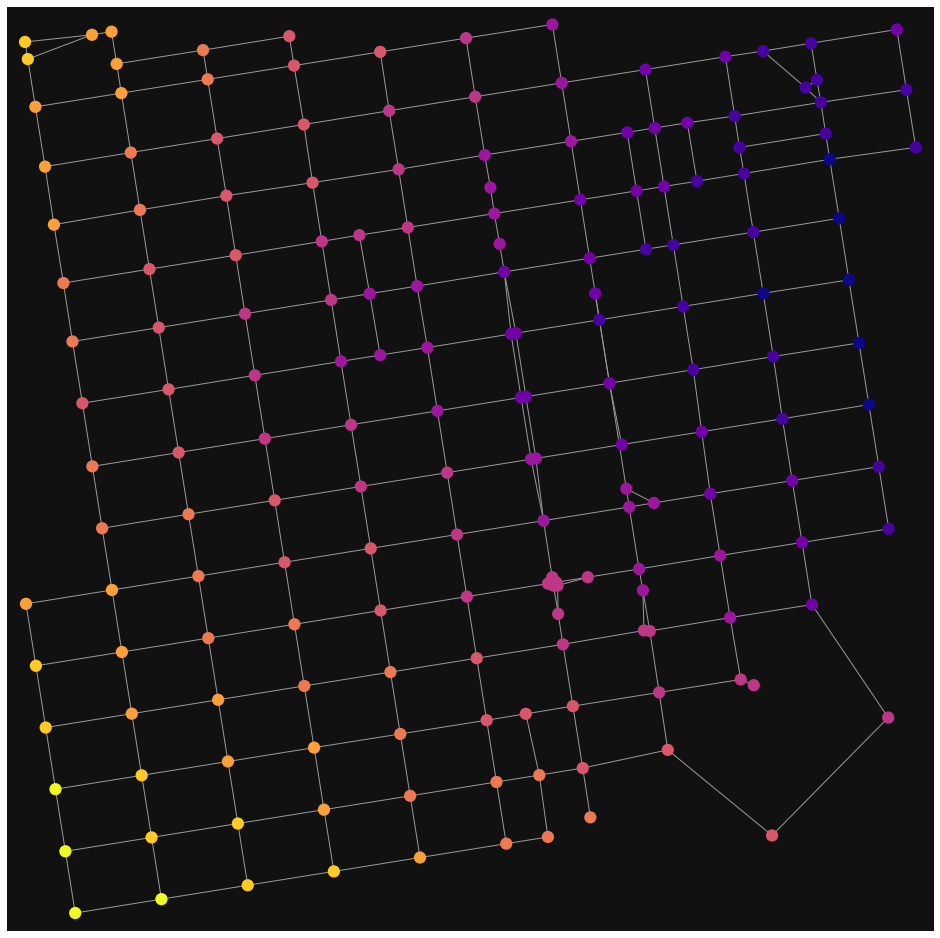

True graph


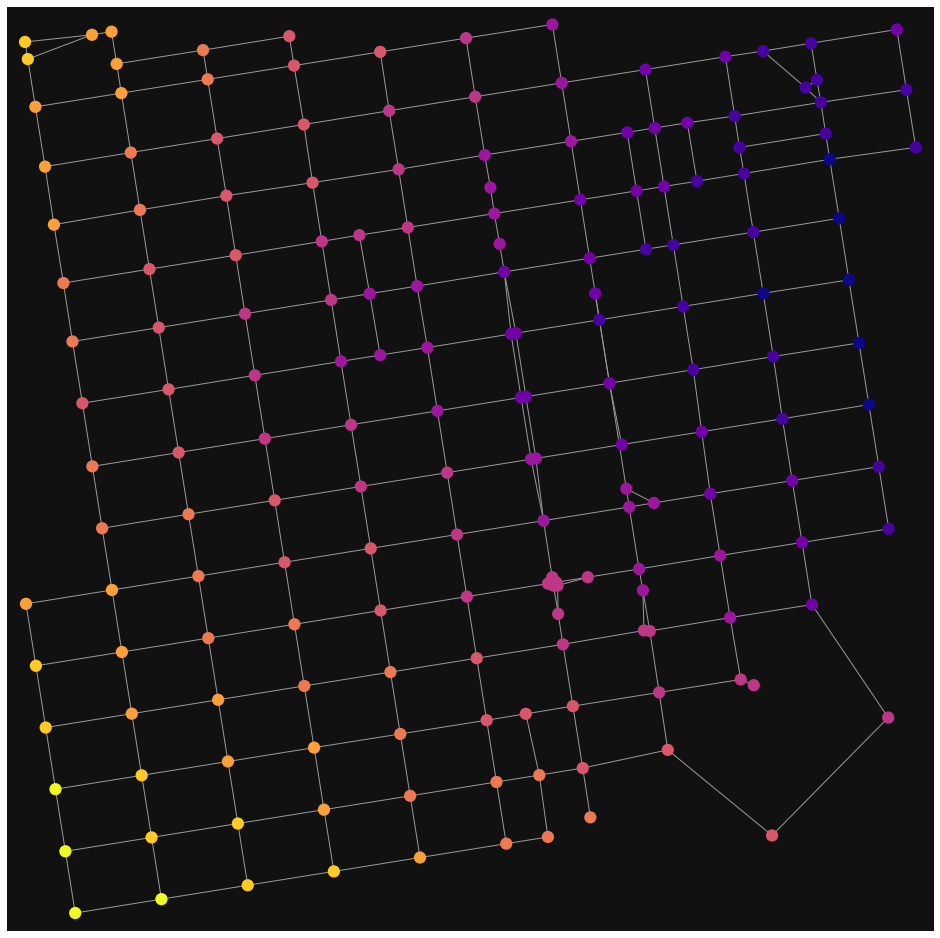

Differences


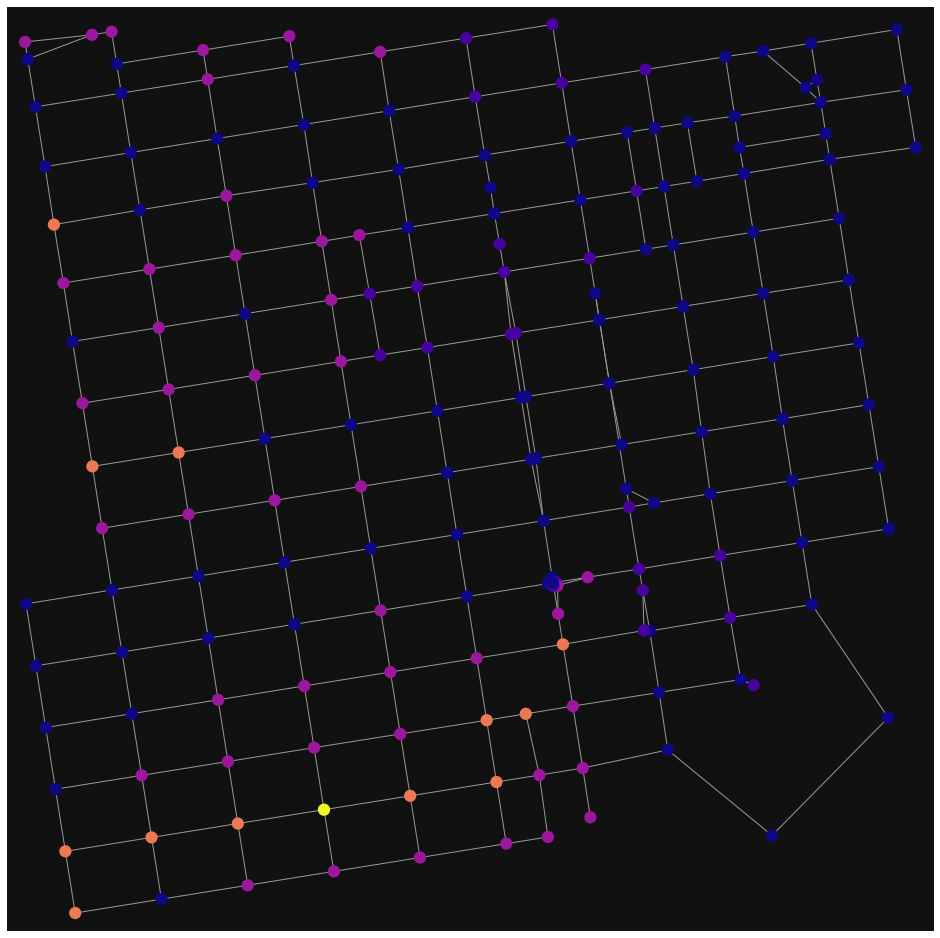

In [ ]:
# San Francisco
# G_1 = ox.graph_from_point((37.79, -122.41), dist=750, network_type="drive")

graph_path = 'city-sanFrancisco.graphml'
G_1 = ox.load_graphml(graph_path)

test_graph(model, G_1)

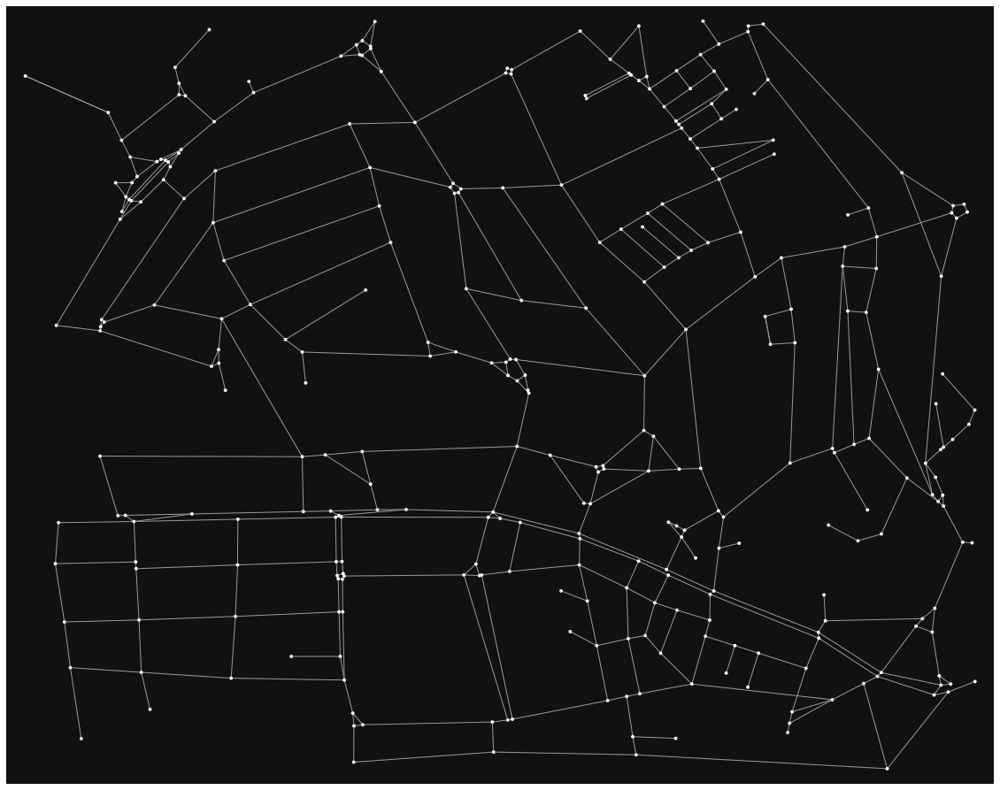

Loss: 2.621259045554325e-05
True time: 0.0024580955505371094
Pred time: 0.020470857620239258
Diff time: -1.8012762069702148
Learnt graph


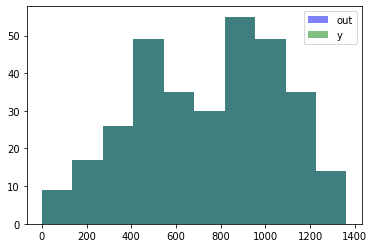

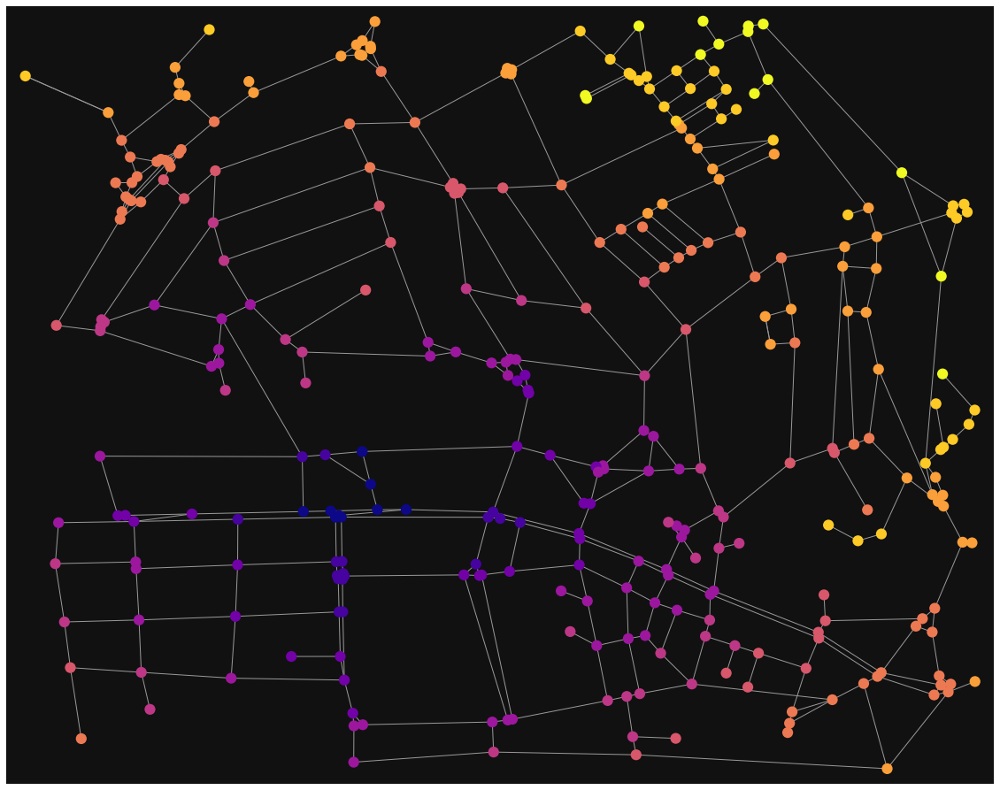

True graph


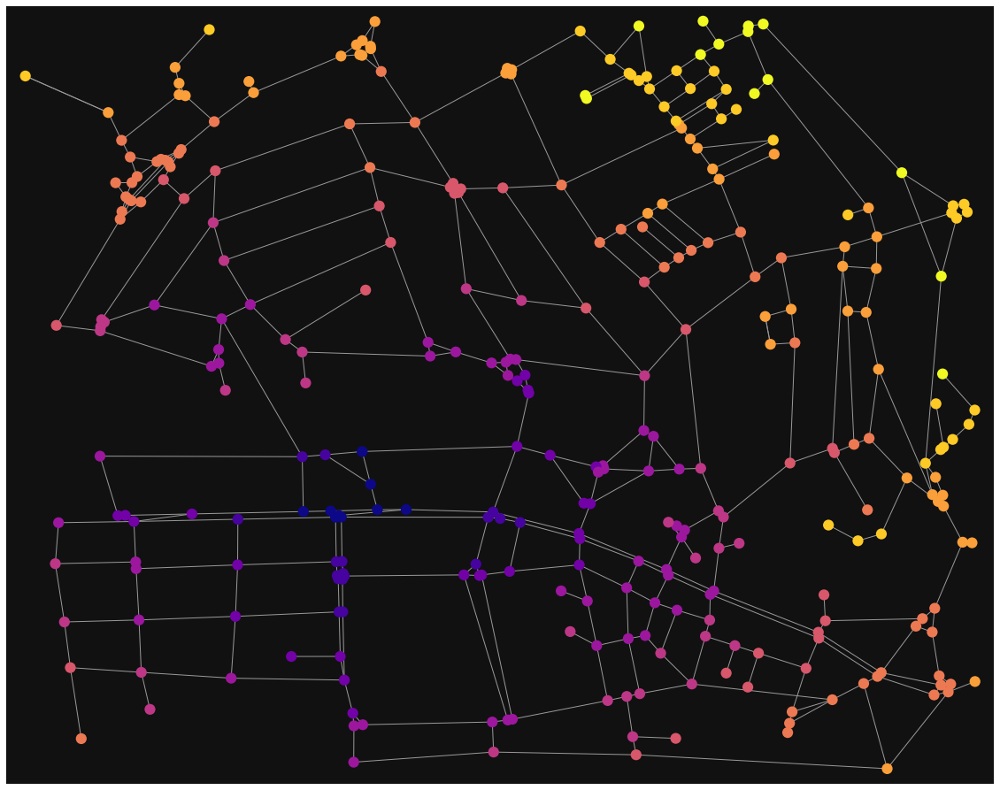

Differences


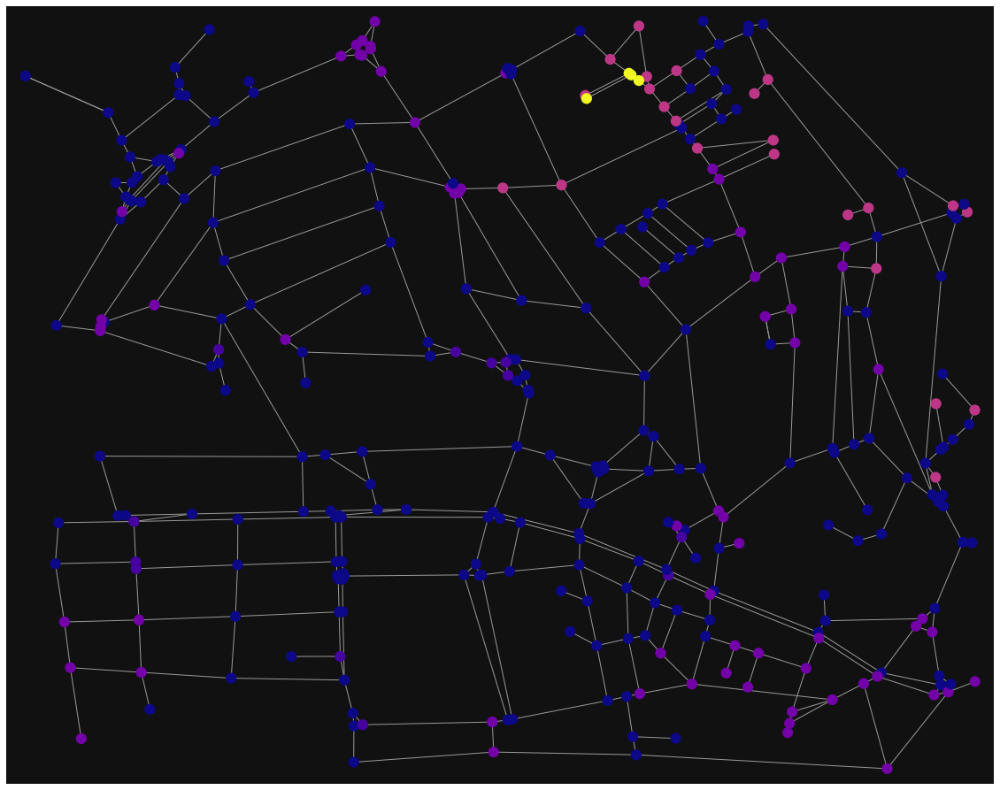

In [ ]:
# Marbella
# G_2 = ox.graph_from_place('Marbella, Spain', network_type='drive')
# G_2 = ox.graph_from_point((36.51044, -4.89053), dist=750, network_type="drive")

graph_path = 'city-marbella.graphml'
G_2 = ox.load_graphml(graph_path)

test_graph(model, G_2)

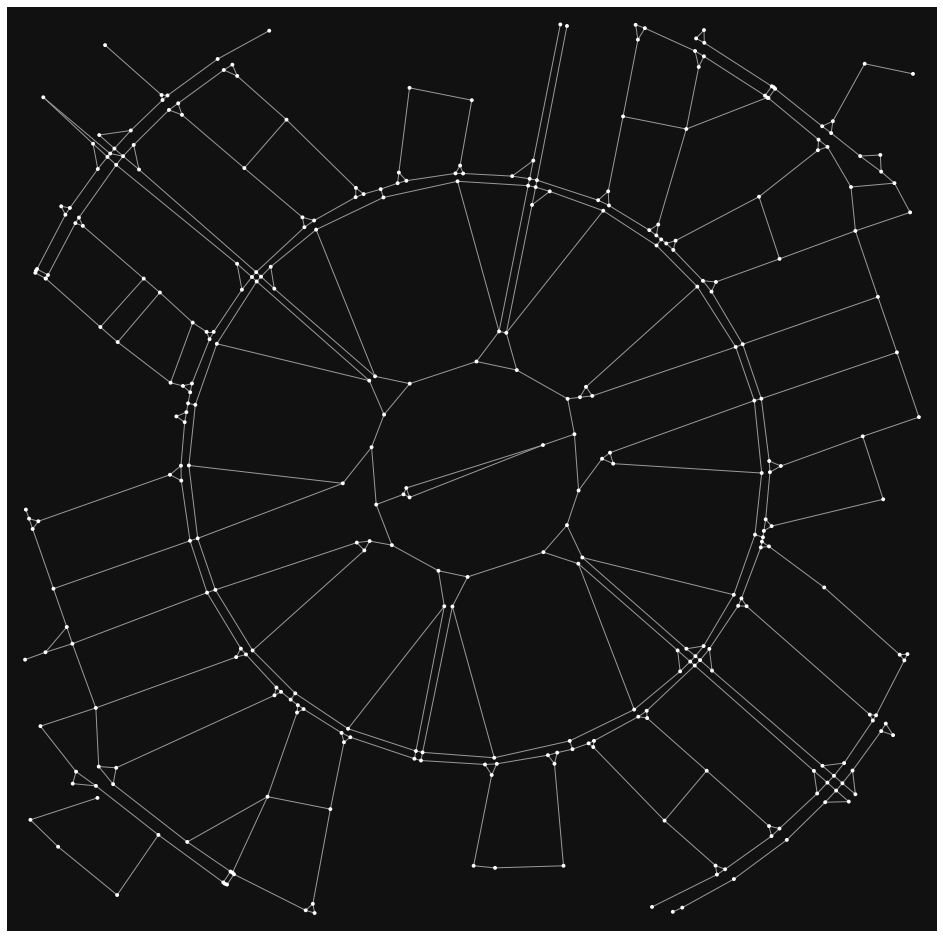

Loss: 4.141671524848789e-05
True time: 0.002764463424682617
Pred time: 0.0214536190032959
Diff time: -1.8689155578613281
Learnt graph


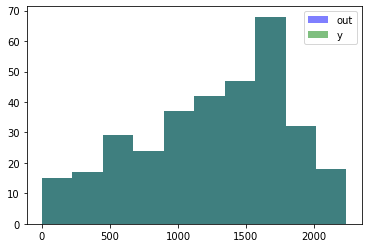

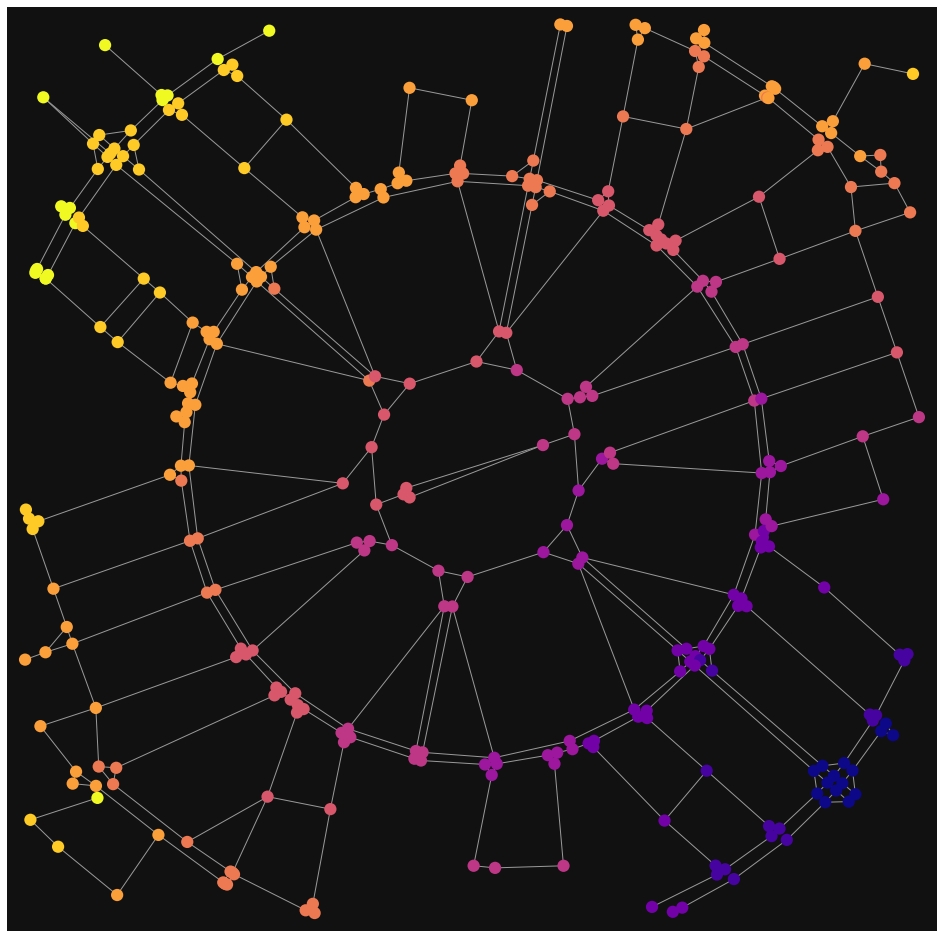

True graph


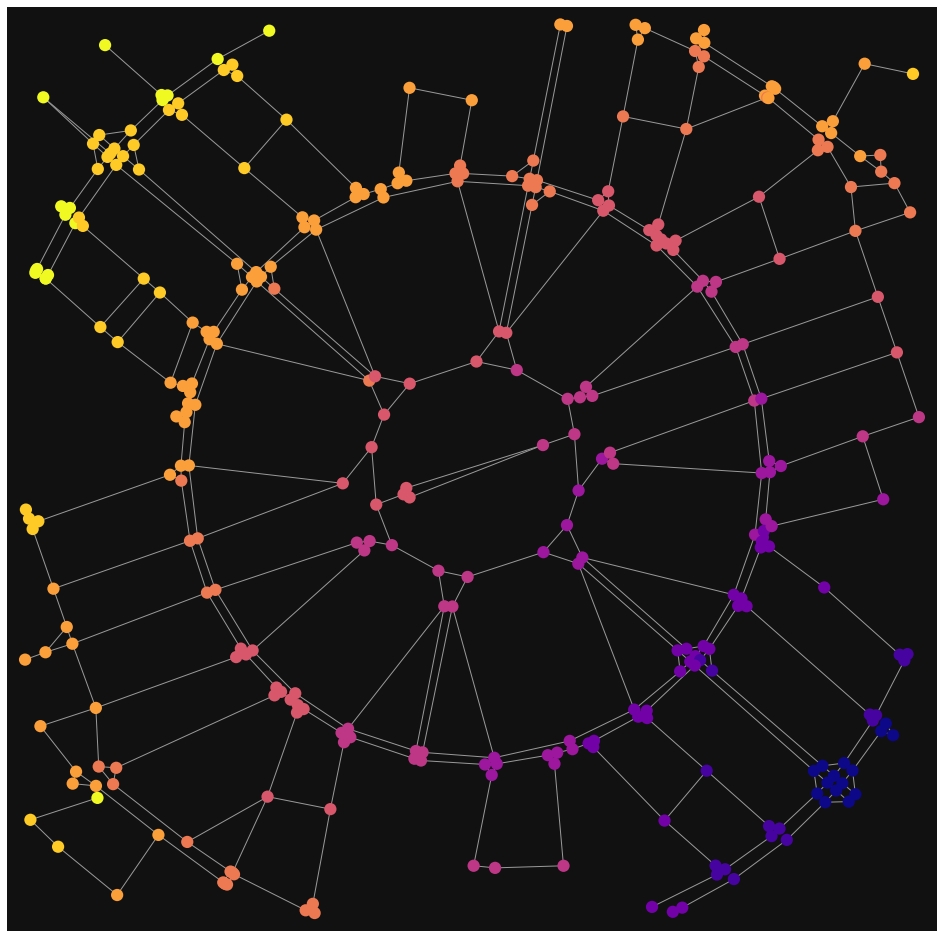

Differences


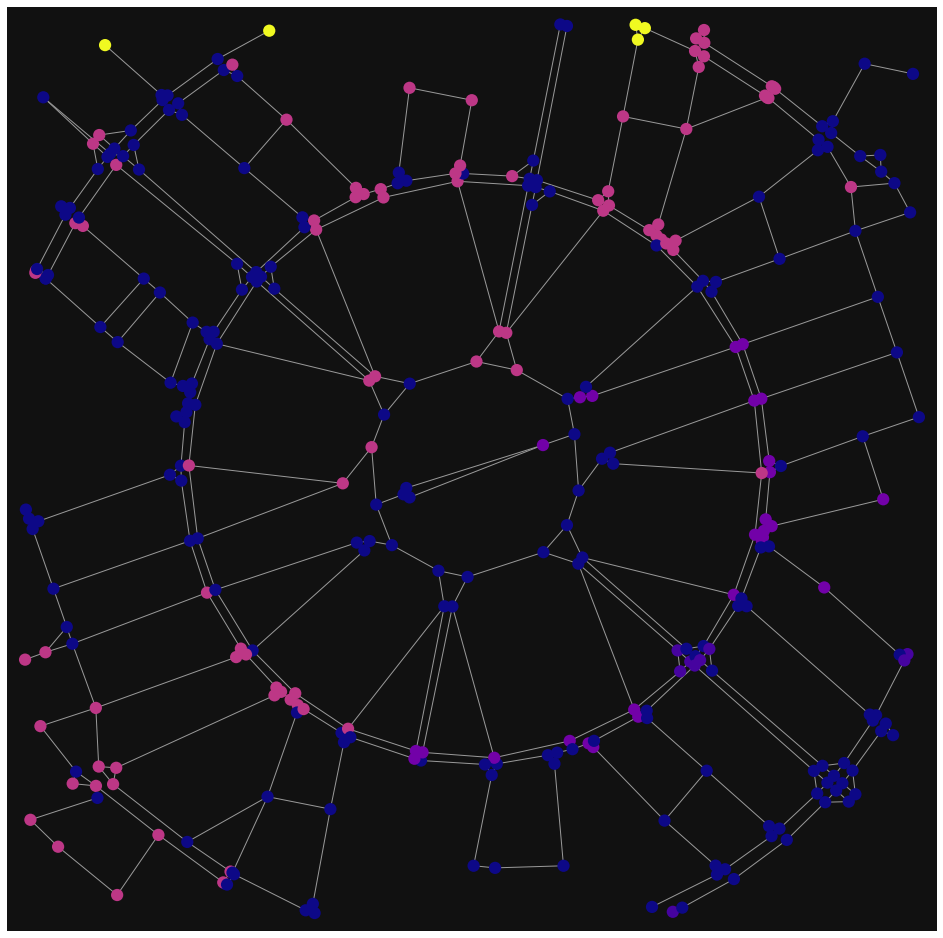

In [ ]:
# Dubai
# G_3 = ox.graph_from_place('Dubai, United Arab Emirates', network_type='drive')
# G_3 = ox.graph_from_point((25.0566, 55.2079), dist=750, network_type="drive")

graph_path = 'city-dubai.graphml'
G_3 = ox.load_graphml(graph_path)

test_graph(model, G_3)

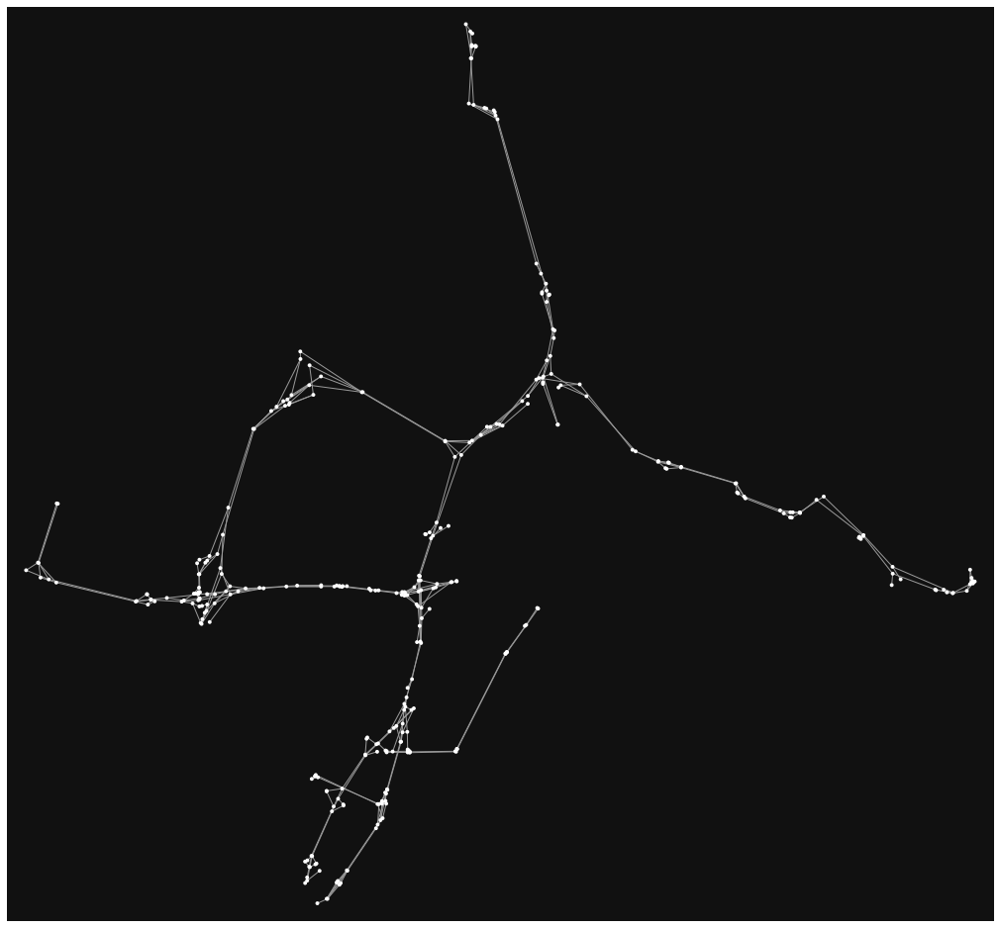

Loss: 0.0005584986647590995
True time: 0.0014965534210205078
Pred time: 0.015157222747802734
Diff time: -1.3660669326782227
Learnt graph


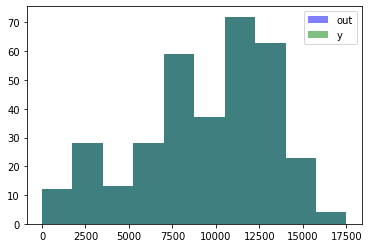

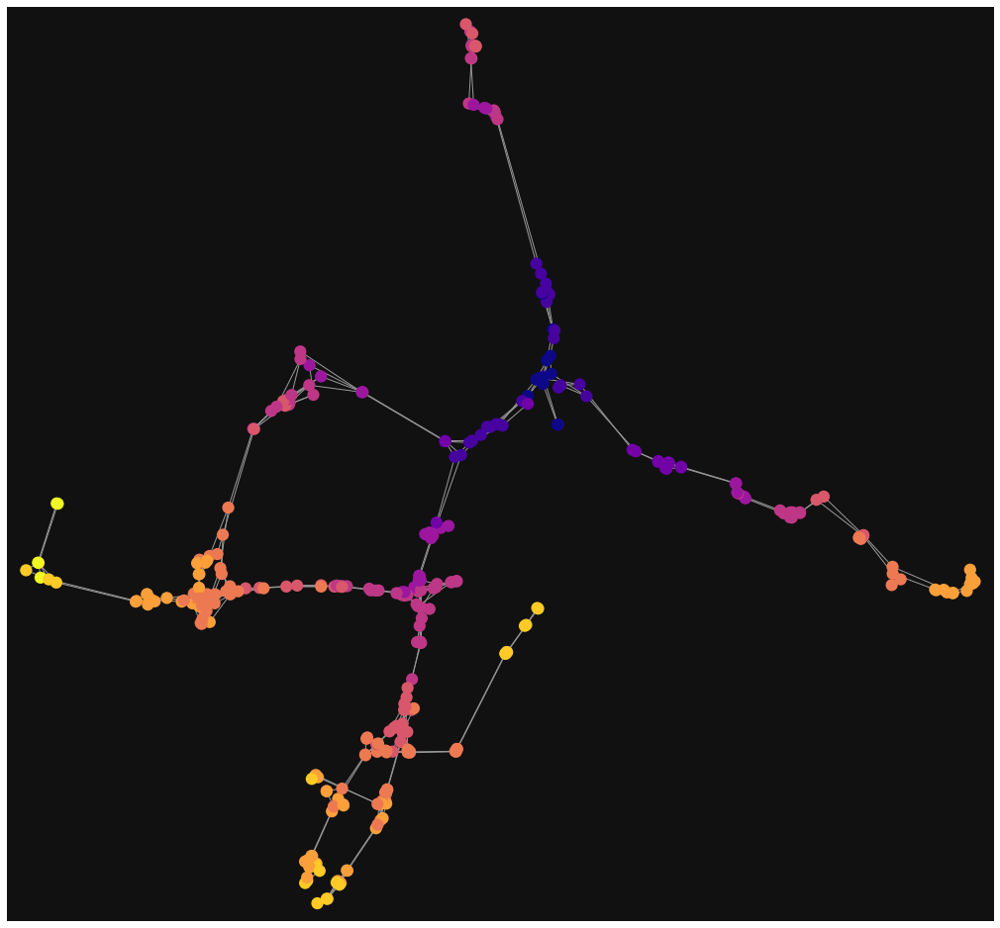

True graph


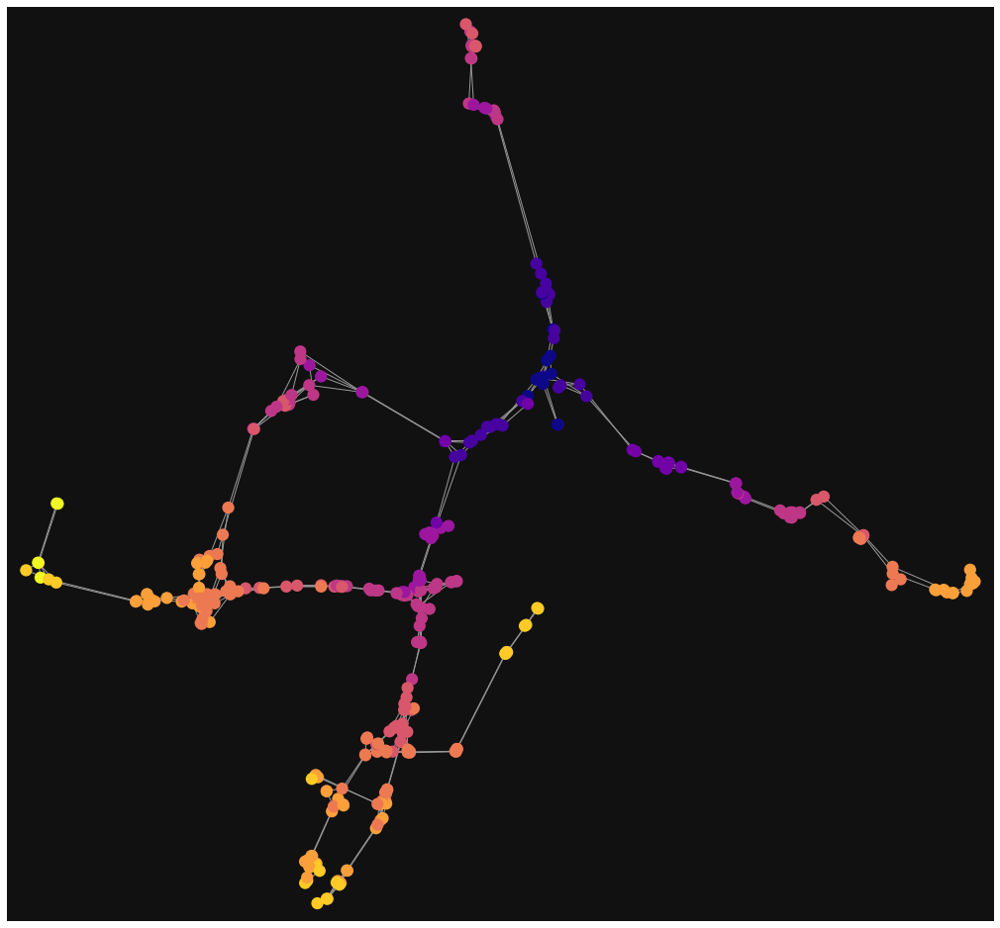

Differences


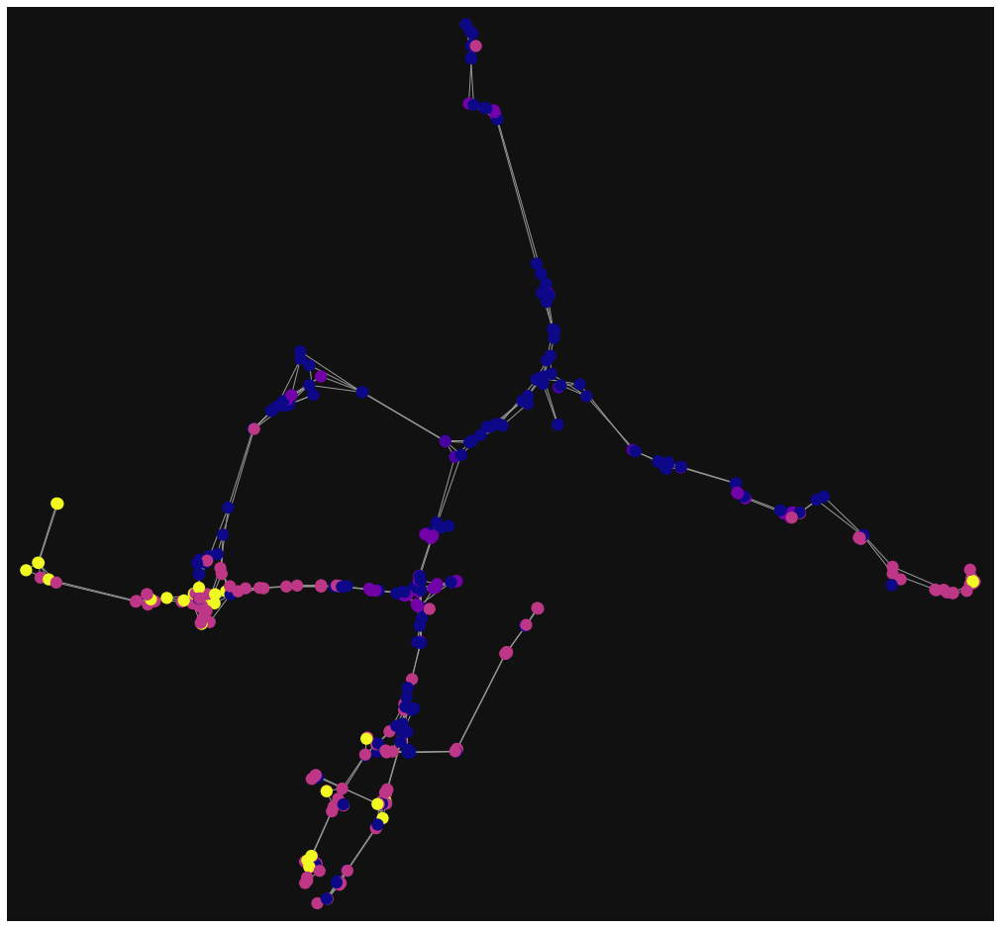

In [ ]:
# Malaga
# filter = '["highway"~"motorway|motorway_link|trunk|trunk_link"]'
# G_4 = ox.graph_from_place("Malaga", network_type='drive',
#                         simplify=True, custom_filter=filter)

# _ = ox.plot_graph(G_4,figsize=(20,17))

graph_path = 'road-malaga.graphml'
G_4 = ox.load_graphml(graph_path)

# ------------------------------------------------------------------------------
# Load model
# model = best_model
criteria = lambda x: x < 1e7
model = FRGCN(1, 1, criteria).to(DEVICE)

model.gcn.bias = torch.nn.Parameter(torch.tensor([0.0]).to(DEVICE))
model.gcn.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]).to(DEVICE))

# model.gcn2.bias = torch.nn.Parameter(torch.tensor([0.0]))
# model.gcn2.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]))

# ------------------------------------------------------------------------------
test_graph(model, G_4)

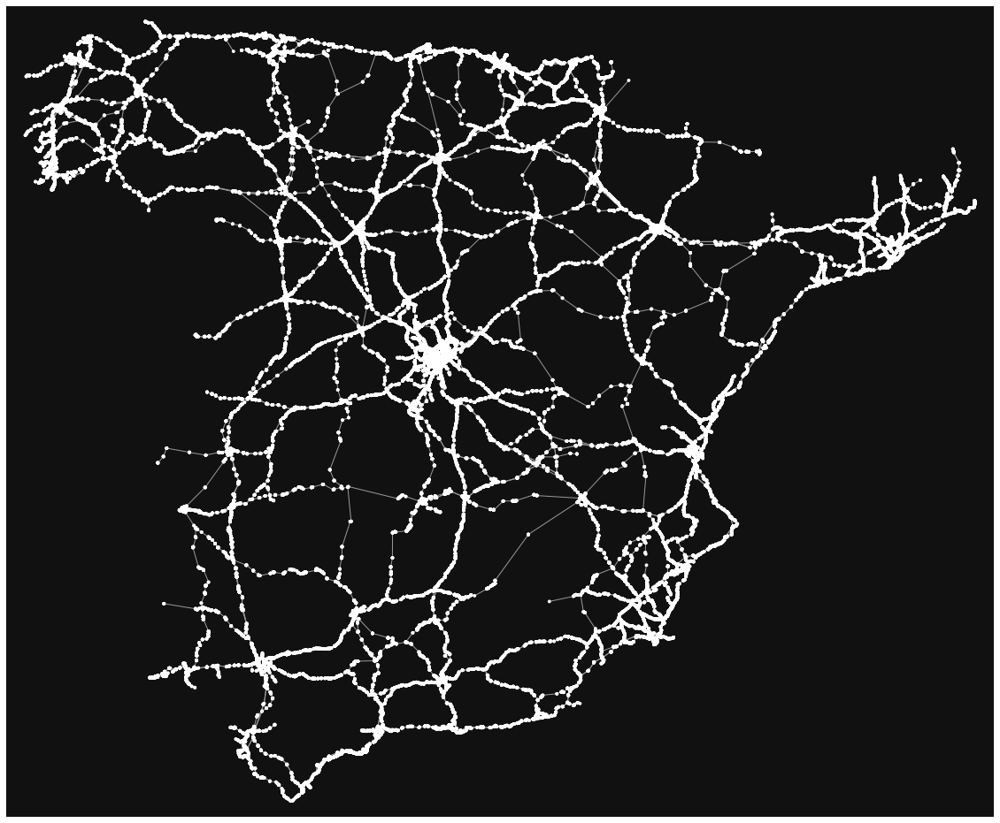

Loss: 0.35783278942108154
True time: 0.33353281021118164
Pred time: 0.45946741104125977
Diff time: -12.593460083007812
Learnt graph


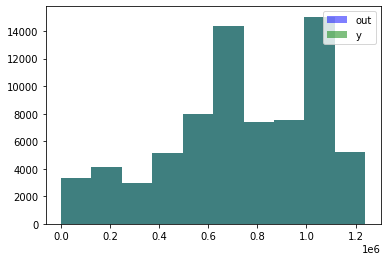

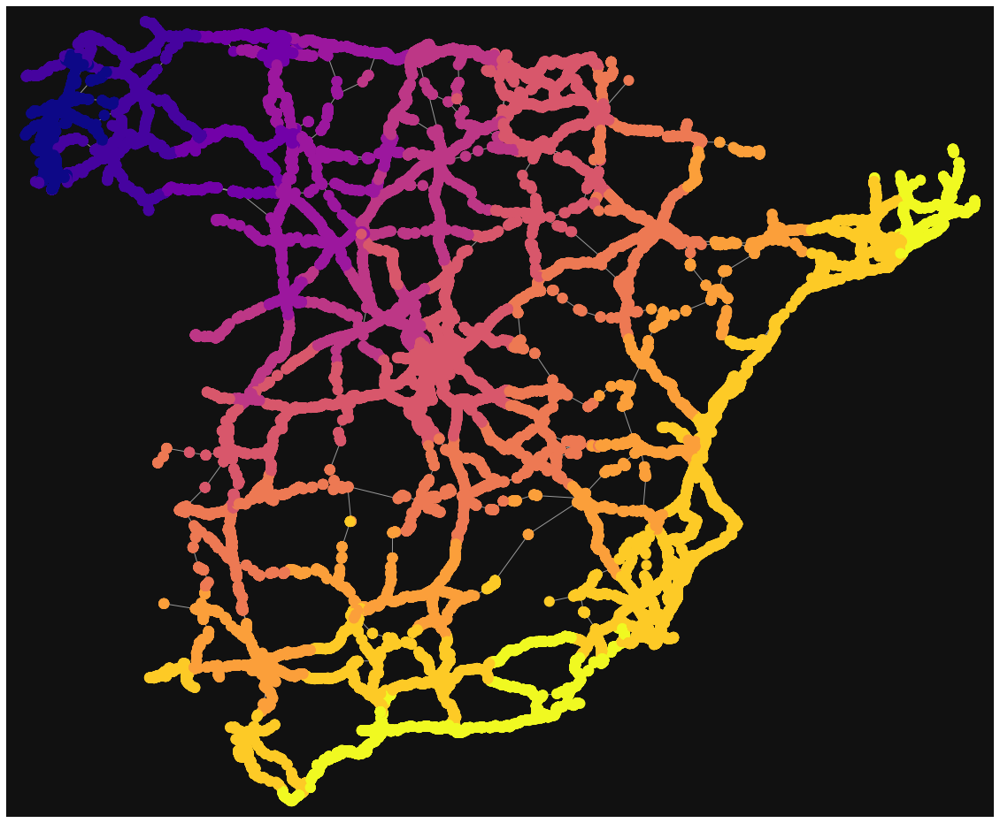

True graph


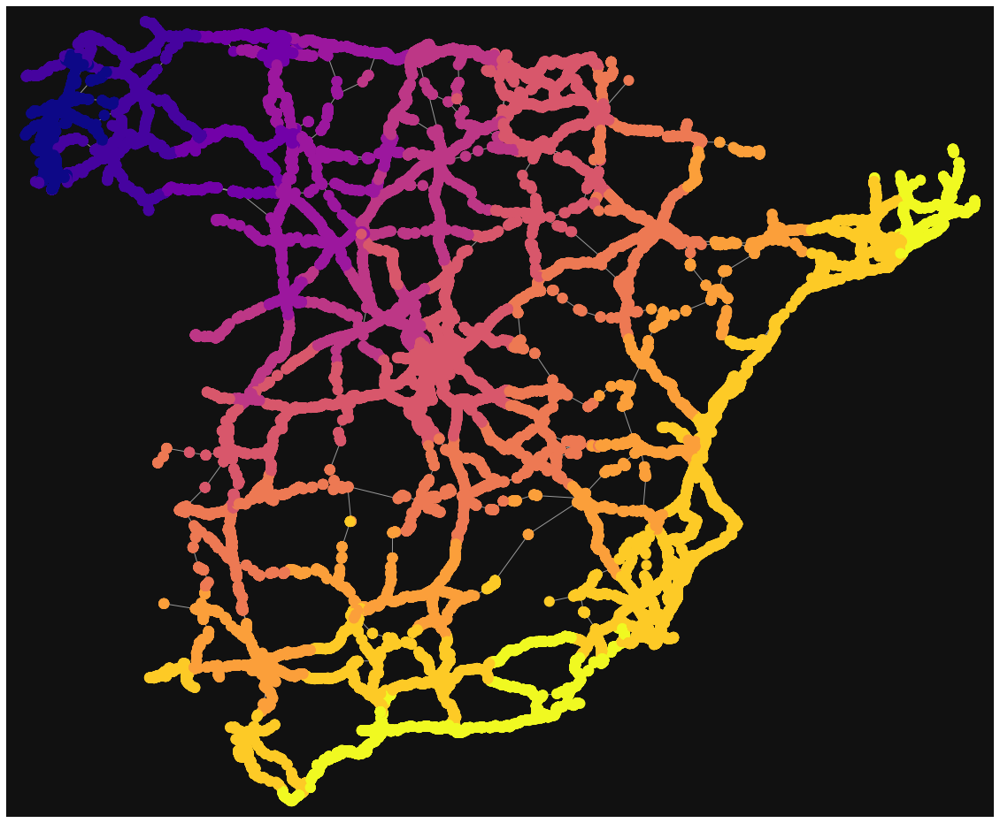

Differences


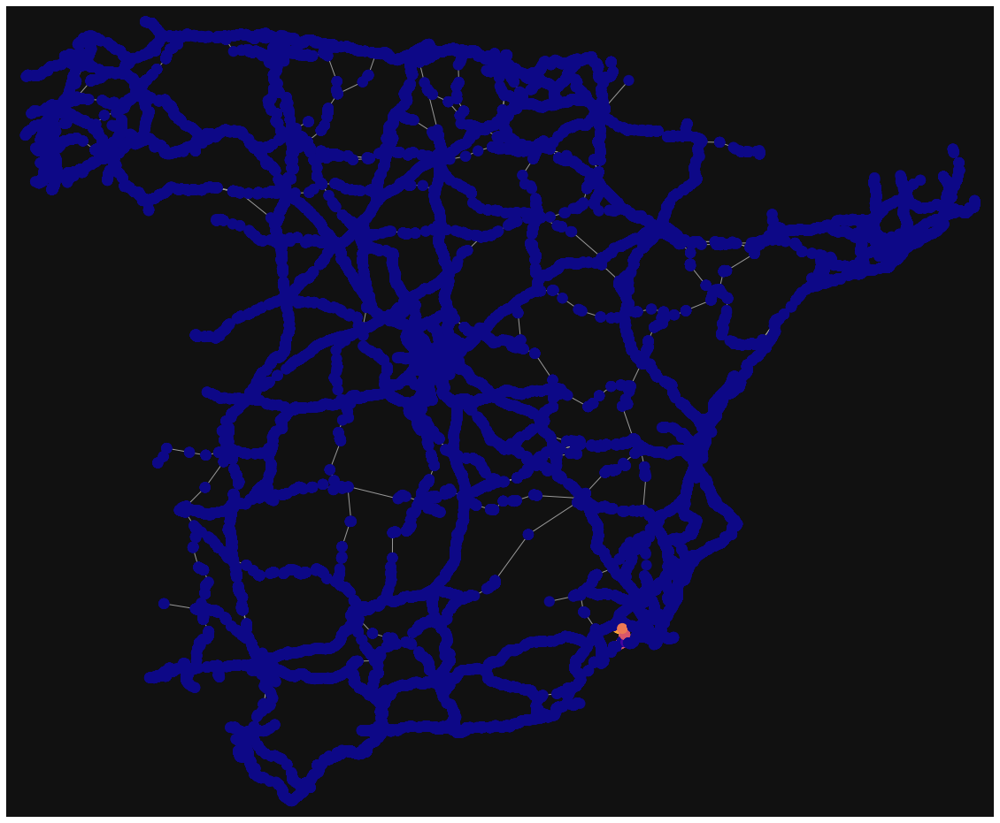

In [ ]:
graph_path = 'spain-raw.graphml'

G_6 = ox.load_graphml(graph_path)

# ------------------------------------------------------------------------------
# Load model
# model = best_model

criteria = lambda x: x < 1e7            # Must be bigger than data.y.max()
model = FRGCN(1, 1, None).to(DEVICE)

model.gcn.bias = torch.nn.Parameter(torch.tensor([0.0]).to(DEVICE))
model.gcn.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]).to(DEVICE))

# model.gcn2.bias = torch.nn.Parameter(torch.tensor([0.0]).to(DEVICE))
# model.gcn2.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]).to(DEVICE))

# ------------------------------------------------------------------------------
# _ = ox.plot_graph(G_6,figsize=(20,17))
test_graph(model, G_6)

In [ ]:
# graph_path = 'andalusia-simple.graphml'

# G_6 = ox.load_graphml(graph_path, 
#                     node_dtypes={'type':int,
#                                  'open_time': int,
#                                  'close_time': int},
#                     edge_dtypes={'speed': int,
#                                  'length': float})

# G_6.remove_nodes_from([3878, 3877, 3742])

# # ------------------------------------------------------------------------------
# # Load model
# # model = best_model
# # criteria = lambda x: x < 1e5
# model = FRGCN(1, 1, None).to(DEVICE)

# model.gcn.bias = torch.nn.Parameter(torch.tensor([1.0]).to(DEVICE))
# model.gcn.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]).to(DEVICE))

# model.gcn2.bias = torch.nn.Parameter(torch.tensor([0.0]).to(DEVICE))
# model.gcn2.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]).to(DEVICE))

# # ------------------------------------------------------------------------------
# # test_graph(model, G_6)

## Save graphs

In [ ]:
ox.save_graphml(G_1, 'city-sanFrancisco.graphml')
ox.save_graphml(G_2, 'city-marbella.graphml')
ox.save_graphml(G_3, 'city-dubai.graphml')
ox.save_graphml(G_4, 'road-malaga.graphml')

## No in function

In [ ]:
G = preprocess_graph(G_6)

# To undirected
G = G.to_undirected()

# Copy for plotting
G_original = G.copy()

number_of_nodes = G.number_of_nodes()

# ------------------------------------------------------------------------------
# Get base map plot
# _, base_map_ax = plot_map(G)

# pickle.dump(base_map_ax, open('base_map.pkl', 'wb'))

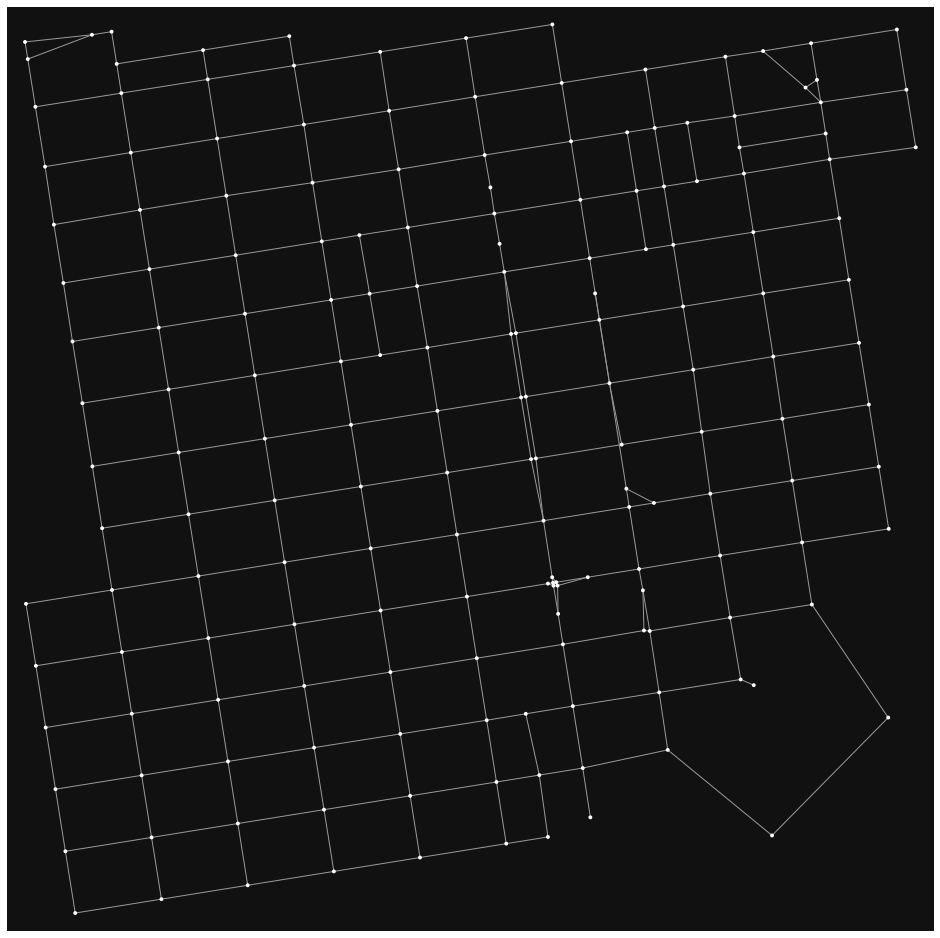

In [ ]:
_ = ox.plot_graph(G_original,figsize=(20,17))

In [ ]:
# Select random target node
# target = np.random.randint(0, number_of_nodes)
target = 0

# Find shortest path length based on 'length' for each node
start = time.time()
paths = nx.shortest_path_length(G, source=None, target=target,
                                weight='length', method='dijkstra')
print(f"Dijkstra: {time.time() - start}")

# Set node attribute 'y' to that value for each node
    # set_graph_label(G, paths)
for k, v in paths.items():
    G.nodes(data=True)[k]['y'] = v +1


# Set passes as the eccentricity of the graph
passes = nx.eccentricity(G, v=target)

Dijkstra: 0.5899734497070312


In [ ]:
passes

541

In [ ]:
# Set node attribute 'distance'/'x' to 0
# nx.set_node_attributes(G, 100000, 'x')
nx.set_node_attributes(G, 2e7, 'x') # Must be bigger than data.y.max()

# Set initial value of target as 0
G.nodes(data=True)[target]['x'] = 1

In [ ]:
# Get graph as tensor
G.graph = {} # from_networkx can't receive non-string global arguments

# FOR SOME REASON THE TARGET WON'T HAVE THE VALUE 0, SEEMS LIKE THERE IS NO PERFECT
# CORRESPONDENCE WITH THE INDEX
data = from_networkx(G, group_node_attrs=['x']).to(DEVICE)

In [ ]:
loss_fn = nn.L1Loss()

criteria = lambda x: x < 1e7 # Must be bigger than data.y.max()
model = FRGCN(1, 1, None).to(DEVICE)

model.gcn.bias = torch.nn.Parameter(torch.tensor([0.0]).to(DEVICE))
model.gcn.lin.weight = torch.nn.Parameter(torch.tensor([[1.0]]).to(DEVICE))

In [ ]:
# Forward pass
with torch.no_grad():
    # out = model(data['x'].float(), data['edge_index'], passes=passes)
    start = time.time()
    out = model(data['x'].float(), data['edge_index'], data['length'].float(), passes=passes)
    print(f"Forward: {time.time() - start}")

out = out.mT.squeeze()

# Loss
loss = loss_fn(out.T.squeeze(), data['y'])
loss

Check total: 0.01640176773071289
Forward: 0.3583407402038574


tensor(144.1243, device='cuda:0')

In [ ]:
out.size()

torch.Size([73066])

In [ ]:
727596.2500

In [ ]:
mask = torch.abs(data.y - out) < 0.1

# print(data.y[mask])
# print(out[mask])

In [ ]:
G.number_of_nodes()

73066

In [ ]:
out.max()

tensor(71945.5312, device='cuda:0')

In [ ]:
data.y.max()

tensor(1239727., device='cuda:0')

In [ ]:
torch.argmax(out)

tensor(72235, device='cuda:0')

In [ ]:
torch.where(out < 1e5)

(tensor([0], device='cuda:0'),)

In [ ]:
torch.where(mask)

(tensor([   0,    3,    4,   19,   20,  411, 1104, 1128], device='cuda:0'),)

In [ ]:
list(G.neighbors(3))

[0, 1128, 4]

In [ ]:
132398.9688 / 276.3790

479.0485847332829

In [ ]:
G.get_edge_data(3,4)

{0: {'length': 479.09700000000004}}

In [ ]:
n = 4
print(data.y[n])
print(out[n])

tensor(755.4460, device='cuda:0')
tensor(755.4460, device='cuda:0')


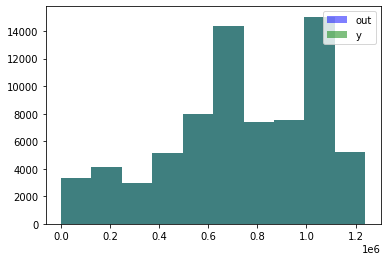

In [ ]:
pred = out.cpu().numpy() if torch.cuda.is_available() else out.numpy()
true = data.y.cpu().numpy() if torch.cuda.is_available() else data.y.numpy()

plt.hist(pred, color="b", alpha=0.5, label="out")
plt.hist(true, color="g", alpha=0.5, label="y")

plt.legend(loc='upper right')

In [ ]:
# ----------------------------------------------------------------------
# Transform tensor to graph
data['out'] = out

data['diff'] = torch.abs(data.y - out)

G_out = to_networkx(data, 
                node_attrs=['out', 'y', 'diff'],   # y=Label, distance=v value, value learnt
                to_undirected=True, remove_self_loops=True)    # NOTE: Careful with self loops

Differences


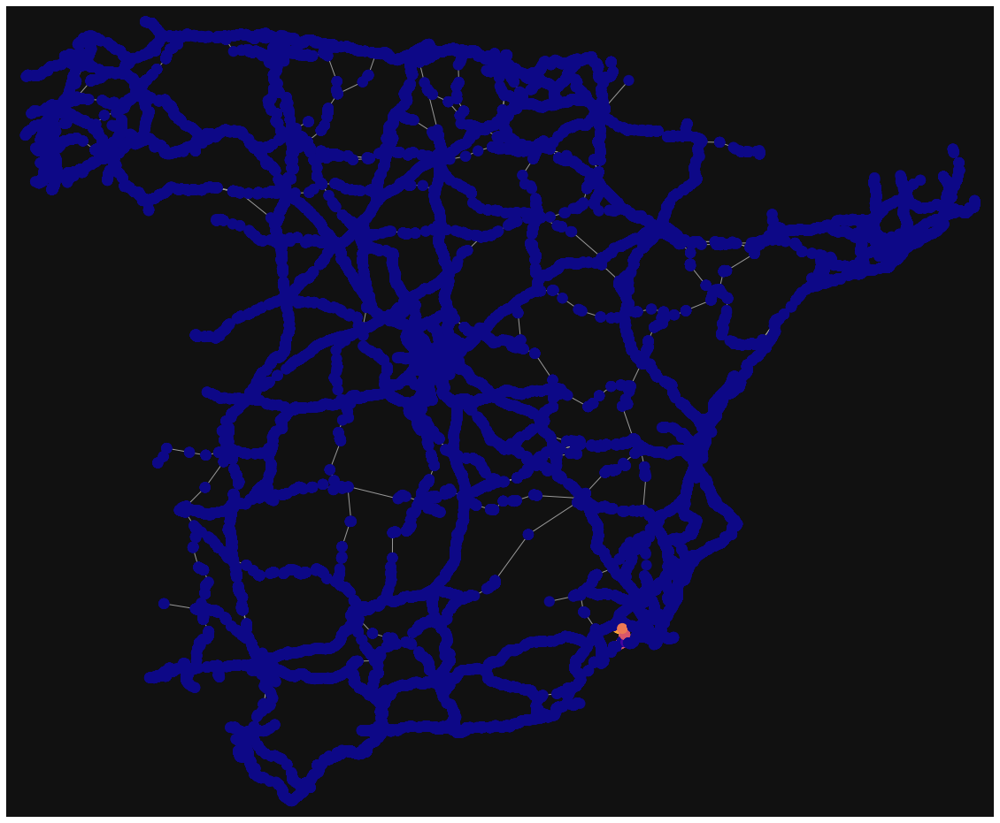

In [ ]:
print("Differences")
_ = plot_heatmap(G_out, G_original, "diff")

Learnt graph


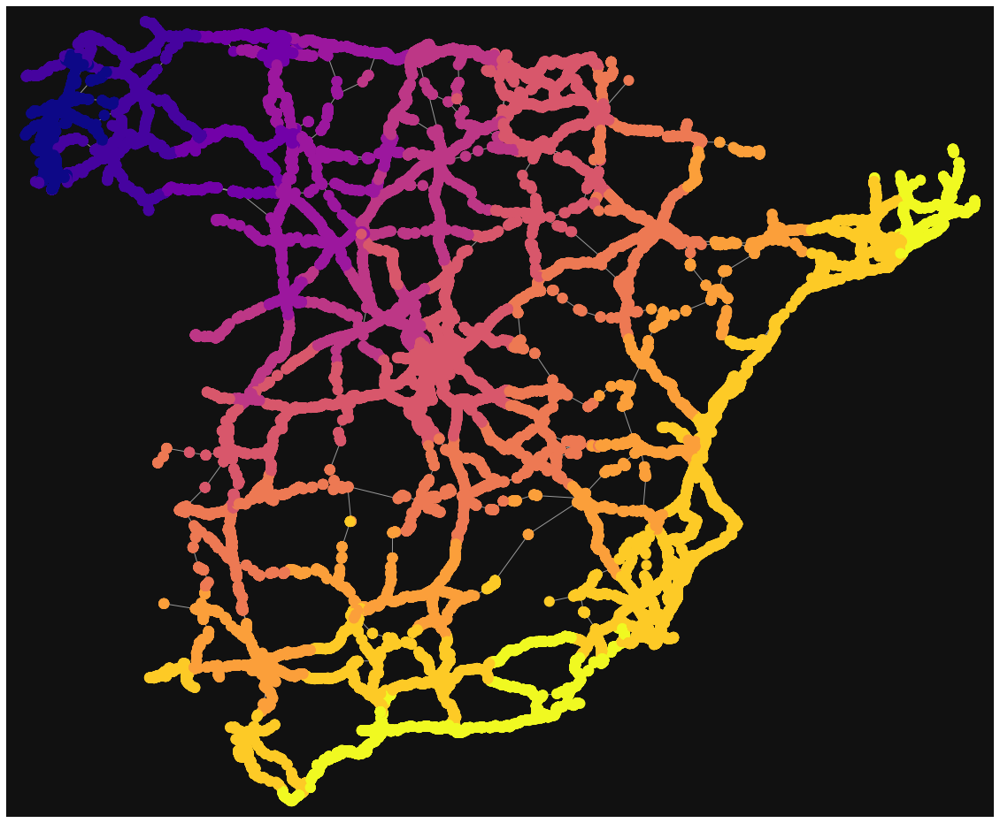

In [ ]:
print("Learnt graph")
_ = plot_heatmap(G_out, G_original, "out")

True graph


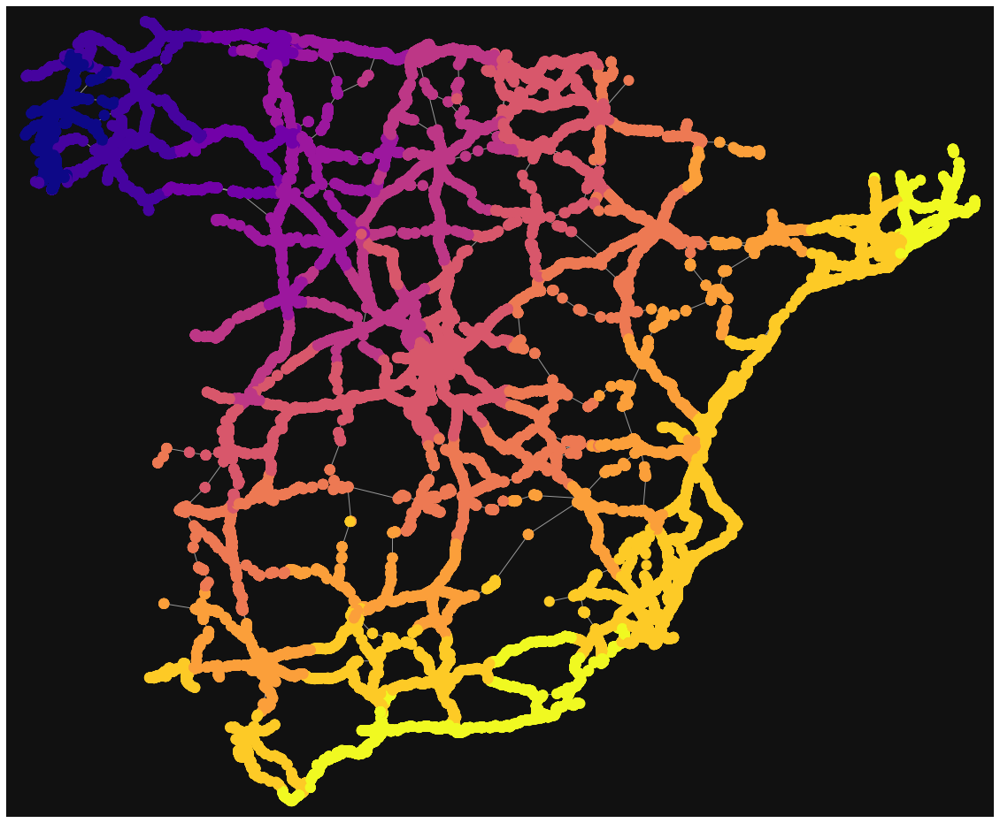

In [ ]:
print("True graph")
_ = plot_heatmap(G_out, G_original, "y")